Connected to Python 3.10.12

7626
Data loaded
20
4881


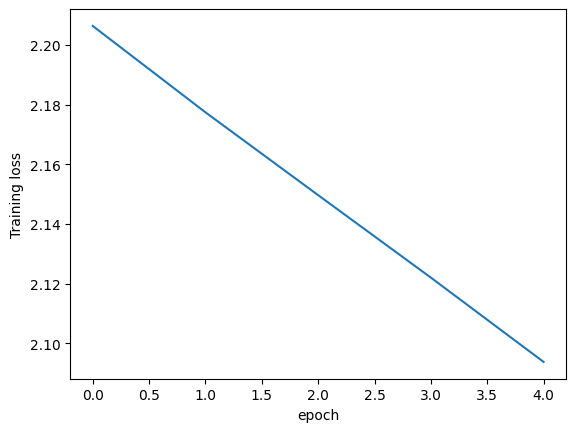

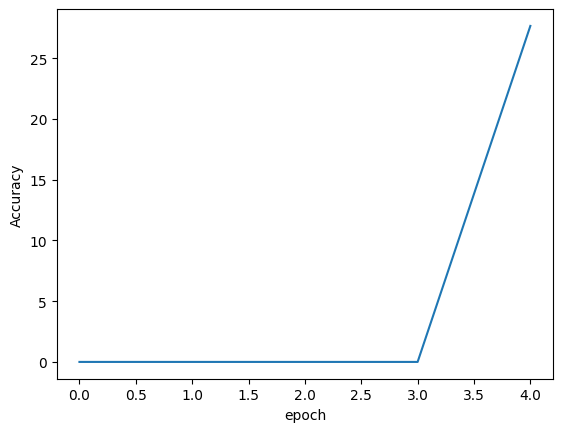

done
[]
60
20
4881


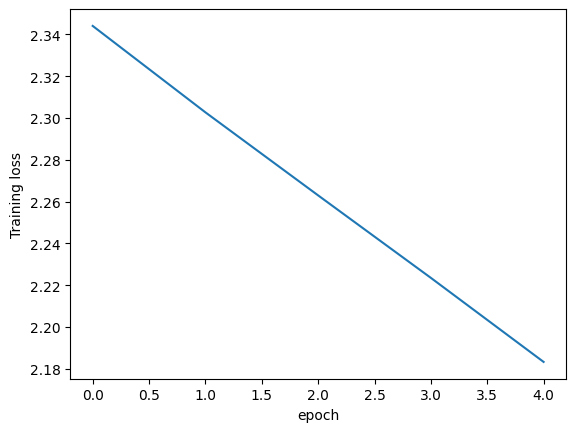

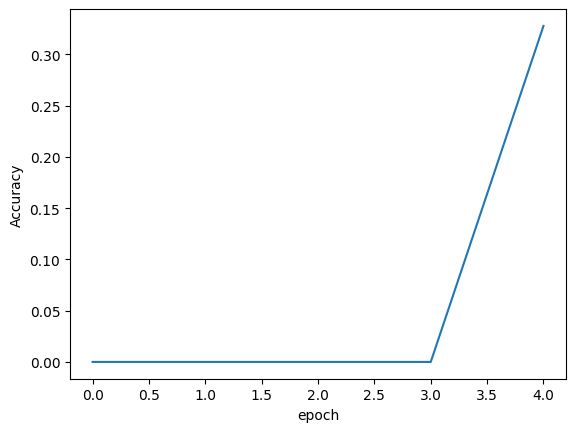

done
[]
60
20
4881


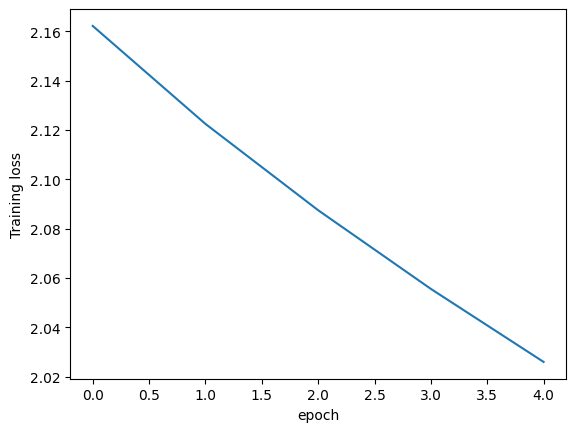

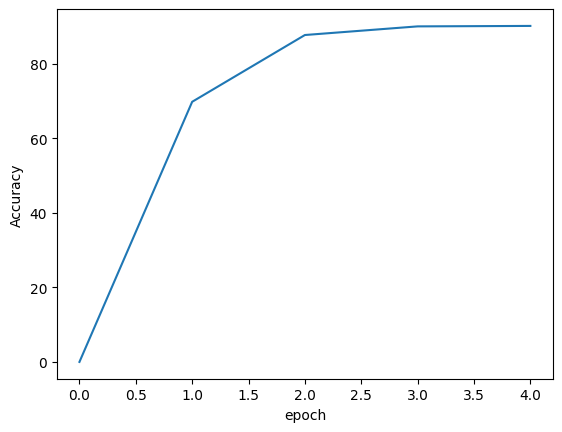

done
[]
60
20
4881


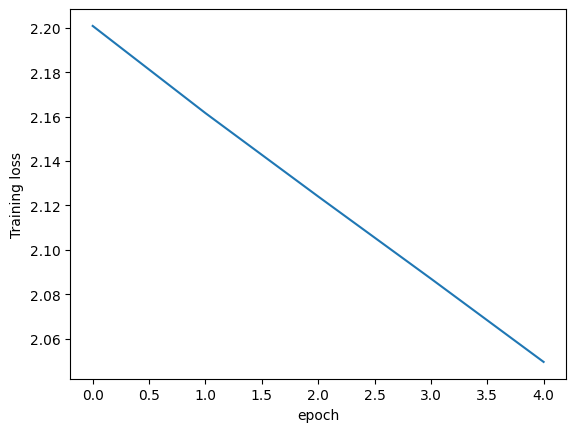

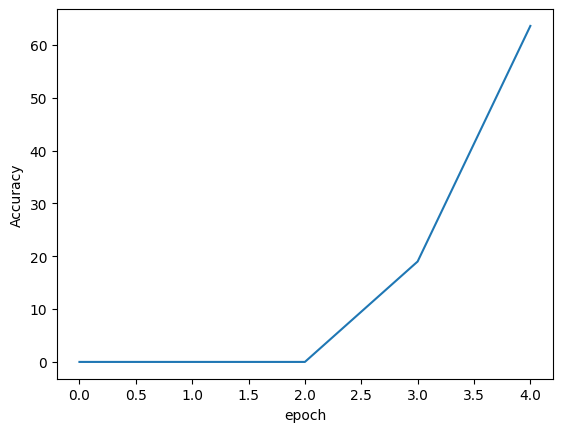

done
[]
60
20
4881


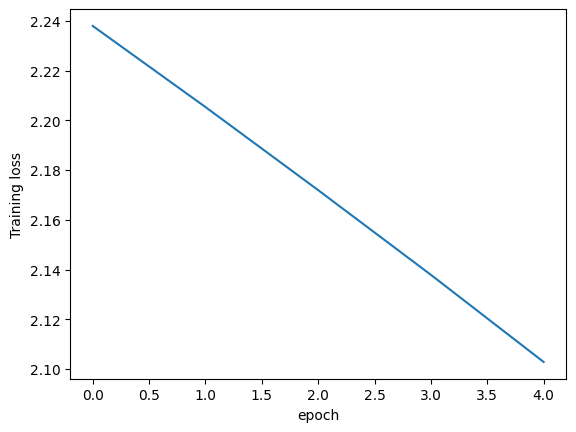

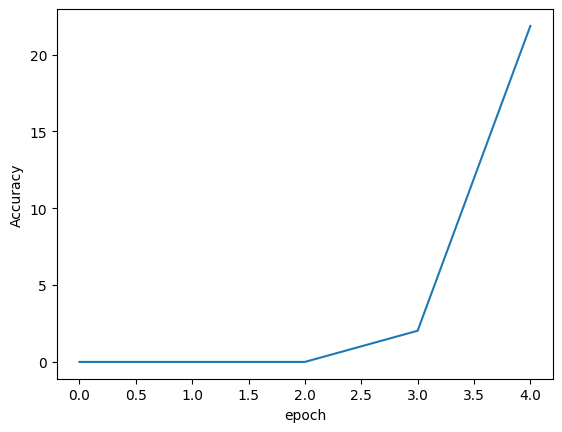

done
[]
60
tensor(0.6632)


In [1]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=20, stride=20),
        nn.AvgPool1d(kernel_size=2),
        nn.LeakyReLU(),
        nn.Linear(in_features=32, out_features=49),
        nn.LeakyReLU(),
        nn.Linear(in_features=49, out_features=9)



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


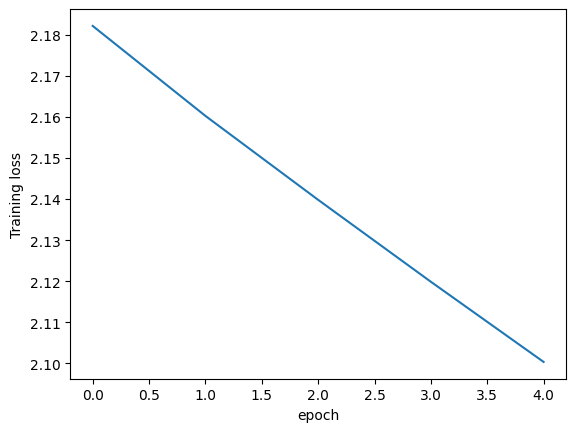

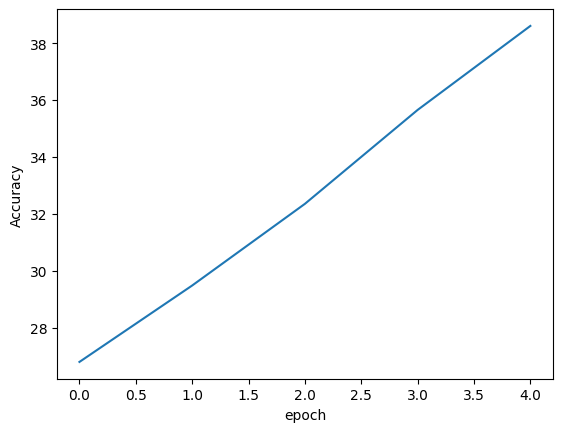

done
[]
60
20
4881


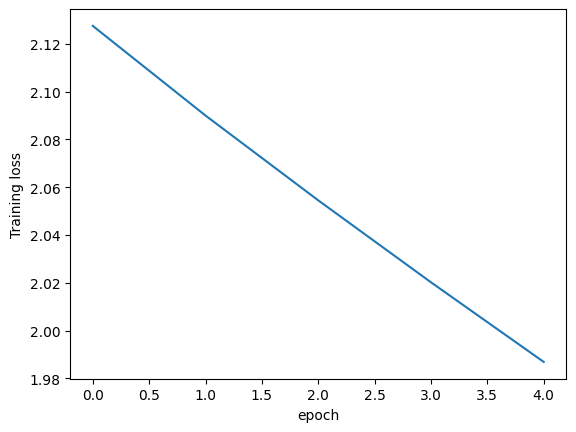

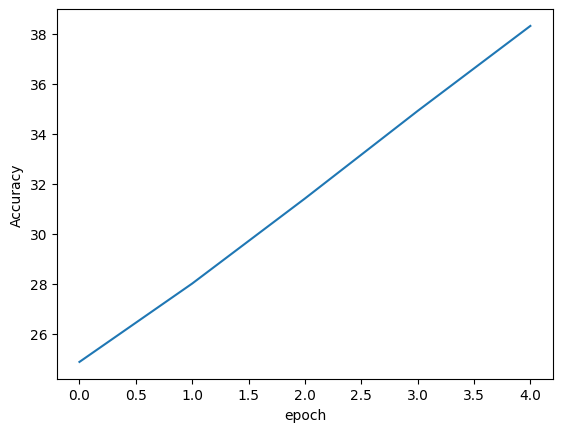

done
[]
60
20
4881


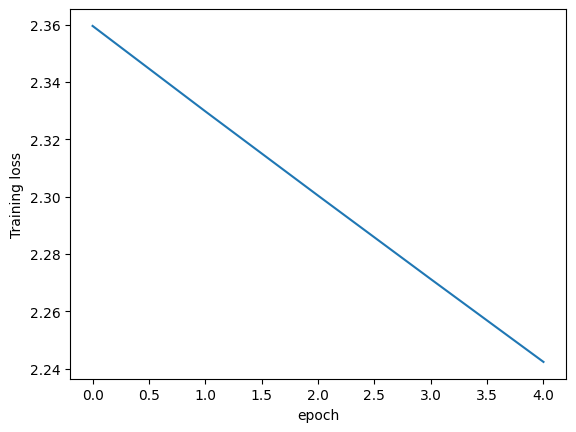

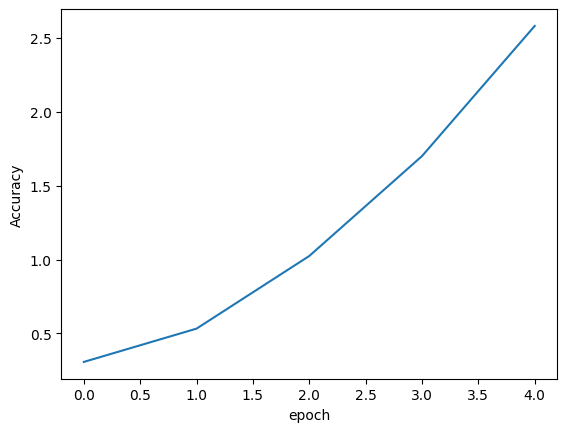

done
[]
60
20
4881


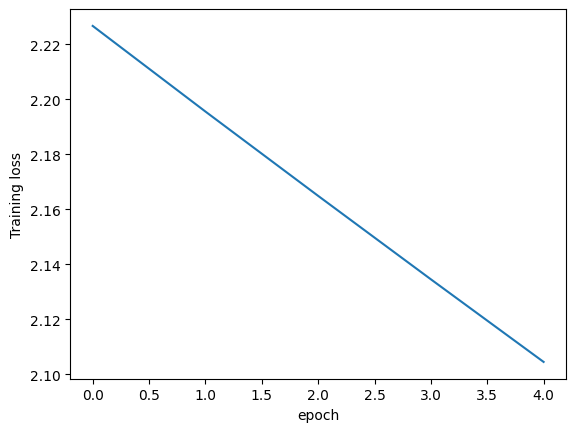

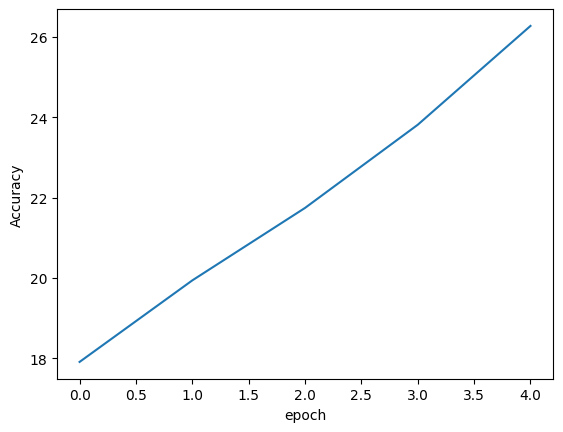

done
[]
60
20
4881


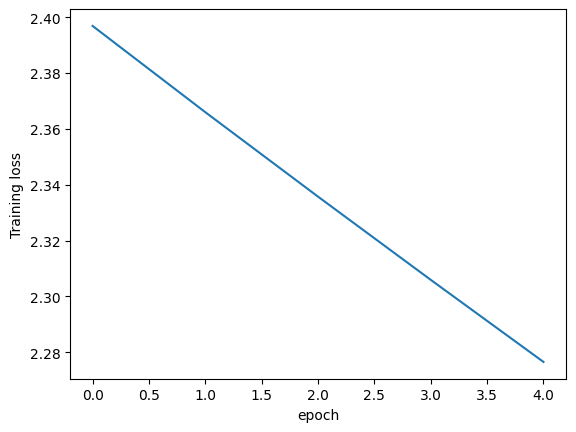

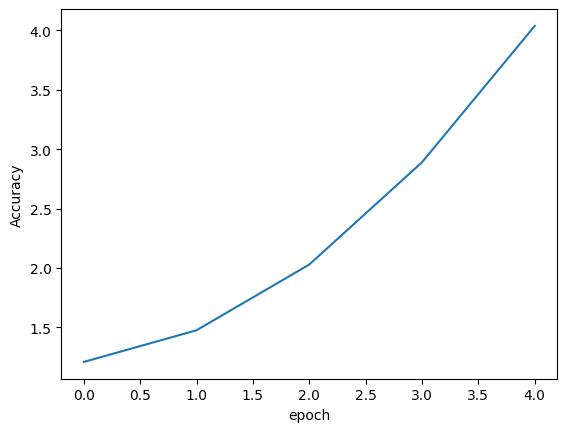

done
[]
60
tensor(0.1350)


In [2]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=30),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


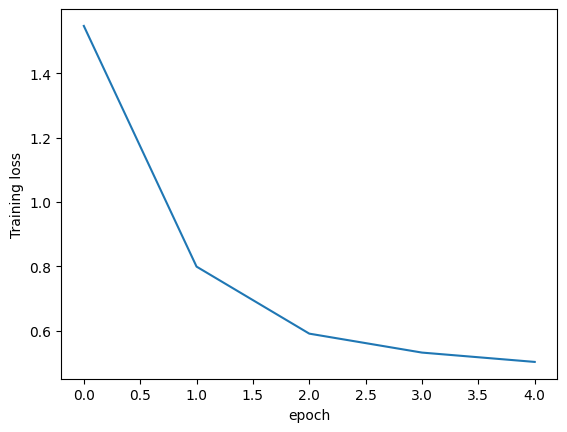

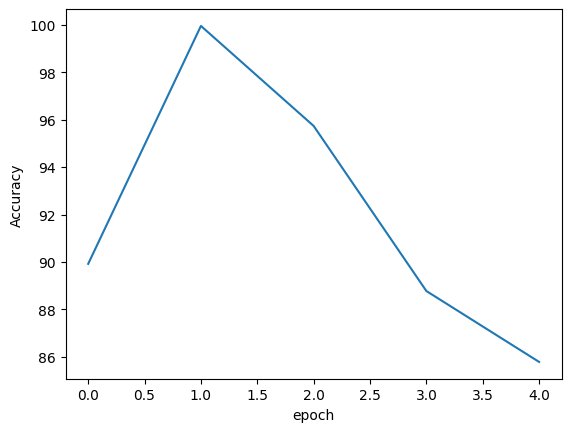

done
[]
60
20
4881


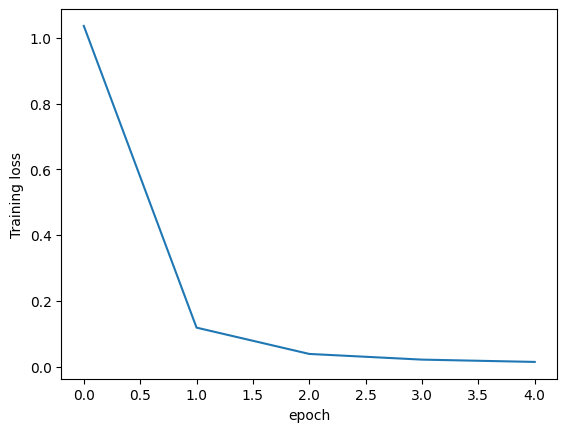

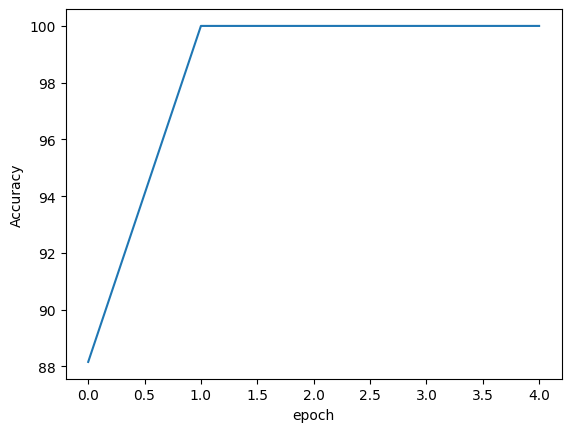

done
[]
60
20
4881


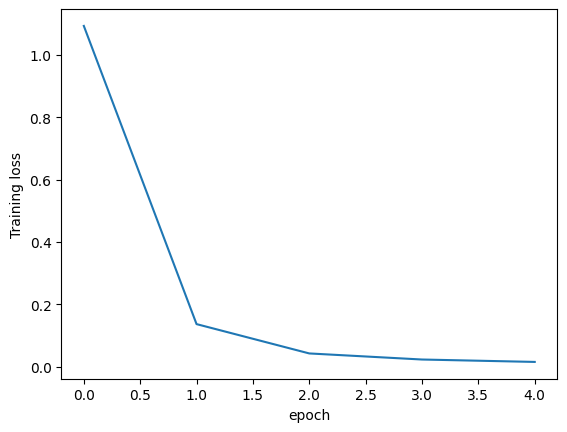

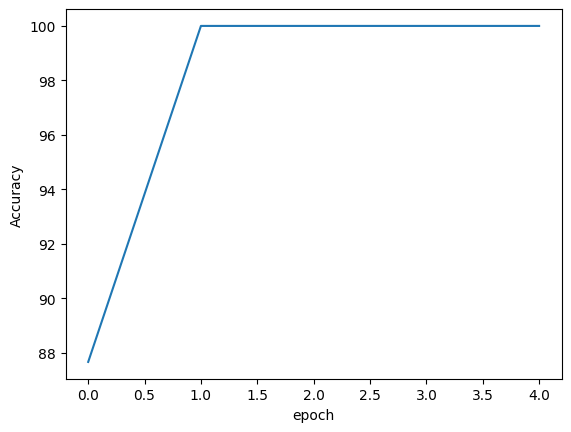

done
[]
60
20
4881


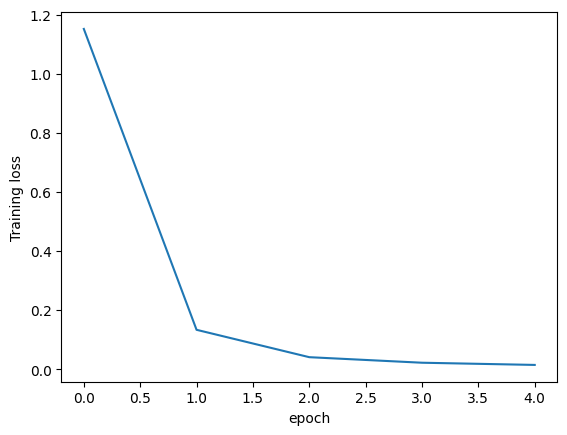

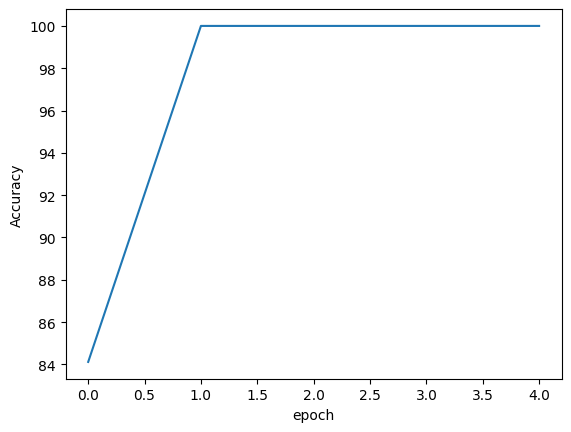

done
[]
60
20
4881


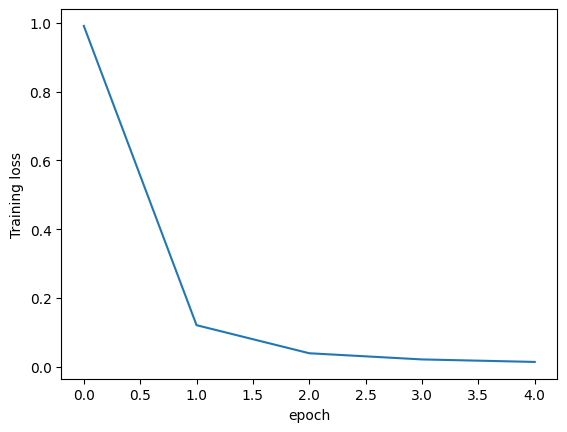

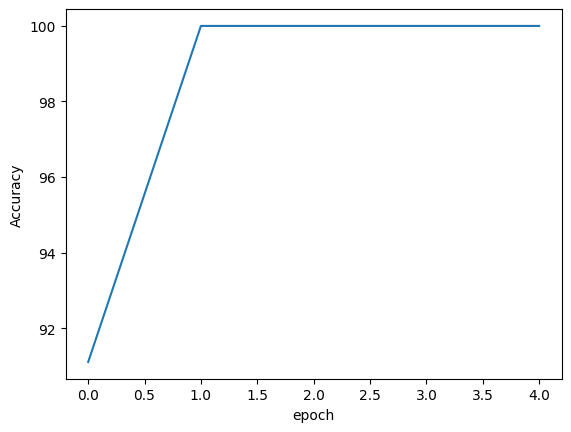

done
[]
60
tensor(0.)


In [3]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=30),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


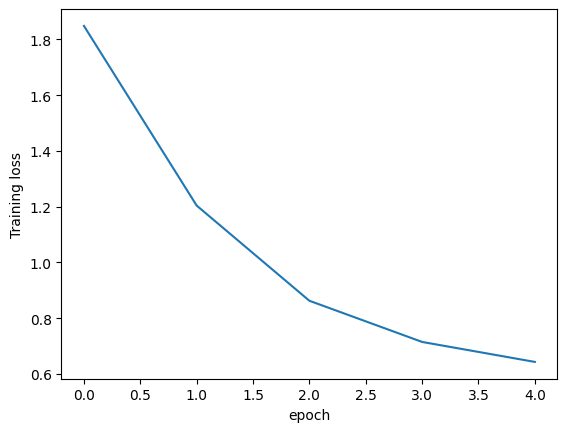

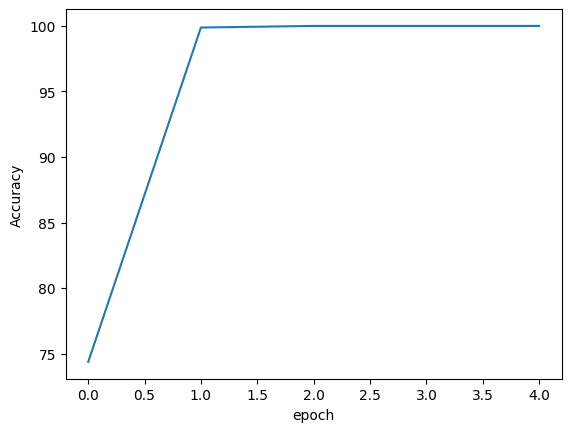

done
[]
60
20
4881


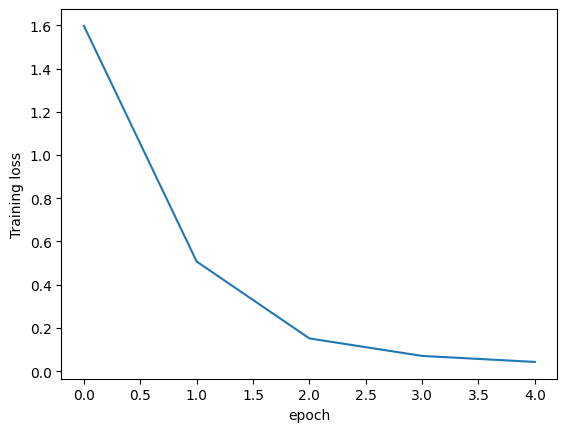

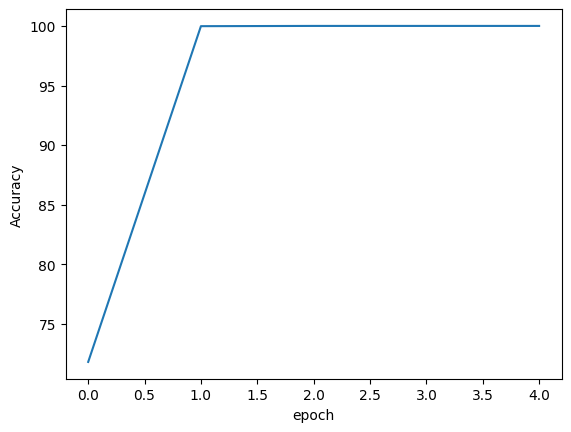

done
[]
60
20
4881


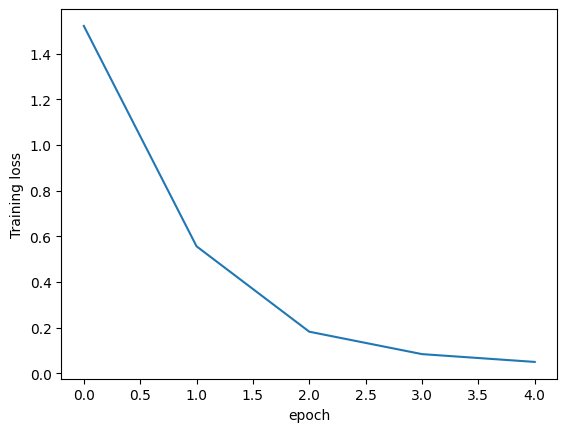

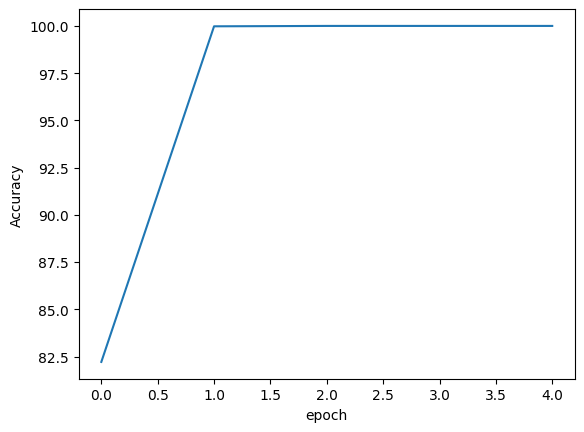

done
[]
60
20
4881


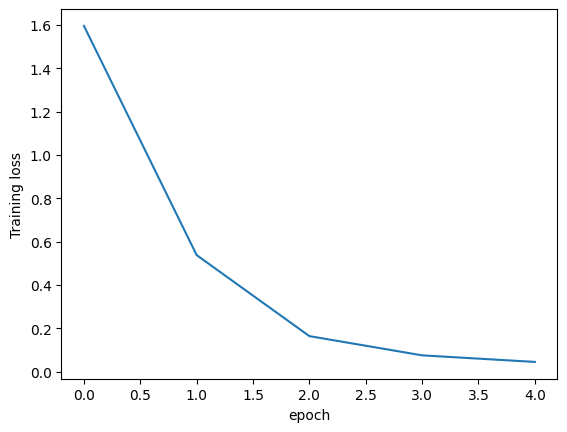

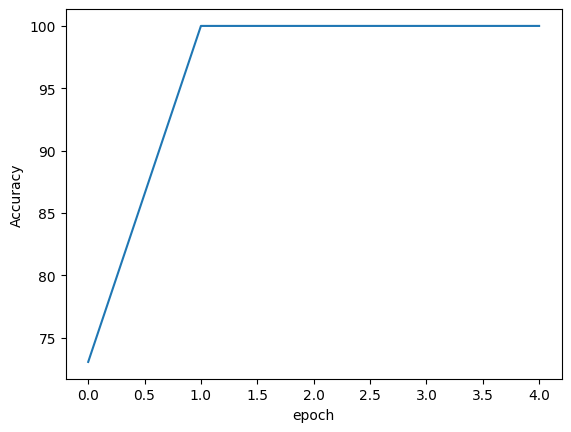

done
[]
60
20
4881


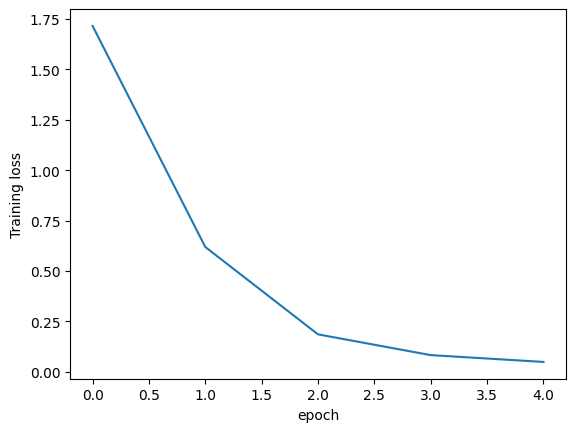

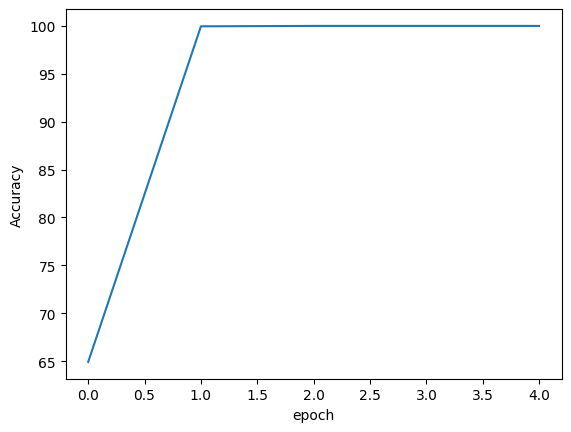

done
[]
60
tensor(0.)


In [4]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=30),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.005)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


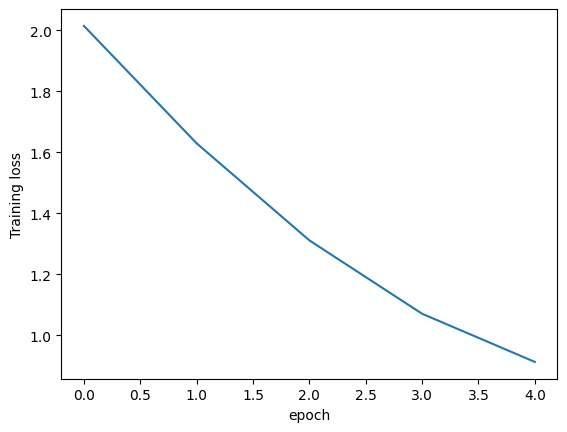

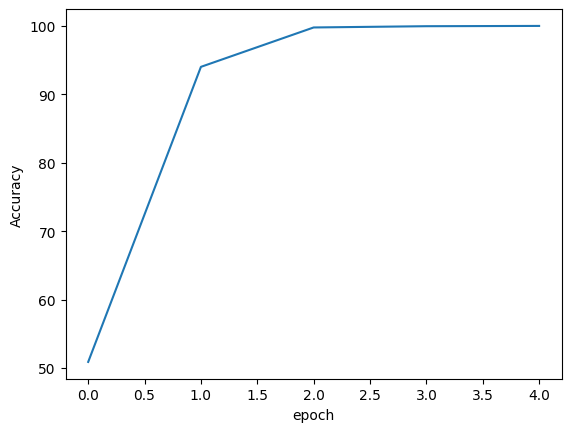

done
[]
60
20
4881


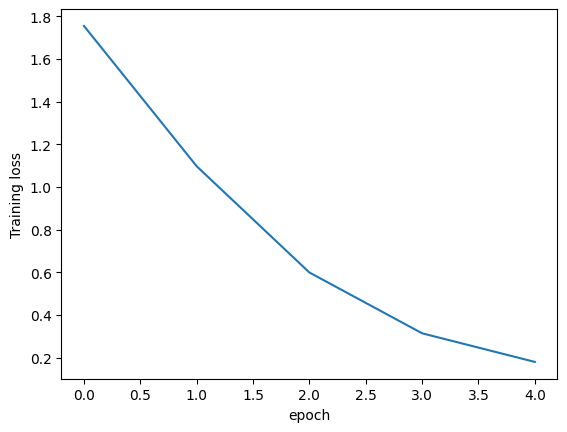

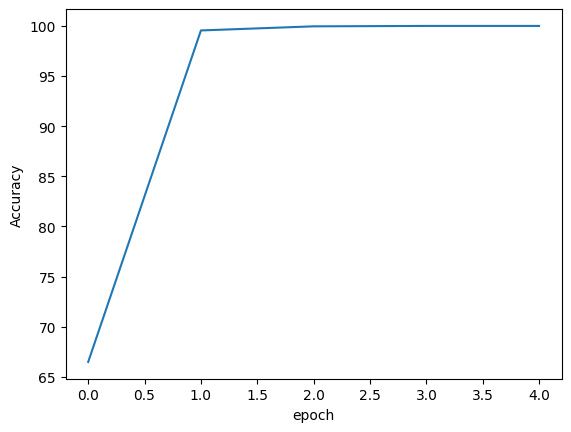

done
[]
60
20
4881


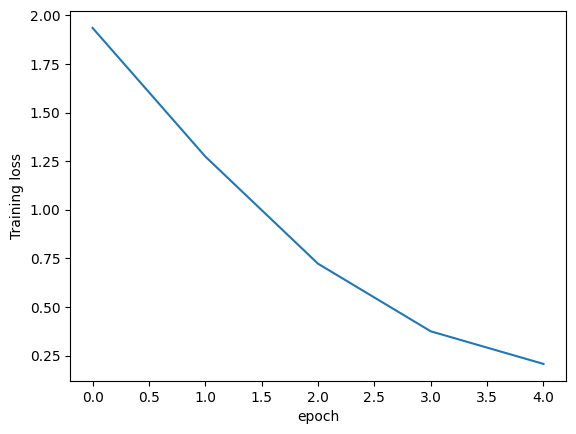

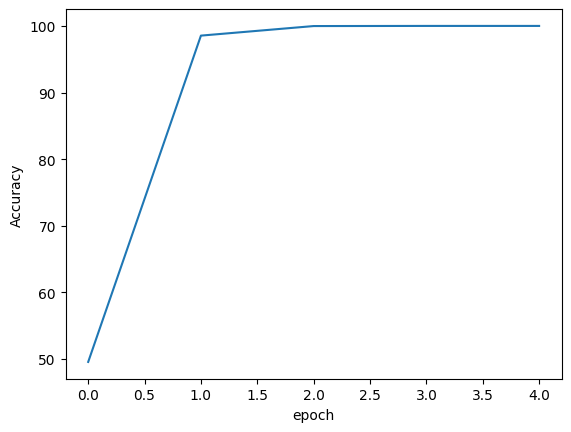

done
[]
60
20
4881


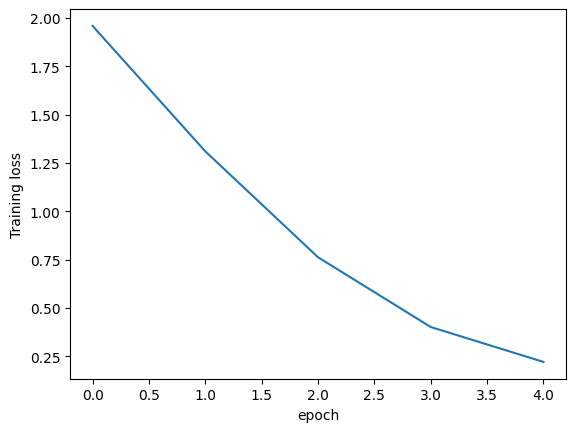

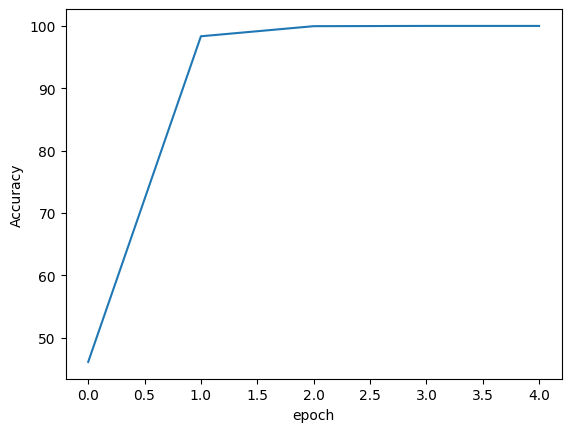

done
[]
60
20
4881


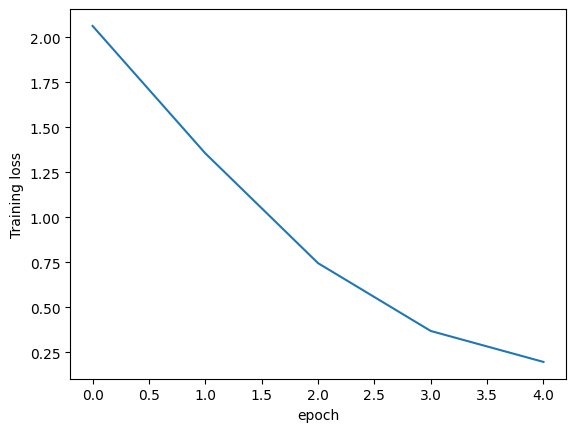

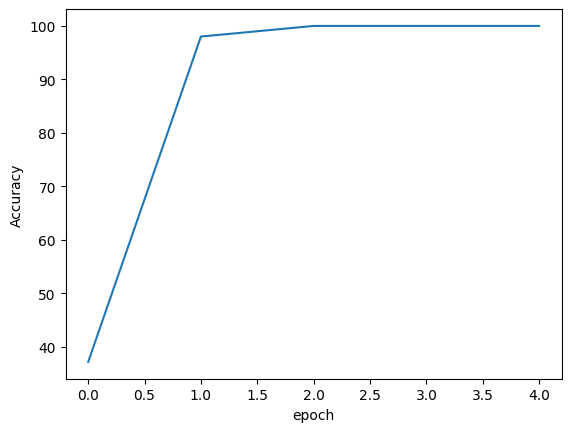

done
[]
60
tensor(0.)


In [5]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=30),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


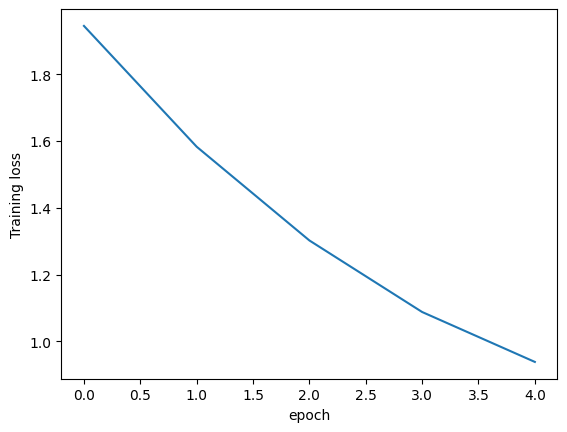

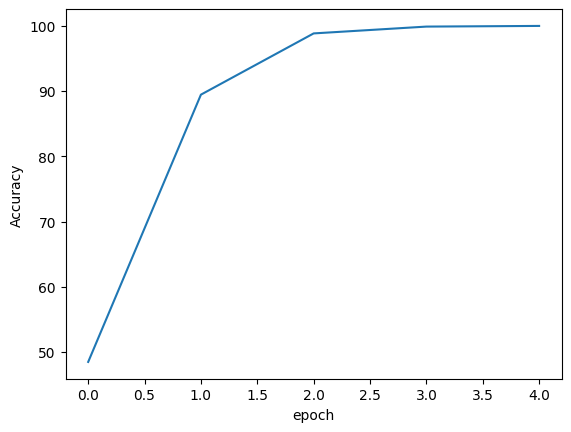

done
[]
60
20
4881


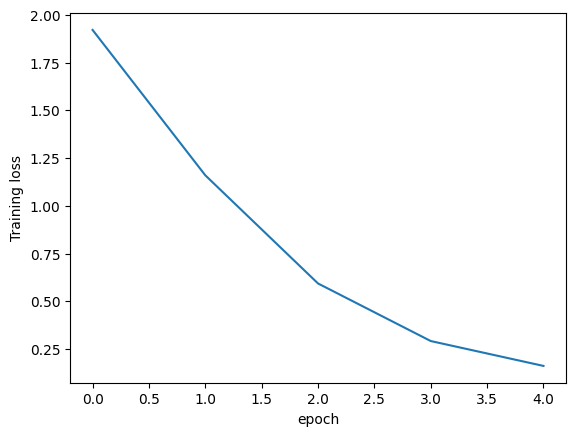

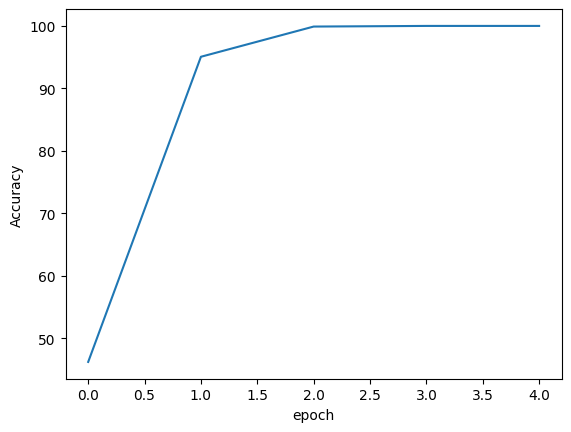

done
[]
60
20
4881


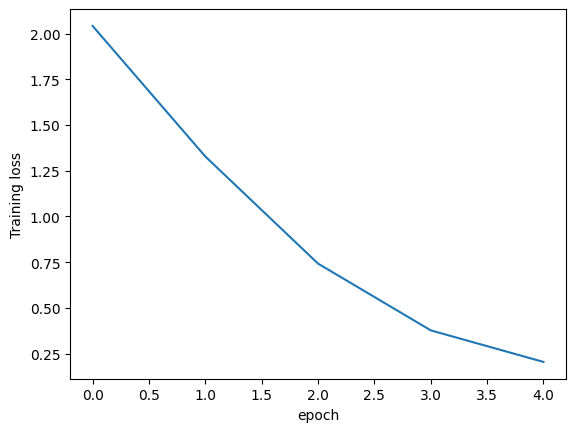

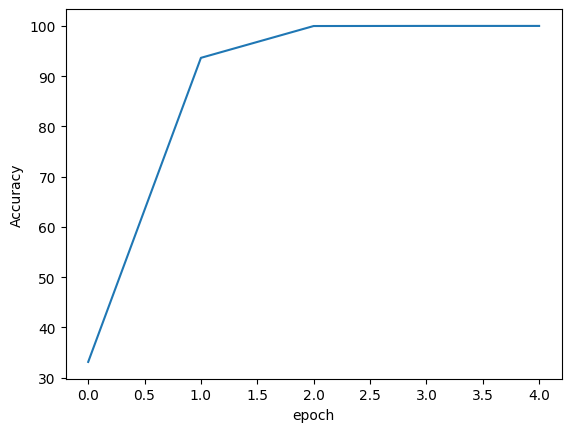

done
[]
60
20
4881


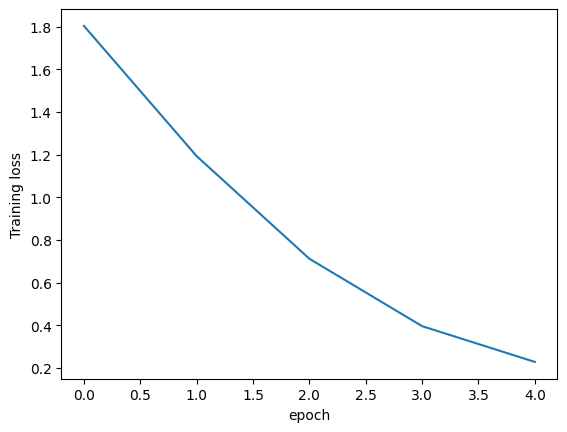

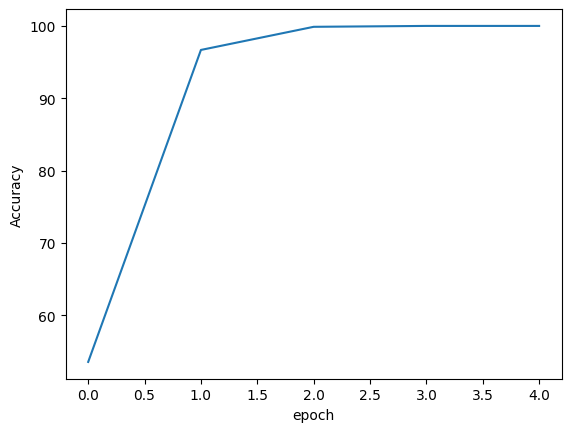

done
[]
60
20
4881


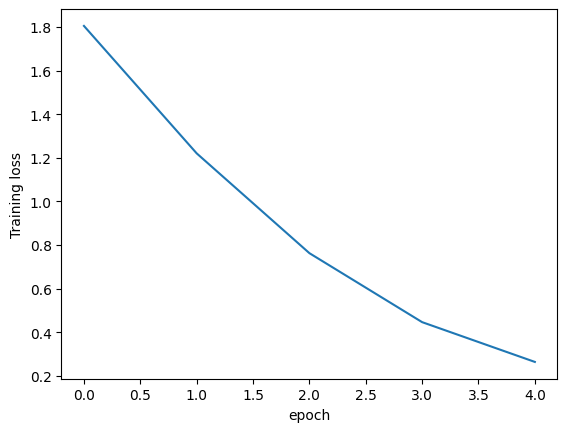

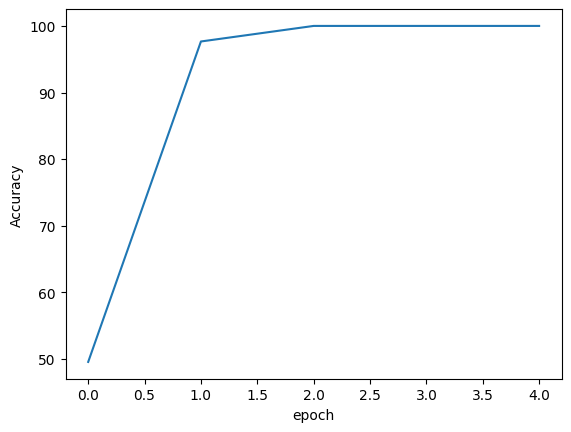

done
[]
60
tensor(0.0328)


In [6]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


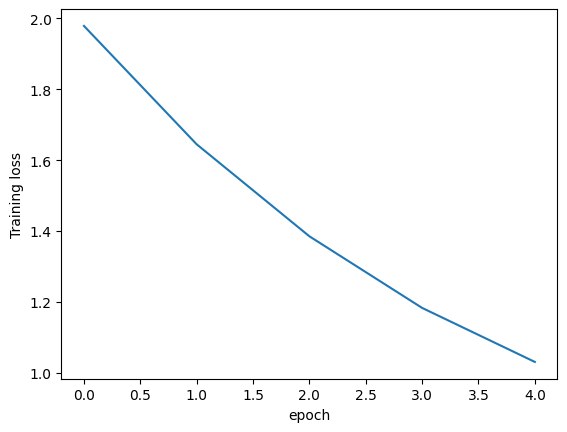

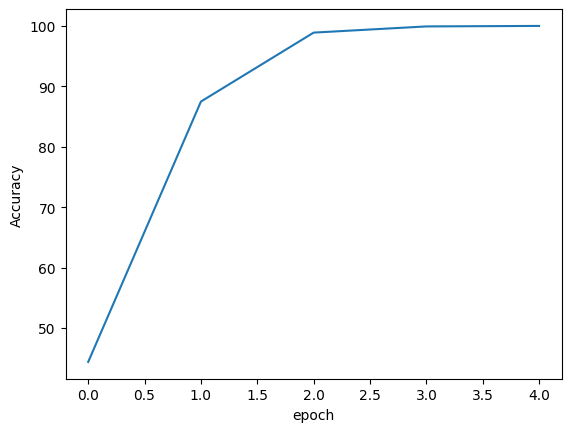

done
[]
60
20
4881


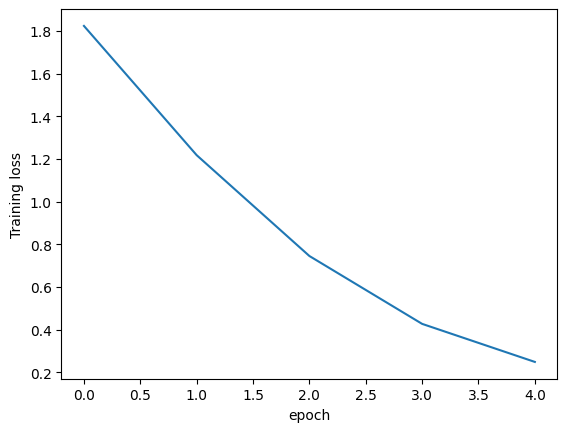

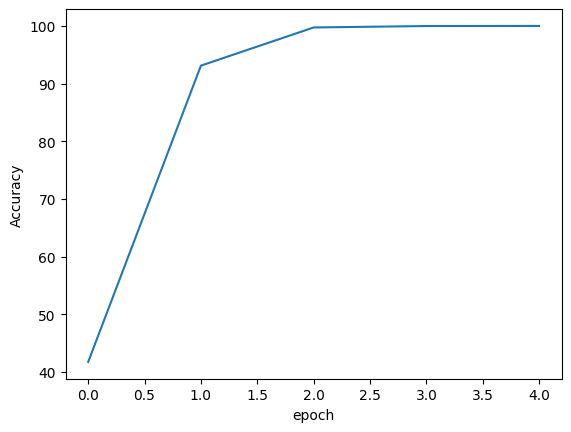

done
[]
60
20
4881


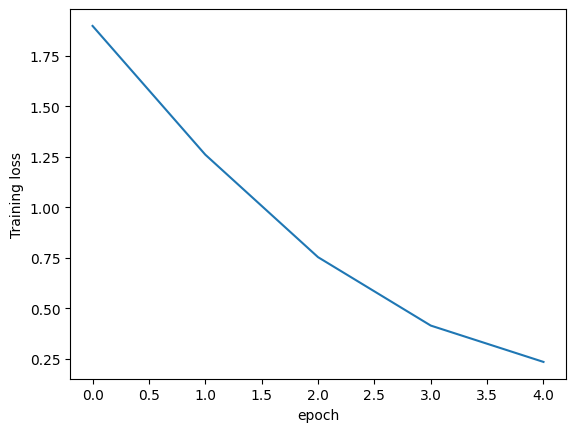

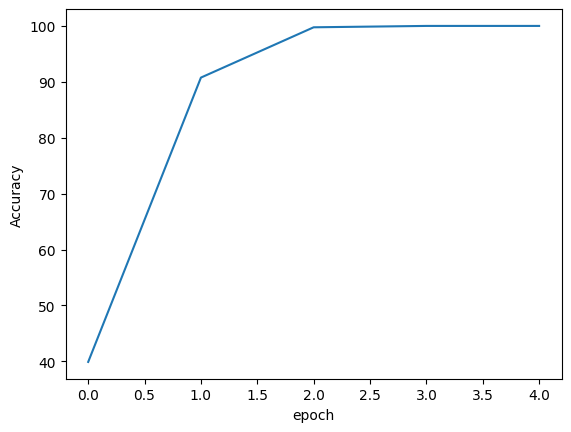

done
[]
60
20
4881


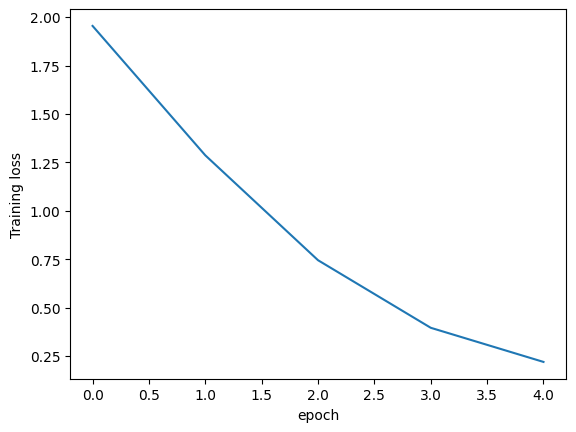

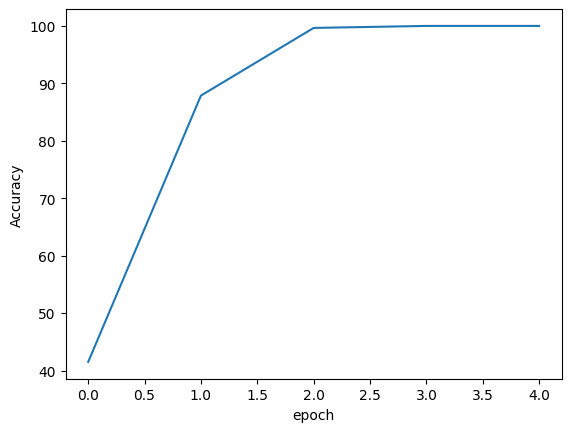

done
[]
60
20
4881


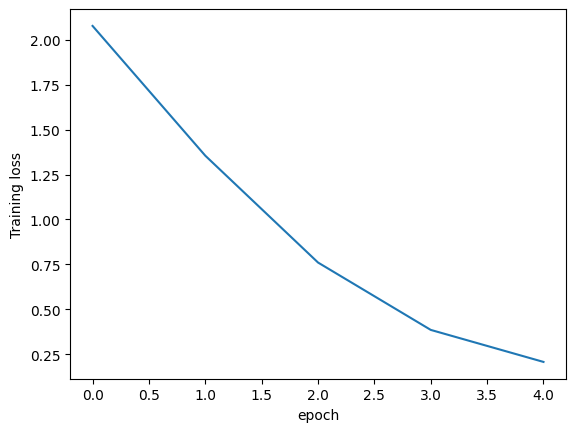

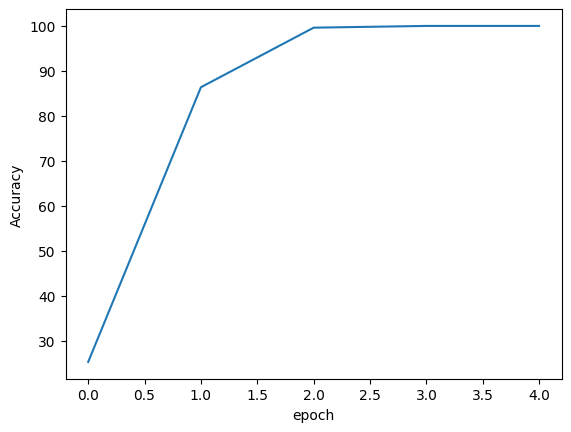

done
[]
60
tensor(0.0537)


In [7]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


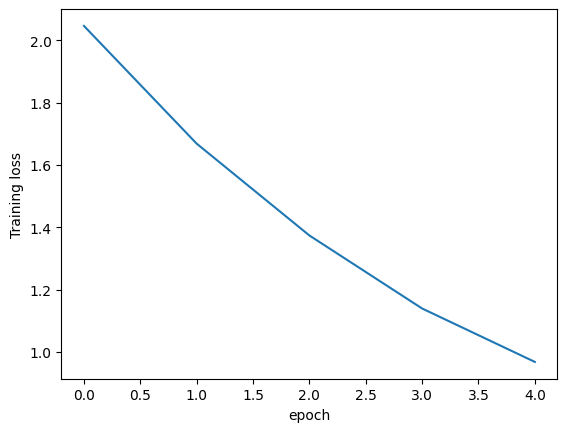

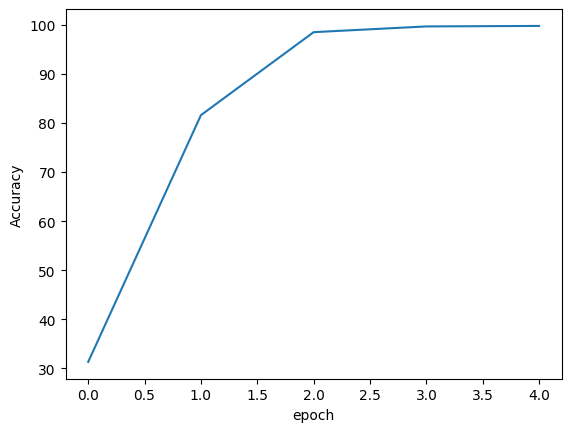

done
[]
60
20
4881


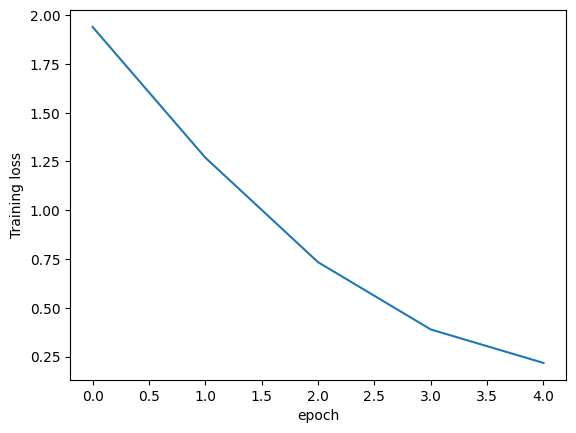

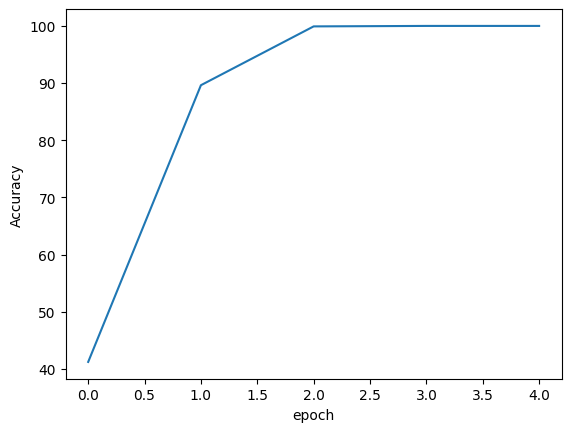

done
[]
60
20
4881


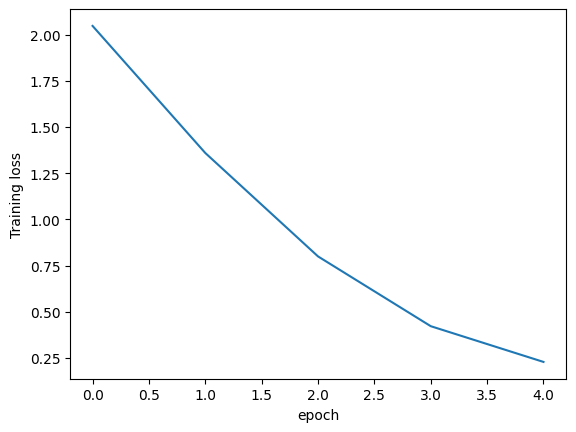

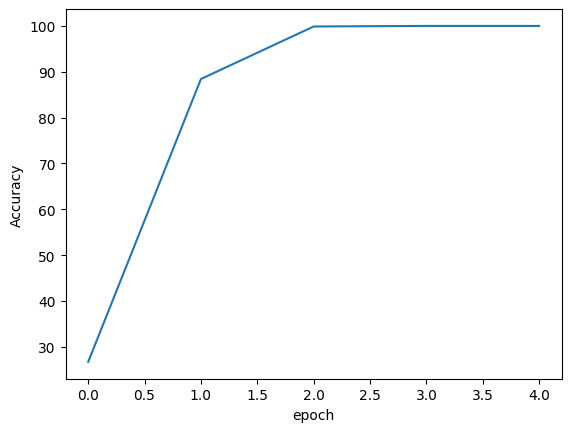

done
[]
60
20
4881


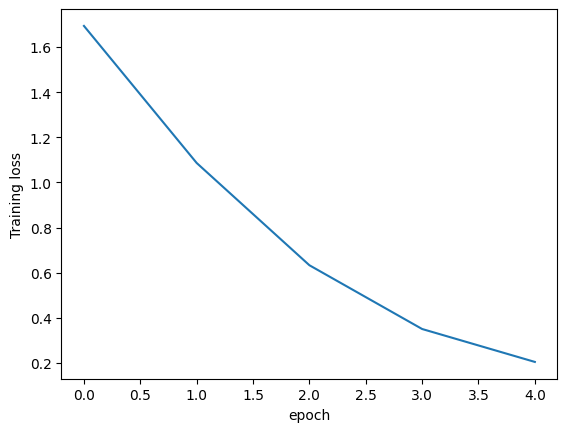

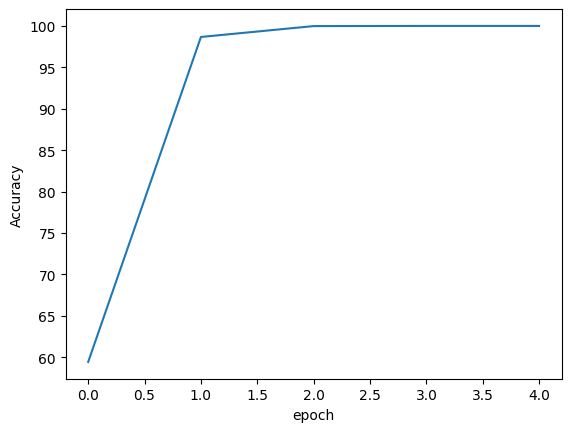

done
[]
60
20
4881


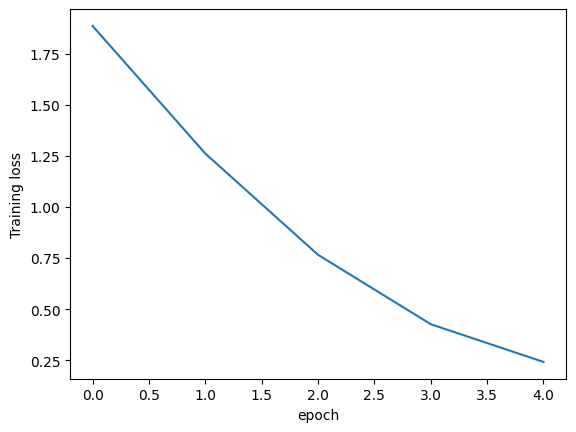

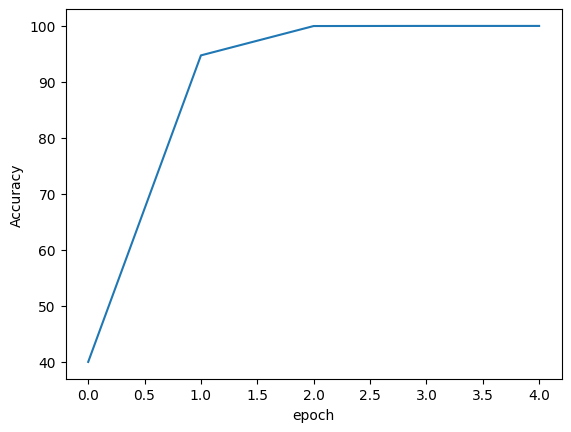

done
[]
60
tensor(0.0131)


In [8]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


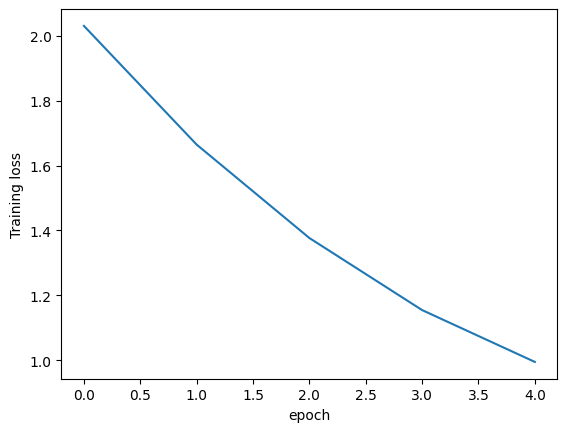

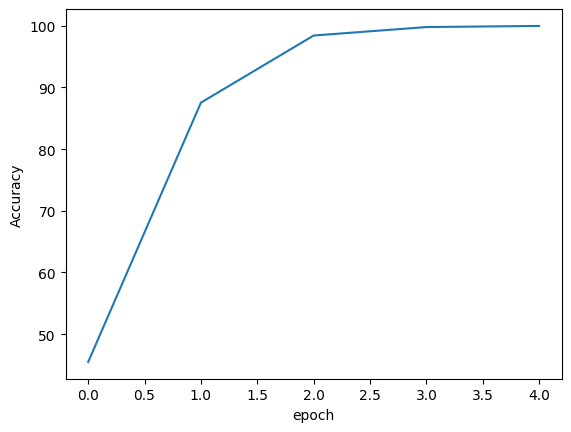

done
[]
60
20
4881


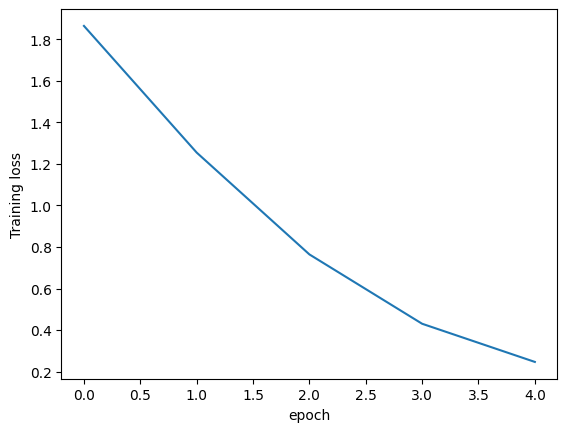

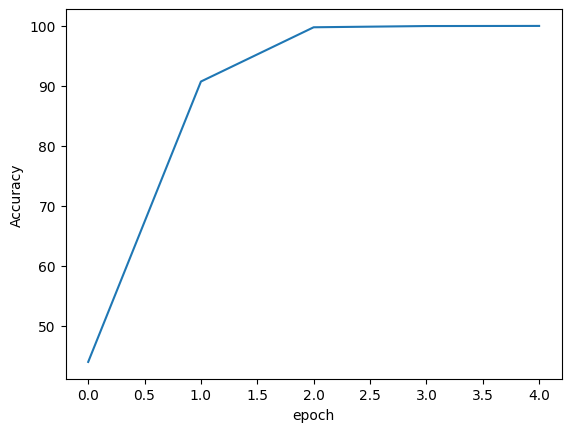

done
[]
60
20
4881


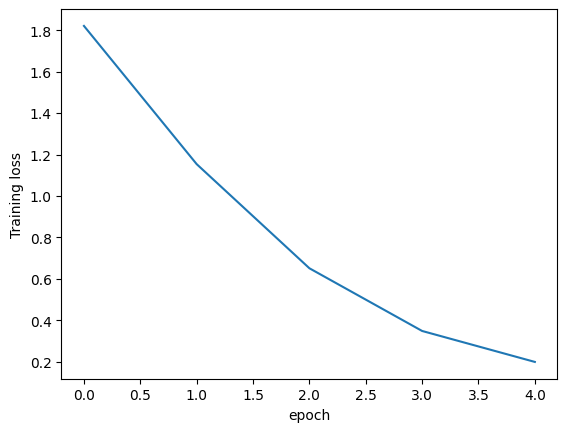

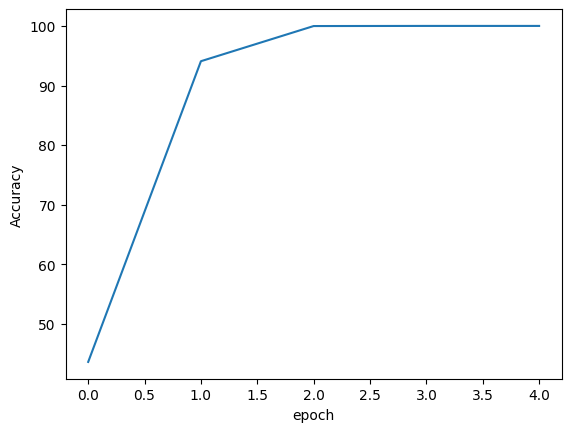

done
[]
60
20
4881


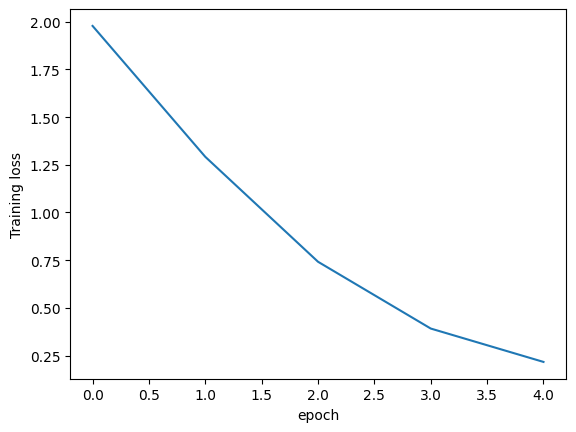

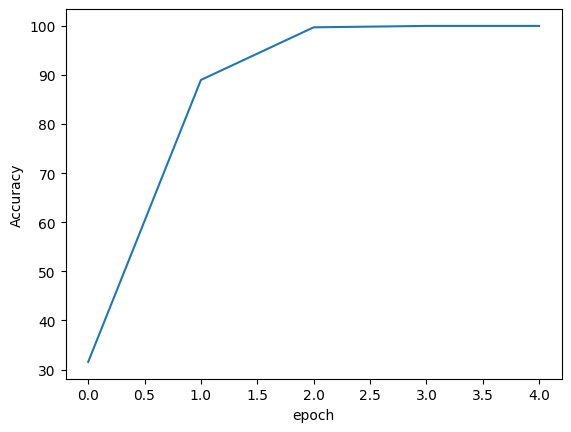

done
[]
60
20
4881


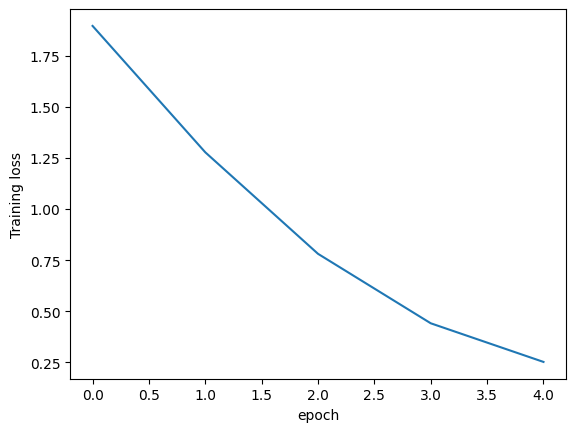

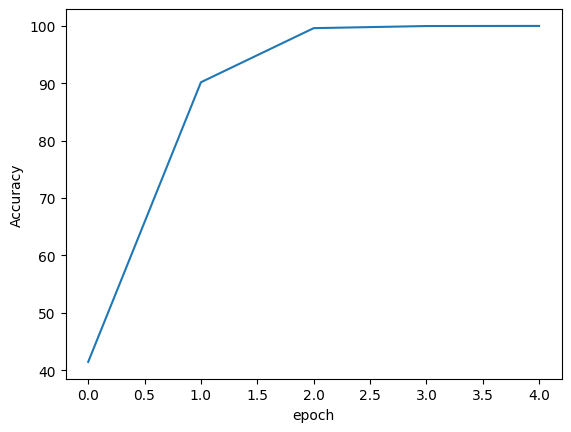

done
[]
60
tensor(0.0118)


In [9]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=30),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=30),
        nn.Linear(in_features=30 ,out_features=9),



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


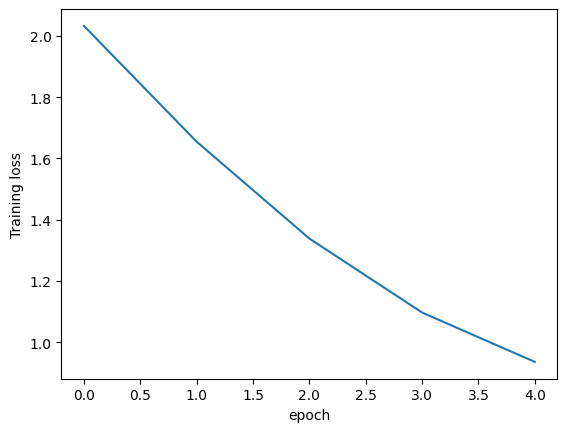

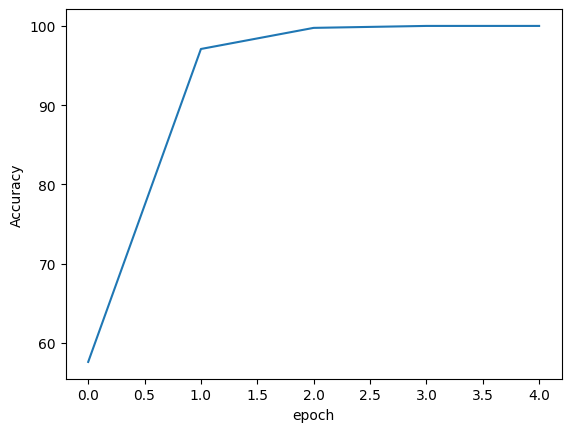

done
[]
60
20
4881


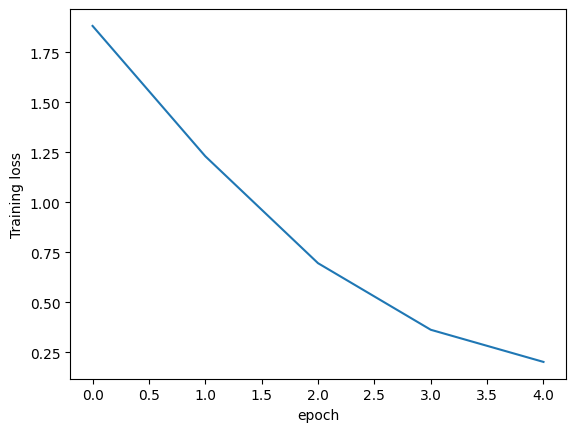

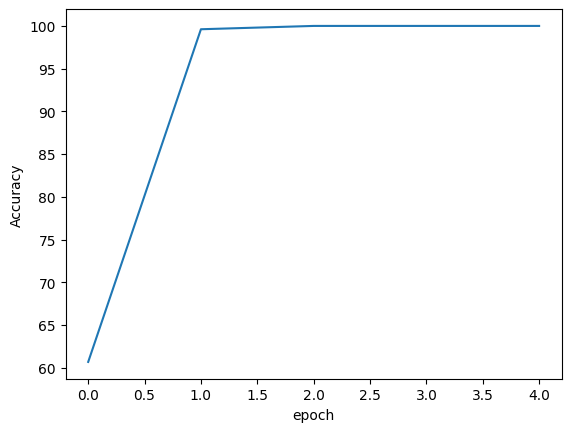

done
[]
60
20
4881


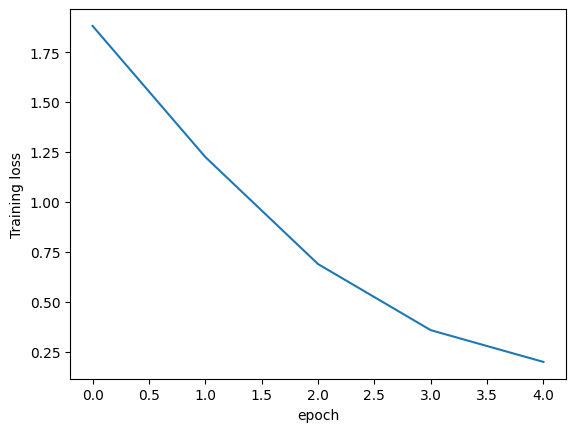

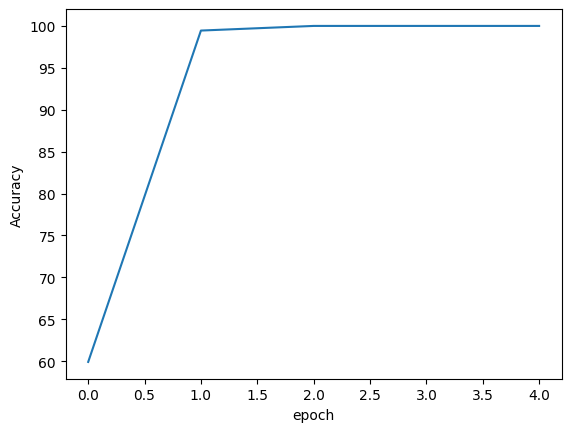

done
[]
60
20
4881


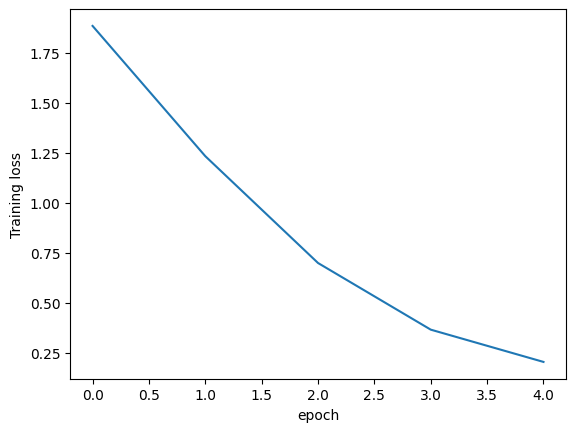

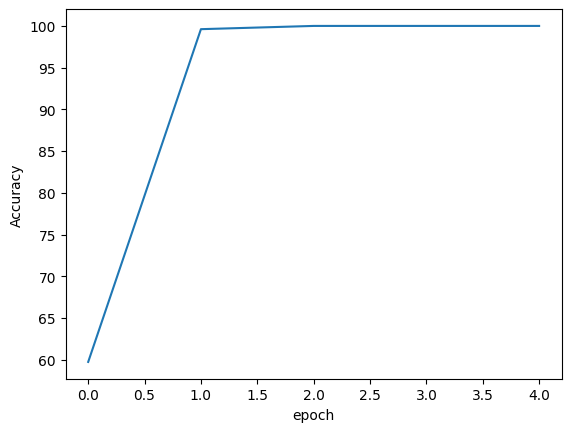

done
[]
60
20
4881


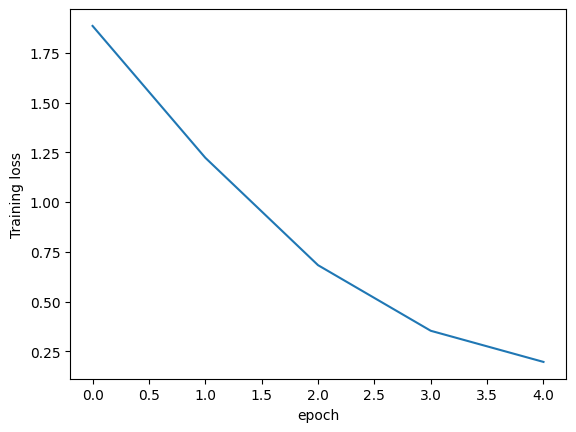

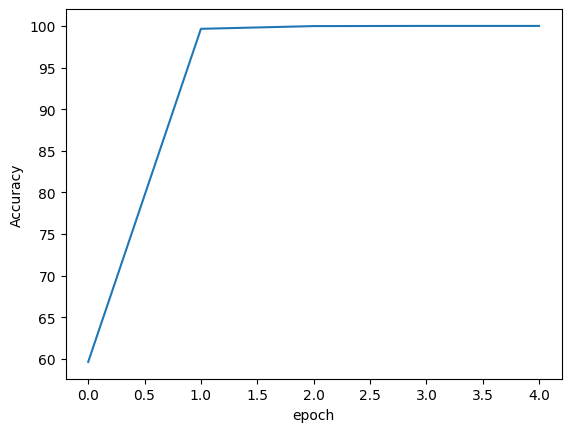

done
[]
60
tensor(0.)


In [10]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0025)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


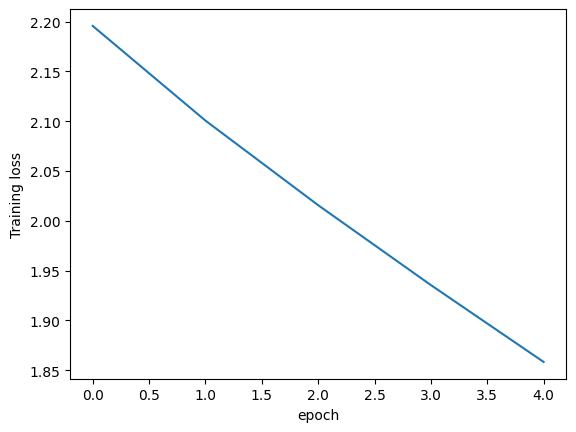

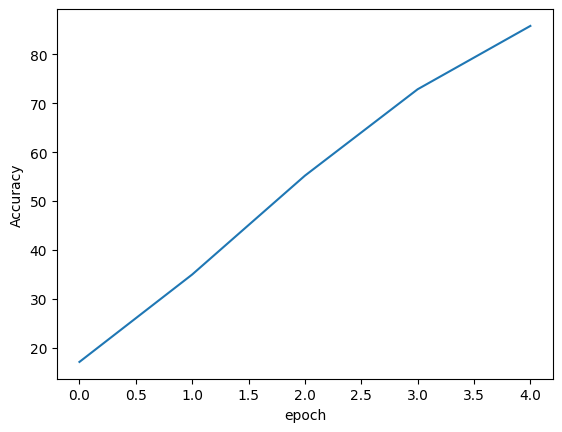

done
[]
60
20
4881


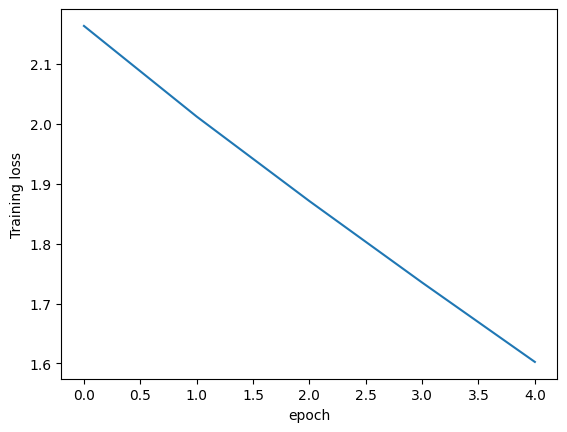

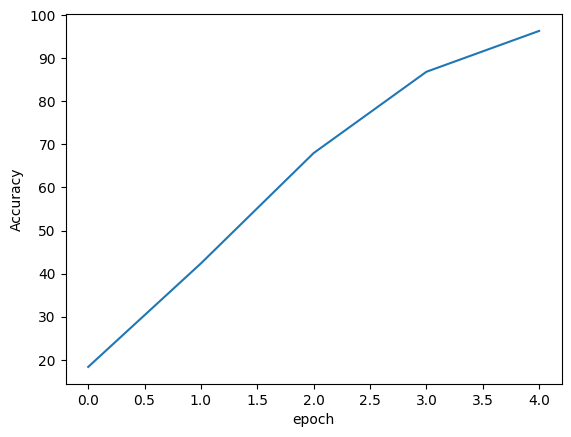

done
[]
60
20
4881


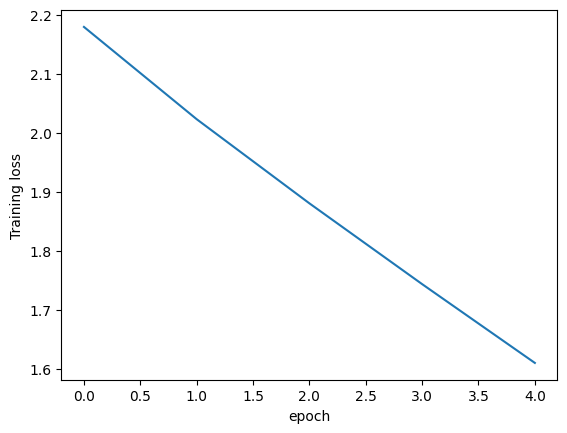

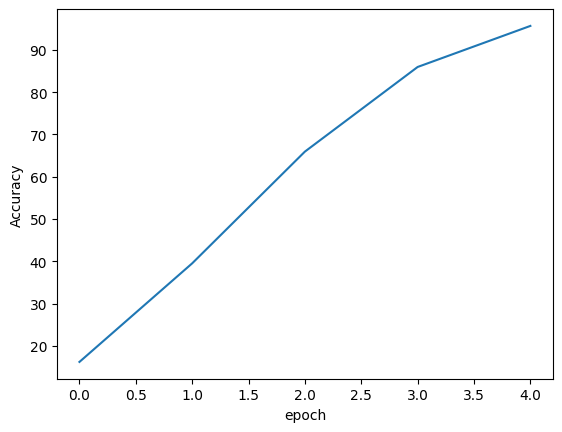

done
[]
60
20
4881


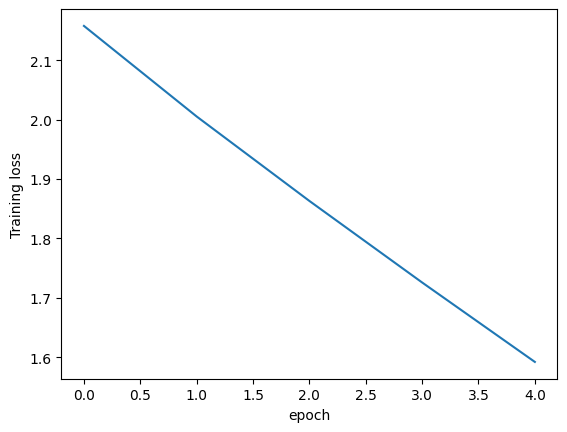

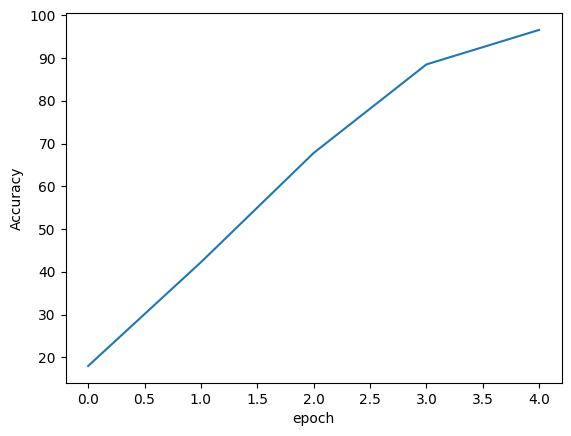

done
[]
60
20
4881


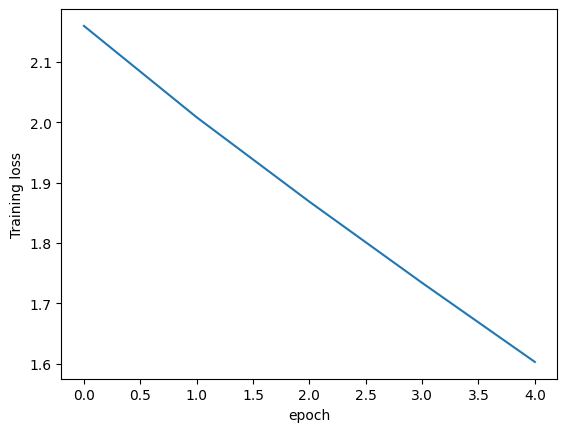

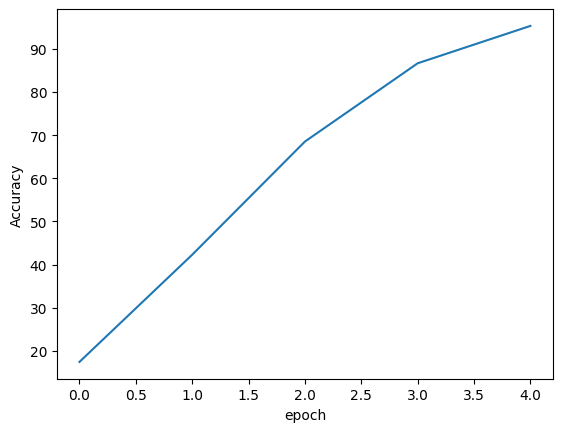

done
[]
60
tensor(0.9869)


In [11]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0005)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


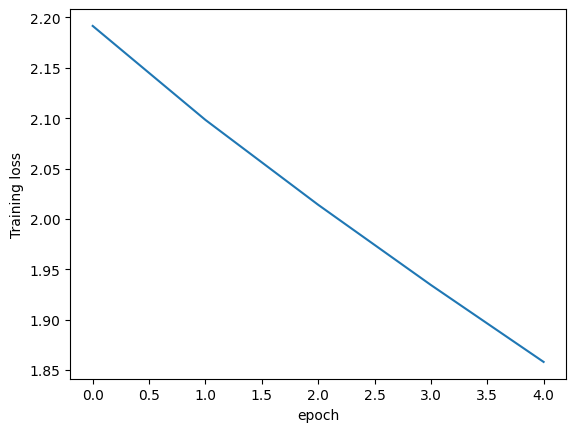

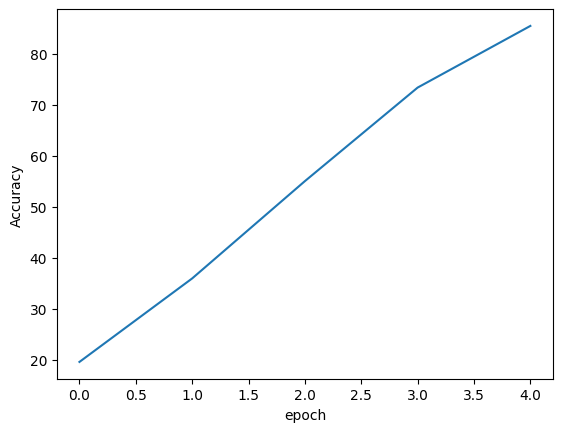

done
[]
60
20
4881


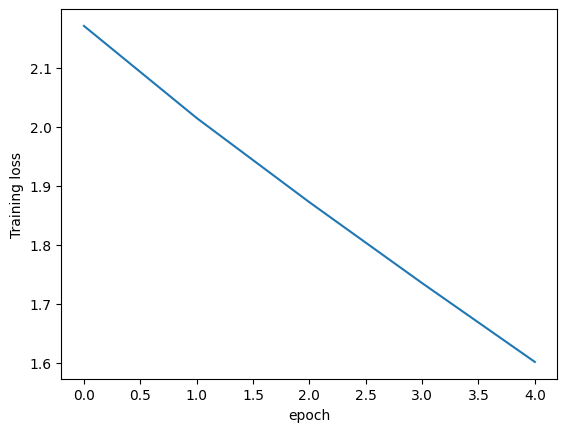

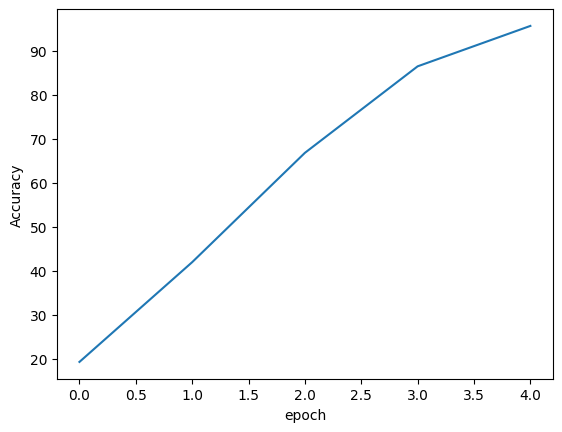

done
[]
60
20
4881


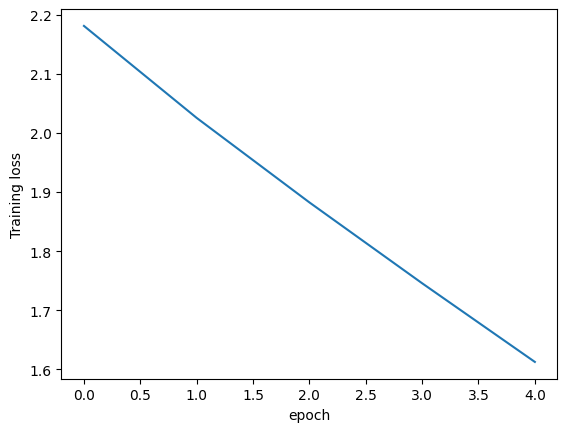

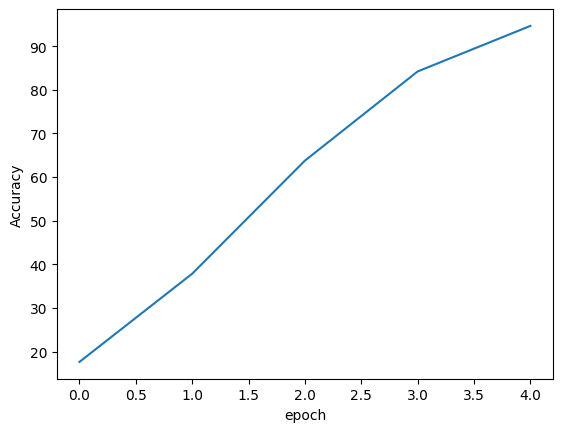

done
[]
60
20
4881


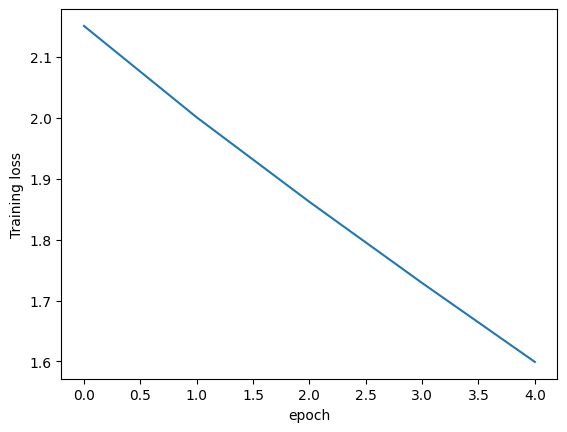

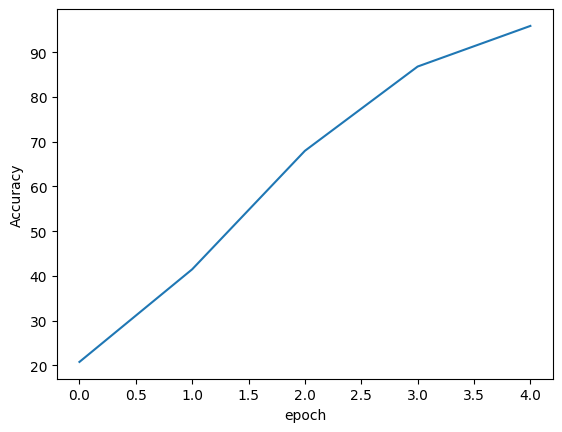

done
[]
60
20
4881


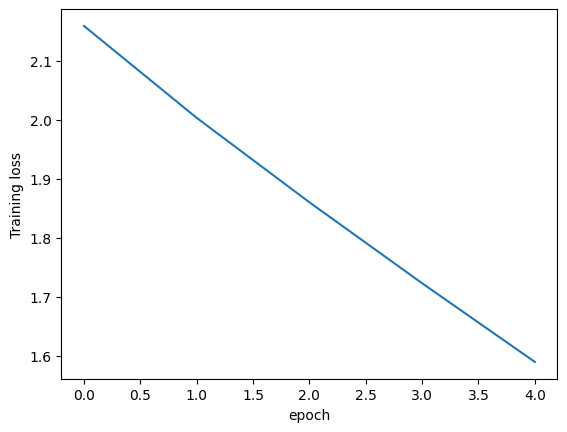

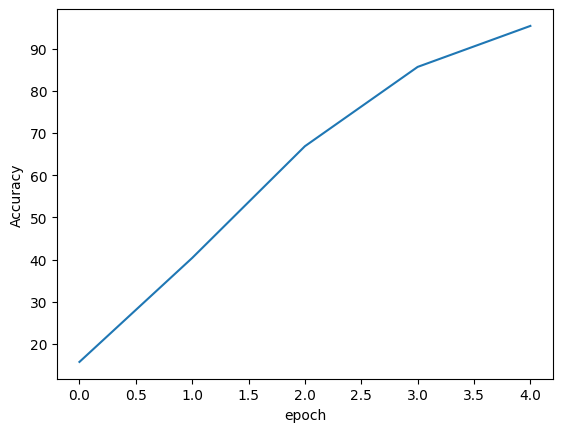

done
[]
60
tensor(0.7405)


In [12]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0005)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

Connected to Python 3.10.12

<class 'numpy.ndarray'>


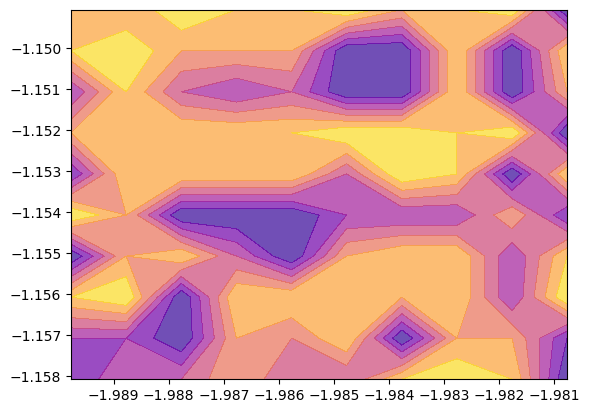

0.5301441677588467


In [1]:
# I am using all the features( more data)

import torch
from torch import nn
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn import metrics
import matplotlib.pyplot as plt
#Loading data 
X=(np.load("Data AI/X_data.npy"))


#Making matrix 7626x1280 (7626 rows and 1280 coloumns)
X=X.reshape(len(X),len(X[0])*len(X[0][0]))

labels=np.load("Data AI/label.npy")
print(type(labels))

#Training using SVM
X_train,x_test,y_train,y_test=train_test_split(X,labels,train_size=0.8, random_state=0)
k=svm.SVC(kernel="rbf",C=10, gamma=0.001,decision_function_shape="ovo").fit(X_train,y_train)
# Parameters wehere gotten from efficent robot paper
x1_min,x1_max=X[:,1].min()-1, X[:,1].max()+1
x2_min,x2_max=X[:,2].min()-1, X[:,2].max()+1
x1,x2=np.meshgrid(np.arange(x1_min,x1_max,0.001),np.arange(x2_min,x2_max,0.001))


#transforming samples into a higher dimension
Z=k.predict(x_test)
Z_origional=Z
Z=Z[:100]
#plotting countors
#reconstructing x1 and x2 to be the same size as Z
x1=x1[:10,:10]
x2=x2[:10,:10]
Z=Z.reshape(x1.shape)
plt.contourf(x1,x2,Z,cmap="plasma", alpha=0.7)
plt.scatter(X[:,0],X[:,1], c=labels,cmap=plt.cm.PuBuGn, edgecolors='red')
plt.xlim(x1.min(), x1.max())
plt.ylim(x2.min(), x2.max())
plt.show()

print(metrics.accuracy_score(Z_origional,y_test))

<class 'numpy.ndarray'>


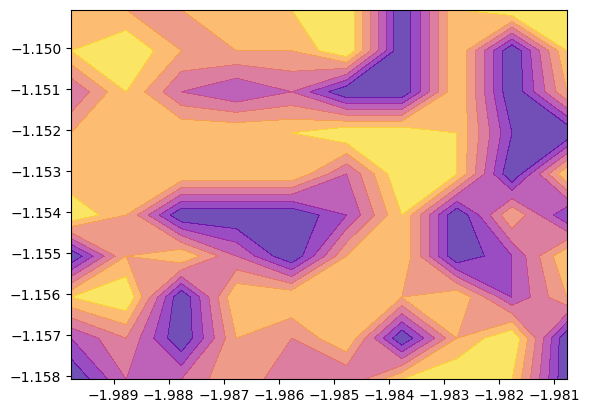

0.5321100917431193


In [2]:
# I am using all the features( more data)

import torch
from torch import nn
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn import metrics
import matplotlib.pyplot as plt
#Loading data 
X=(np.load("Data AI/X_data.npy"))


#Making matrix 7626x1280 (7626 rows and 1280 coloumns)
X=X.reshape(len(X),len(X[0])*len(X[0][0]))

labels=np.load("Data AI/label.npy")
print(type(labels))

#Training using SVM
X_train,x_test,y_train,y_test=train_test_split(X,labels,train_size=0.8, random_state=0)
k=svm.SVC(kernel="rbf",C=4, gamma=0.001,decision_function_shape="ovo").fit(X_train,y_train)
# Parameters wehere gotten from efficent robot paper
x1_min,x1_max=X[:,1].min()-1, X[:,1].max()+1
x2_min,x2_max=X[:,2].min()-1, X[:,2].max()+1
x1,x2=np.meshgrid(np.arange(x1_min,x1_max,0.001),np.arange(x2_min,x2_max,0.001))


#transforming samples into a higher dimension
Z=k.predict(x_test)
Z_origional=Z
Z=Z[:100]
#plotting countors
#reconstructing x1 and x2 to be the same size as Z
x1=x1[:10,:10]
x2=x2[:10,:10]
Z=Z.reshape(x1.shape)
plt.contourf(x1,x2,Z,cmap="plasma", alpha=0.7)
plt.scatter(X[:,0],X[:,1], c=labels,cmap=plt.cm.PuBuGn, edgecolors='red')
plt.xlim(x1.min(), x1.max())
plt.ylim(x2.min(), x2.max())
plt.show()

print(metrics.accuracy_score(Z_origional,y_test))

<class 'numpy.ndarray'>


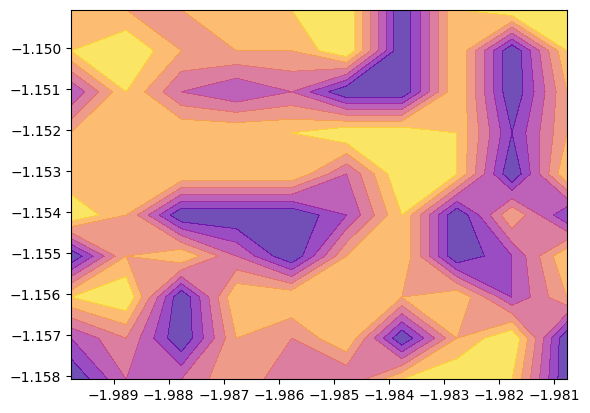

0.536697247706422


In [3]:
# I am using all the features( more data)

import torch
from torch import nn
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn import metrics
import matplotlib.pyplot as plt
#Loading data 
X=(np.load("Data AI/X_data.npy"))


#Making matrix 7626x1280 (7626 rows and 1280 coloumns)
X=X.reshape(len(X),len(X[0])*len(X[0][0]))

labels=np.load("Data AI/label.npy")
print(type(labels))

#Training using SVM
X_train,x_test,y_train,y_test=train_test_split(X,labels,train_size=0.8, random_state=0)
k=svm.SVC(kernel="rbf",C=4.5, gamma=0.001,decision_function_shape="ovo").fit(X_train,y_train)
# Parameters wehere gotten from efficent robot paper
x1_min,x1_max=X[:,1].min()-1, X[:,1].max()+1
x2_min,x2_max=X[:,2].min()-1, X[:,2].max()+1
x1,x2=np.meshgrid(np.arange(x1_min,x1_max,0.001),np.arange(x2_min,x2_max,0.001))


#transforming samples into a higher dimension
Z=k.predict(x_test)
Z_origional=Z
Z=Z[:100]
#plotting countors
#reconstructing x1 and x2 to be the same size as Z
x1=x1[:10,:10]
x2=x2[:10,:10]
Z=Z.reshape(x1.shape)
plt.contourf(x1,x2,Z,cmap="plasma", alpha=0.7)
plt.scatter(X[:,0],X[:,1], c=labels,cmap=plt.cm.PuBuGn, edgecolors='red')
plt.xlim(x1.min(), x1.max())
plt.ylim(x2.min(), x2.max())
plt.show()

print(metrics.accuracy_score(Z_origional,y_test))

<class 'numpy.ndarray'>


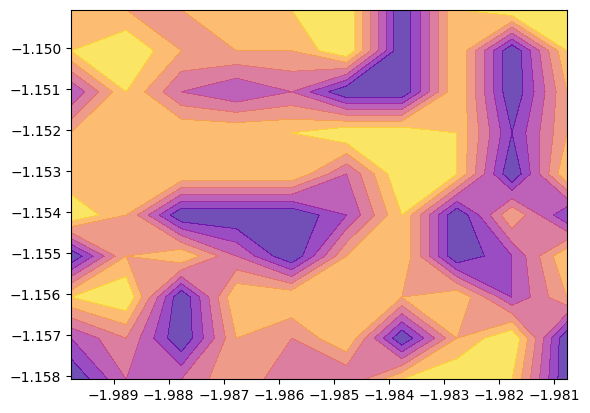

0.5373525557011796


In [4]:
# I am using all the features( more data)

import torch
from torch import nn
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn import metrics
import matplotlib.pyplot as plt
#Loading data 
X=(np.load("Data AI/X_data.npy"))


#Making matrix 7626x1280 (7626 rows and 1280 coloumns)
X=X.reshape(len(X),len(X[0])*len(X[0][0]))

labels=np.load("Data AI/label.npy")
print(type(labels))

#Training using SVM
X_train,x_test,y_train,y_test=train_test_split(X,labels,train_size=0.8, random_state=0)
k=svm.SVC(kernel="rbf",C=4.65, gamma=0.001,decision_function_shape="ovo").fit(X_train,y_train)
# Parameters wehere gotten from efficent robot paper
x1_min,x1_max=X[:,1].min()-1, X[:,1].max()+1
x2_min,x2_max=X[:,2].min()-1, X[:,2].max()+1
x1,x2=np.meshgrid(np.arange(x1_min,x1_max,0.001),np.arange(x2_min,x2_max,0.001))


#transforming samples into a higher dimension
Z=k.predict(x_test)
Z_origional=Z
Z=Z[:100]
#plotting countors
#reconstructing x1 and x2 to be the same size as Z
x1=x1[:10,:10]
x2=x2[:10,:10]
Z=Z.reshape(x1.shape)
plt.contourf(x1,x2,Z,cmap="plasma", alpha=0.7)
plt.scatter(X[:,0],X[:,1], c=labels,cmap=plt.cm.PuBuGn, edgecolors='red')
plt.xlim(x1.min(), x1.max())
plt.ylim(x2.min(), x2.max())
plt.show()

print(metrics.accuracy_score(Z_origional,y_test))

Connected to Python 3.10.12

In [1]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
#Loading data 
X=(np.load("Data AI/X_data.npy"))
X=X.reshape(len(X),len(X[0])*len(X[0][0]))
labels=np.load("Data AI/label.npy")
print(type(labels))

distribution=torch.tensor([0]*9)

# This algorithm is so easy to implement and even easier to optimize due to the lack of parameters.
# 80% of data to train and 20% for testing
X_train,x_test,y_train,y_test=train_test_split(X,labels,train_size=0.8, random_state=0)
knn=KNeighborsClassifier(n_neighbors=1, p=2) #Using the Ecludian distance
knn.fit(X_train,y_train)
y_pred=knn.predict(x_test)
print(metrics.accuracy_score(y_pred,y_test))
print("whoo")

<class 'numpy.ndarray'>
0.24639580602883354
whoo


7626
Data loaded
20
4881


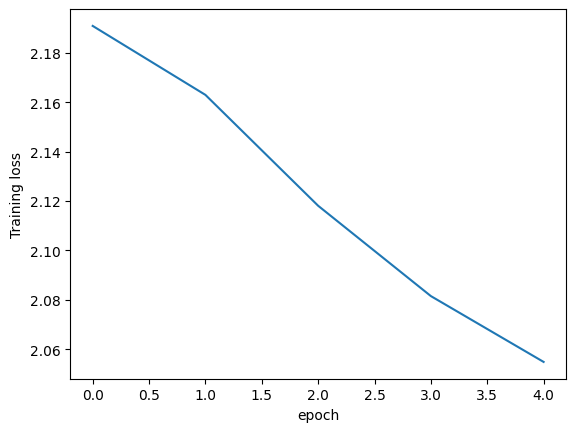

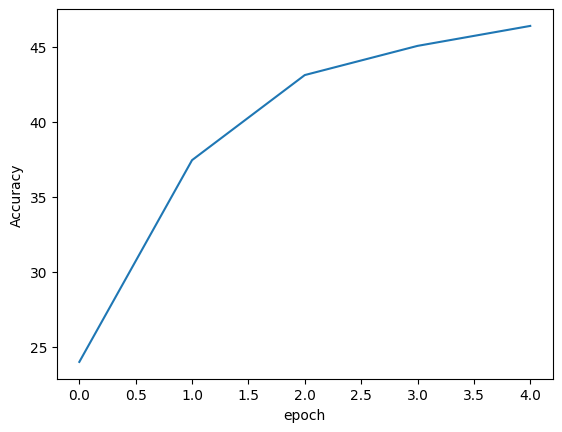

done
[]
60
20
4881


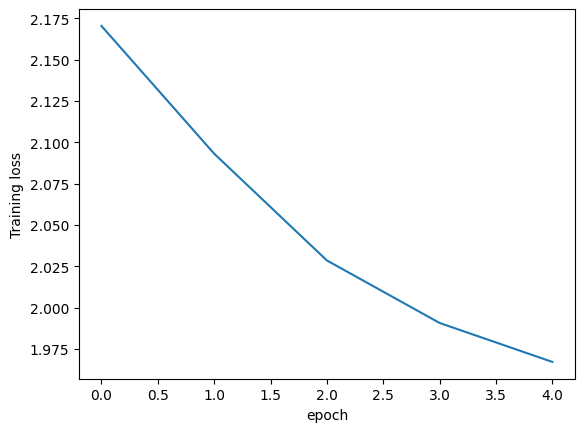

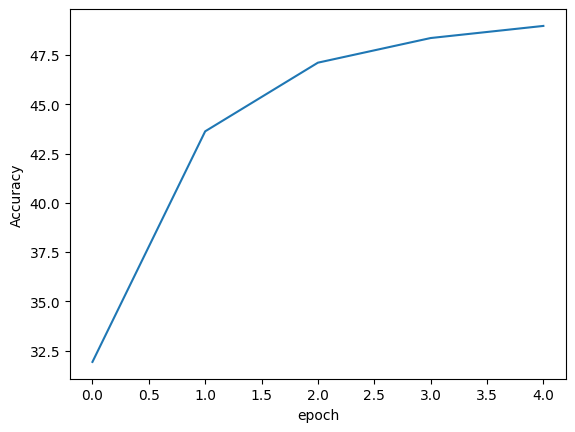

done
[]
60
20
4881


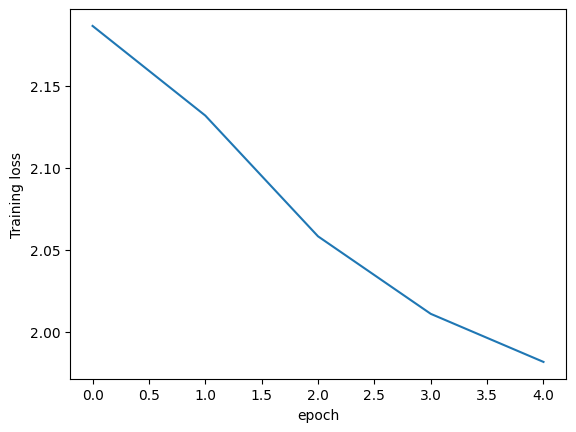

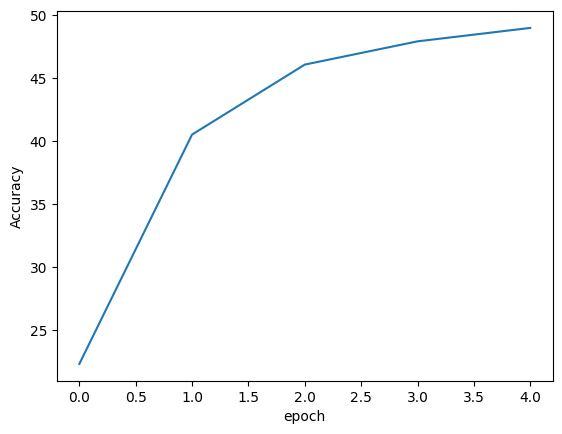

done
[]
60
20
4881


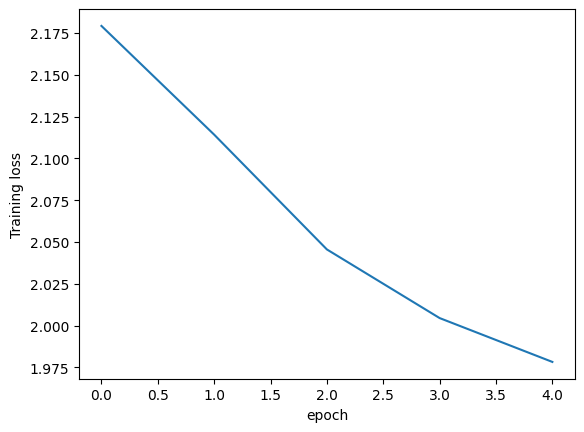

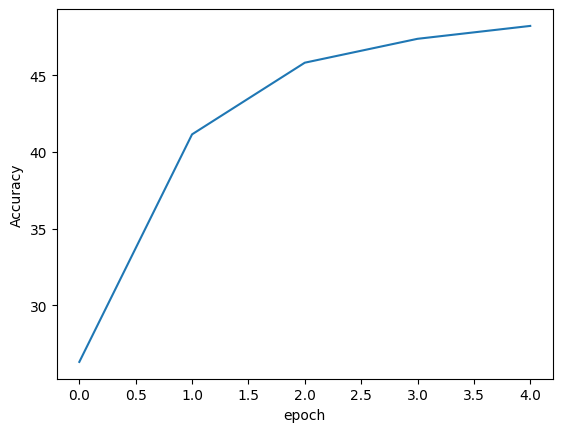

done
[]
60
20
4881


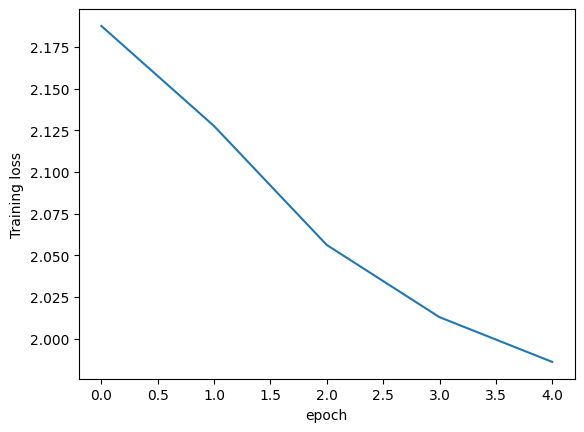

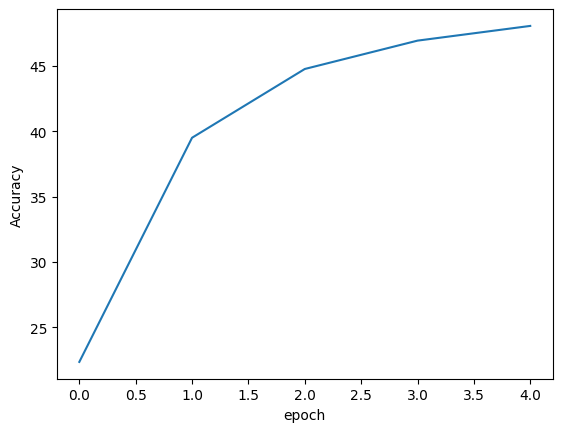

done
[]
60
tensor(1.6409)


In [2]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


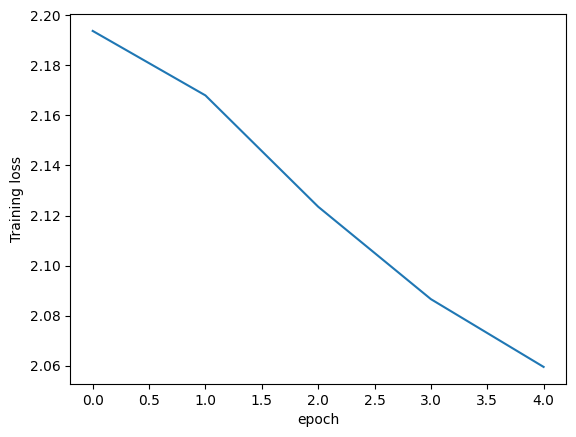

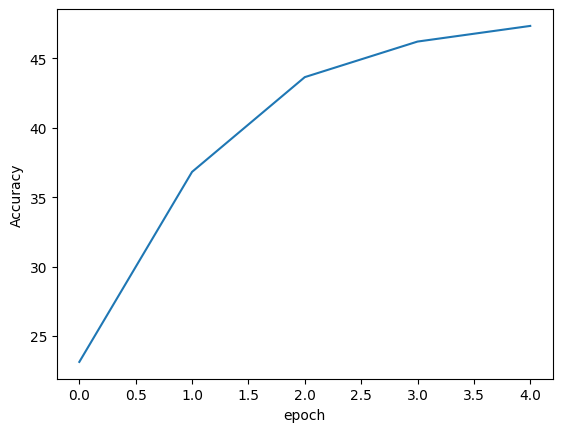

done
[]
60
20
4881


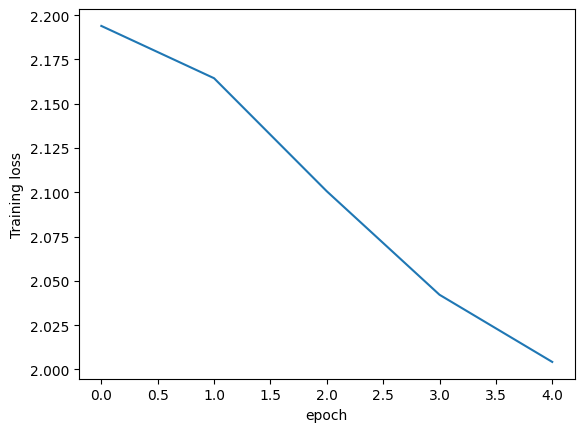

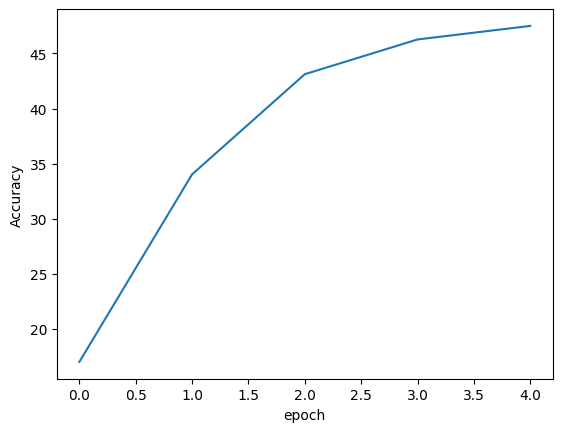

done
[]
60
20
4881


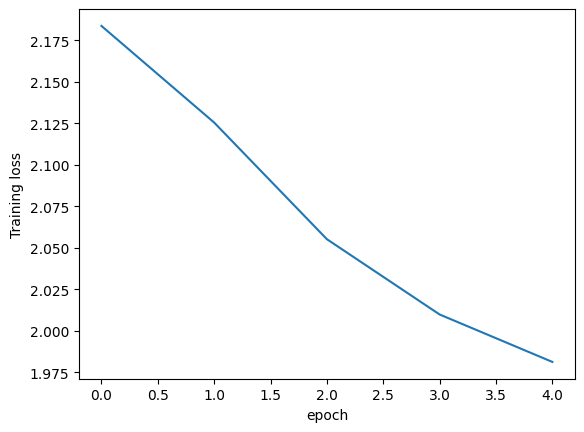

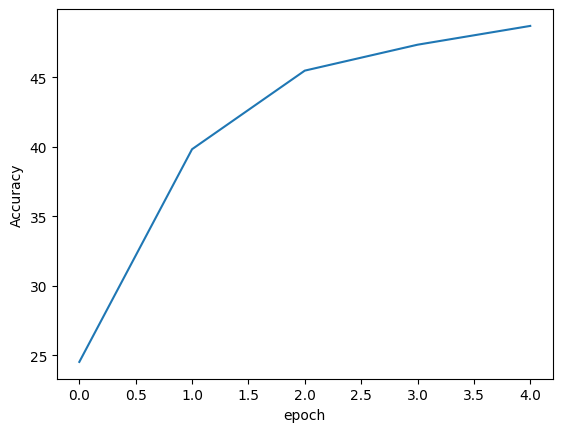

done
[]
60
20
4881


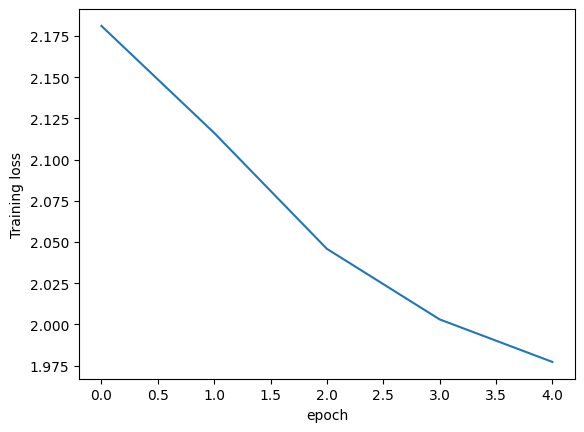

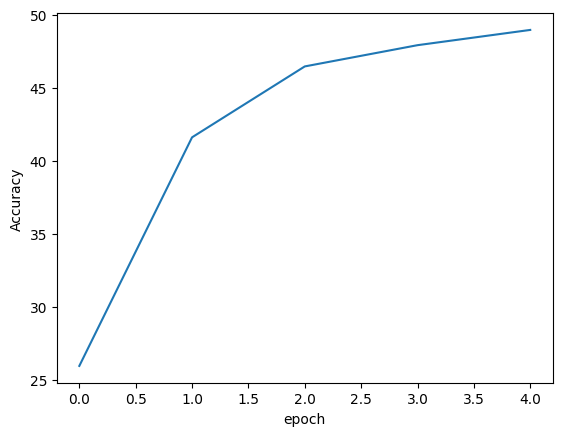

done
[]
60
20
4881


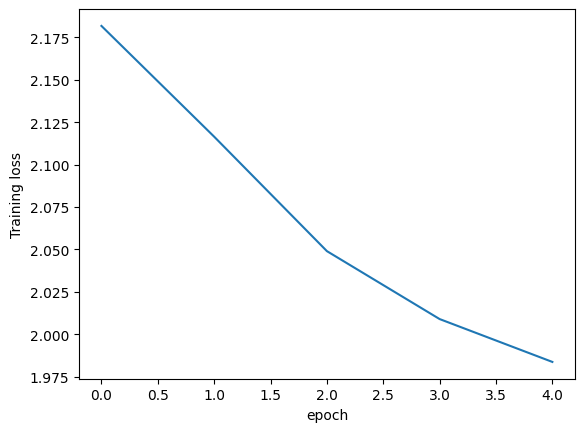

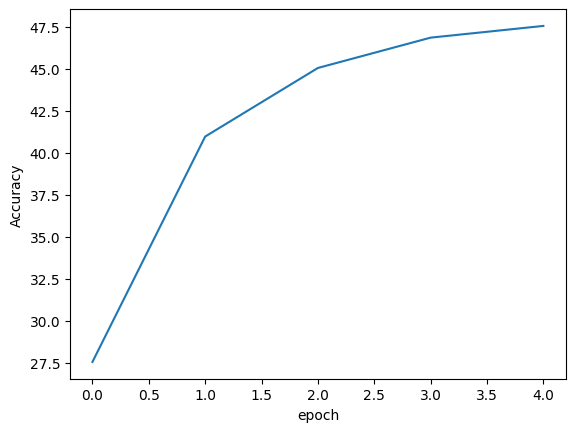

done
[]
60
tensor(0.4954)


In [3]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


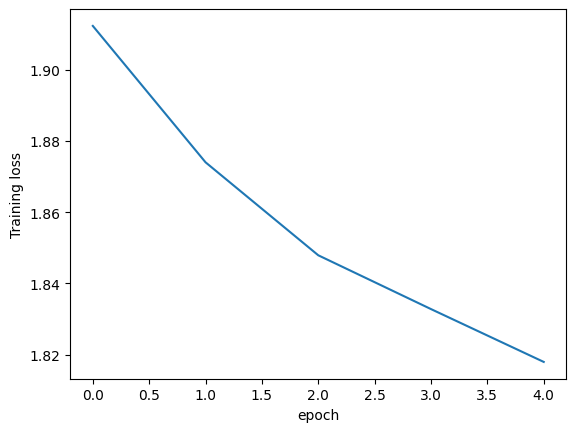

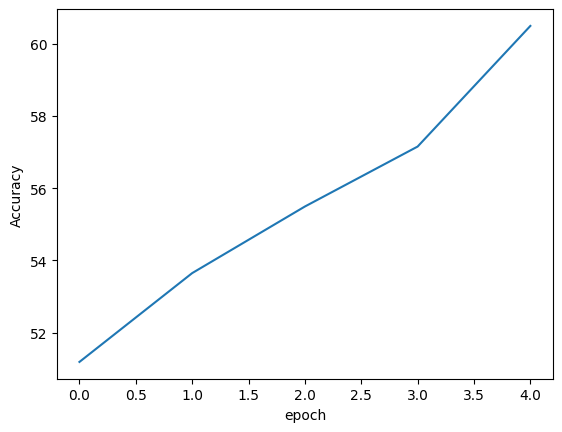

done
[]
60
20
4881


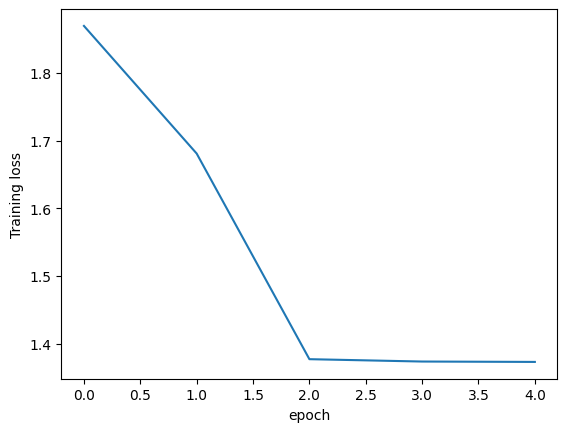

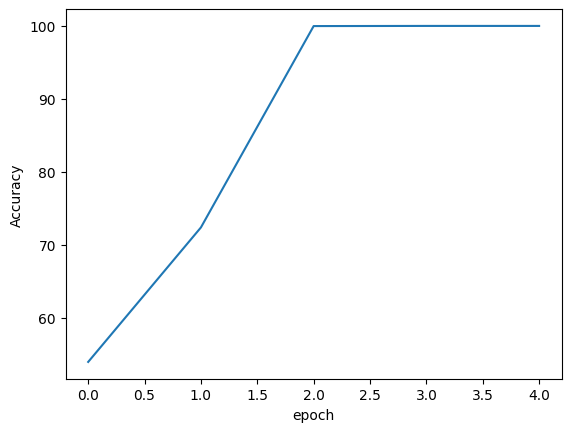

done
[]
60
20
4881


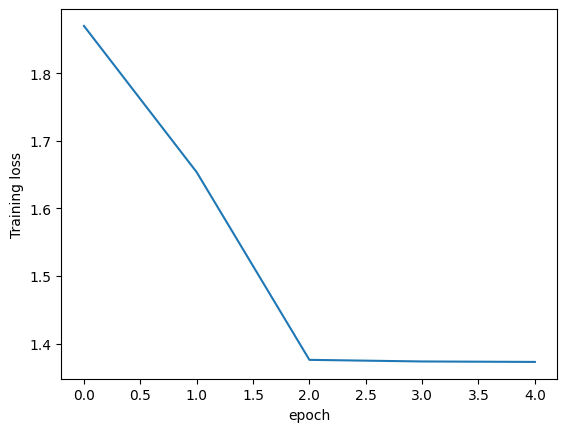

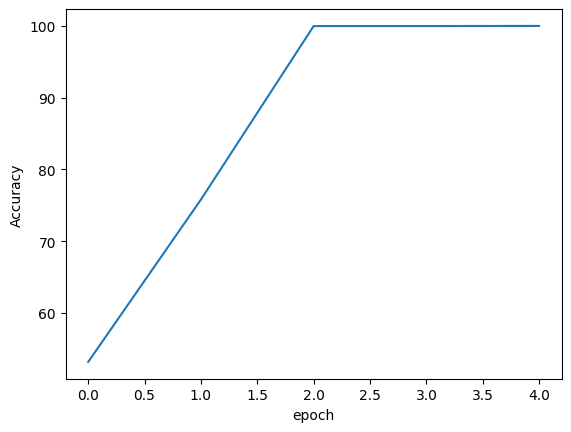

done
[]
60
20
4881


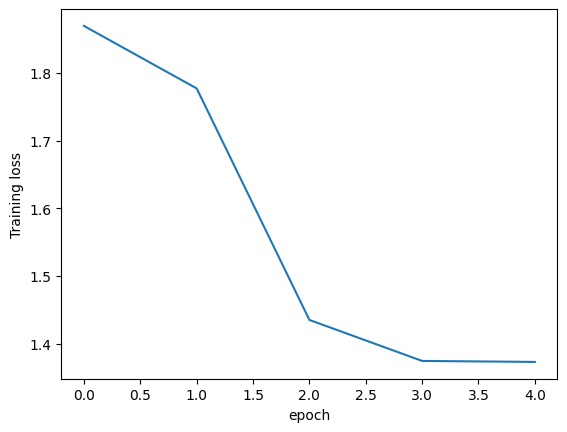

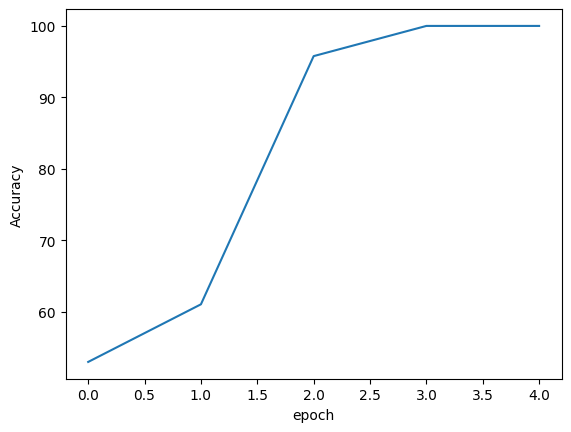

done
[]
60
20
4881


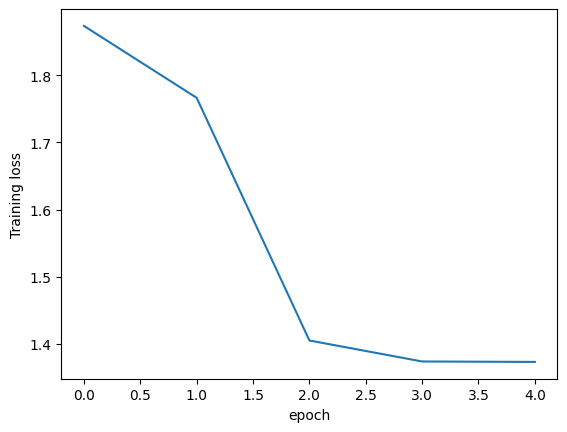

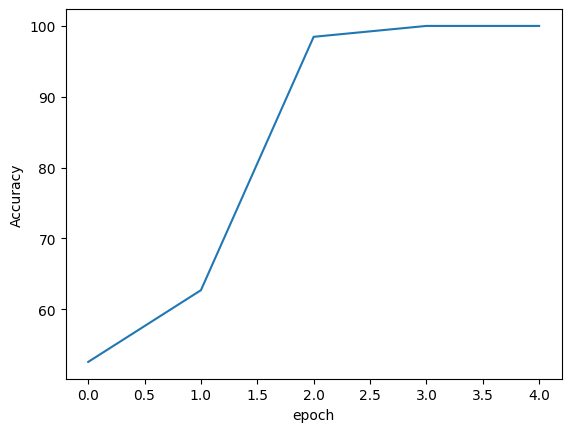

done
[]
60
tensor(0.0066)


In [4]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


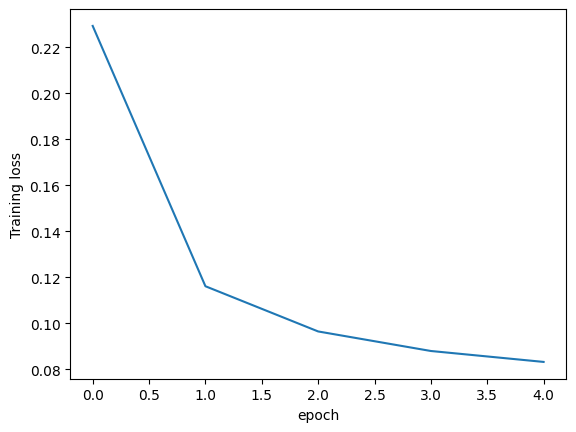

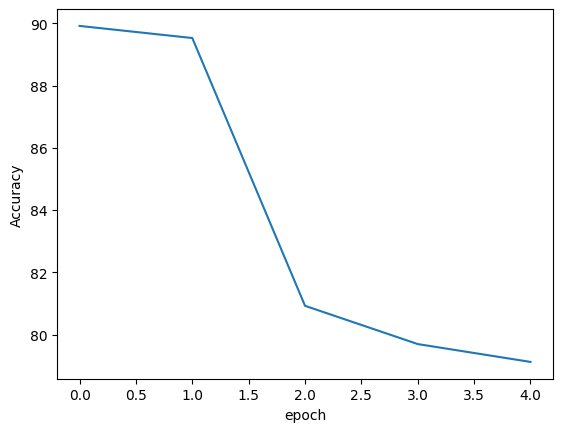

done
[]
60
20
4881


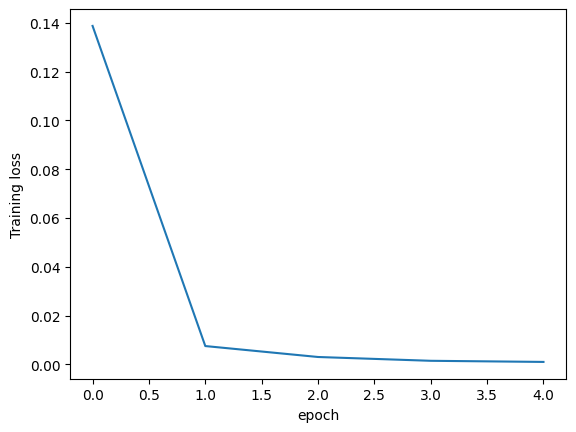

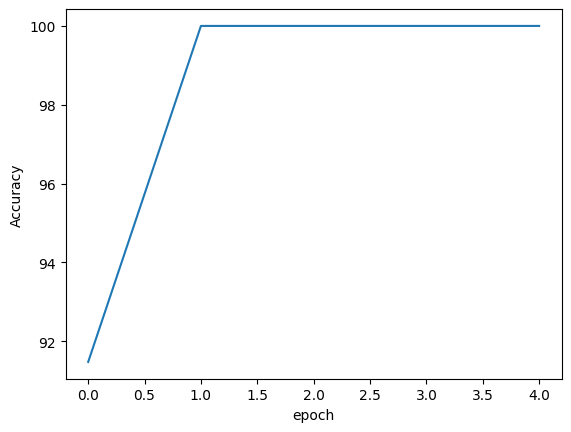

done
[]
60
20
4881


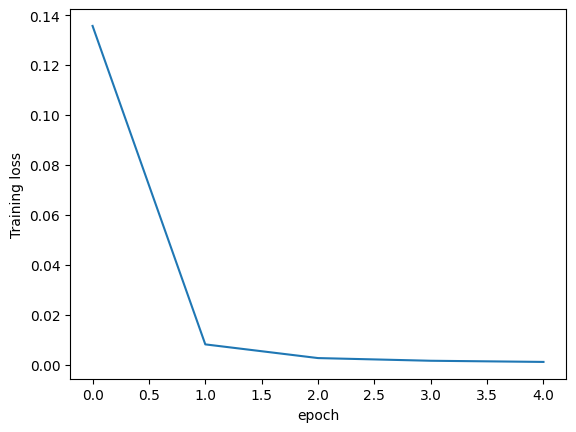

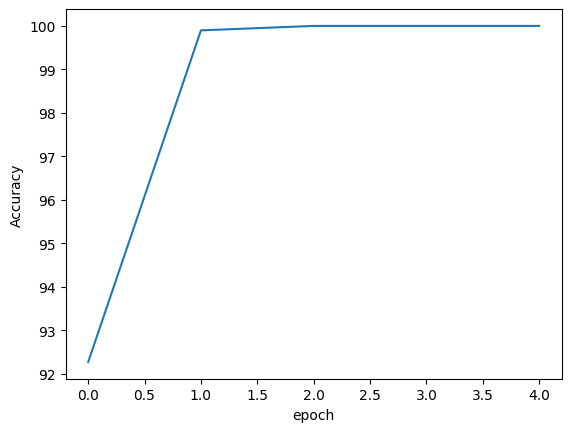

done
[]
60
20
4881


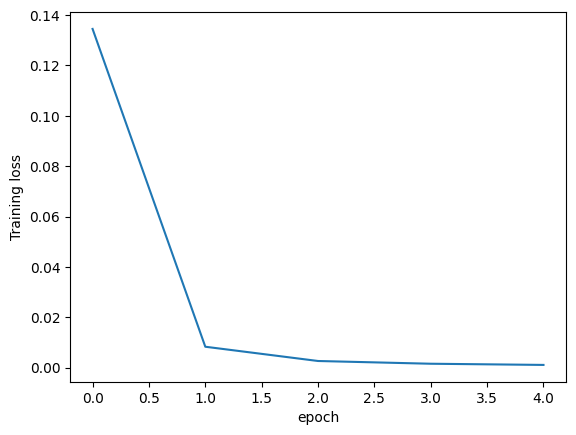

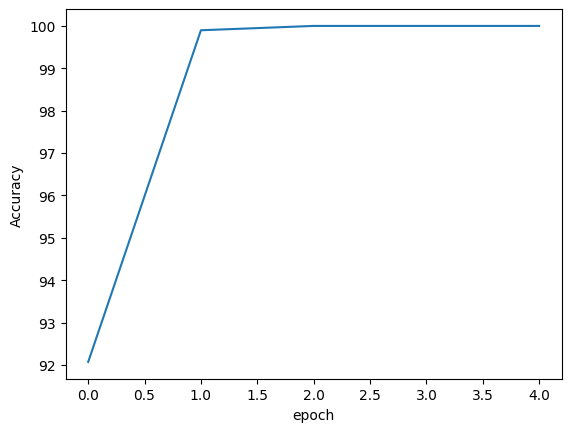

done
[]
60
20
4881


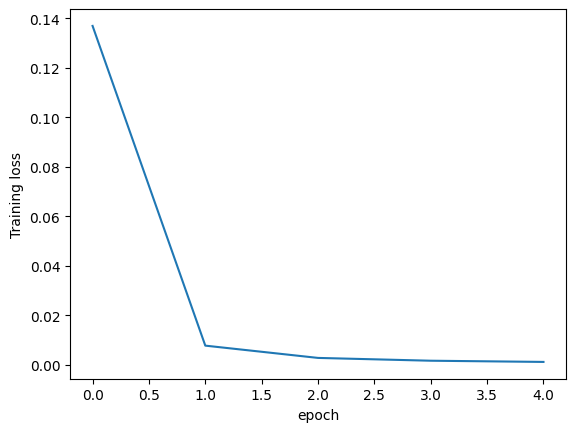

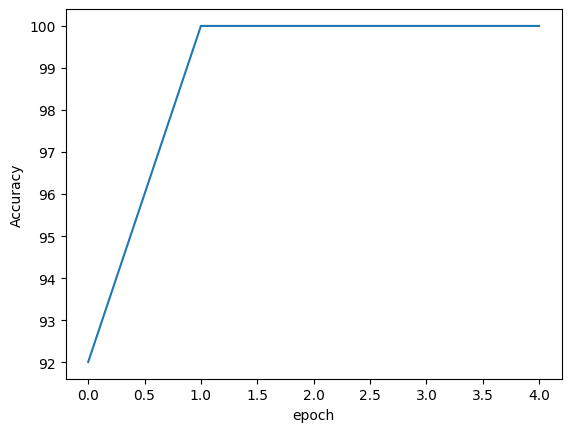

done
[]
60
tensor(0.)


In [5]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


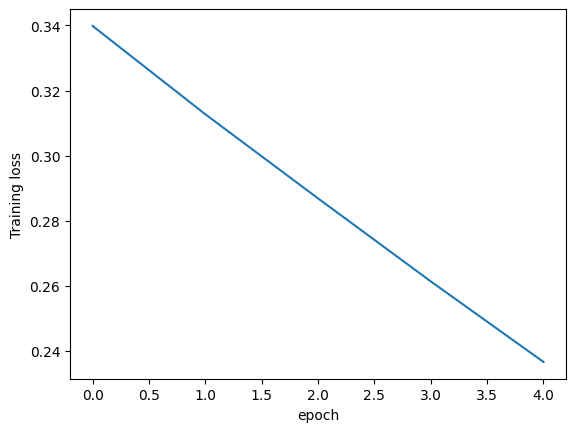

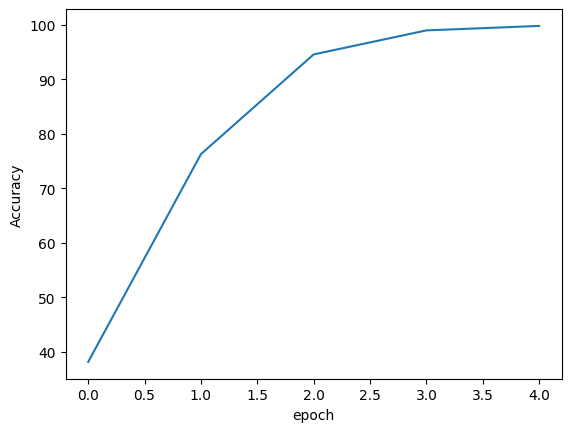

done
[]
60
20
4881


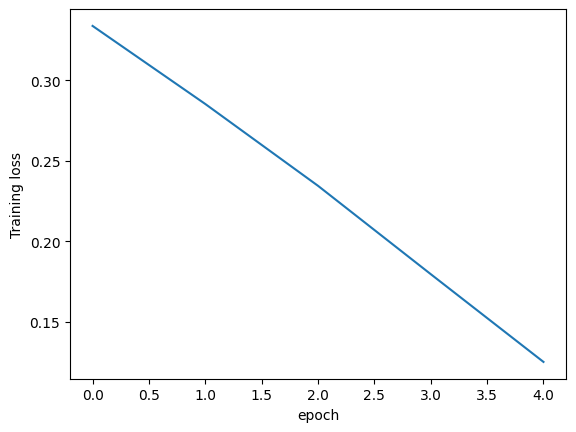

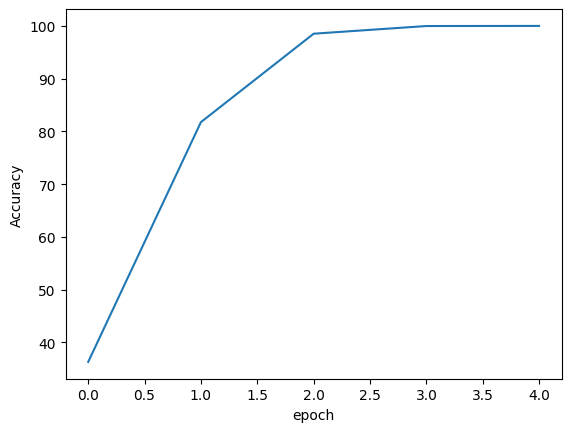

done
[]
60
20
4881


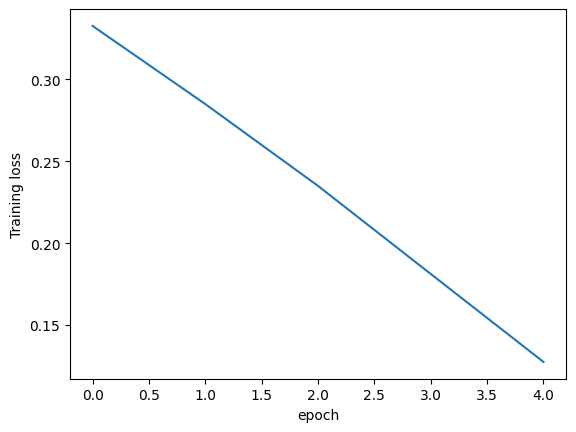

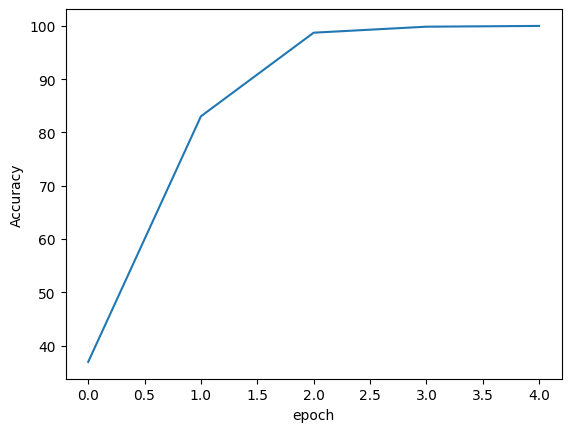

done
[]
60
20
4881


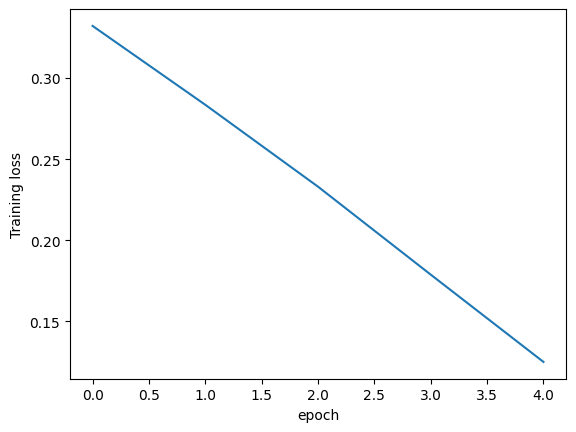

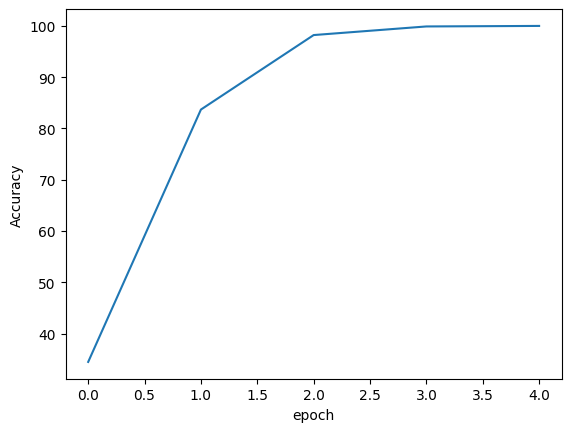

done
[]
60
20
4881


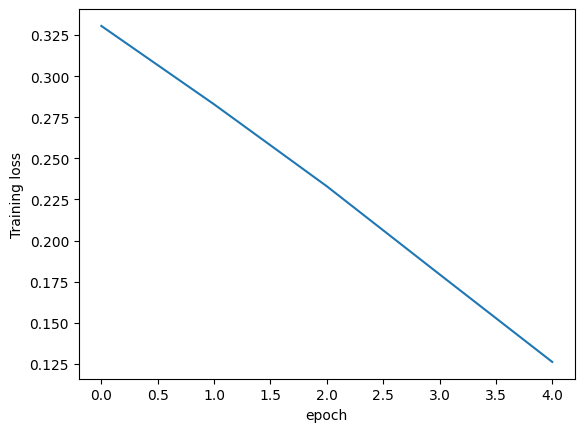

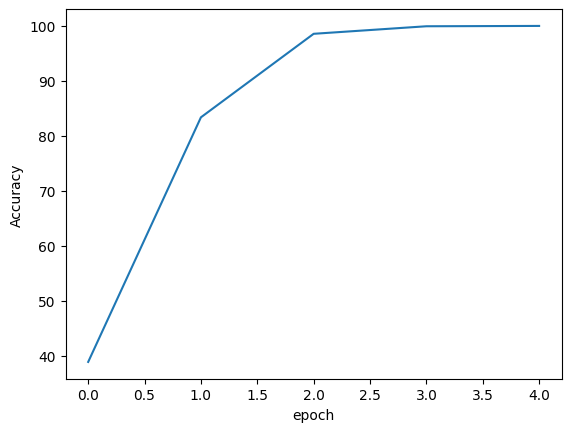

done
[]
60
tensor(0.2595)


In [6]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


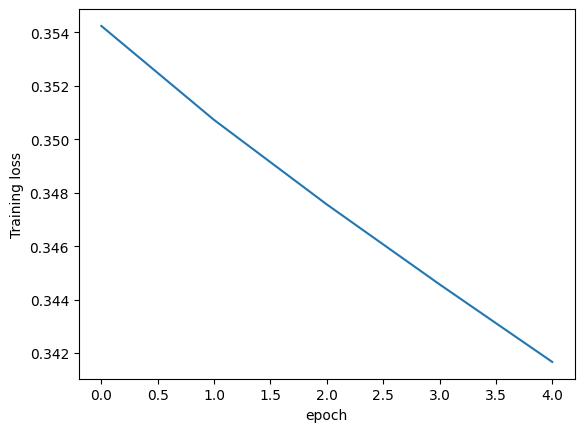

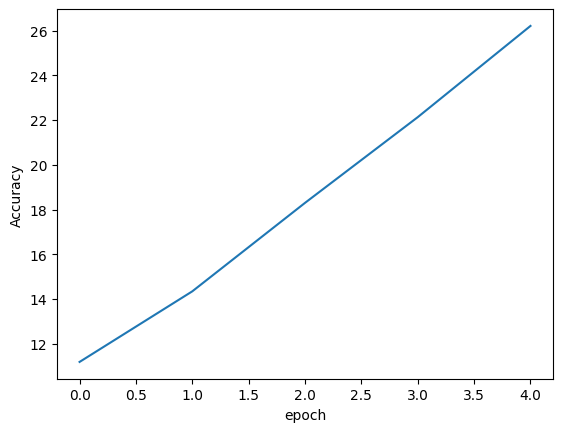

done
[]
60
20
4881


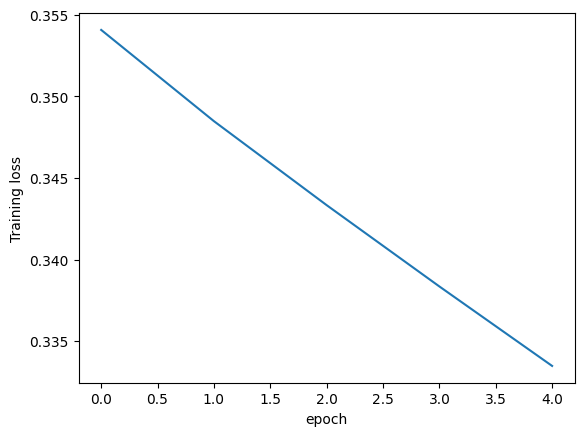

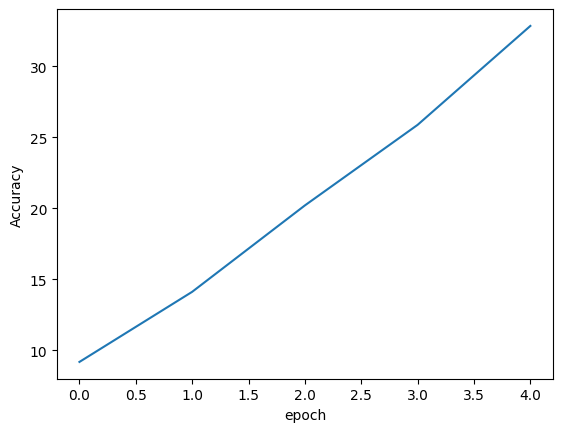

done
[]
60
20
4881


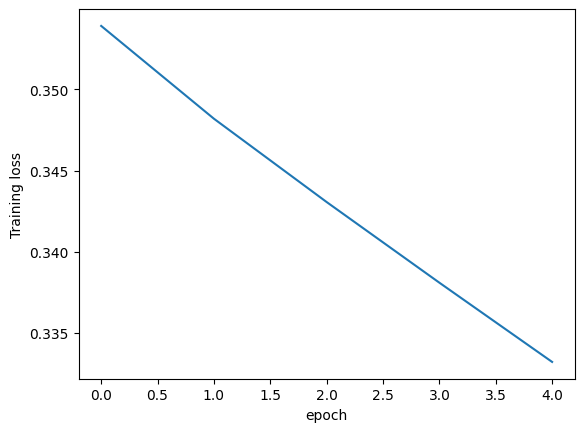

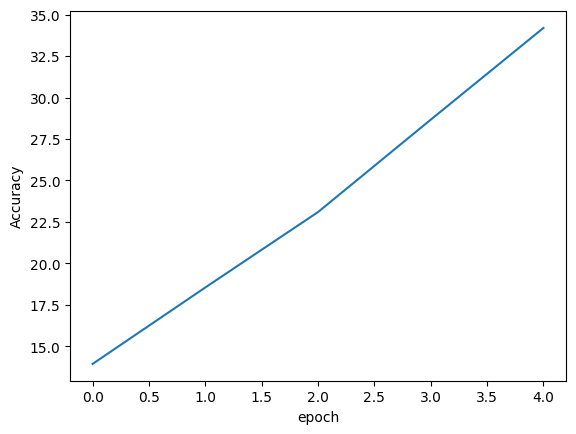

done
[]
60
20
4881


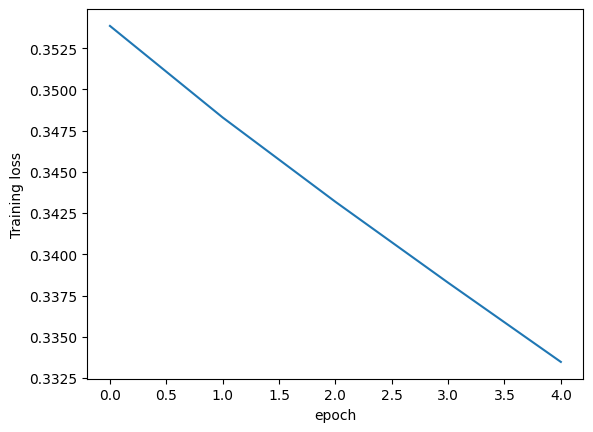

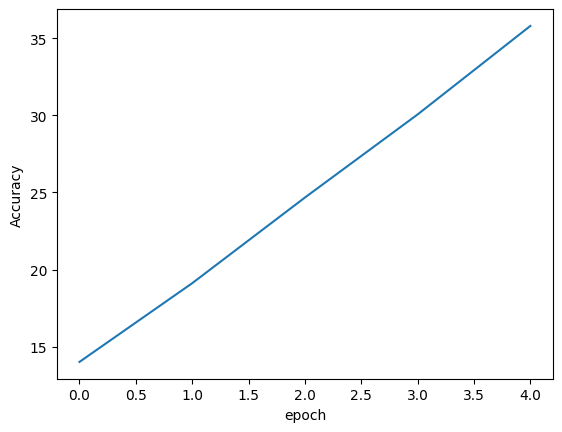

done
[]
60
20
4881


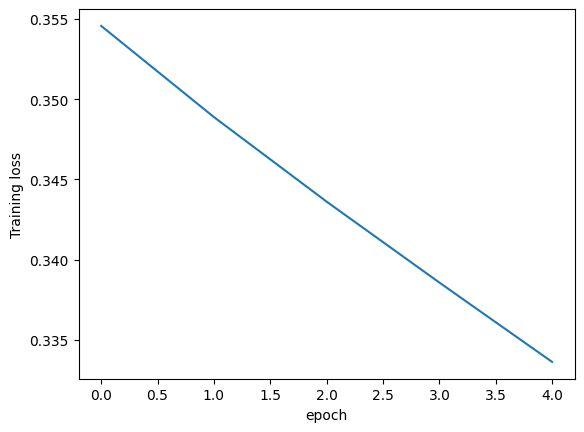

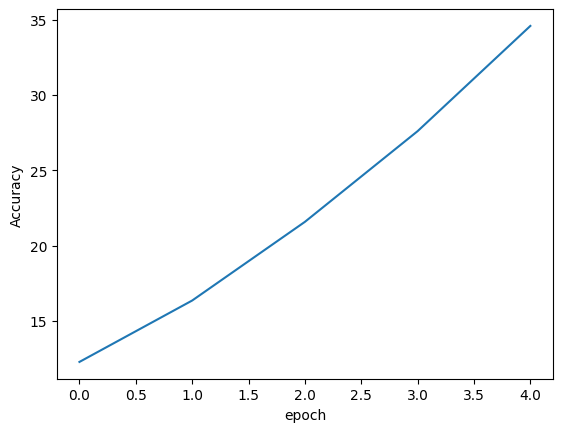

done
[]
60
tensor(1.6999)


In [7]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


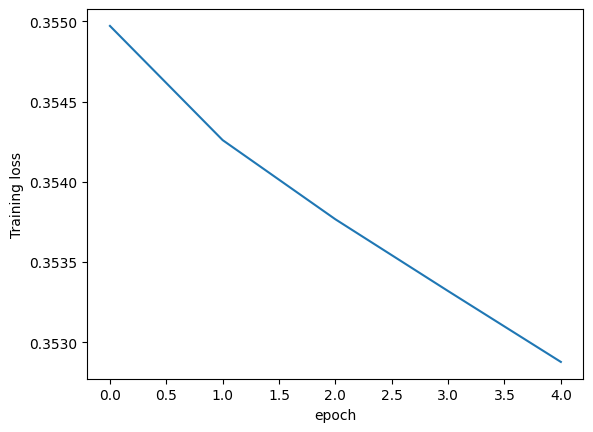

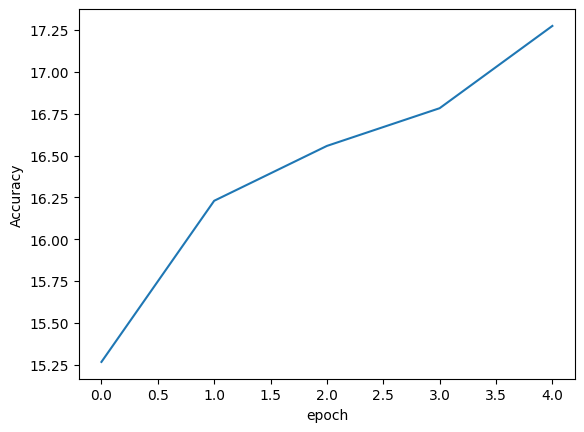

done
[]
60
20
4881


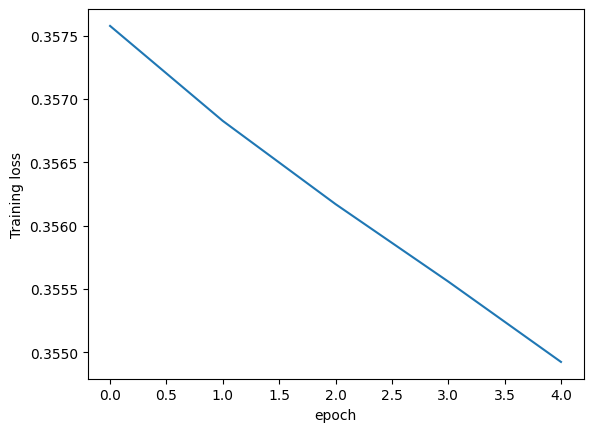

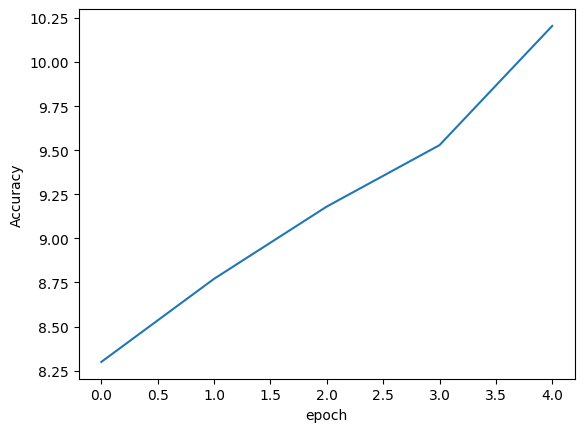

done
[]
60
20
4881


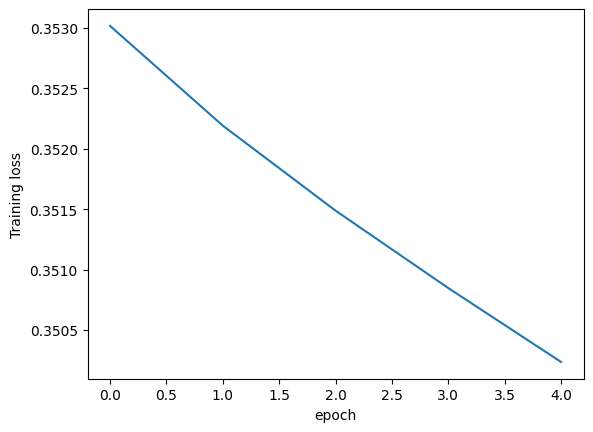

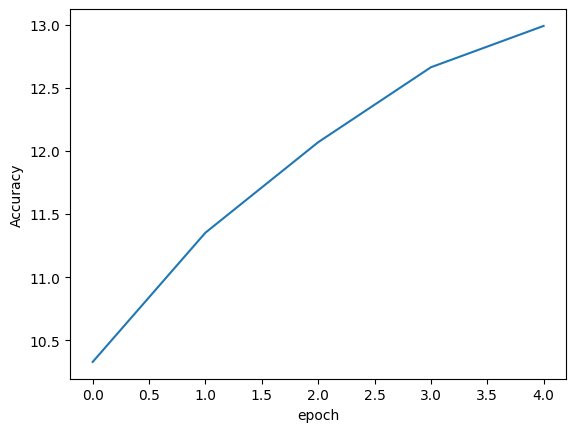

done
[]
60
20
4881


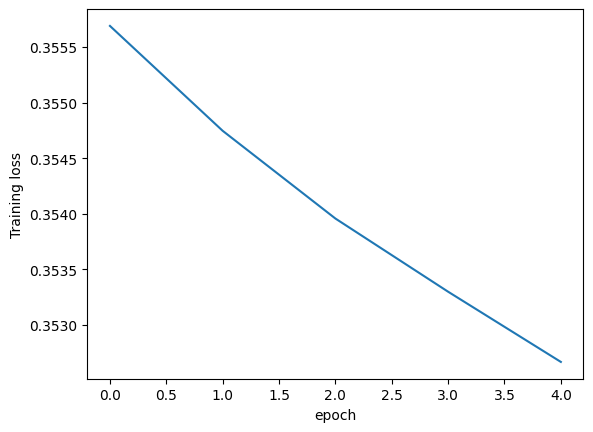

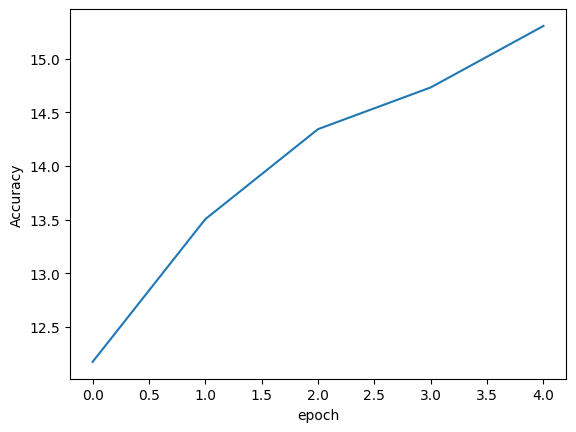

done
[]
60
20
4881


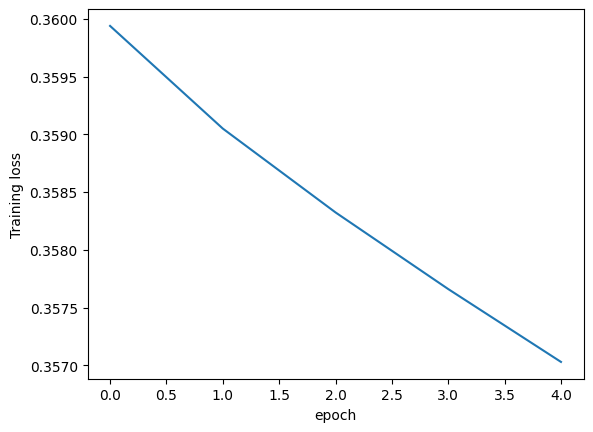

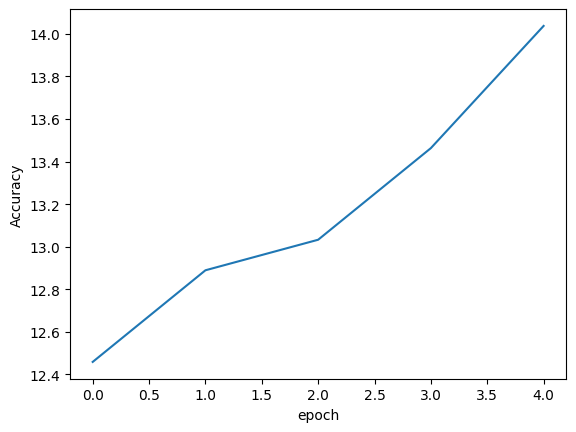

done
[]
60
tensor(1.0328)


In [8]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


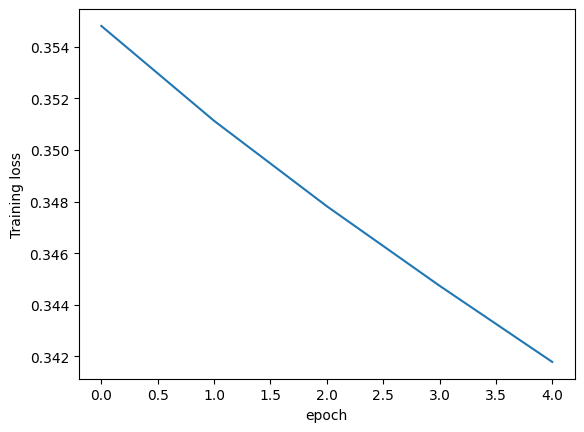

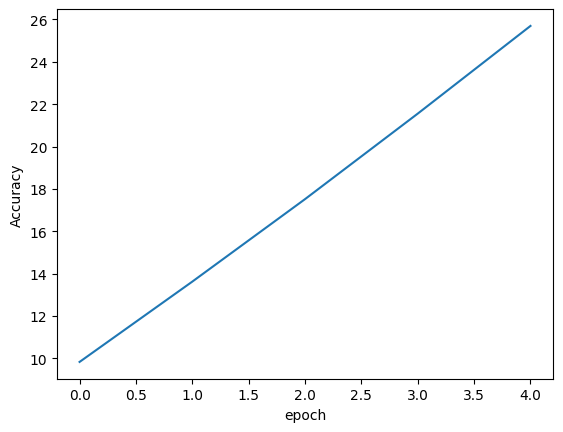

done
[]
60
20
4881


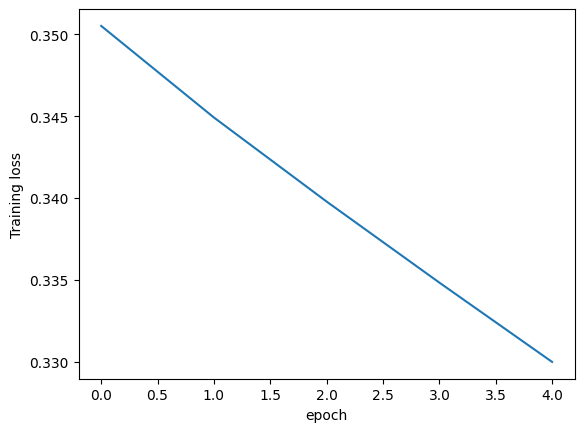

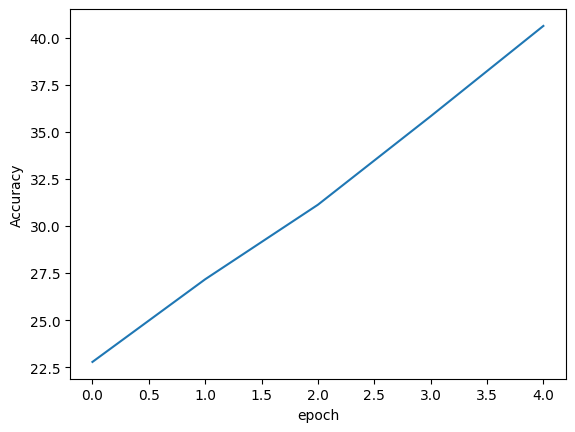

done
[]
60
20
4881


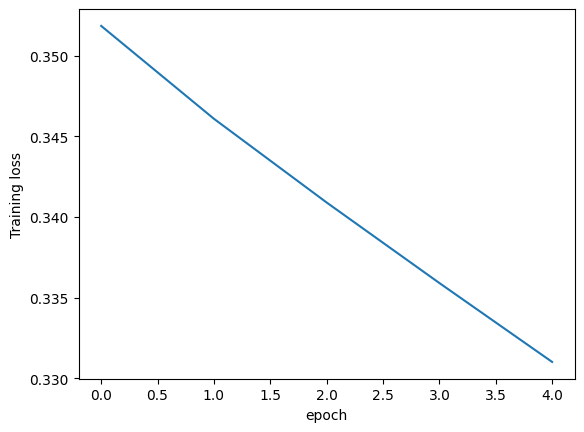

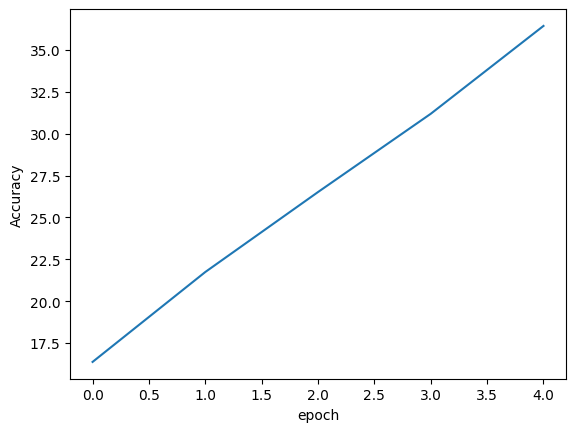

done
[]
60
20
4881


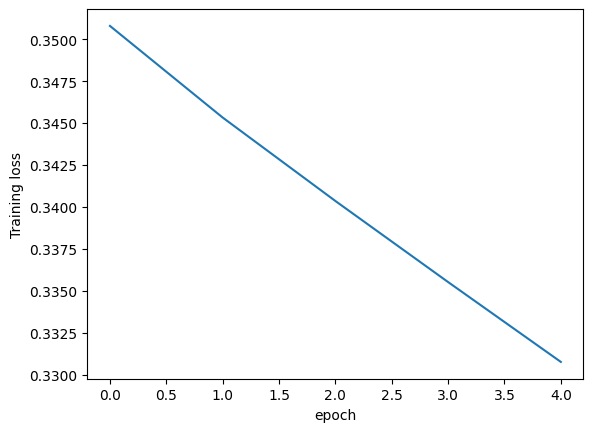

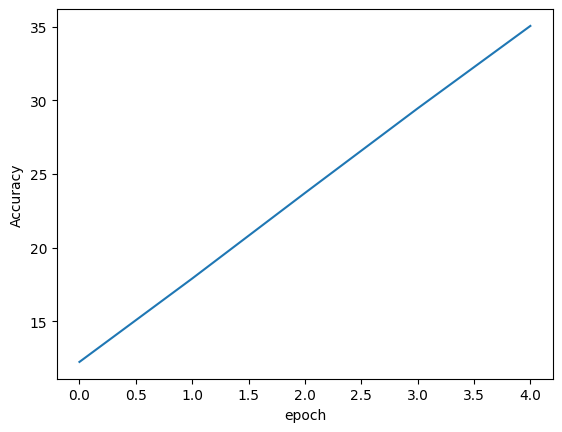

done
[]
60
20
4881


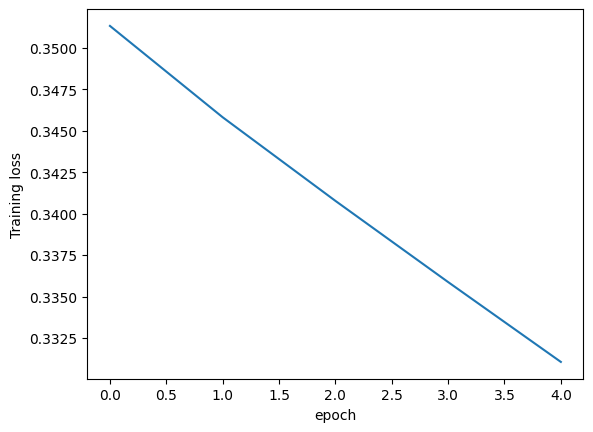

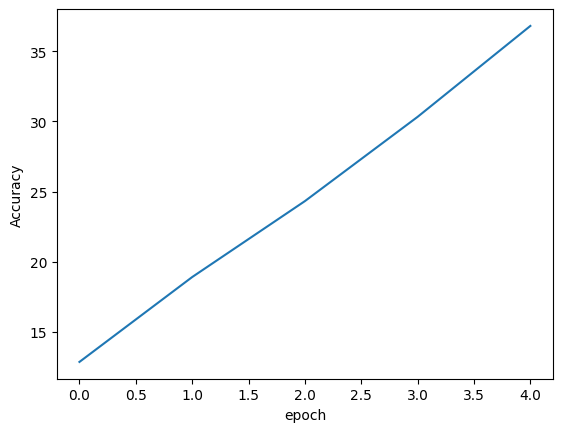

done
[]
60
tensor(0.6894)


In [9]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

In [11]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.KLDivLoss(log_target=True,reduction="none")

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


RuntimeError: grad can be implicitly created only for scalar outputs

7626
Data loaded
20
4881


/home/lol123tiger/.local/lib/python3.10/site-packages/torch/nn/functional.py:2943: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


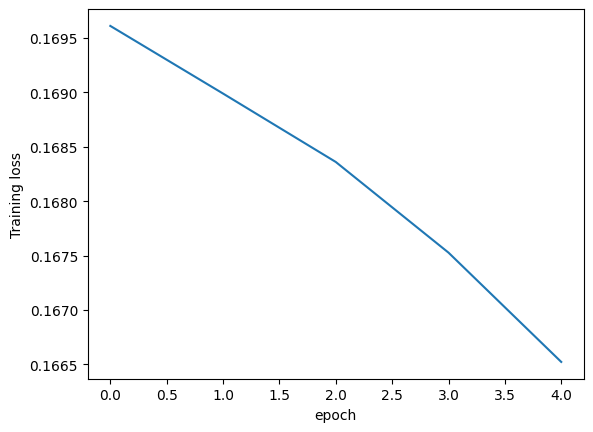

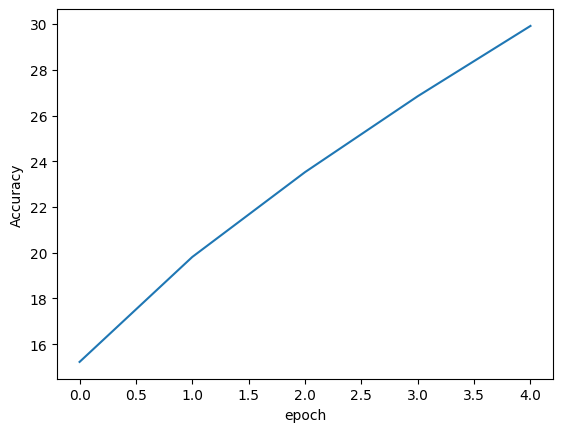

done
[]
60
20
4881


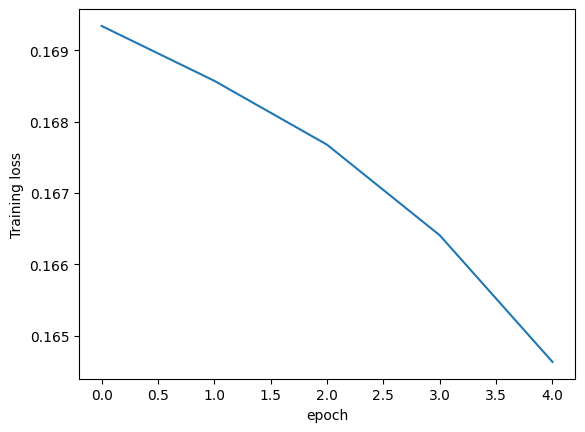

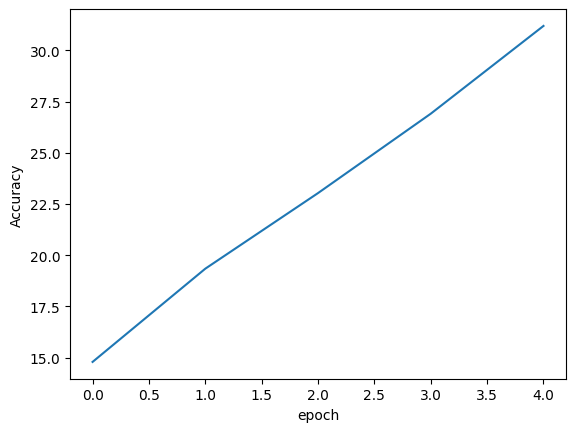

done
[]
60
20
4881


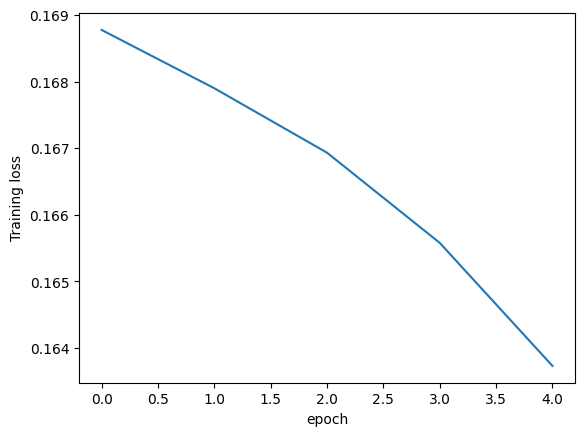

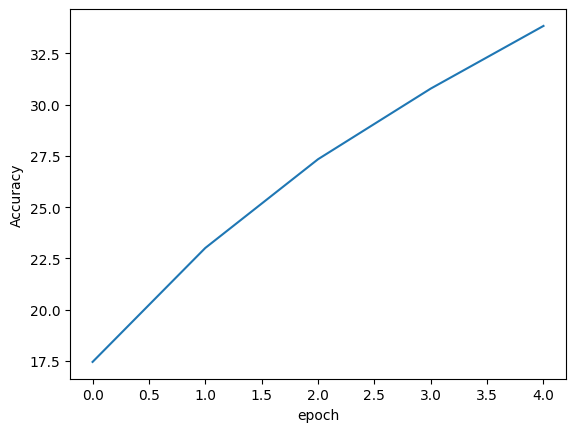

done
[]
60
20
4881


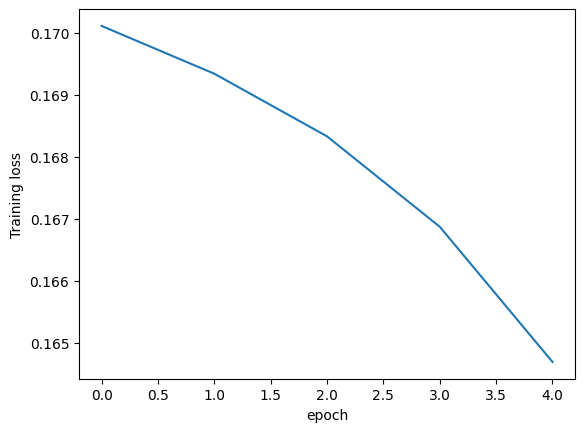

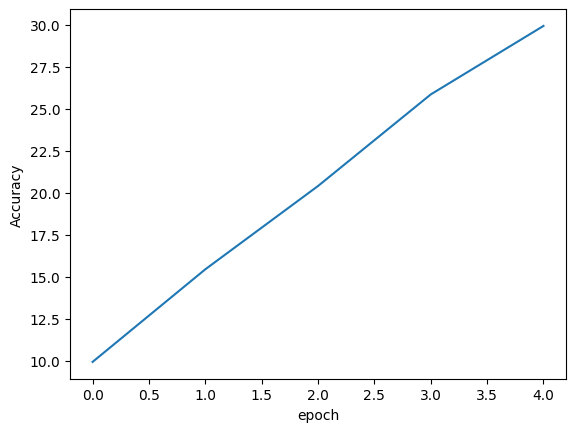

done
[]
60
20
4881


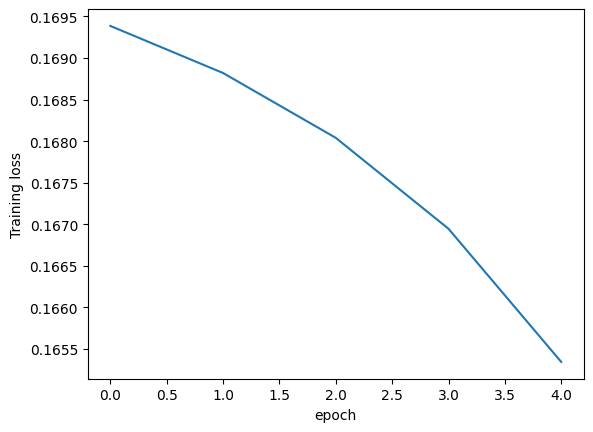

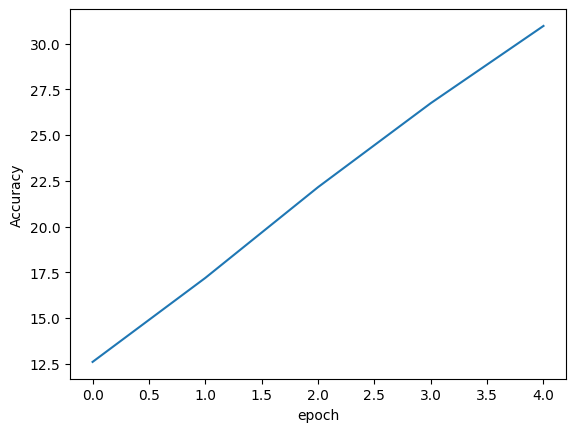

done
[]
60
tensor(0.0249)


In [12]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.KLDivLoss(log_target=True)

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


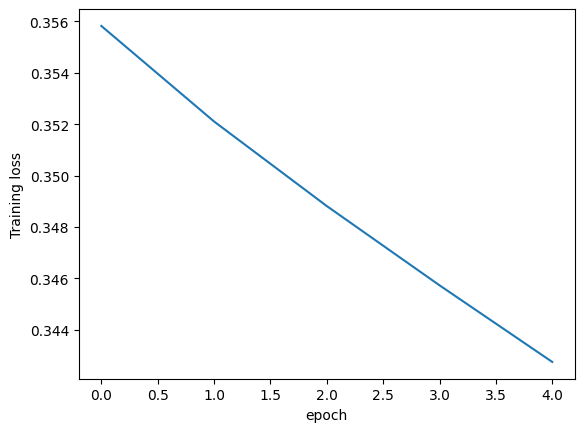

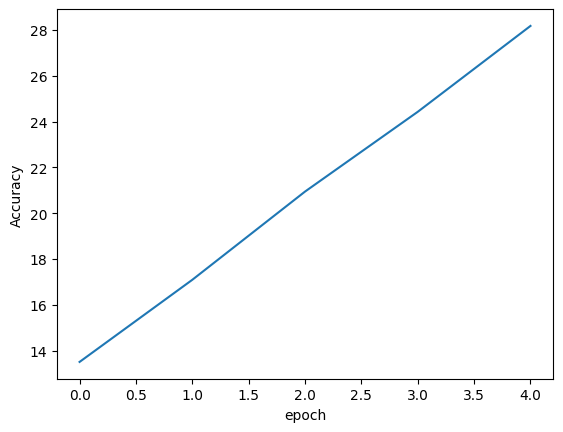

done
[]
60
20
4881


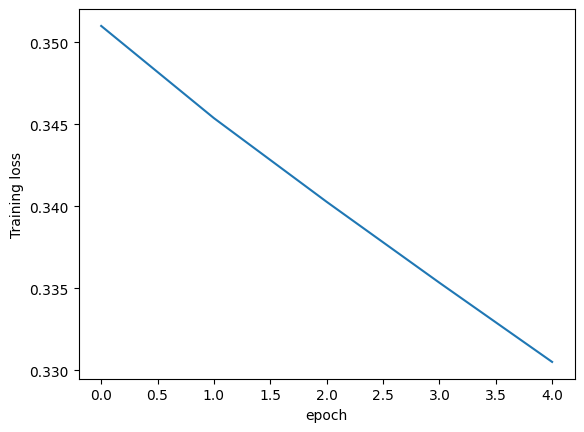

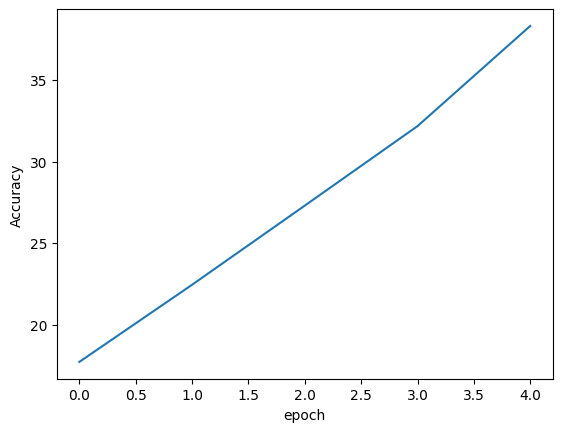

done
[]
60
20
4881


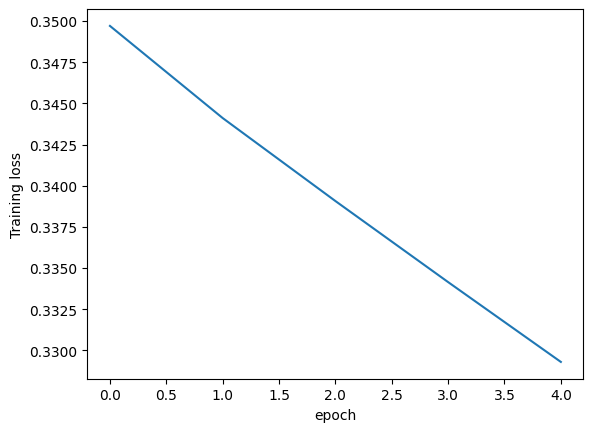

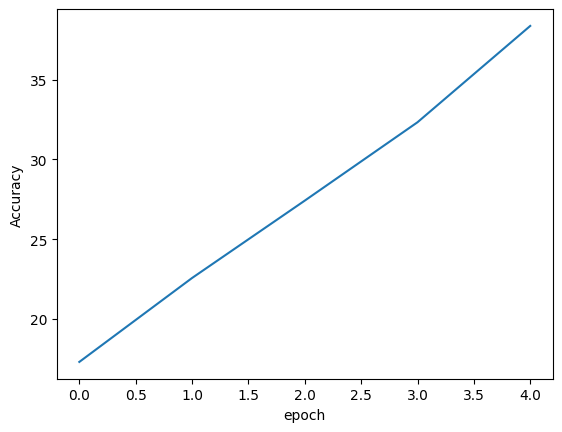

done
[]
60
20
4881


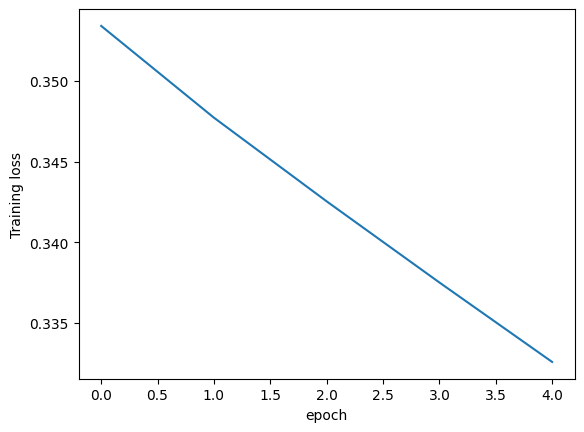

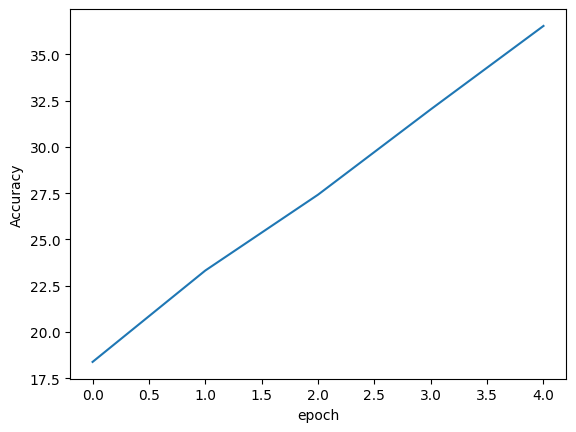

done
[]
60
20
4881


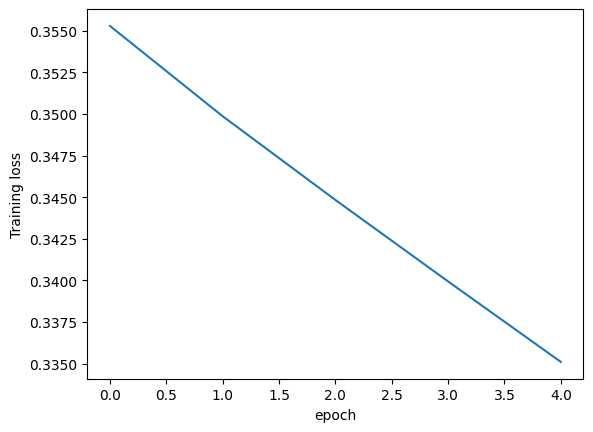

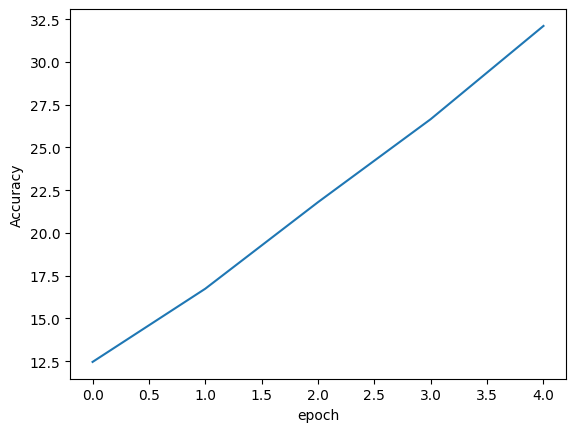

done
[]
60
tensor(1.6199)


In [13]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(5):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


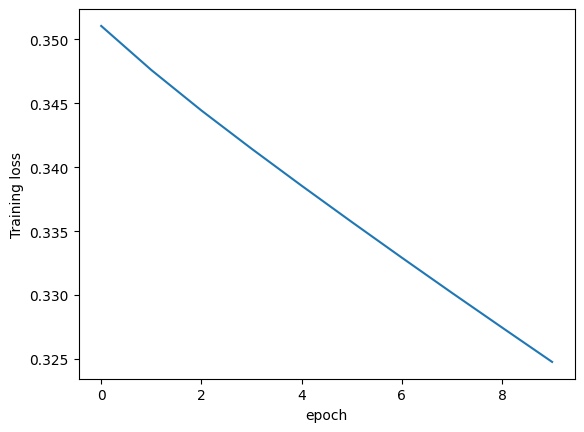

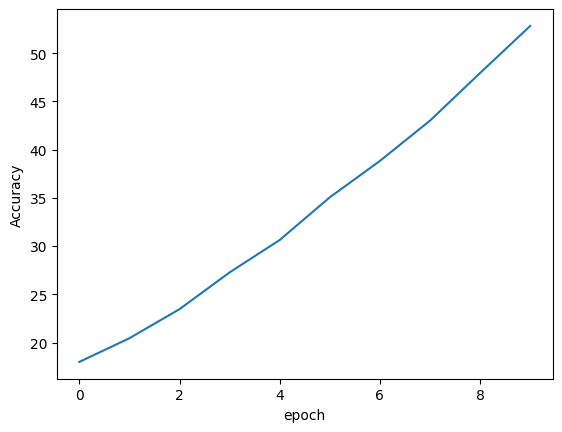

done
[]
60
20
4881


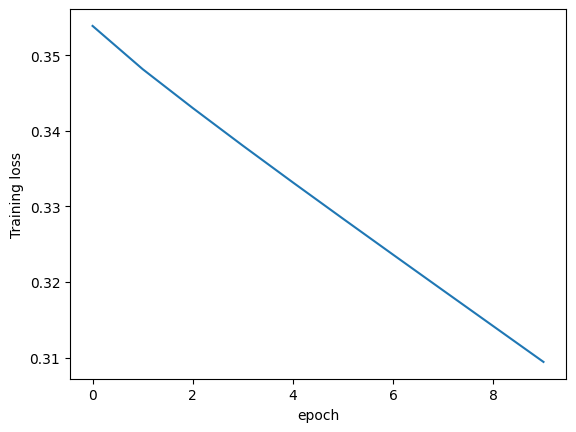

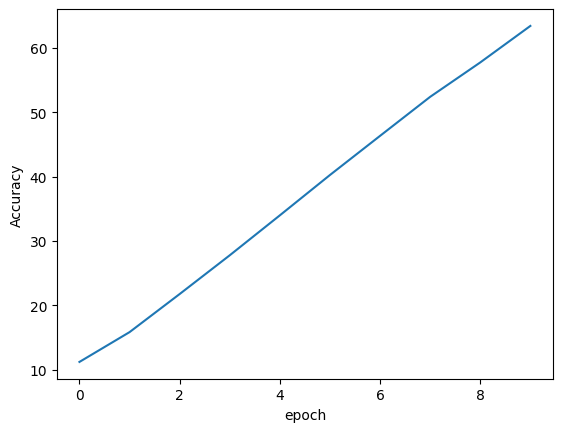

done
[]
60
20
4881


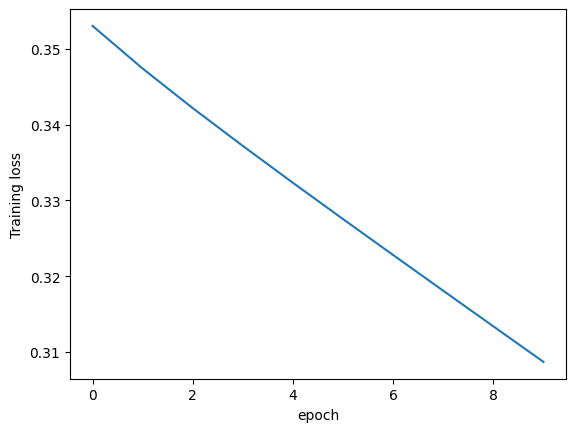

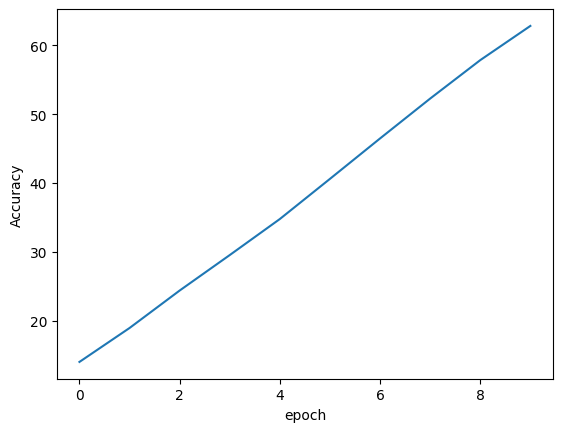

done
[]
60
20
4881


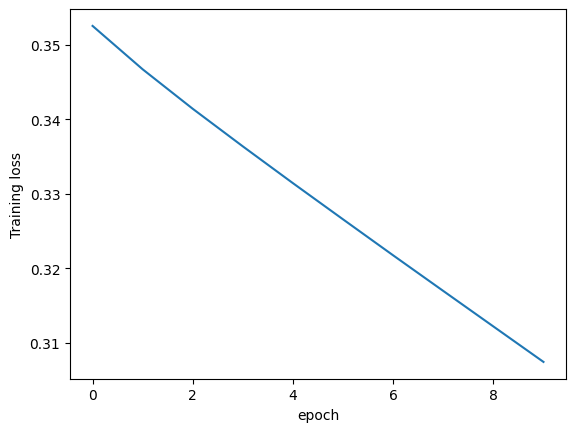

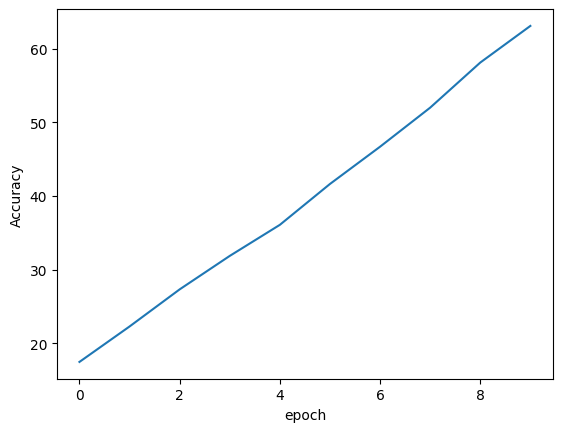

done
[]
60
20
4881


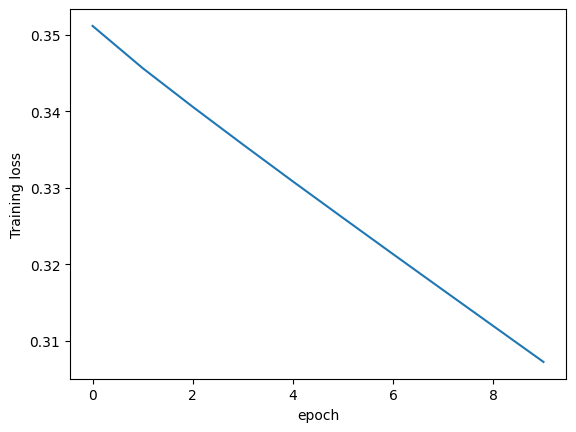

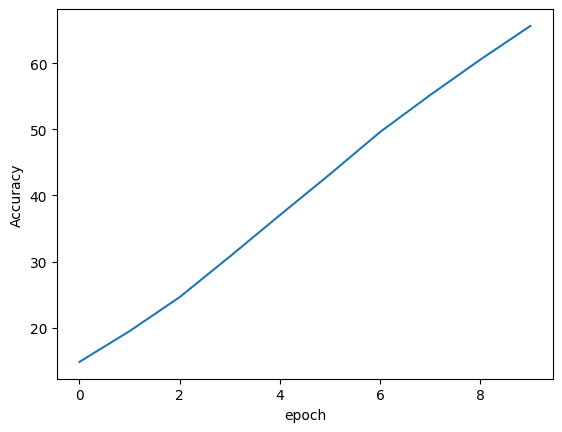

done
[]
60
tensor(0.6619)


In [14]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


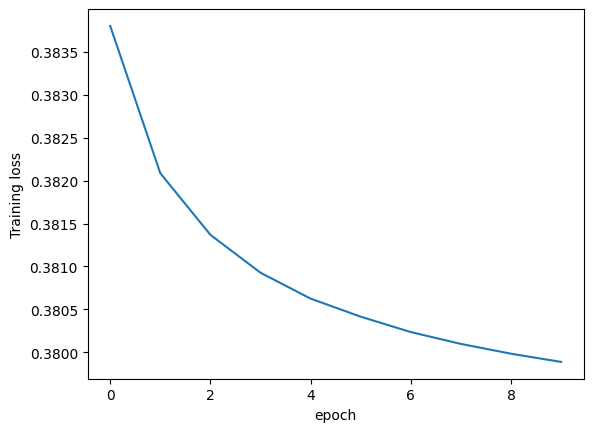

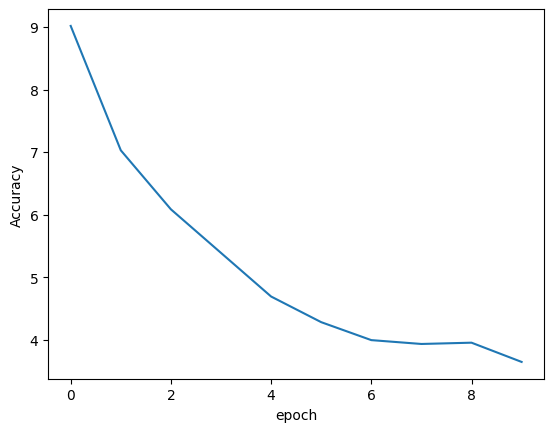

done
[]
60
20
4881


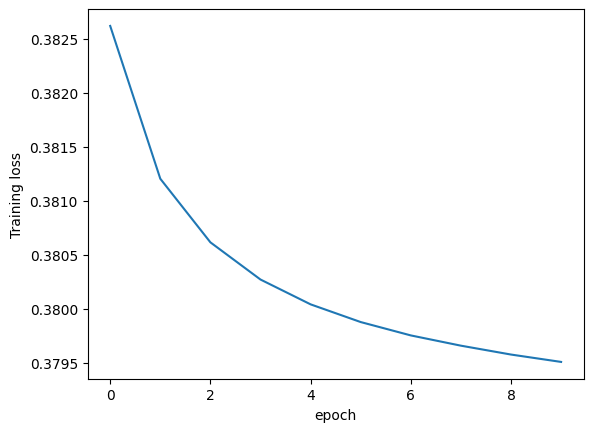

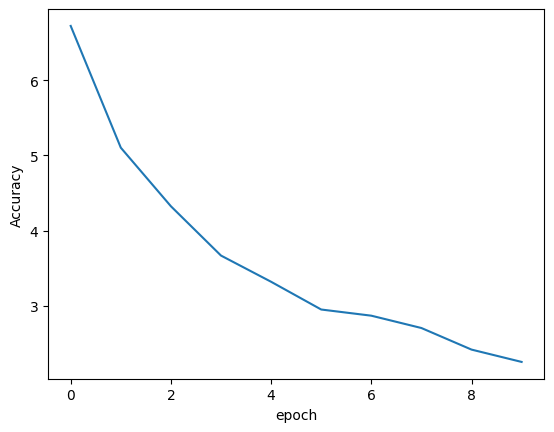

done
[]
60
20
4881


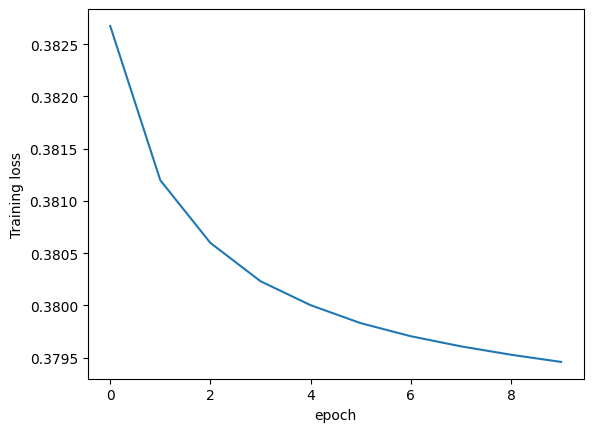

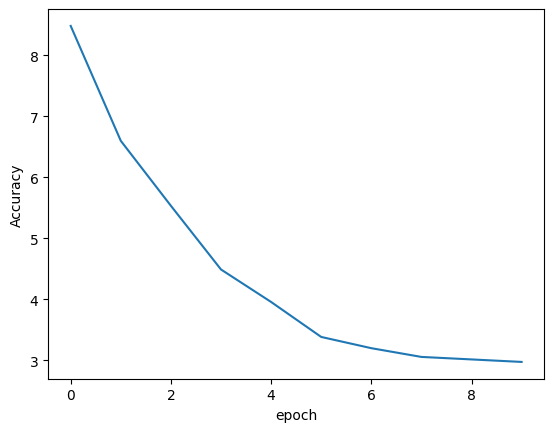

done
[]
60
20
4881


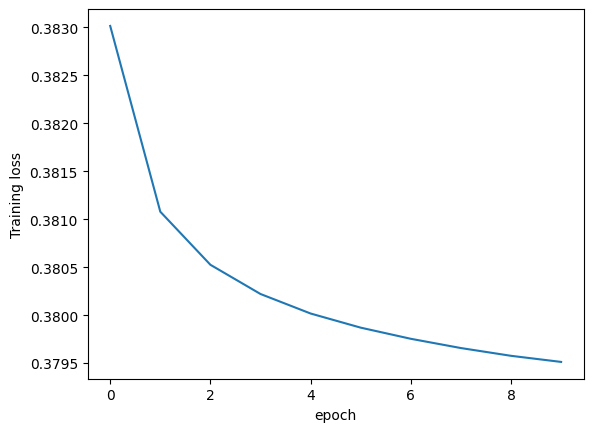

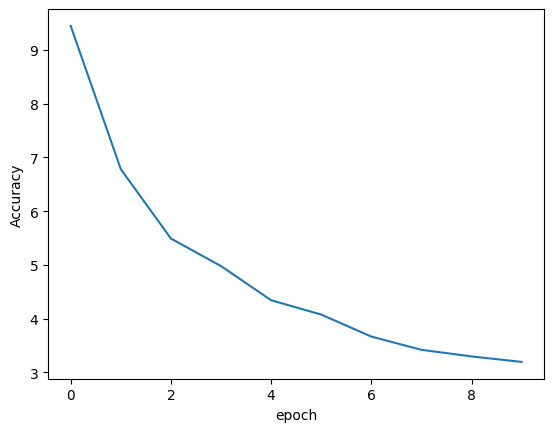

done
[]
60
20
4881


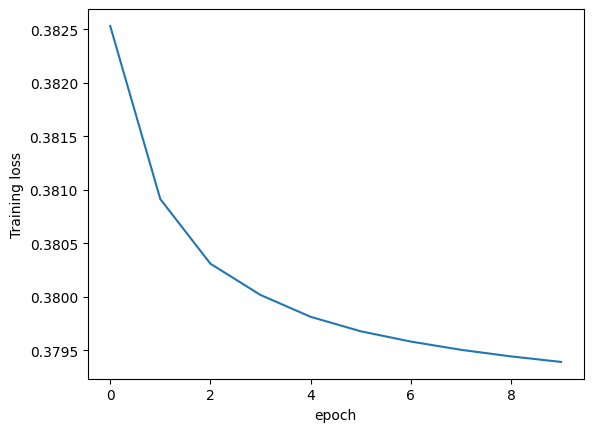

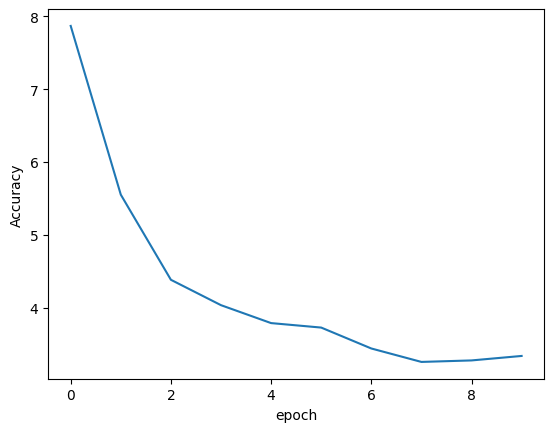

done
[]
60
tensor(0.9803)


In [15]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=0)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


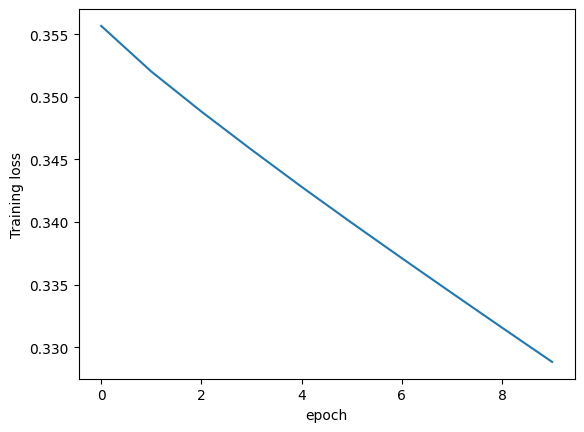

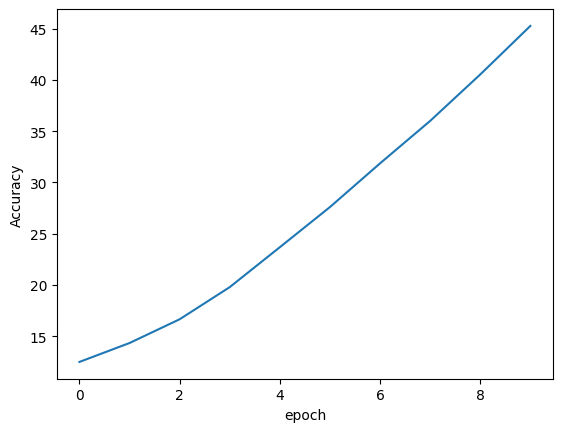

done
[]
60
20
4881


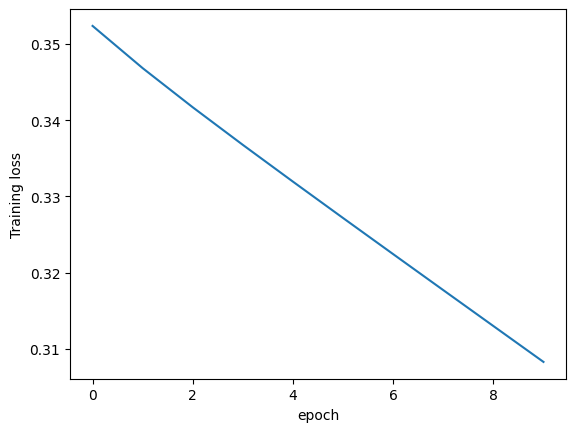

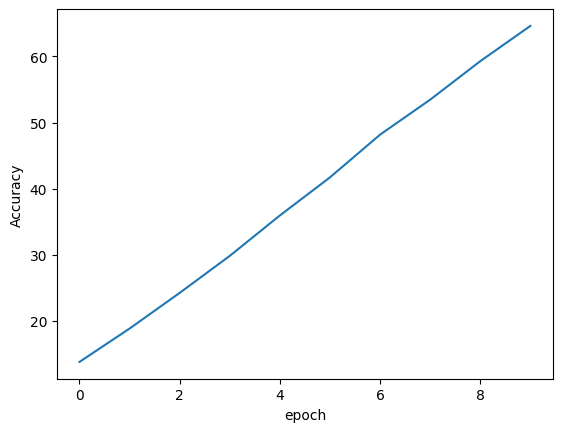

done
[]
60
20
4881


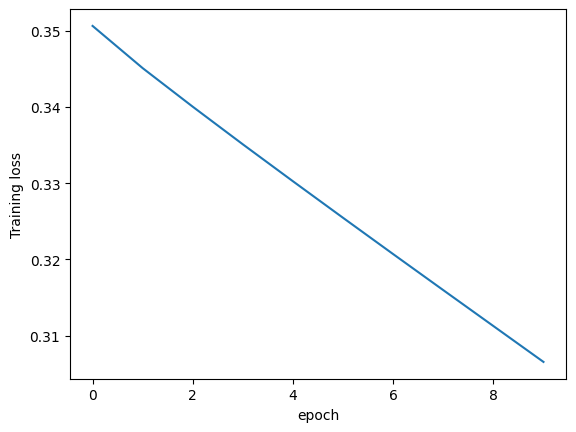

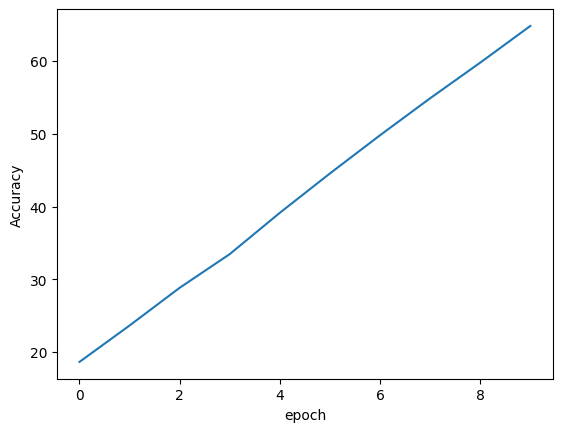

done
[]
60
20
4881


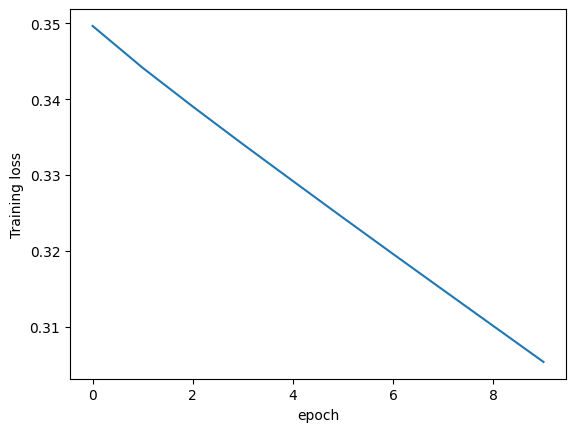

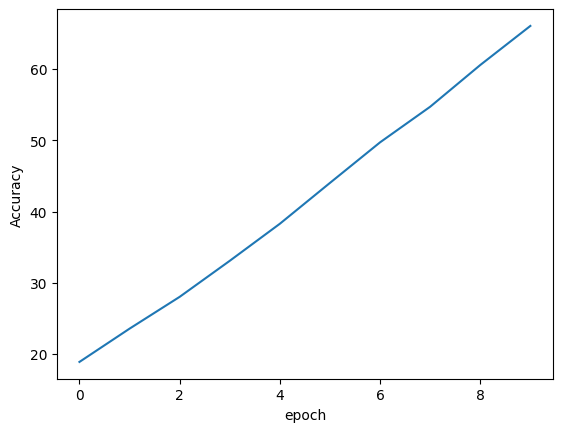

done
[]
60
20
4881


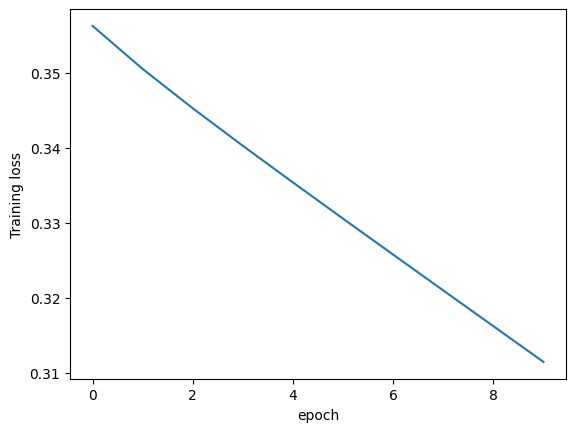

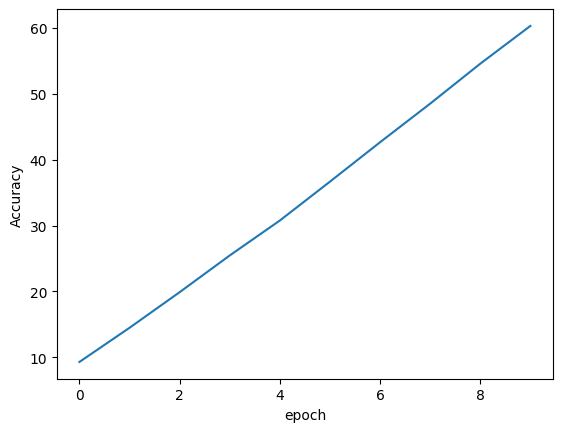

done
[]
60
tensor(0.1756)


In [18]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


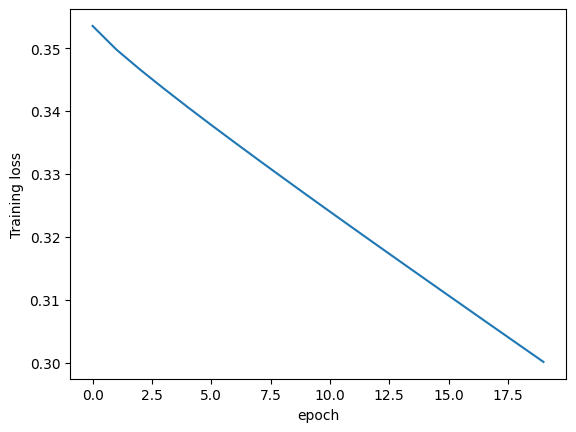

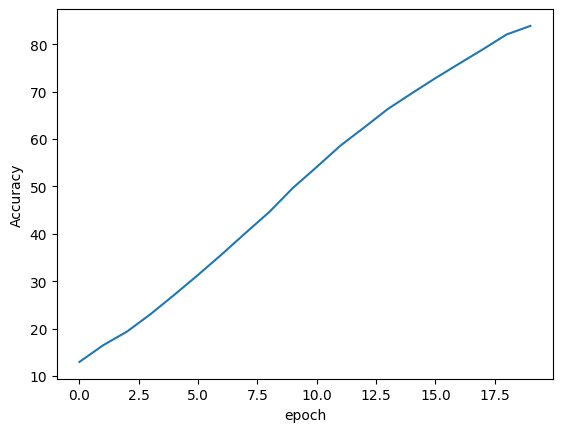

done
[]
60
20
4881


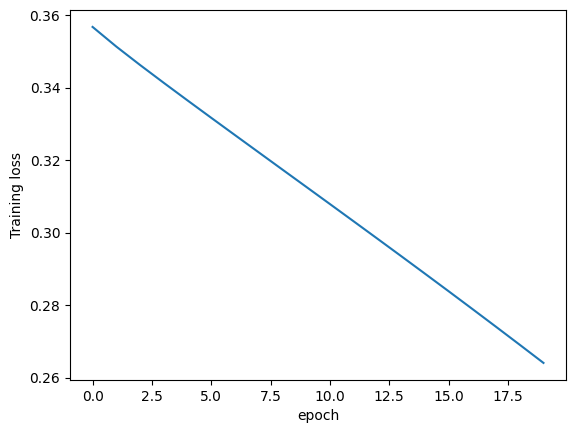

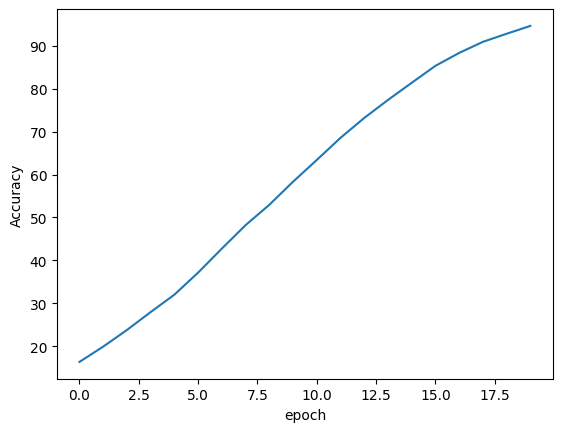

done
[]
60
20
4881


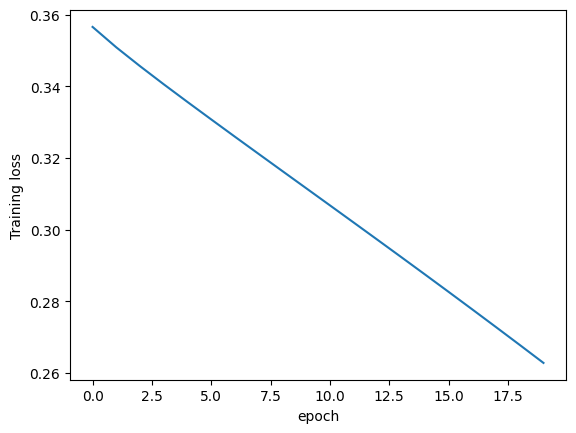

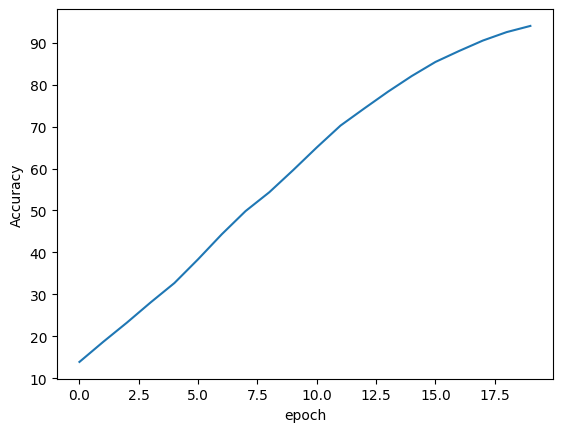

done
[]
60
20
4881


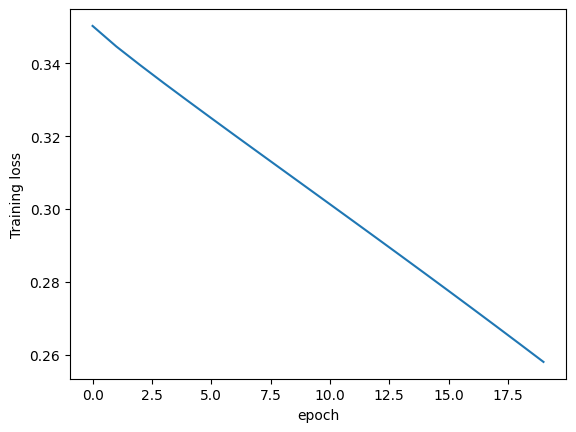

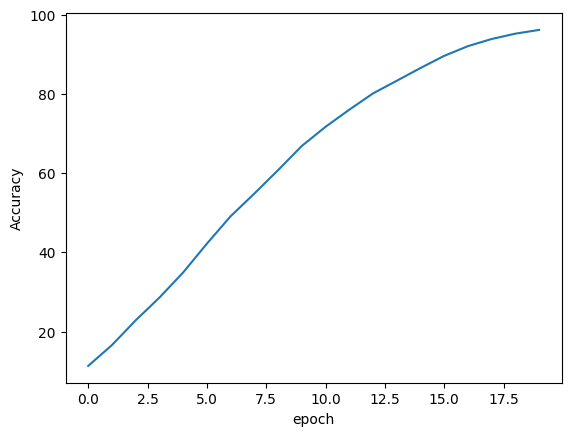

done
[]
60
20
4881


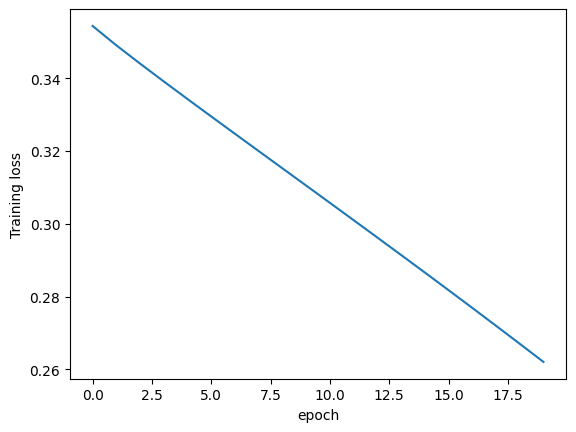

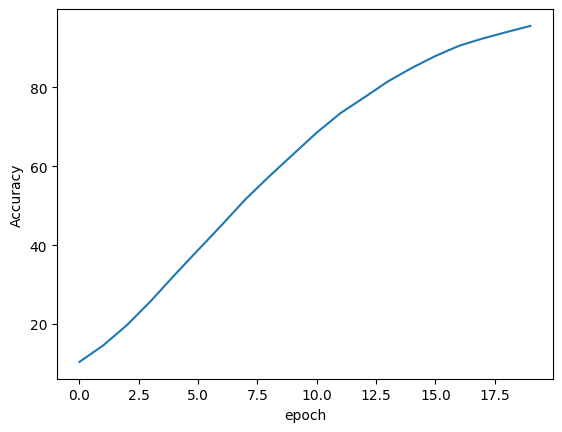

done
[]
60
tensor(0.0721)


In [19]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

In [23]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_pred,y_to_compare):
    #classes=[]
    #for item in y_to_compare:
        #classes.append(torch.argmax(item))
    #classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(y_pred,y_to_compare).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=1),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=(y_train[i:i+X_train.batch_size]).type(torch.long)
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,y_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_to_compare)
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=torch.round(model(sample).squeeze())
      y_to_compare=y_val[i:i+X_val.batch_size]
    
    # If you want to use one hot encoding
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)

      test_loss+=loss_func(test_prediction,y_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


RuntimeError: Expected floating point type for target with class probabilities, got Long

7626
Data loaded
20
4881


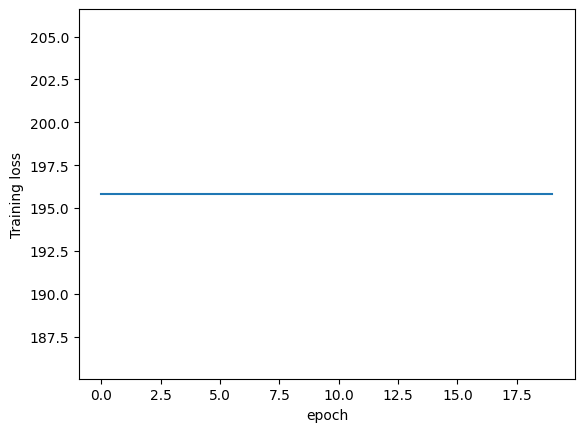

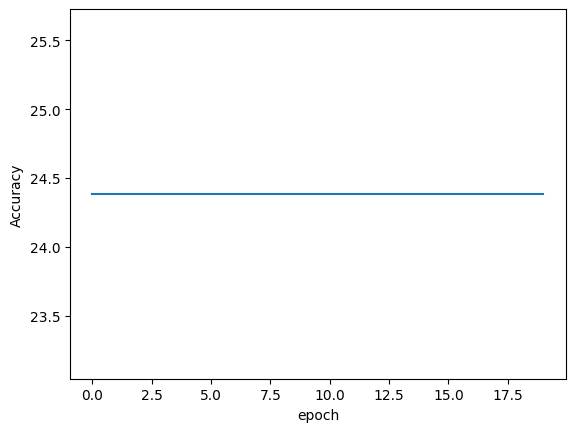

done
[]


RuntimeError: Expected floating point type for target with class probabilities, got Int

In [24]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_pred,y_to_compare):
    #classes=[]
    #for item in y_to_compare:
        #classes.append(torch.argmax(item))
    #classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(y_pred,y_to_compare).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=1),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=(y_train[i:i+X_train.batch_size]).type(torch.float)
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,y_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_to_compare)
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=torch.round(model(sample).squeeze())
      y_to_compare=y_val[i:i+X_val.batch_size]
    
    # If you want to use one hot encoding
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)

      test_loss+=loss_func(test_prediction,y_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

In [25]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_pred,y_to_compare):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.LogSoftmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,y_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_to_compare)
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


ValueError: Using a target size (torch.Size([20])) that is different to the input size (torch.Size([20, 9])) is deprecated. Please ensure they have the same size.

7626
Data loaded
20
4881


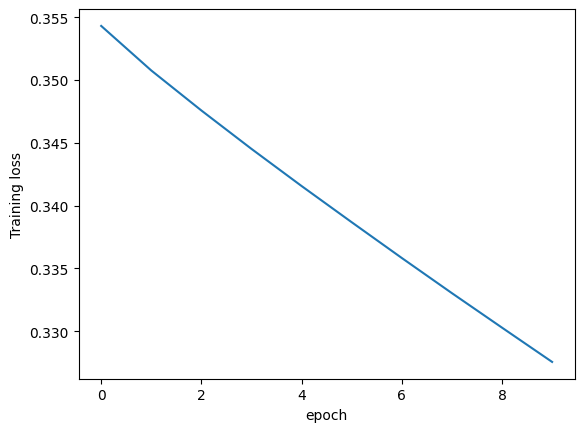

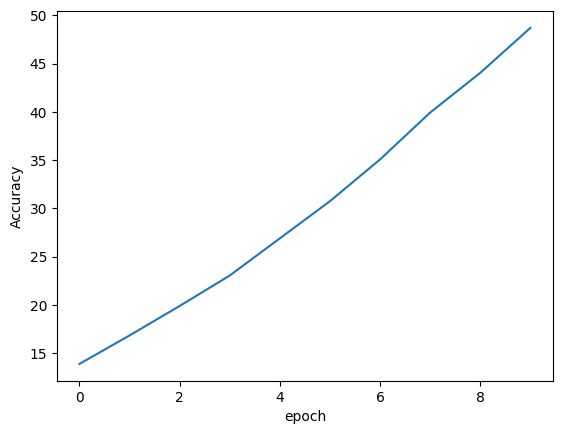

done
[]
60
20
4881


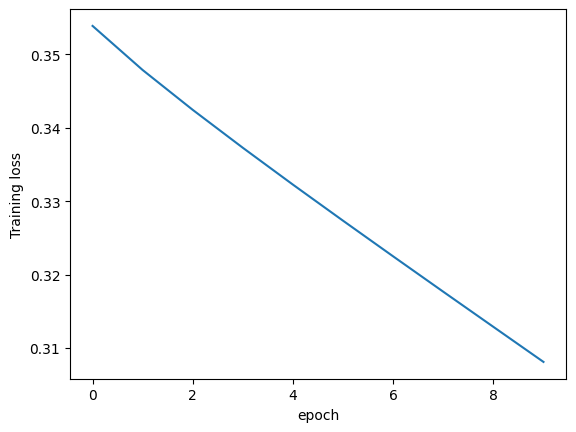

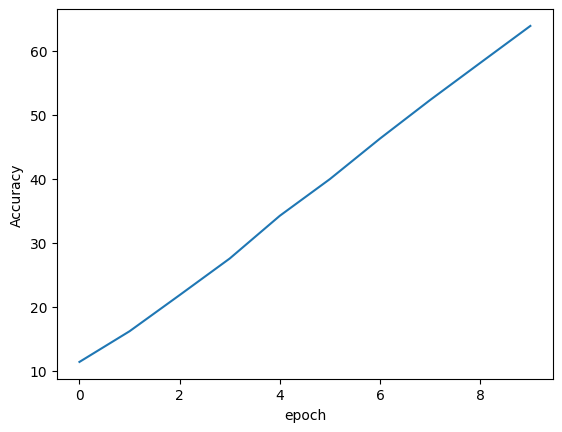

done
[]
60
20
4881


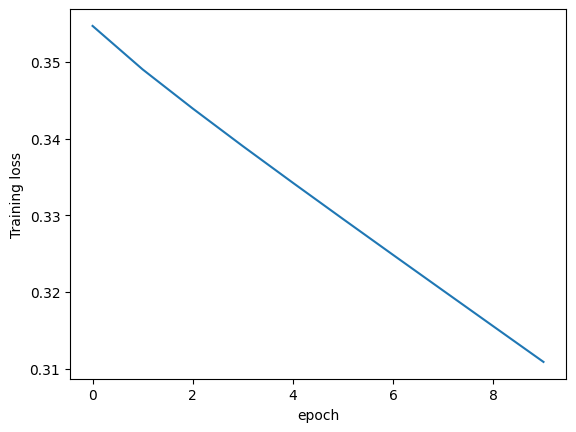

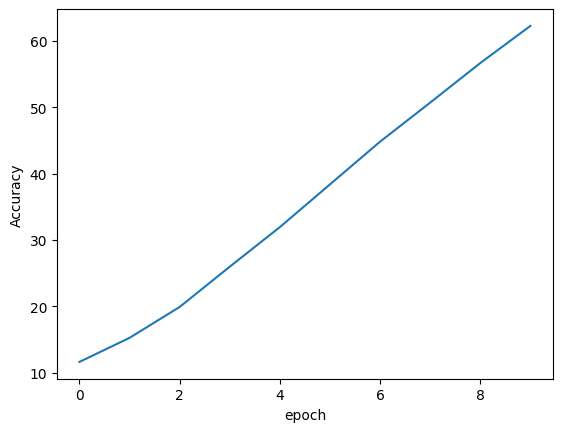

done
[]
60
20
4881


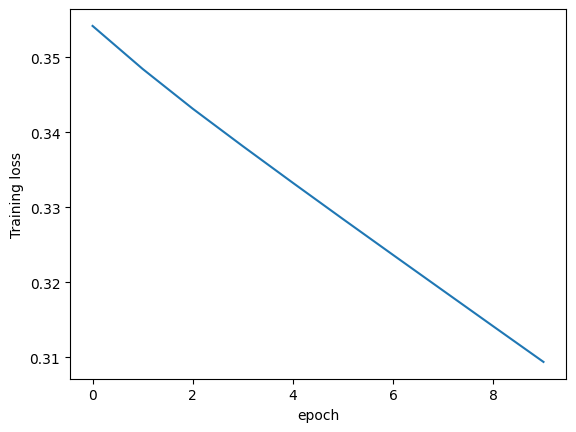

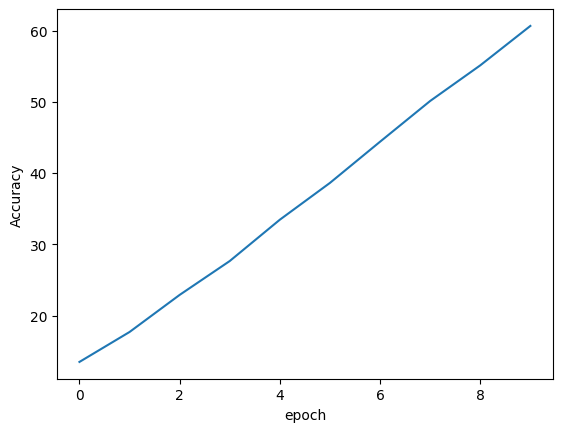

done
[]
60
20
4881


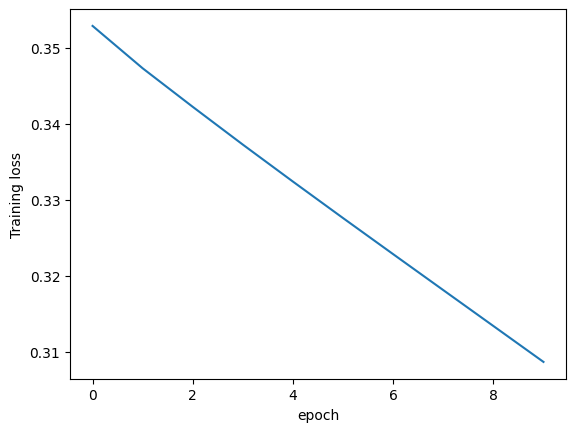

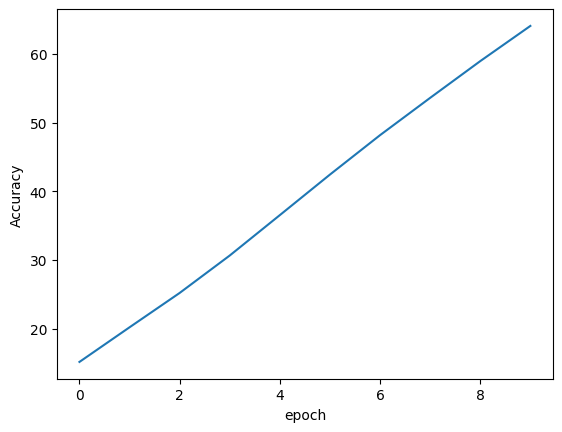

done
[]
60
tensor(0.3722)


In [26]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

In [27]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=2, out_channels=20, kernel_size=20, stride=20),
        nn.AvgPool1d(kernel_size=2),
        nn.ReLU(),
        nn.Linear(in_features=32, out_features=49),
        nn.ReLU(),
        nn.Linear(in_features=49, out_features=9)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


RuntimeError: Given groups=1, weight of size [20, 2, 20], expected input[1, 20, 1280] to have 2 channels, but got 20 channels instead

In [28]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=15, kernel_size=5, stride=1),
        nn.AvgPool1d(kernel_size=3),
        nn.ReLU(),
        nn.Linear(in_features=5, out_features=9),
        nn.ReLU(),
        nn.Linear(in_features=9, out_features=9)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


RuntimeError: mat1 and mat2 shapes cannot be multiplied (15x425 and 5x9)

In [29]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=15, kernel_size=5, stride=1),
        nn.AvgPool1d(kernel_size=2),
        nn.ReLU(),
        nn.Linear(in_features=5, out_features=9),
        nn.ReLU(),
        nn.Linear(in_features=9, out_features=9)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


RuntimeError: mat1 and mat2 shapes cannot be multiplied (15x638 and 5x9)

In [30]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=15, kernel_size=5, stride=1),
        nn.AvgPool1d(kernel_size=2),
        nn.ReLU(),
        nn.Linear(in_features=638, out_features=9),
        nn.ReLU(),
        nn.Linear(in_features=9, out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


ValueError: Using a target size (torch.Size([20, 9])) that is different to the input size (torch.Size([15, 9])) is deprecated. Please ensure they have the same size.

7626
Data loaded
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


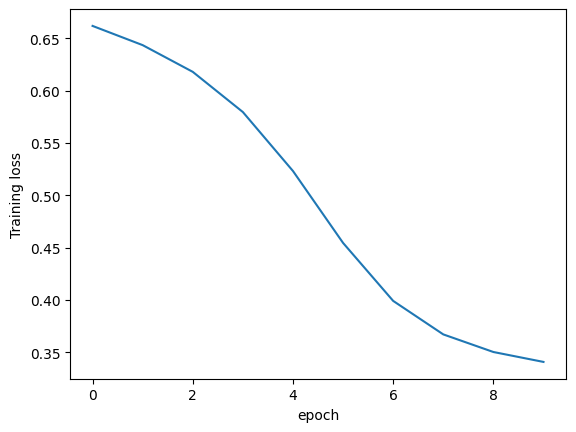

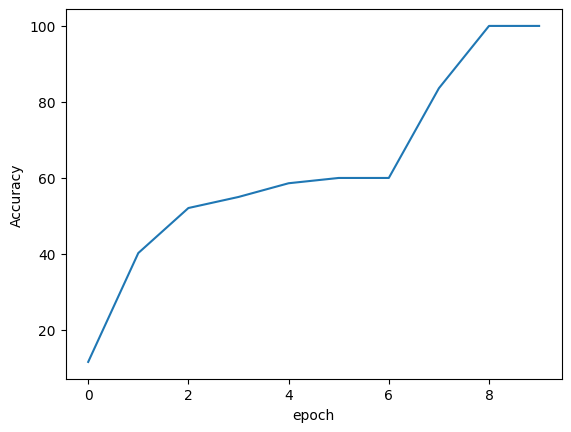

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


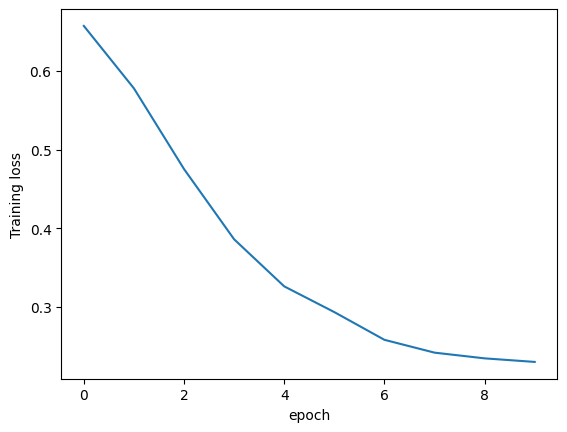

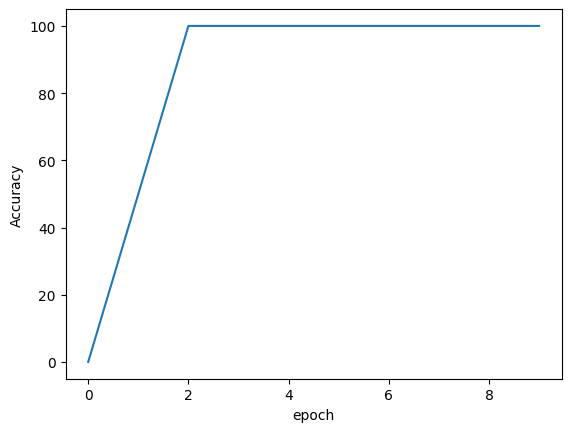

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


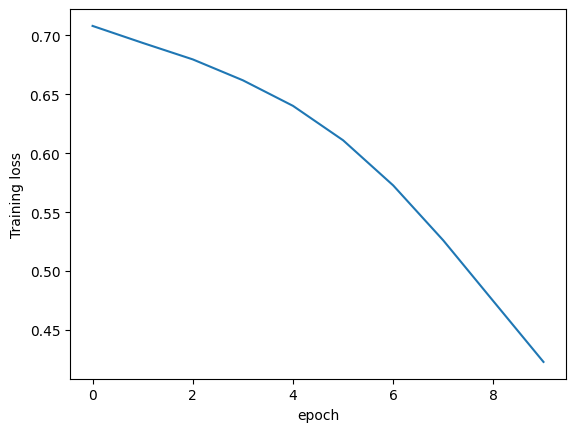

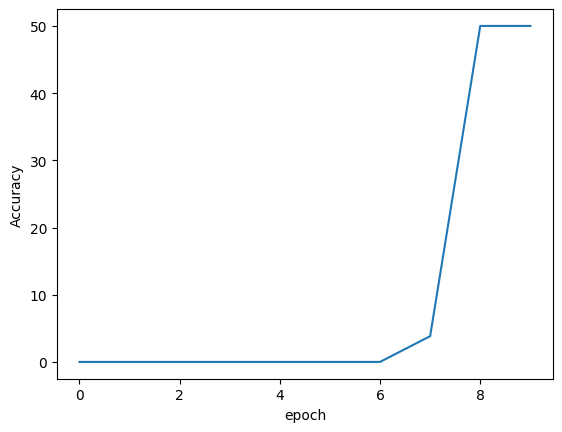

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


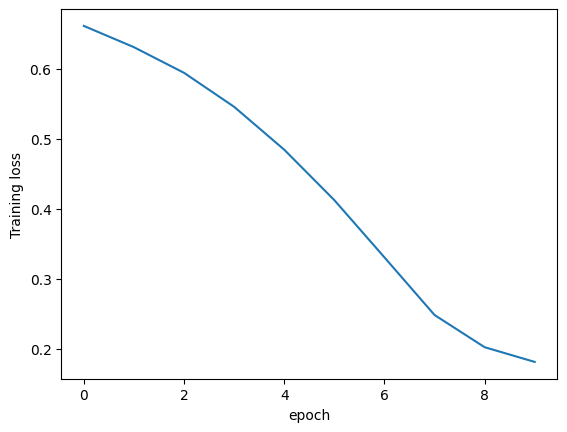

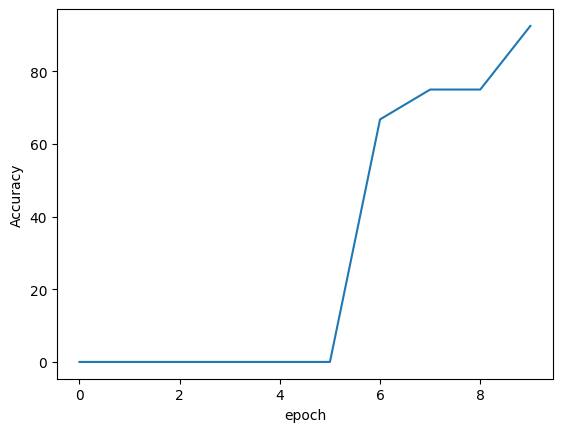

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


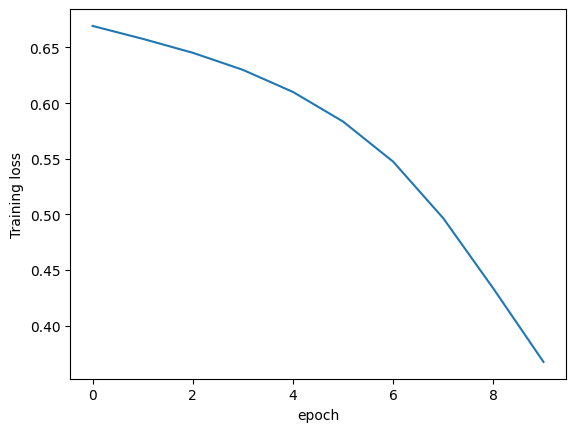

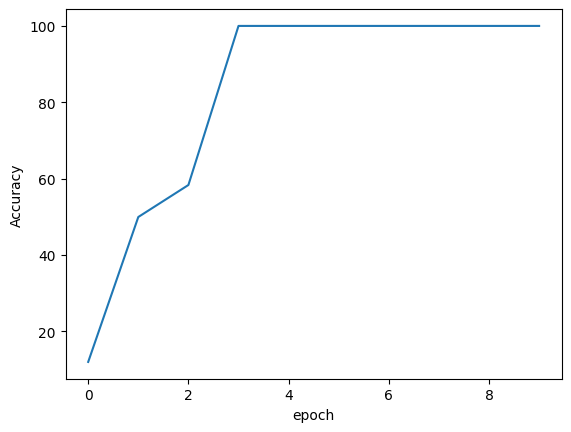

done
[]
60
tensor(0.)


In [31]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=5, stride=1),
        nn.AvgPool1d(kernel_size=2),
        nn.ReLU(),
        nn.Linear(in_features=638, out_features=9),
        nn.ReLU(),
        nn.Linear(in_features=9, out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


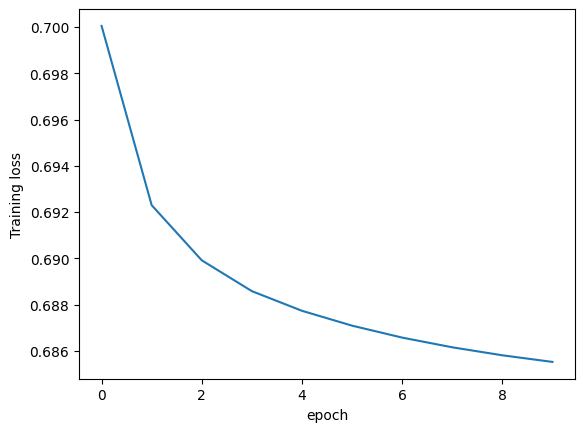

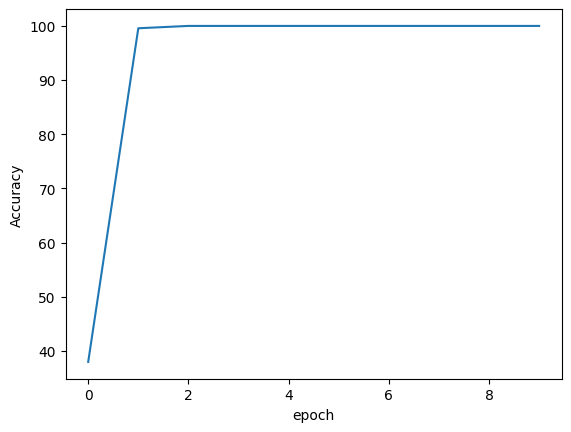

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


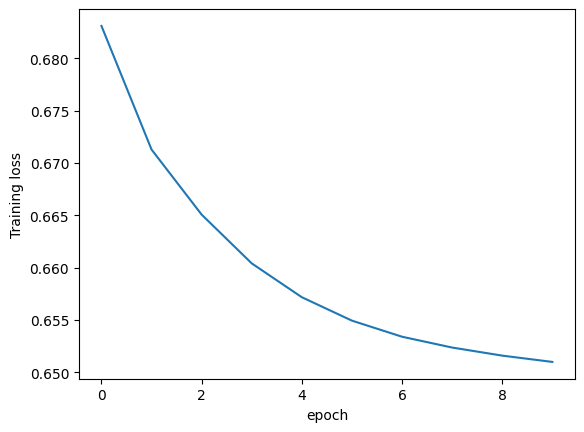

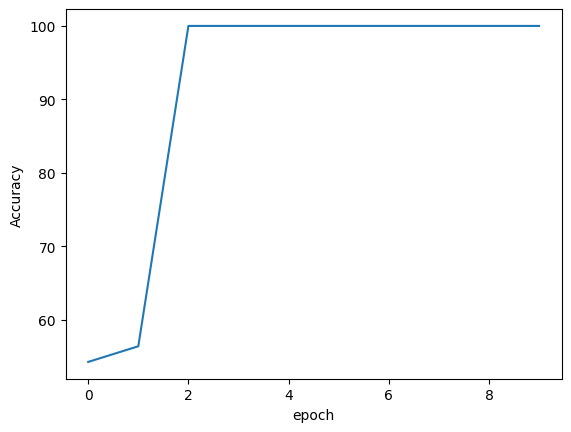

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


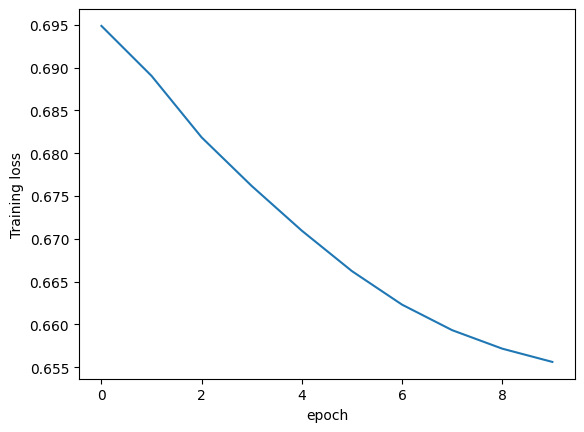

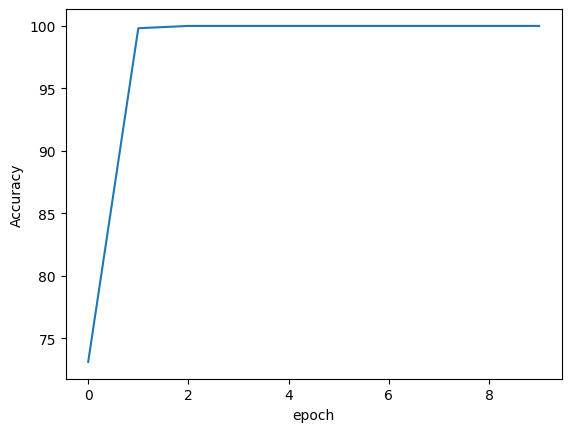

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


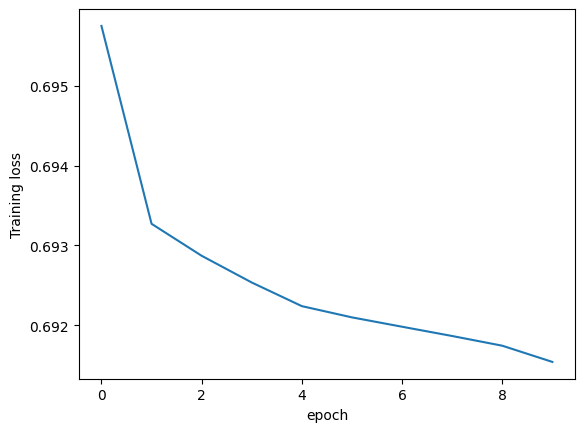

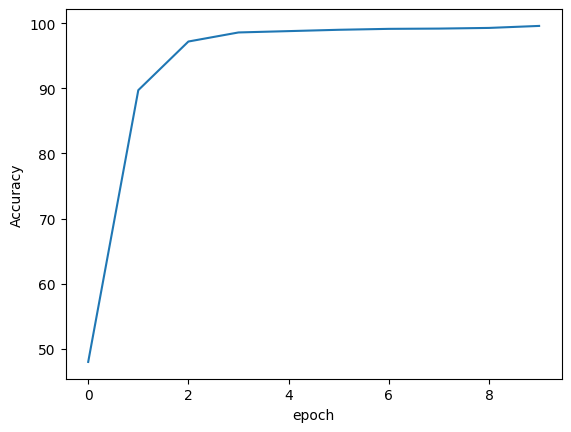

done
[]
60
20
4881
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20


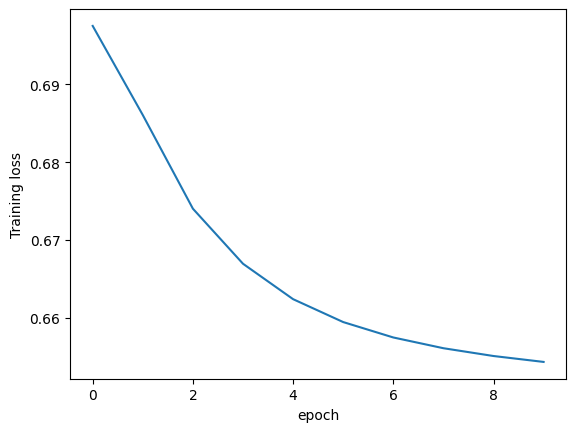

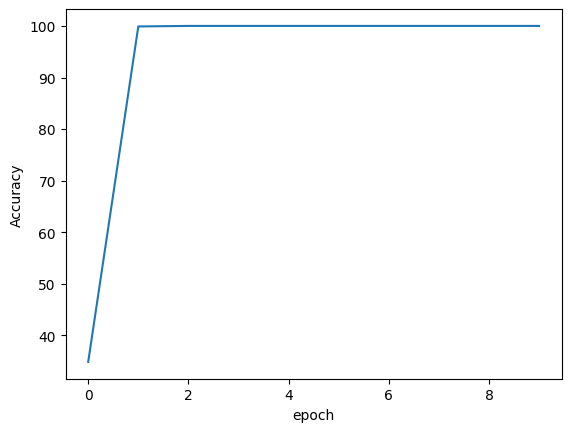

done
[]
60
tensor(0.)


In [32]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=5, stride=1),
        nn.AvgPool1d(kernel_size=2),
        nn.ReLU(),
        nn.Linear(in_features=638, out_features=9),
        nn.ReLU(),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


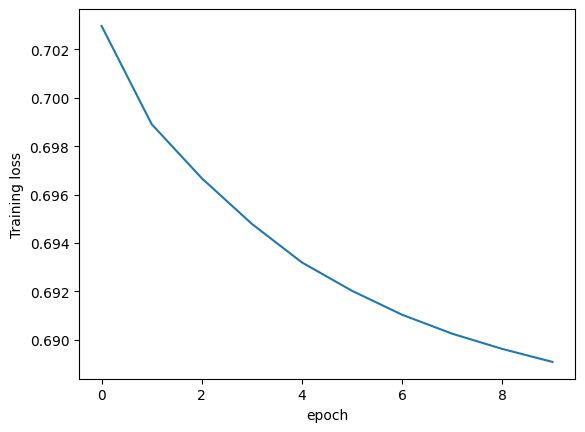

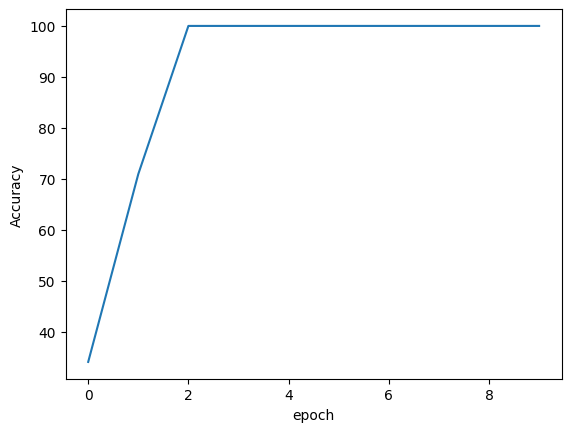

done
[]
60
20
4881


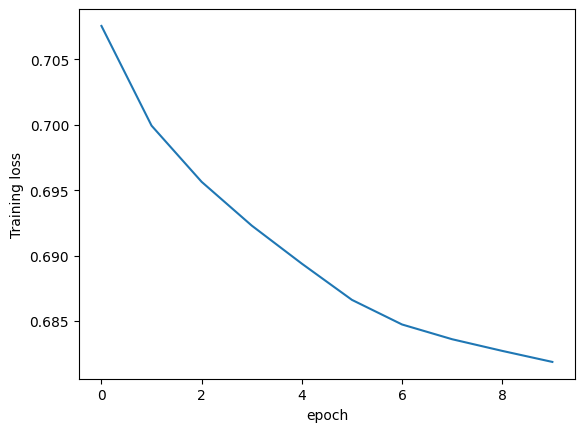

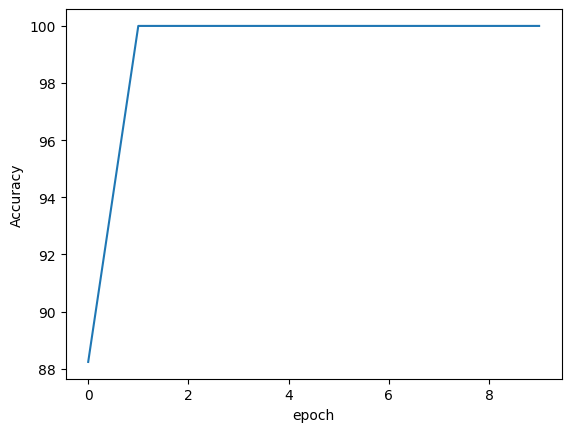

done
[]
60
20
4881


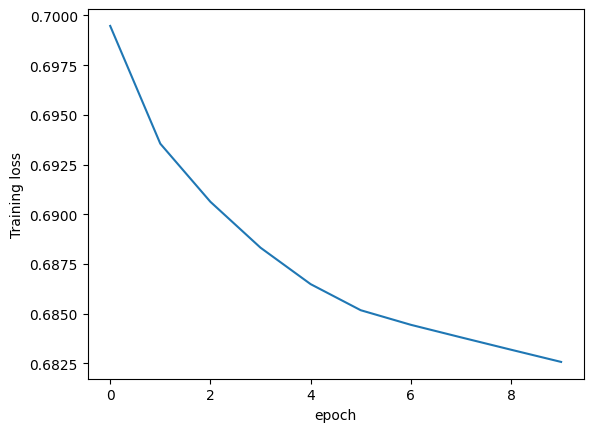

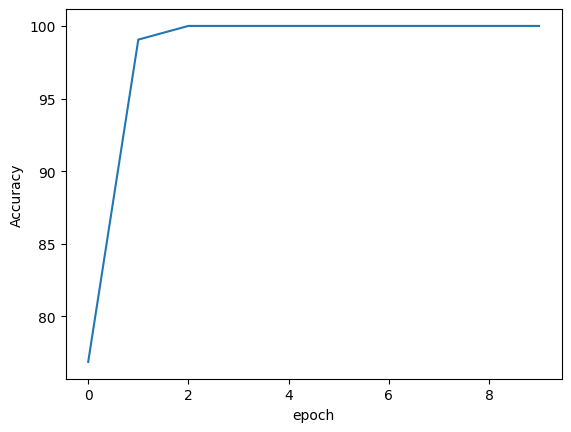

done
[]
60
20
4881


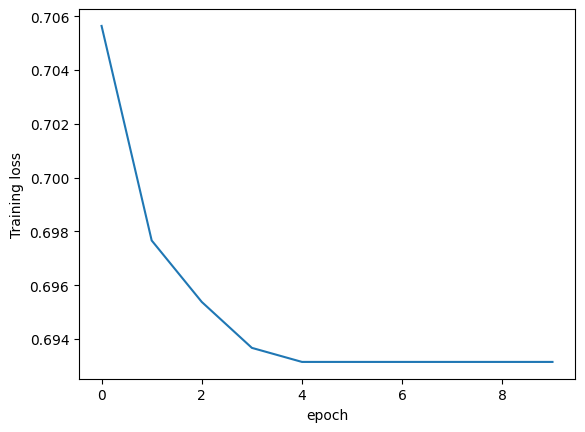

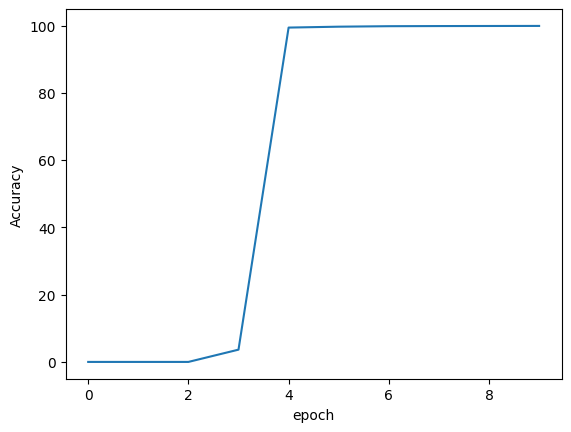

done
[]
60
20
4881


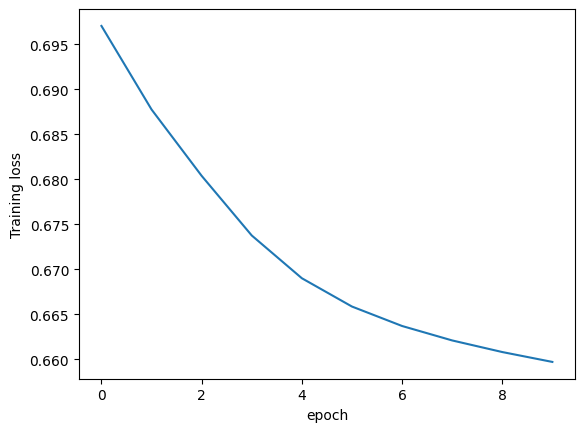

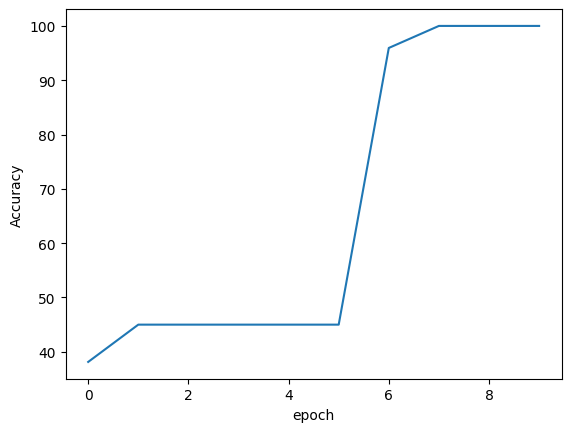

done
[]
60
tensor(0.)


In [33]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=101, stride=1),
        nn.AvgPool1d(kernel_size=20),
        nn.ReLU(),
        nn.Linear(in_features=59, out_features=9),
        nn.ReLU(),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


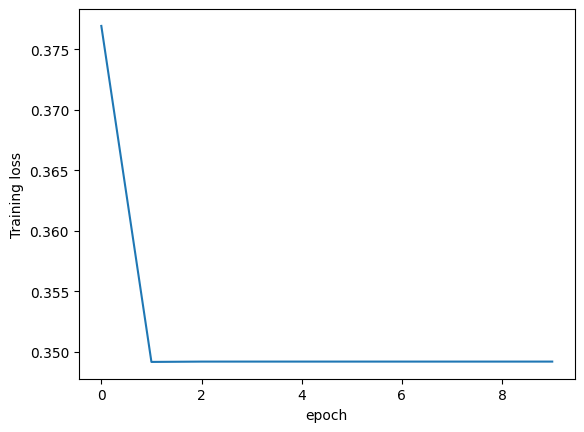

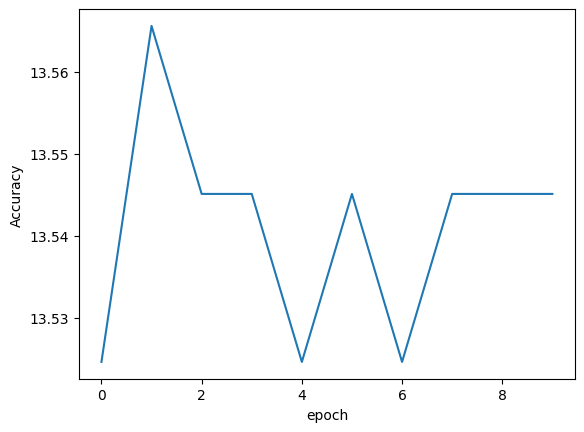

done
[]
60
20
4881


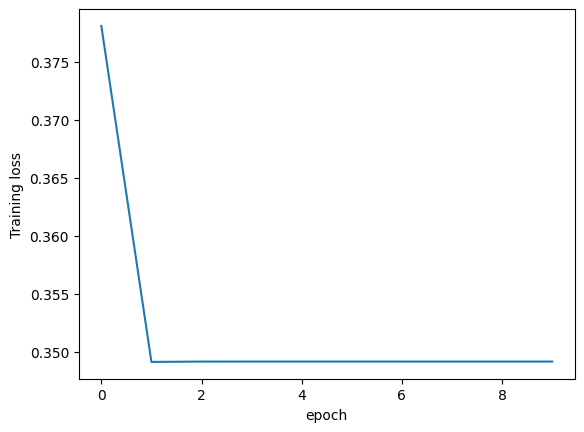

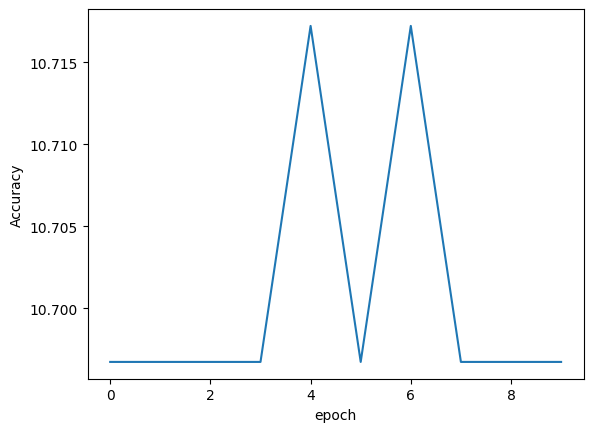

done
[]
60
20
4881


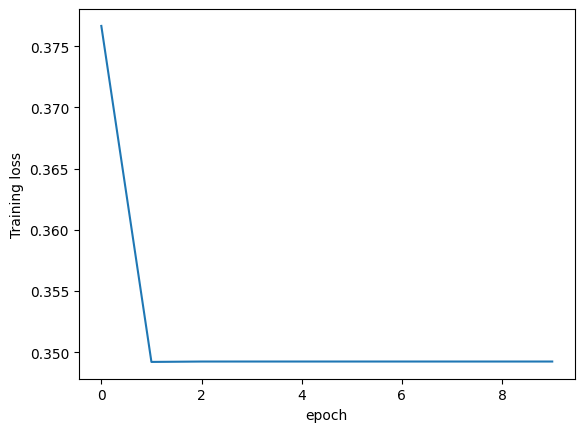

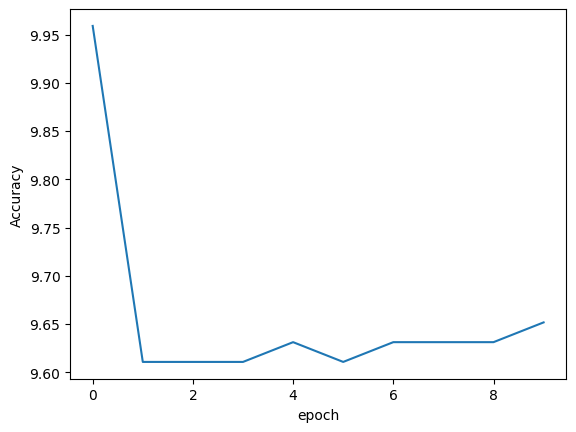

done
[]
60
20
4881


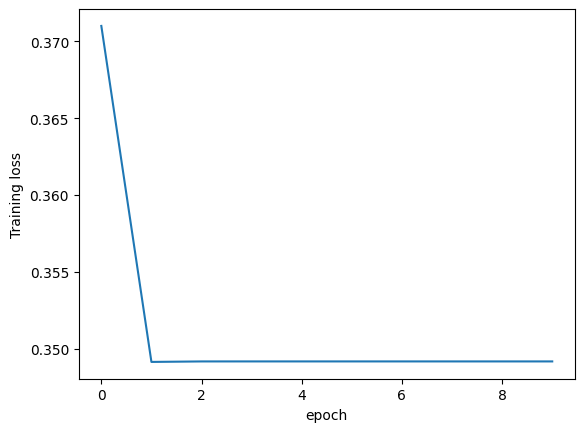

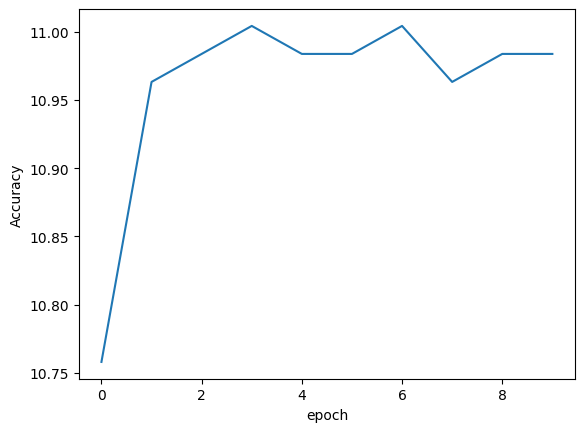

done
[]
60
20
4881


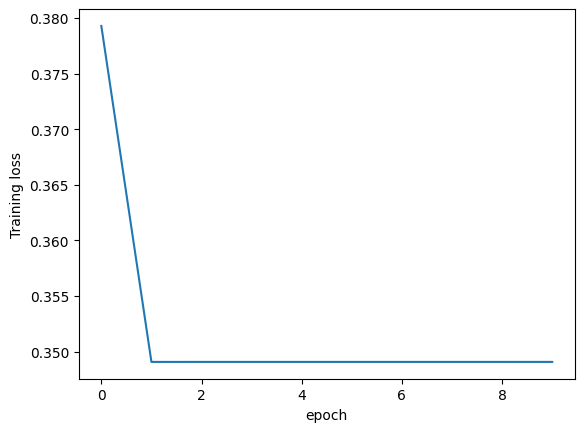

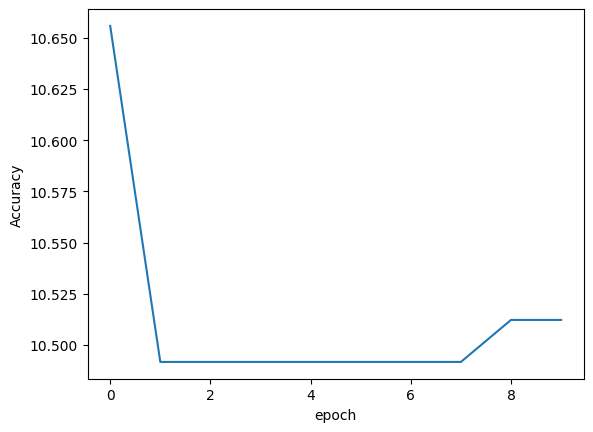

done
[]
60
tensor(0.8755)


In [34]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.AvgPool1d(kernel_size=100),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


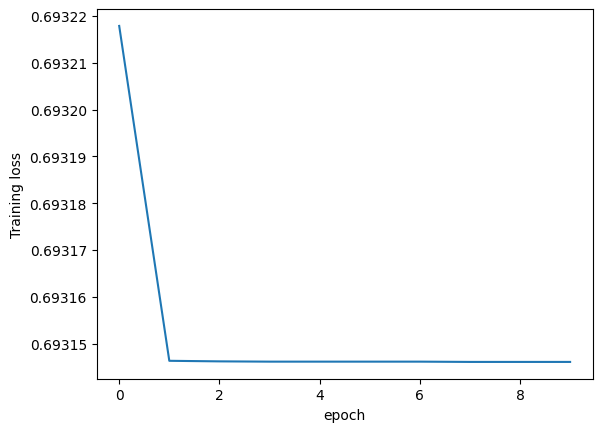

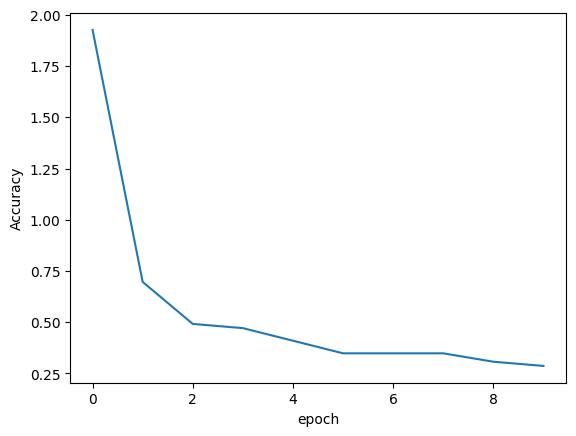

done
[]
60
20
4881


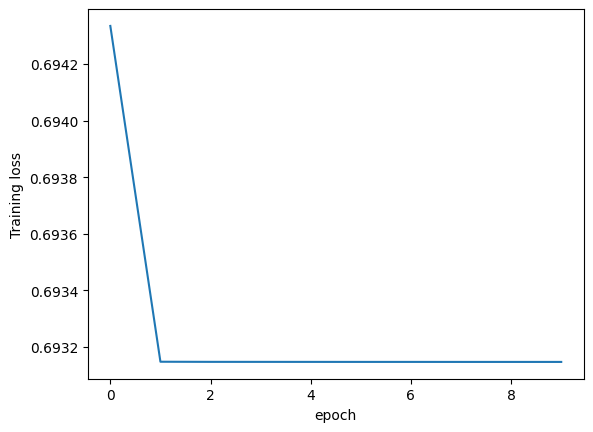

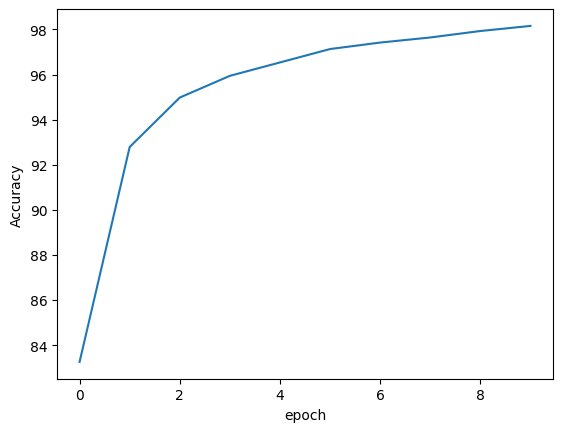

done
[]
60
20
4881


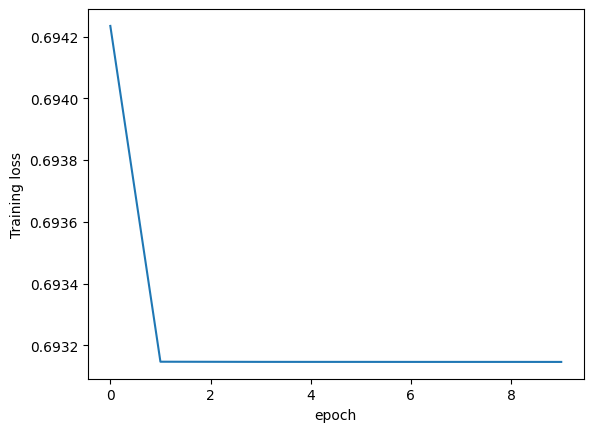

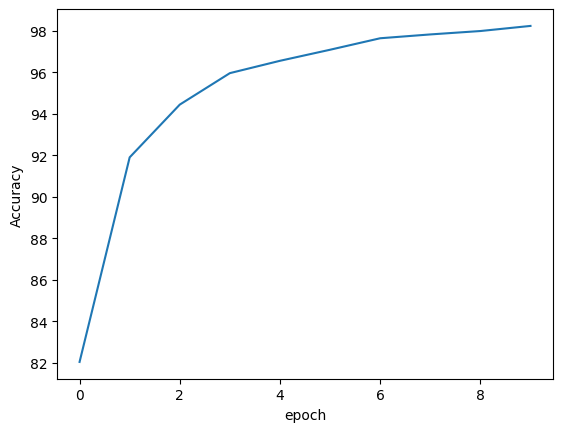

done
[]
60
20
4881


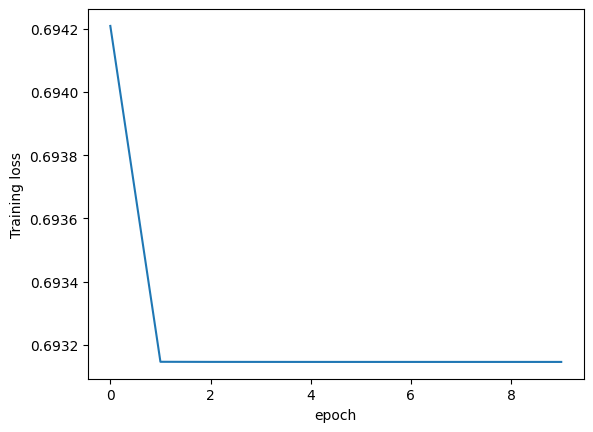

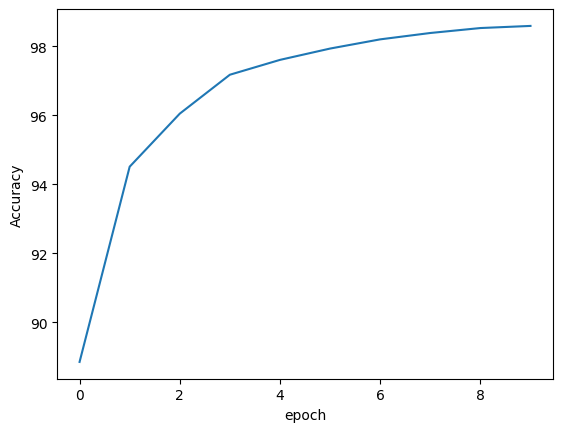

done
[]
60
20
4881


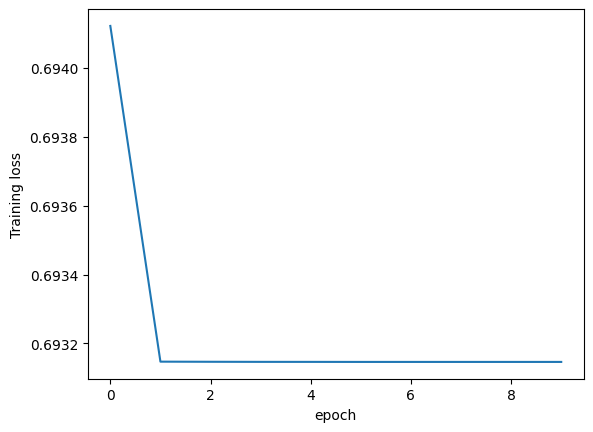

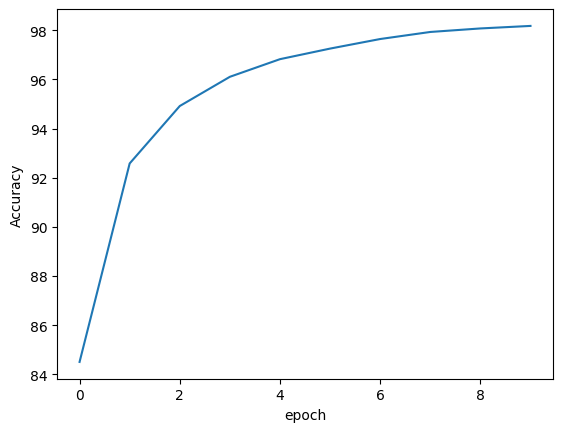

done
[]
60
tensor(1.5623)


In [35]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.ReLU(),
        nn.AvgPool1d(kernel_size=100),
        
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


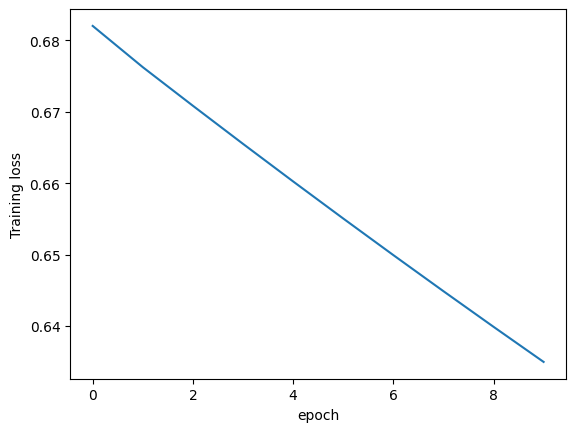

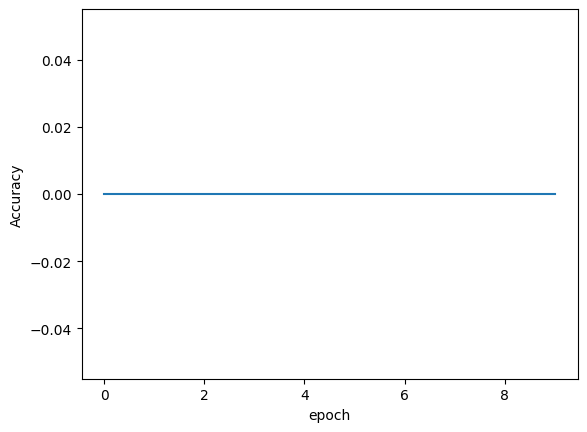

done
[]
60
20
4881


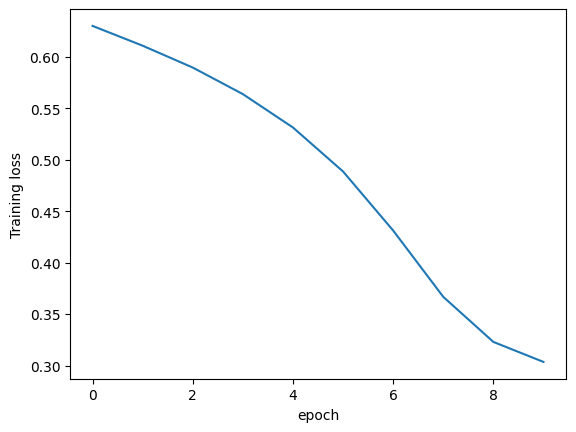

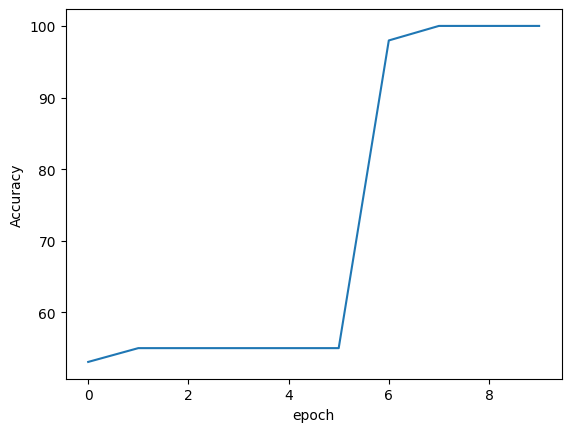

done
[]
60
20
4881


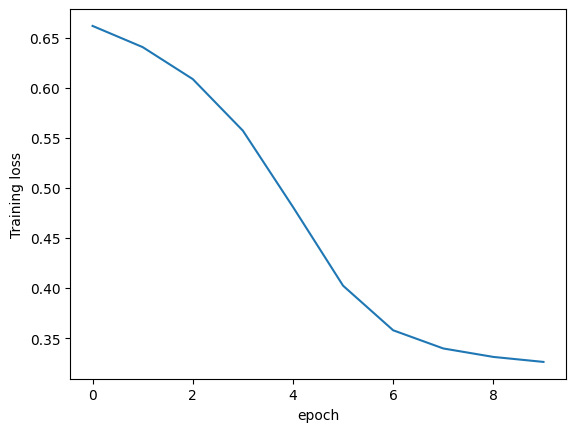

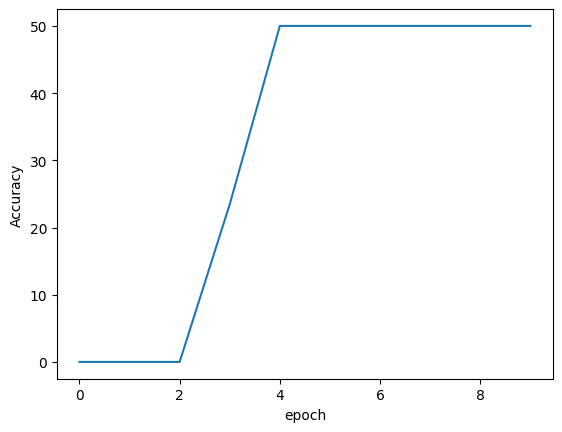

done
[]
60
20
4881


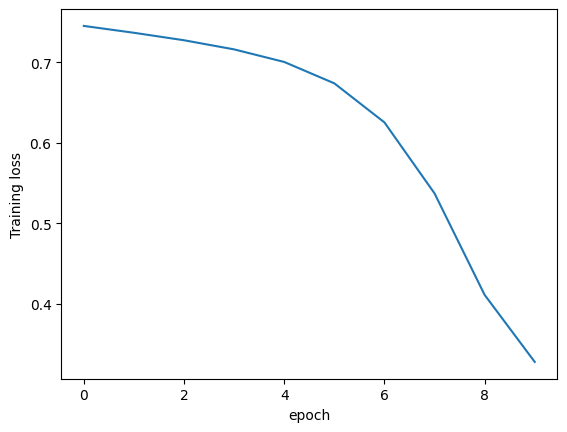

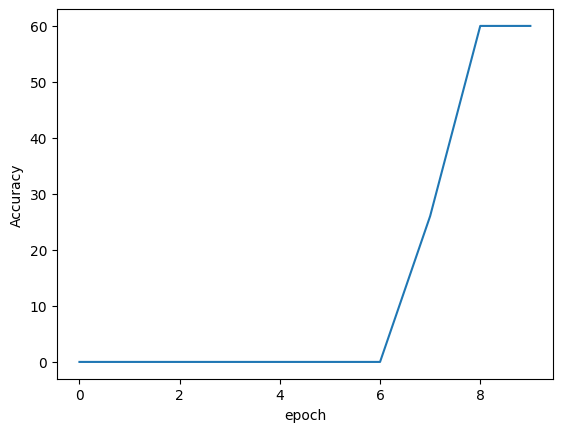

done
[]
60
20
4881


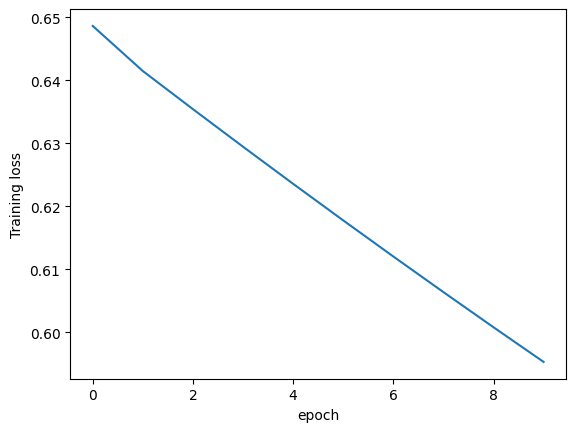

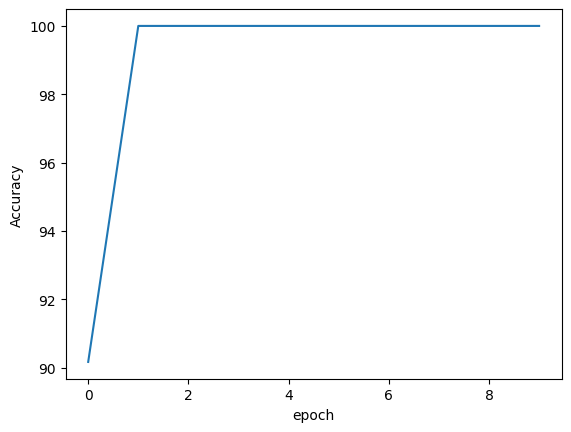

done
[]
60
tensor(0.)


In [36]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.ReLU(),
        nn.AvgPool1d(kernel_size=100),
        nn.Linear(in_features=9, out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


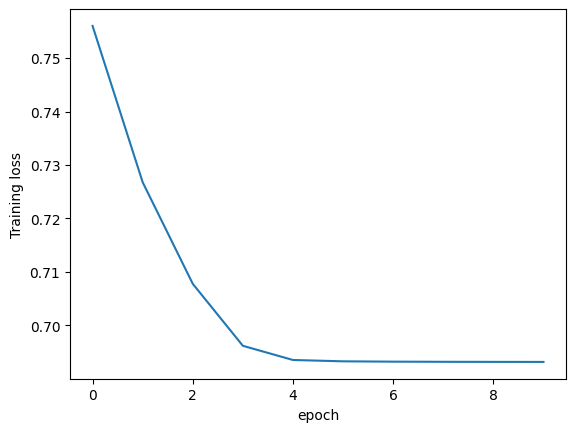

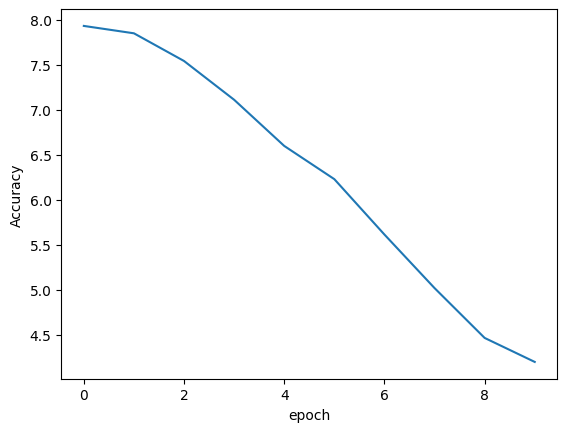

done
[]
60
20
4881


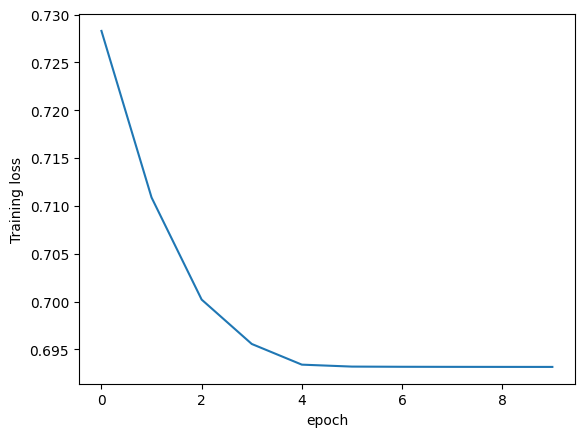

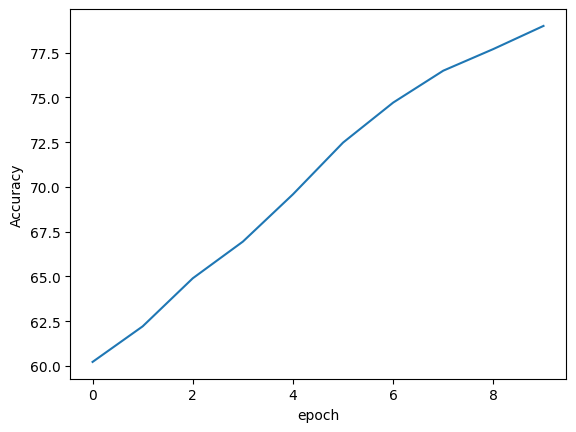

done
[]
60
20
4881


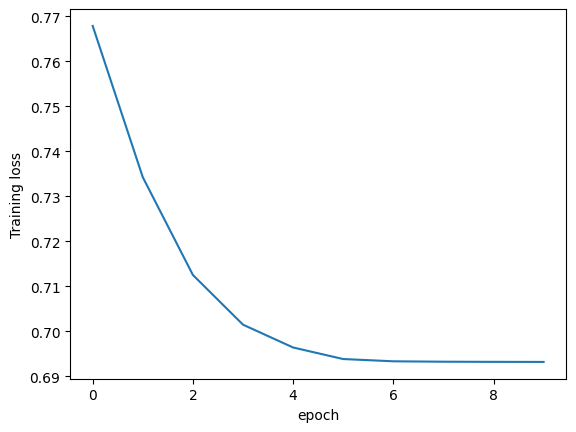

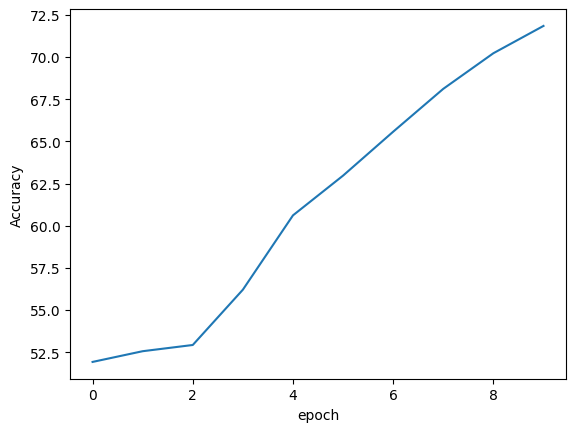

done
[]
60
20
4881


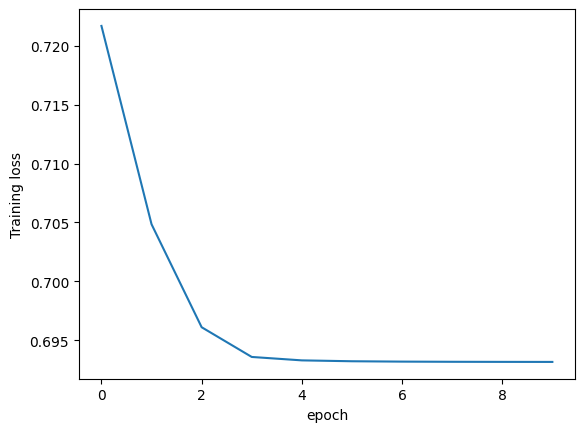

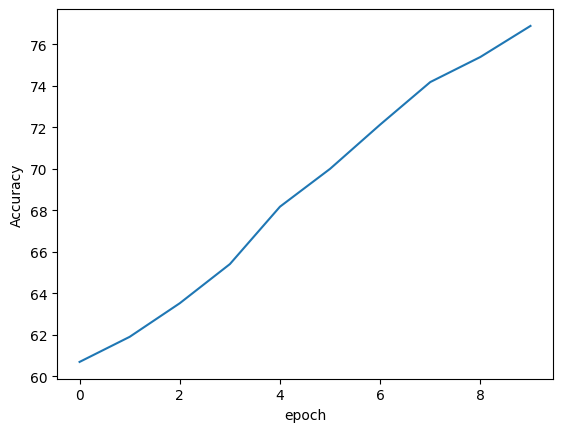

done
[]
60
20
4881


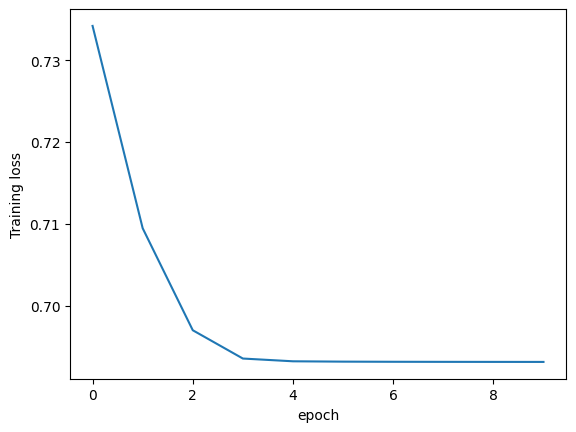

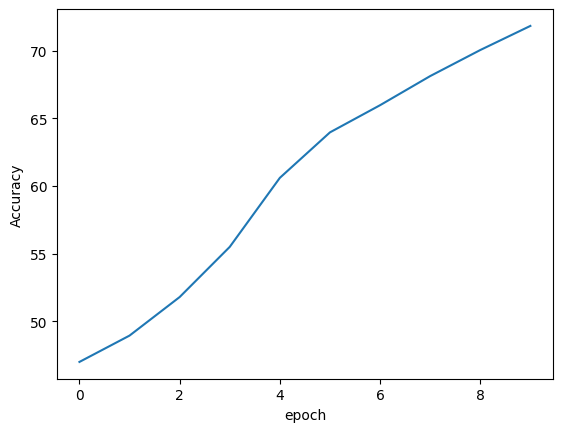

done
[]
60
tensor(1.4456)


In [37]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.ReLU(),
        nn.AvgPool1d(kernel_size=100),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


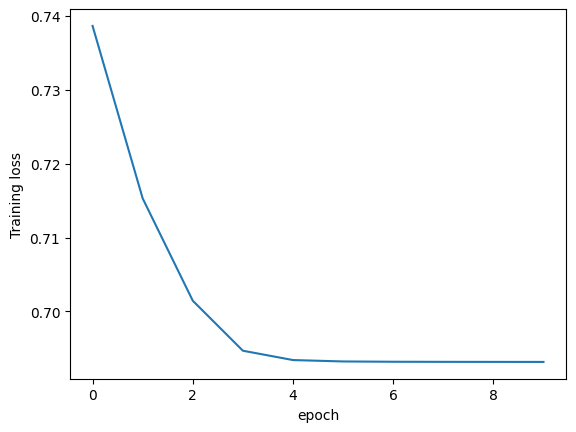

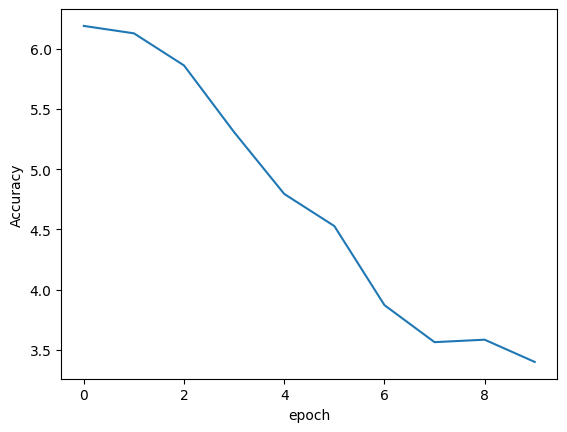

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
20
4881


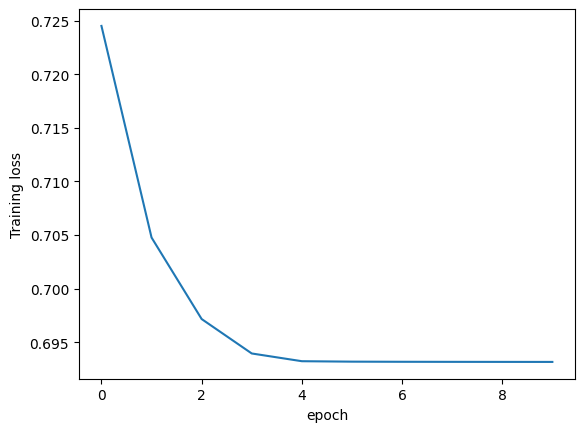

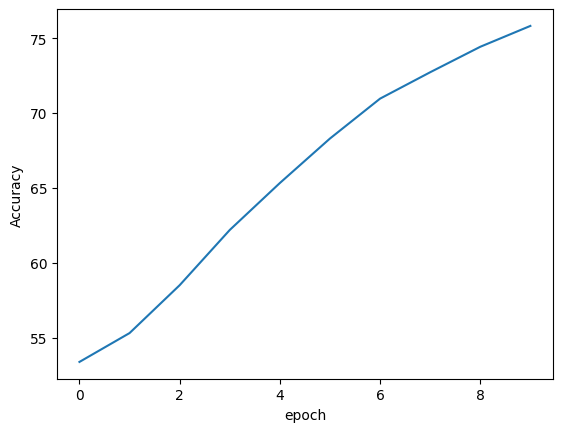

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
20
4881


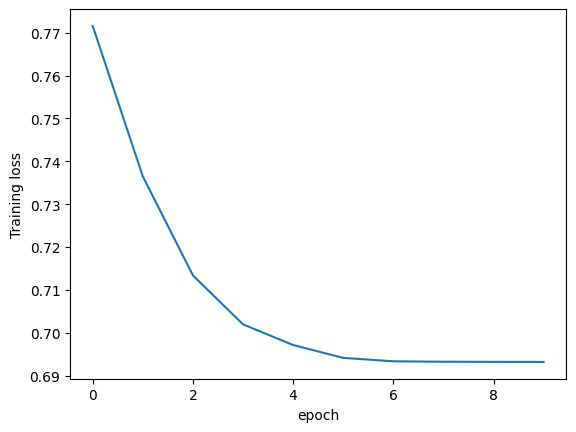

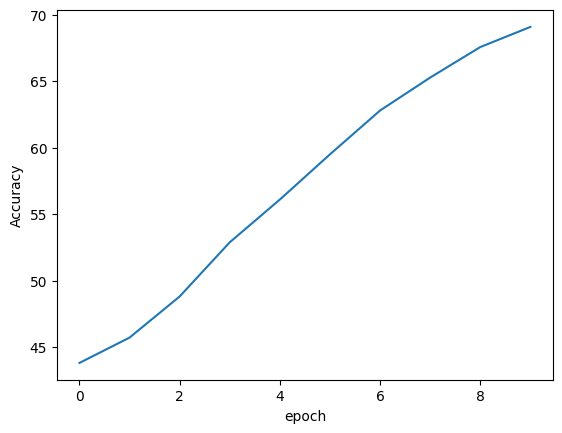

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
20
4881


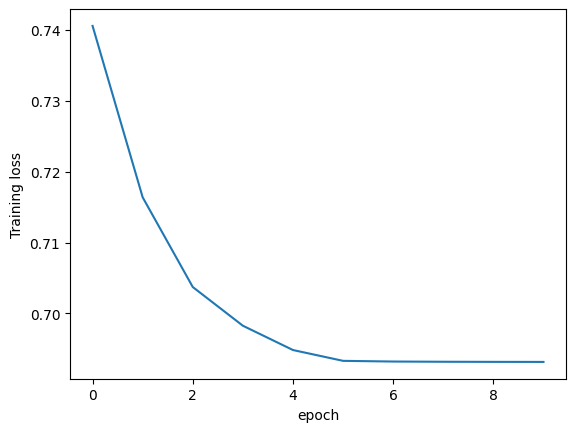

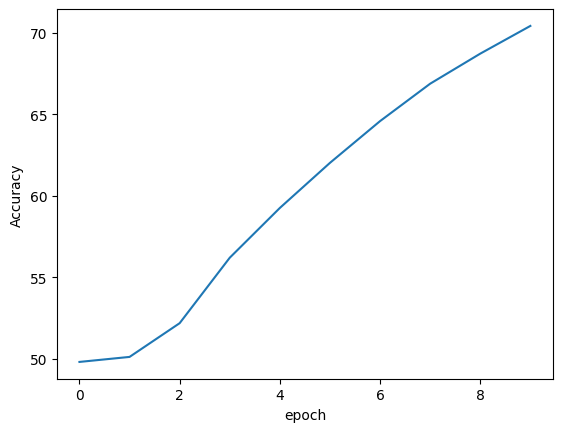

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
20
4881


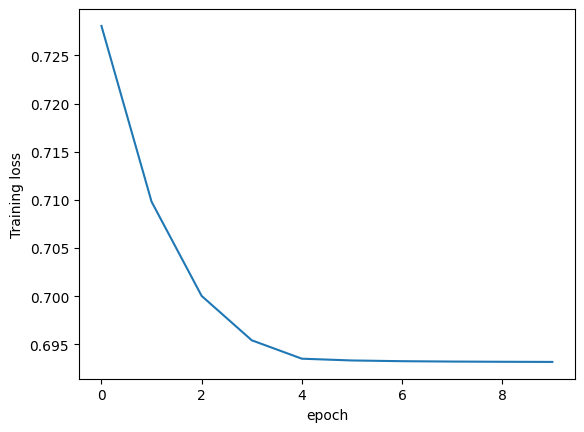

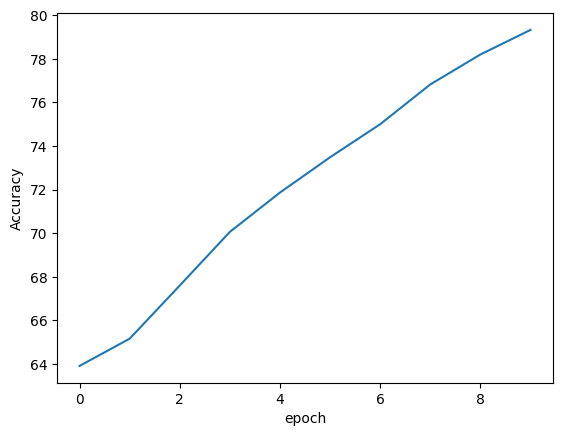

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
tensor(19.4918)


In [38]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.ReLU(),
        nn.AvgPool1d(kernel_size=100),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            print(len(X_val))
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


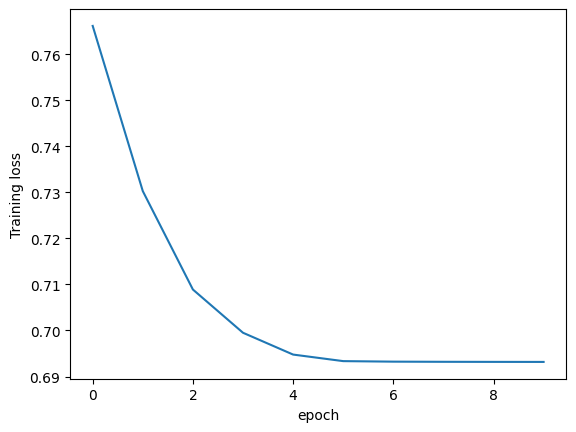

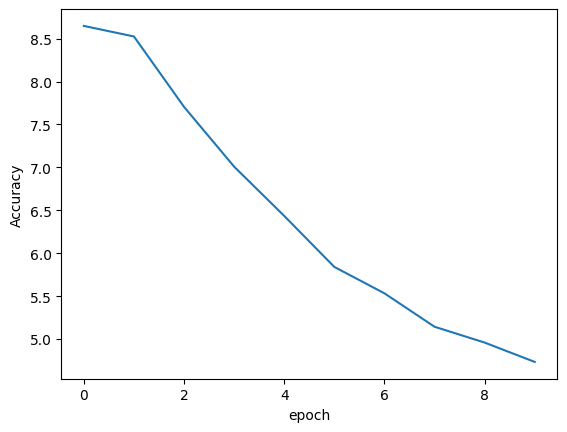

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
20
4881


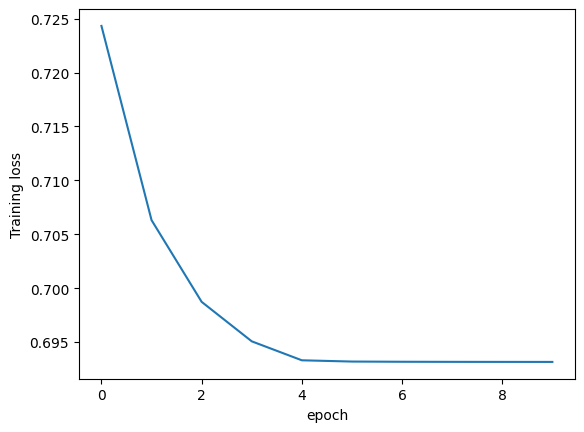

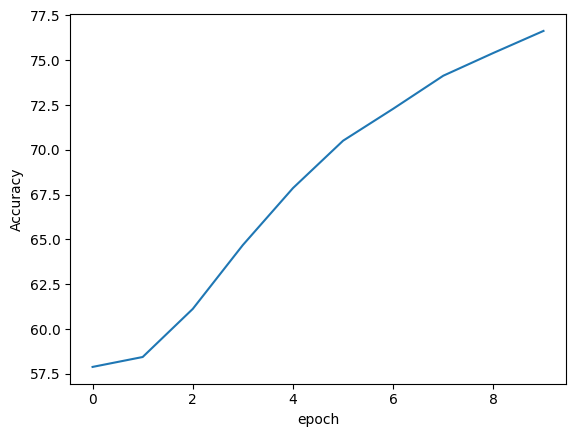

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
20
4881


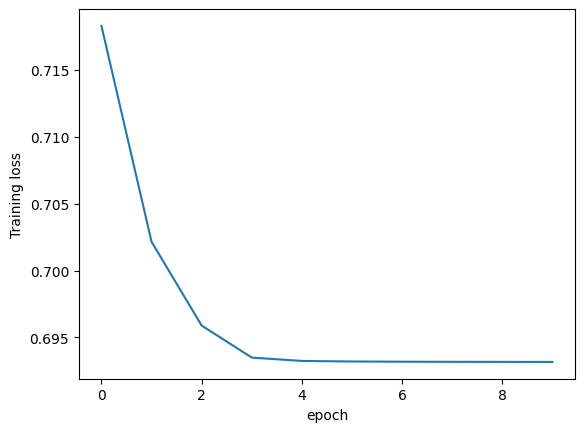

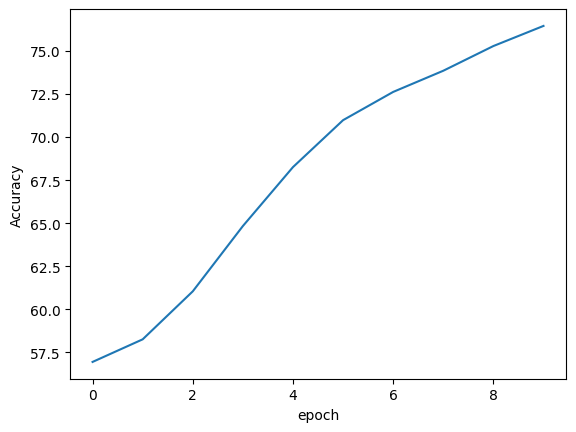

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
20
4881


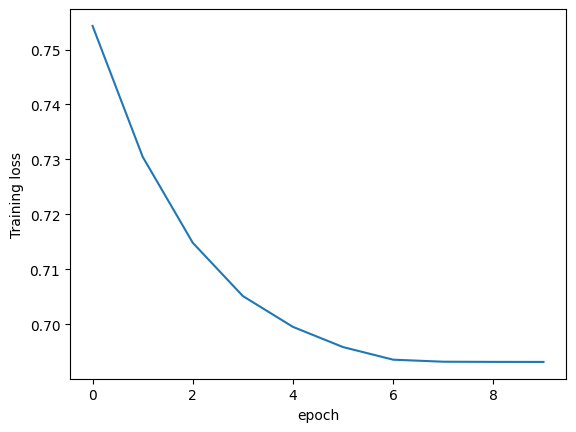

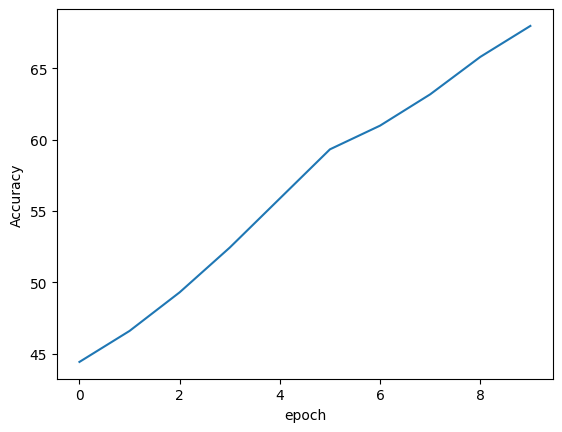

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
20
4881


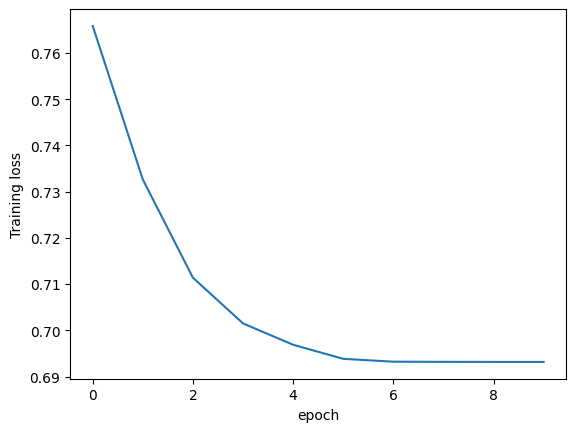

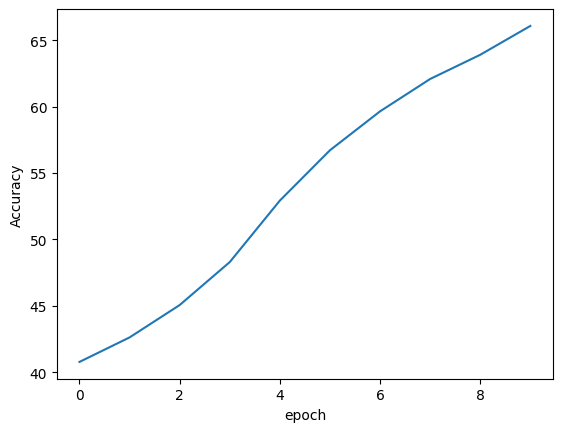

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
tensor(18.4918)
tensor([77.6229,  4.5082,  3.1967,  2.7049,  4.4262])


In [39]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Conv1d(in_channels=20, out_channels=20, kernel_size=379, stride=1),
        nn.ReLU(),
        nn.AvgPool1d(kernel_size=100),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
    
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            print(len(X_val))
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        #print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded


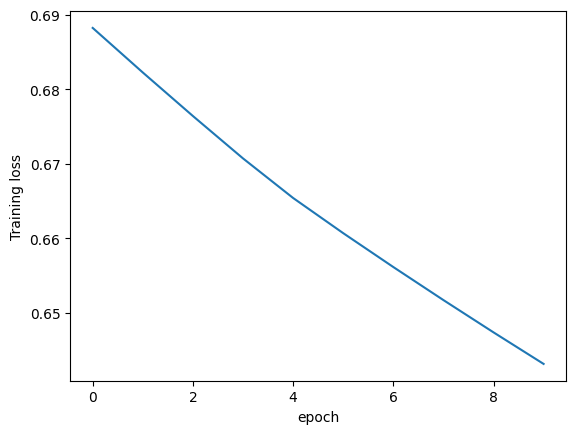

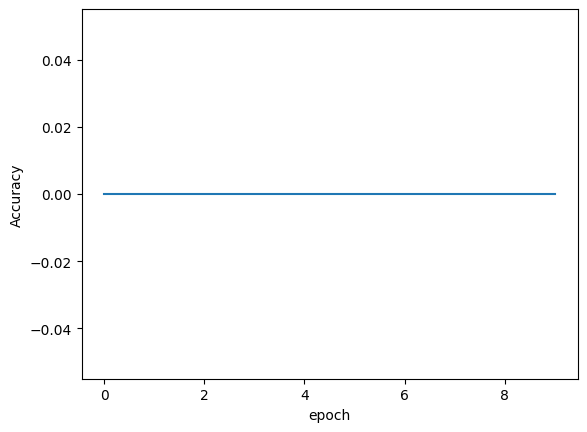

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60


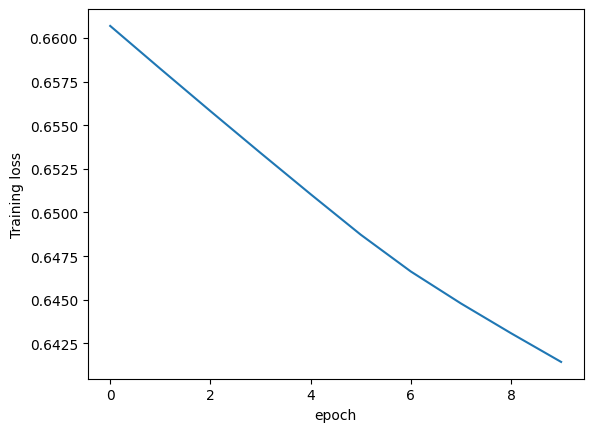

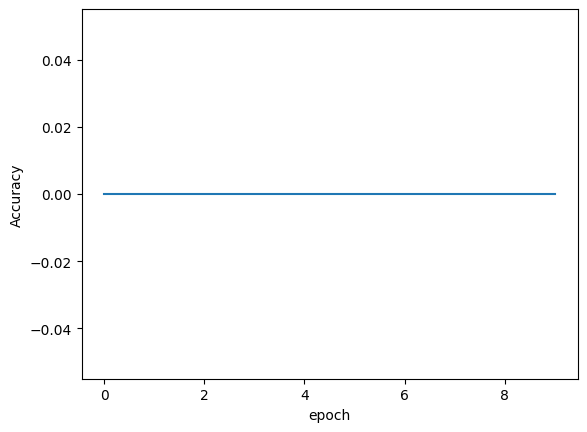

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60


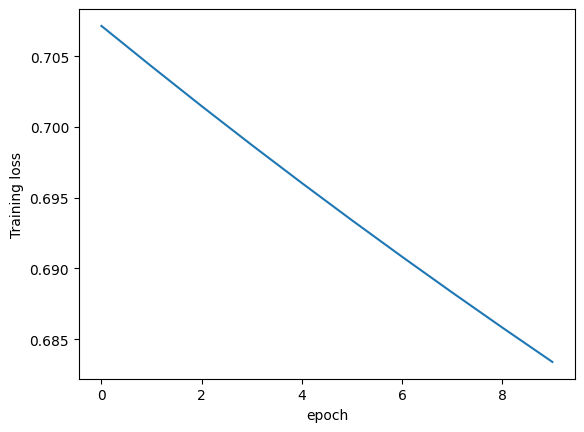

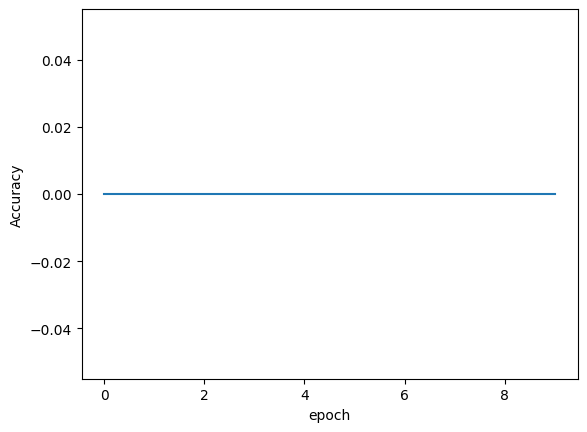

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60


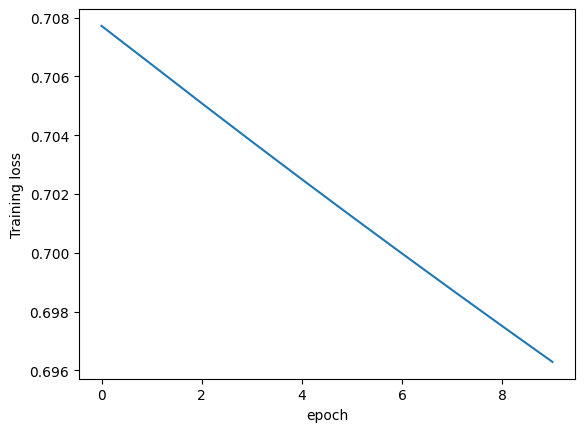

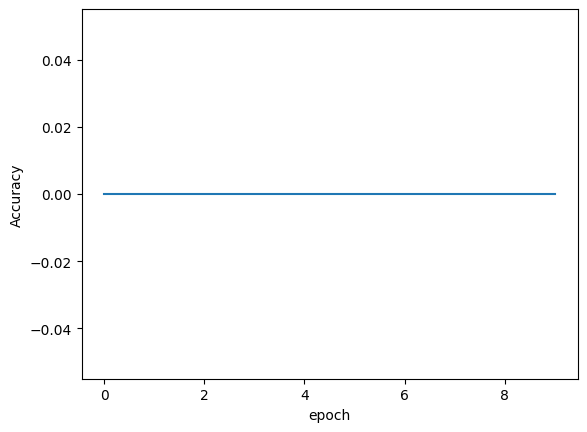

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60


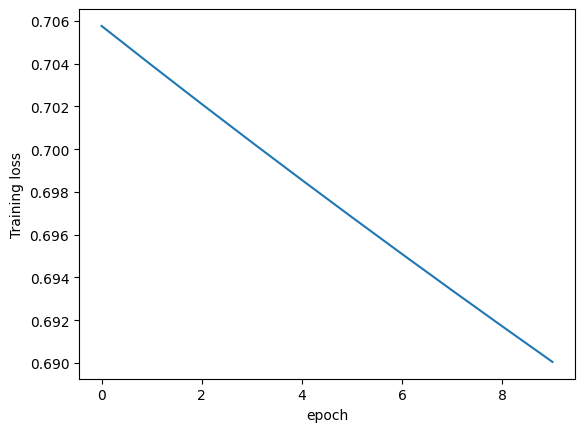

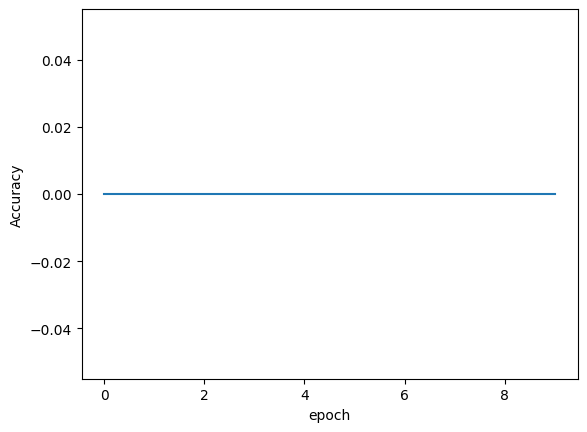

done
[]
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
61
60
tensor(20.)
tensor([100.,   0.,   0.,   0.,   0.])


In [41]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280, out_features=10),
        nn.ReLU(),
        nn.Linear(in_features=10, out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            #print(len(y_pred))
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
    
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
   # print(X_train.batch_size)
    #print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            print(len(X_val))
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


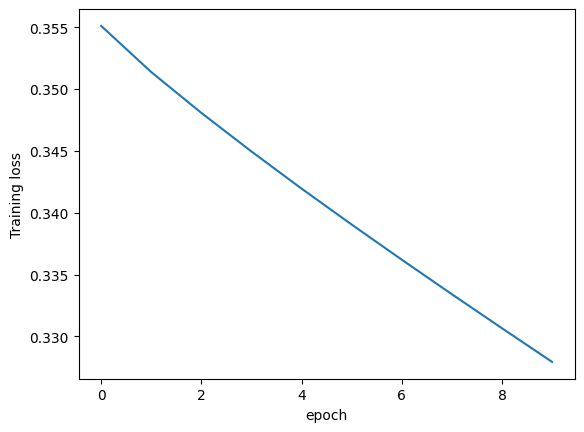

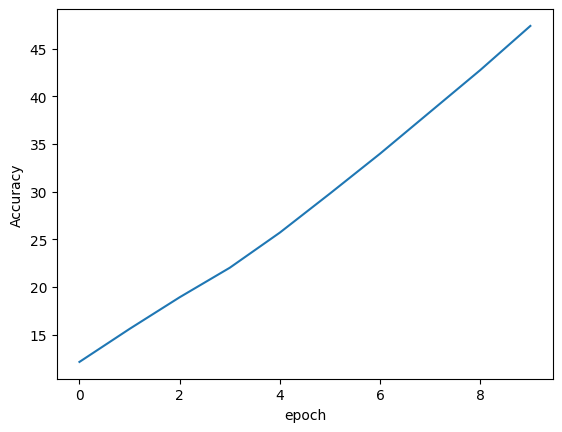

done
[]
60
20
4881


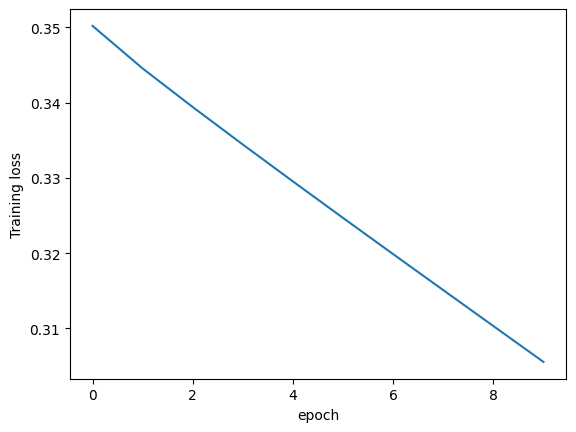

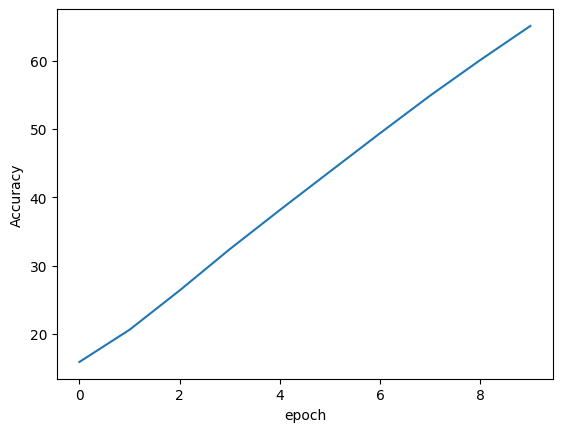

done
[]
60
20
4881


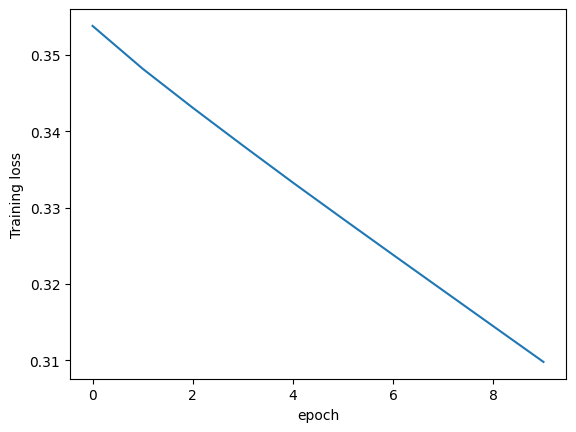

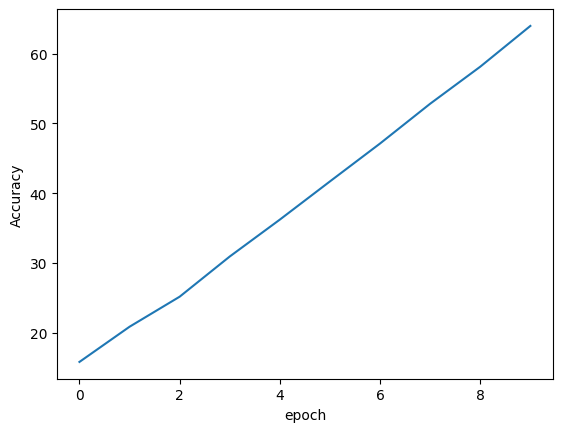

done
[]
60
20
4881


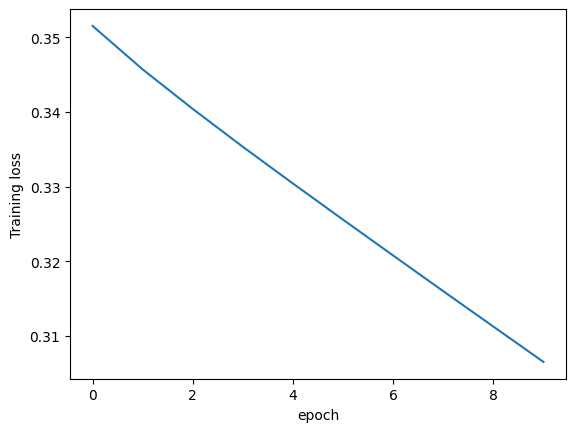

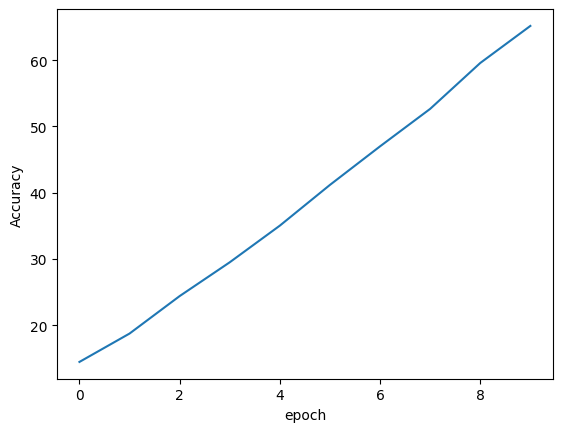

done
[]
60
20
4881


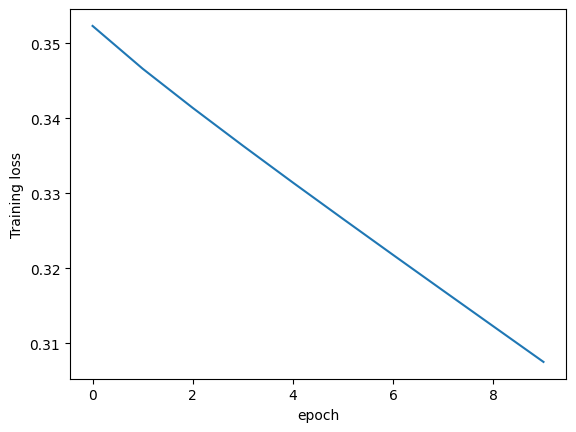

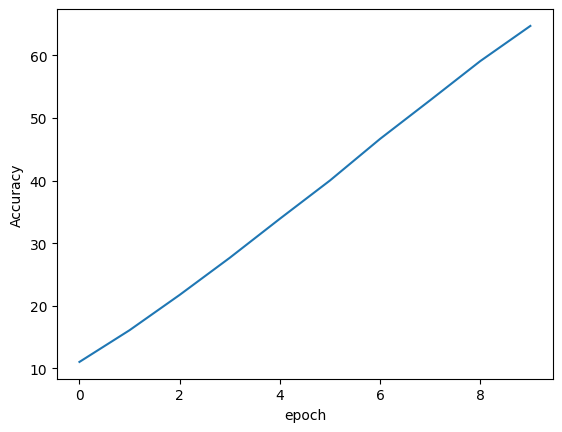

done
[]
60
tensor(0.0616)


In [43]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881
243
243
243
243
243
243
243
243
243
243


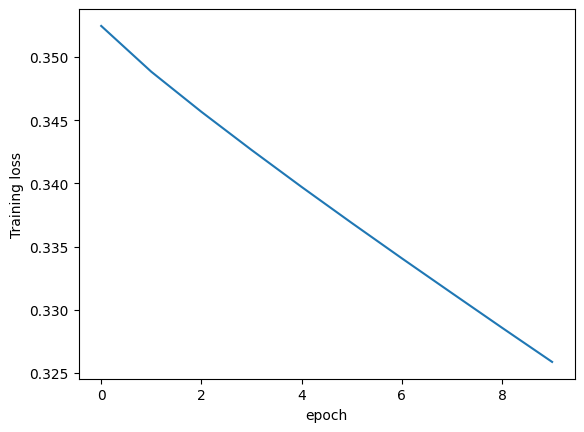

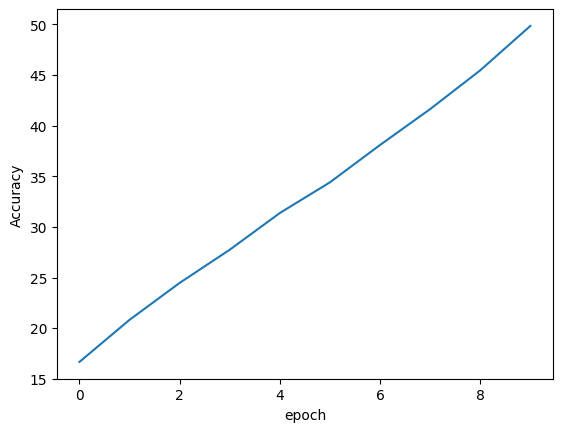

done
[]
60
20
4881
243
243
243
243
243
243
243
243
243
243


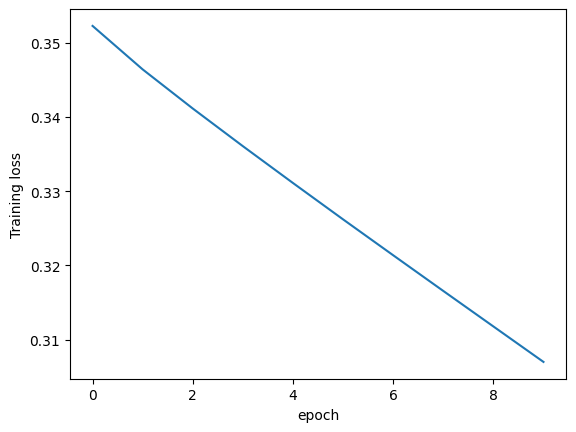

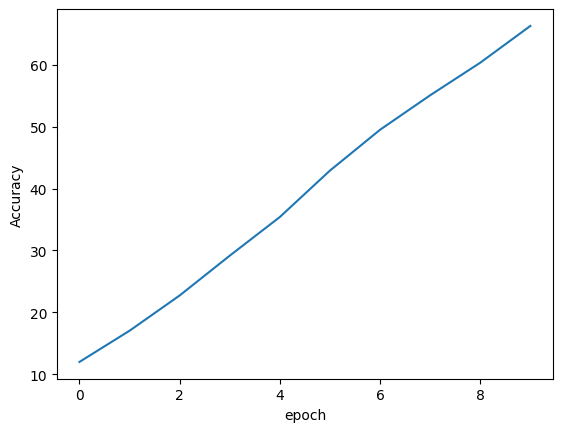

done
[]
60
20
4881
243
243
243
243
243
243
243
243
243
243


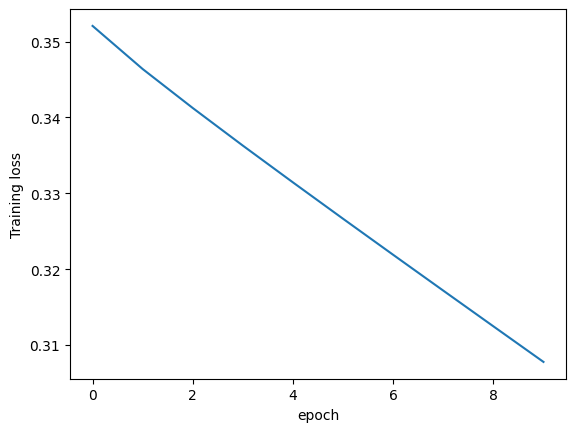

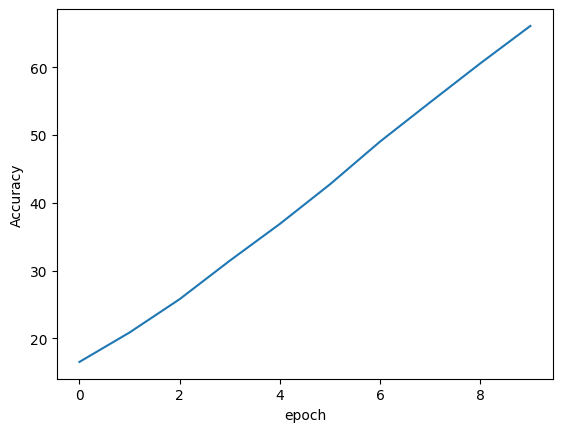

done
[]
60
20
4881
243
243
243
243
243
243
243
243
243
243


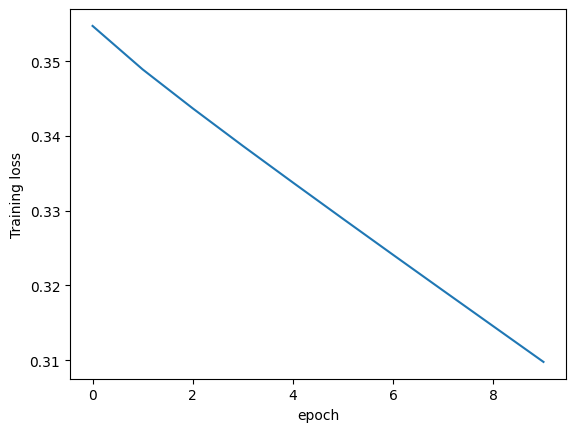

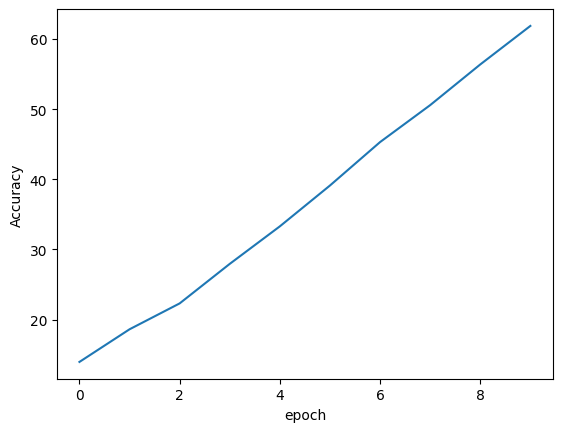

done
[]
60
20
4881
243
243
243
243
243
243
243
243
243
243


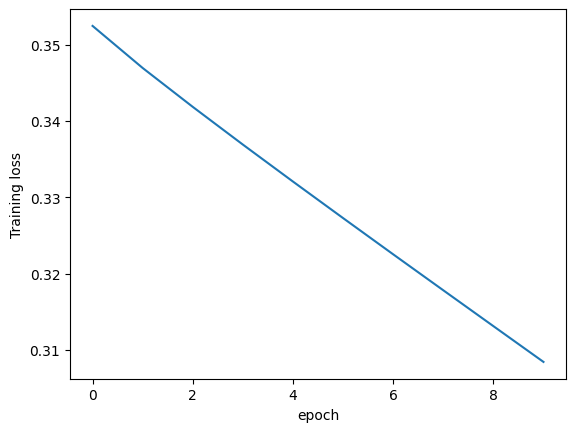

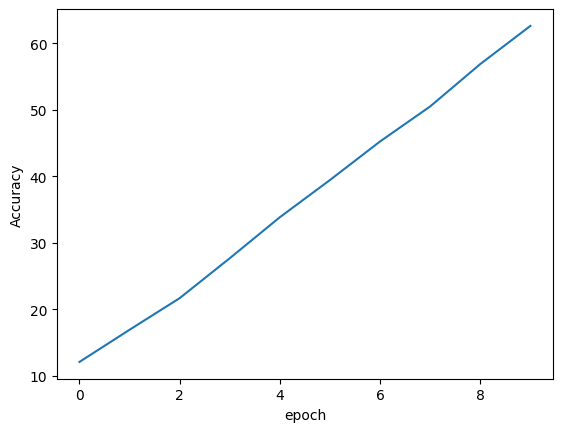

done
[]
60
tensor(0.0682)


In [44]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(763*1)
        average_loss=test_loss/(763*1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


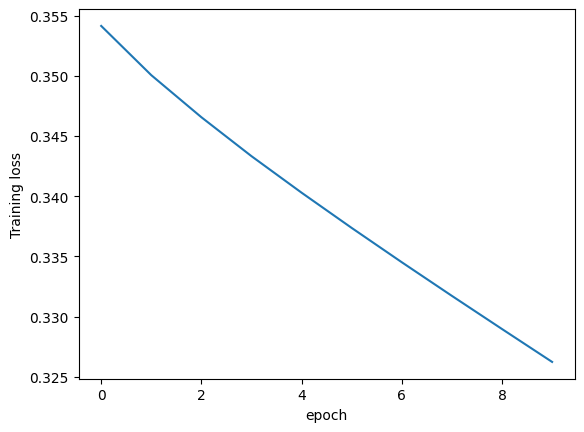

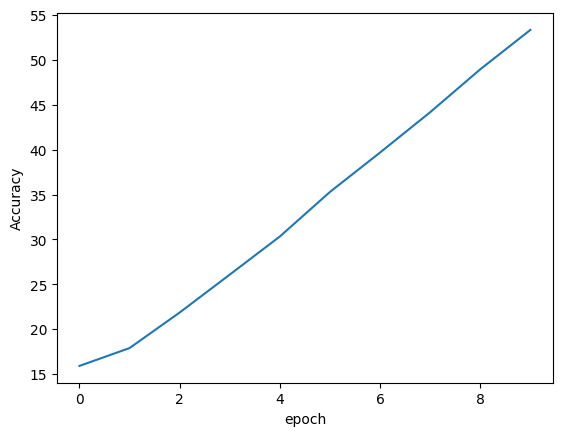

done
[]
60
20
4881


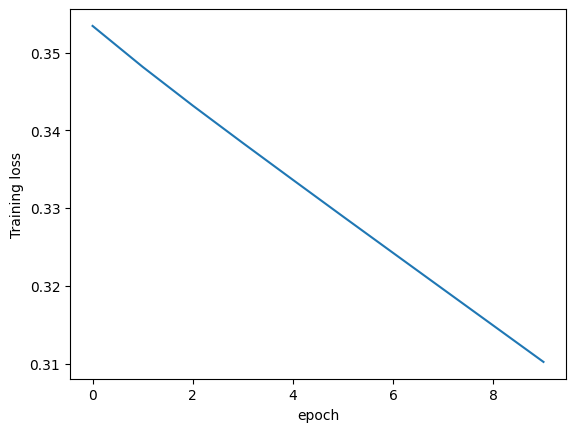

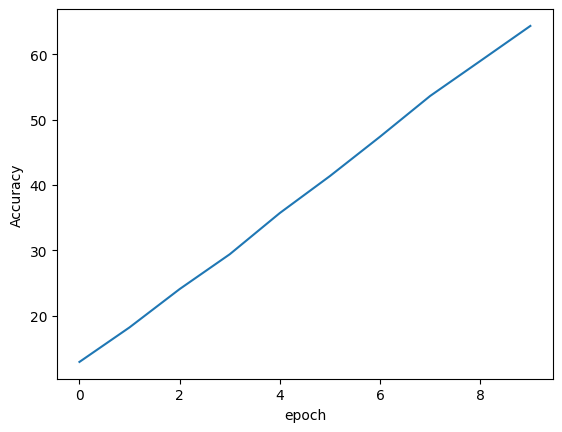

done
[]
60
20
4881


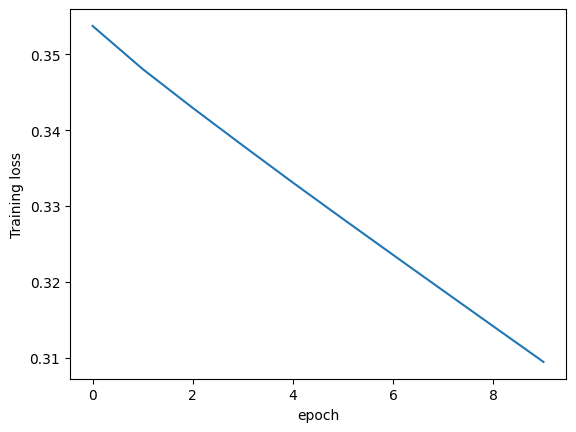

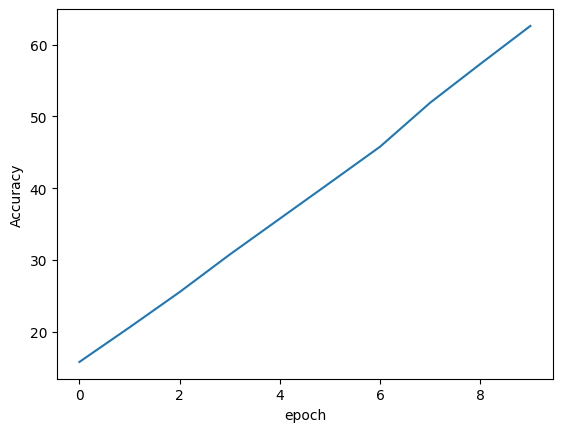

done
[]
60
20
4881


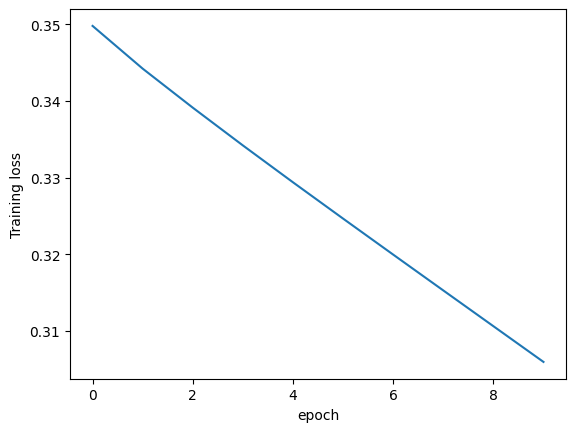

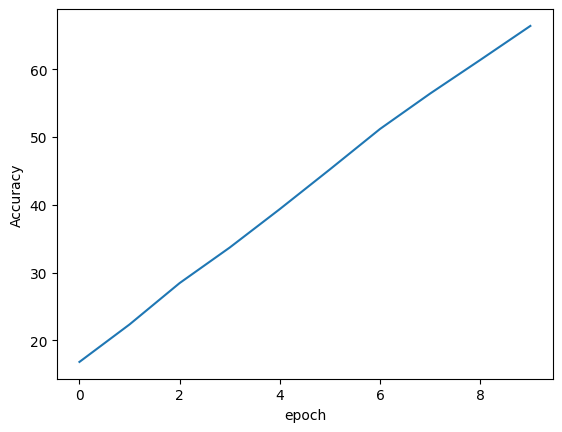

done
[]
60
20
4881


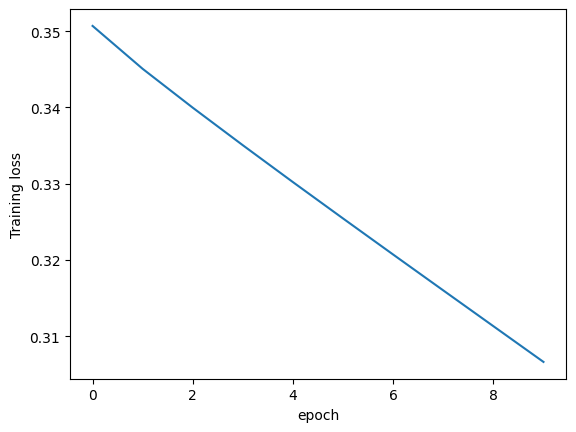

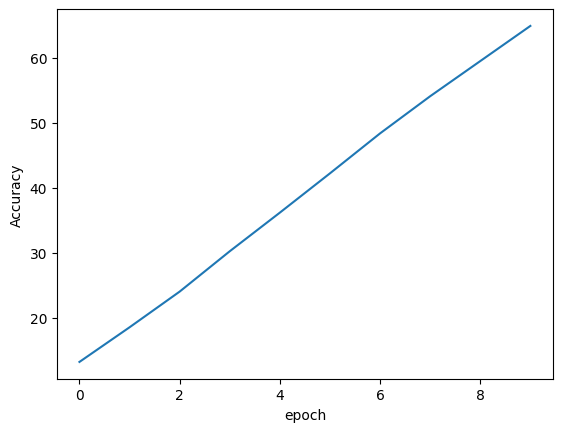

done
[]
60
tensor(1.7213)


In [45]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=1280),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=1280),
        nn.Linear(in_features=1280 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))






               


#Need a testing and validation group

7626
Data loaded
20
4881


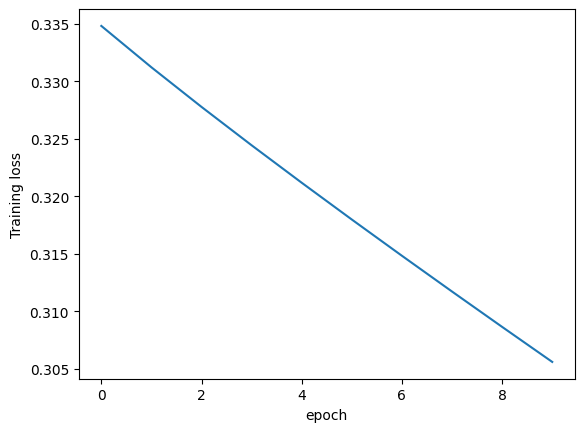

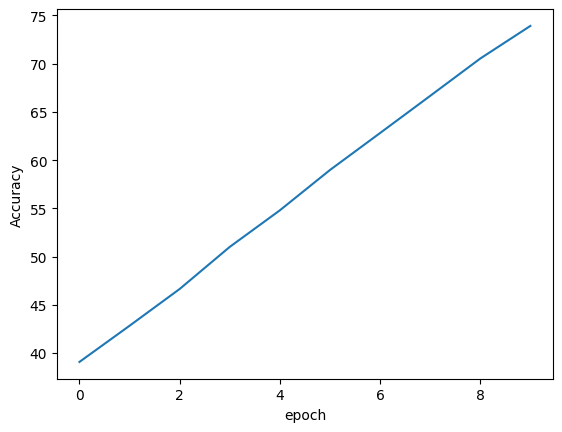

done
[]
60
20
4881


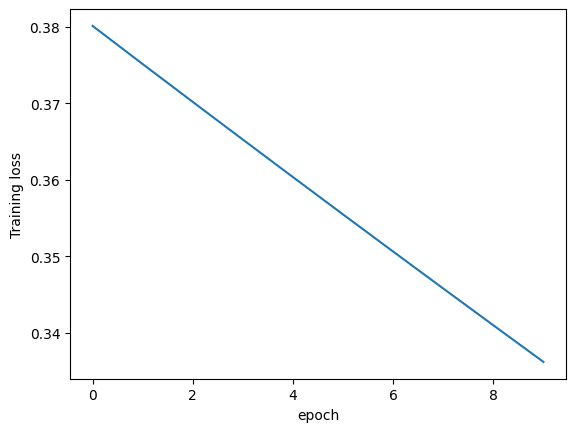

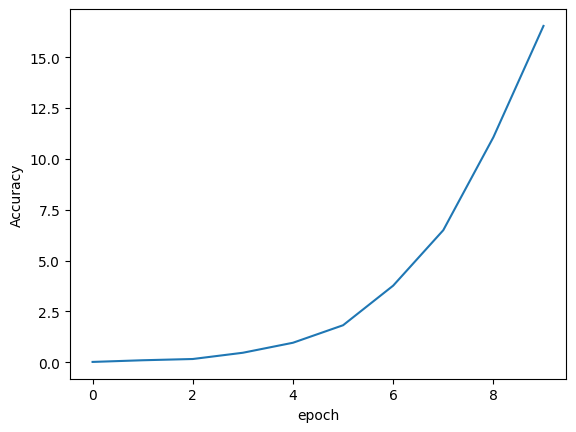

done
[]
60
20
4881


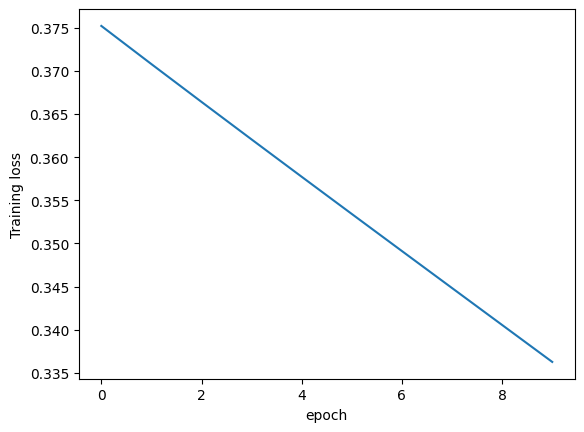

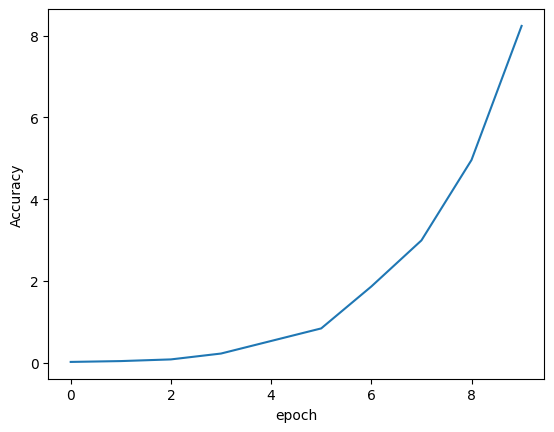

done
[]
60
20
4881


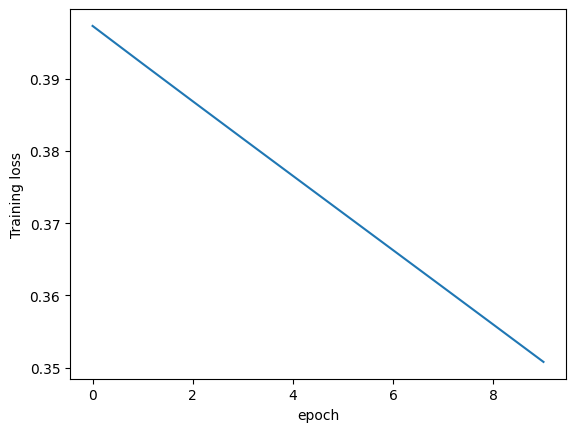

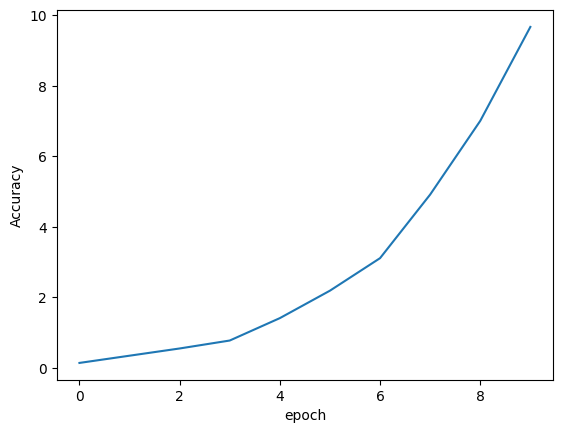

done
[]
60
20
4881


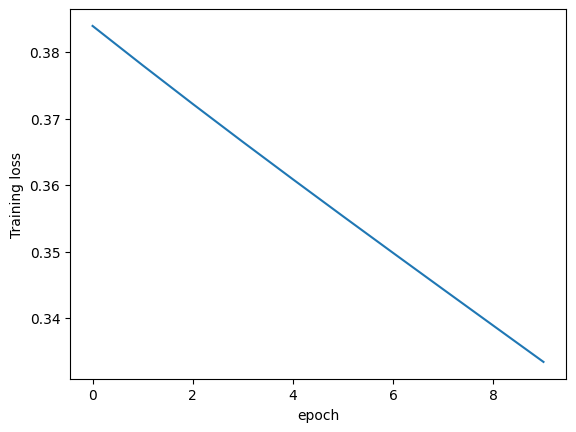

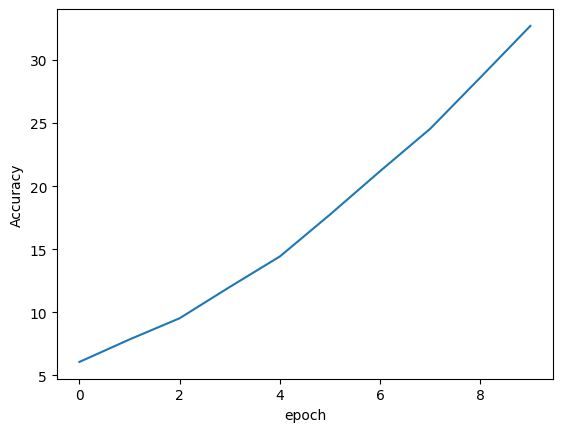

done
[]
60
tensor(17.3443)
tensor([26.1475,  0.0000,  5.5738,  0.8197, 54.1803])


In [47]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


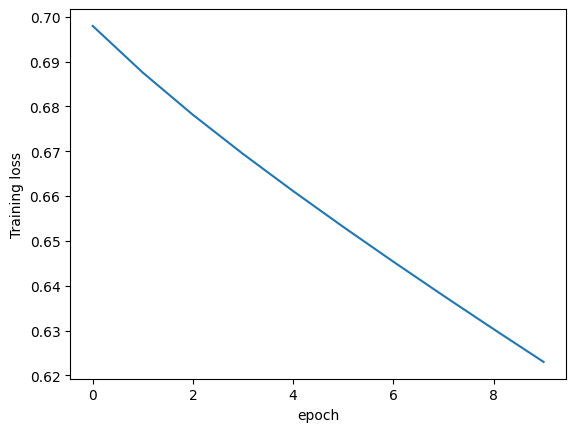

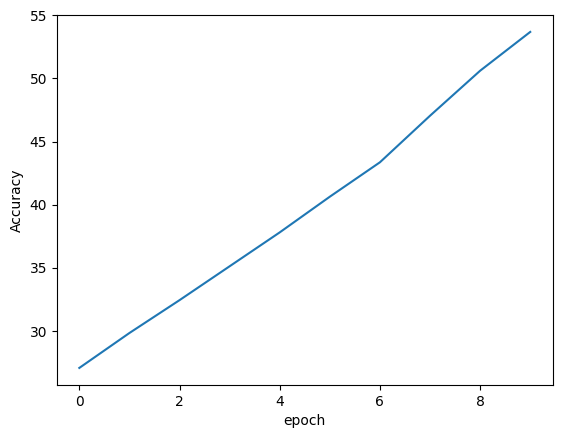

done
[]
60
20
4881


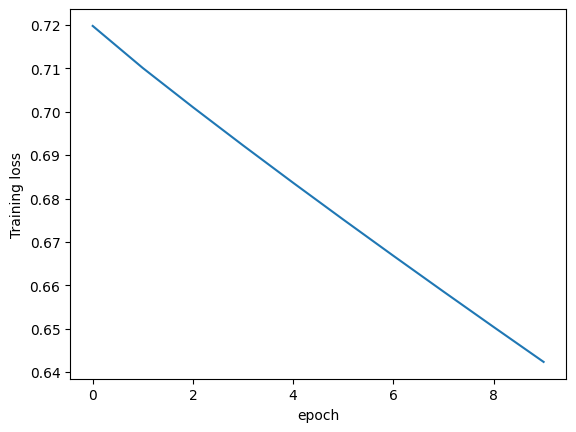

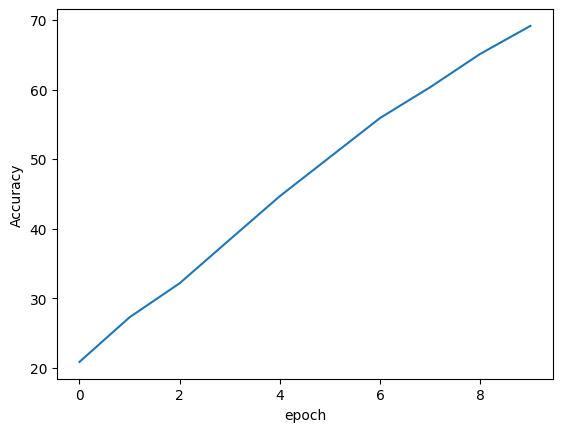

done
[]
60
20
4881


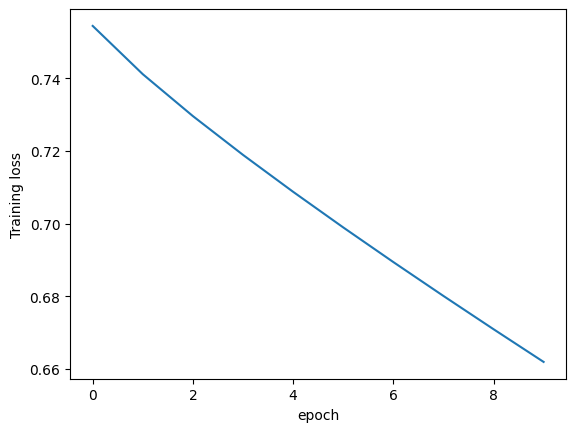

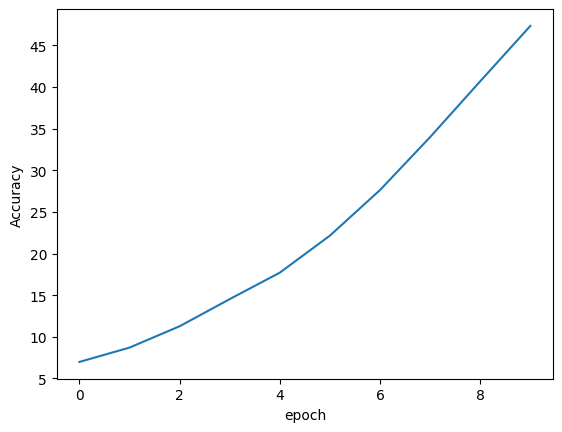

done
[]
60
20
4881


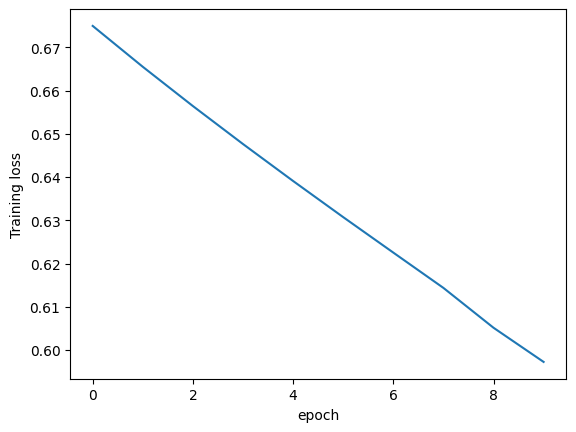

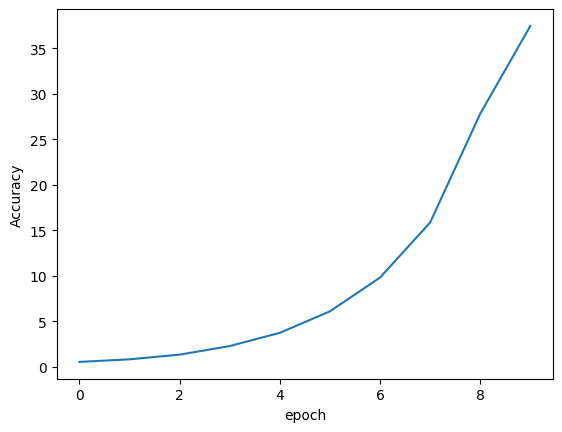

done
[]
60
20
4881


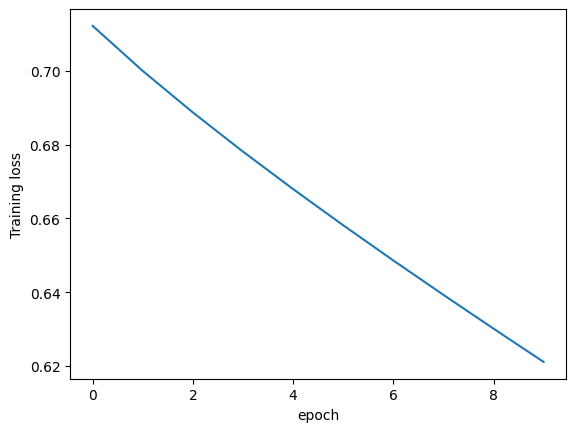

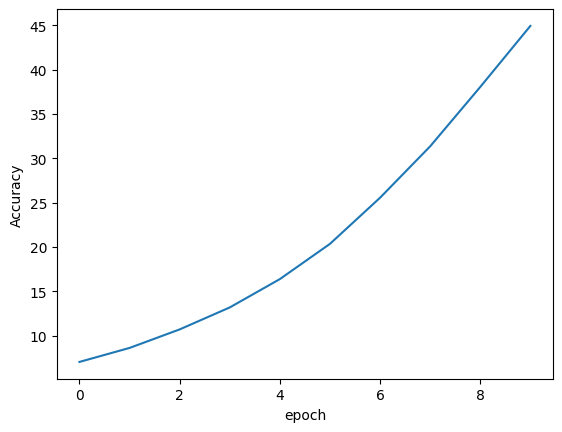

done
[]
60
tensor(3.9836)
tensor([ 0.1639, 18.1967,  0.0820,  0.0820,  1.3934])


In [48]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


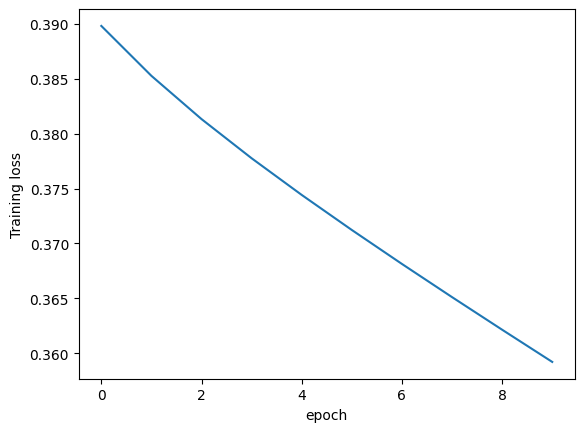

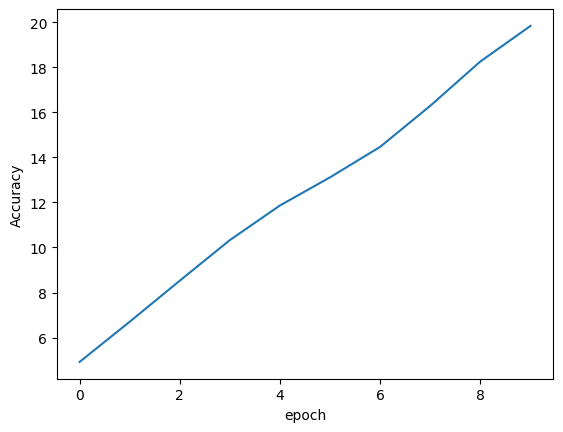

done
[]
60
20
4881


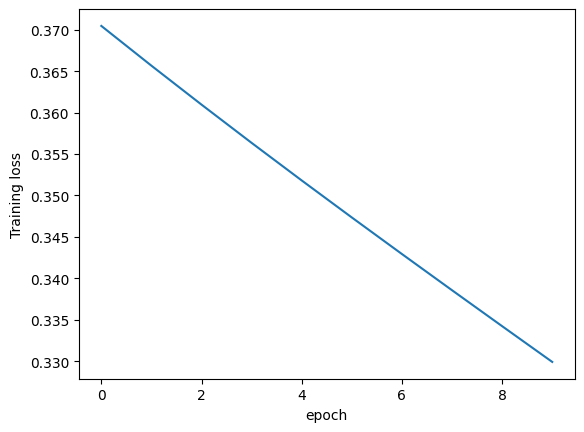

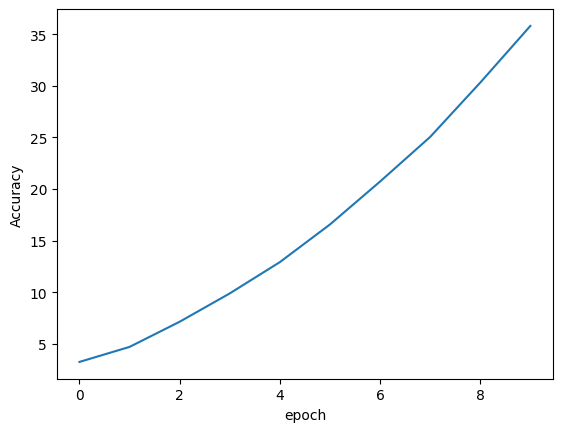

done
[]
60
20
4881


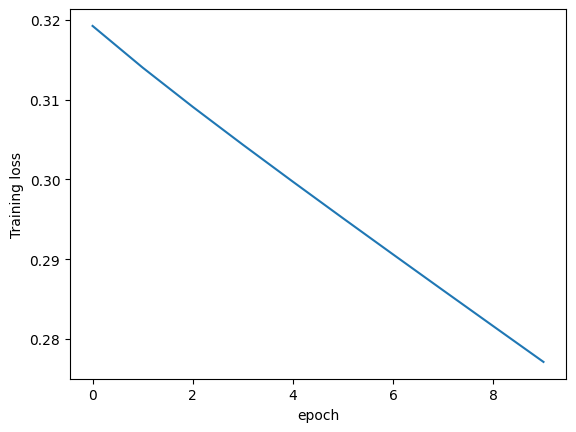

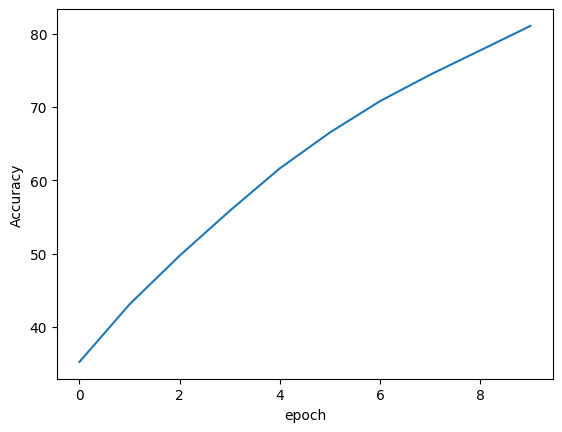

done
[]
60
20
4881


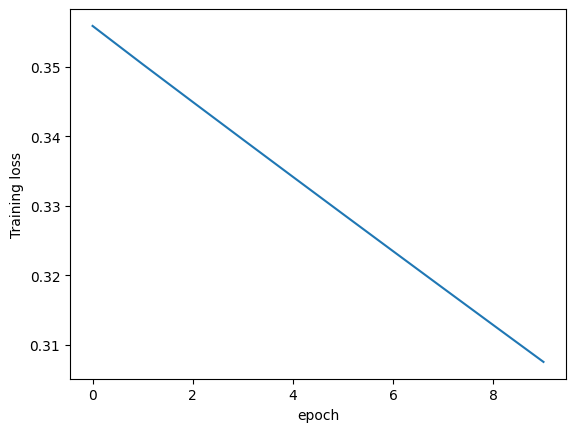

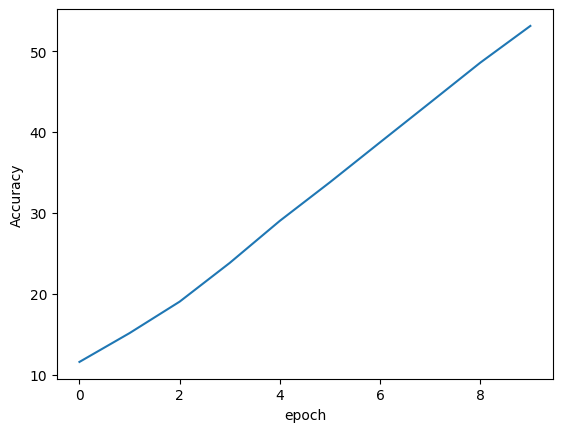

done
[]
60
20
4881


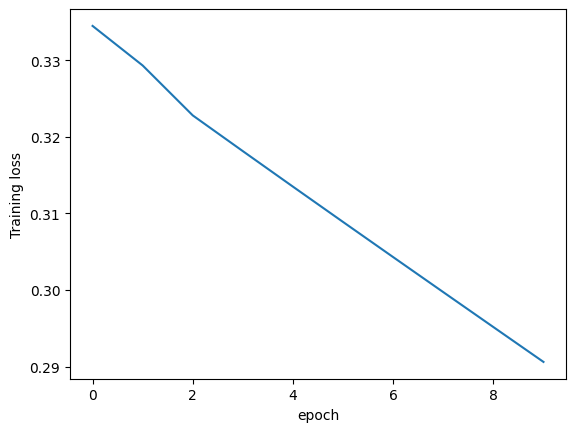

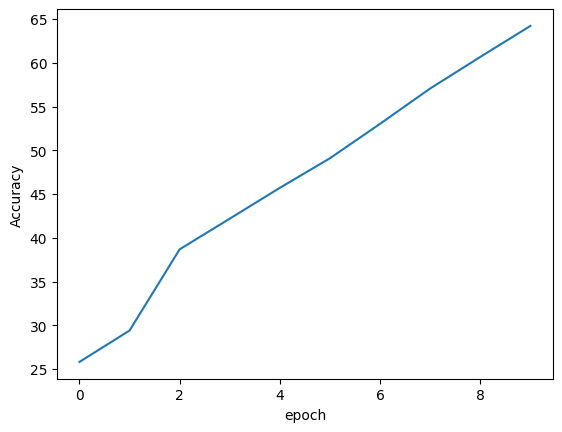

done
[]
60
tensor(2.2131)
tensor([0.0000, 5.9836, 2.1311, 0.0000, 2.9508])


In [49]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


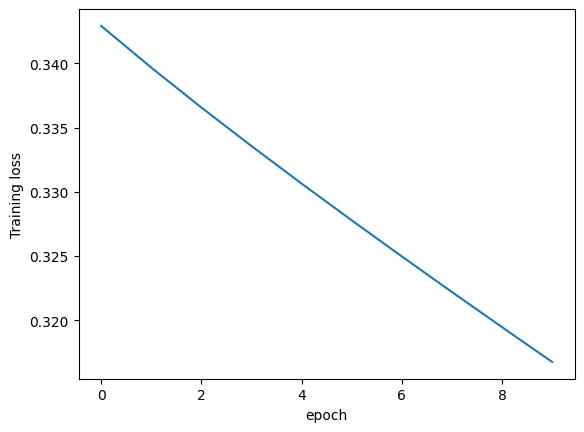

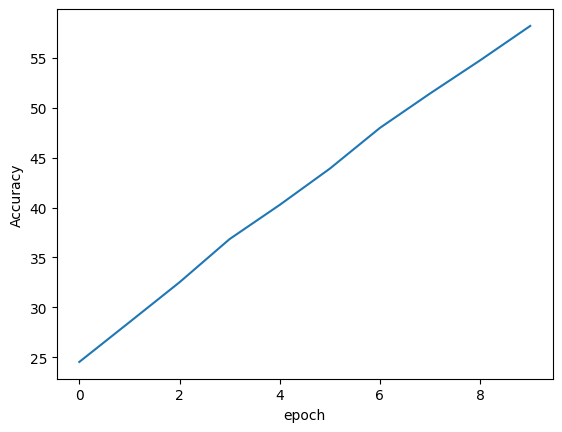

done
[]
60
20
4881


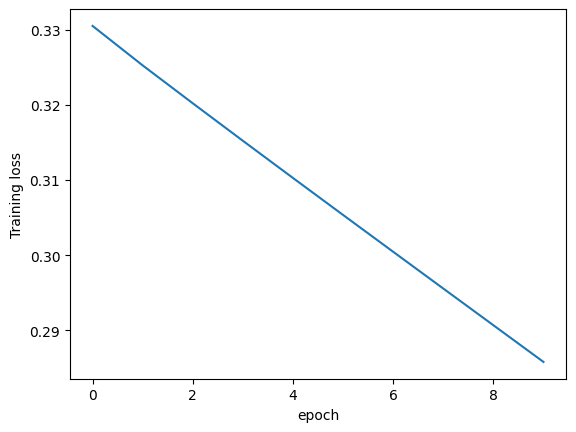

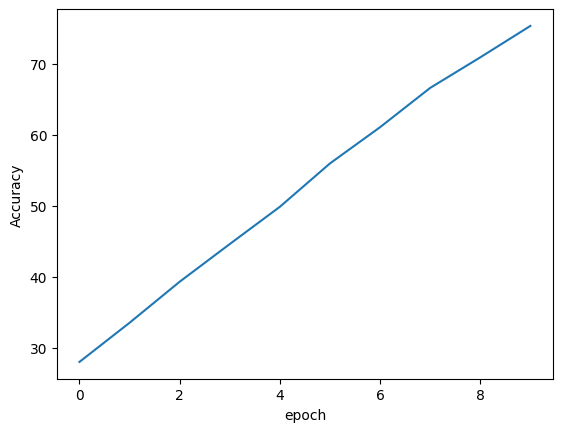

done
[]
60
20
4881


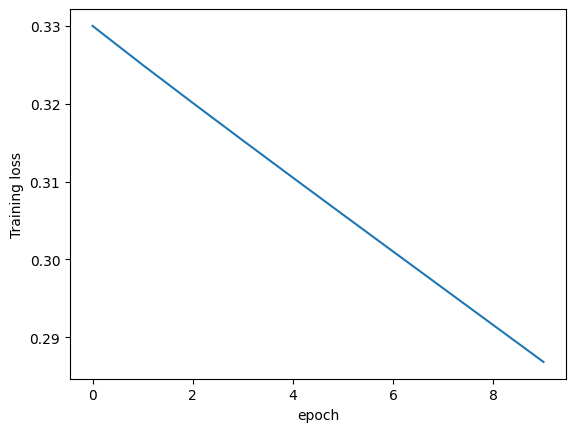

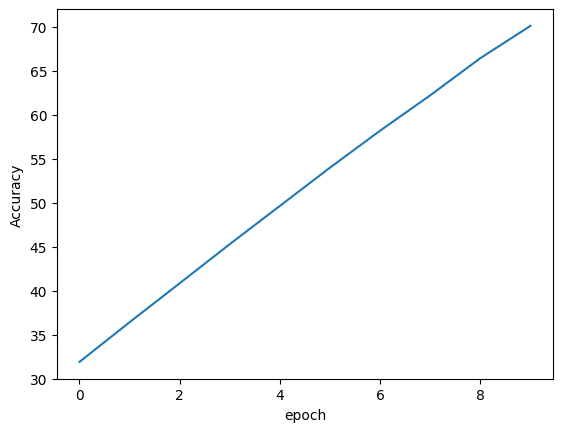

done
[]
60
20
4881


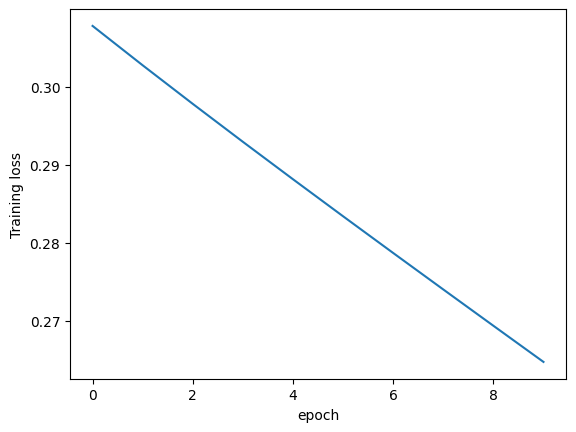

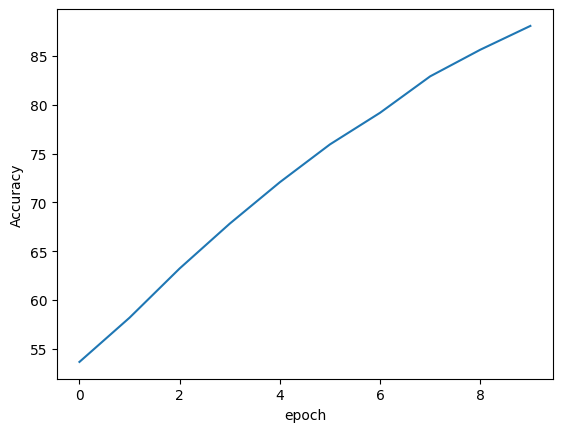

done
[]
60
20
4881


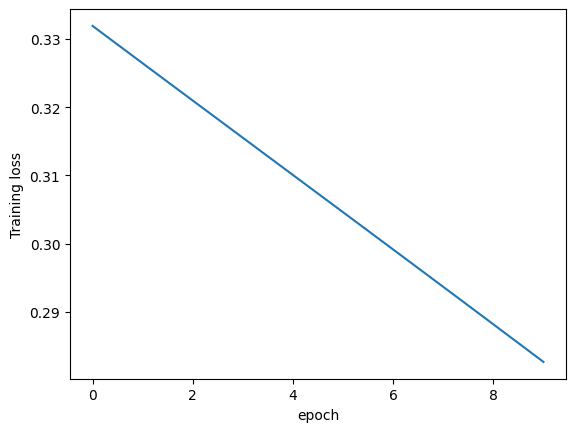

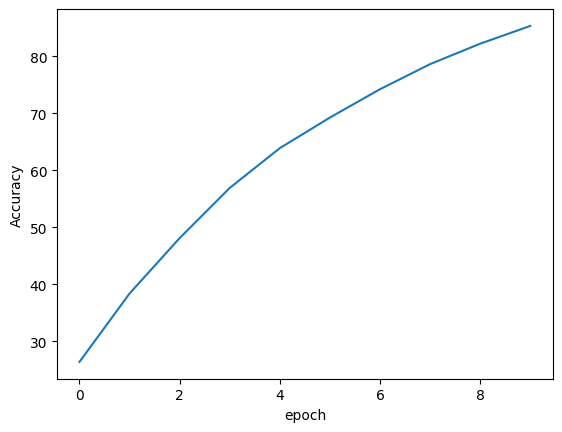

done
[]
60
tensor(3.3115)
tensor([ 0.0820,  2.0492, 14.4262,  0.0000,  0.0000])


In [51]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


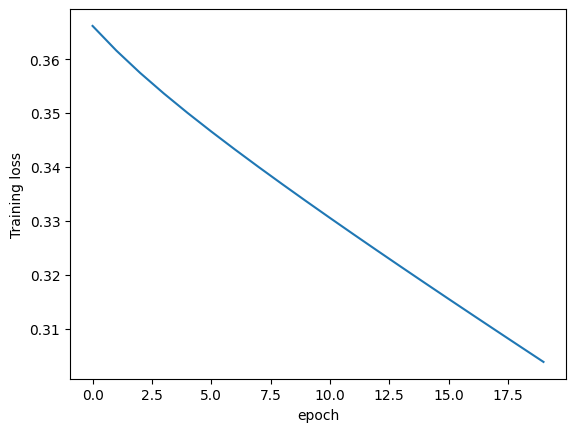

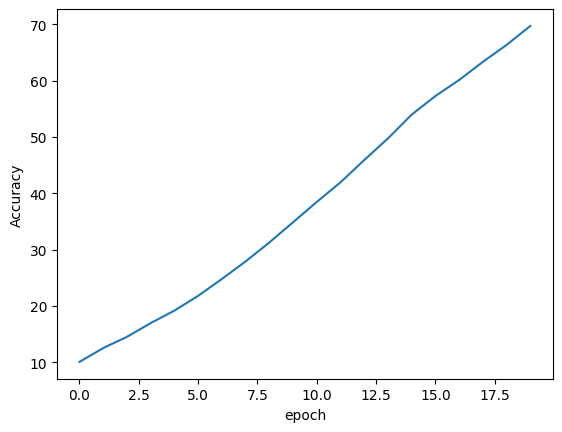

done
[]
60
20
4881


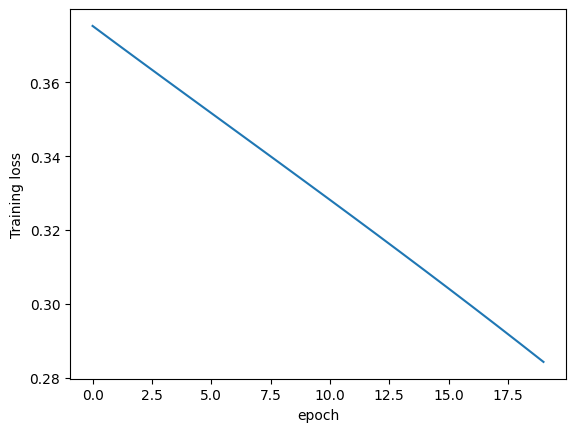

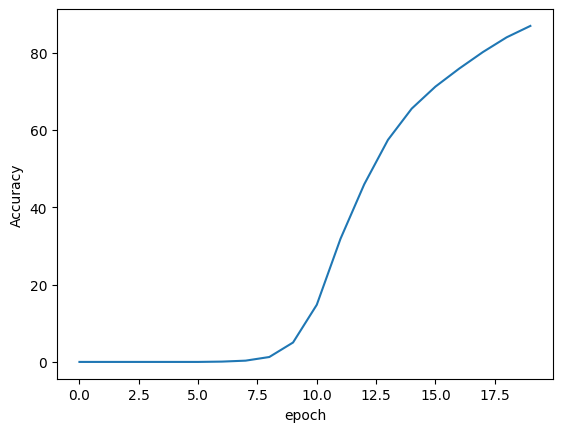

done
[]
60
20
4881


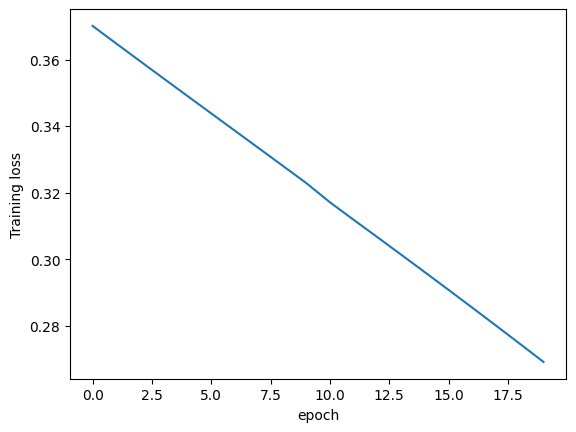

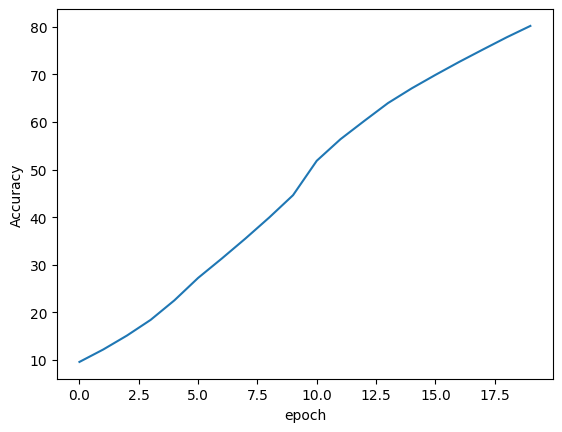

done
[]
60
20
4881


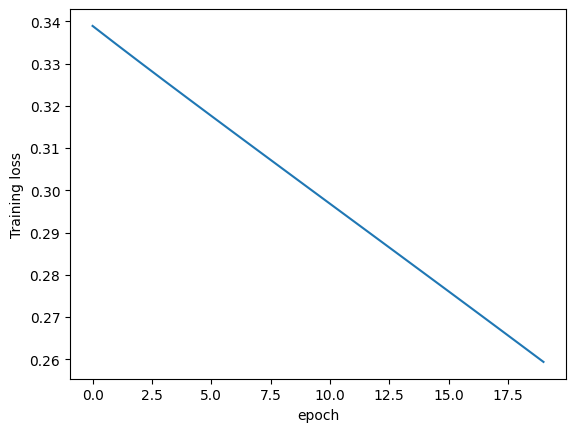

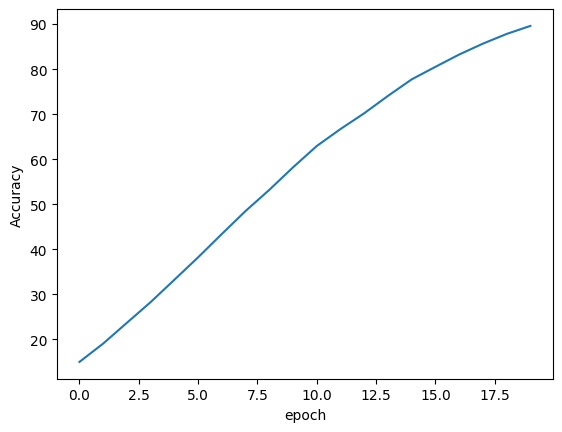

done
[]
60
20
4881


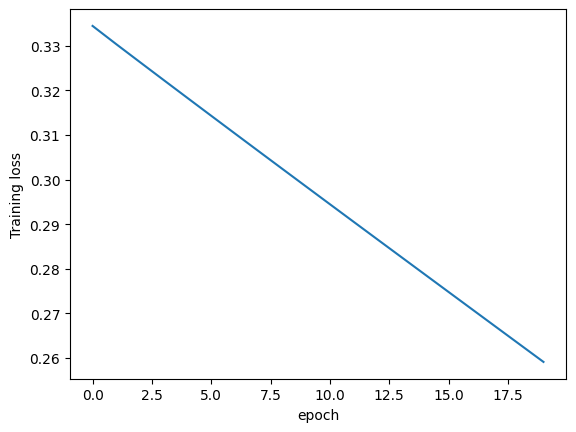

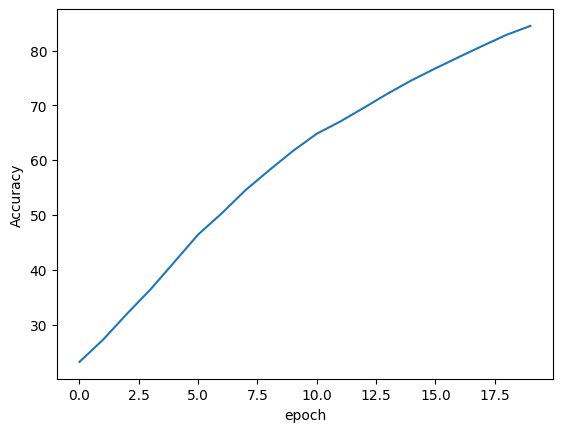

done
[]
60
tensor(0.5574)
tensor([0.7377, 0.0000, 0.0000, 0.0000, 2.0492])


In [52]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


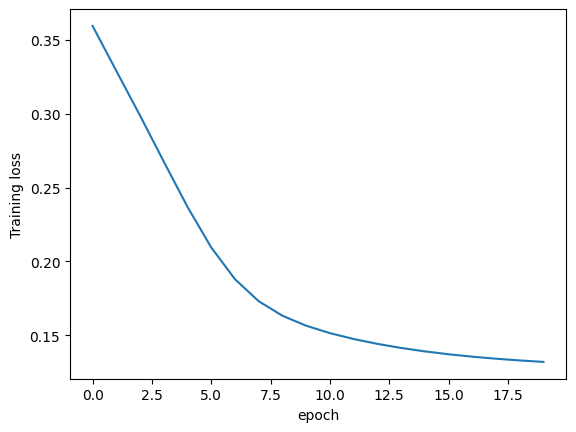

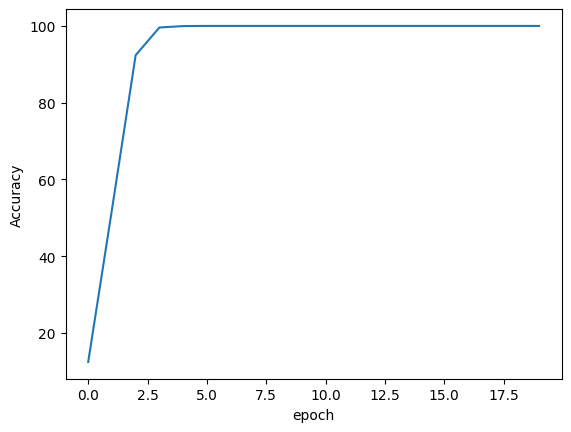

done
[]
60
20
4881


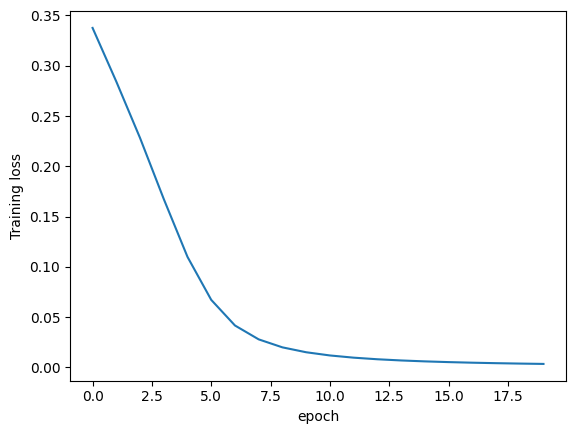

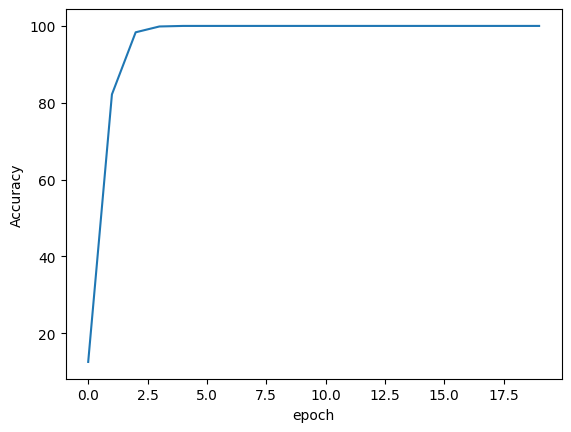

done
[]
60
20
4881


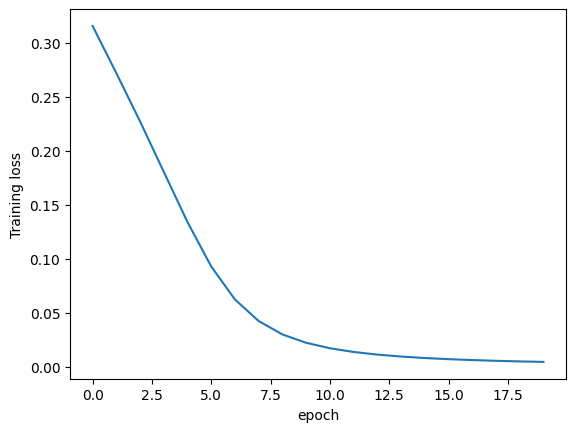

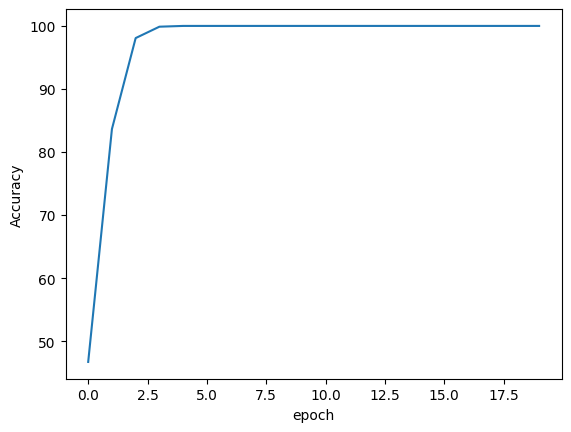

done
[]
60
20
4881


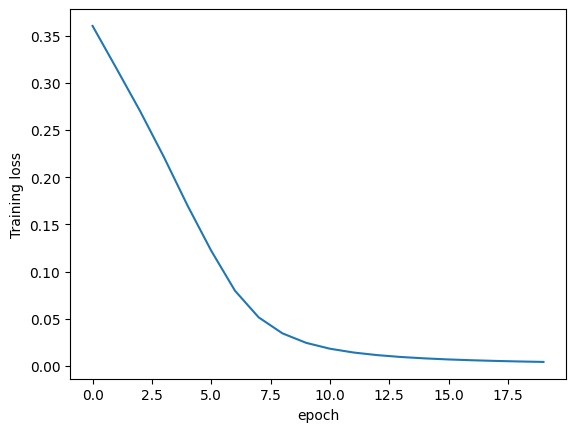

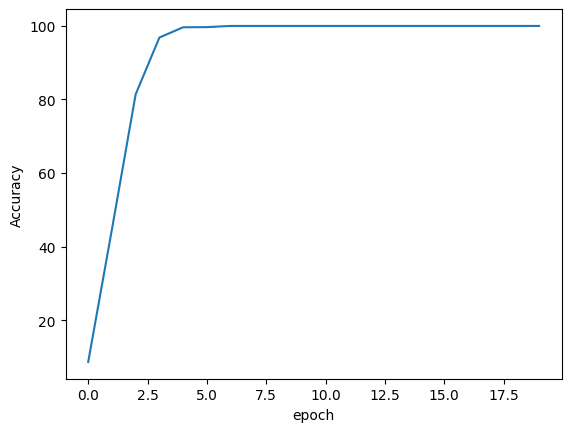

done
[]
60
20
4881


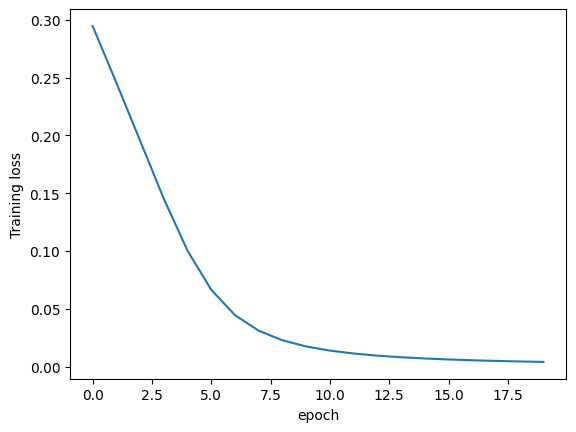

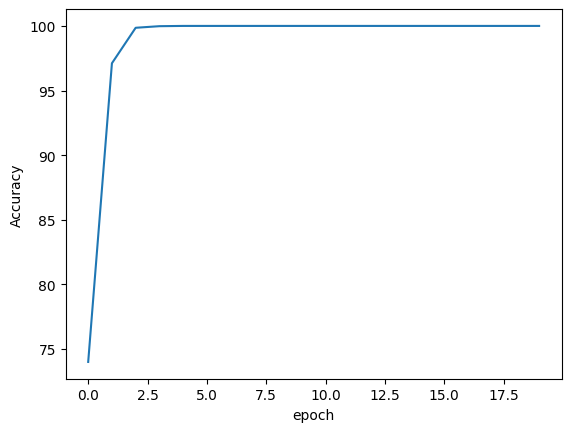

done
[]
60
tensor(0.)
tensor([0., 0., 0., 0., 0.])


In [53]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=20,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(244))
        average_accuracy=(train_acc/(244))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


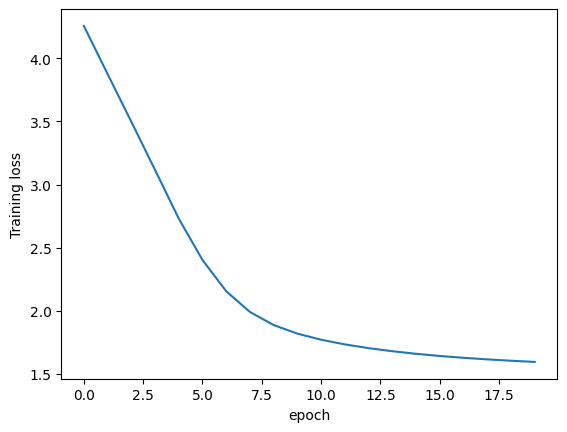

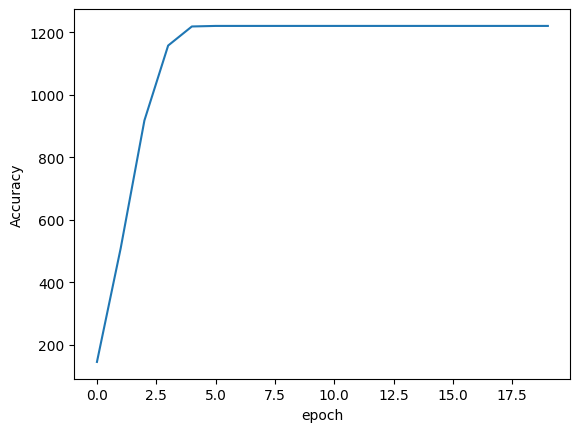

done
[]
4
20
4881


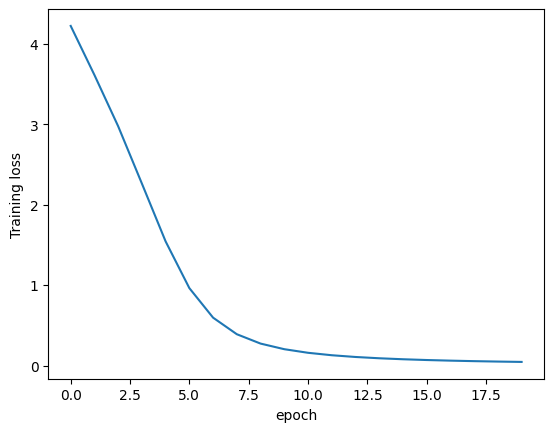

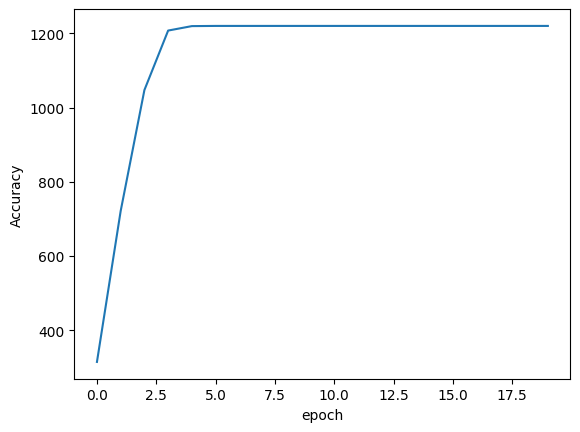

done
[]
4
20
4881


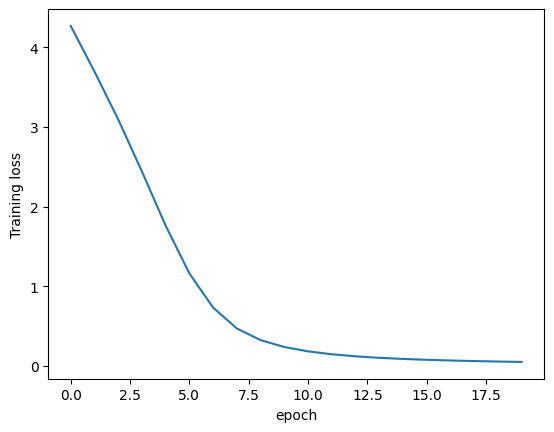

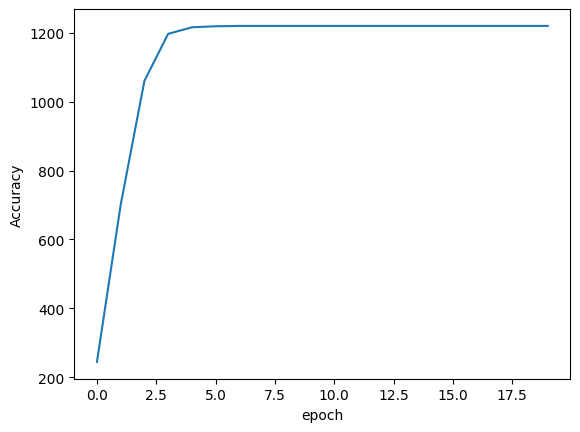

done
[]
4
20
4881


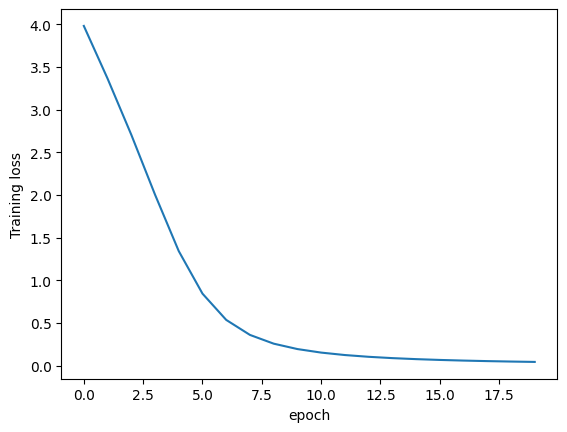

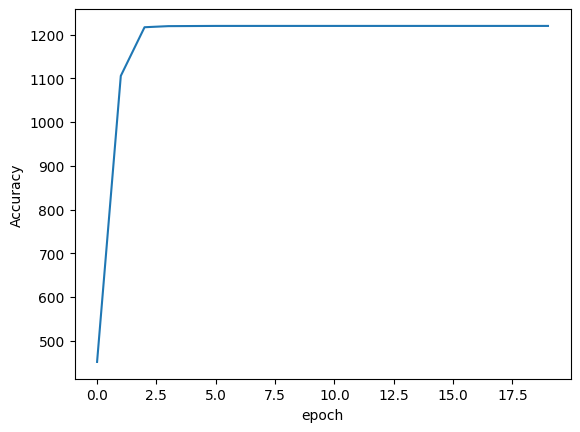

done
[]
4
20
4881


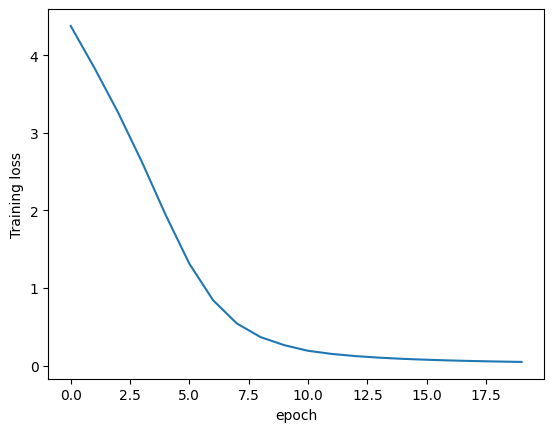

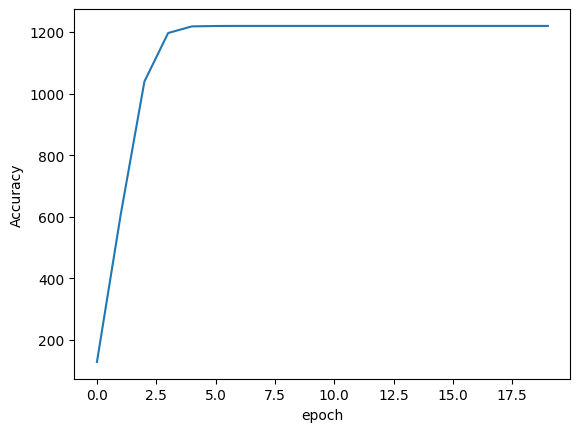

done
[]
4
tensor(0.)
tensor([0., 0., 0., 0., 0.])


In [54]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(20))
        average_accuracy=(train_acc/(20))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


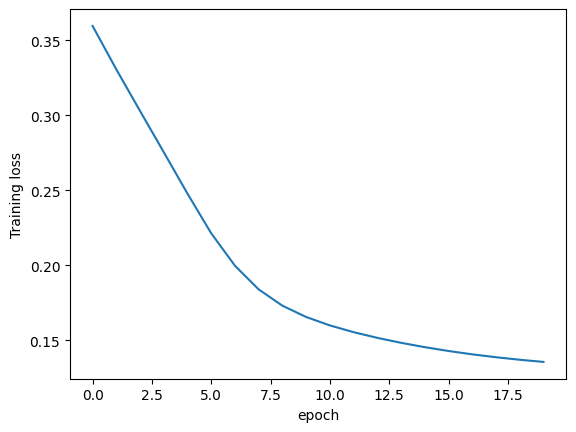

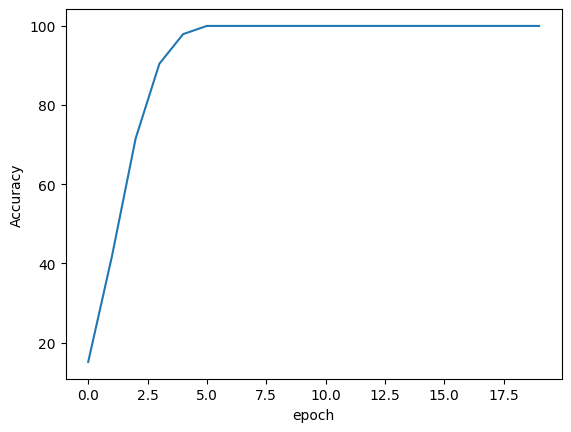

done
[]
4
20
4881


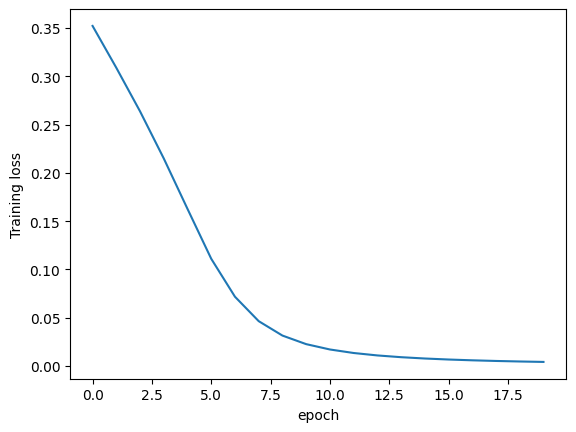

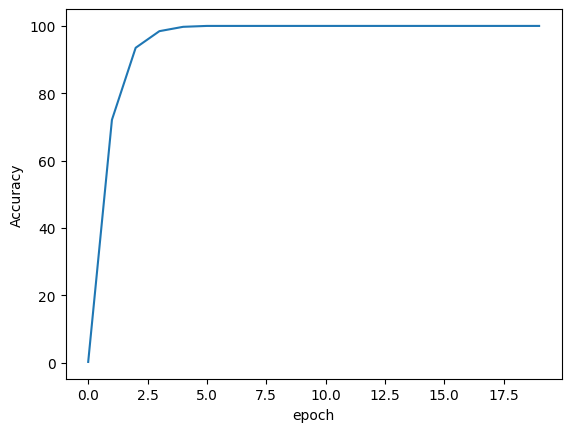

done
[]
4
20
4881


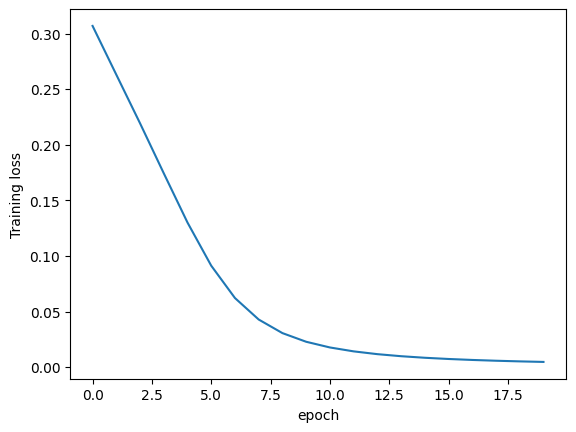

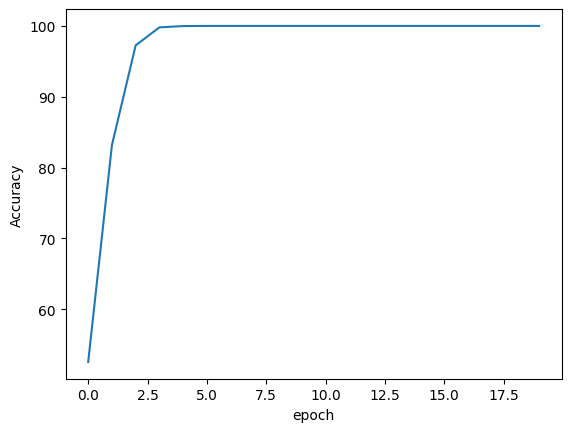

done
[]
4
20
4881


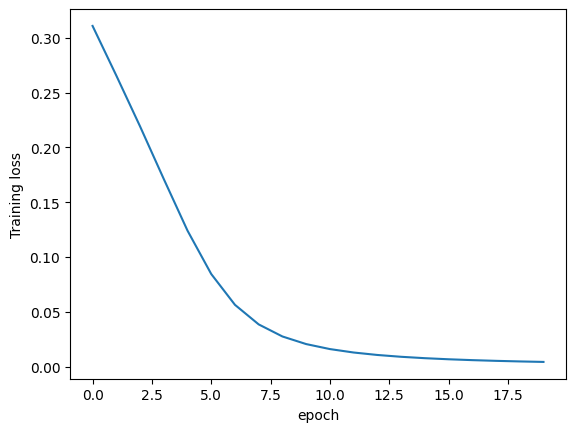

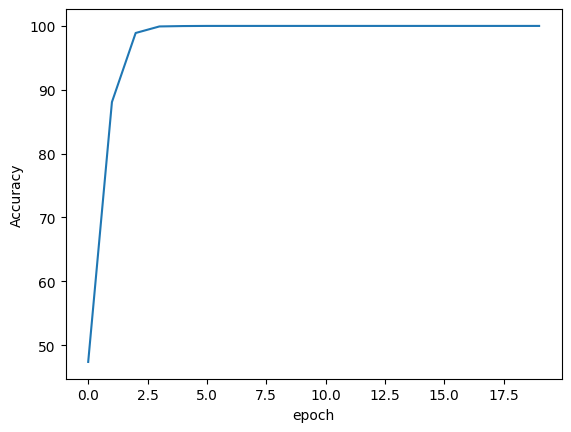

done
[]
4
20
4881


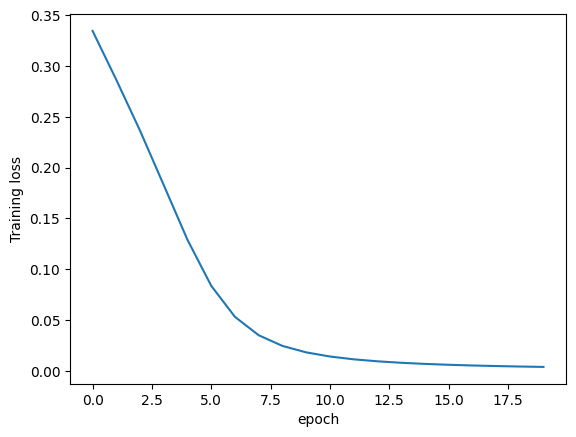

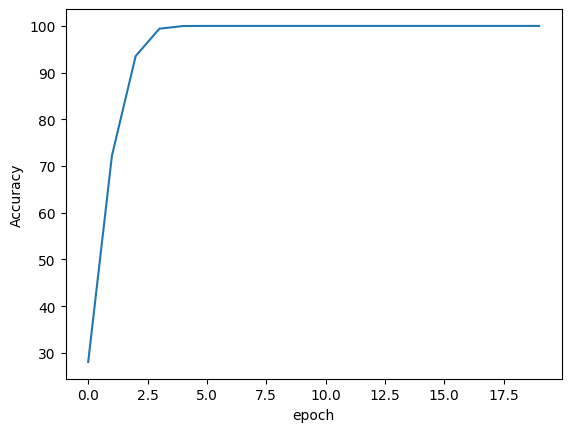

done
[]
4
tensor(0.)
tensor([0., 0., 0., 0., 0.])


In [55]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(61)
        average_loss=test_loss/(61)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


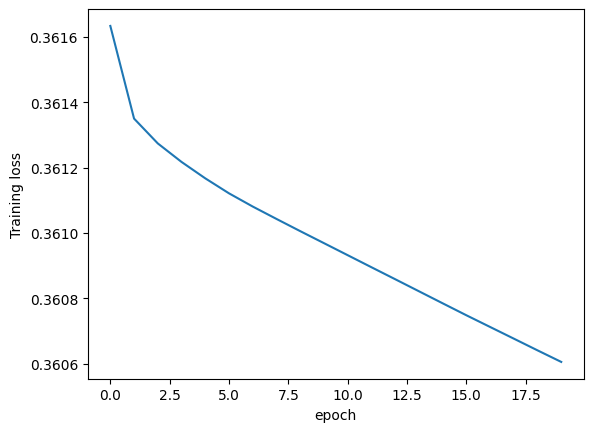

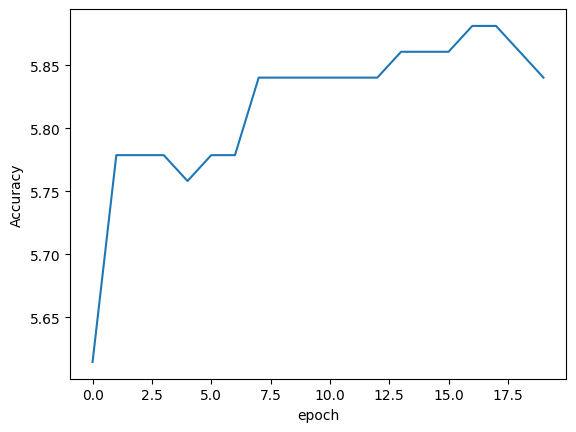

done
[]
4
20
4881


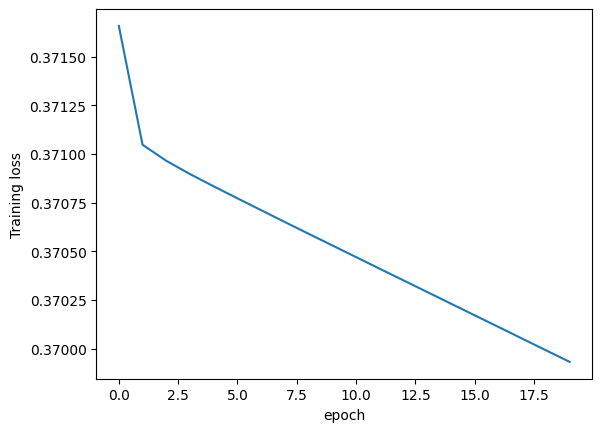

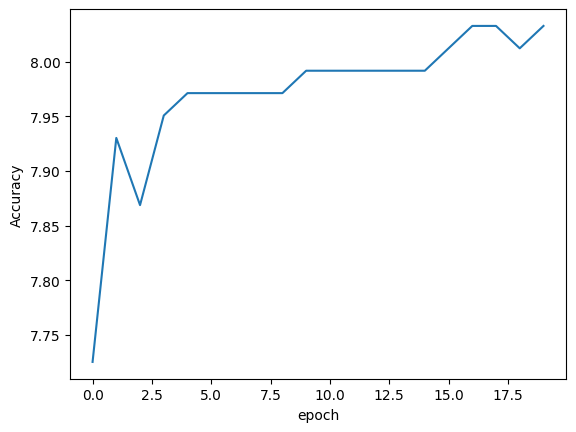

done
[]
4
20
4881


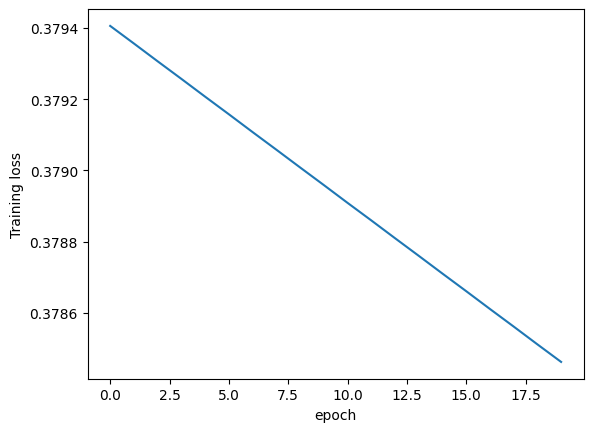

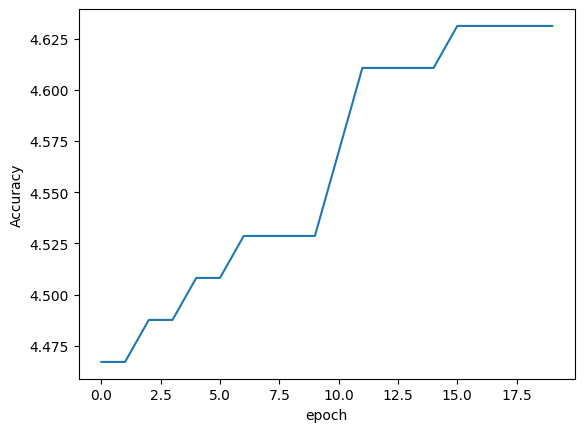

done
[]
4
20
4881


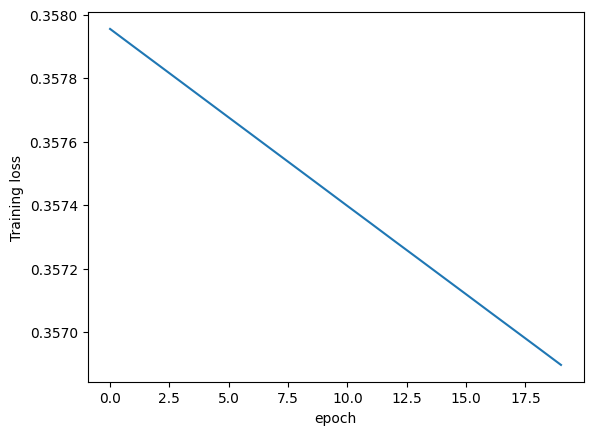

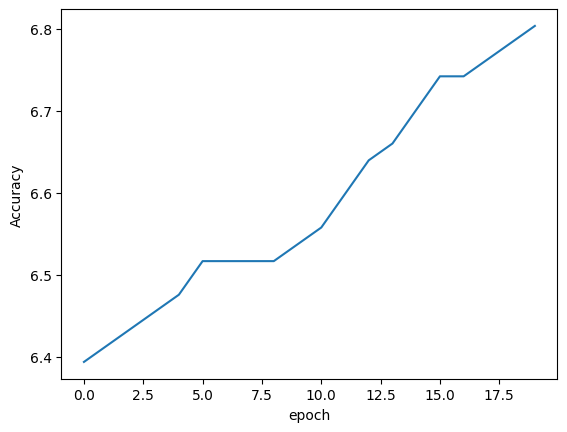

done
[]
4
20
4881


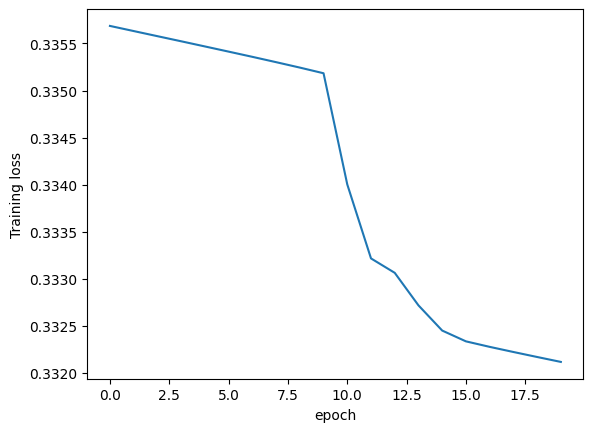

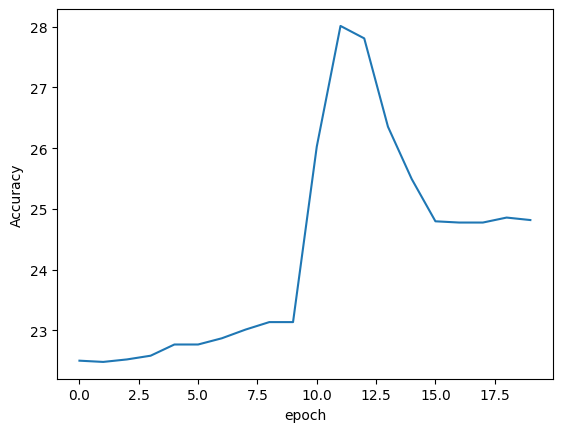

done
[]
4
tensor(1.8000)
tensor([0., 0., 8., 0., 1.])


In [56]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
244
4881


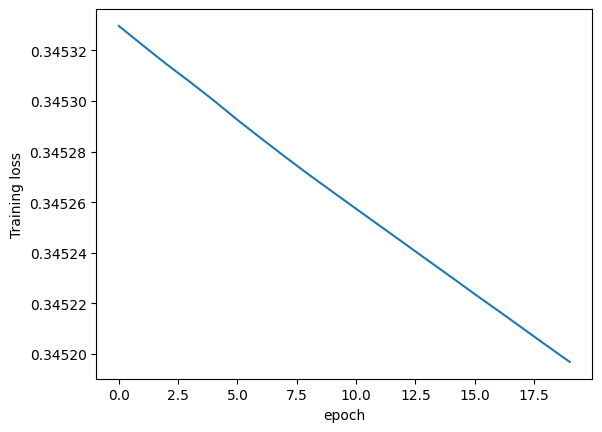

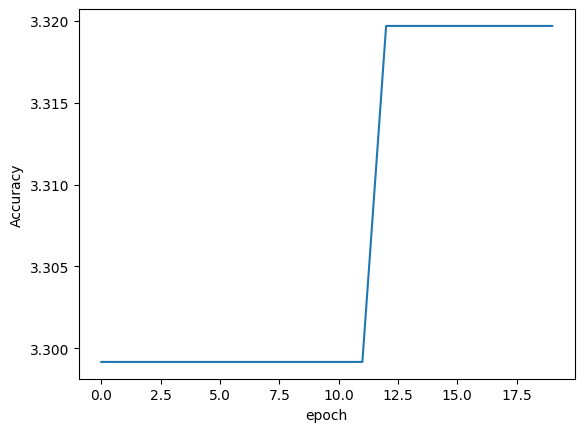

done
[]
4
244
4881


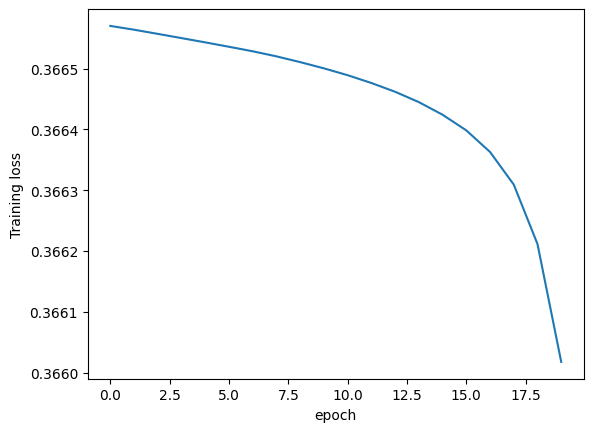

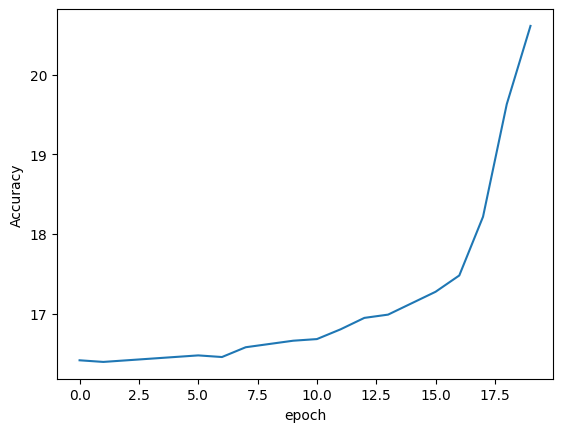

done
[]
4
244
4881


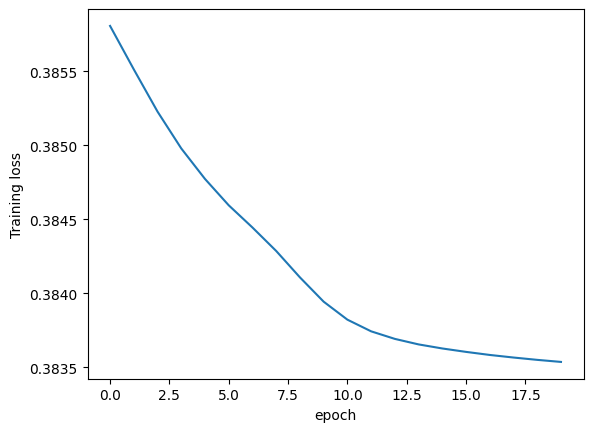

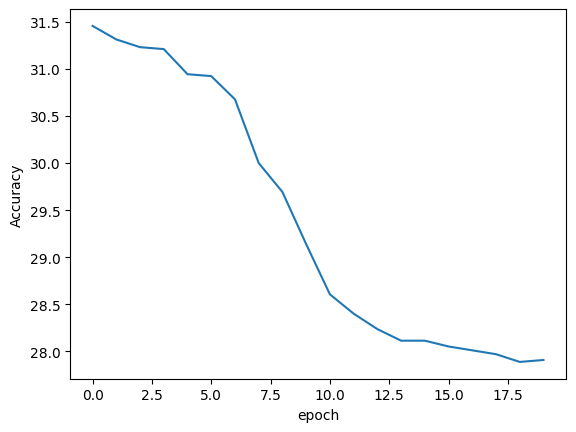

done
[]
4
244
4881


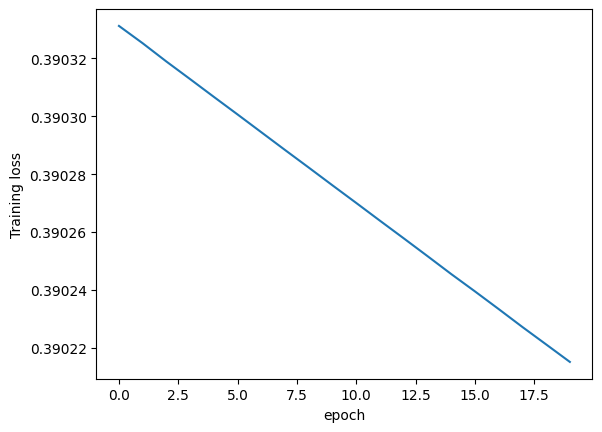

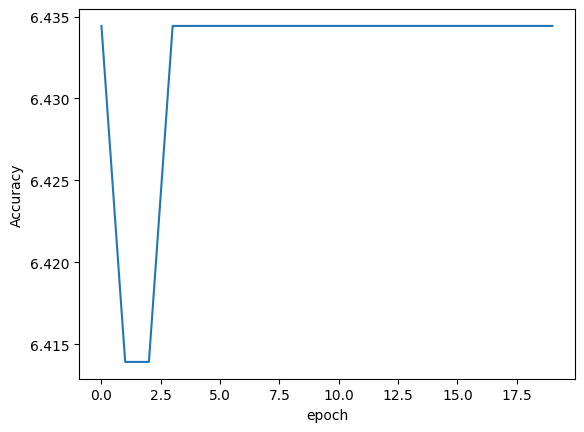

done
[]
4
244
4881


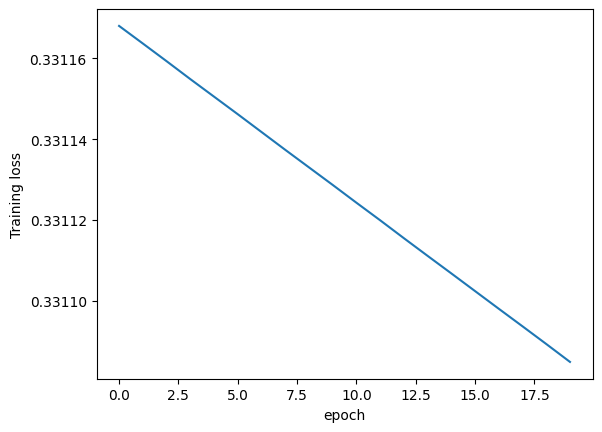

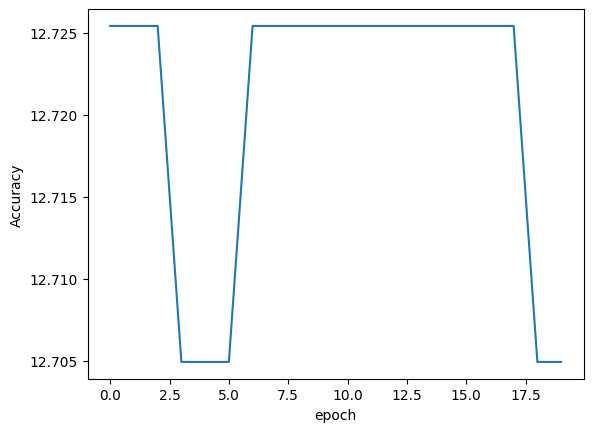

done
[]
4
tensor(18.4098)
tensor([23.2787, 33.1967,  3.4426,  3.1967, 28.9344])


In [57]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=244,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.00001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
244
4881


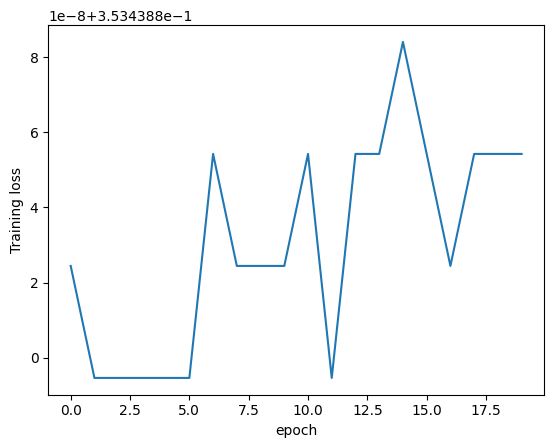

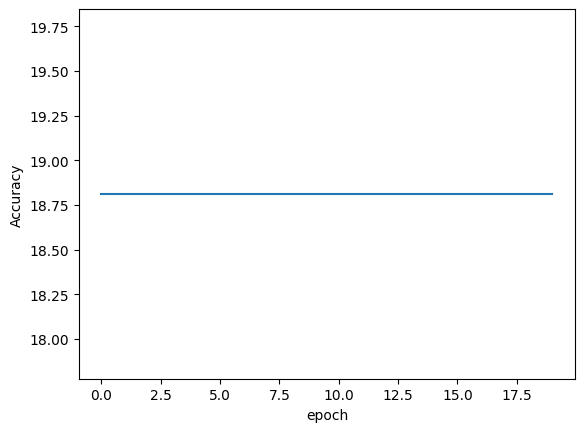

done
[]
4
244
4881


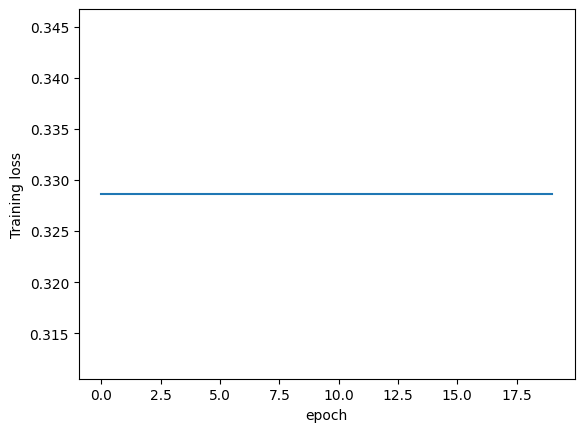

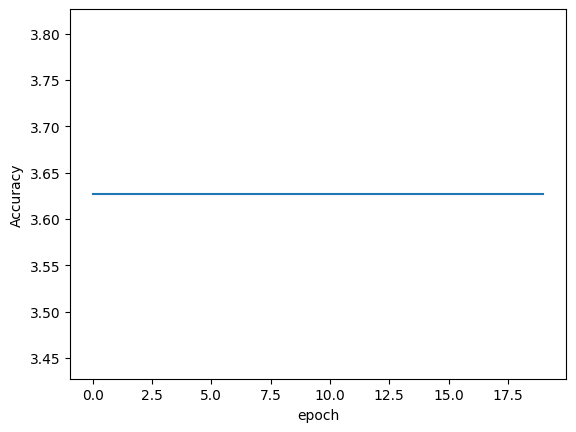

done
[]
4
244
4881


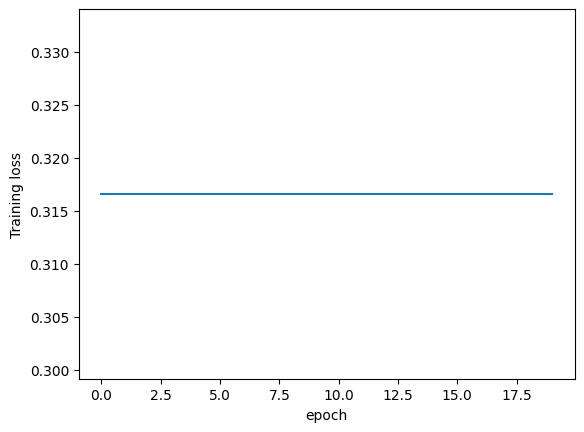

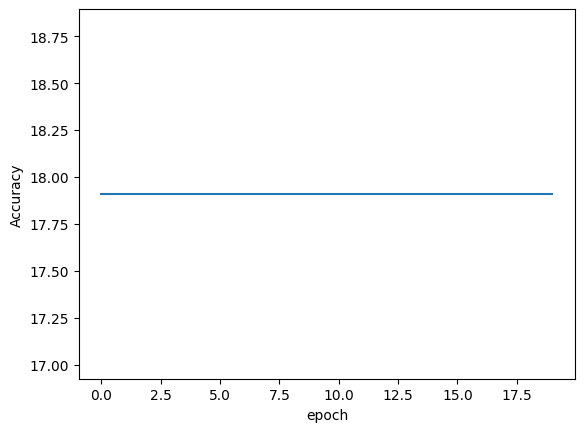

done
[]
4
244
4881


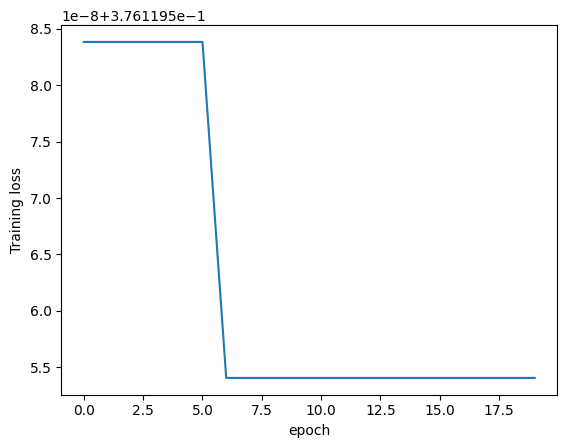

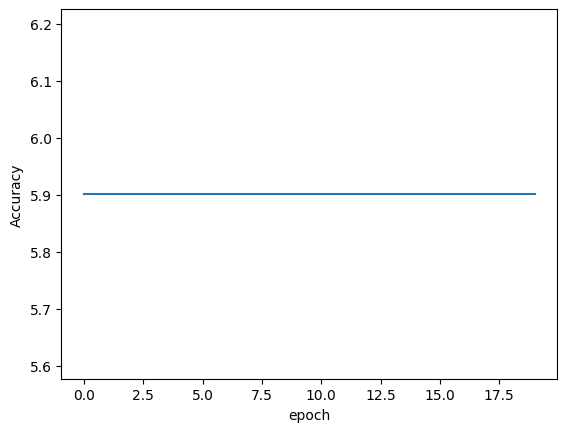

done
[]
4
244
4881


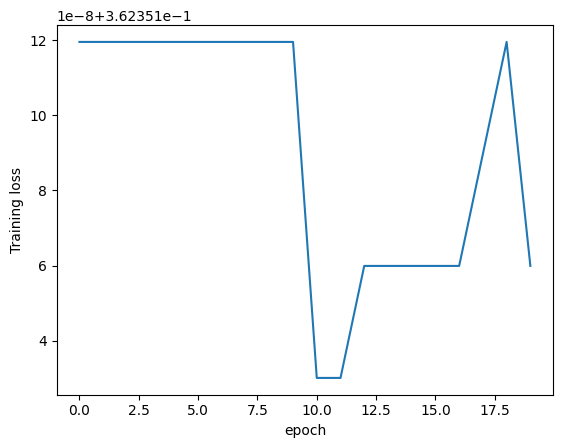

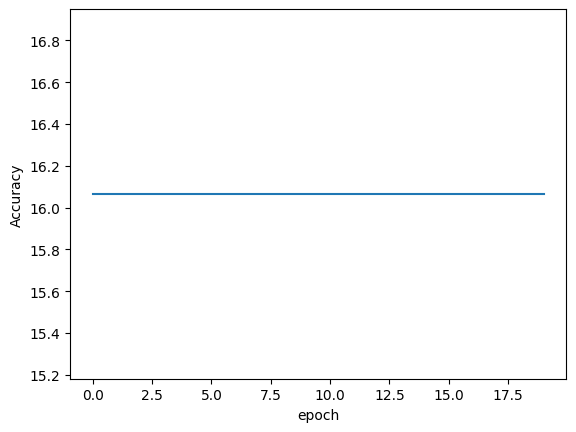

done
[]
4
tensor(18.4754)
tensor([ 8.2787, 51.2295,  1.2295, 24.4262,  7.2131])


In [58]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=244,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.000000001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
244
4881


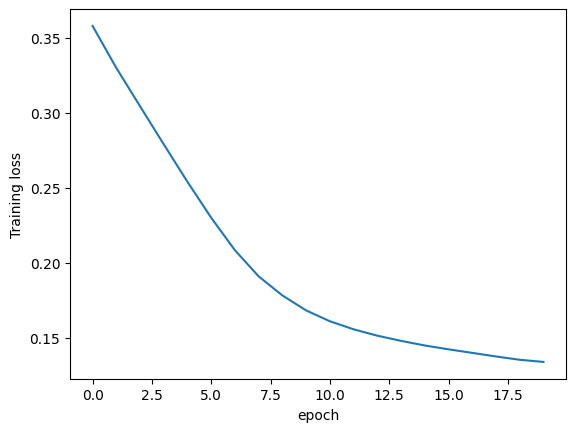

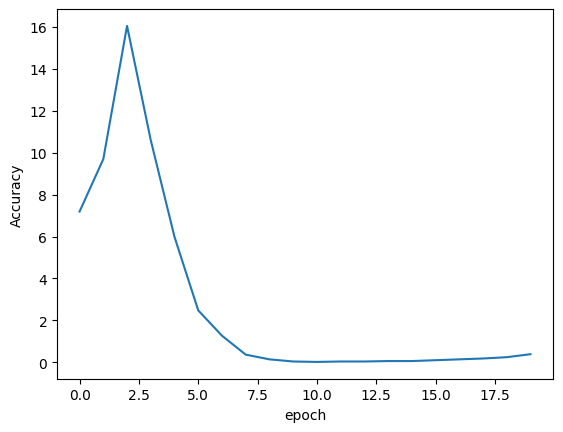

done
[]
4
244
4881


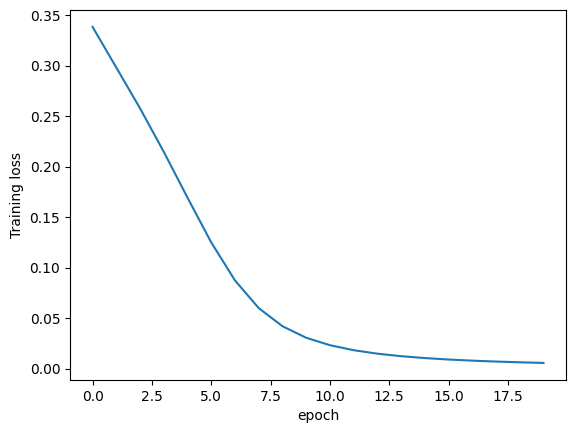

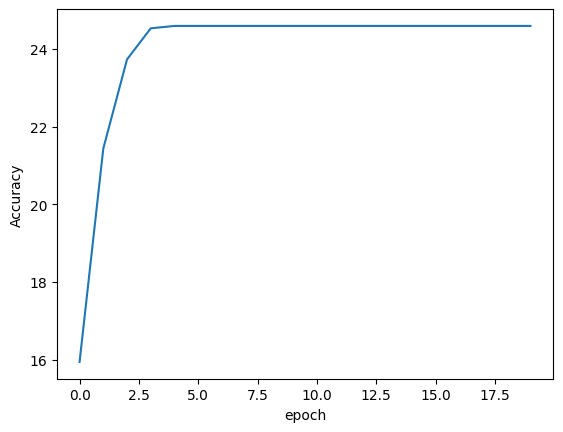

done
[]
4
244
4881


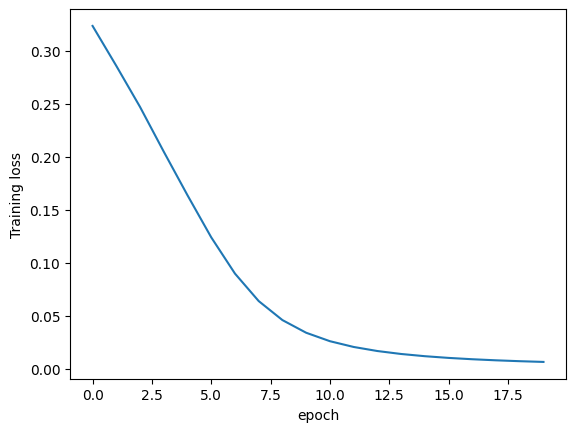

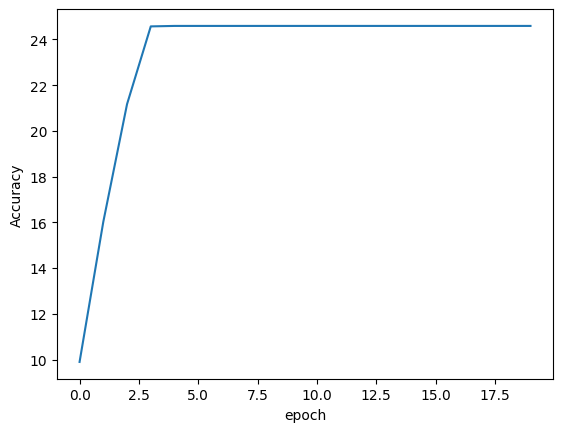

done
[]
4
244
4881


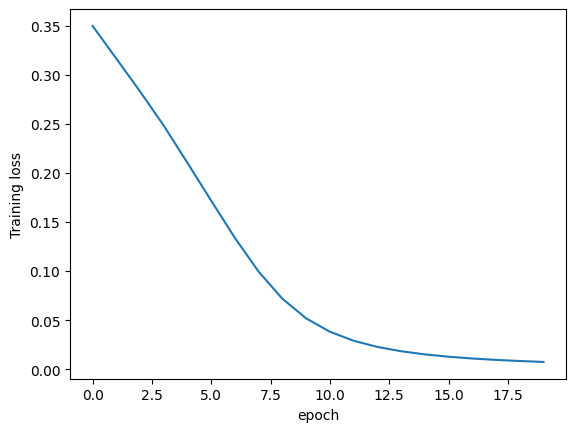

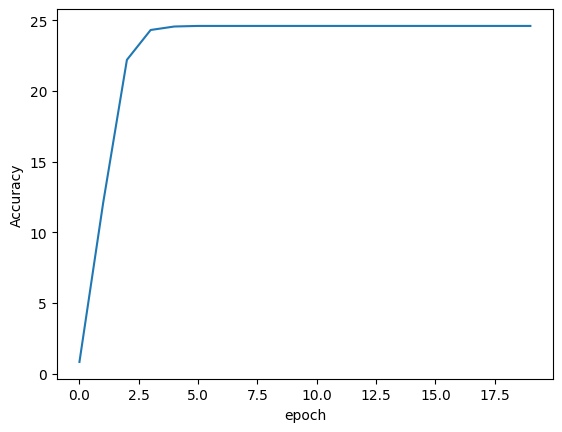

done
[]
4
244
4881


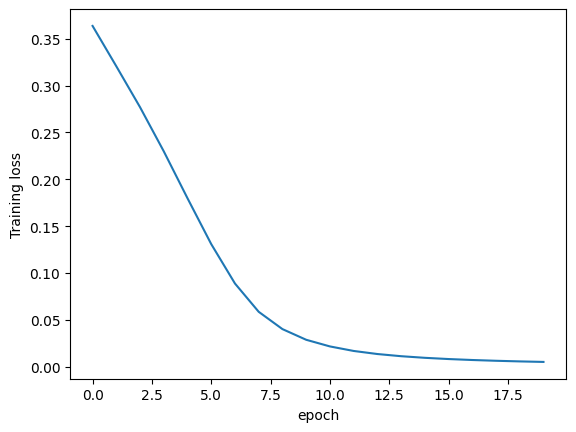

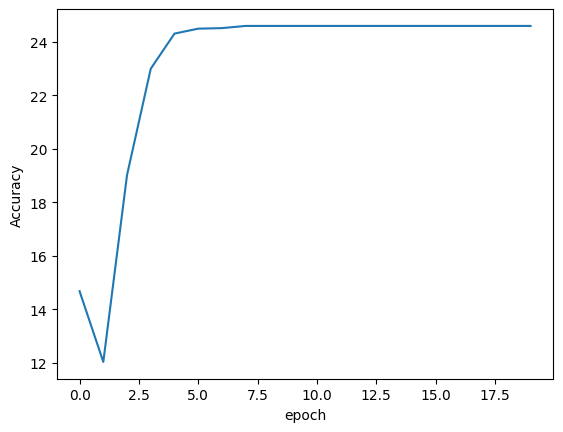

done
[]
4
tensor(0.)
tensor([0., 0., 0., 0., 0.])


In [59]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=244,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
2
4881


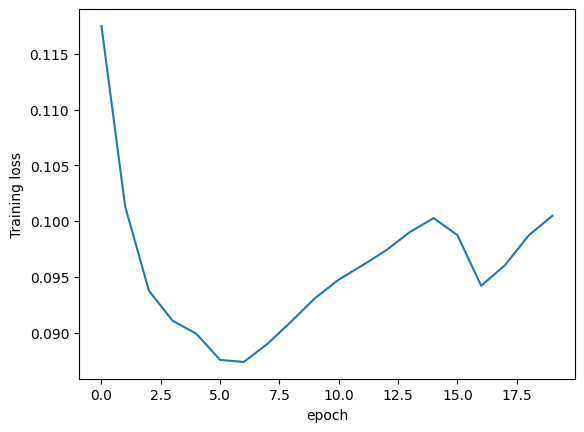

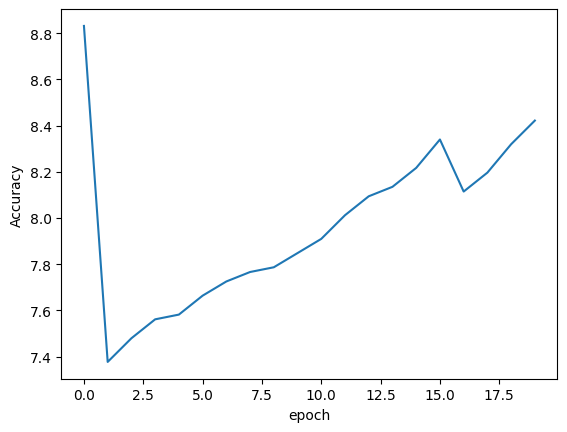

done
[]
4
2
4881


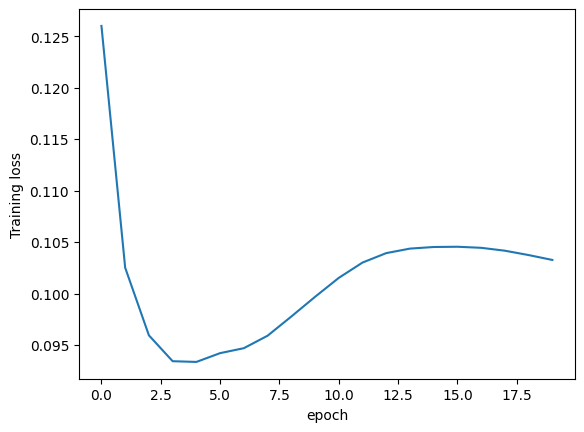

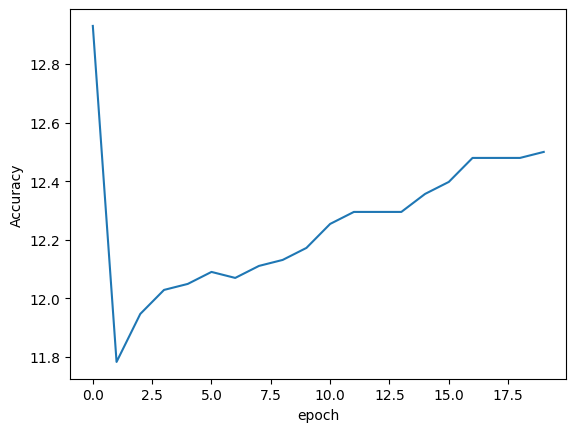

done
[]
4
2
4881


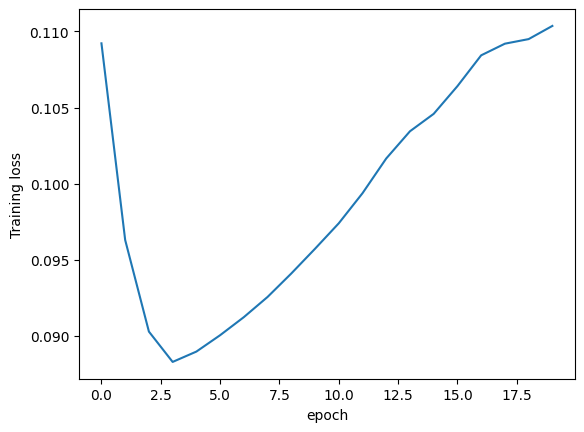

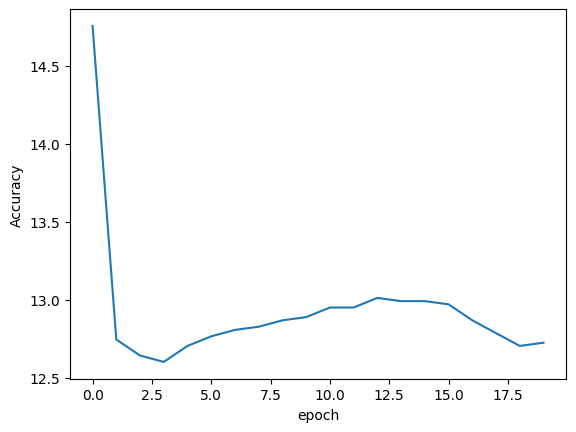

done
[]
4
2
4881


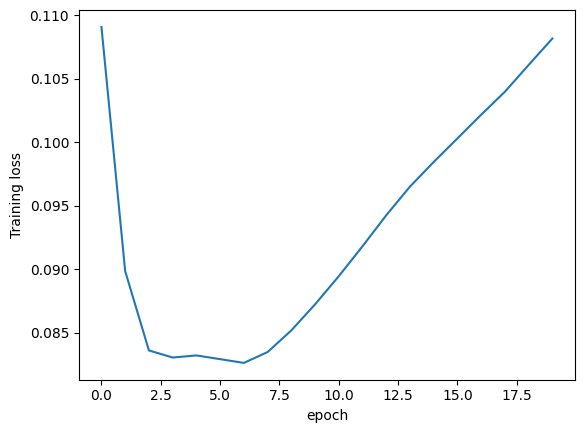

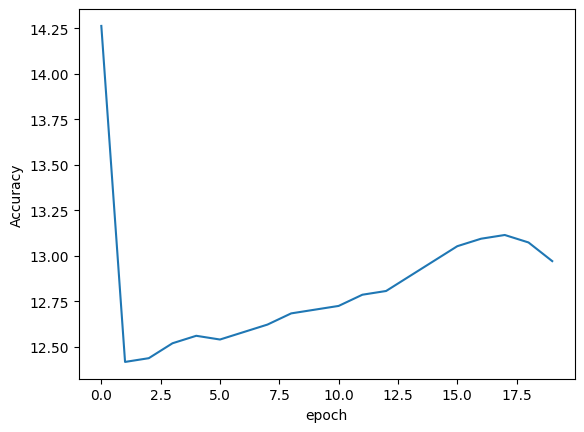

done
[]
4
2
4881


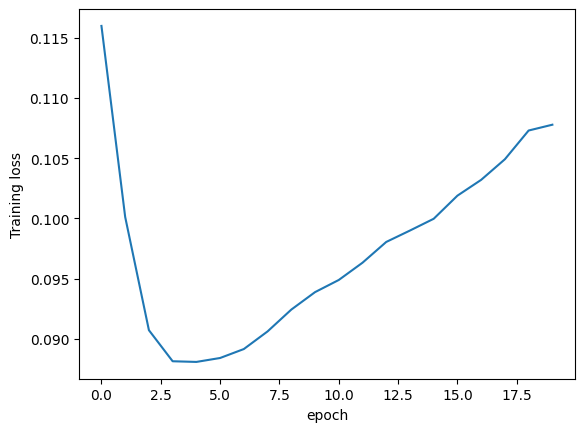

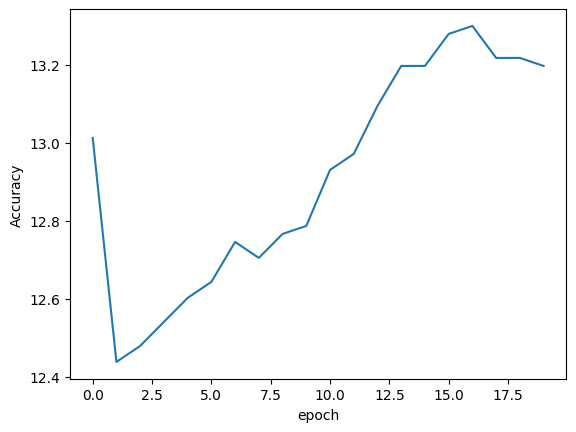

done
[]
4
tensor(776.)
tensor([   0.,    0.,    0.,    0., 3880.])


In [60]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_train.batch_size) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

In [63]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach().numpy(classes),torch.detach().numpy(y_t)) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
2
4881


TypeError: detach() missing 1 required positional arguments: "input"

In [64]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach.numpy(classes),torch.detach.numpy(y_t)) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
2
4881


AttributeError: 'builtin_function_or_method' object has no attribute 'numpy'

7626
Data loaded
2
4881


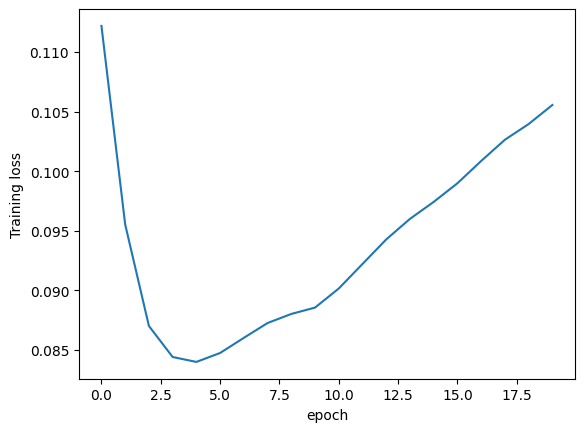

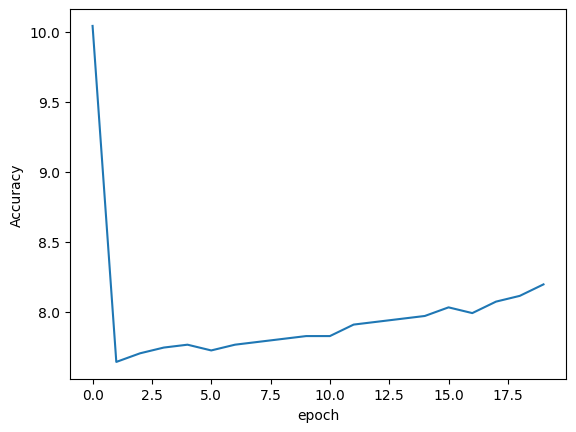

done
[]
4
2
4881


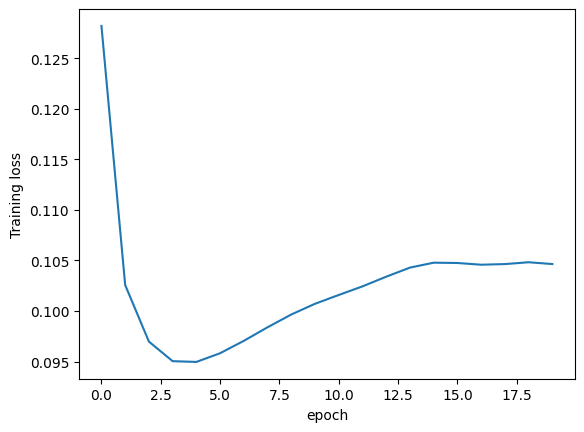

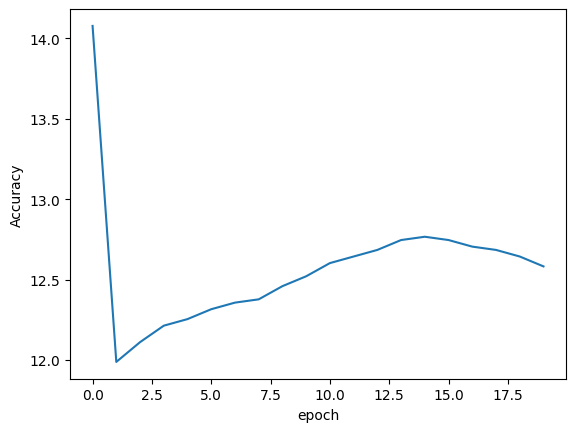

done
[]
4
2
4881


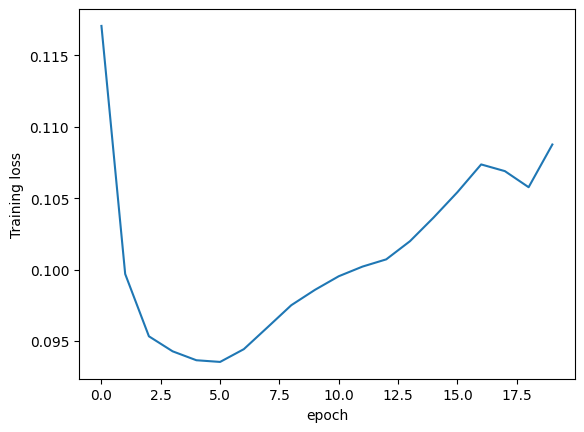

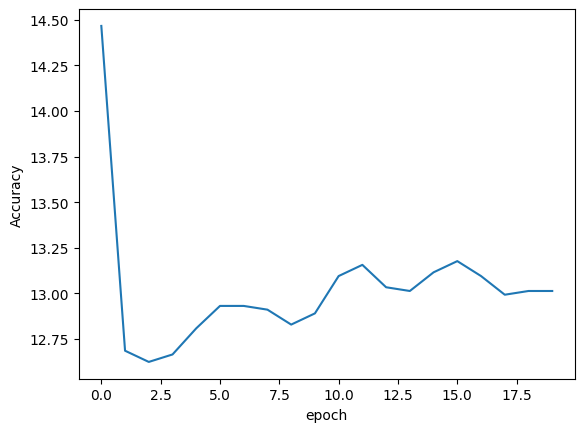

done
[]
4
2
4881


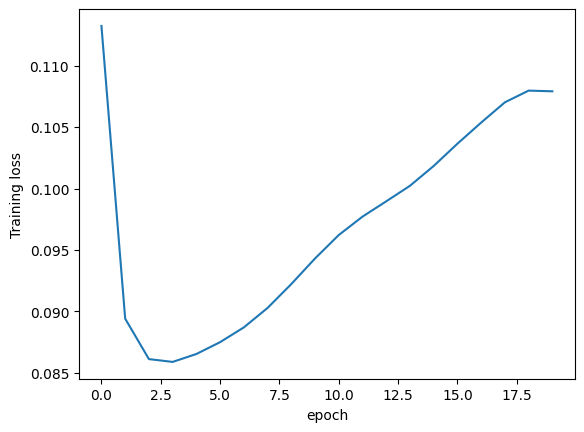

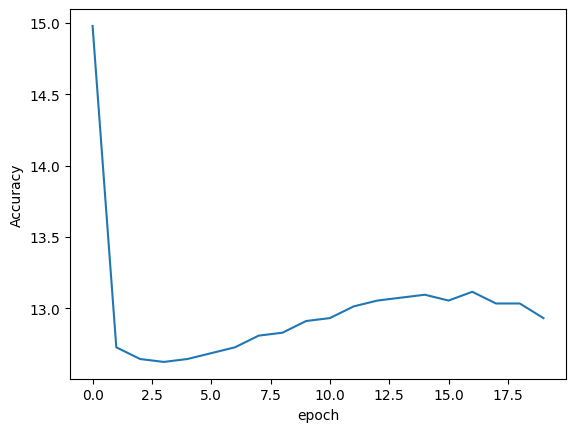

done
[]
4
2
4881


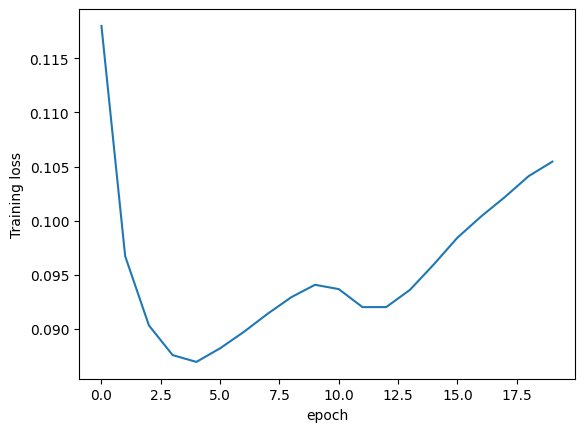

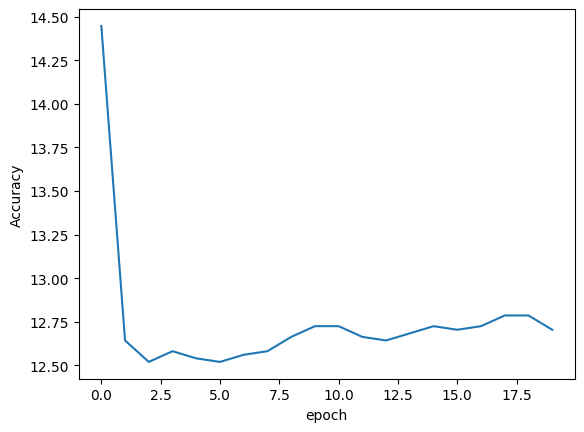

done
[]
4
tensor(17.8852, dtype=torch.float64)
tensor([ 0.0000,  0.0000, 50.8197,  0.0000, 38.6066], dtype=torch.float64)


In [65]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
2
4881


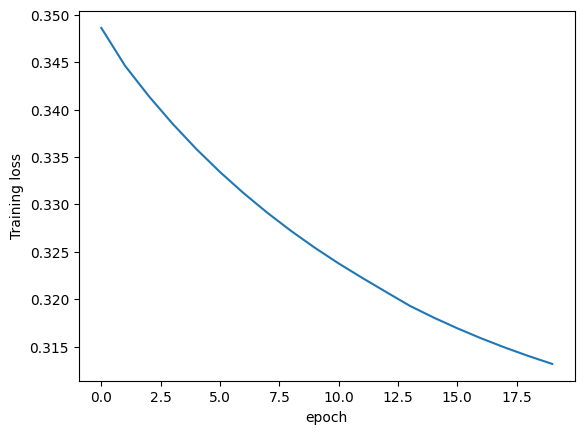

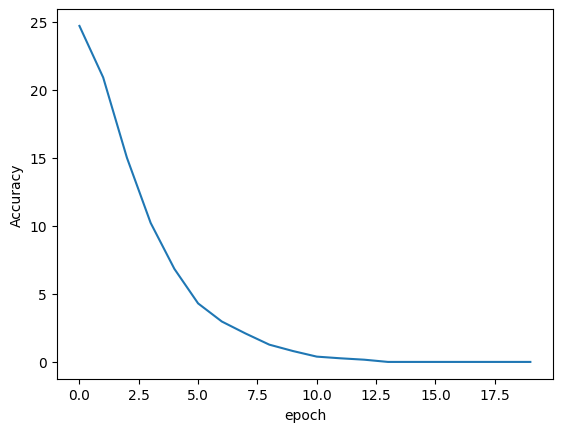

done
[]
4
2
4881


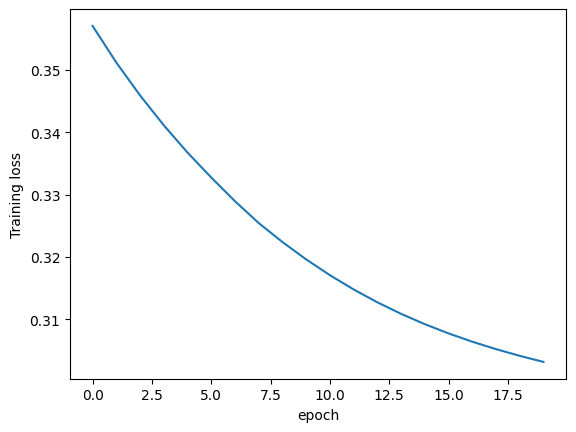

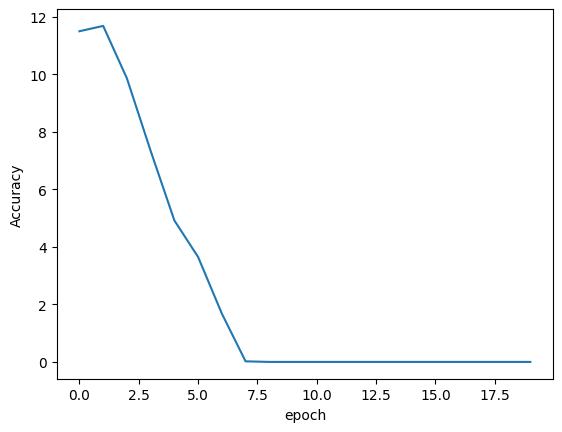

done
[]
4
2
4881


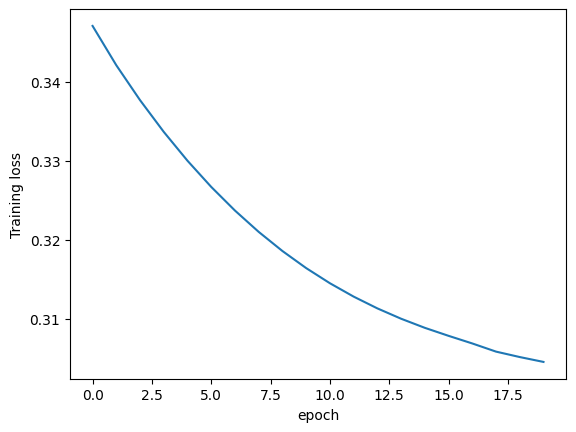

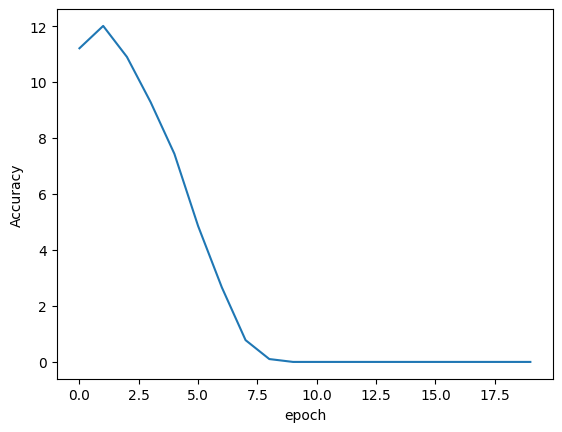

done
[]
4
2
4881


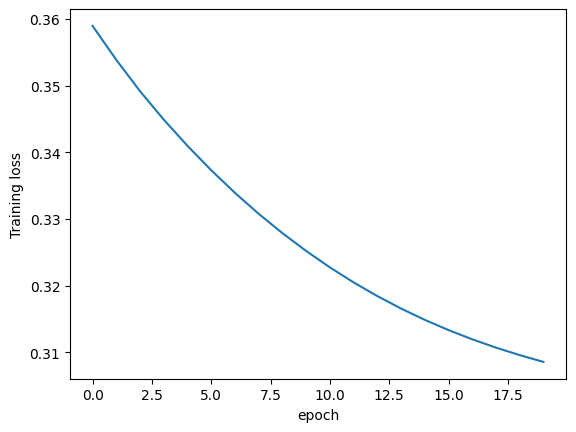

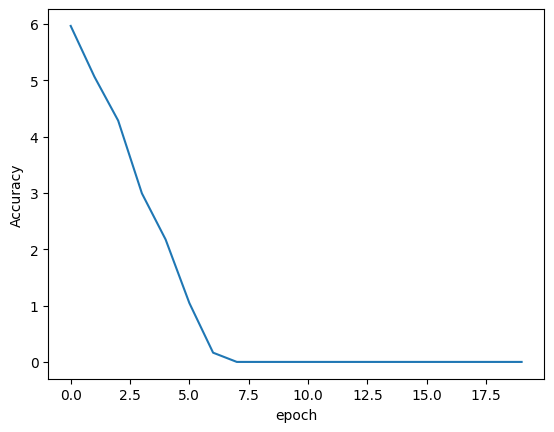

done
[]
4
2
4881


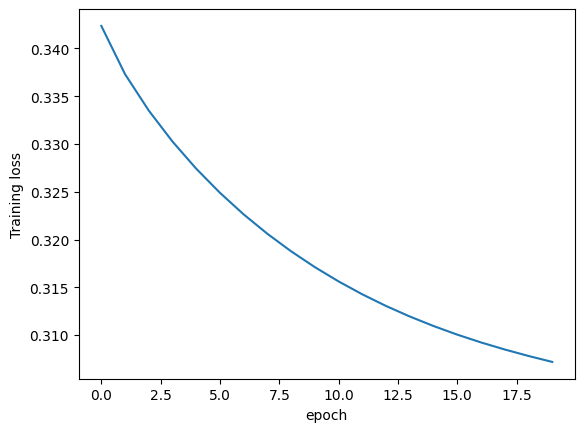

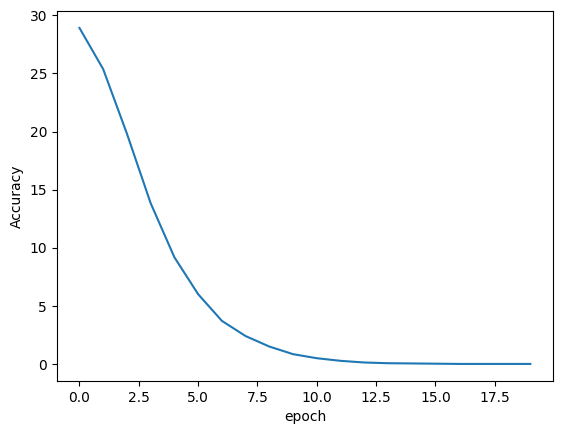

done
[]
4
tensor(25.0984, dtype=torch.float64)
tensor([97.9508, 21.3115,  0.0000,  1.2295,  5.0000], dtype=torch.float64)


In [66]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Softmax(dim=1)
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
2
4881


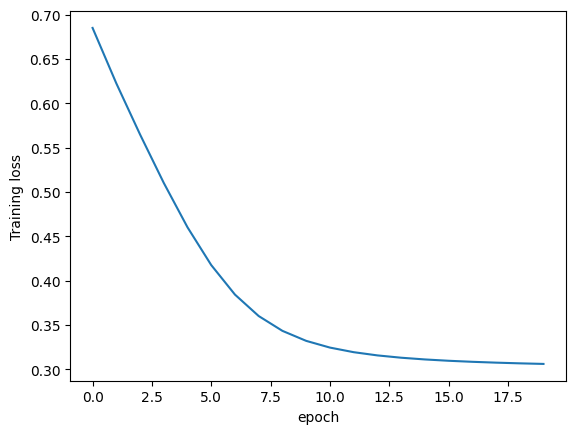

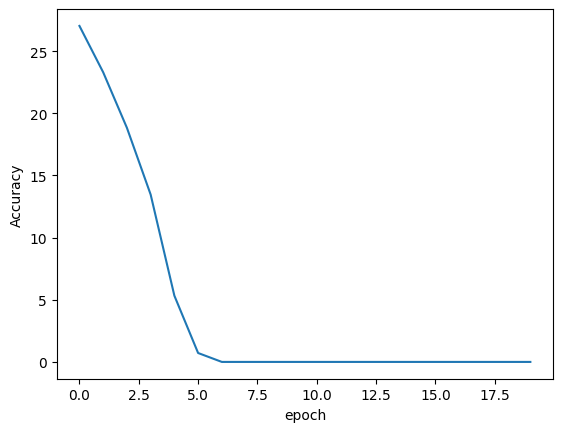

done
[]
4
2
4881


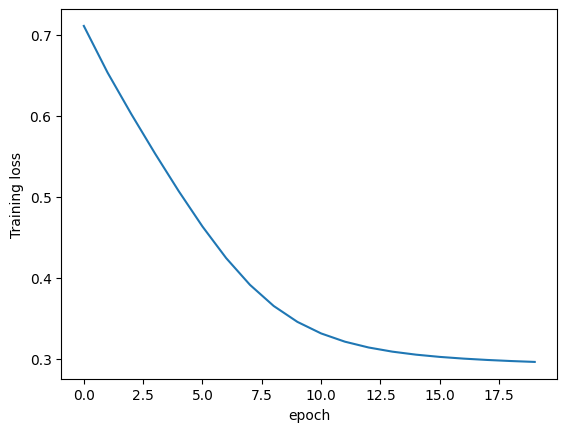

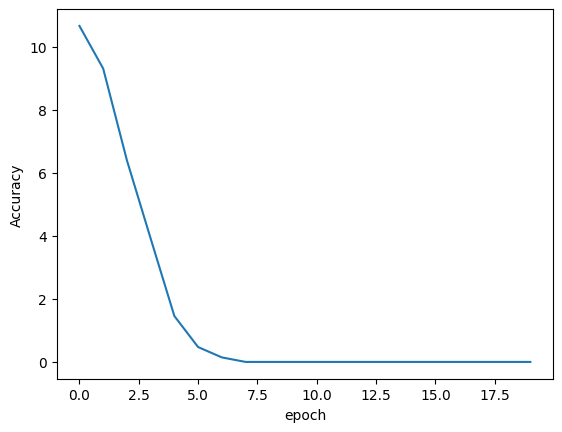

done
[]
4
2
4881


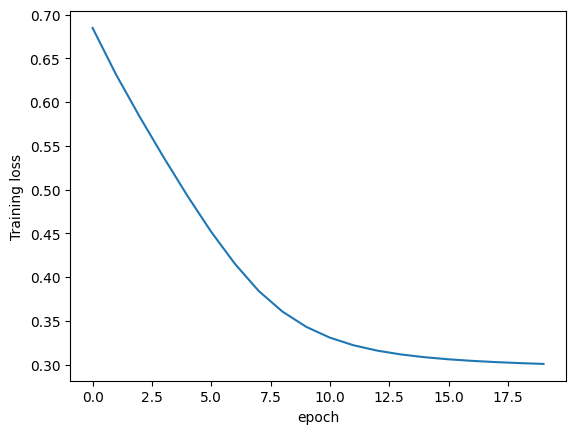

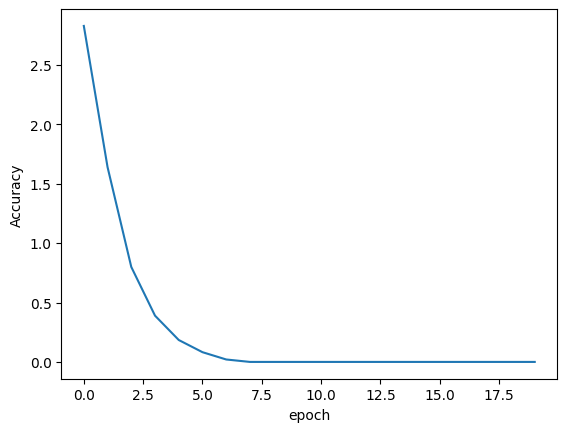

done
[]
4
2
4881


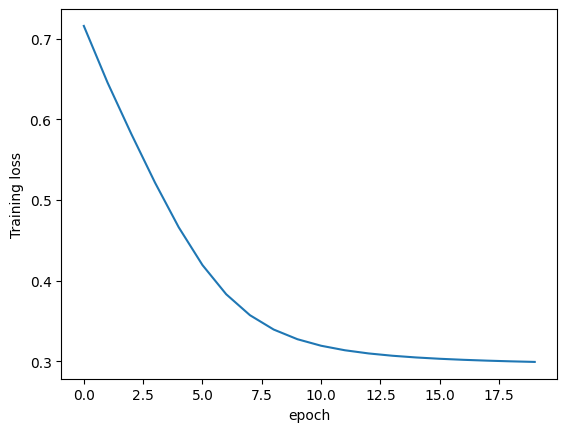

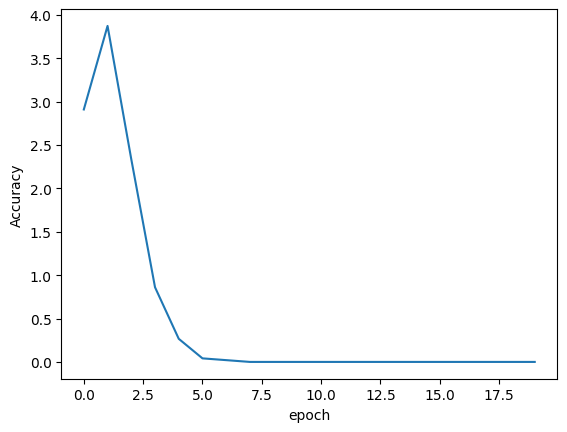

done
[]
4
2
4881


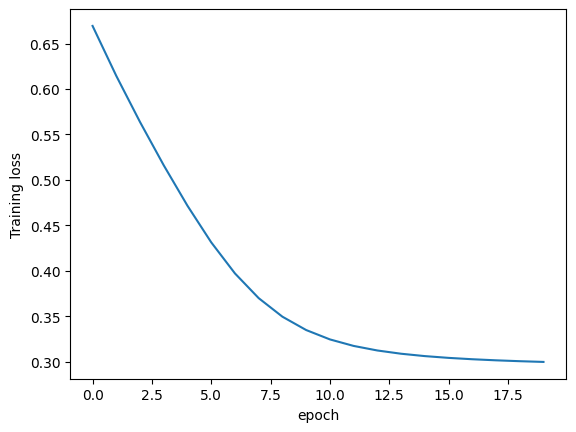

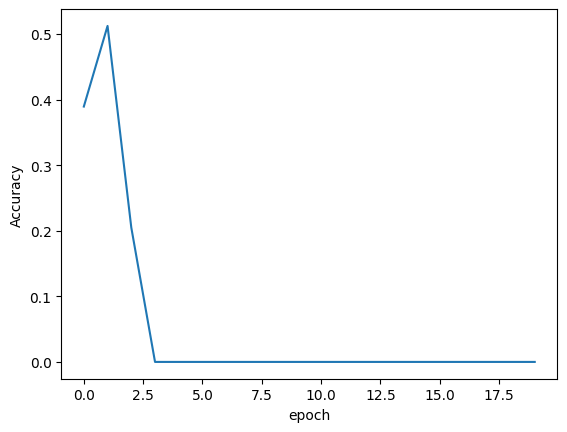

done
[]
4
tensor(8.2131, dtype=torch.float64)
tensor([ 0.0000,  0.7377,  0.0000, 40.3279,  0.0000], dtype=torch.float64)


In [67]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=2,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


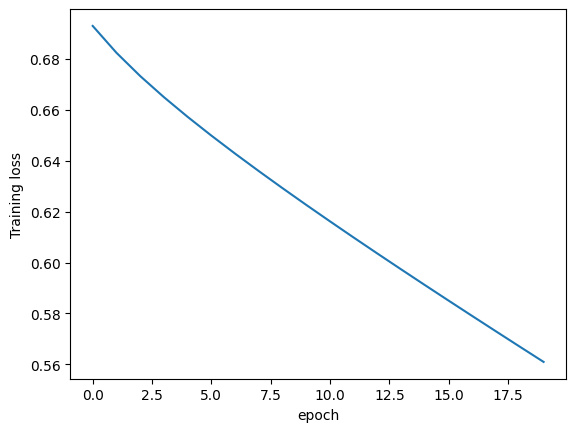

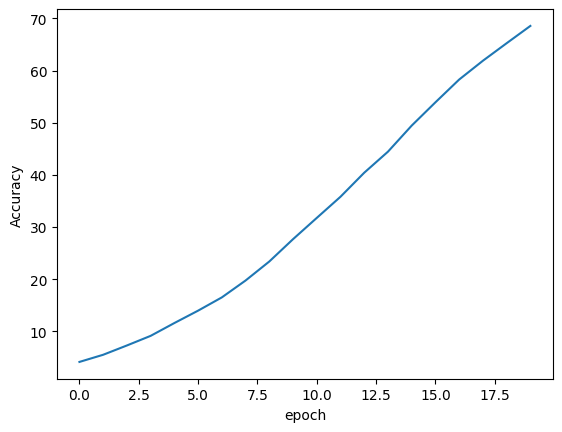

done
[]
4
20
4881


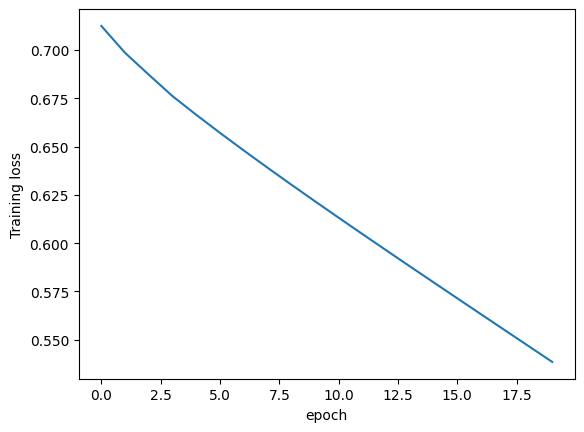

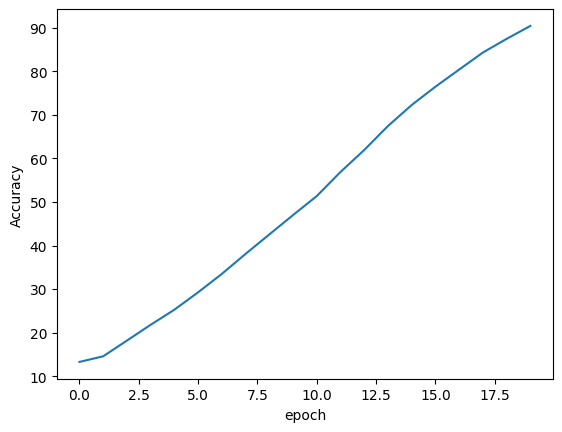

done
[]
4
20
4881


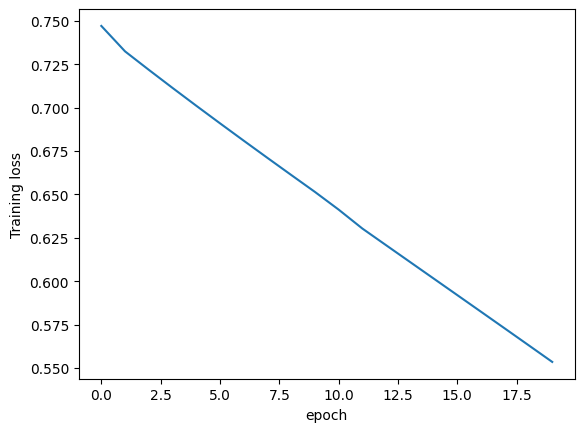

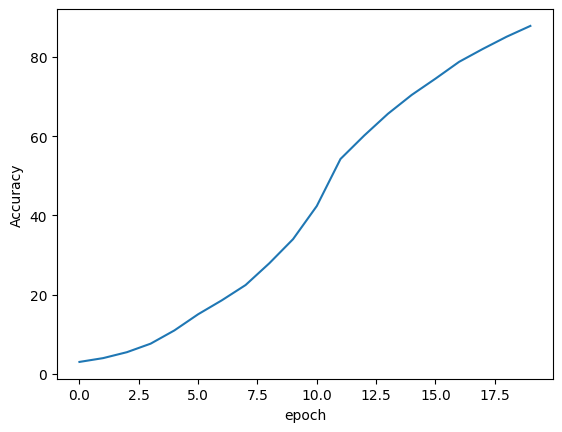

done
[]
4
20
4881


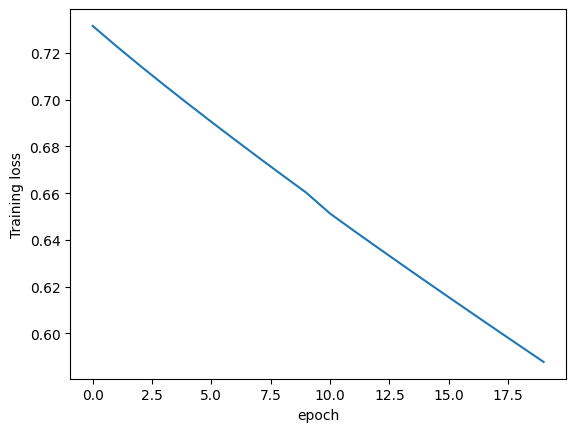

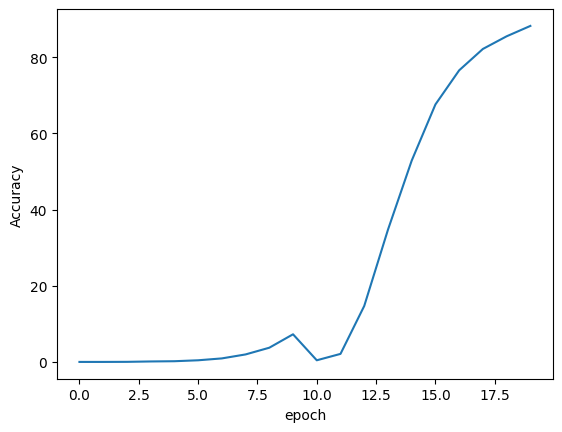

done
[]
4
20
4881


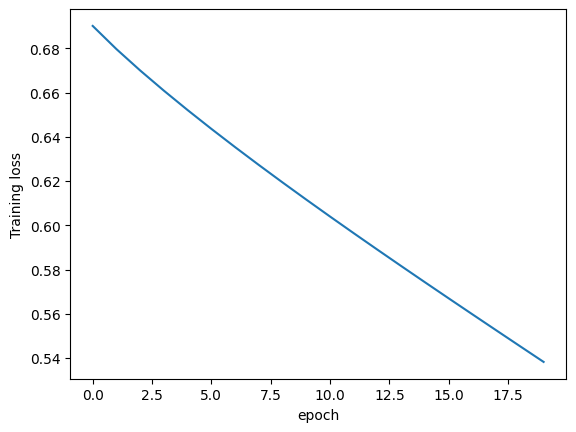

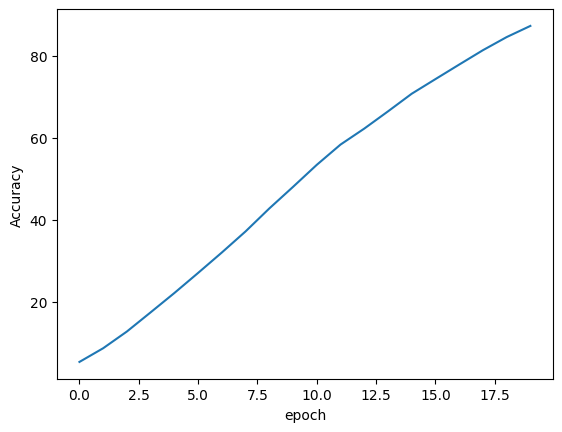

done
[]
4
tensor(2.5246, dtype=torch.float64)
tensor([ 0.0000,  0.0000,  0.0000,  0.0000, 12.6230], dtype=torch.float64)


In [68]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
10
4881


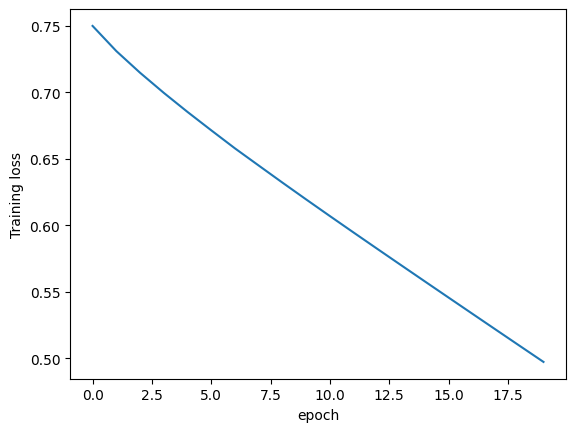

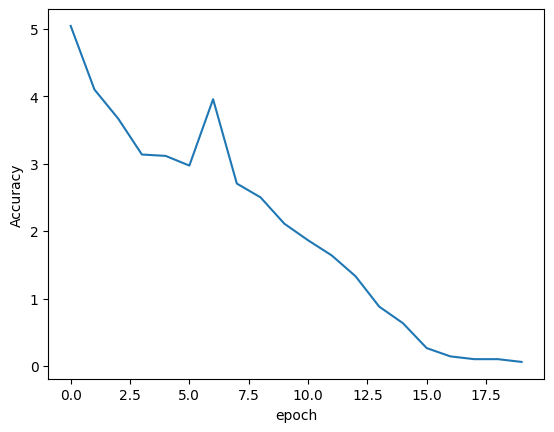

done
[]
4
10
4881


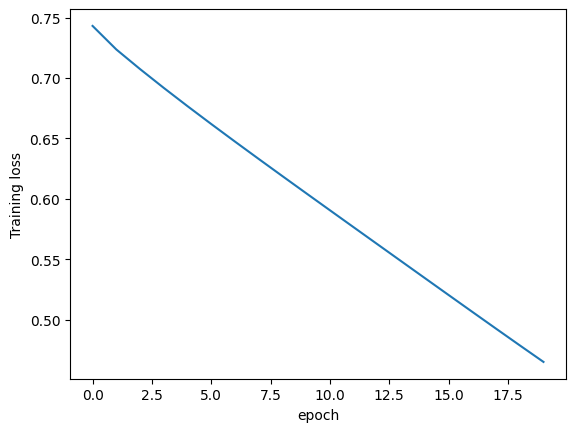

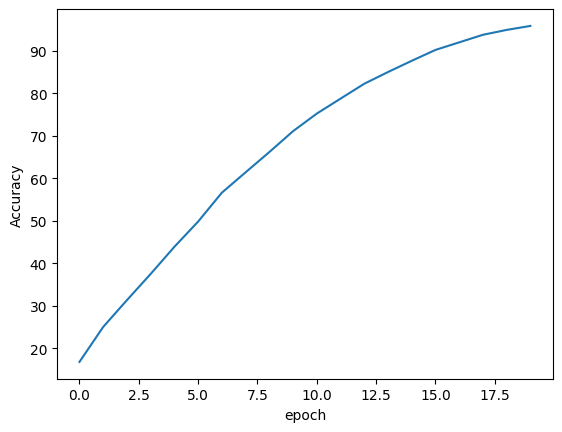

done
[]
4
10
4881


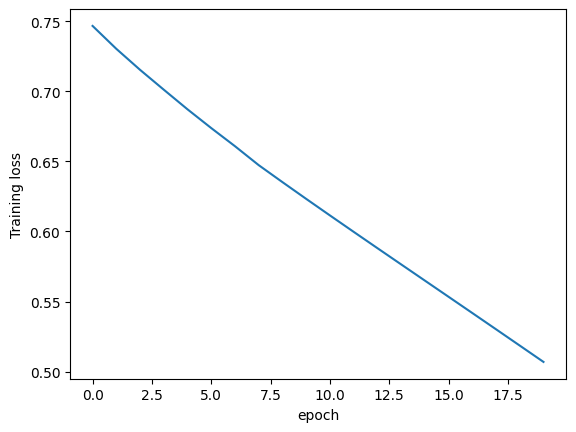

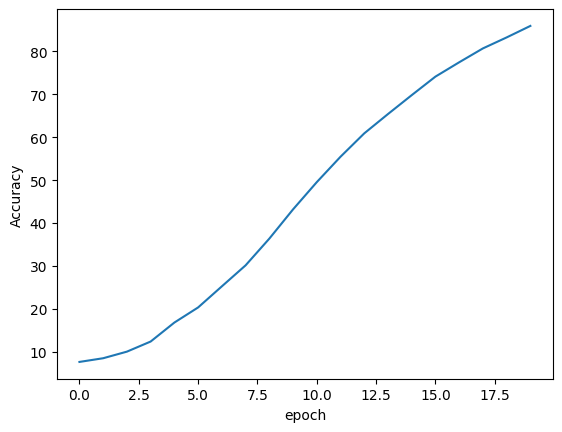

done
[]
4
10
4881


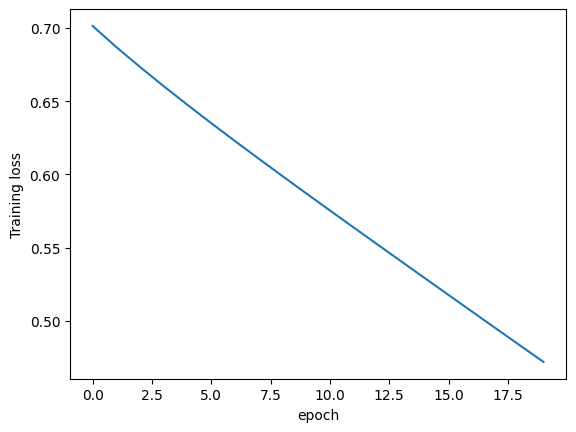

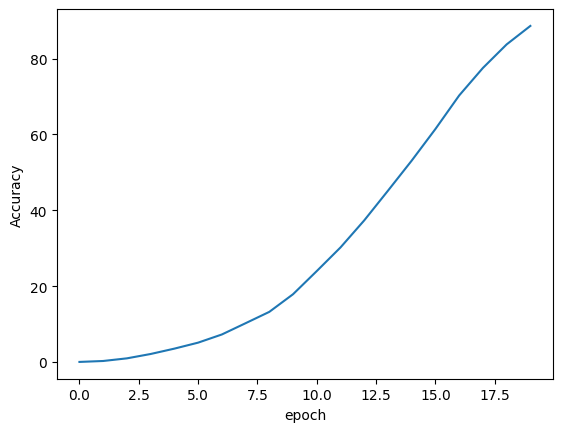

done
[]
4
10
4881


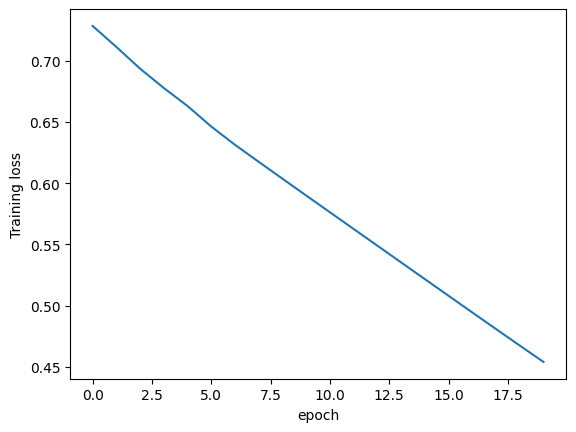

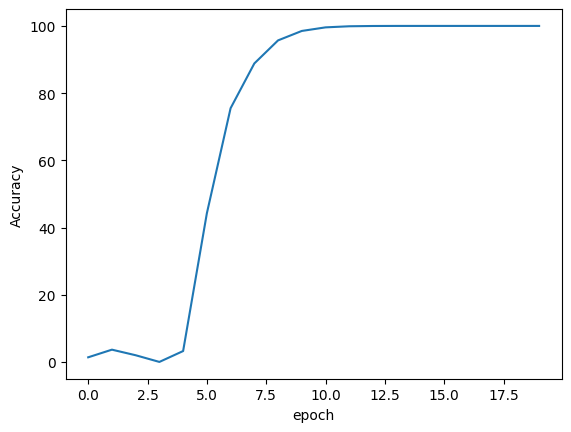

done
[]
4
tensor(0.3443, dtype=torch.float64)
tensor([0.0000, 0.5738, 0.0000, 1.1475, 0.0000], dtype=torch.float64)


In [69]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=10,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


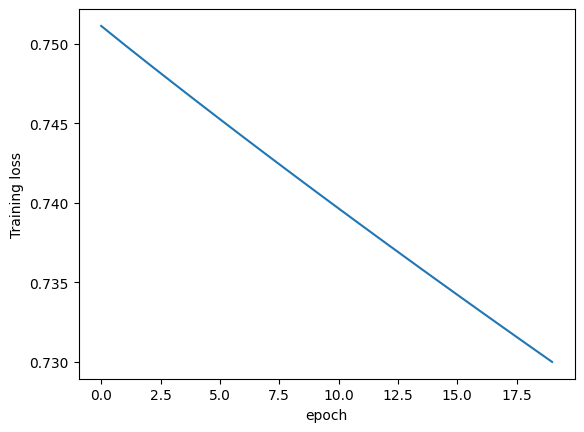

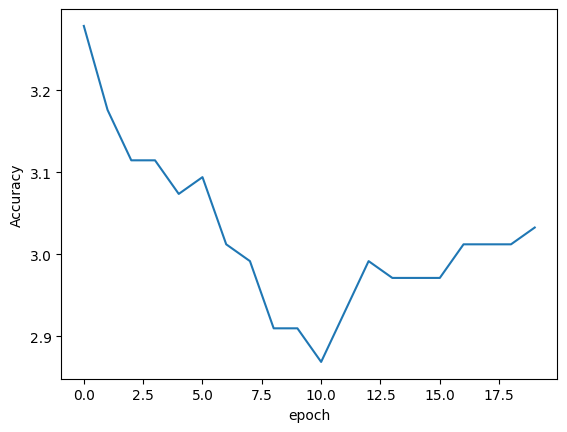

done
[]
4
20
4881


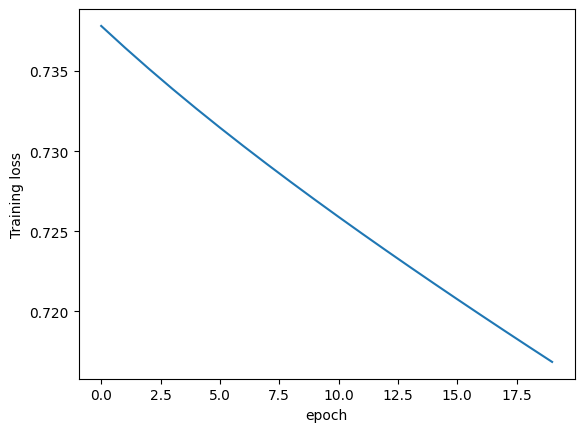

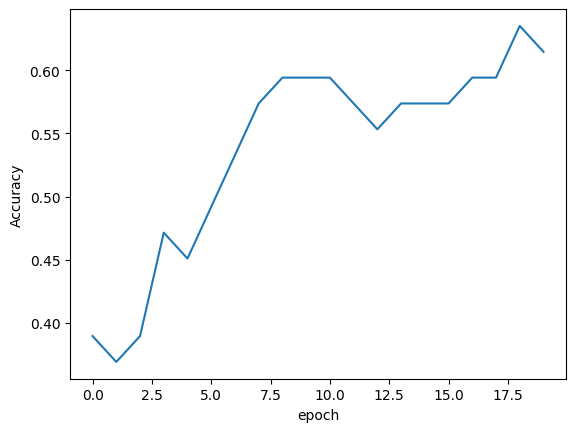

done
[]
4
20
4881


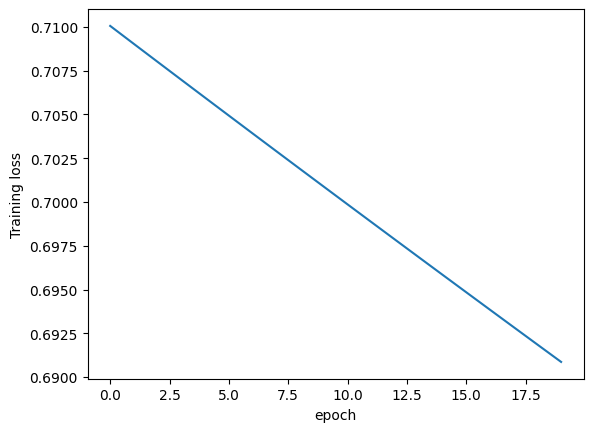

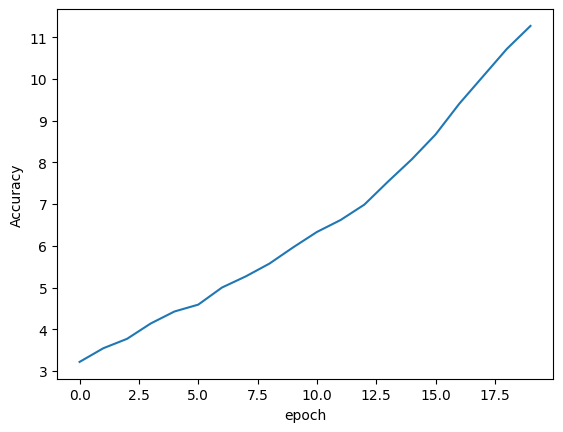

done
[]
4
20
4881


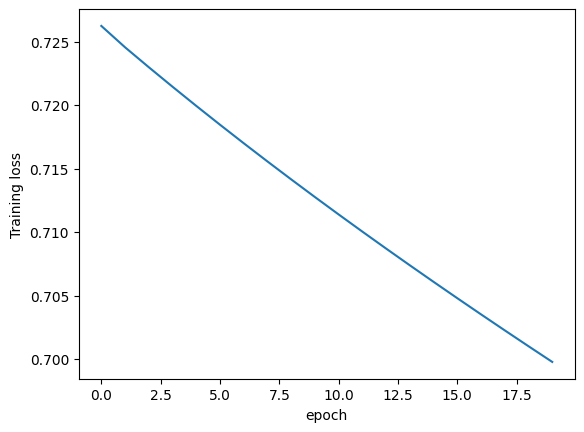

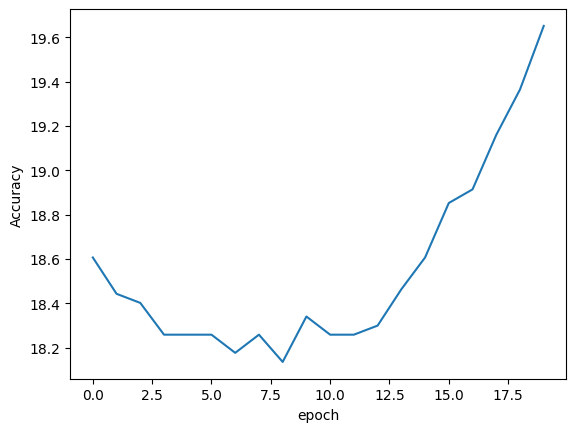

done
[]
4
20
4881


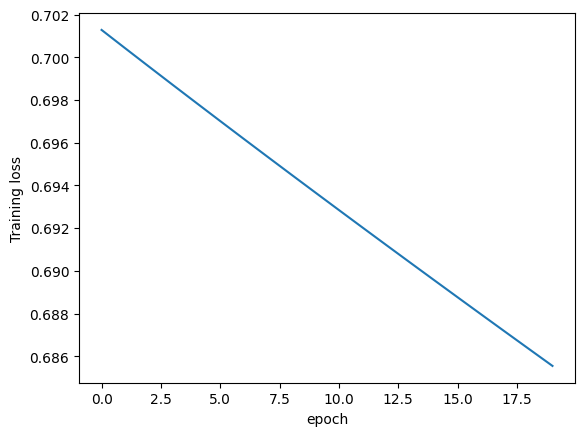

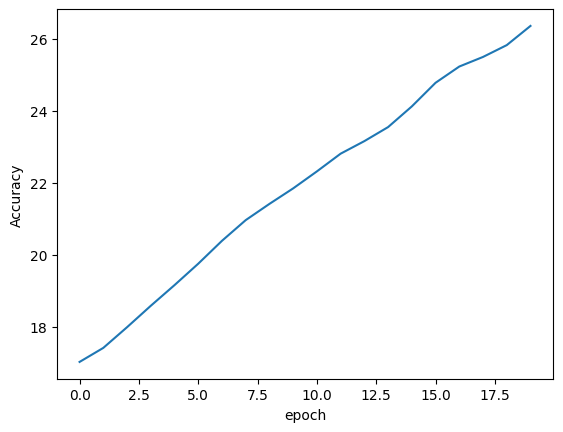

done
[]
4
tensor(4.0656, dtype=torch.float64)
tensor([ 0.0000,  0.0820,  0.1639, 18.6885,  1.3934], dtype=torch.float64)


In [70]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


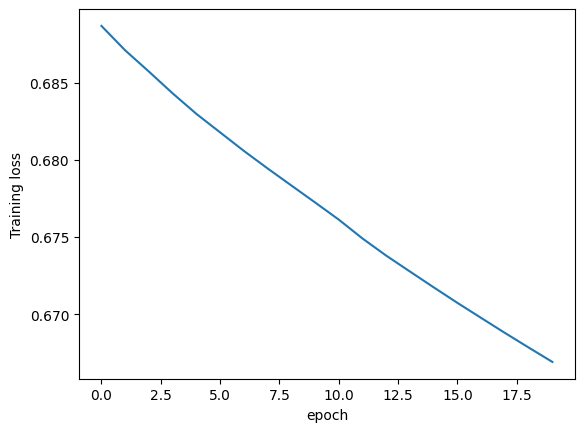

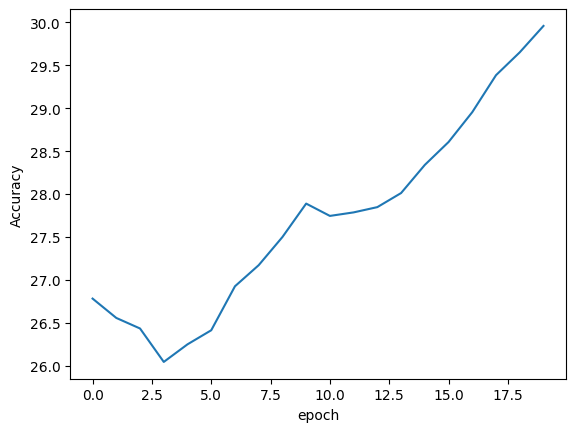

done
[]
4
20
4881


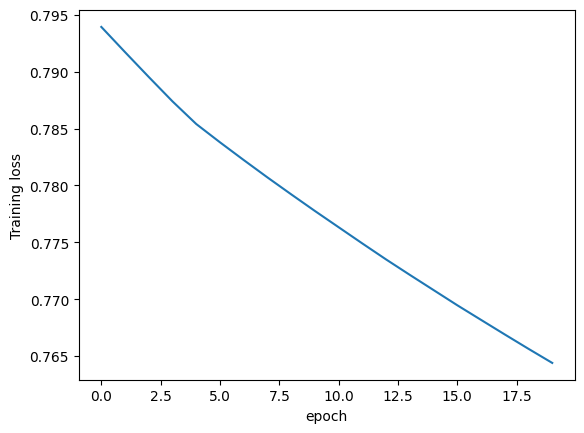

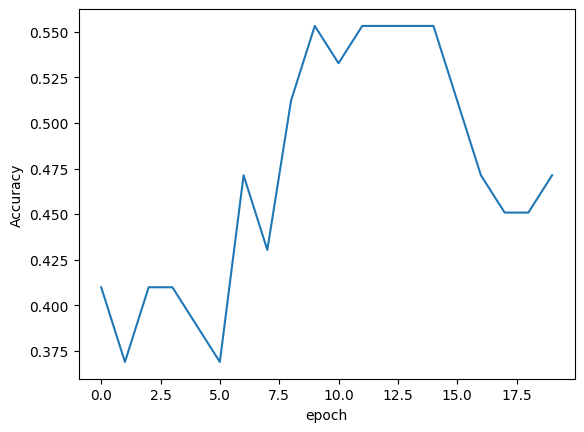

done
[]
4
20
4881


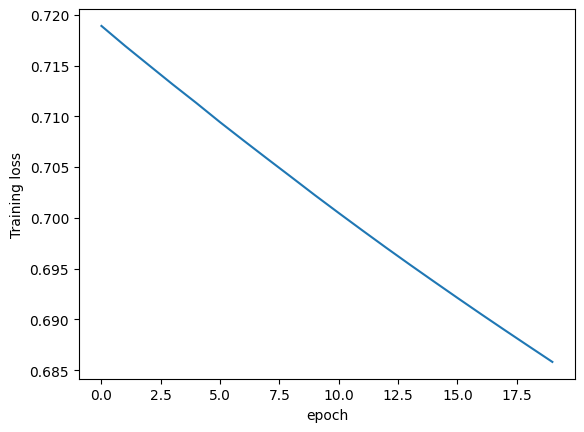

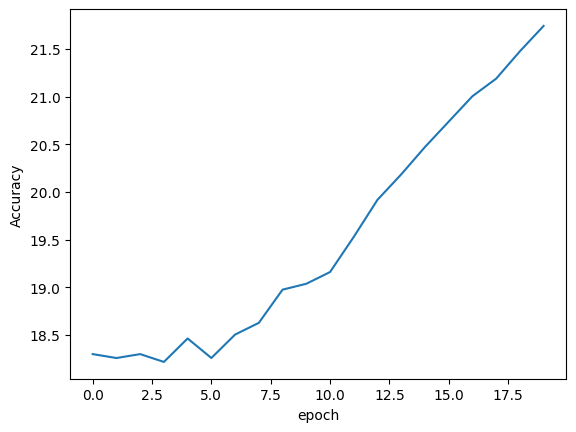

done
[]
4
20
4881


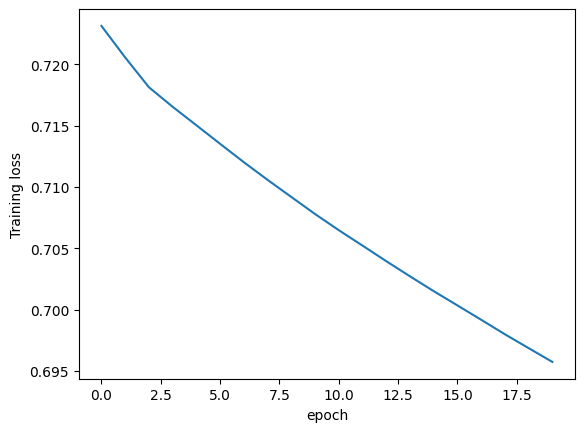

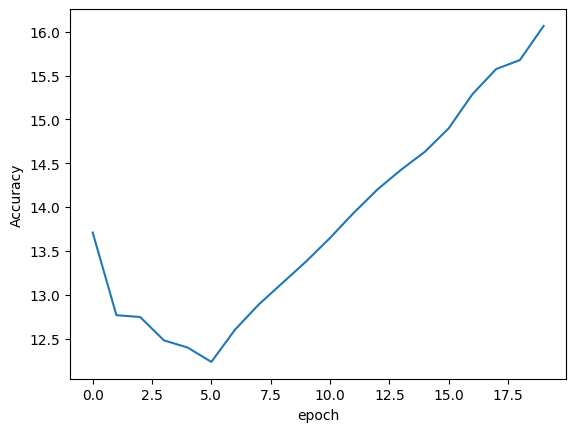

done
[]
4
20
4881


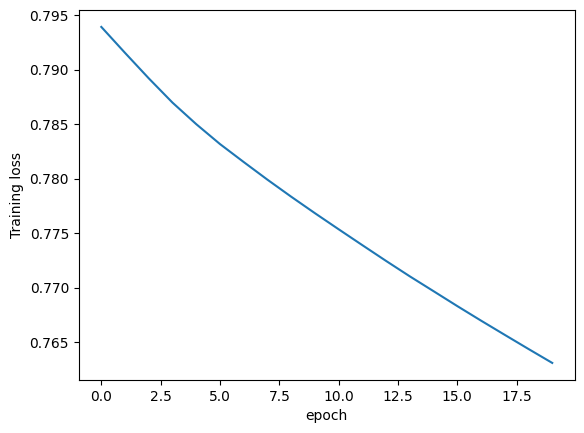

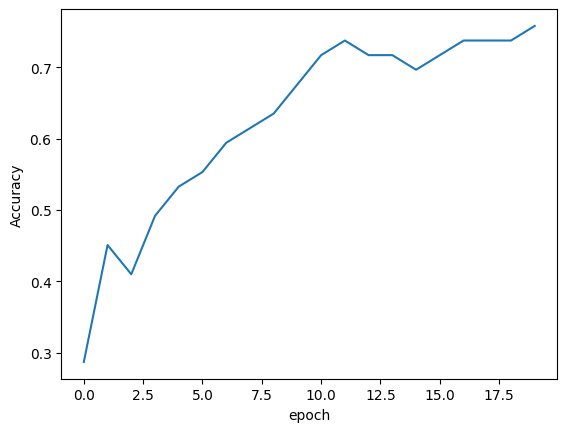

done
[]
4
tensor(19.0000, dtype=torch.float64)
tensor([42.3770, 16.8852, 14.7541, 10.9836, 10.0000], dtype=torch.float64)


In [73]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


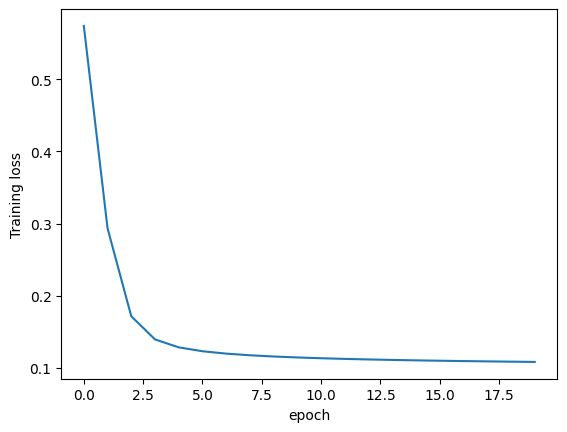

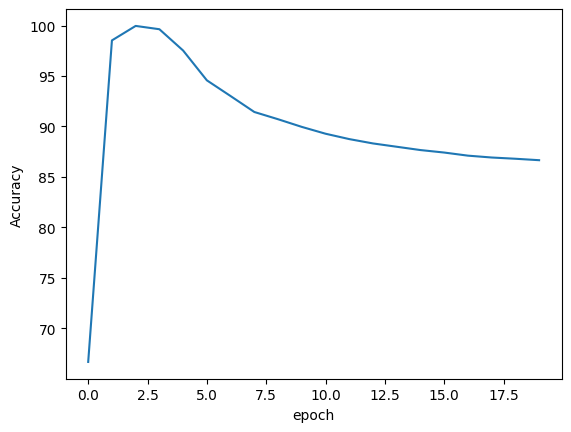

done
[]
4
20
4881


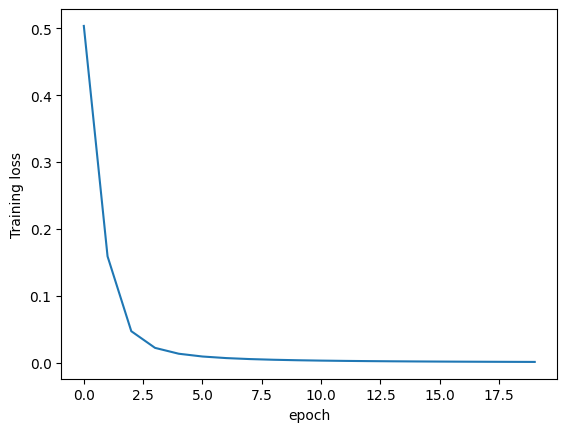

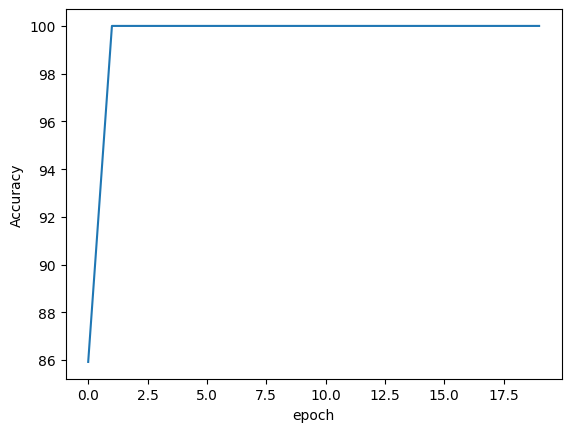

done
[]
4
20
4881


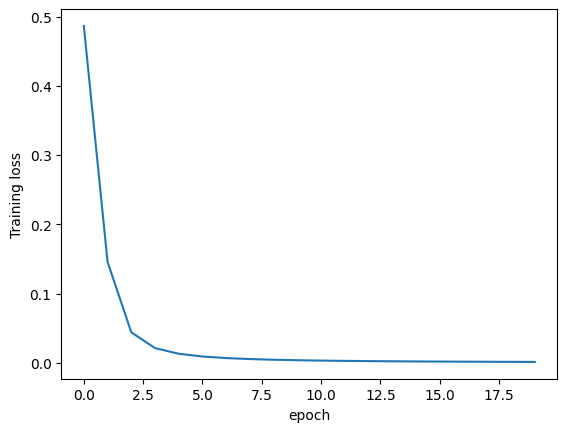

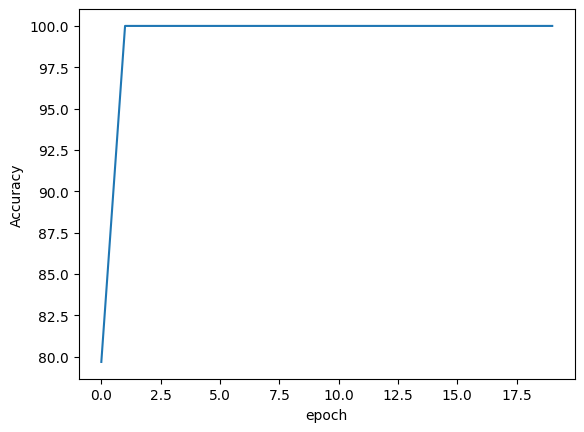

done
[]
4
20
4881


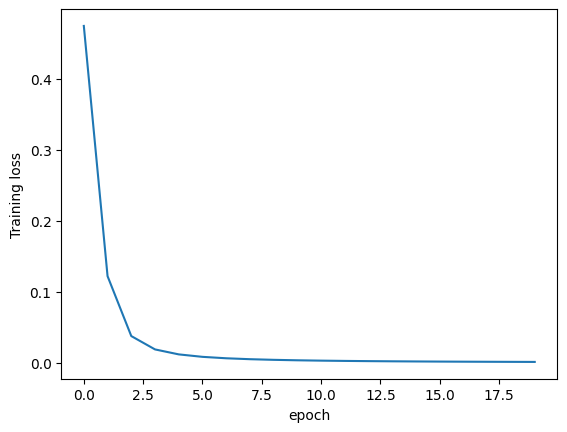

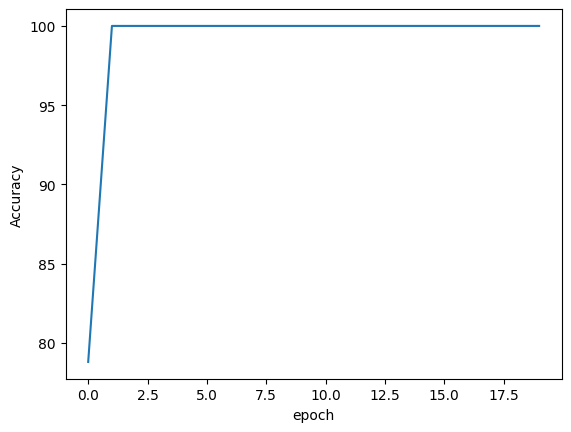

done
[]
4
20
4881


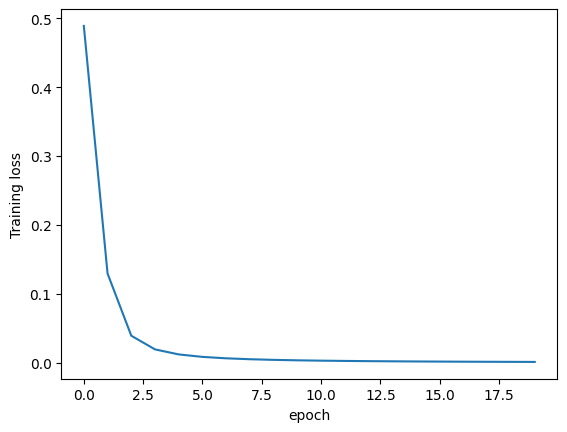

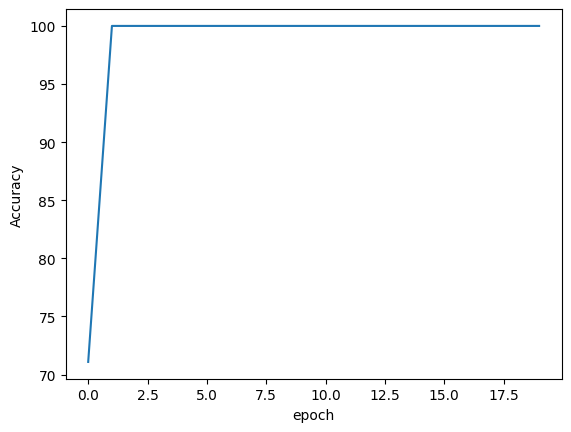

done
[]
4
tensor(0., dtype=torch.float64)
tensor([0., 0., 0., 0., 0.], dtype=torch.float64)


In [74]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.05234234)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


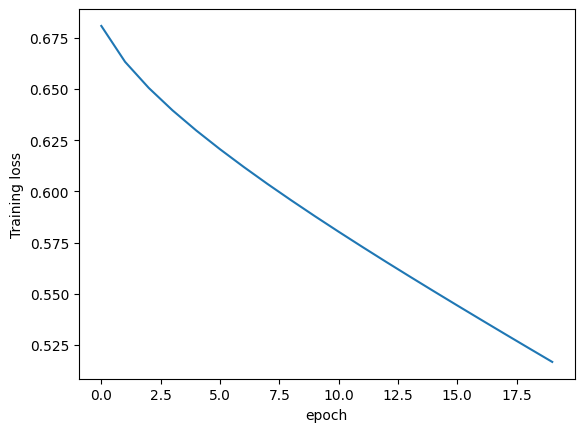

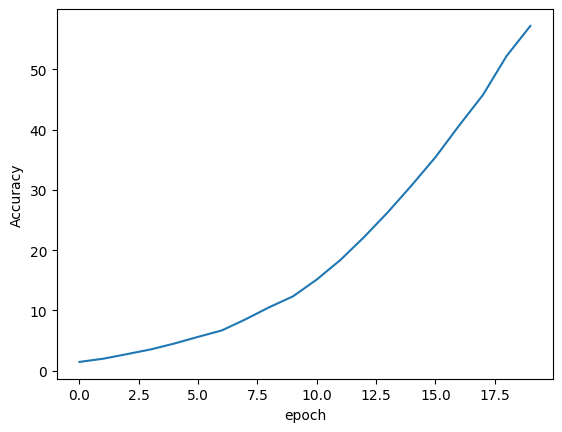

done
[]
4
20
4881


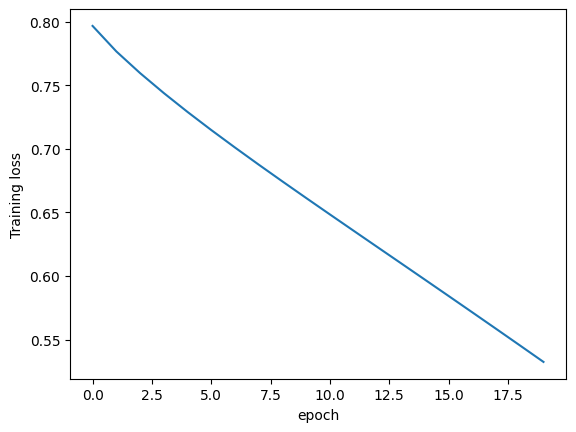

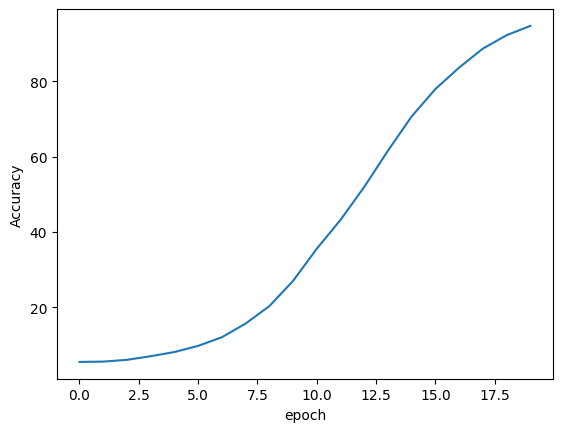

done
[]
4
20
4881


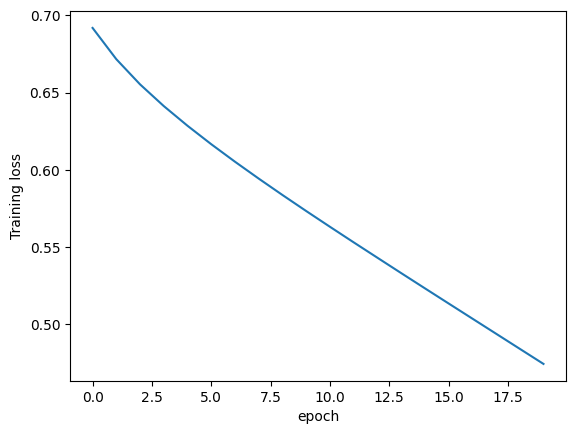

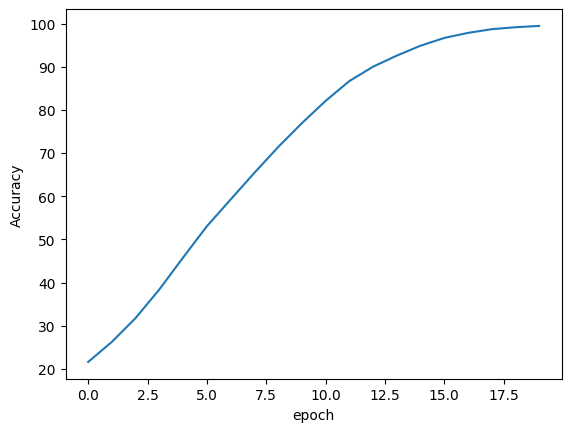

done
[]
4
20
4881


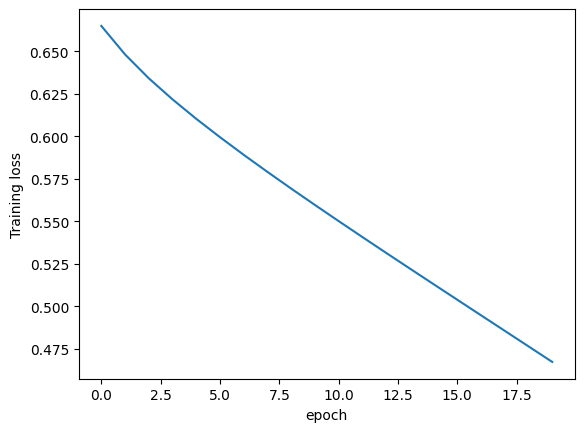

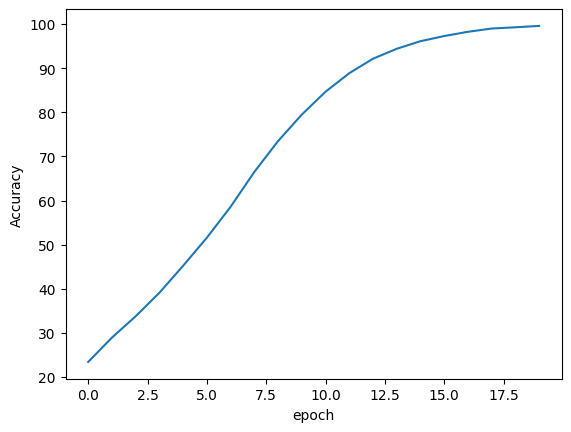

done
[]
4
20
4881


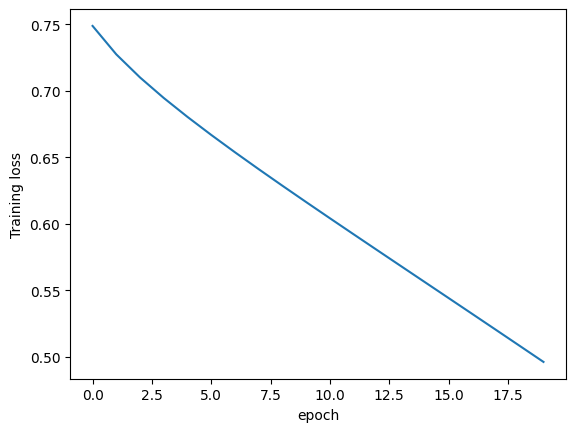

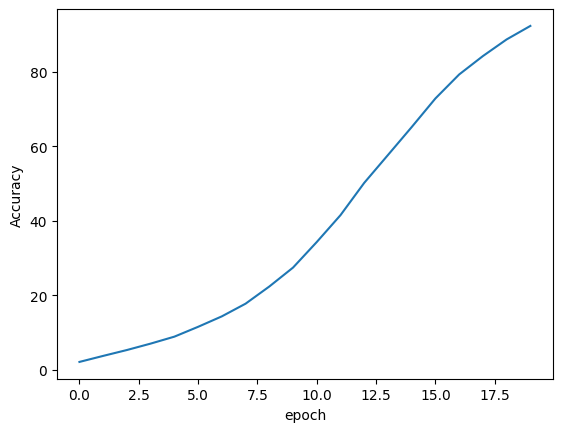

done
[]
4
tensor(1.4262, dtype=torch.float64)
tensor([1.1475, 0.3279, 0.0000, 0.1639, 5.4918], dtype=torch.float64)


In [75]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
            optimizer.zero_grad()
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

Connected to Python 3.10.12

7626
Data loaded
20
4881


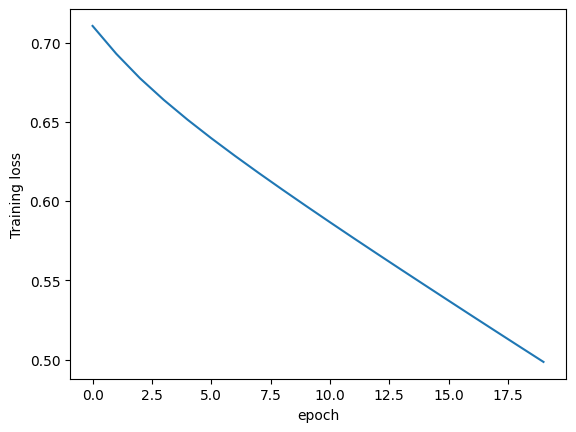

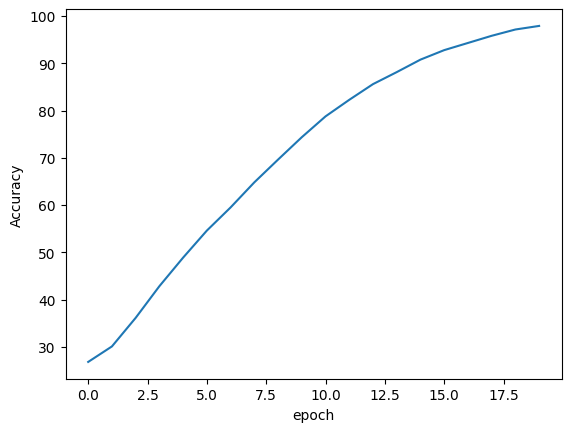

done
[]
4
20
4881


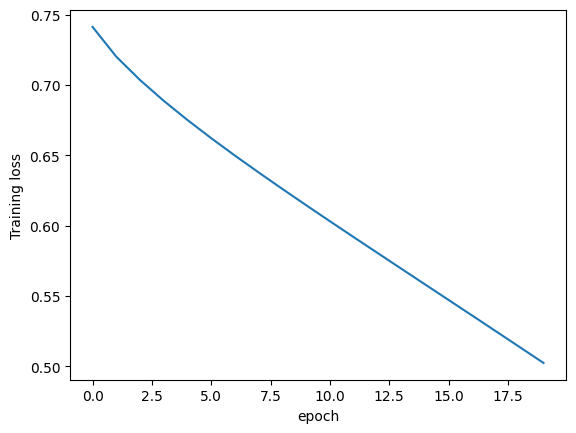

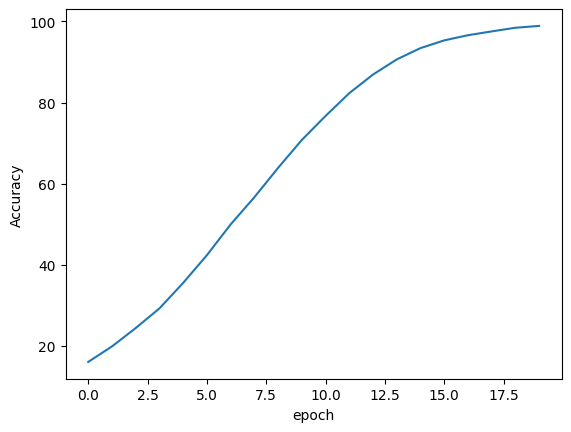

done
[]
4
20
4881


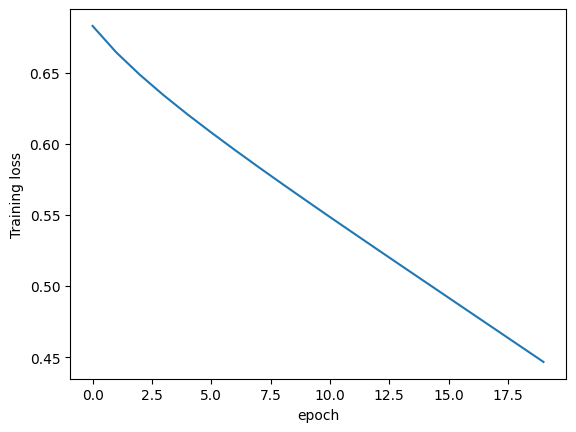

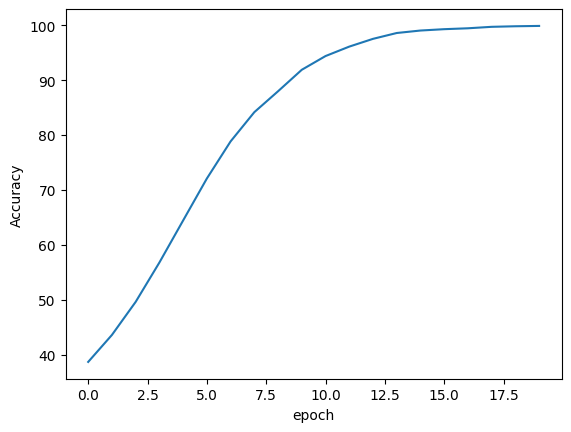

done
[]
4
20
4881


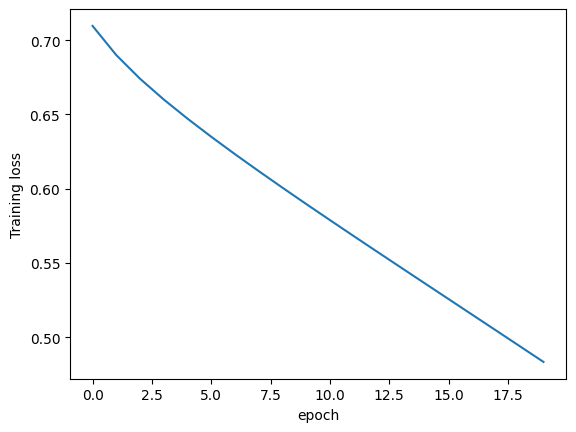

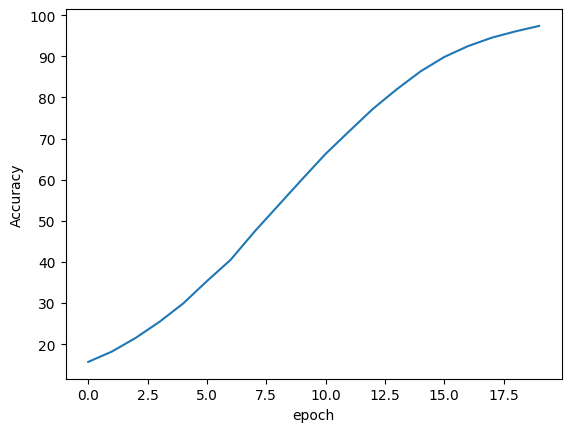

done
[]
4
20
4881


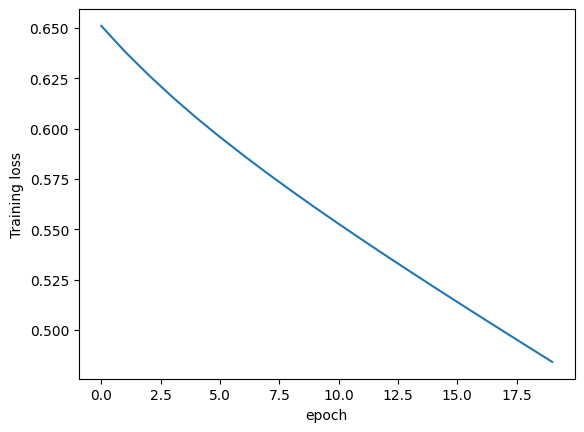

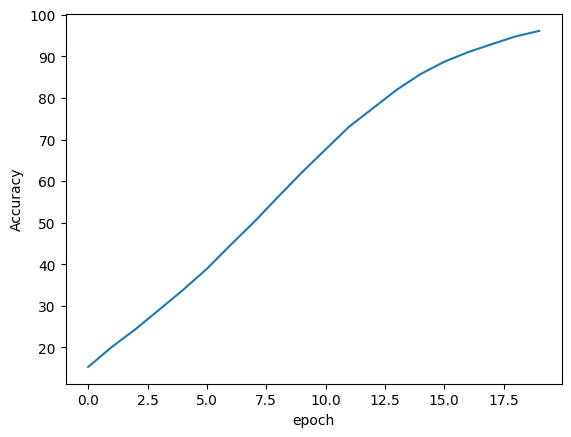

done
[]
4
tensor(0.9180, dtype=torch.float64)
tensor([0.3279, 0.0000, 0.0000, 0.3279, 3.9344], dtype=torch.float64)


In [1]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


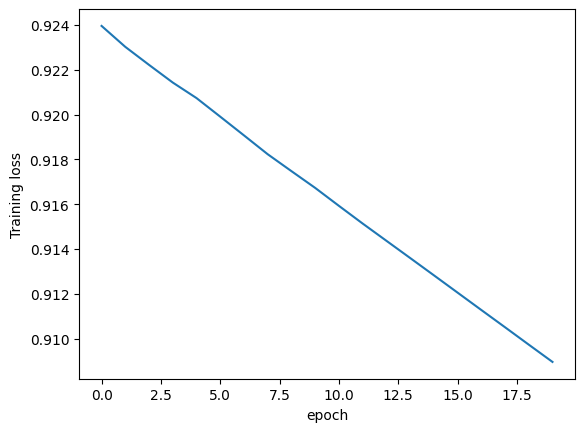

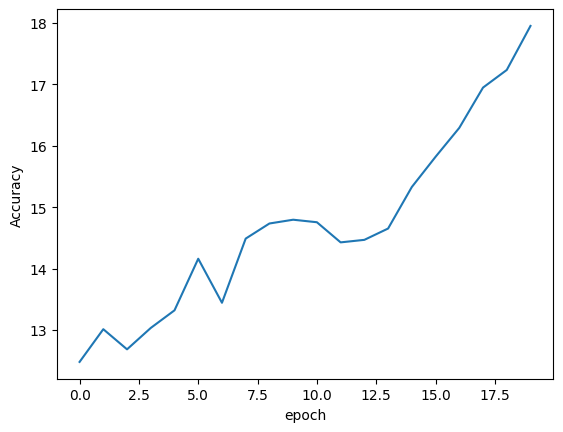

done
[]
4
20
4881


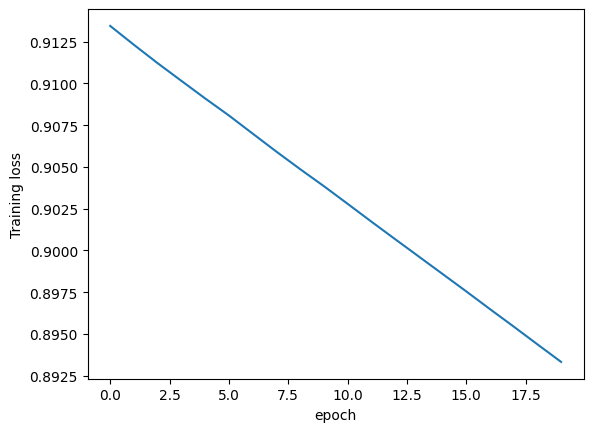

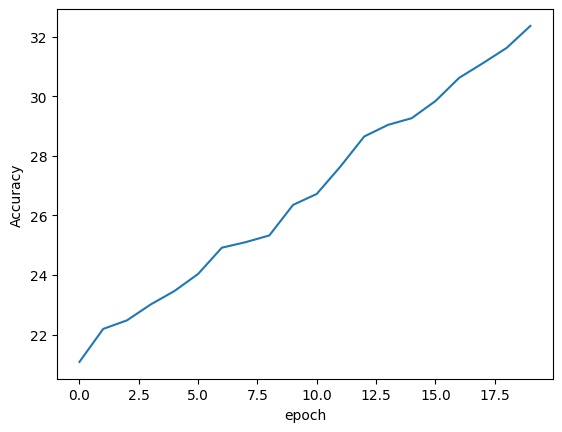

done
[]
4
20
4881


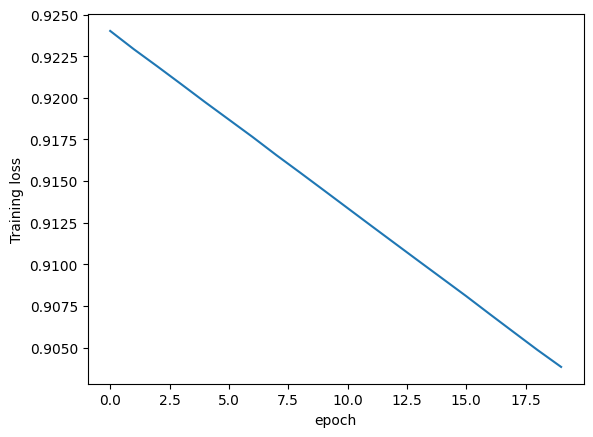

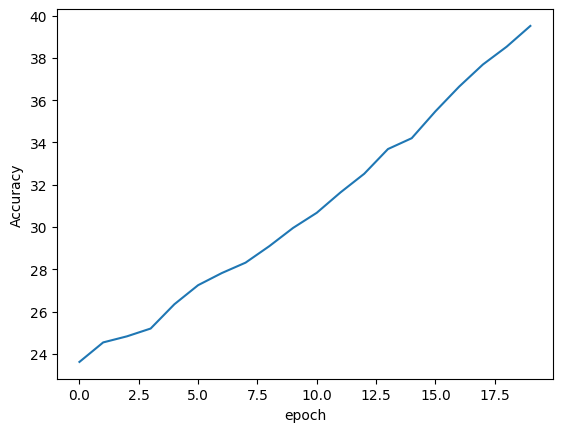

done
[]
4
20
4881


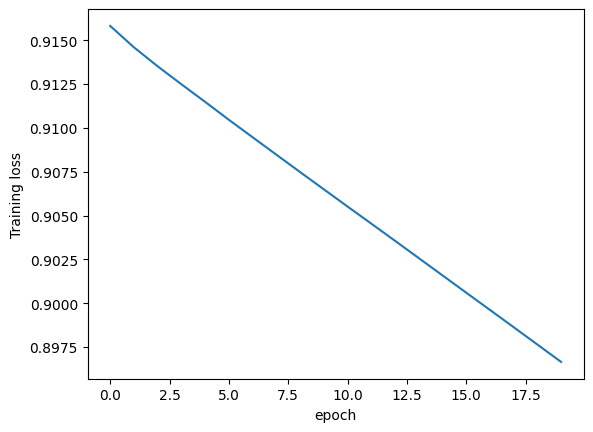

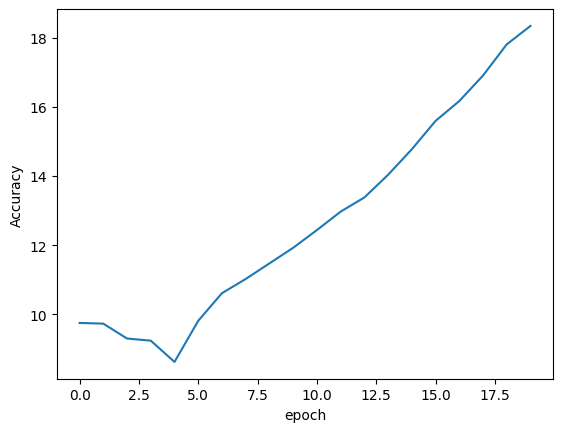

done
[]
4
20
4881


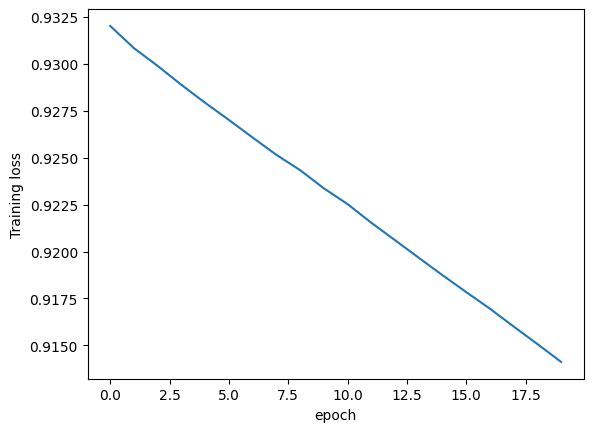

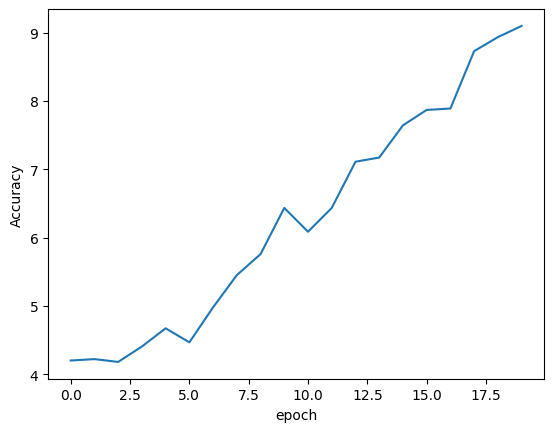

done
[]
4
tensor(4.1148, dtype=torch.float64)
tensor([ 0.0820,  0.8197,  8.6066,  1.0656, 10.0000], dtype=torch.float64)


In [3]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCEWithLogitsLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


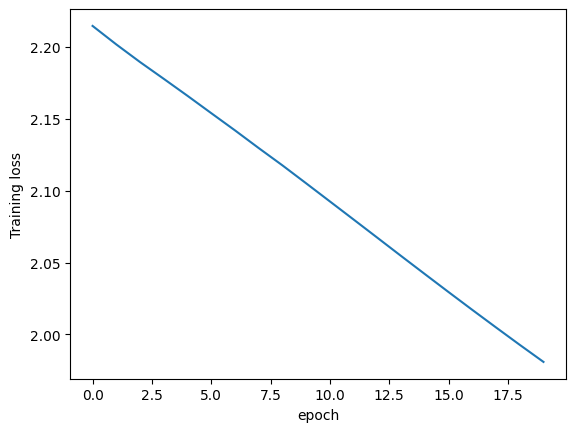

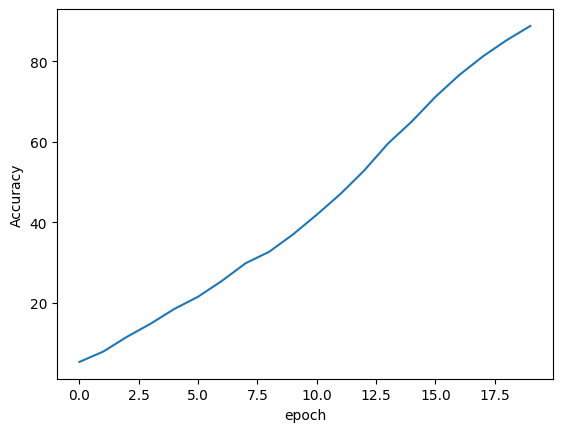

done
[]
4
20
4881


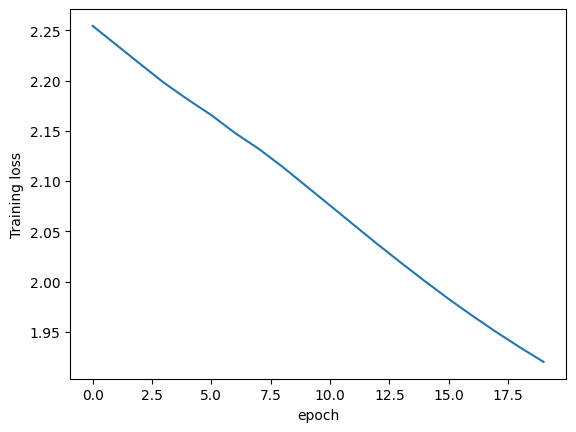

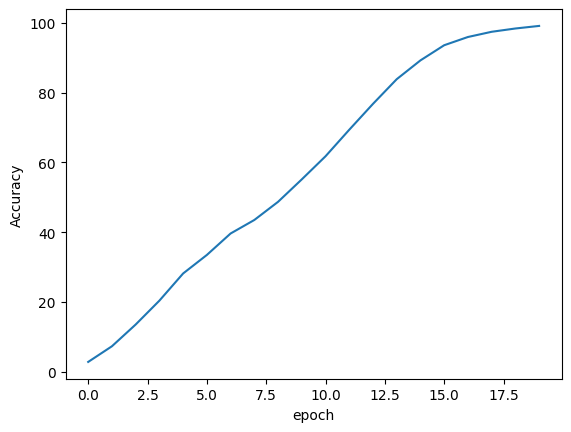

done
[]
4
20
4881


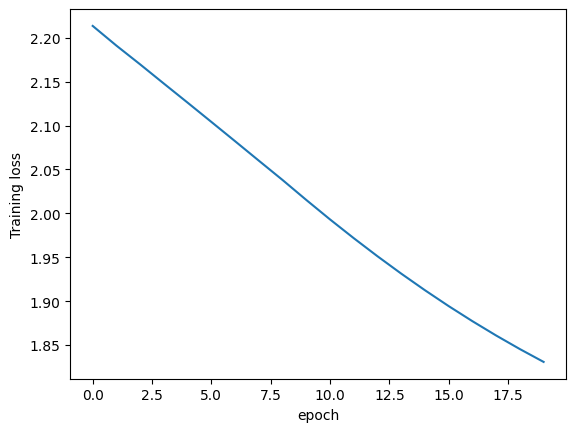

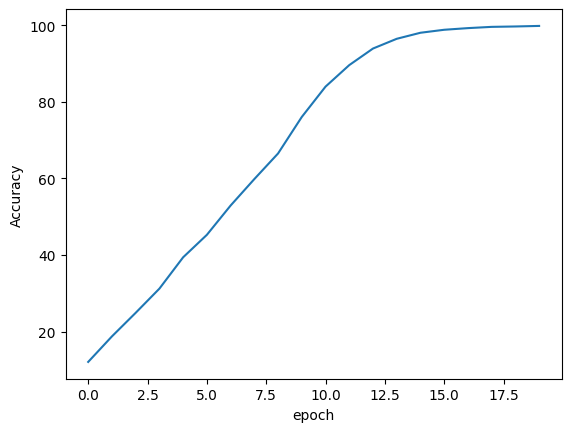

done
[]
4
20
4881


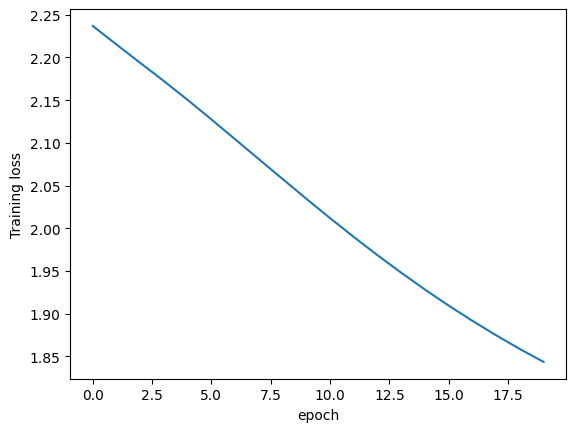

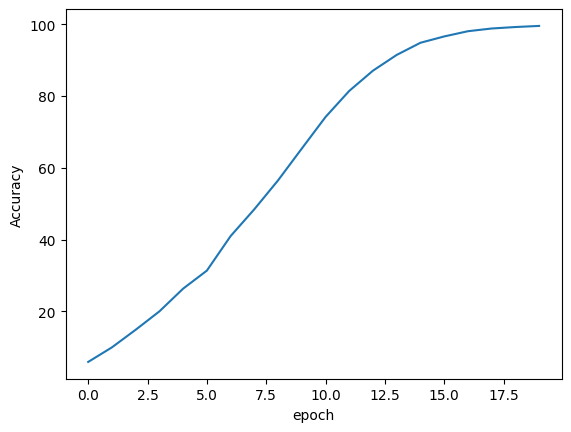

done
[]
4
20
4881


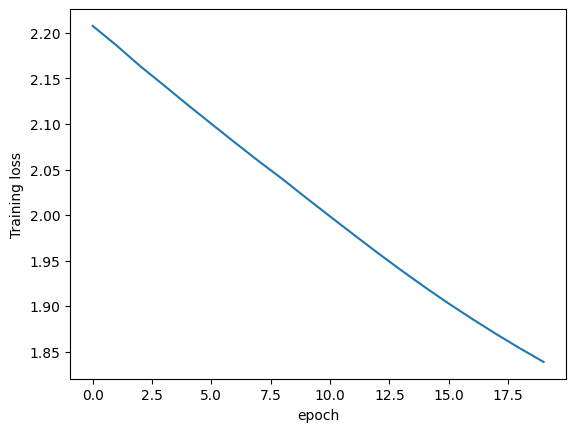

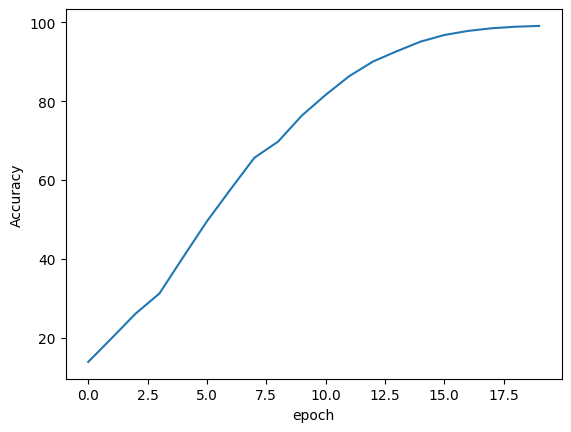

done
[]
4
tensor(0.5902, dtype=torch.float64)
tensor([0.0000, 0.1639, 0.0000, 0.5738, 2.2131], dtype=torch.float64)


In [4]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


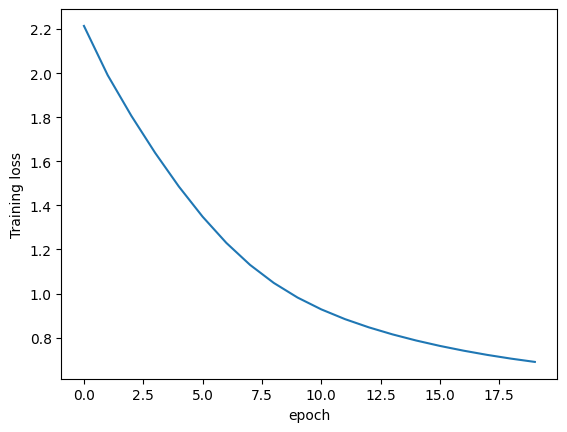

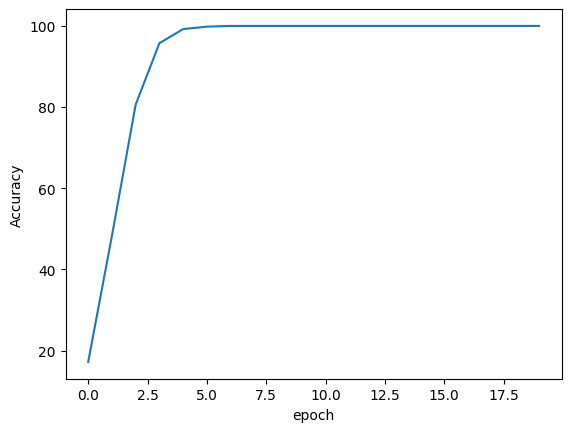

done
[]
4
20
4881


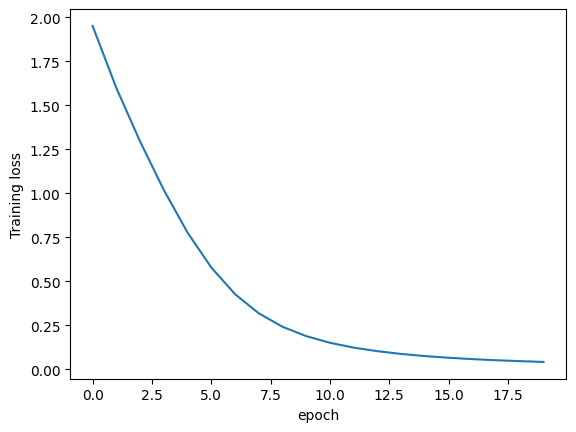

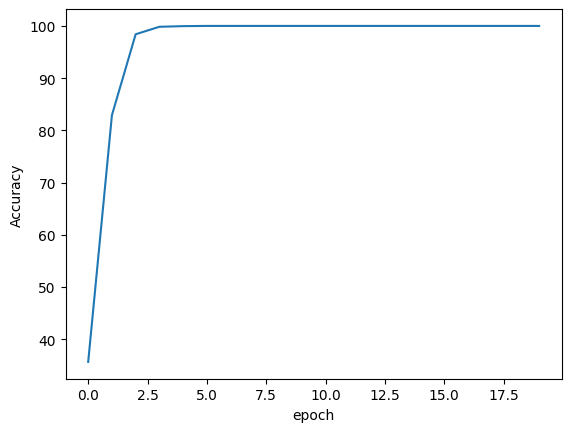

done
[]
4
20
4881


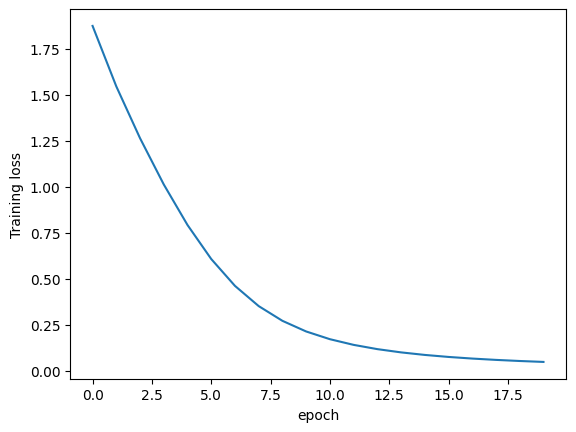

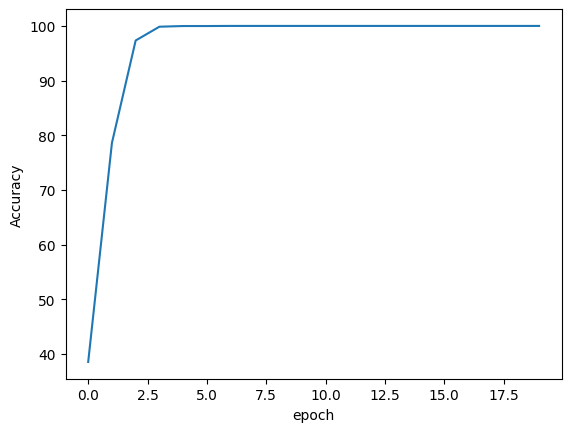

done
[]
4
20
4881


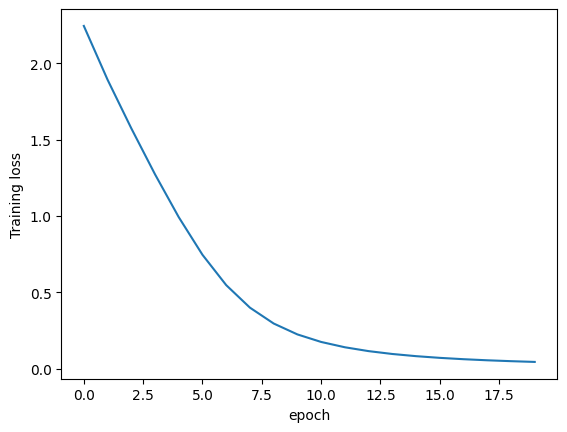

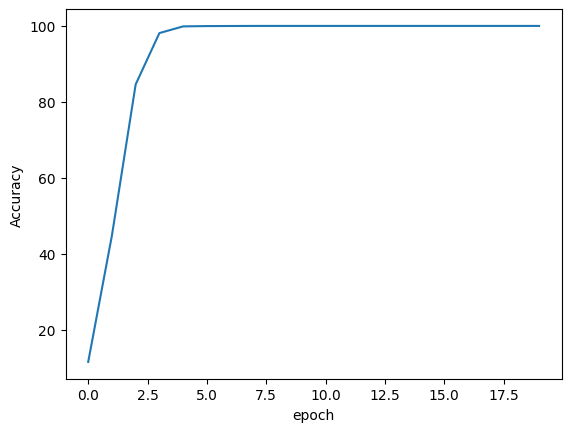

done
[]
4
20
4881


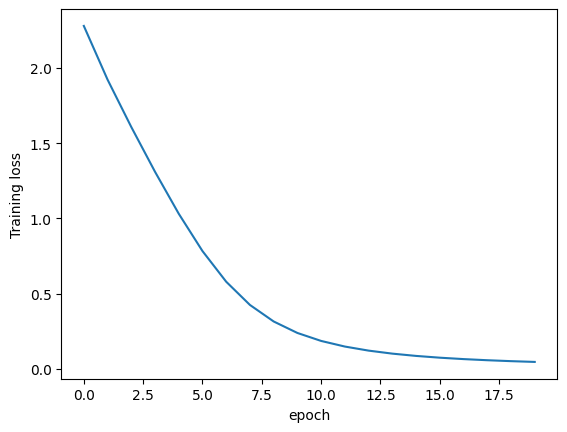

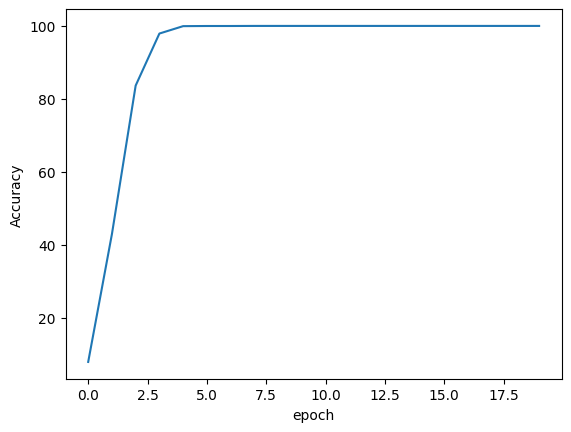

done
[]
4
tensor(0.0164, dtype=torch.float64)
tensor([0.0000, 0.0000, 0.0000, 0.0000, 0.0820], dtype=torch.float64)


In [5]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        #nn.Sigmoid()
    



        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


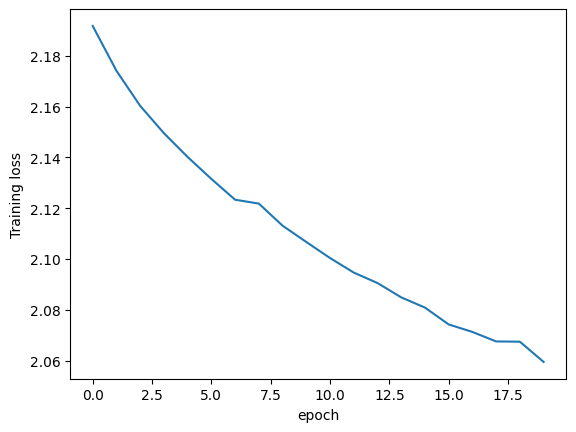

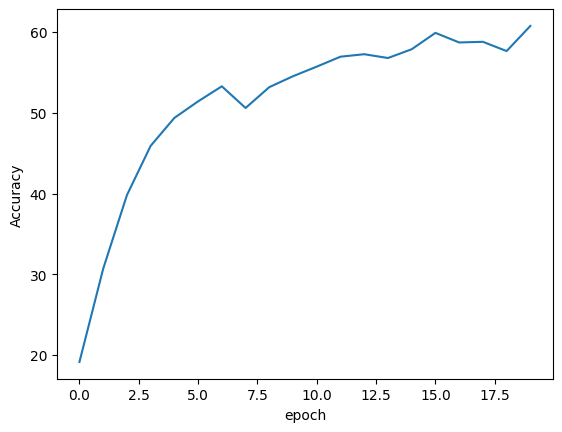

done
[]
4
20
4881


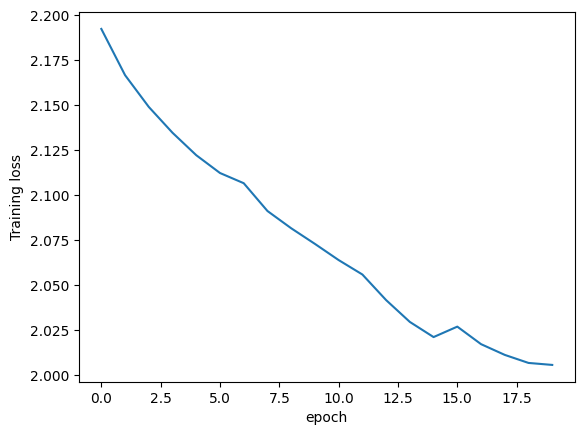

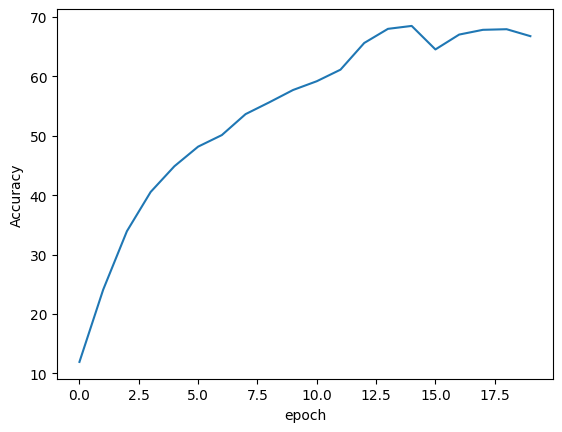

done
[]
4
20
4881


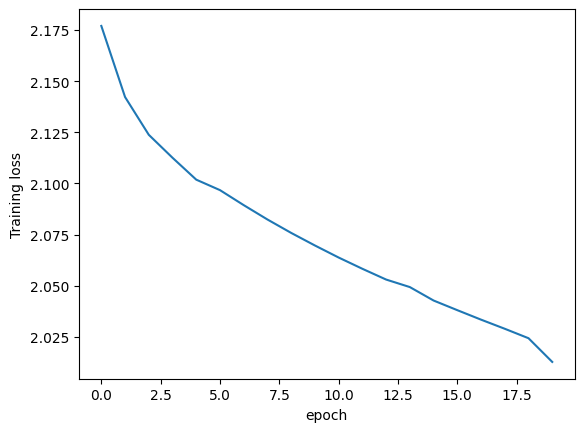

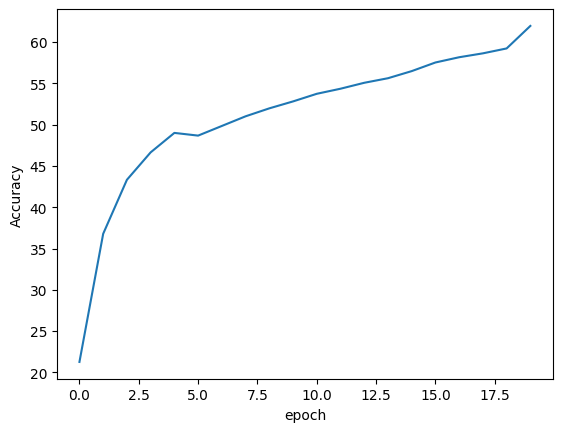

done
[]
4
20
4881


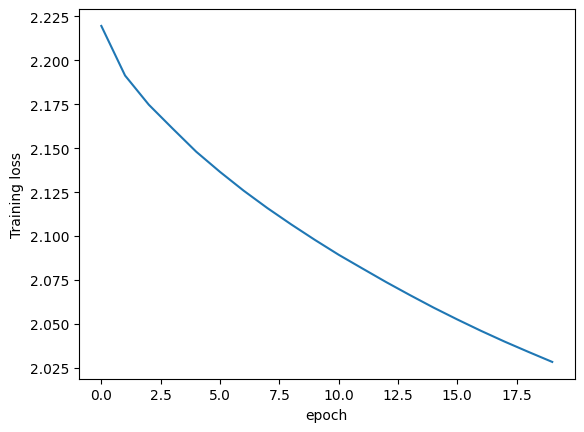

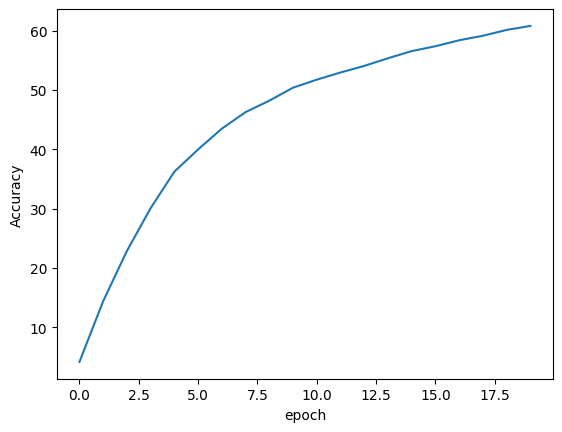

done
[]
4
20
4881


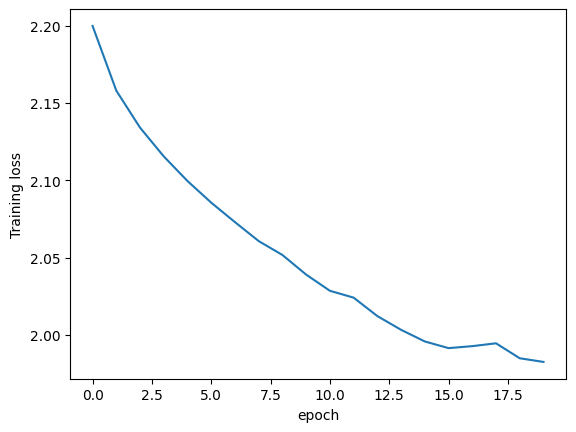

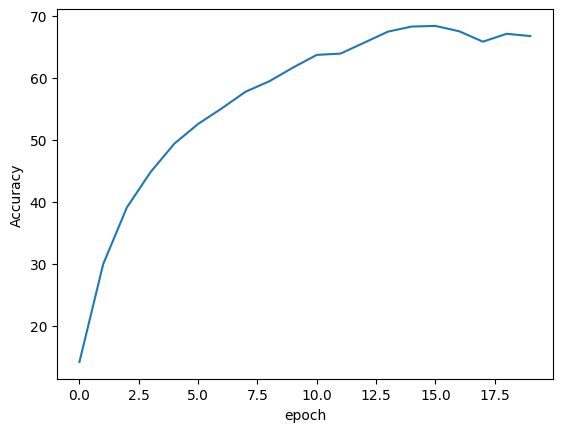

done
[]
4
tensor(4.6230, dtype=torch.float64)
tensor([ 0.0000,  1.9672, 15.0000,  0.7377,  5.4098], dtype=torch.float64)


In [6]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


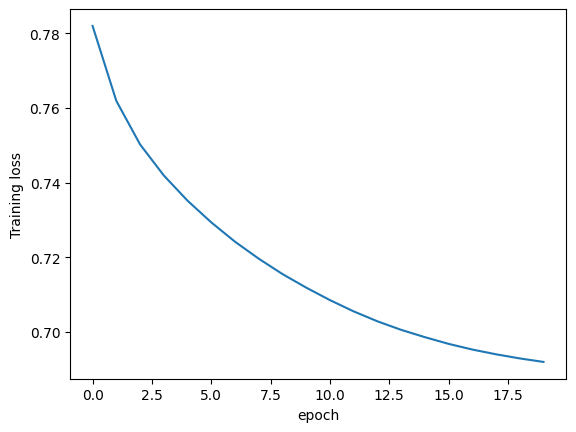

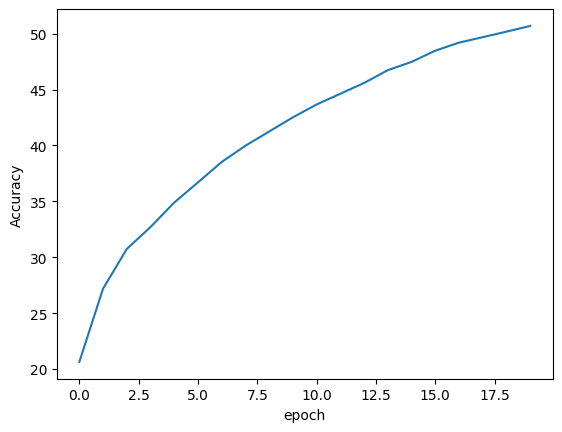

done
[]
4
20
4881


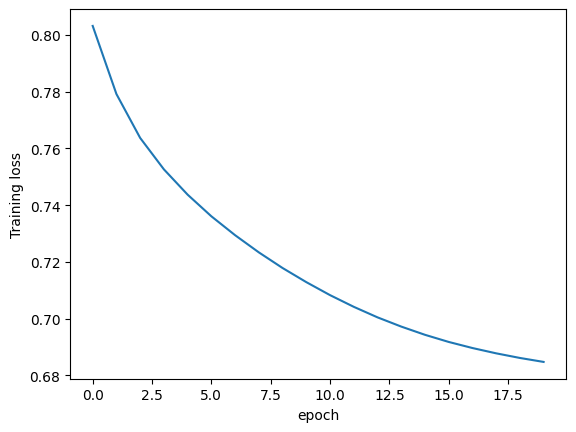

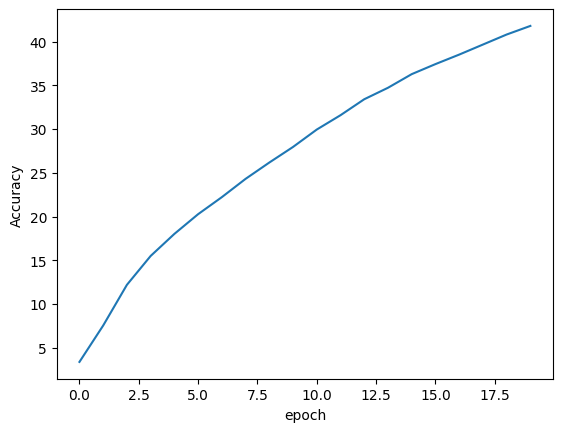

done
[]
4
20
4881


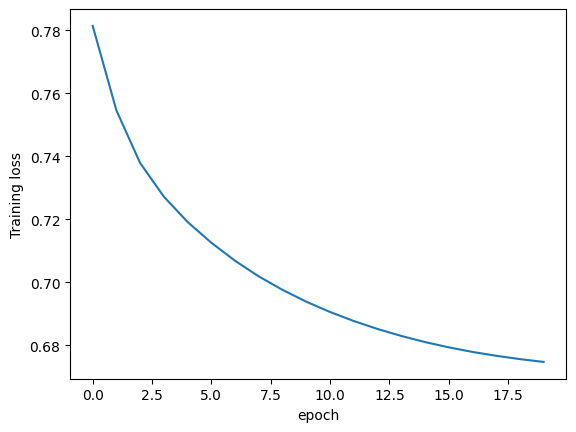

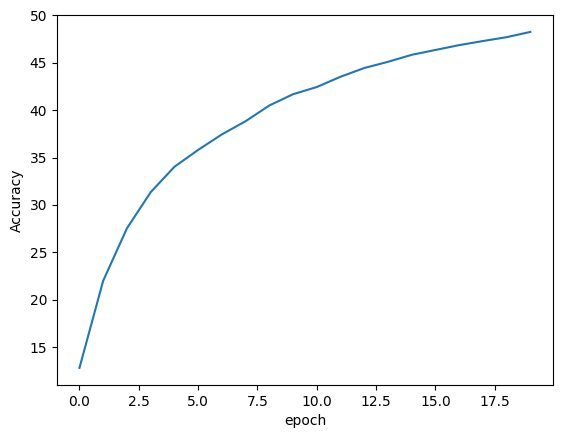

done
[]
4
20
4881


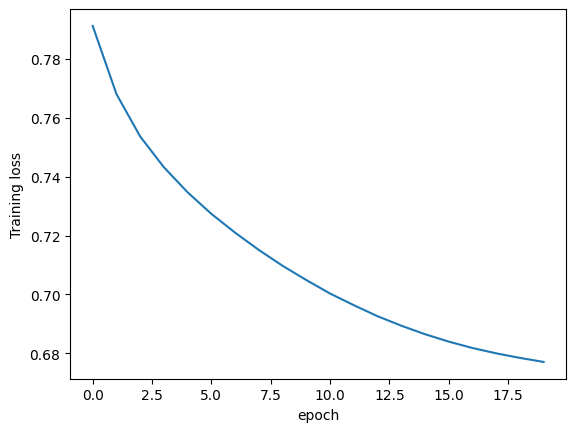

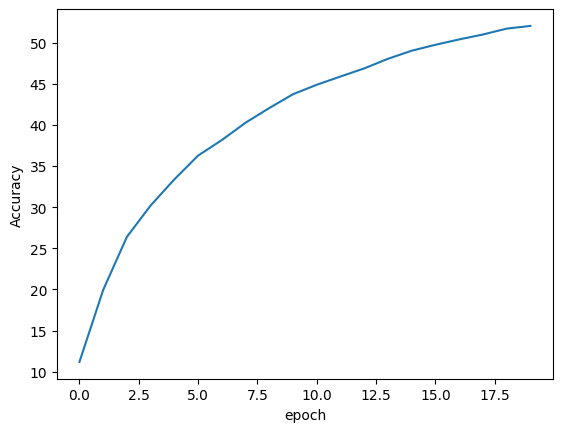

done
[]
4
20
4881


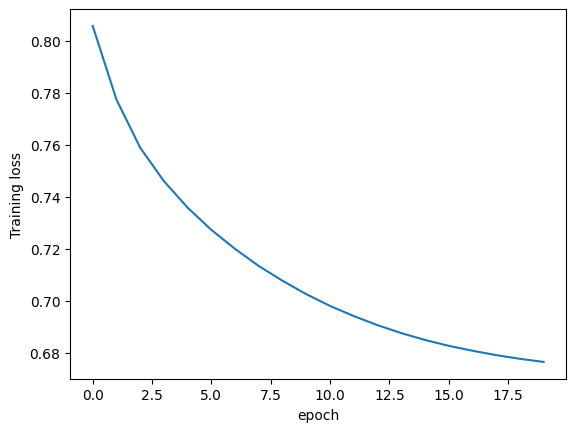

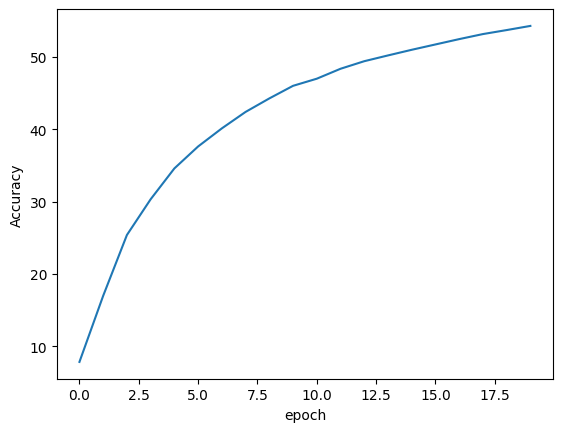

done
[]
4
tensor(9.0656, dtype=torch.float64)
tensor([17.7049,  1.6393, 17.7869,  3.6066,  4.5902], dtype=torch.float64)


In [7]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(20):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


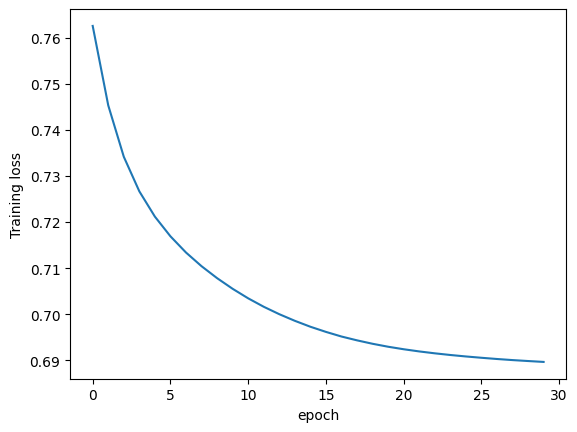

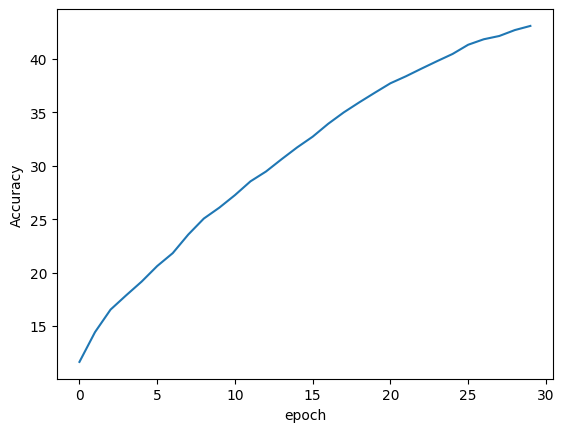

done
[]
4
20
4881


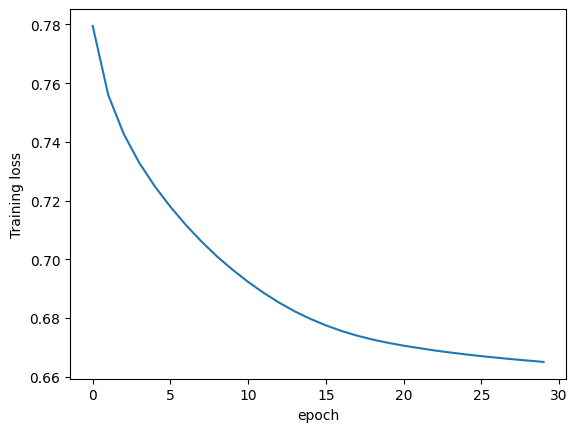

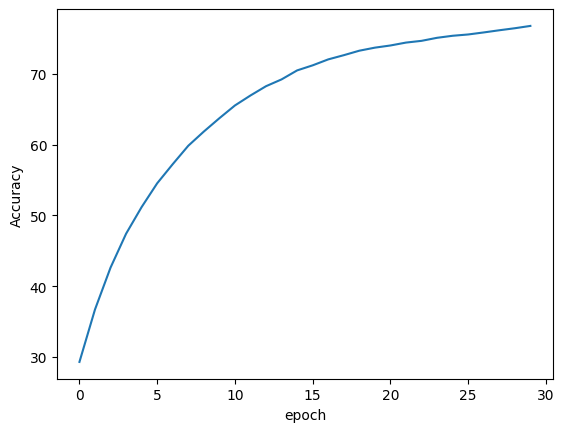

done
[]
4
20
4881


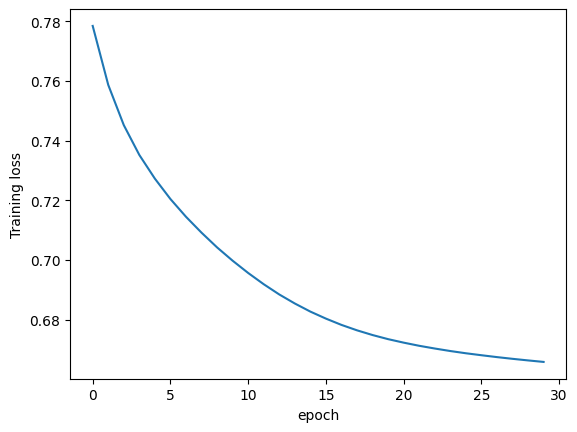

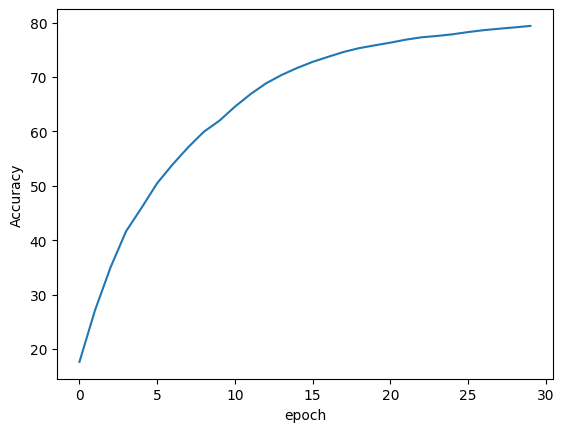

done
[]
4
20
4881


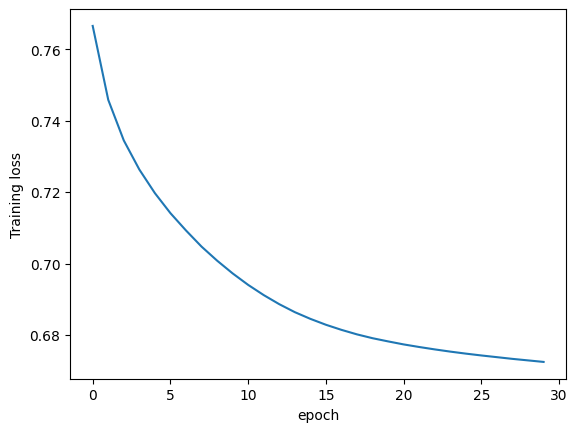

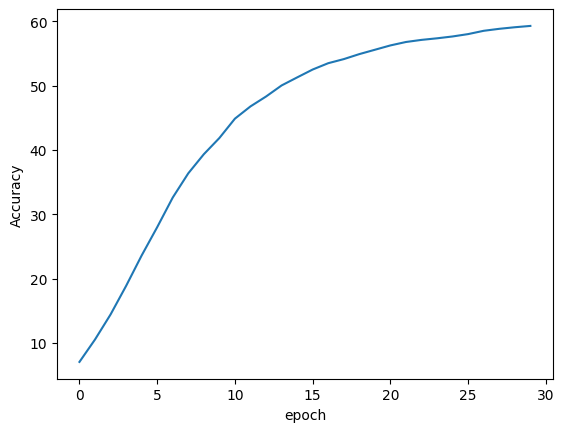

done
[]
4
20
4881


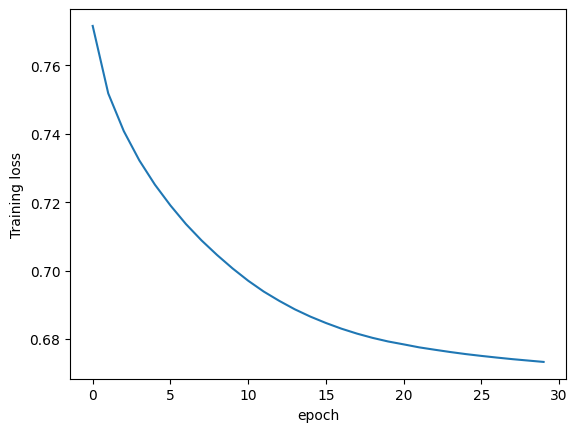

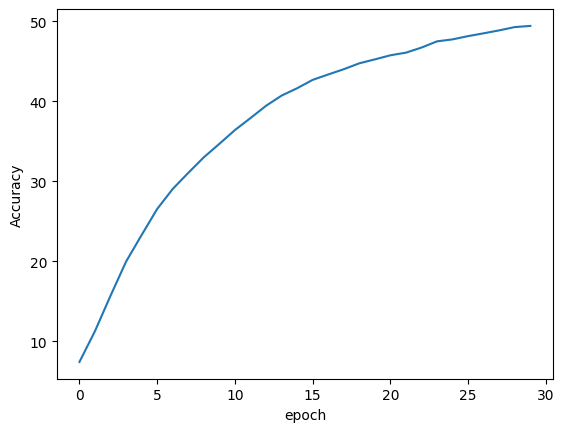

done
[]
4
tensor(3.6885, dtype=torch.float64)
tensor([0.2459, 3.7705, 3.2787, 3.1148, 8.0328], dtype=torch.float64)


In [8]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
    #mi= np.min(X[i])
   # ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
        #X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)
X=torch.from_numpy(X).type(torch.float)

# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(30):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


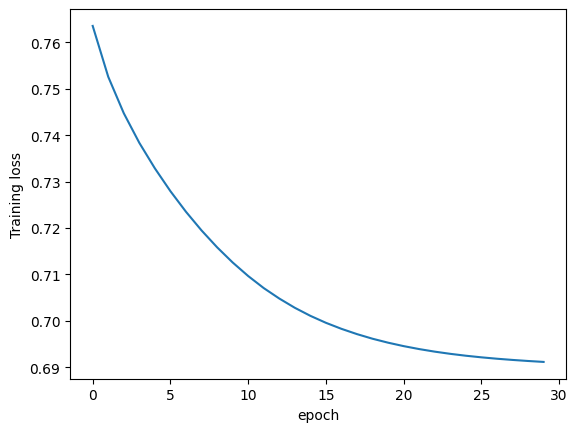

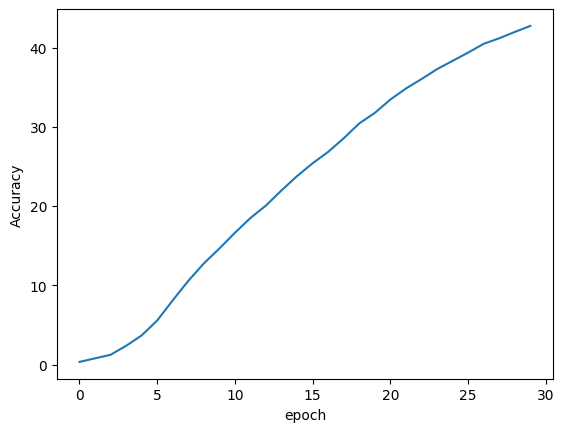

done
[]
4
20
4881


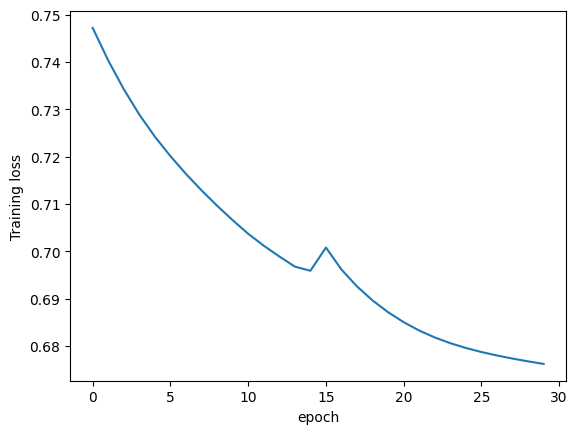

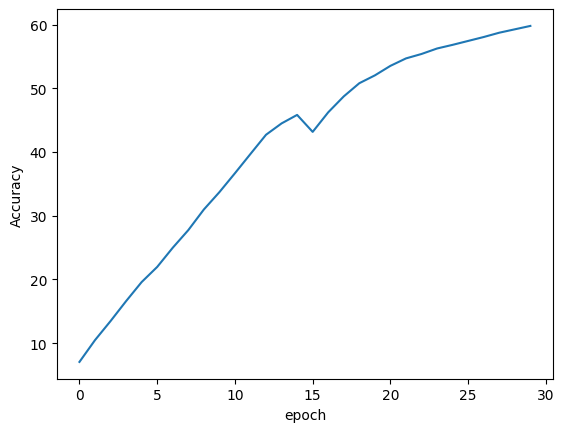

done
[]
4
20
4881


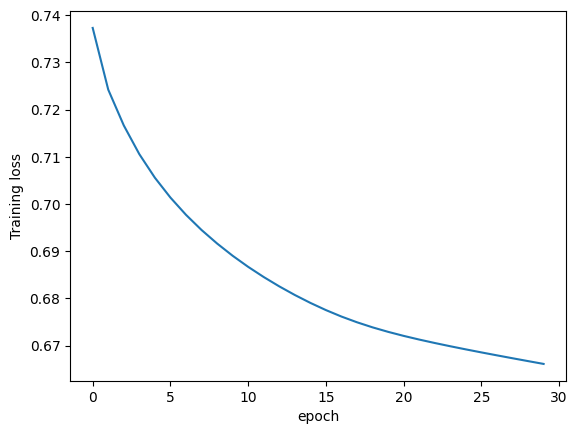

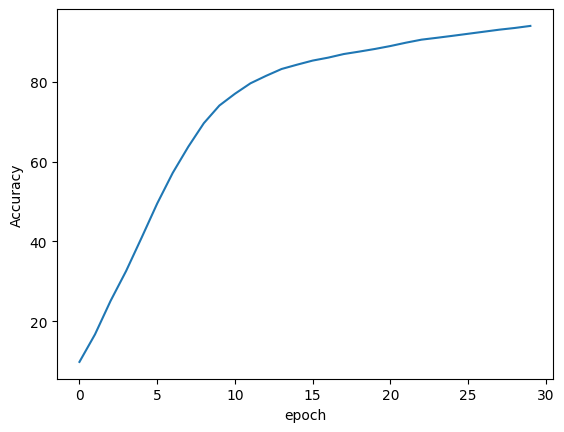

done
[]
4
20
4881


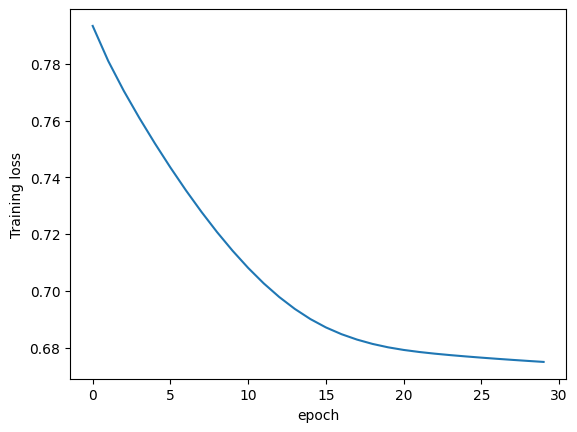

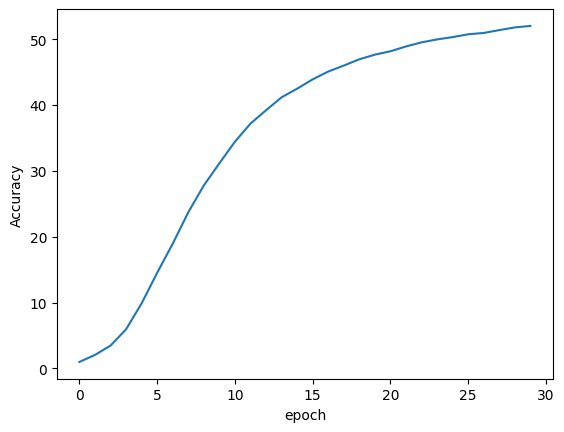

done
[]
4
20
4881


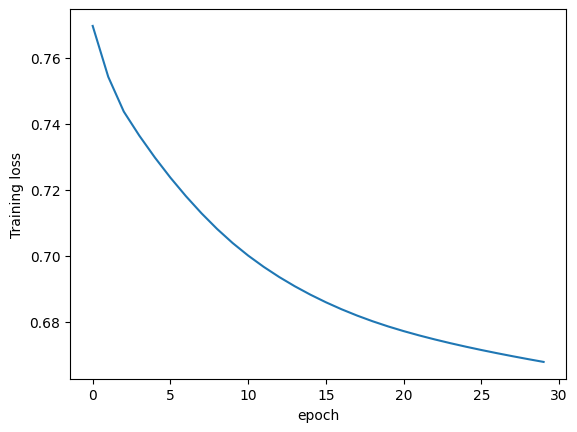

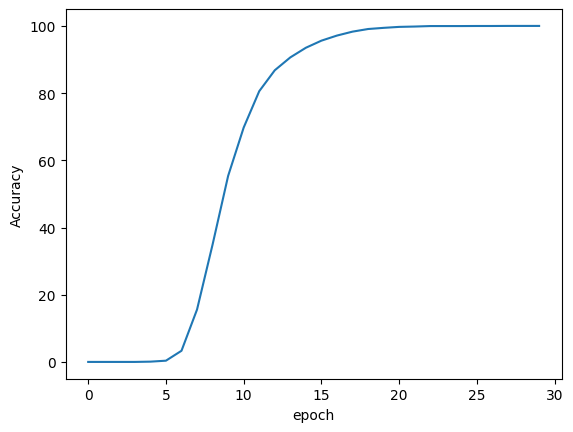

done
[]
4
tensor(8.5574, dtype=torch.float64)
tensor([42.6230,  0.0820,  0.0820,  0.0000,  0.0000], dtype=torch.float64)


In [9]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(30):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


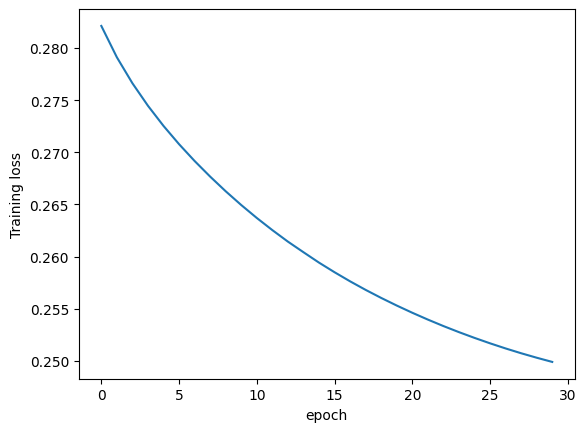

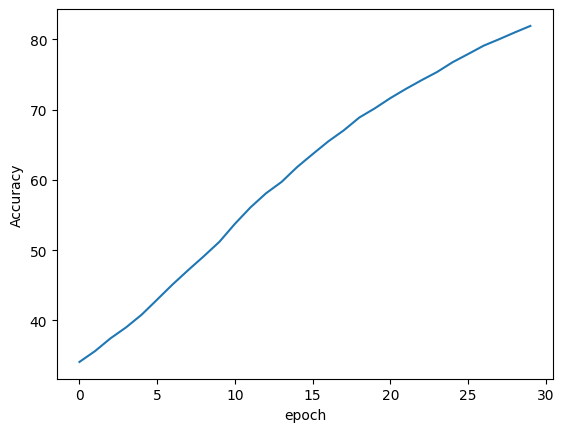

done
[]
4
20
4881


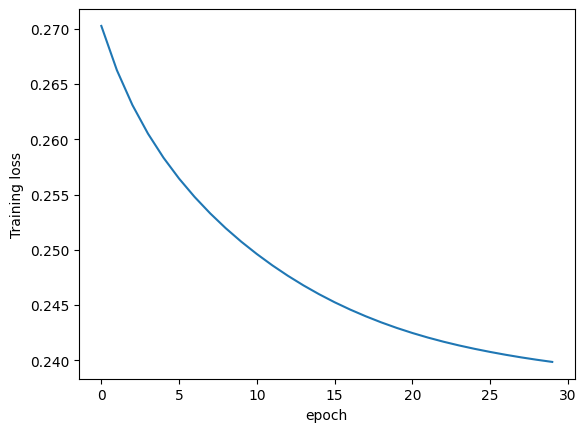

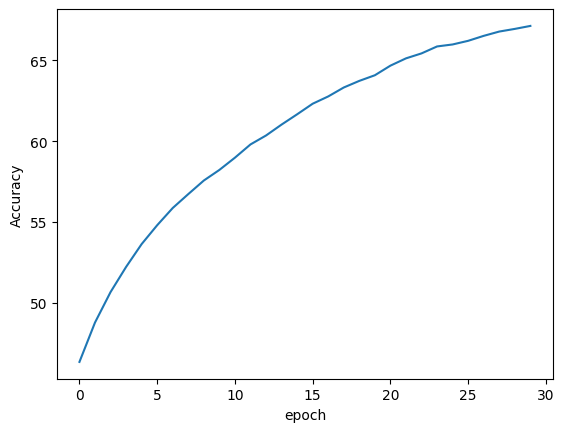

done
[]
4
20
4881


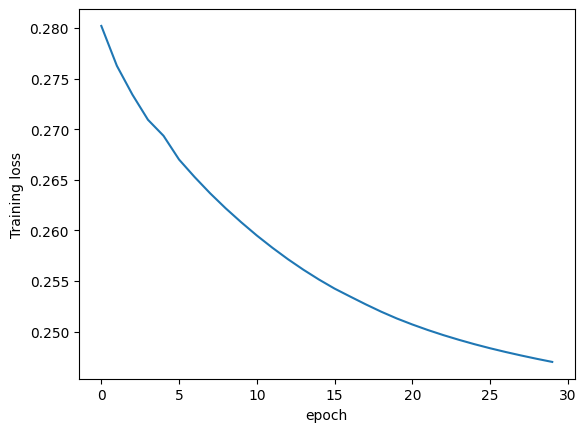

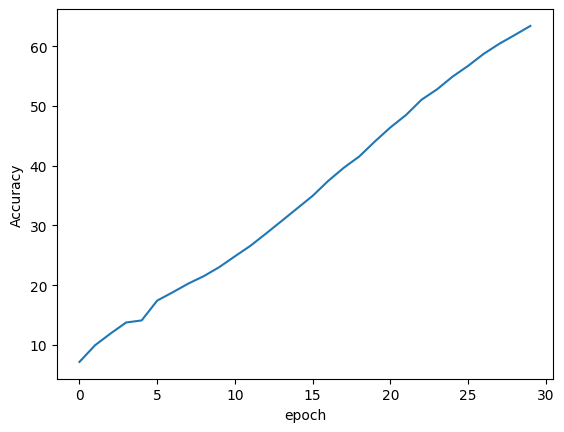

done
[]
4
20
4881


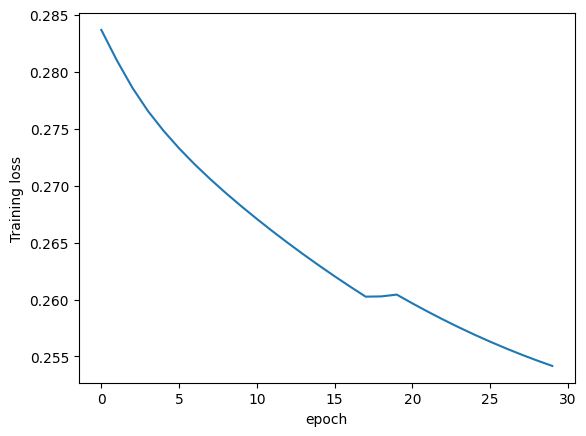

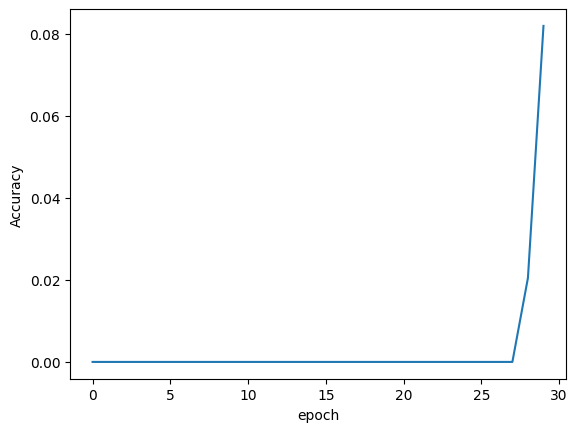

done
[]
4
20
4881


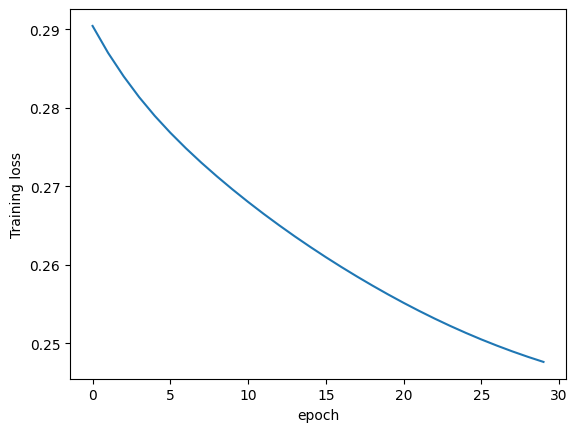

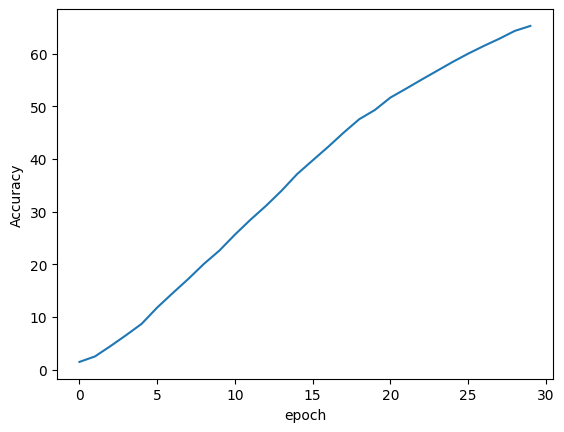

done
[]
4
tensor(18.8033, dtype=torch.float64)
tensor([36.1475, 31.4754,  0.0000,  7.7869, 18.6066], dtype=torch.float64)


In [10]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0012324323)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(30):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


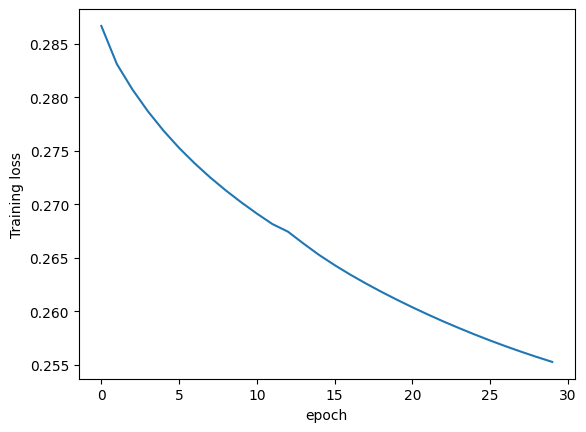

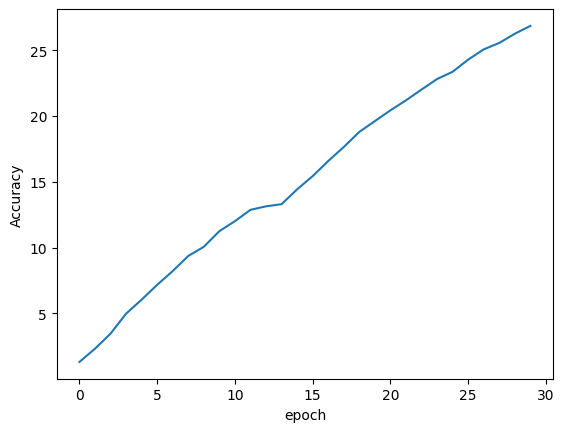

done
[]
4
20
4881


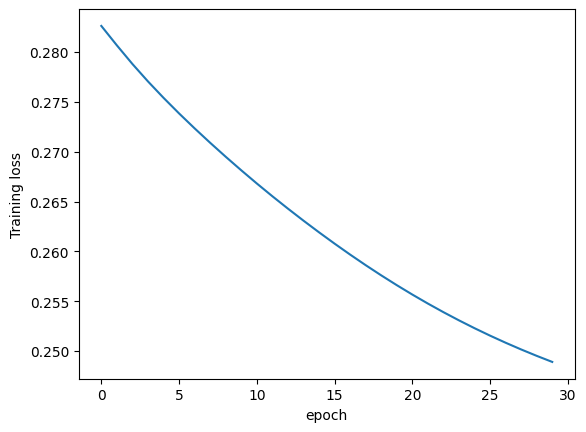

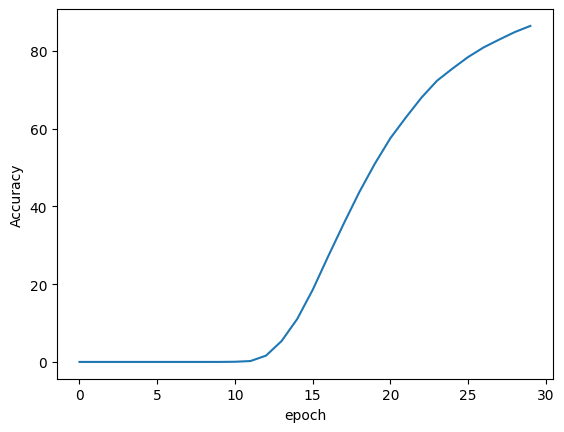

done
[]
4
20
4881


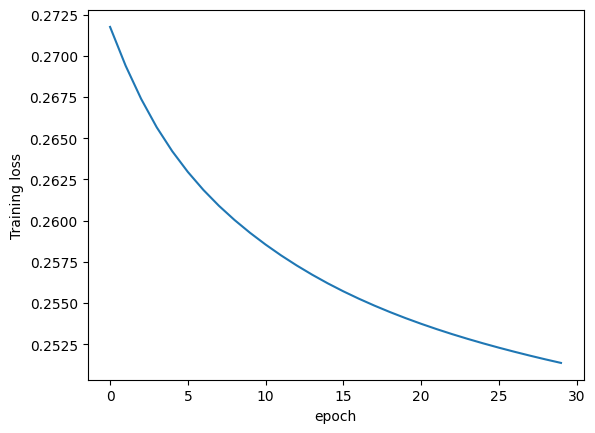

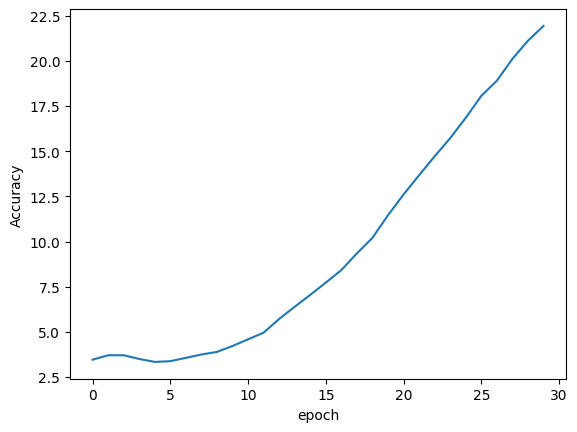

done
[]
4
20
4881


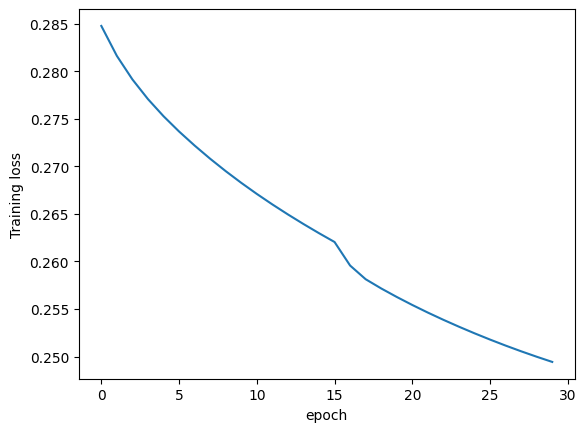

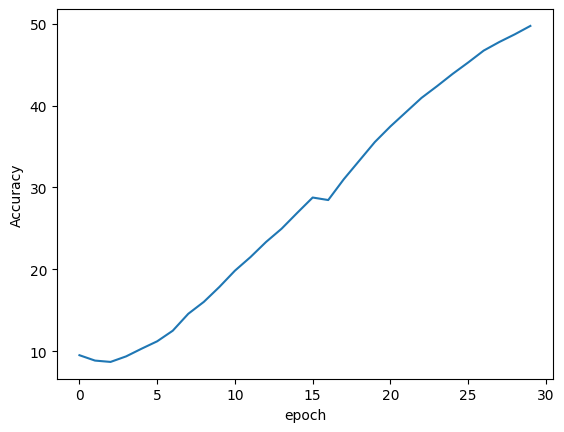

done
[]
4
20
4881


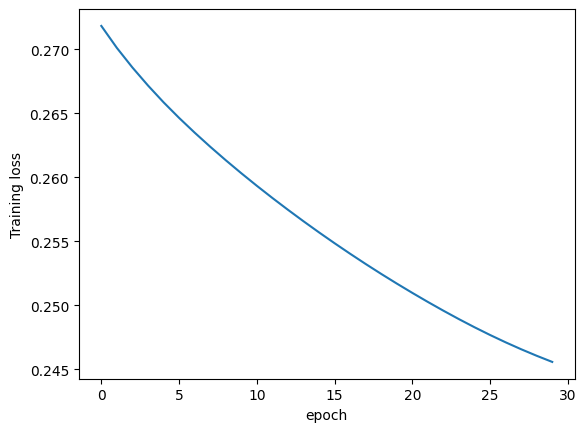

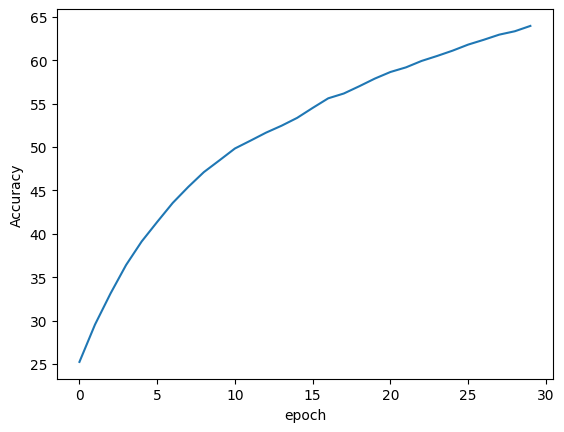

done
[]
4
tensor(3.6230, dtype=torch.float64)
tensor([3.2787, 2.0492, 0.0820, 9.3443, 3.3607], dtype=torch.float64)


In [11]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(30):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


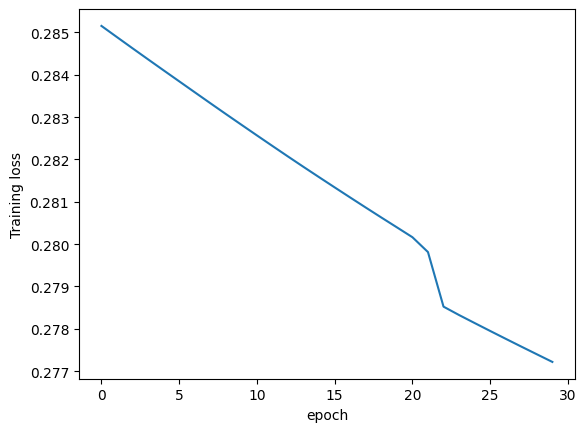

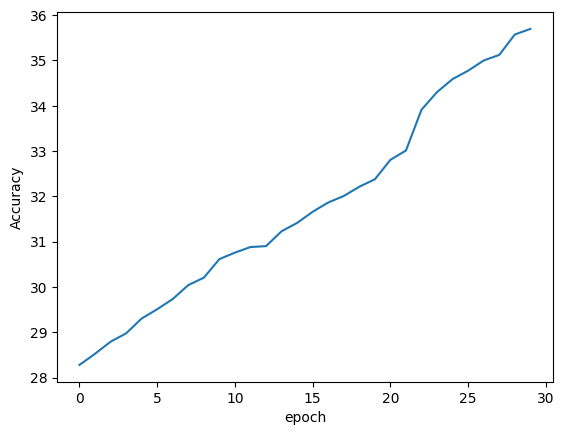

done
[]
4
20
4881


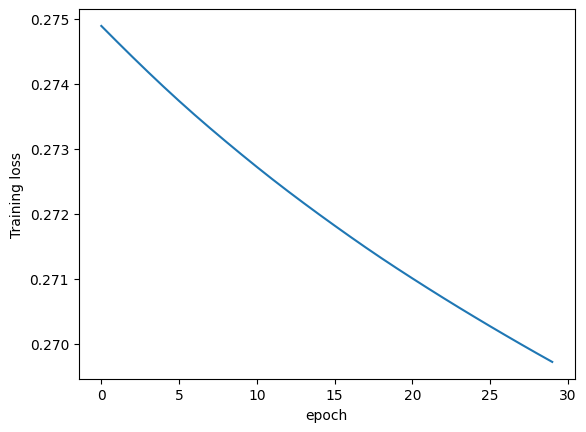

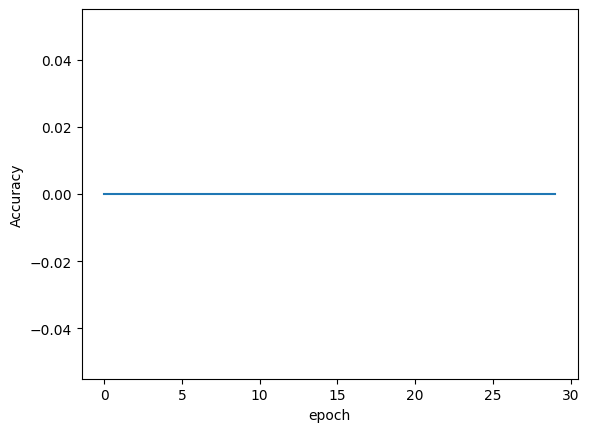

done
[]
4
20
4881


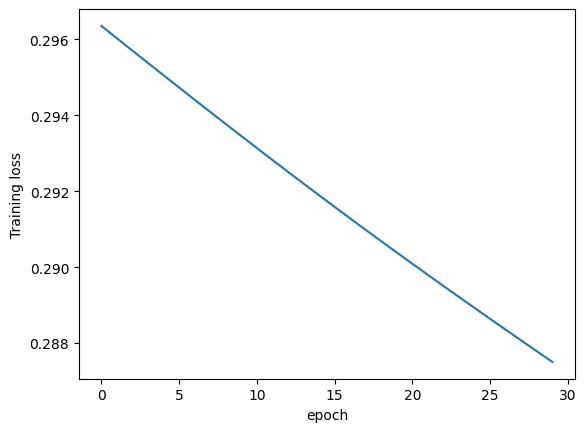

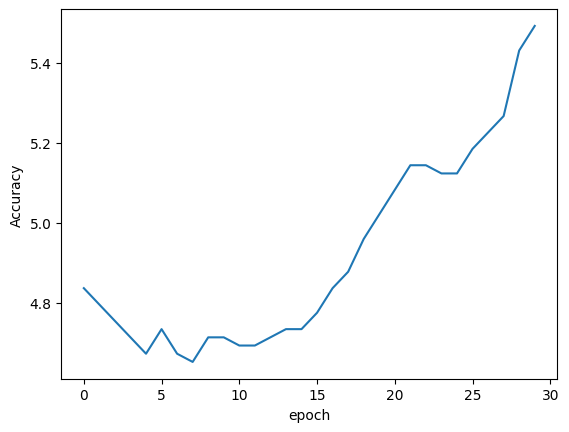

done
[]
4
20
4881


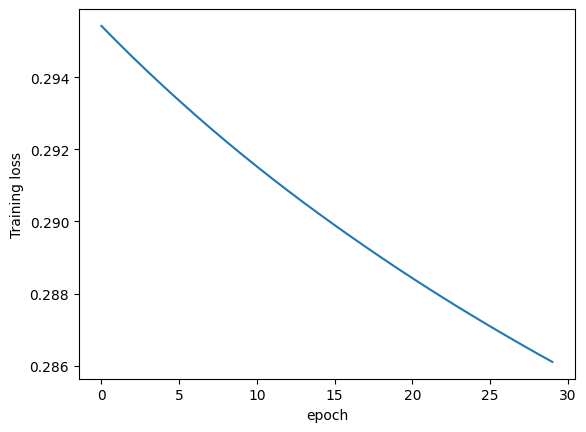

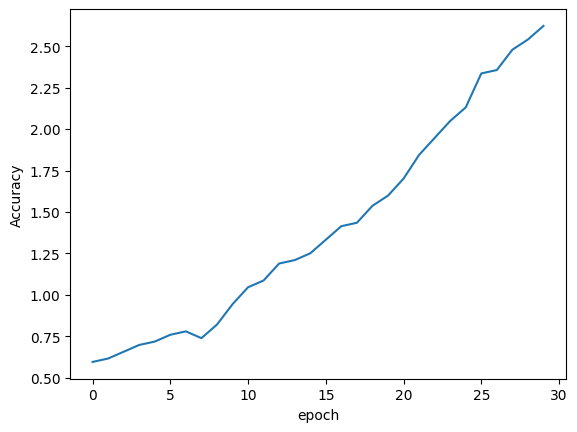

done
[]
4
20
4881


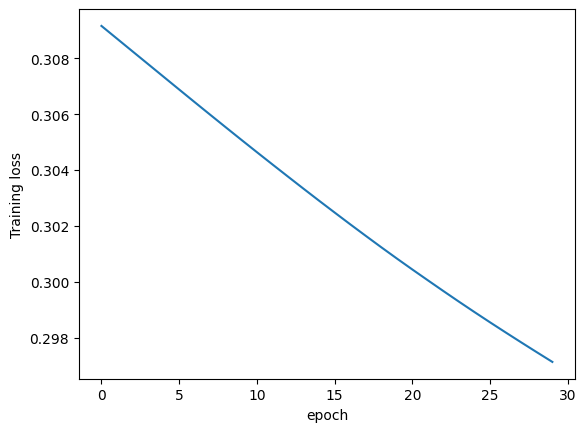

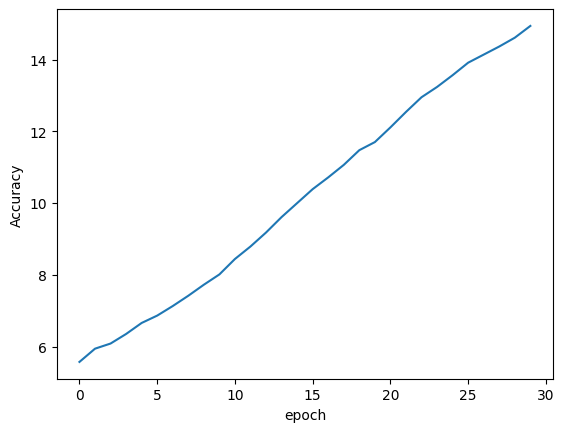

done
[]
4
tensor(22.4918, dtype=torch.float64)
tensor([92.4590,  0.9016,  2.6230, 16.0656,  0.4098], dtype=torch.float64)


In [12]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(30):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


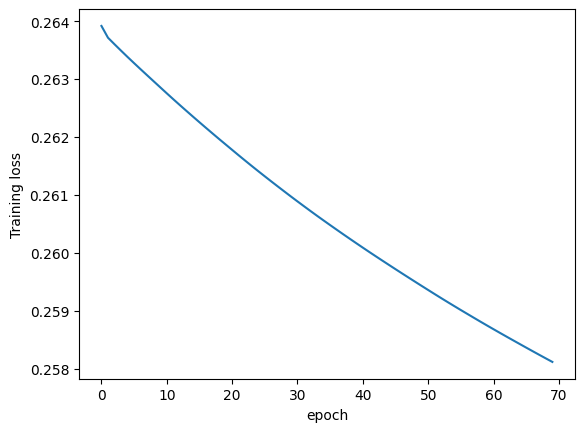

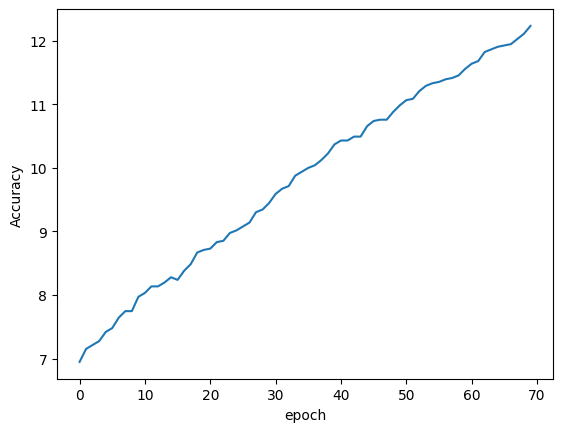

done
[]
4
20
4881


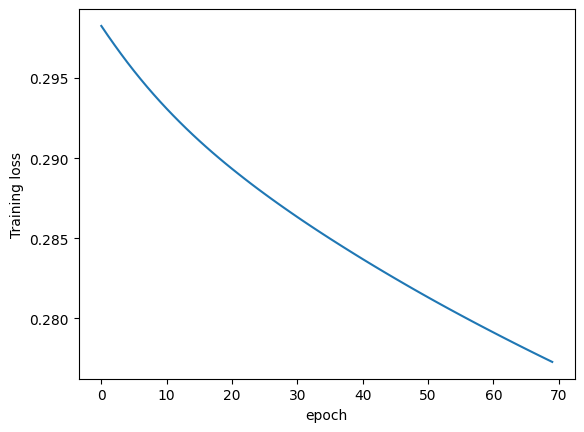

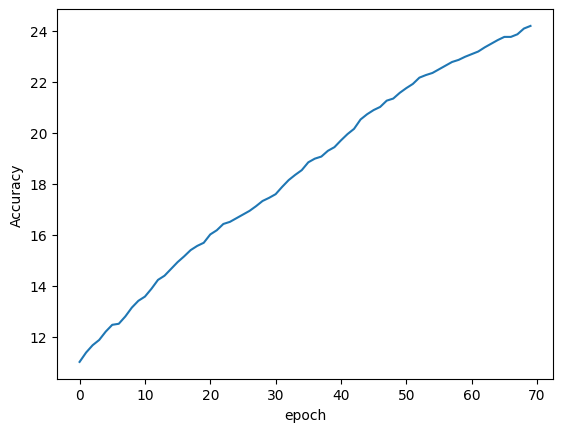

done
[]
4
20
4881


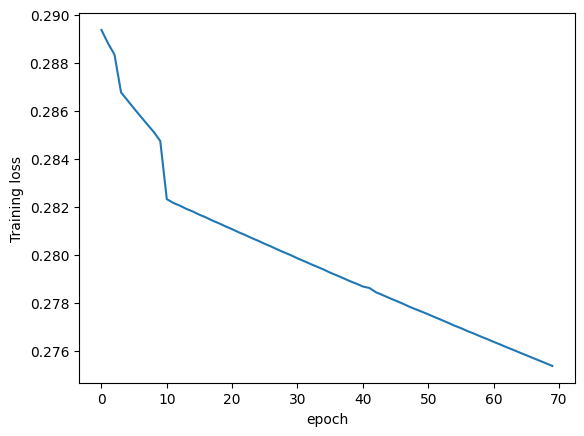

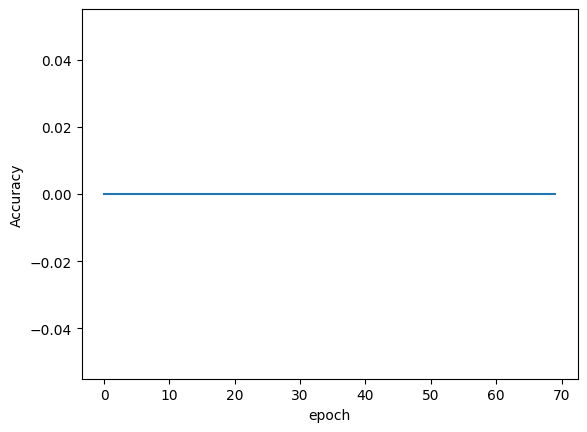

done
[]
4
20
4881


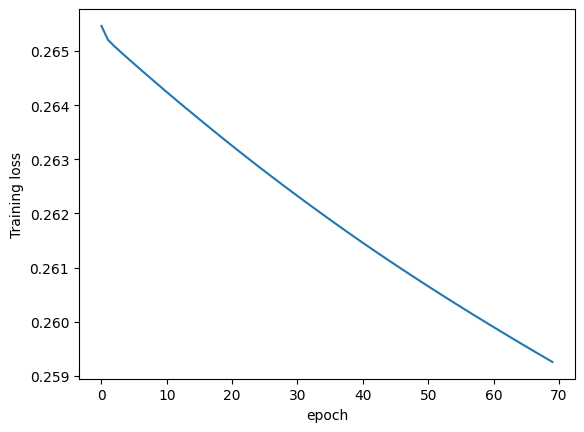

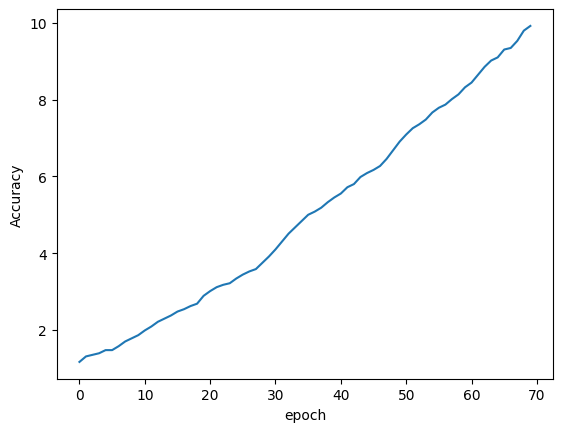

done
[]
4
20
4881


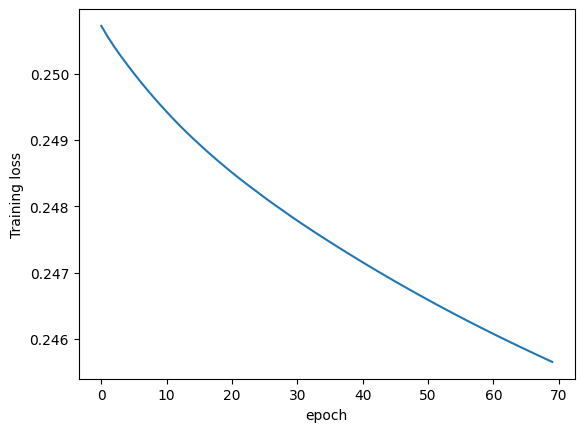

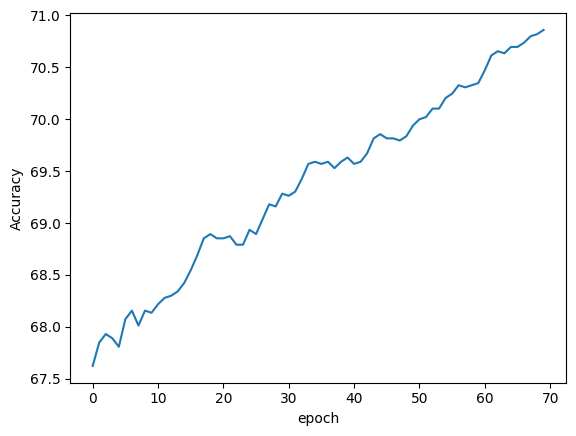

done
[]
4
tensor(4.0492, dtype=torch.float64)
tensor([ 0.2459,  1.5574,  0.2459, 16.8852,  1.3115], dtype=torch.float64)


In [13]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


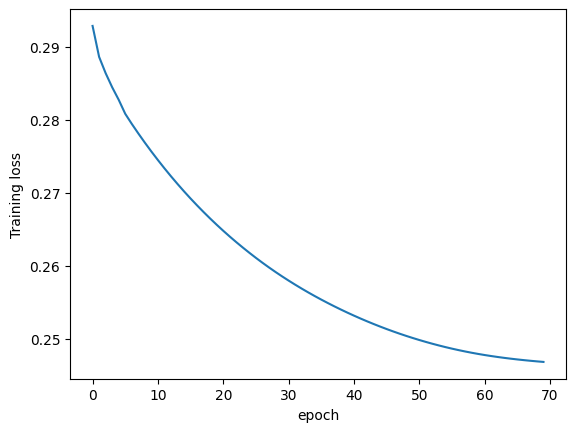

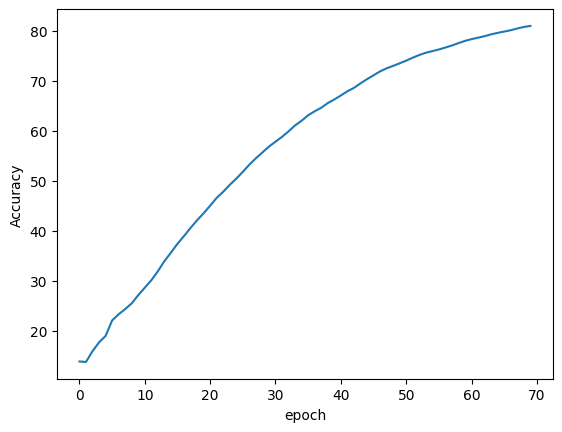

done
[]
4
20
4881


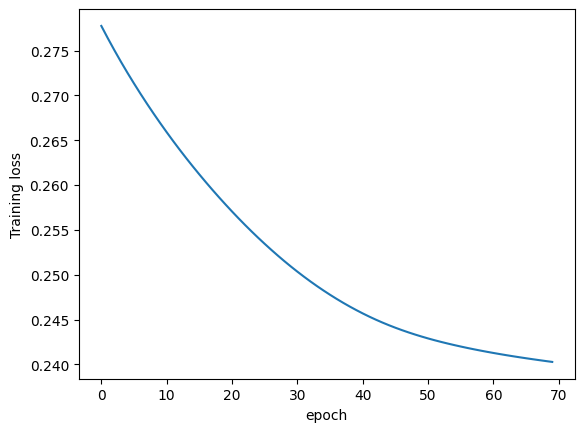

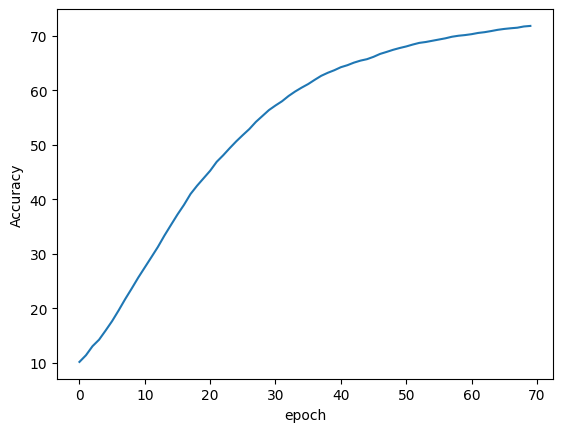

done
[]
4
20
4881


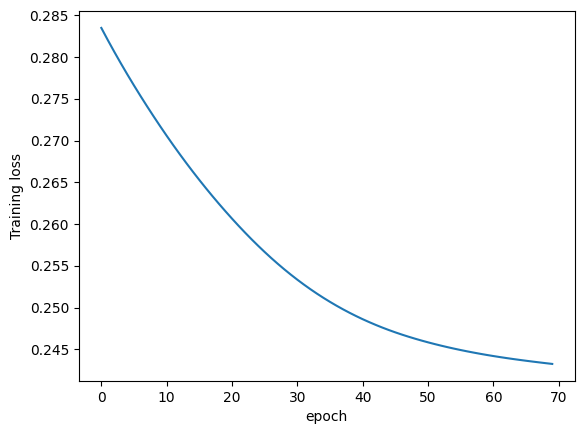

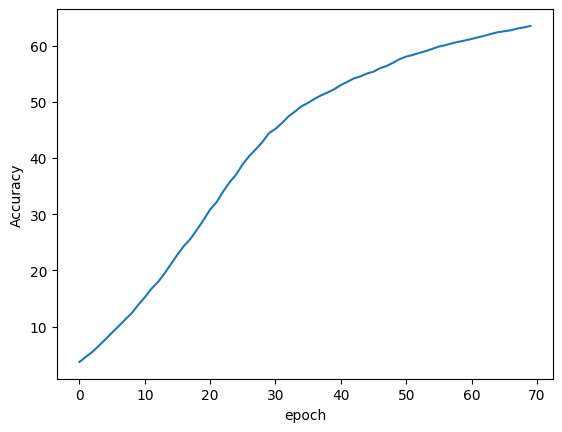

done
[]
4
20
4881


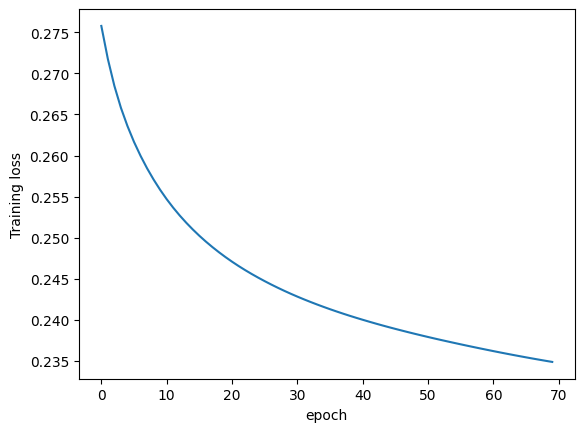

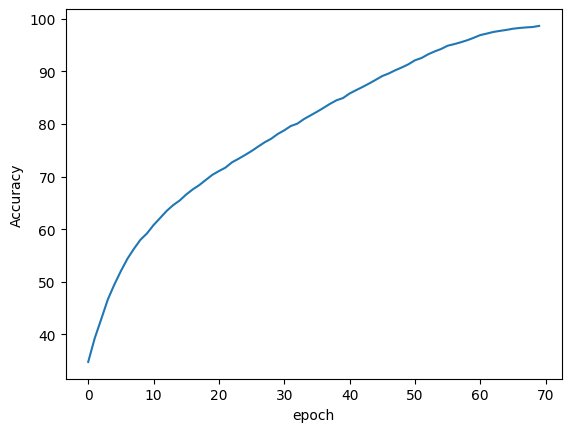

done
[]
4
20
4881


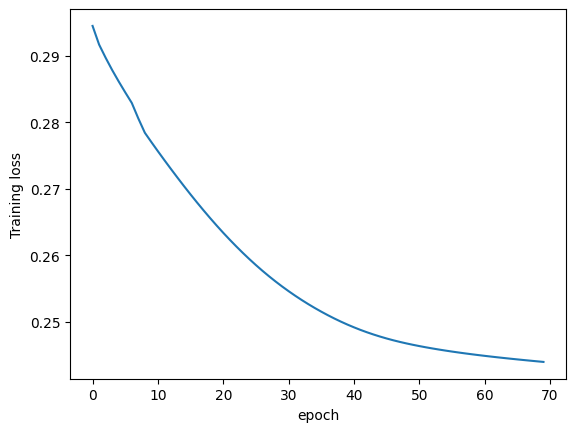

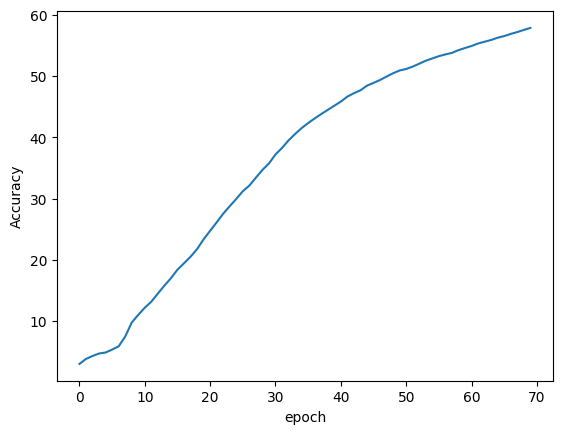

done
[]
4
tensor(0.7213, dtype=torch.float64)
tensor([0.0000, 0.0820, 3.0328, 0.0000, 0.4918], dtype=torch.float64)


In [14]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid()
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


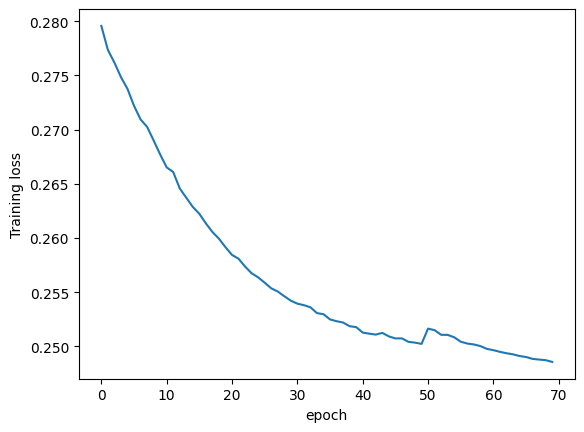

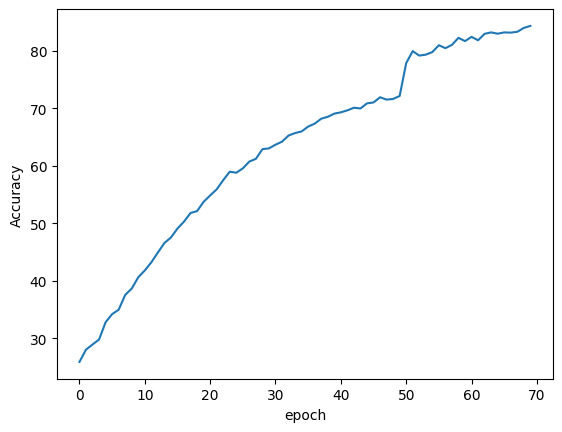

done
[]
4
20
4881


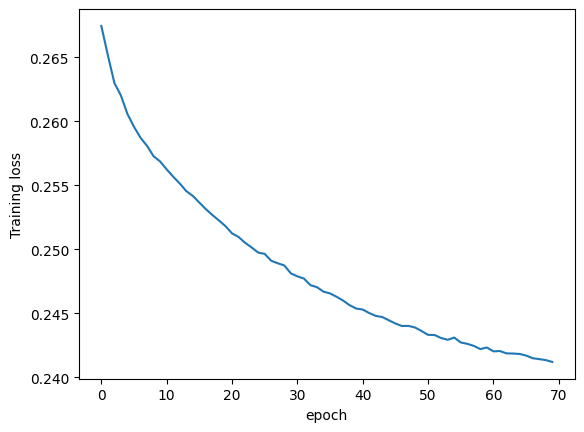

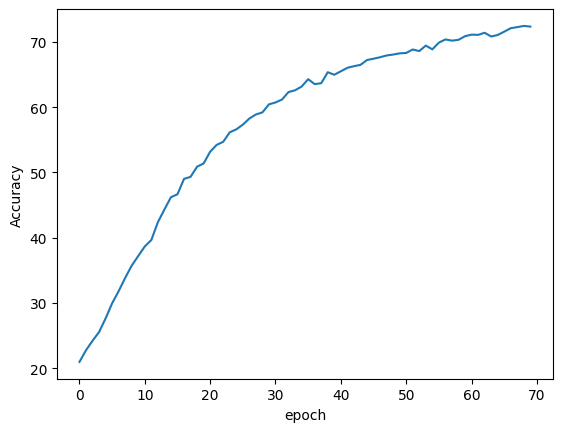

done
[]
4
20
4881


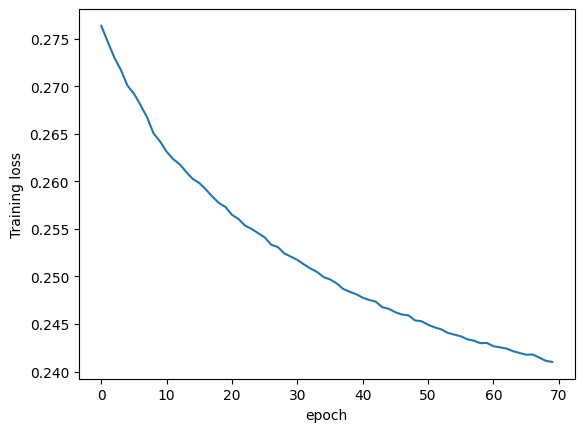

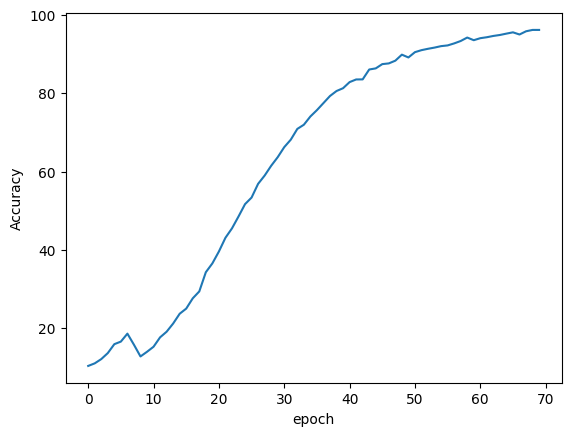

done
[]
4
20
4881


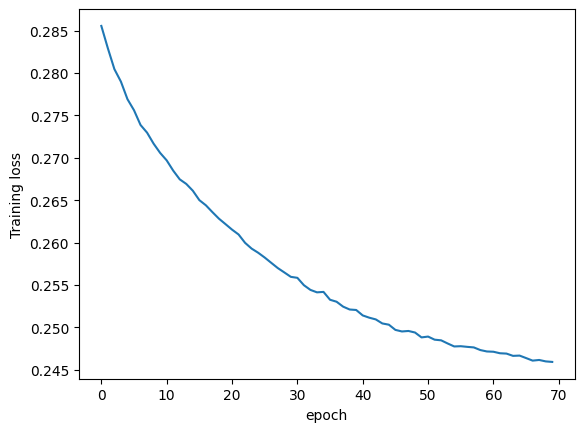

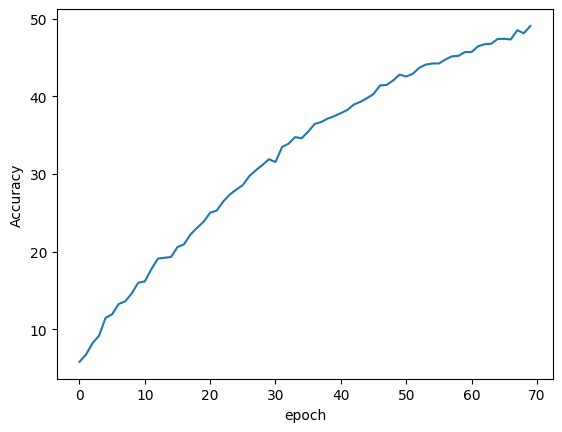

done
[]
4
20
4881


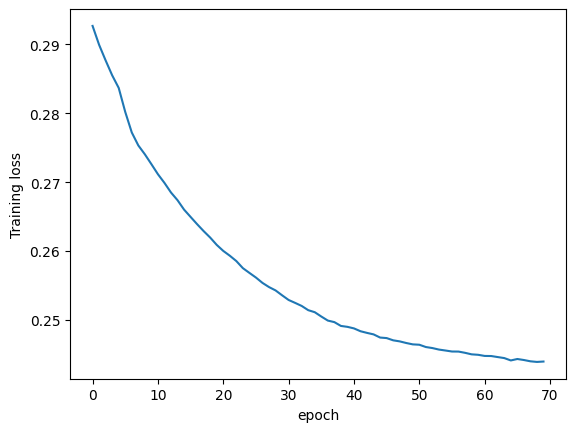

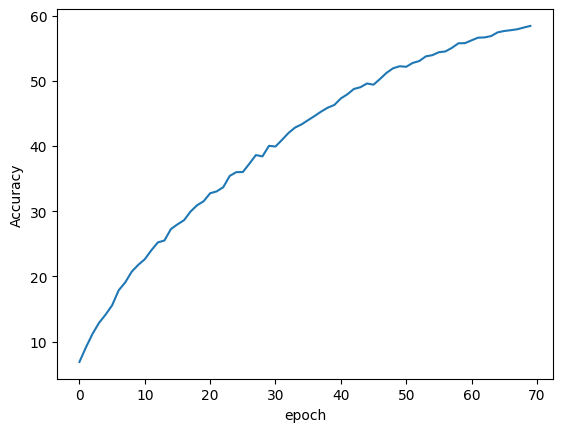

done
[]
4
tensor(9.1967, dtype=torch.float64)
tensor([ 0.3279,  3.6066,  0.1639, 41.8852,  0.0000], dtype=torch.float64)


In [15]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Dropout(p=0.2),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid(),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


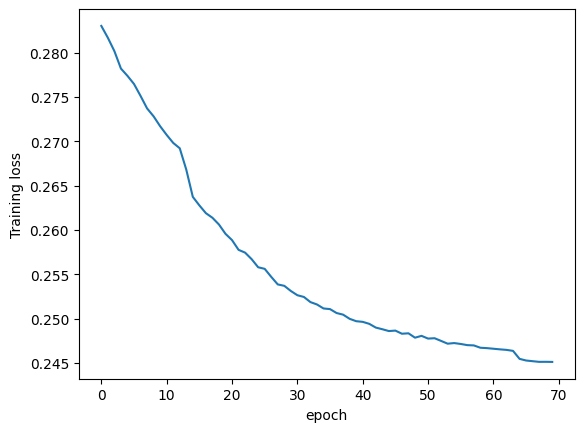

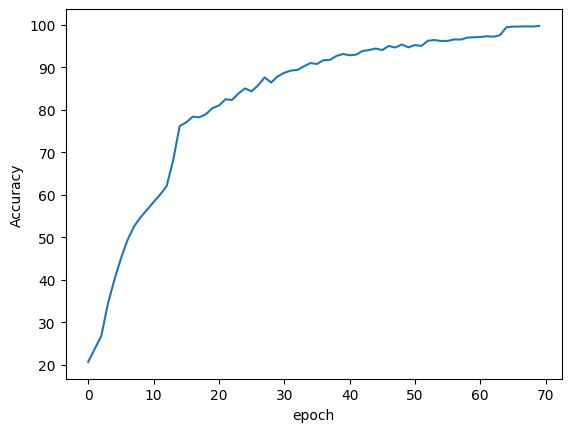

done
[]
4
20
4881


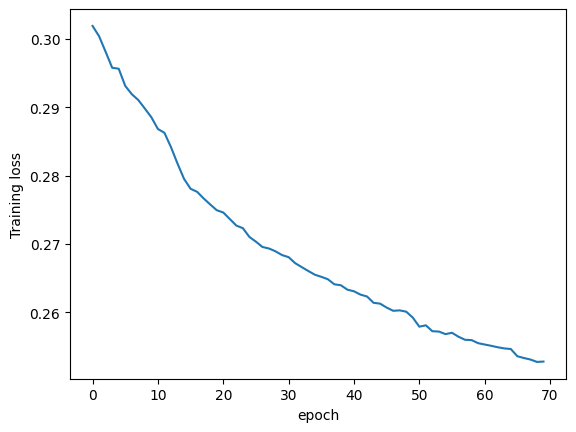

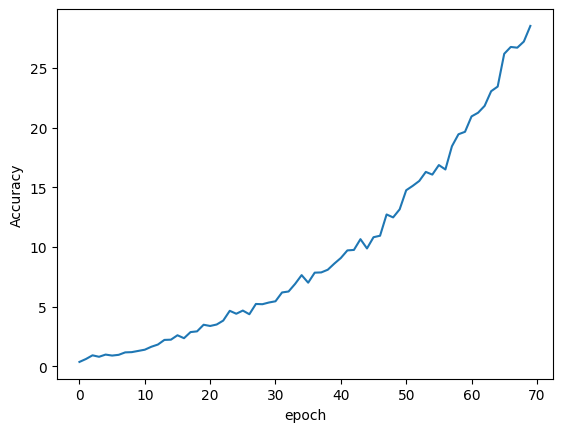

done
[]
4
20
4881


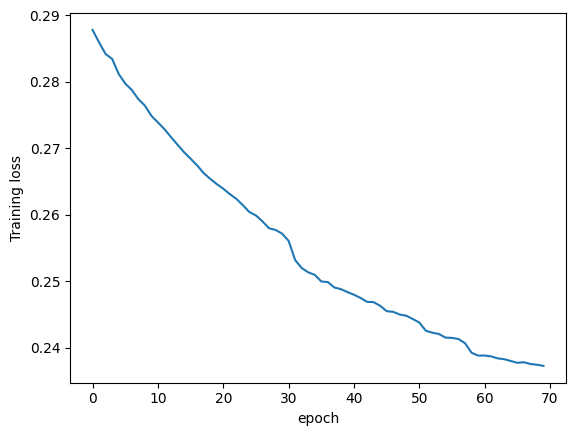

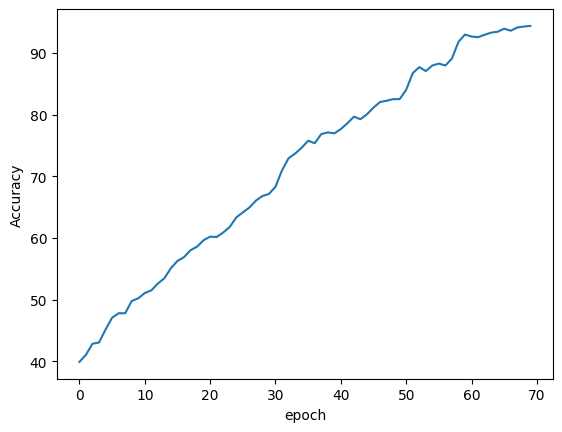

done
[]
4
20
4881


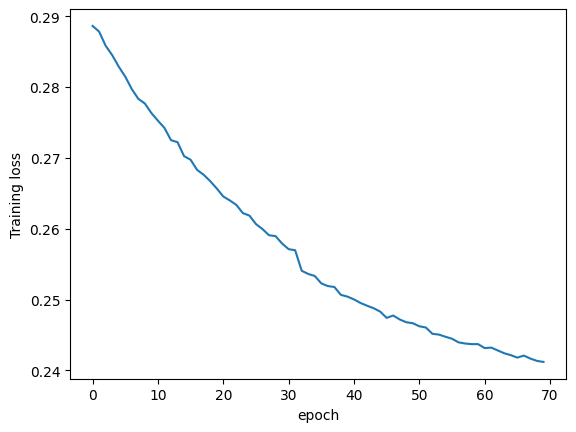

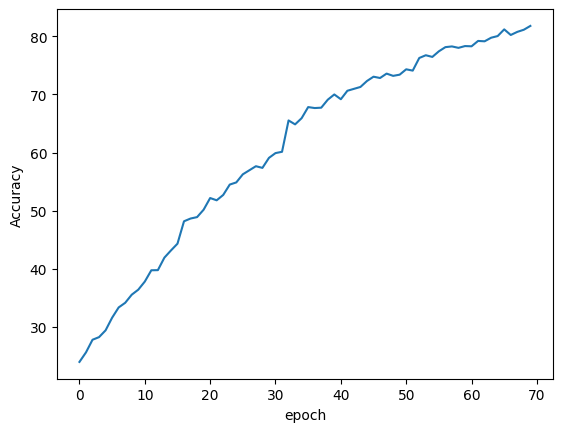

done
[]
4
20
4881


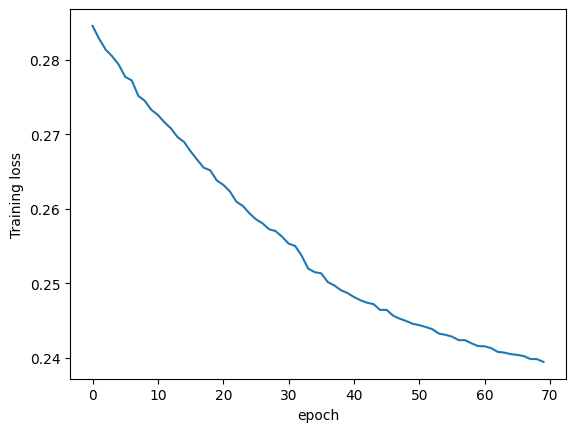

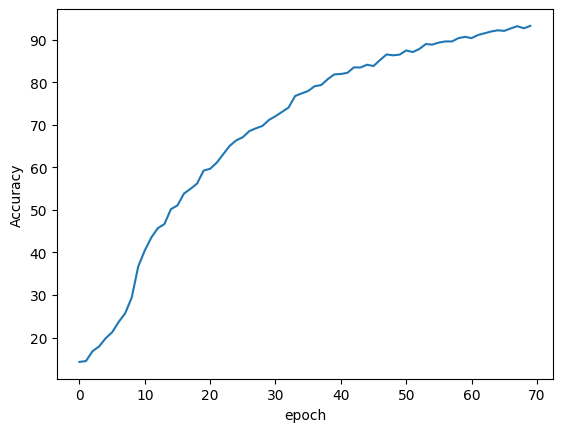

done
[]
4
tensor(0.1148, dtype=torch.float64)
tensor([0.0000, 0.3279, 0.0000, 0.2459, 0.0000], dtype=torch.float64)


In [16]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Dropout(p=0.6),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid(),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


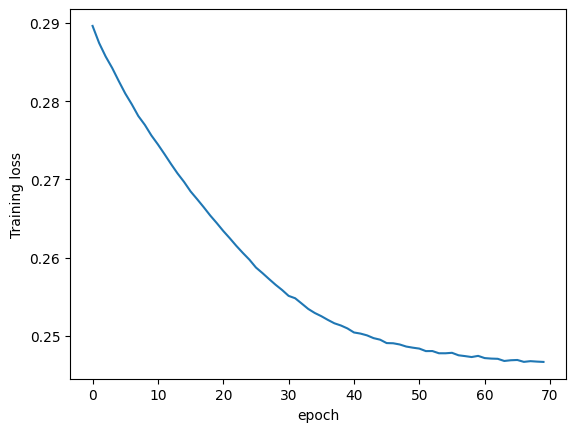

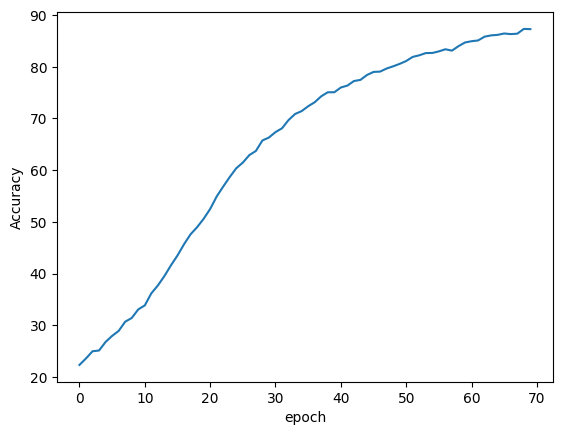

done
[]
4
20
4881


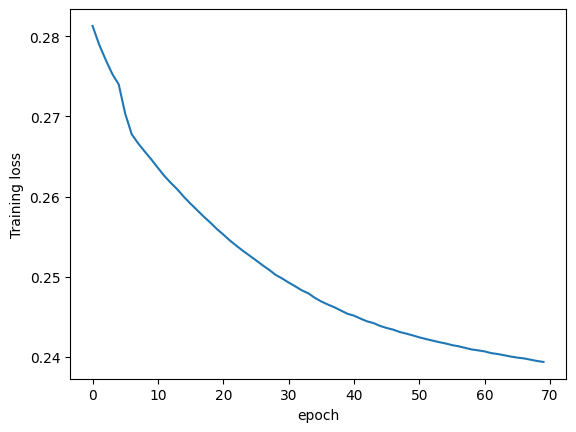

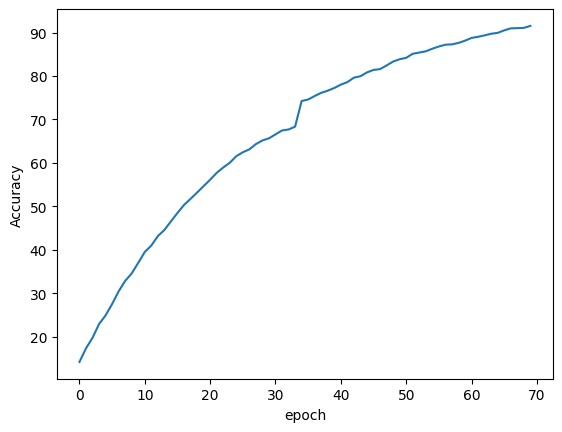

done
[]
4
20
4881


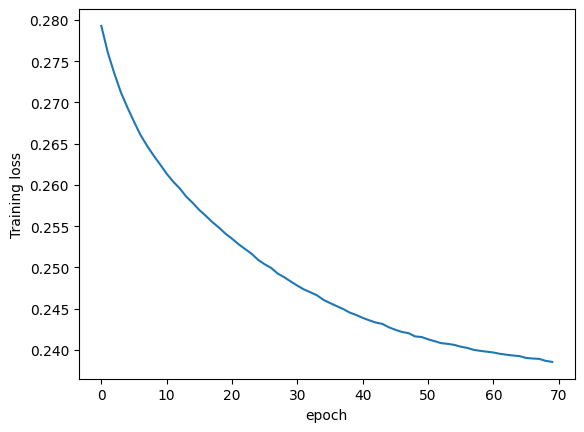

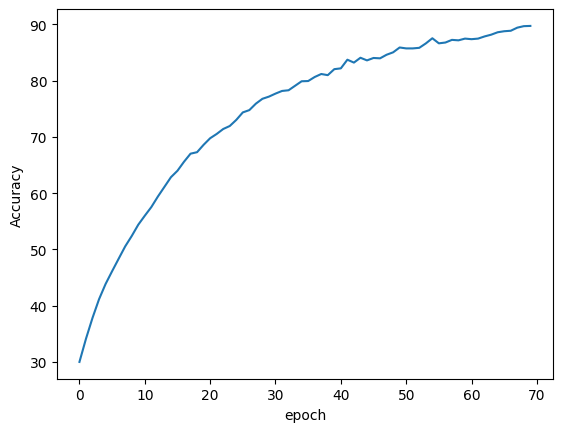

done
[]
4
20
4881


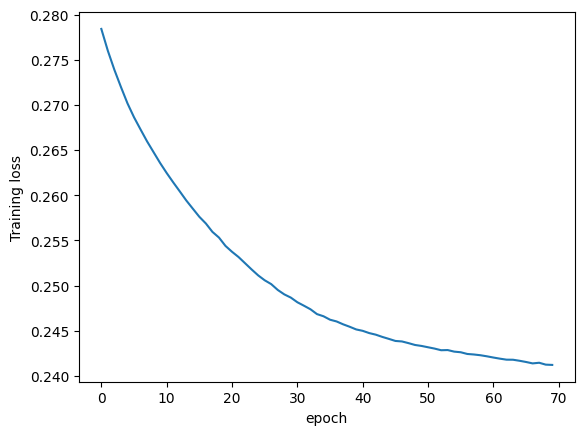

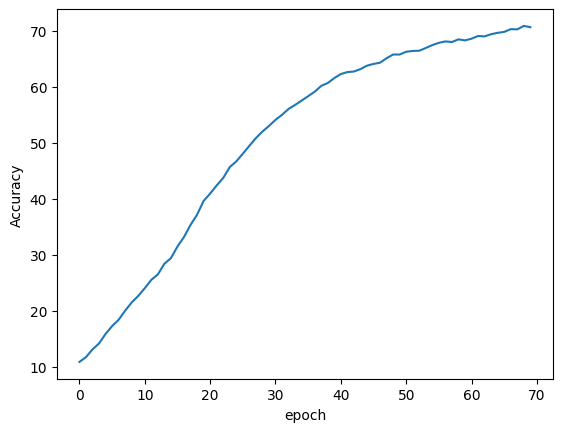

done
[]
4
20
4881


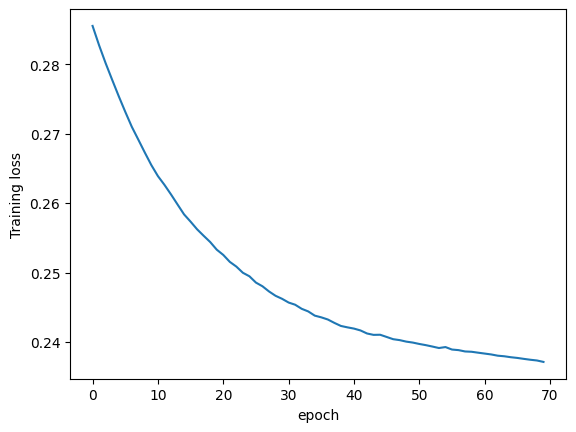

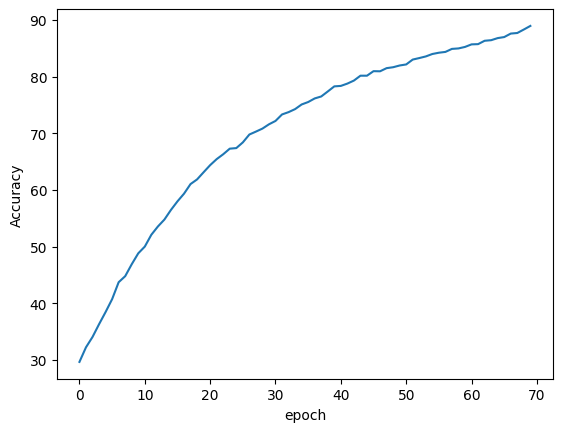

done
[]
4
tensor(0.0164, dtype=torch.float64)
tensor([0.0000, 0.0820, 0.0000, 0.0000, 0.0000], dtype=torch.float64)


In [17]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Dropout(p=0.05),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Sigmoid(),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.MSELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


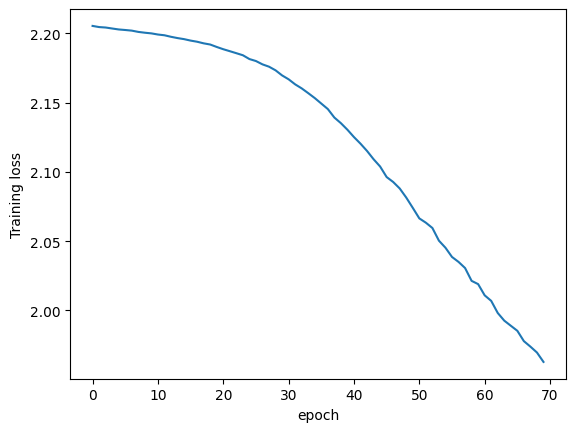

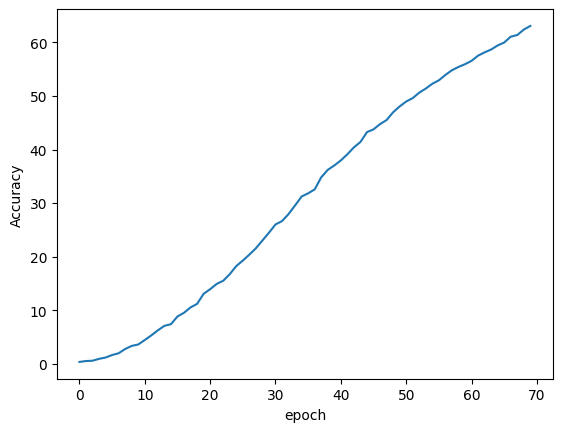

done
[]
4
20
4881


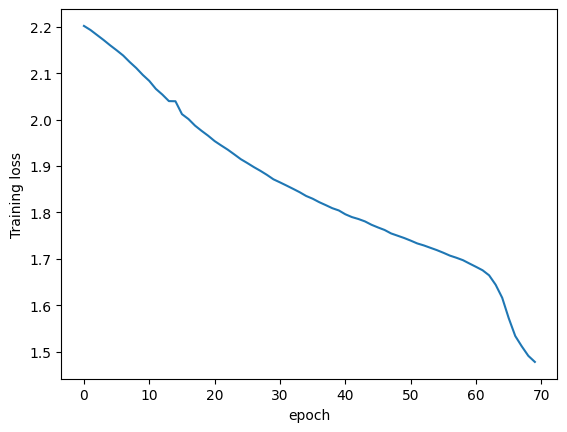

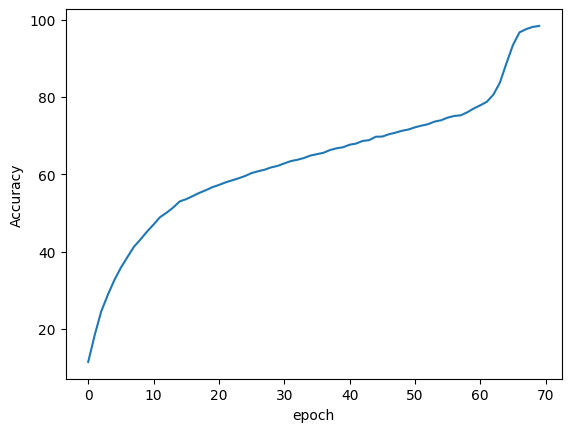

done
[]
4
20
4881


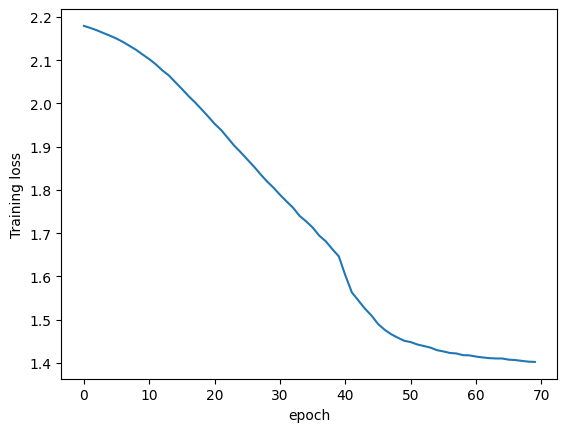

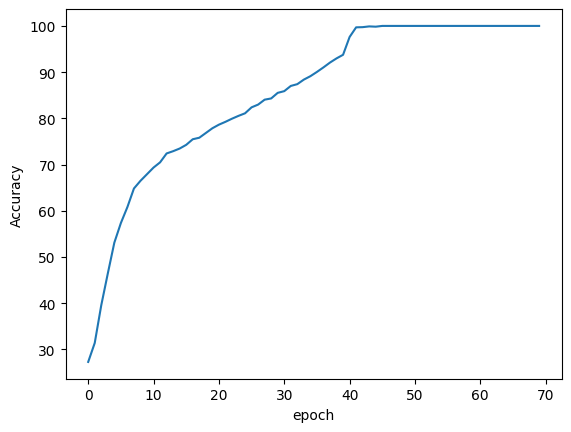

done
[]
4
20
4881


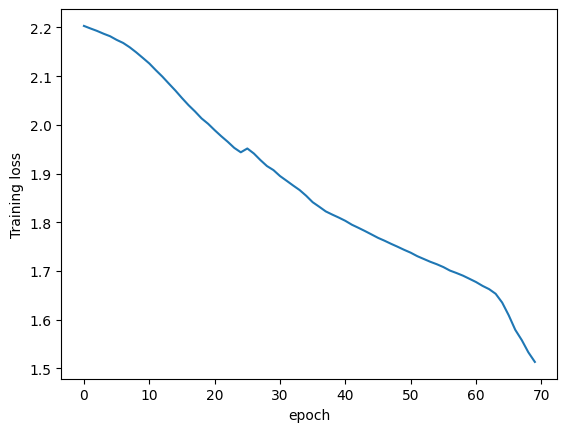

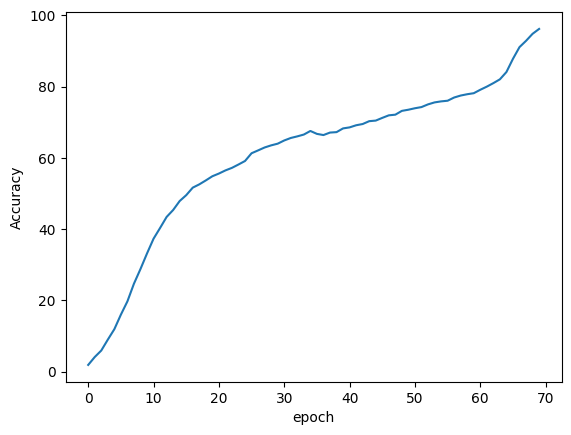

done
[]
4
20
4881


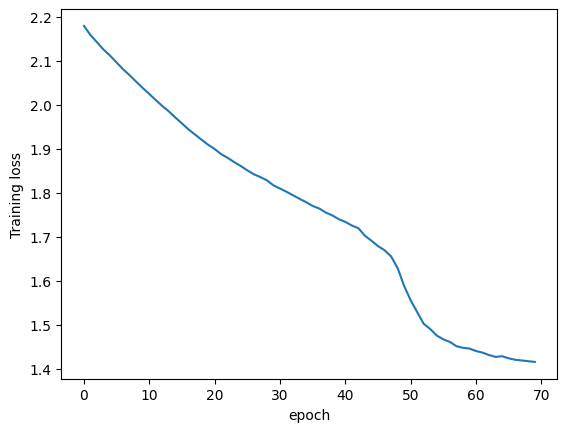

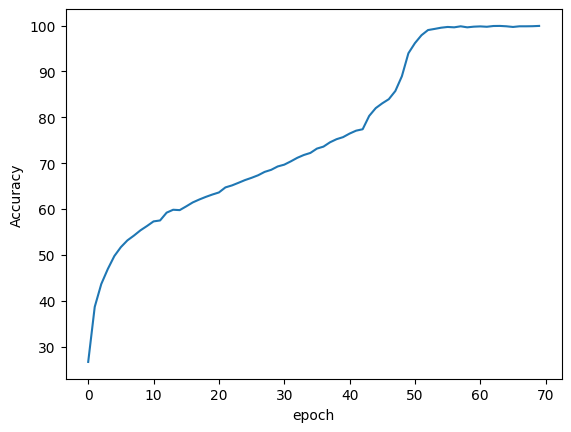

done
[]
4
tensor(0.5410, dtype=torch.float64)
tensor([0.0000, 0.0000, 0.0000, 2.4590, 0.2459], dtype=torch.float64)


In [18]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Dropout(p=0.2),
        nn.Linear(in_features=10 ,out_features=9),
        nn.LeakyReLU(),
        nn.Softmax(dim=1),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


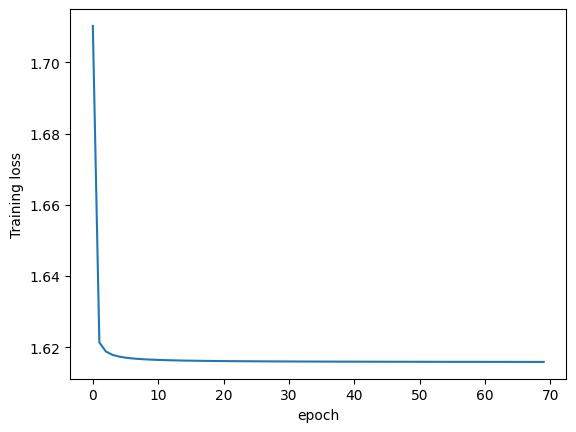

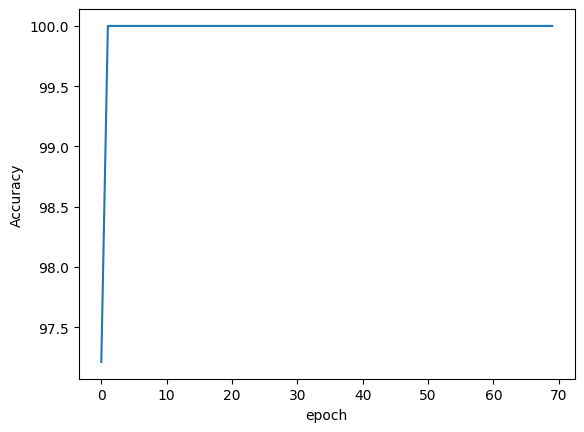

done
[]
4
20
4881


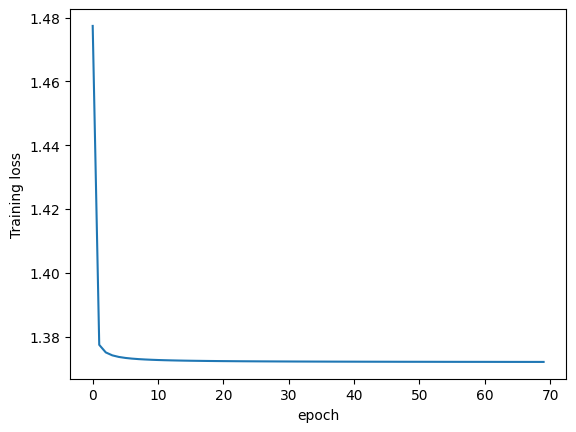

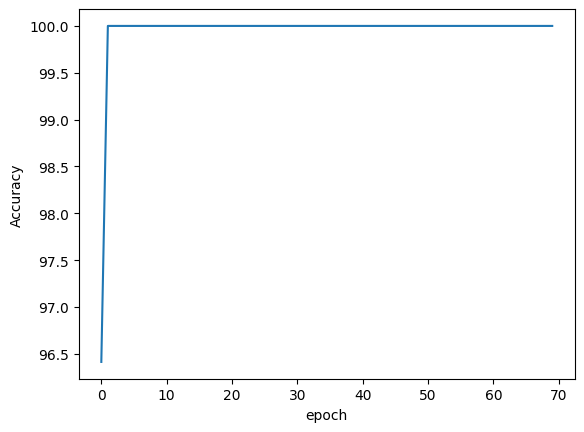

done
[]
4
20
4881


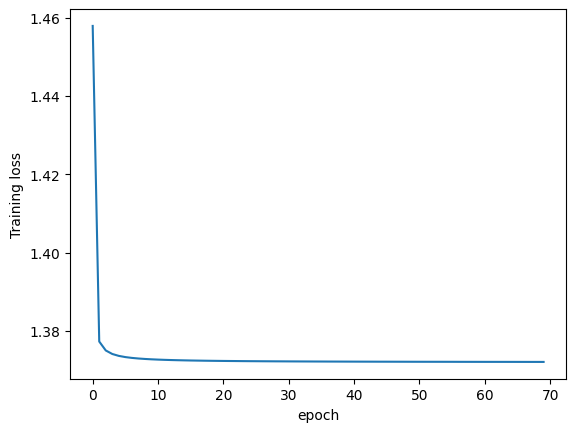

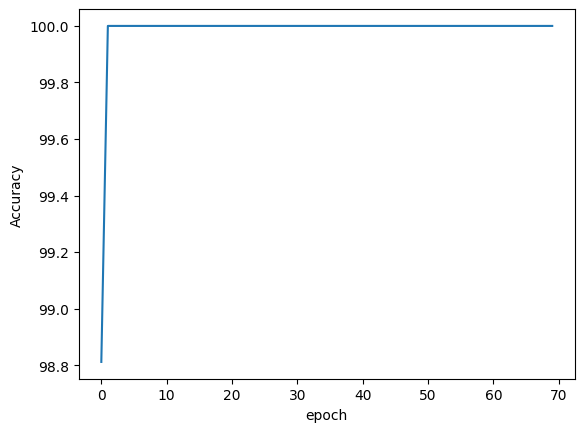

done
[]
4
20
4881


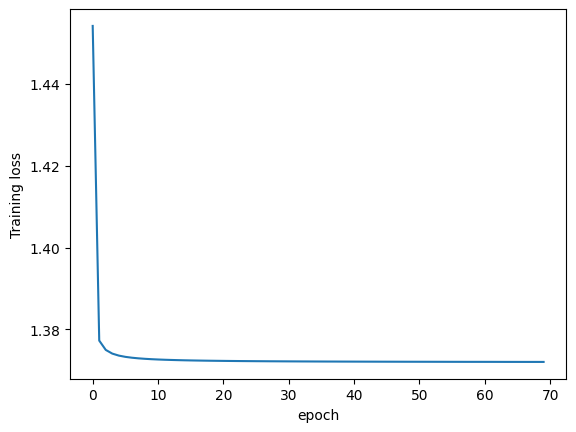

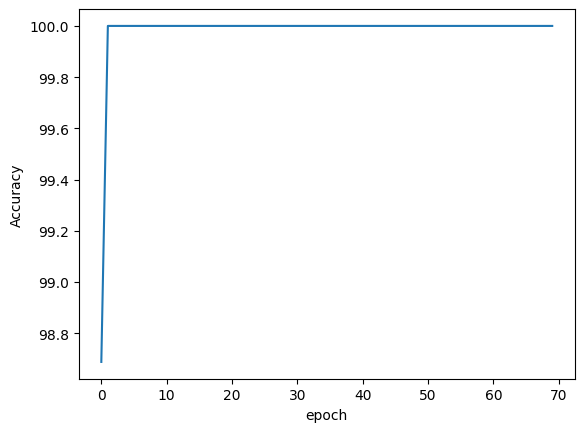

done
[]
4
20
4881


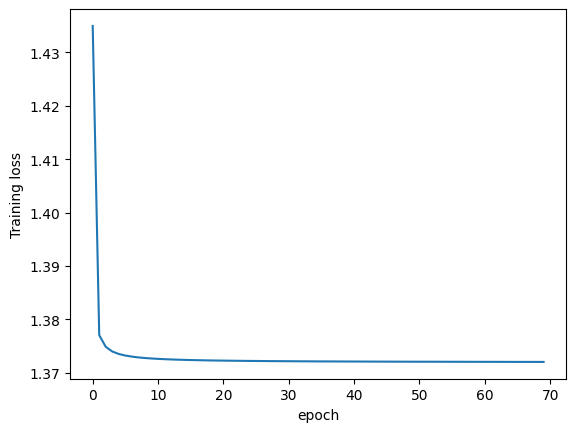

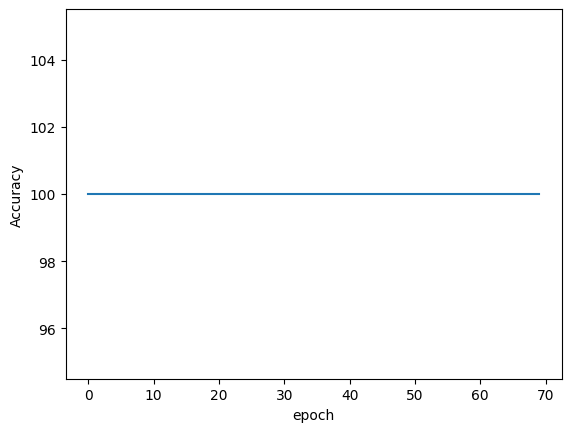

done
[]
4
tensor(0., dtype=torch.float64)
tensor([0., 0., 0., 0., 0.], dtype=torch.float64)


In [19]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=9),
        #nn.LeakyReLU(),
        nn.Softmax(dim=1),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


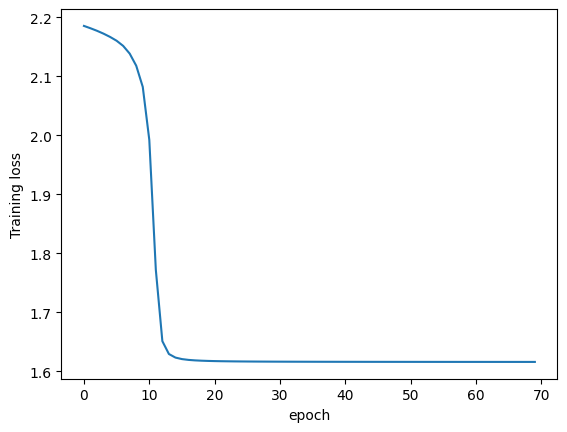

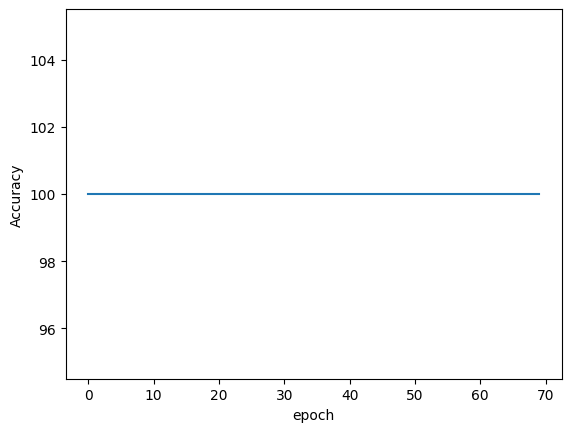

done
[]
4
20
4881


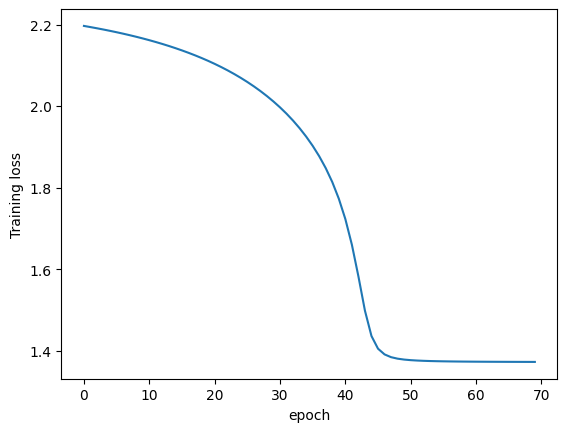

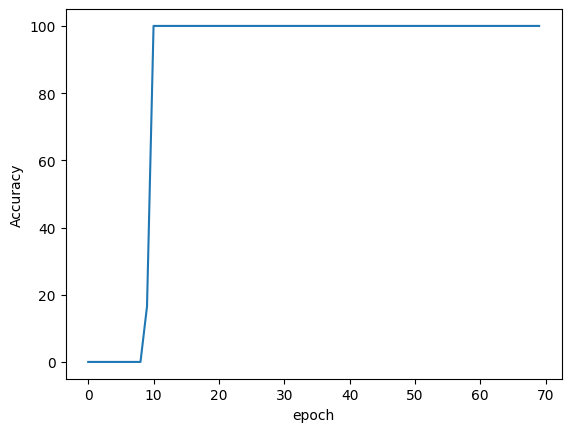

done
[]
4
20
4881


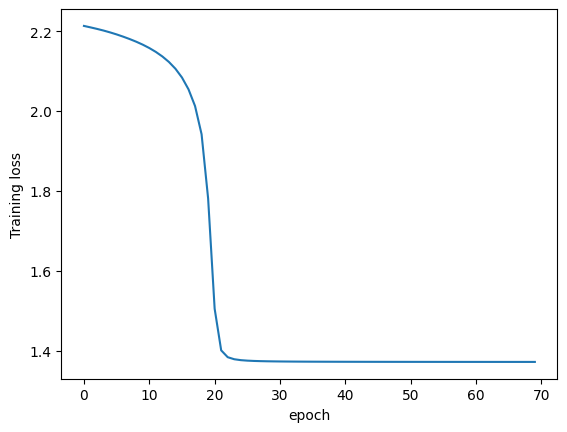

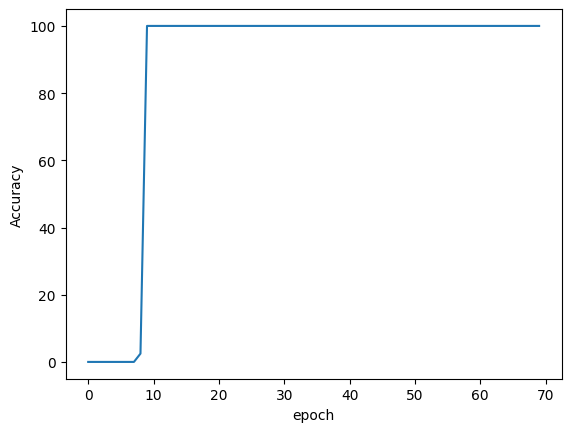

done
[]
4
20
4881


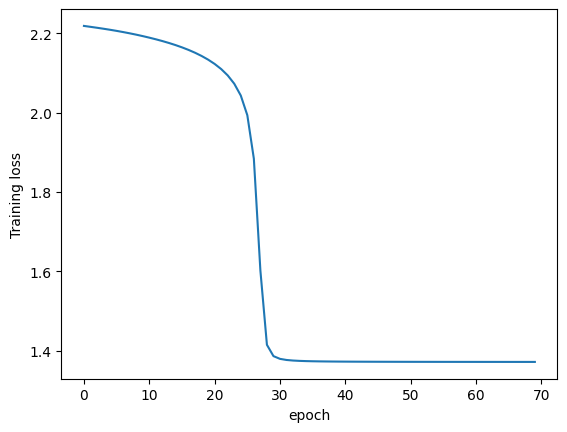

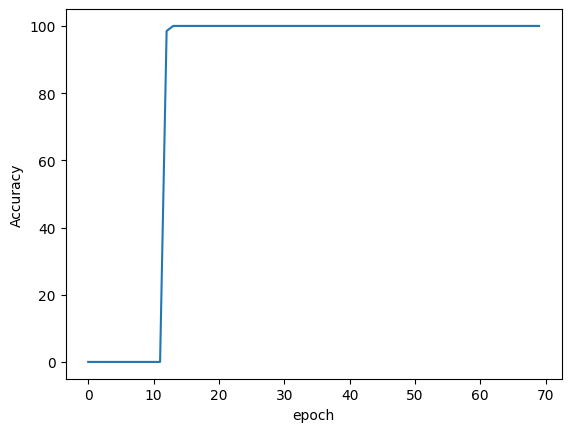

done
[]
4
20
4881


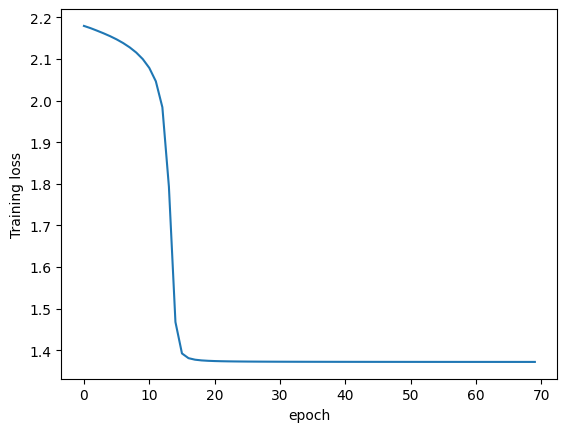

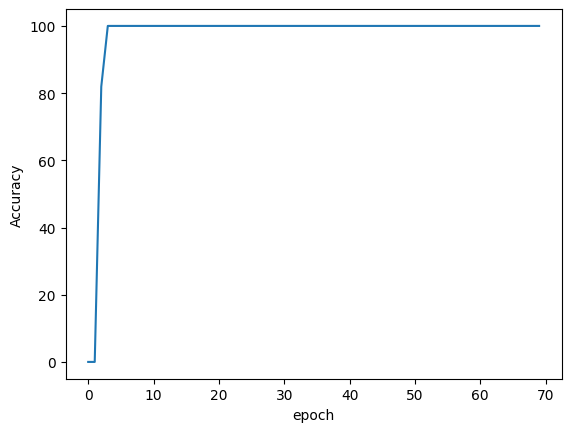

done
[]
4
tensor(0., dtype=torch.float64)
tensor([0., 0., 0., 0., 0.], dtype=torch.float64)


In [20]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1),
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


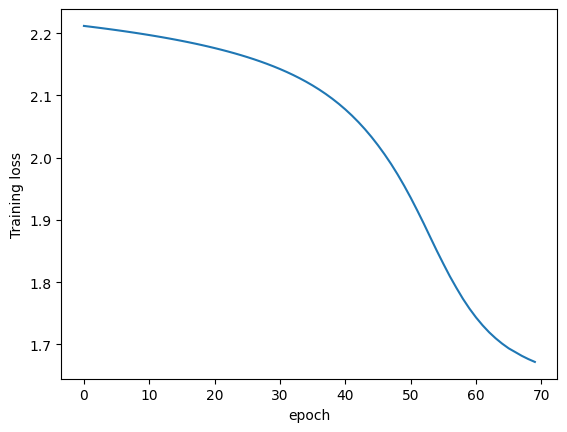

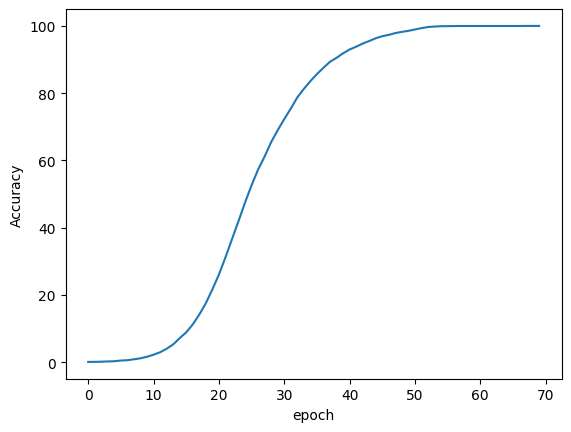

done
[]
4
20
4881


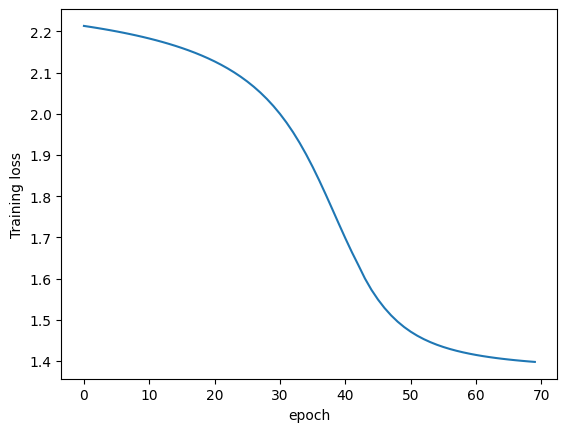

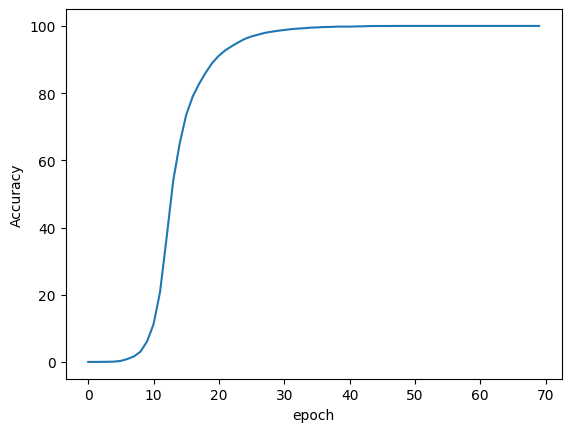

done
[]
4
20
4881


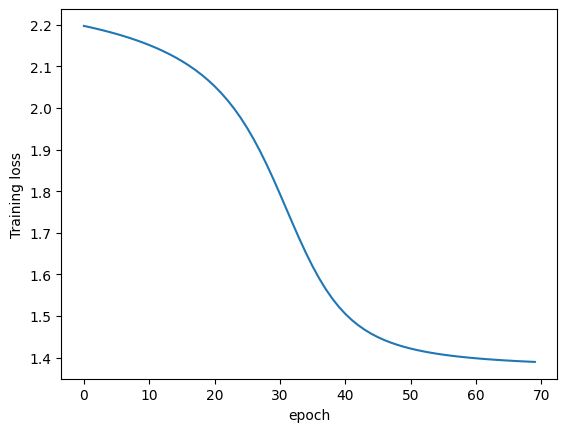

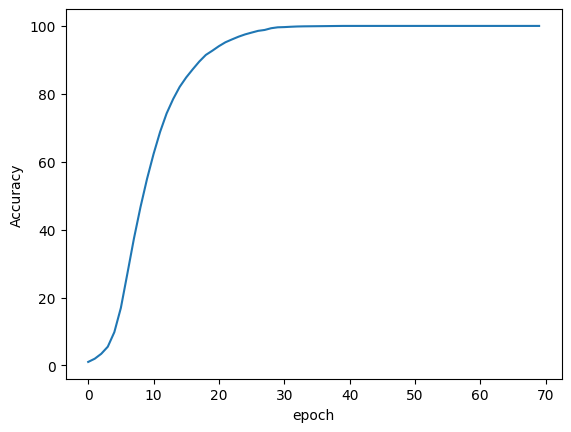

done
[]
4
20
4881


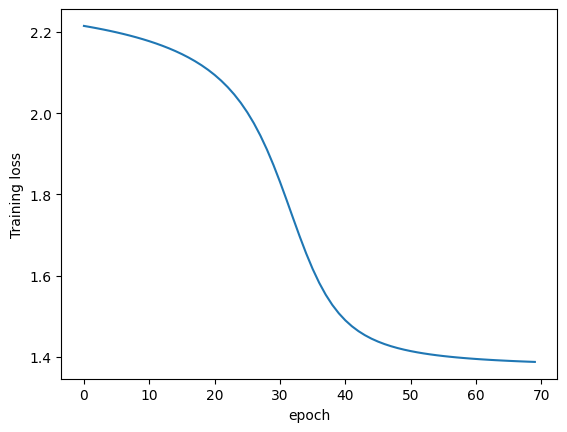

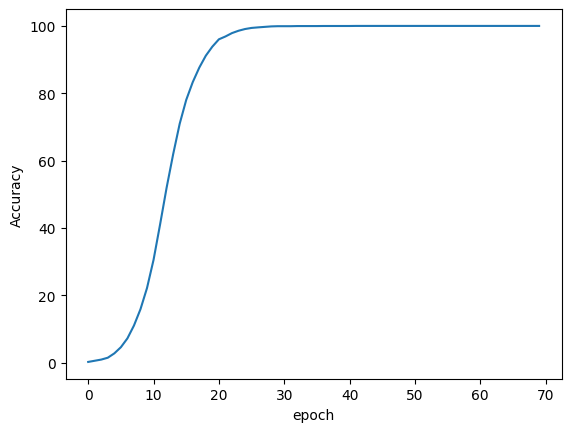

done
[]
4
20
4881


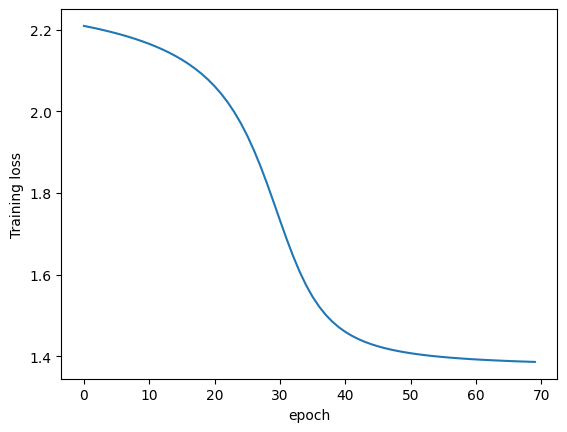

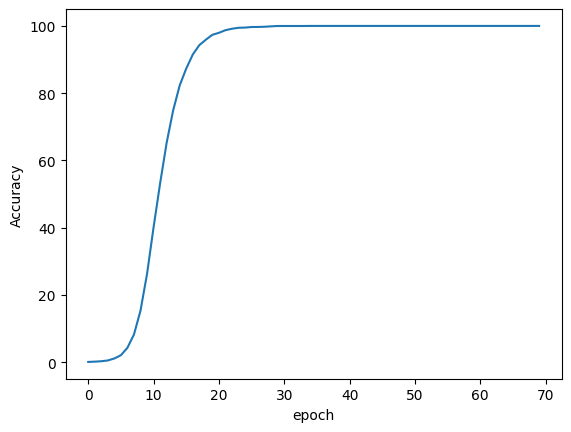

done
[]
4
tensor(6.0984, dtype=torch.float64)
tensor([ 0.0000,  0.1639,  0.0000, 30.3279,  0.0000], dtype=torch.float64)


In [23]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(70):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


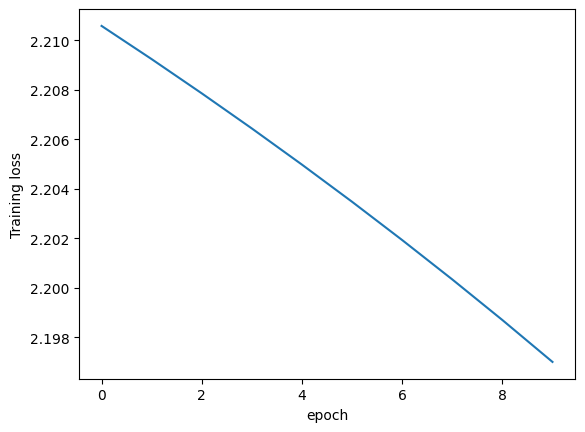

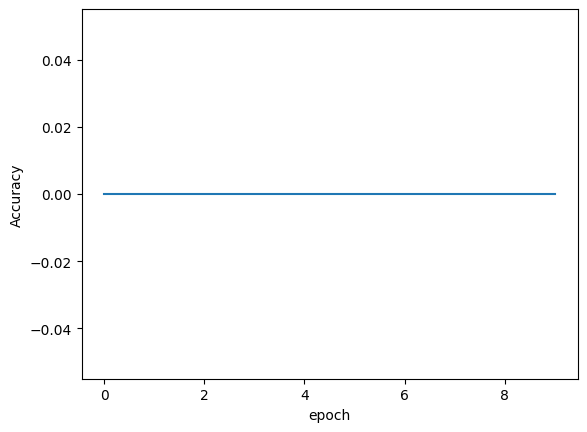

done
[]
4
20
4881


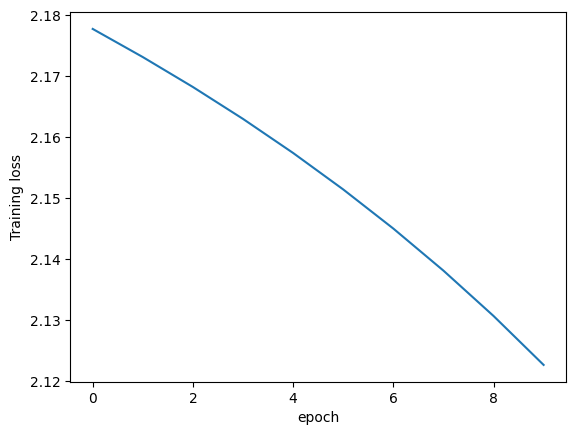

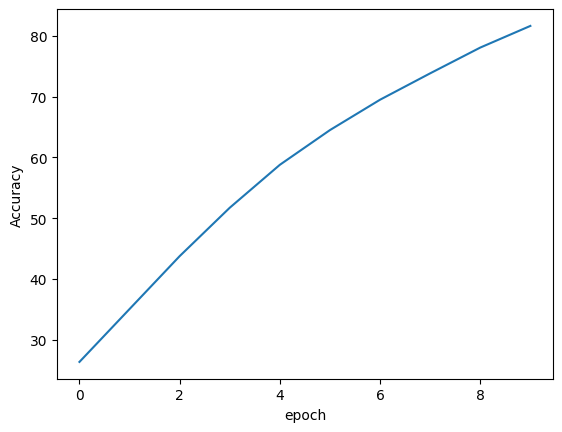

done
[]
4
20
4881


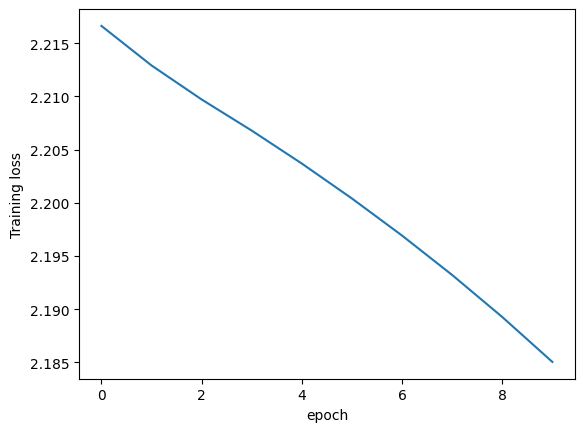

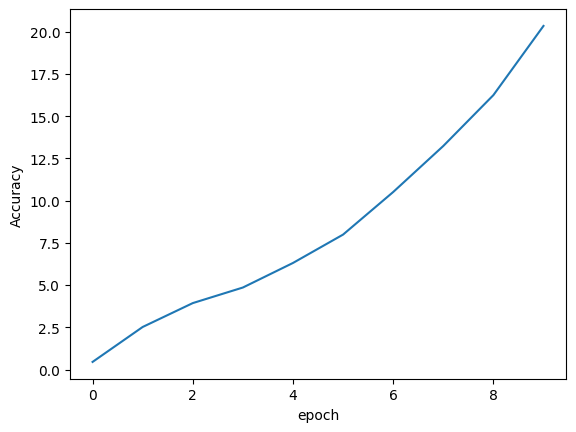

done
[]
4
20
4881


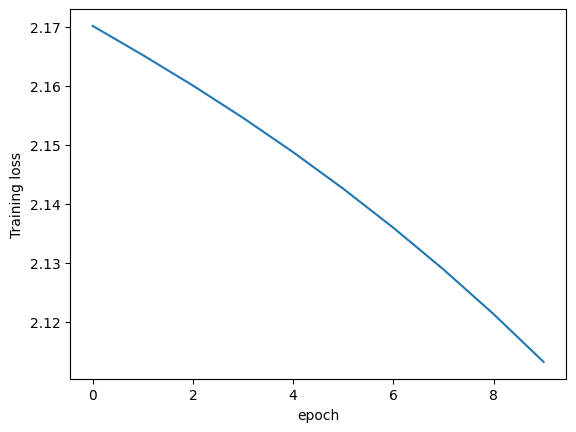

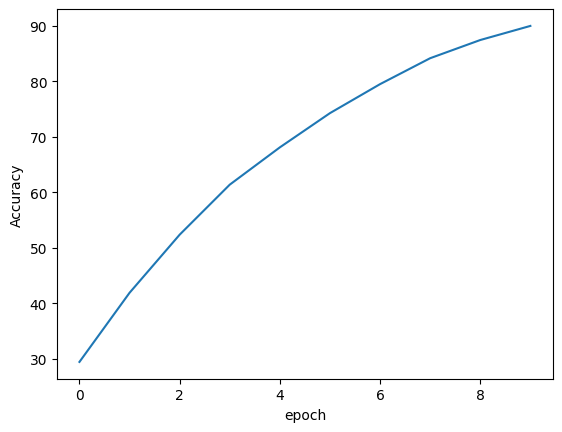

done
[]
4
20
4881


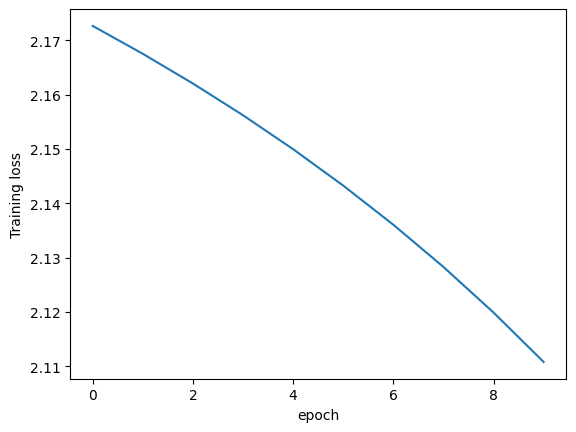

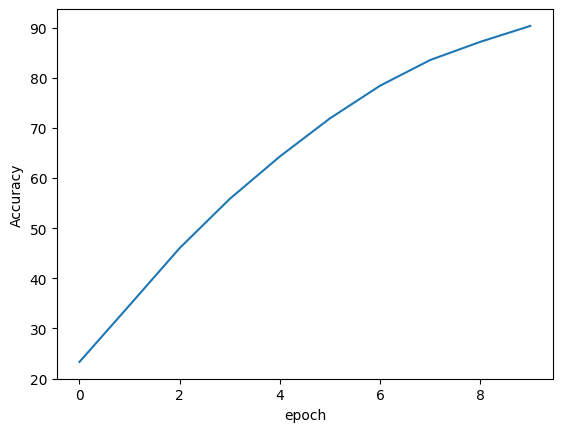

done
[]
4
tensor(24.0492, dtype=torch.float64)
tensor([ 0.0000,  0.0000, 41.2295, 35.8197, 43.1967], dtype=torch.float64)


In [26]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


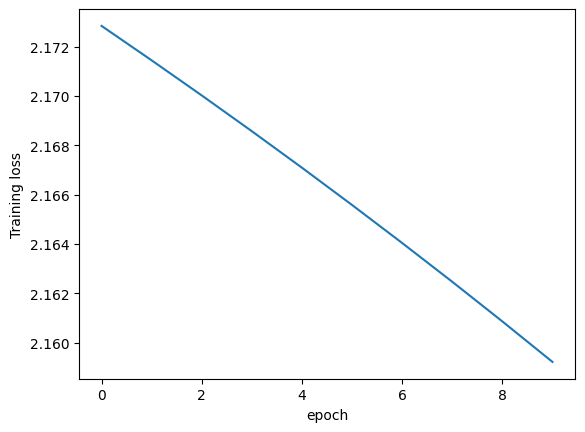

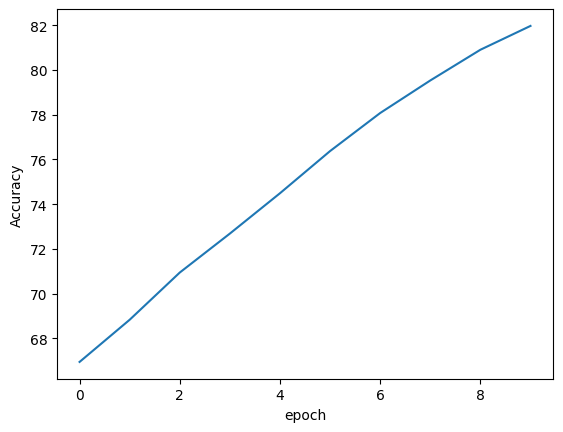

done
[]
4
20
4881


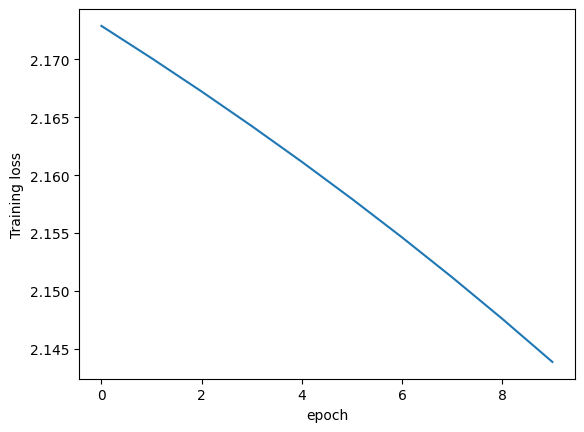

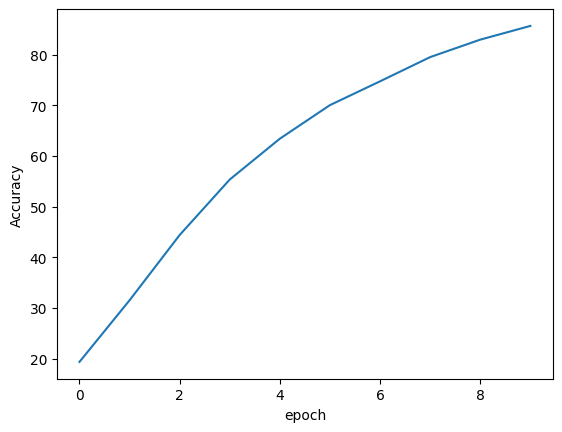

done
[]
4
20
4881


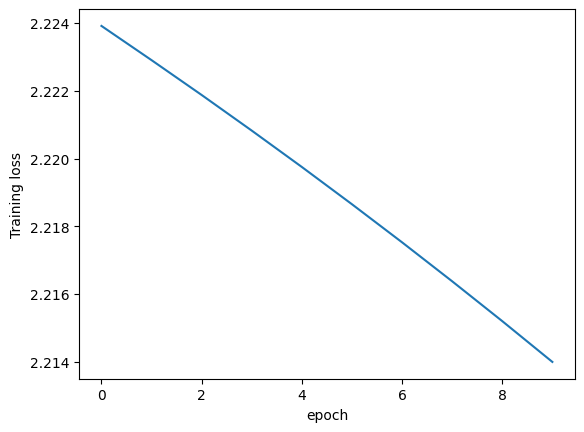

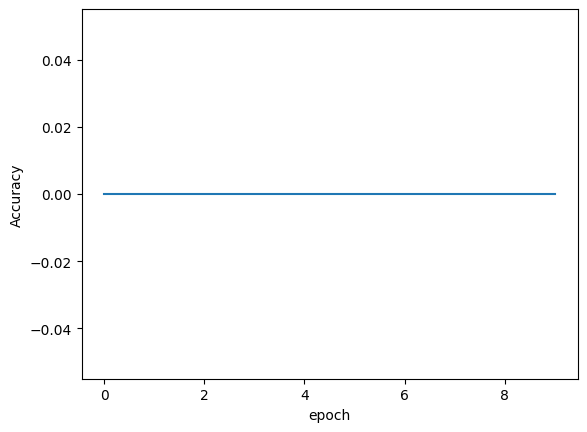

done
[]
4
20
4881


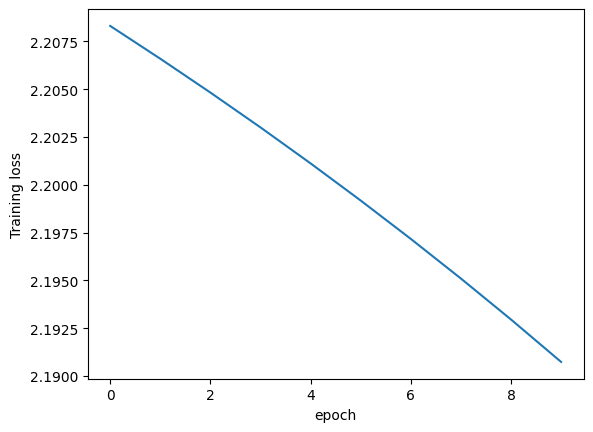

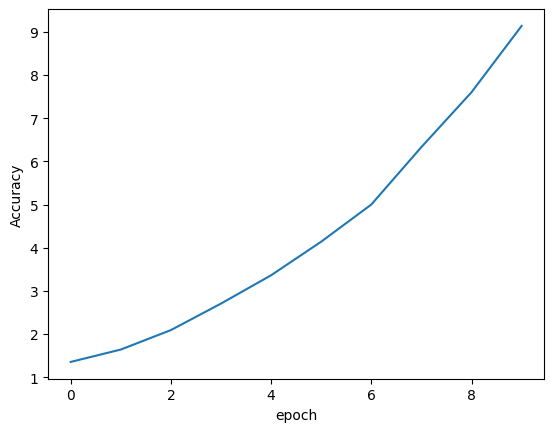

done
[]
4
20
4881


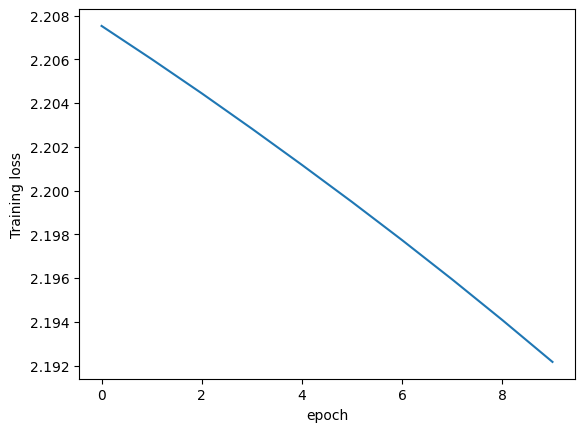

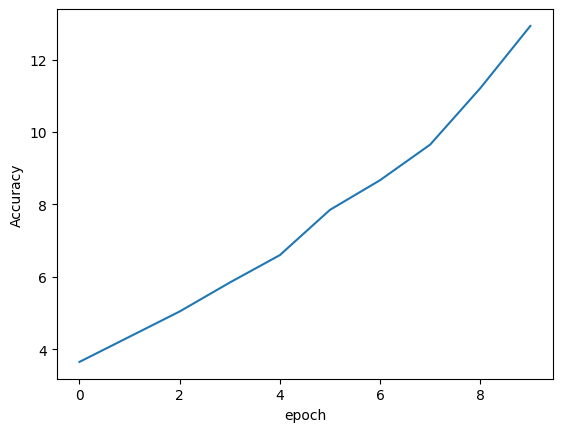

done
[]
4
tensor(11.8852, dtype=torch.float64)
tensor([ 0.0000,  0.0000, 49.0984,  5.8197,  4.5082], dtype=torch.float64)


In [27]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0005)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


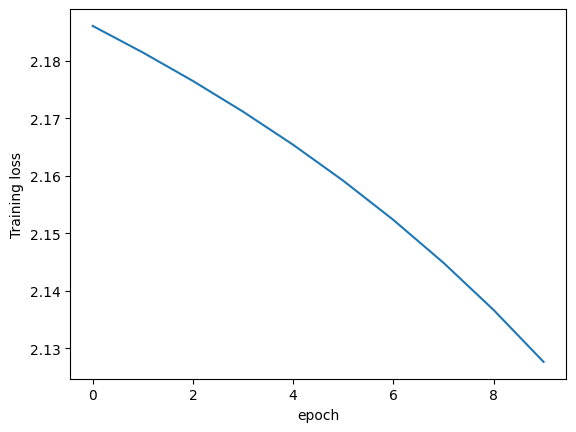

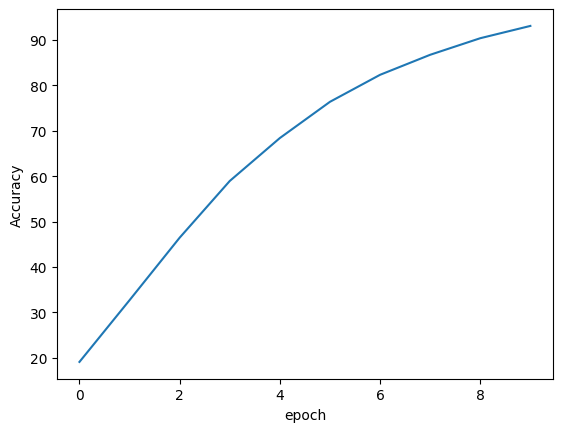

done
[]
4
20
4881


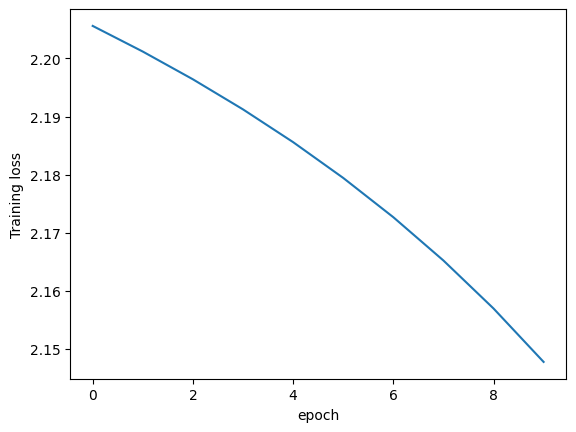

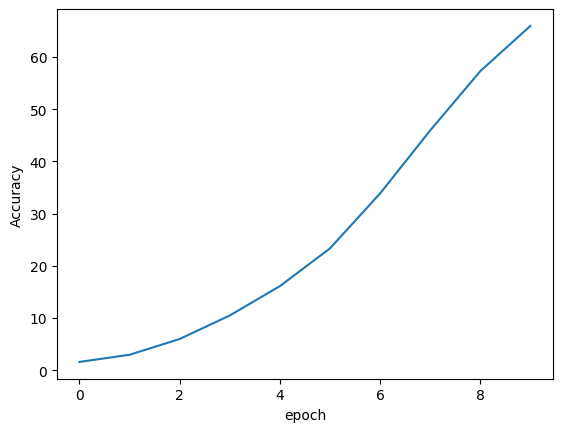

done
[]
4
20
4881


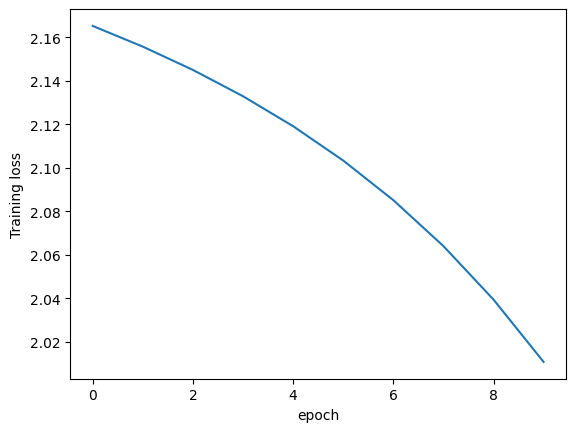

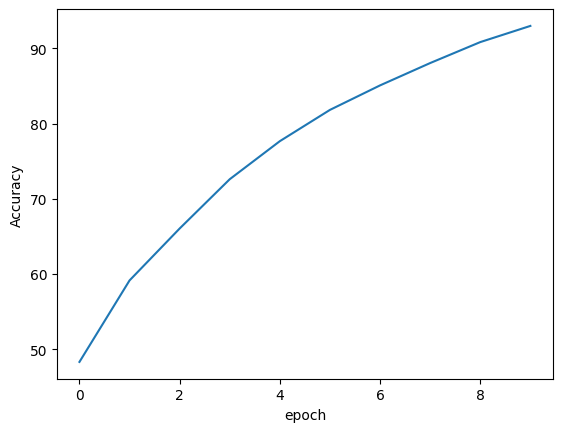

done
[]
4
20
4881


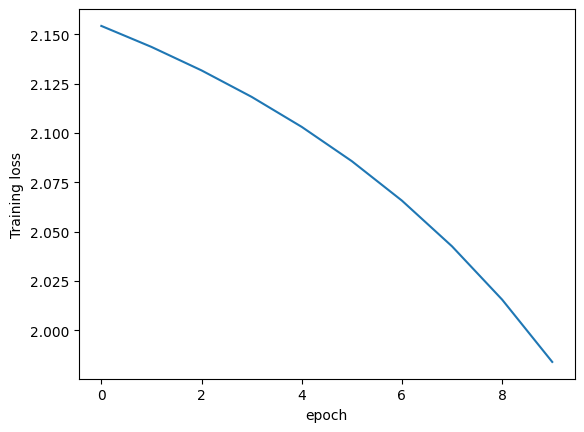

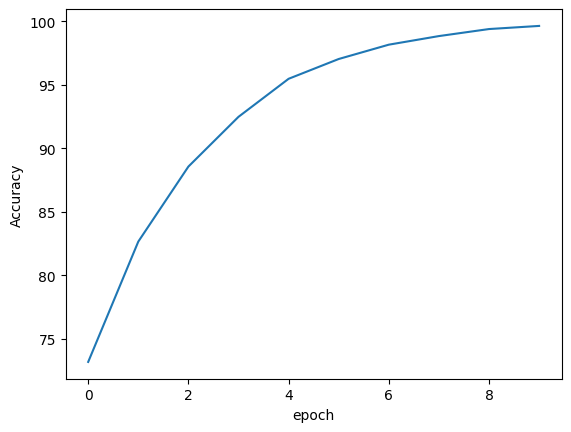

done
[]
4
20
4881


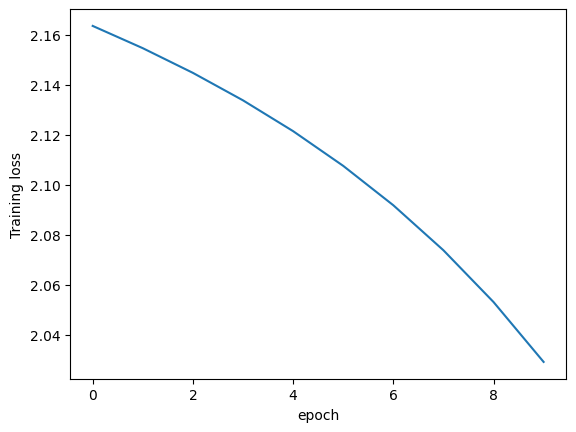

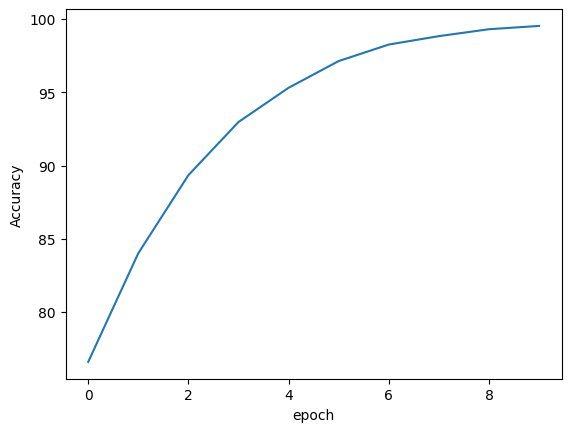

done
[]
4
tensor(26.7213, dtype=torch.float64)
tensor([ 0.0000, 78.6885,  0.9016,  0.0000, 54.0164], dtype=torch.float64)


In [28]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=np.load("Data AI/X_data.npy")






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        X[i][j]=(X[i][j]-mi)/(ma-mi)
X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0015)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


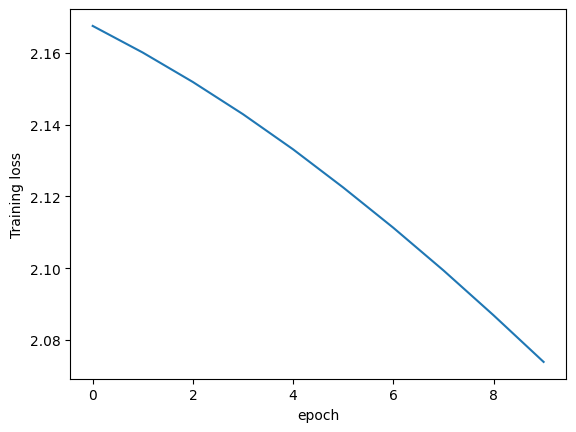

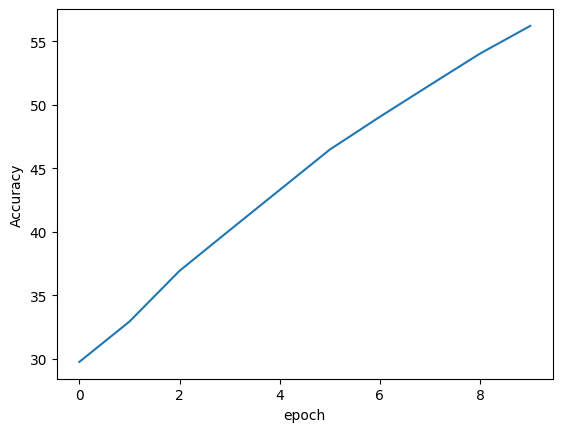

done
[]
4
20
4881


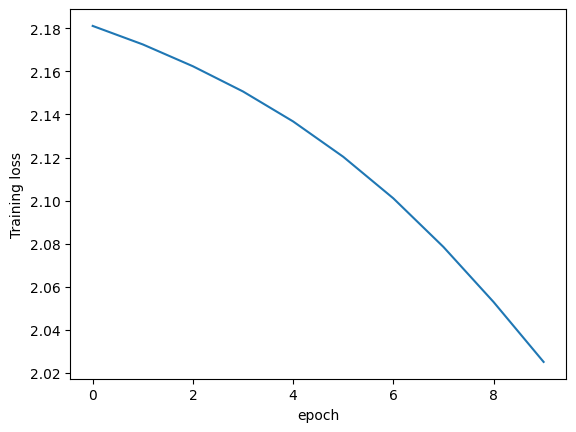

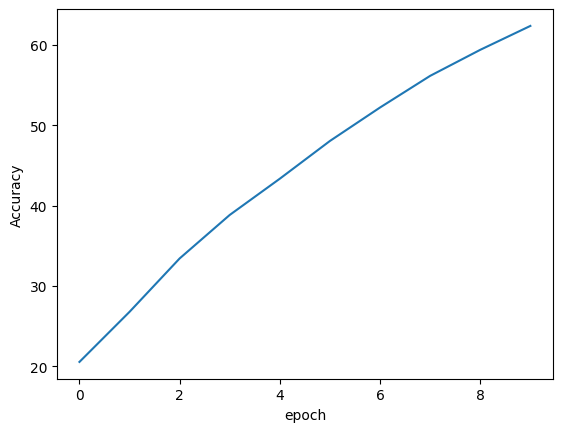

done
[]
4
20
4881


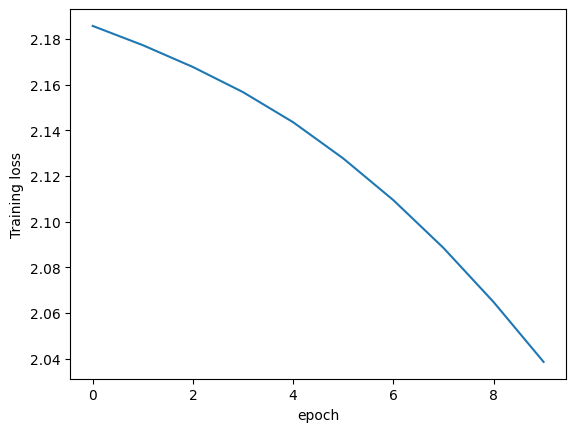

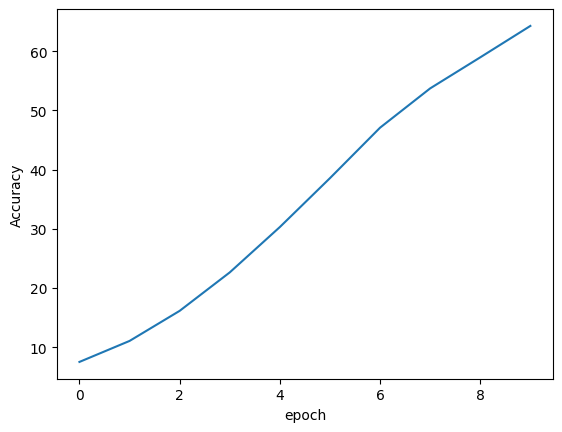

done
[]
4
20
4881


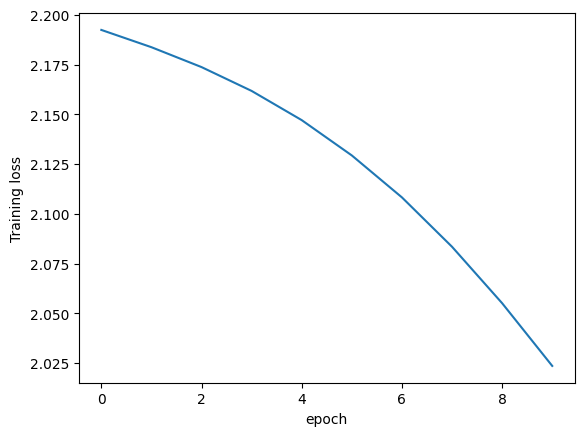

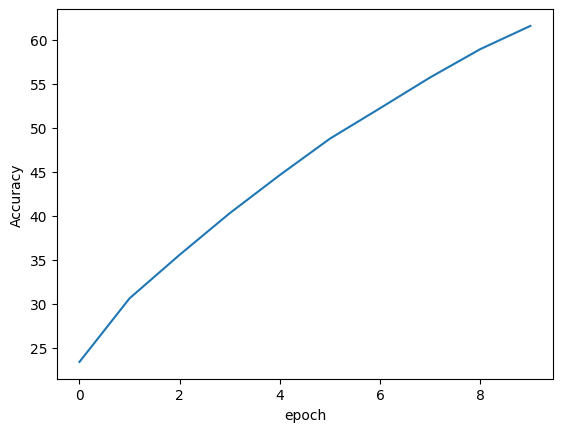

done
[]
4
20
4881


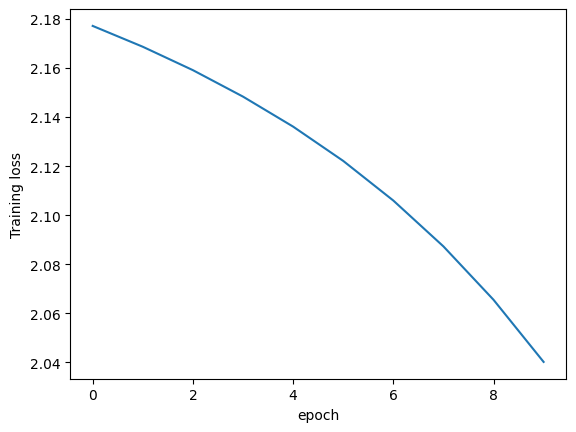

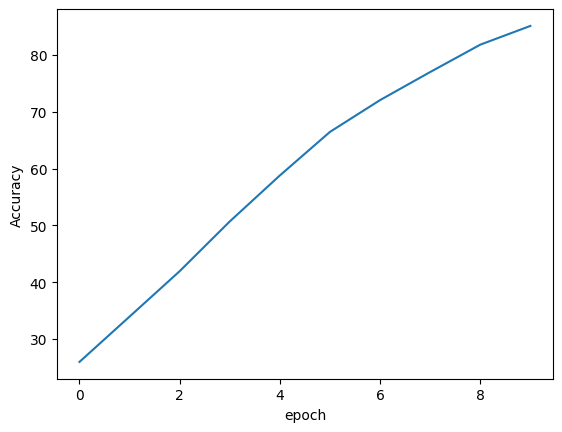

done
[]
4
tensor(3.2951, dtype=torch.float64)
tensor([ 0.9836, 11.3115,  1.6393,  0.5738,  1.9672], dtype=torch.float64)


In [29]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0015)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


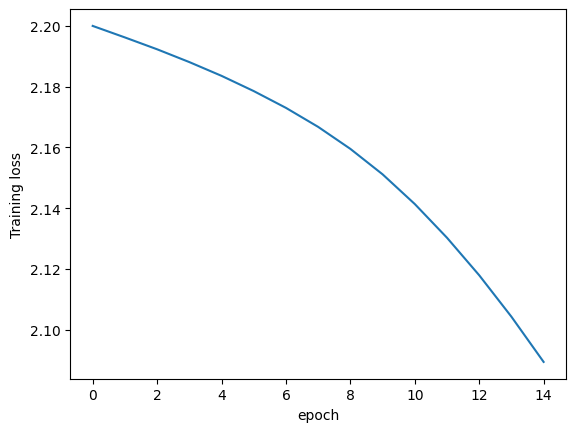

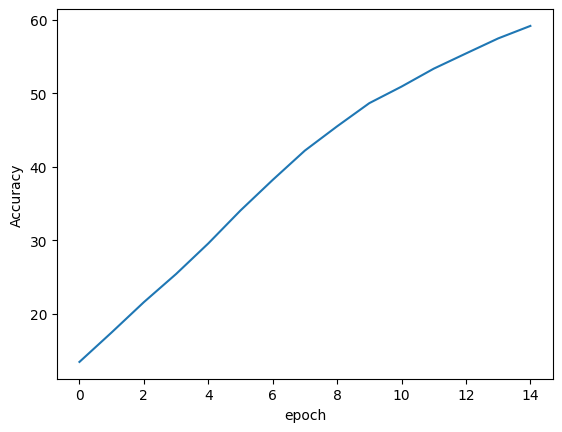

done
[]
4
20
4881


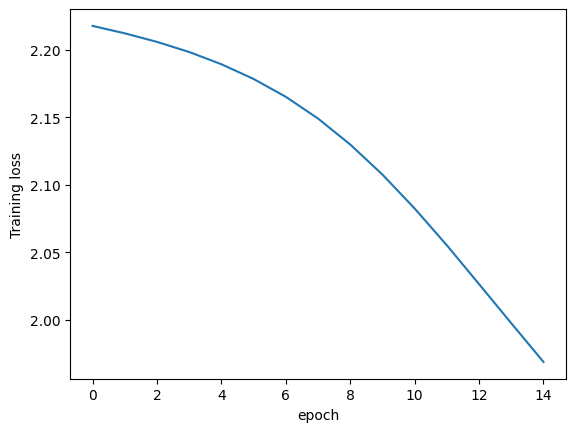

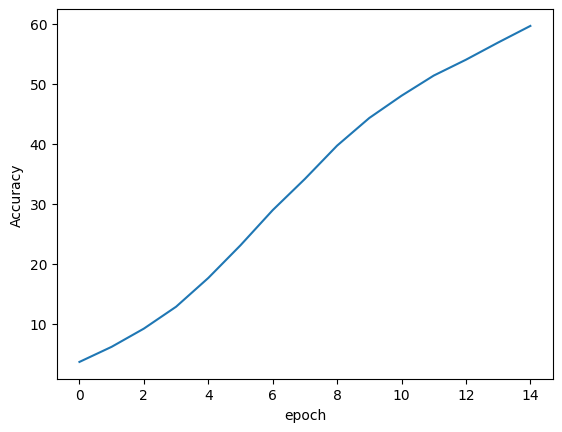

done
[]
4
20
4881


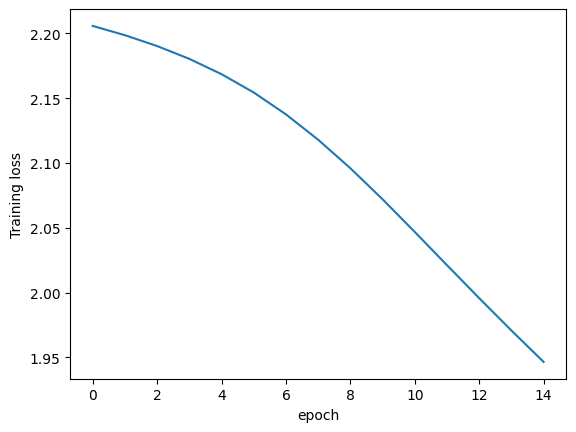

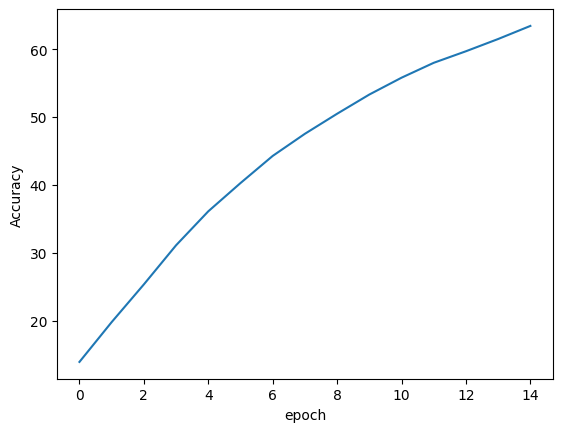

done
[]
4
20
4881


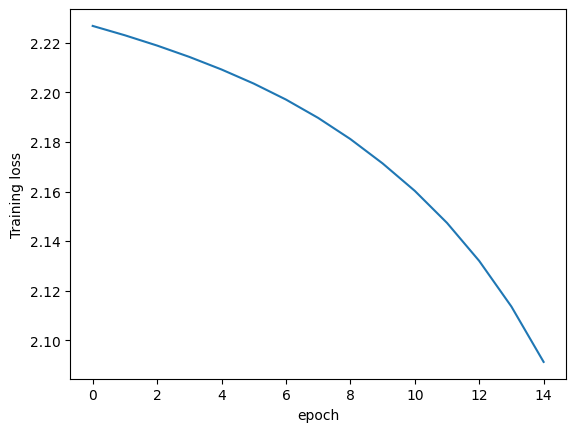

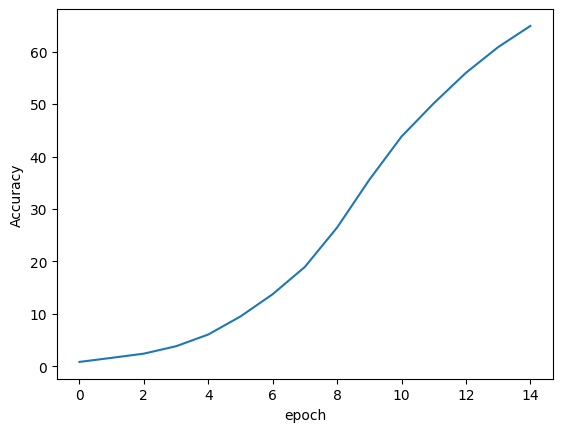

done
[]
4
20
4881


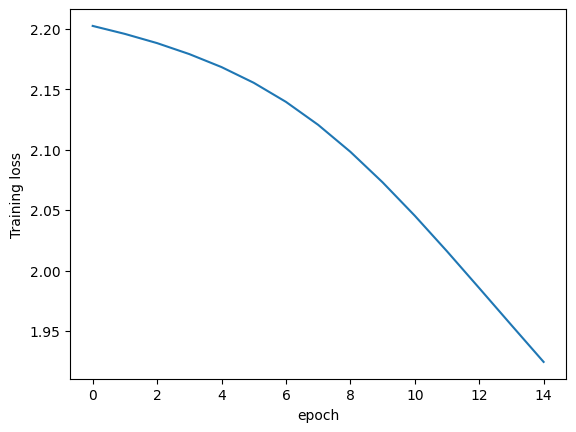

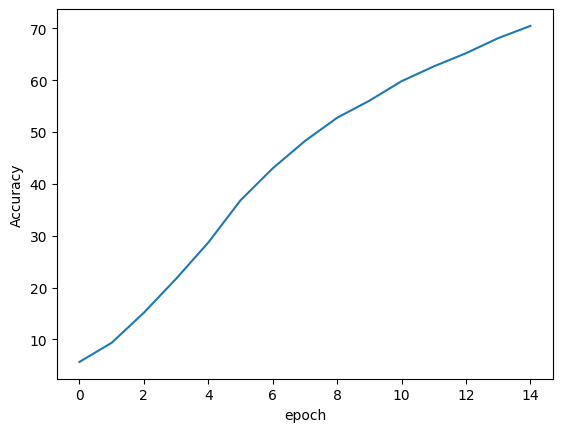

done
[]
4
tensor(1.9508, dtype=torch.float64)
tensor([0.1639, 1.2295, 0.6557, 0.0820, 7.6230], dtype=torch.float64)


In [30]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0015)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(15):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


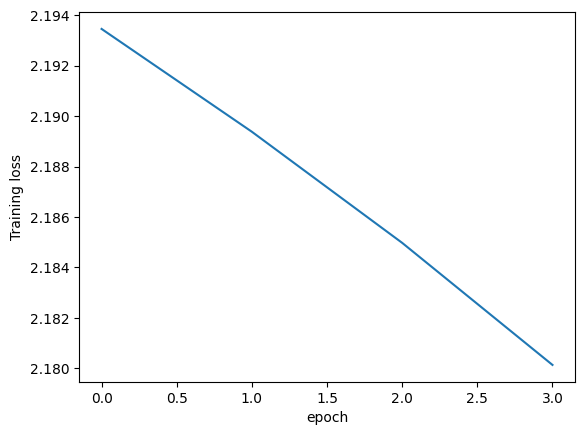

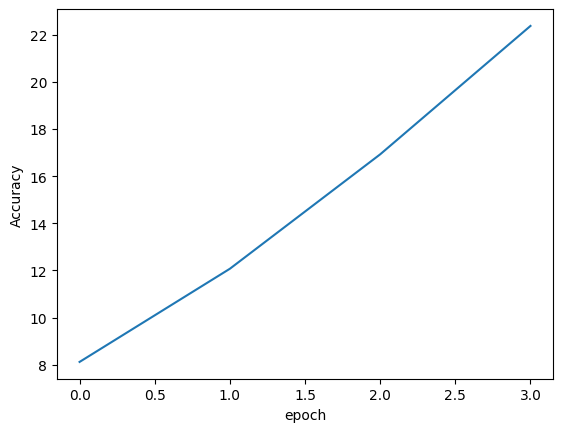

done
[]
4
20
4881


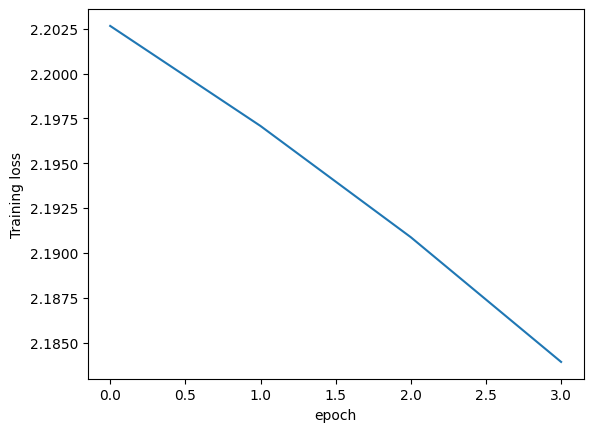

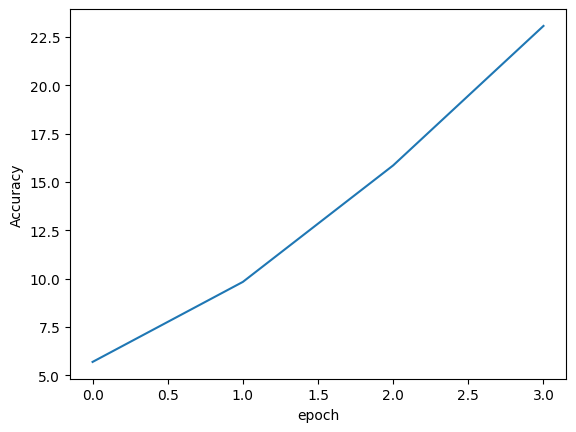

done
[]
4
20
4881


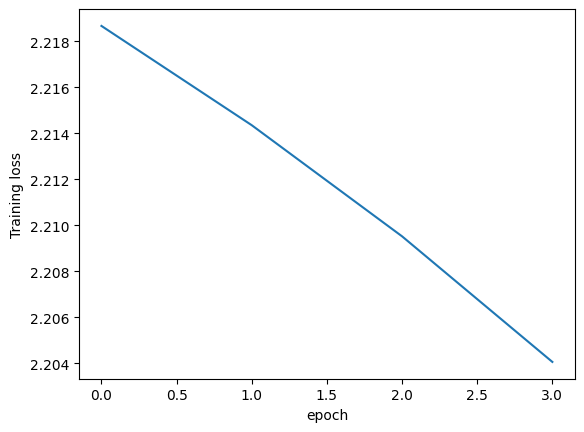

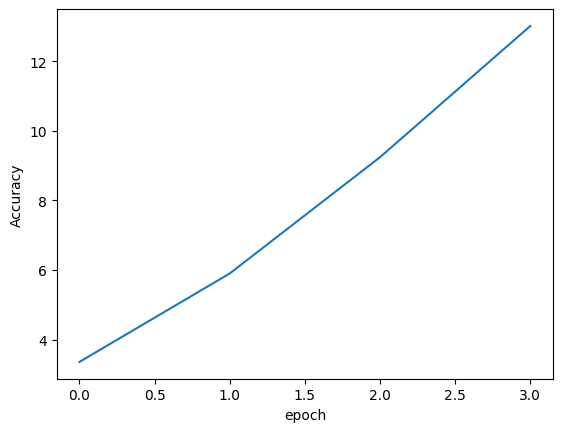

done
[]
4
20
4881


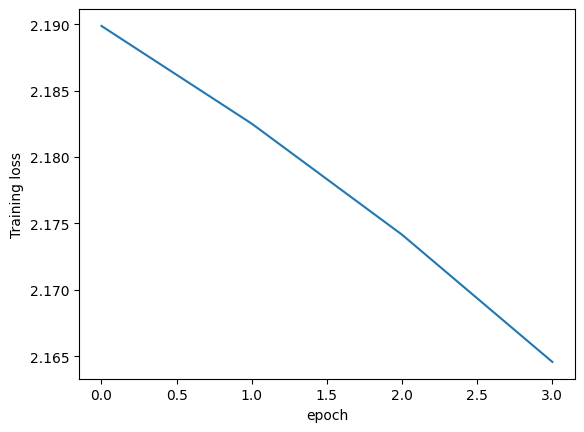

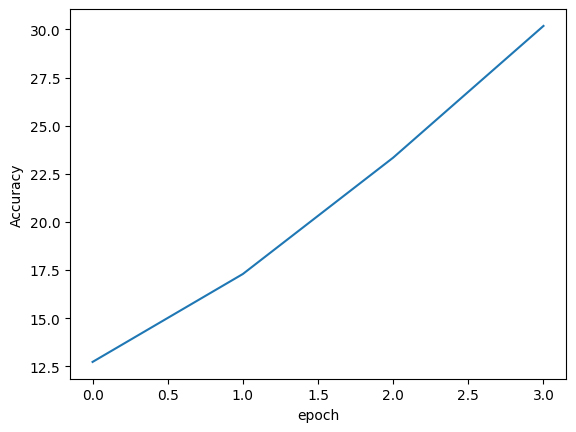

done
[]
4
20
4881


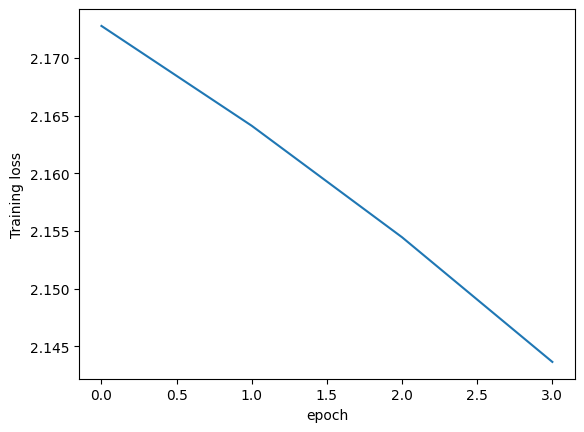

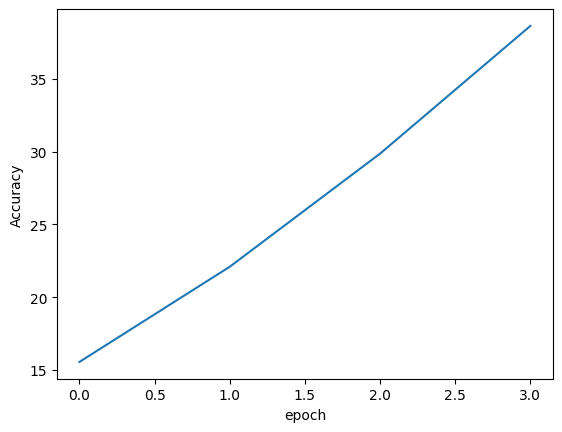

done
[]
4
tensor(4.4262, dtype=torch.float64)
tensor([0.5738, 3.2787, 9.7541, 3.3607, 5.1639], dtype=torch.float64)


In [31]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0015)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(4):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


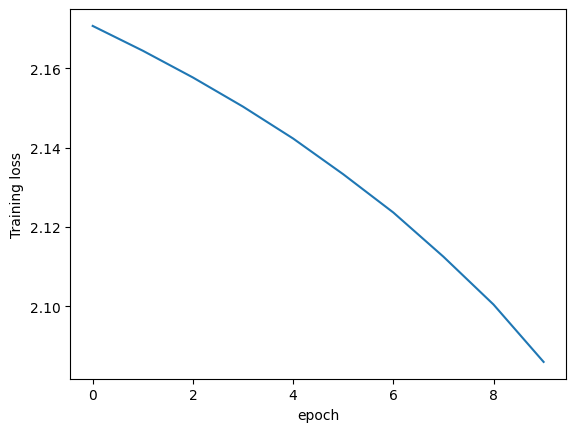

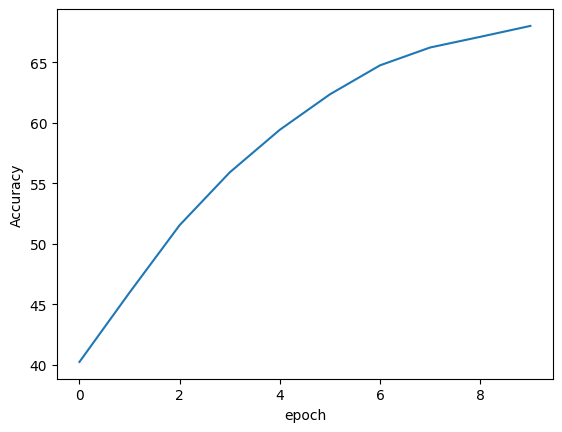

done
[]
4
20
4881


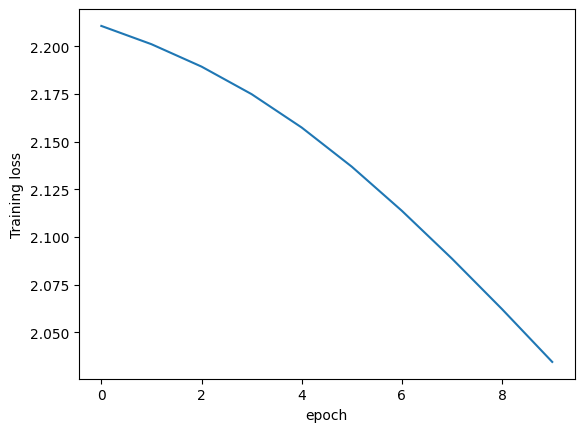

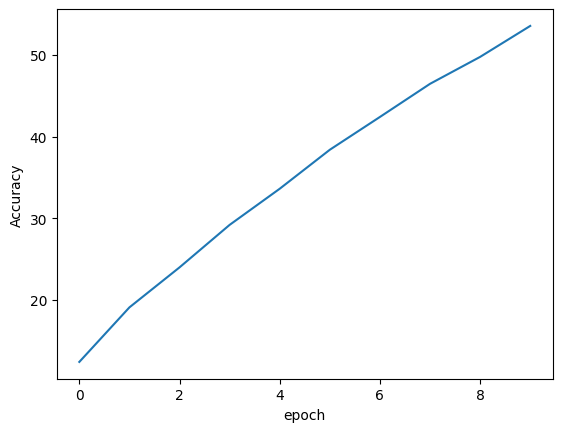

done
[]
4
20
4881


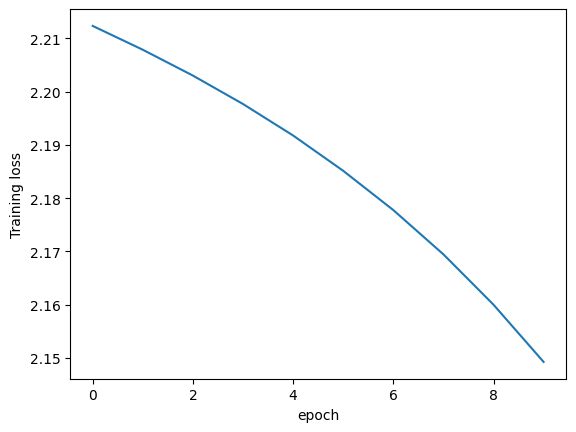

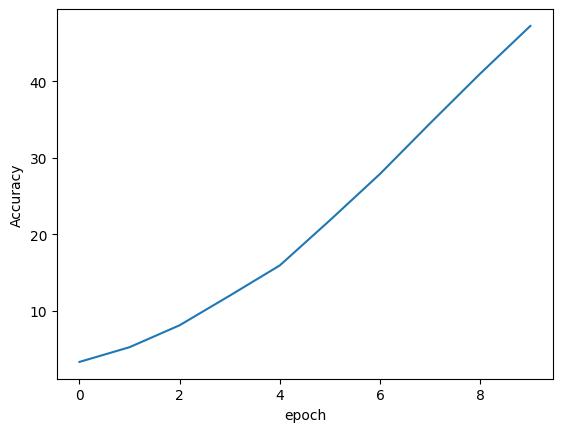

done
[]
4
20
4881


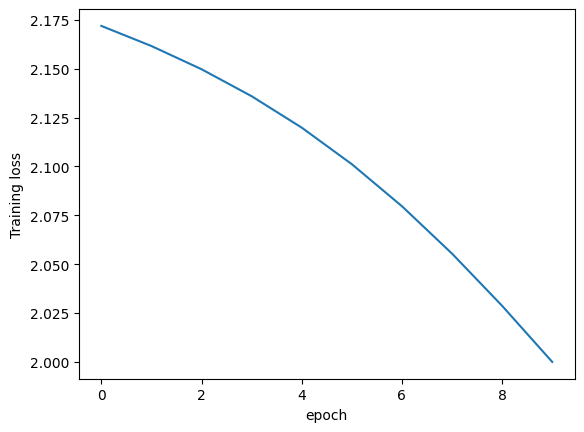

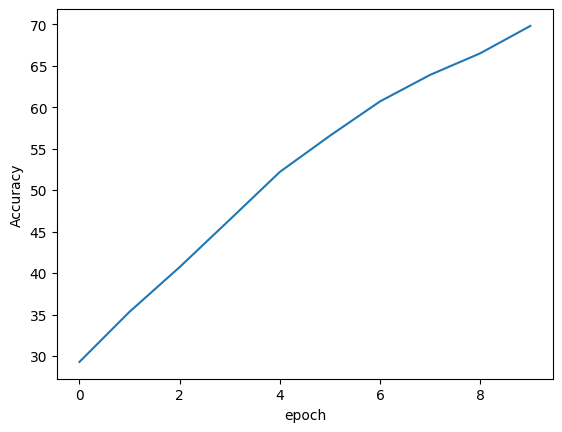

done
[]
4
20
4881


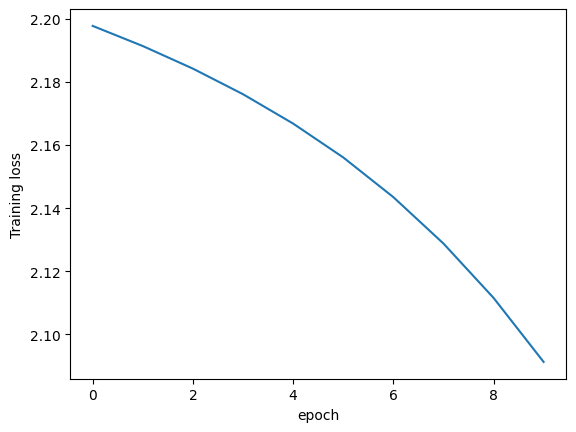

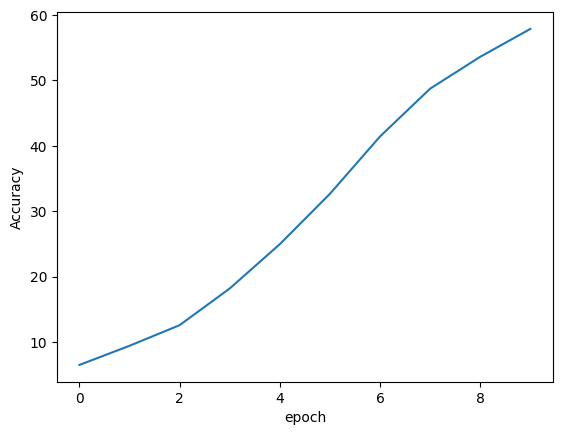

done
[]
4
tensor(4.5082, dtype=torch.float64)
tensor([ 1.4754,  0.4098, 15.9836,  4.0984,  0.5738], dtype=torch.float64)


In [32]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0015)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


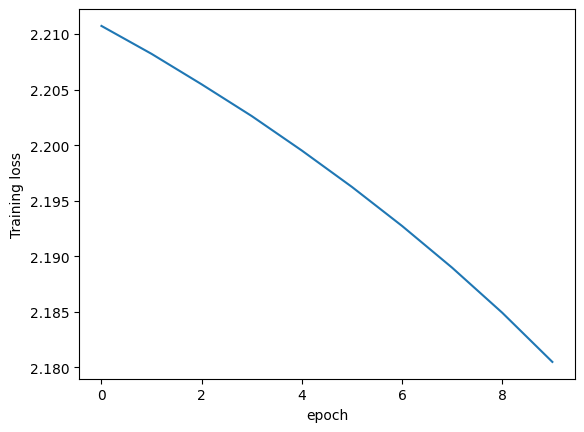

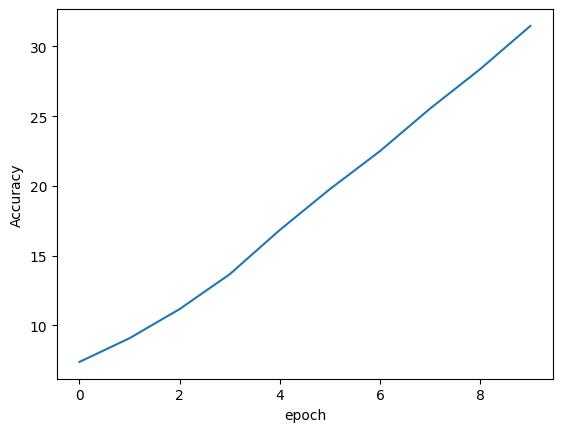

done
[]
4
20
4881


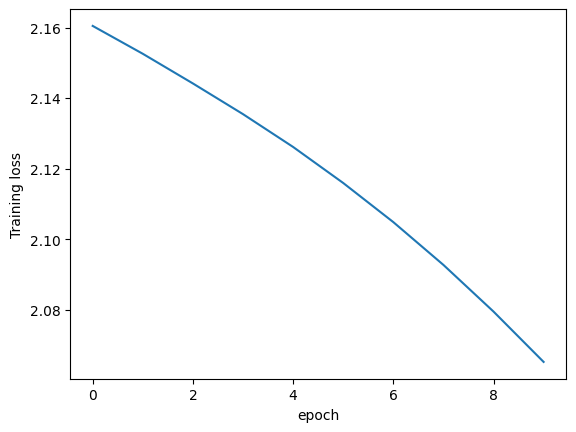

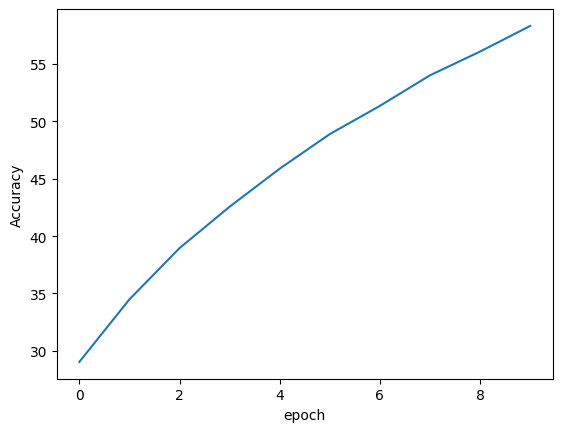

done
[]
4
20
4881


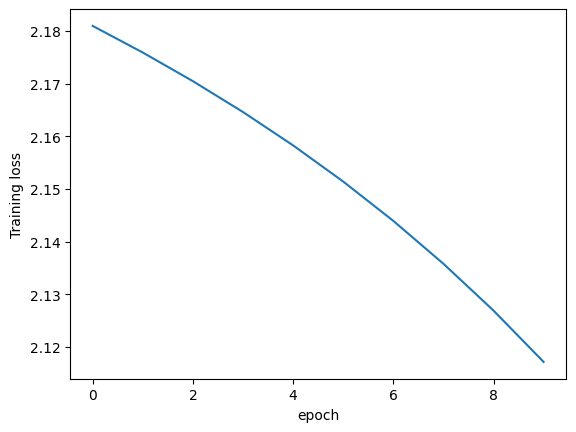

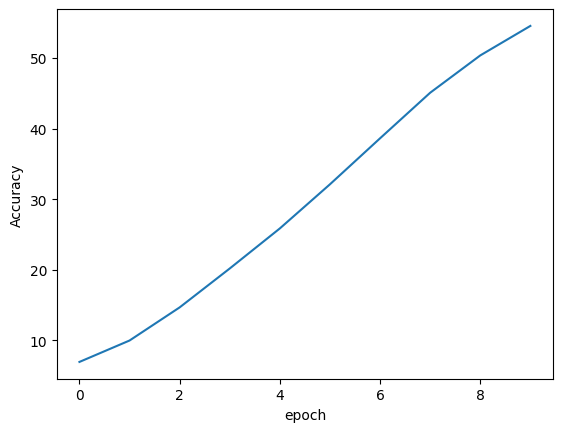

done
[]
4
20
4881


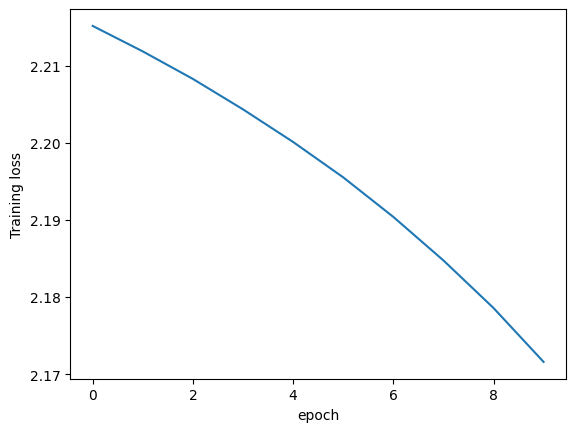

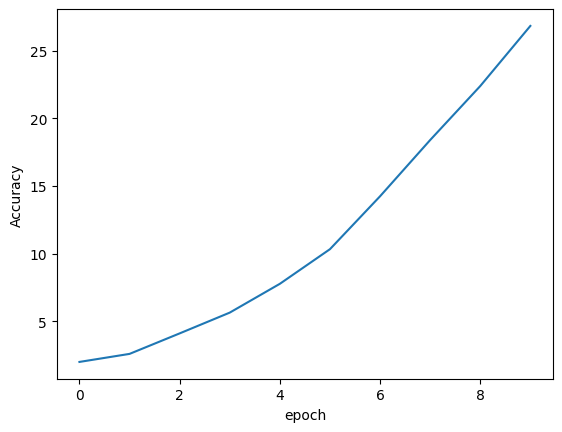

done
[]
4
20
4881


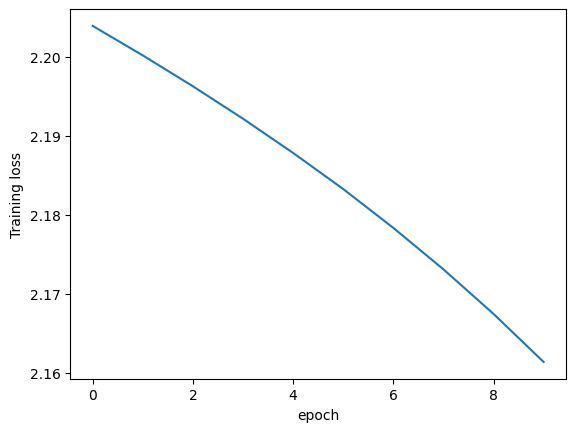

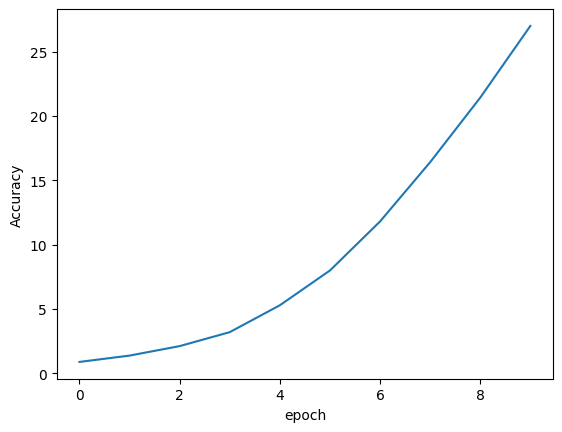

done
[]
4
tensor(12., dtype=torch.float64)
tensor([21.8852, 12.1311,  2.1311, 19.3443,  4.5082], dtype=torch.float64)


In [33]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(10):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


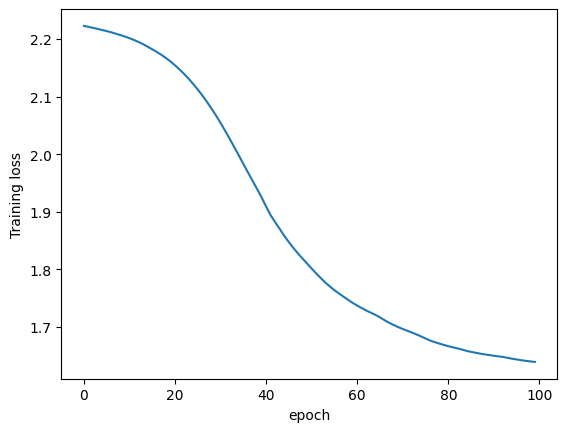

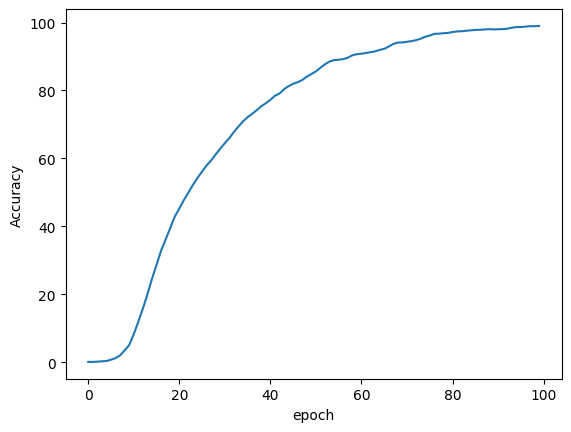

done
[]
4
20
4881


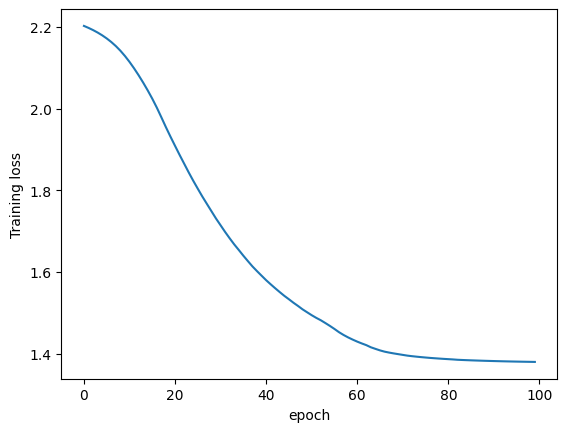

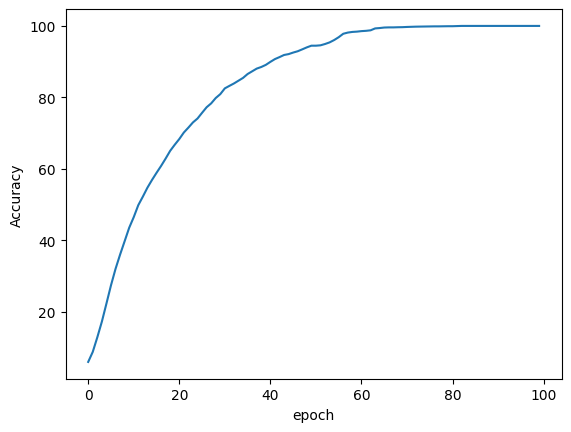

done
[]
4
20
4881


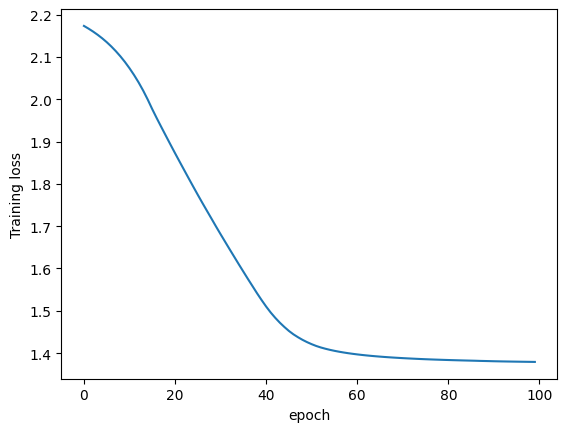

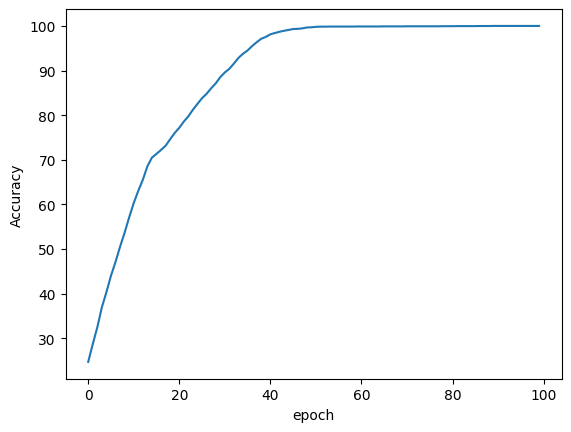

done
[]
4
20
4881


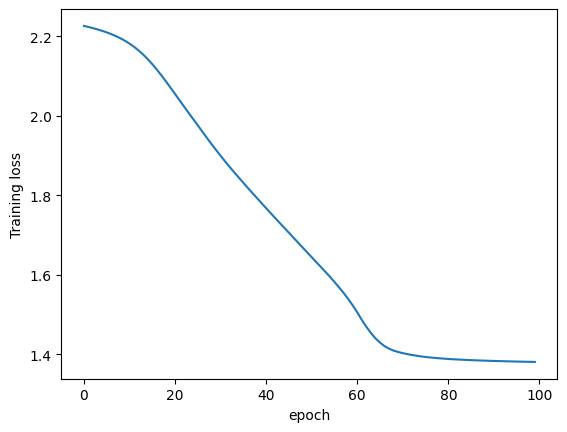

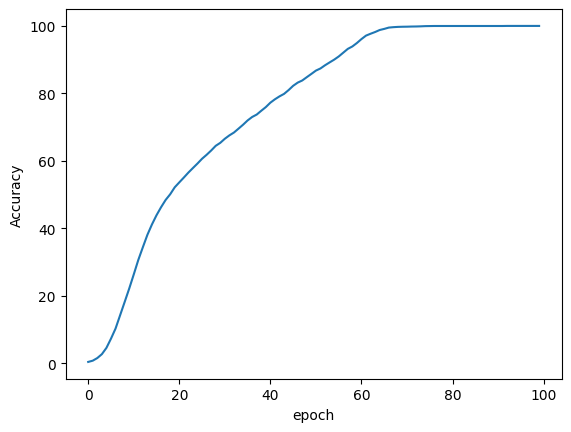

done
[]
4
20
4881


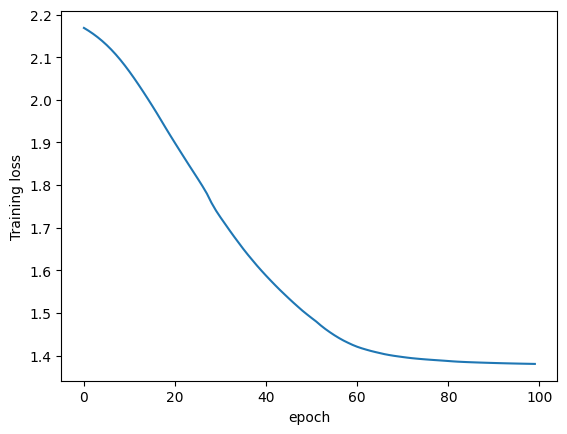

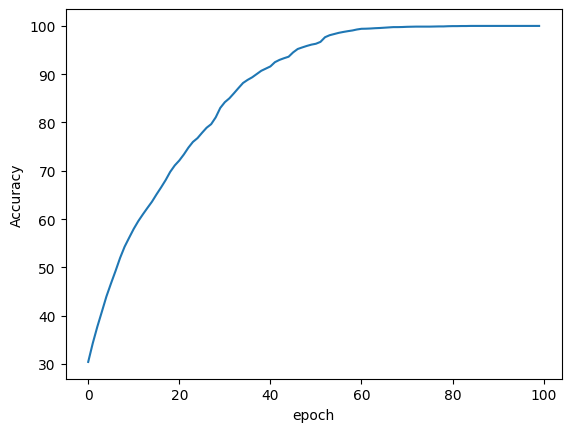

done
[]
4
tensor(0.0164, dtype=torch.float64)
tensor([0.0000, 0.0000, 0.0000, 0.0820, 0.0000], dtype=torch.float64)


In [34]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(100):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


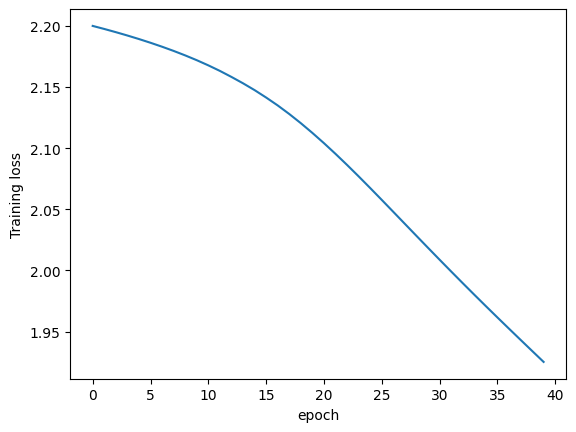

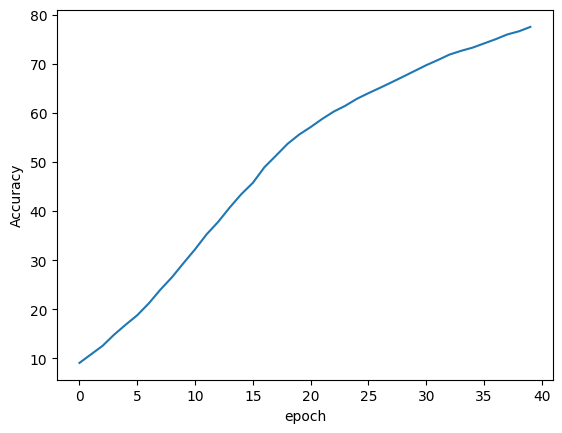

done
[]
4
20
4881


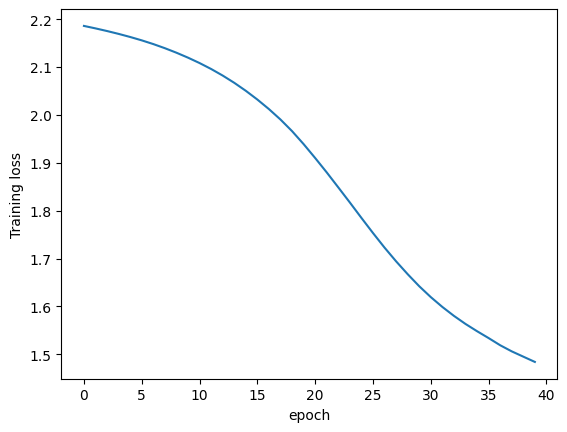

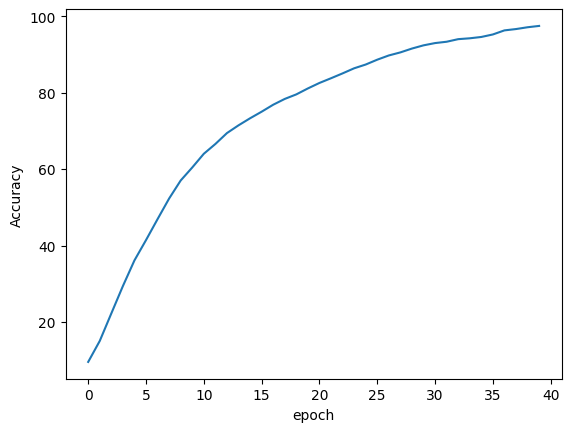

done
[]
4
20
4881


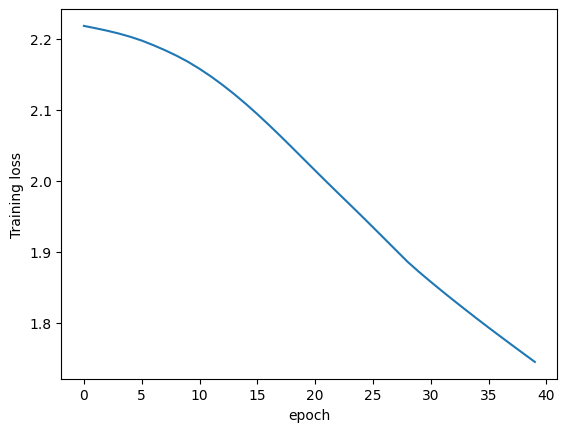

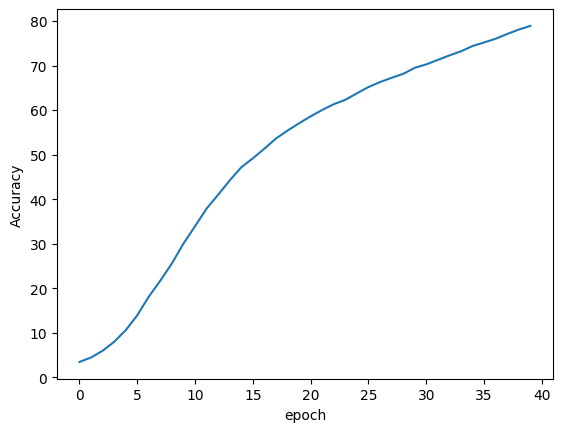

done
[]
4
20
4881


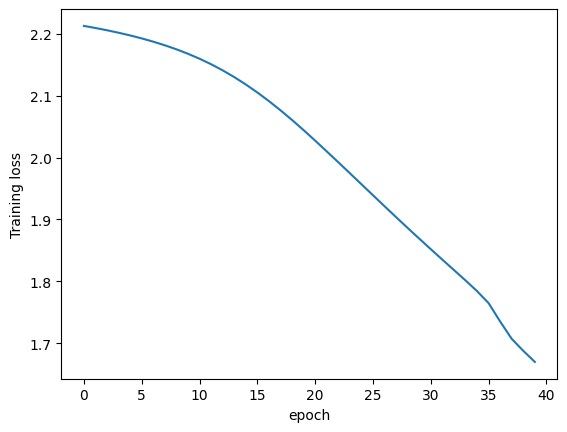

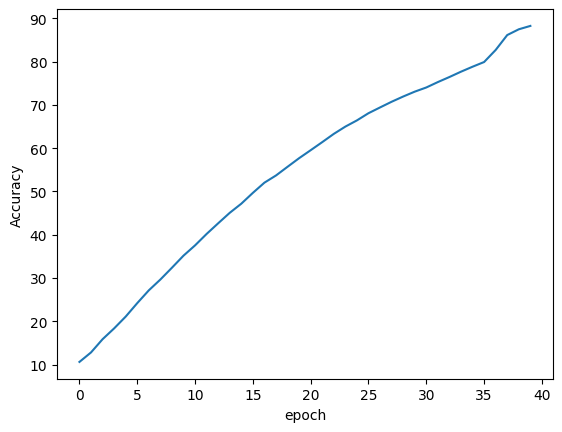

done
[]
4
20
4881


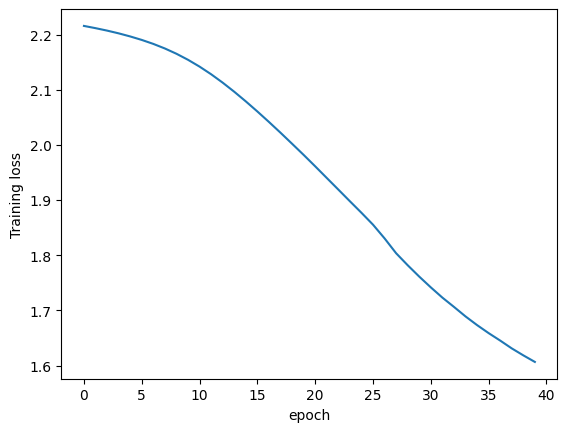

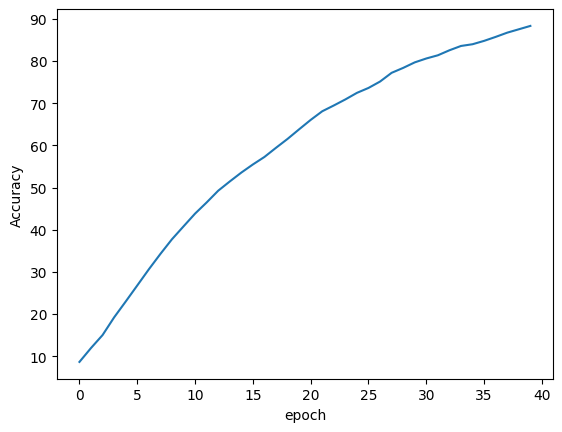

done
[]
4
tensor(1.8525, dtype=torch.float64)
tensor([2.8689, 0.0000, 4.3443, 0.9836, 1.0656], dtype=torch.float64)


In [35]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(40):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


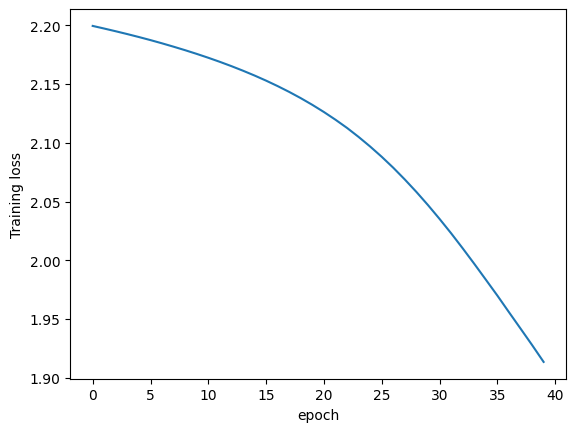

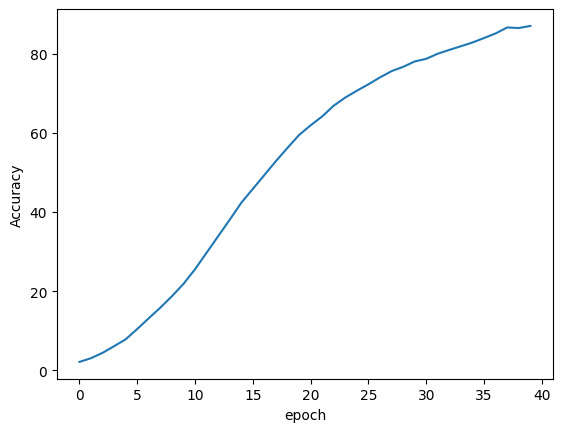

done
[]
4
20
4881


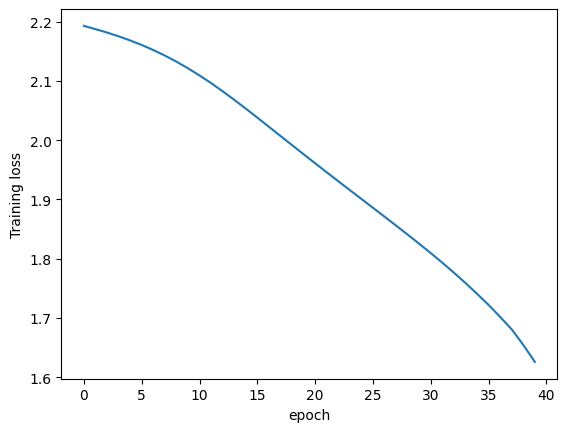

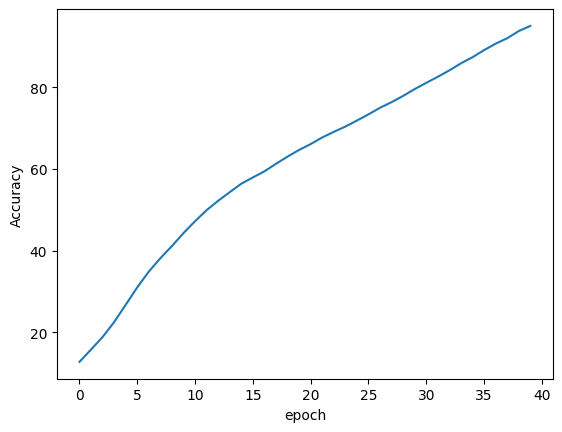

done
[]
4
20
4881


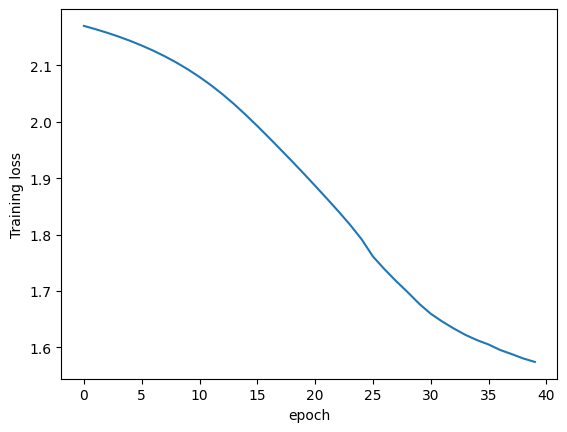

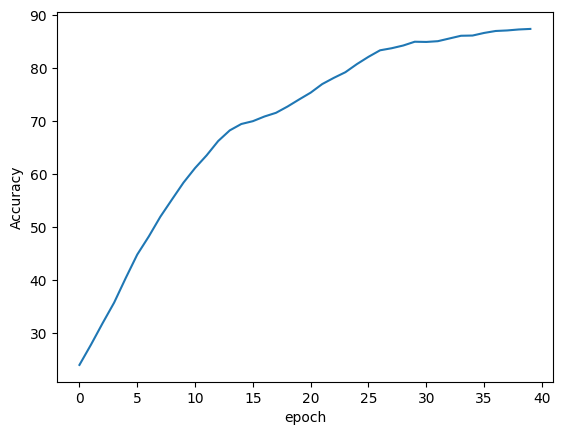

done
[]
4
20
4881


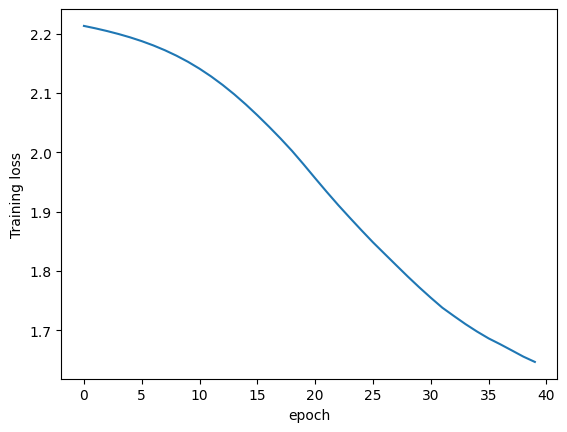

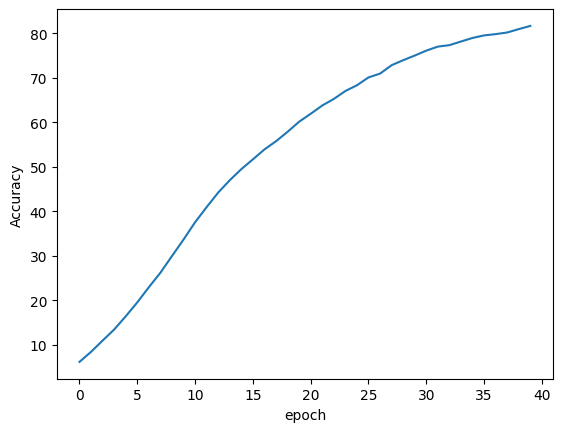

done
[]
4
20
4881


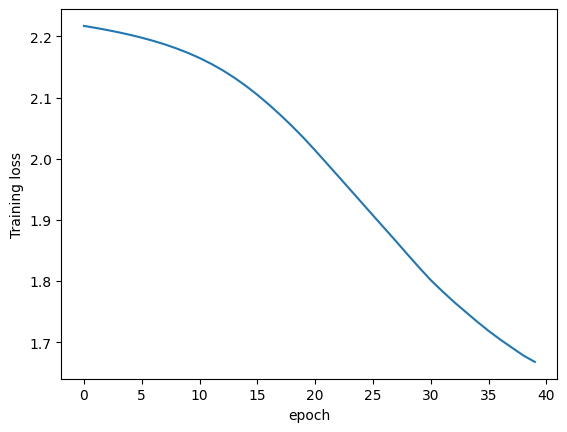

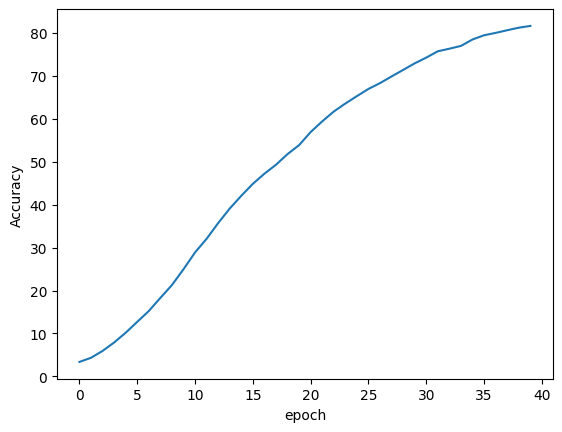

done
[]
4
tensor(1.2295, dtype=torch.float64)
tensor([0.0820, 1.9672, 1.8852, 1.1475, 1.0656], dtype=torch.float64)


In [36]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.MaxPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(40):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


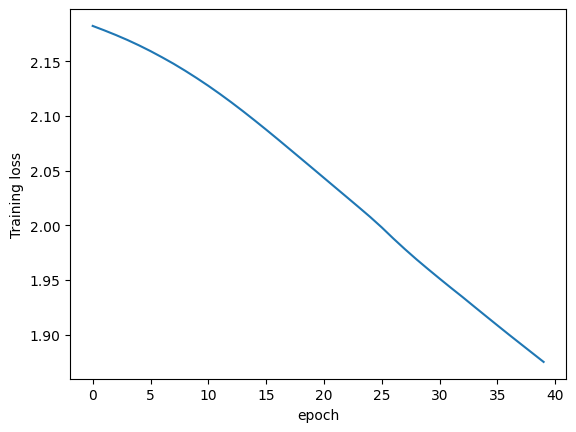

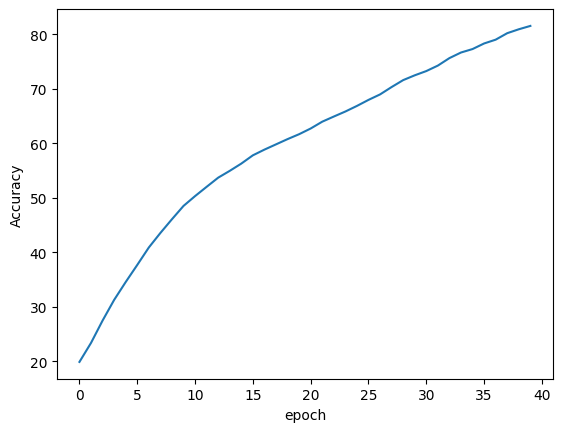

done
[]
4
20
4881


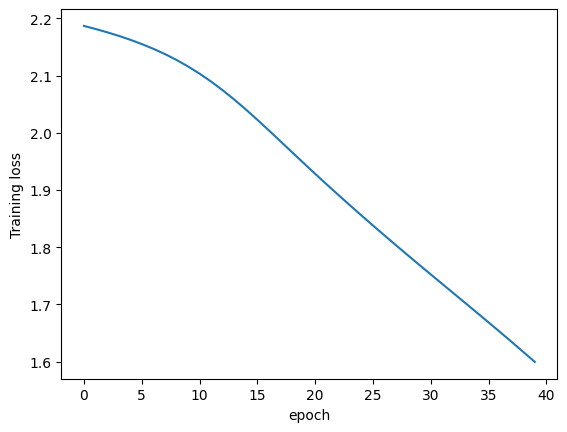

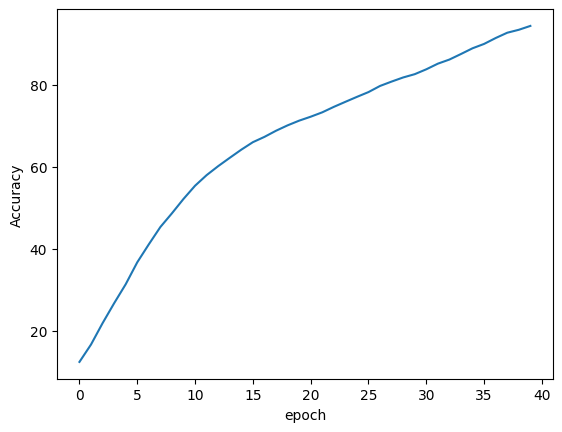

done
[]
4
20
4881


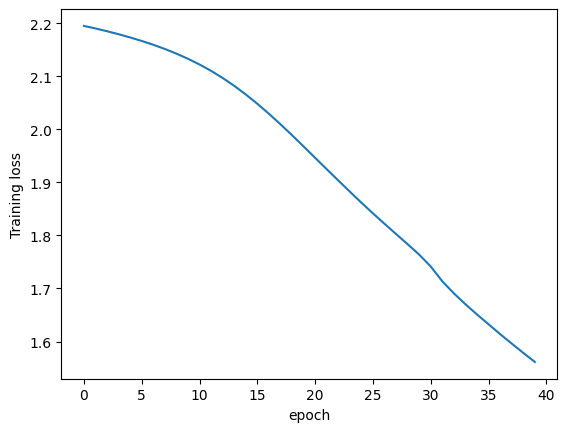

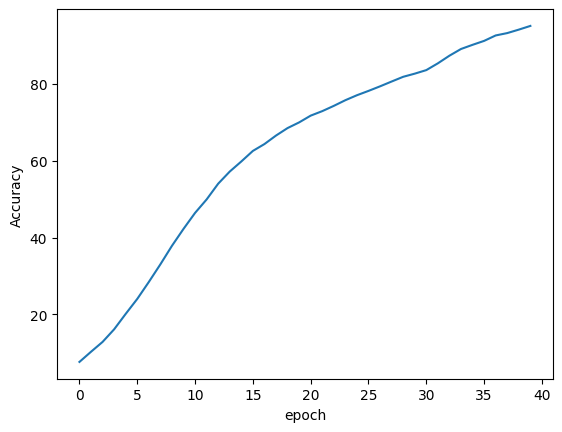

done
[]
4
20
4881


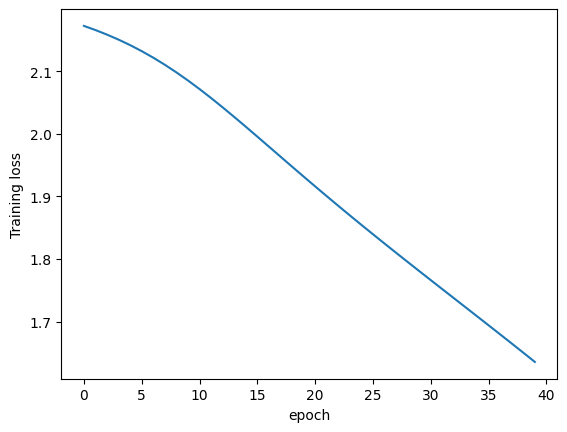

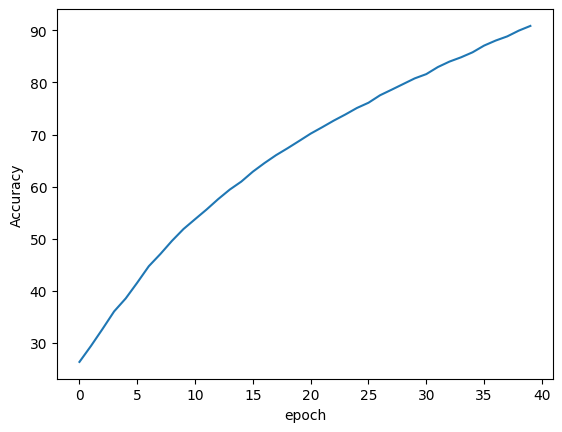

done
[]
4
20
4881


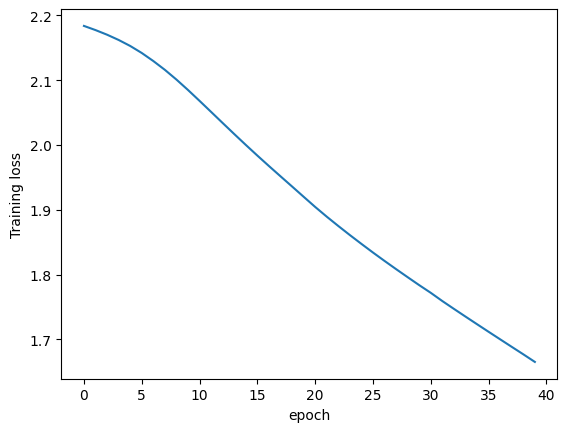

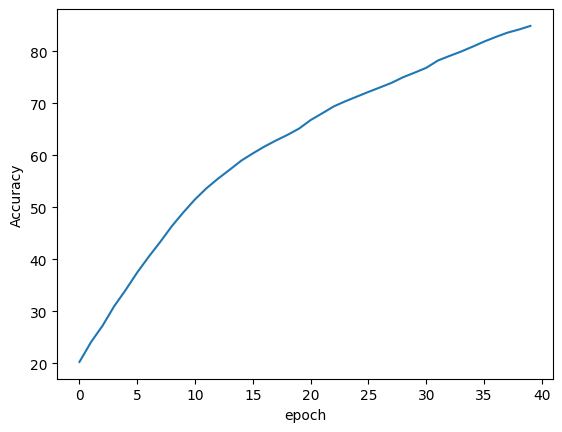

done
[]
4
tensor(0.6557, dtype=torch.float64)
tensor([0.3279, 0.0000, 0.8197, 0.2459, 1.8852], dtype=torch.float64)


In [39]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AdaptiveAvgPool1d(output_size=10),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(40):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


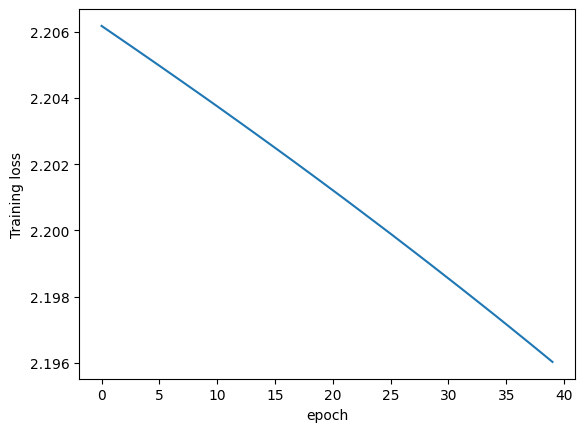

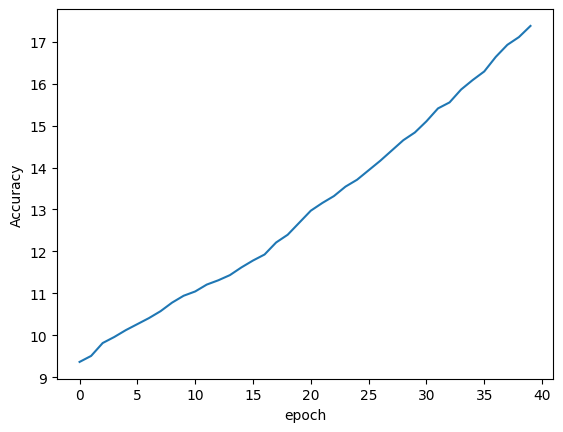

done
[]
4
20
4881


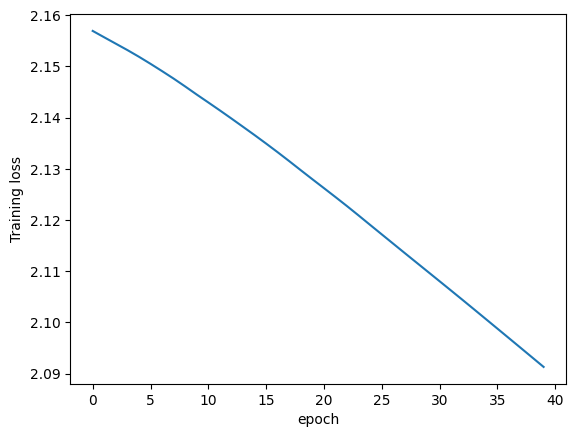

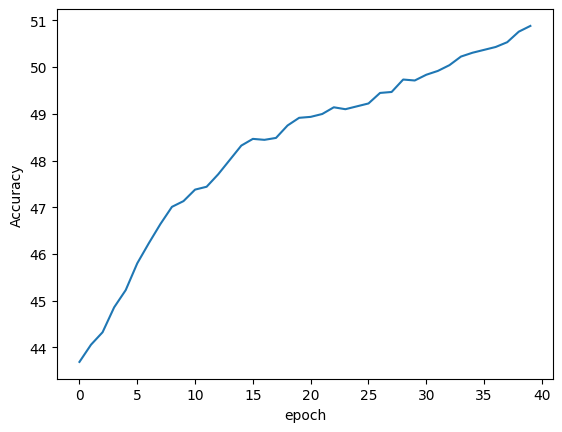

done
[]
4
20
4881


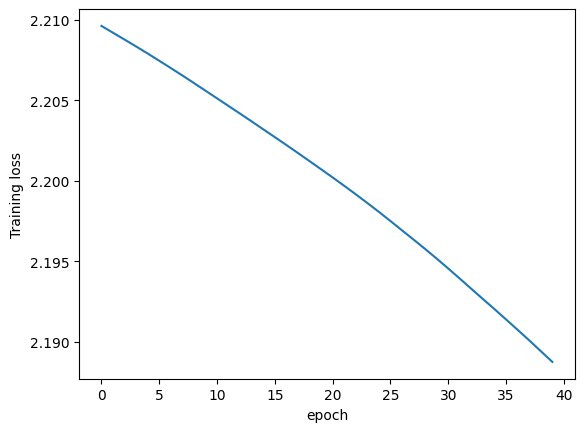

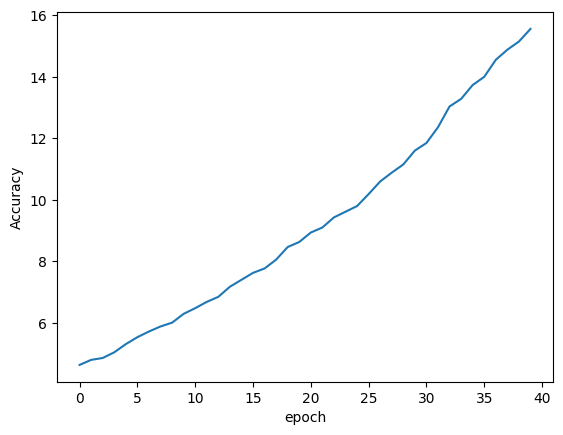

done
[]
4
20
4881


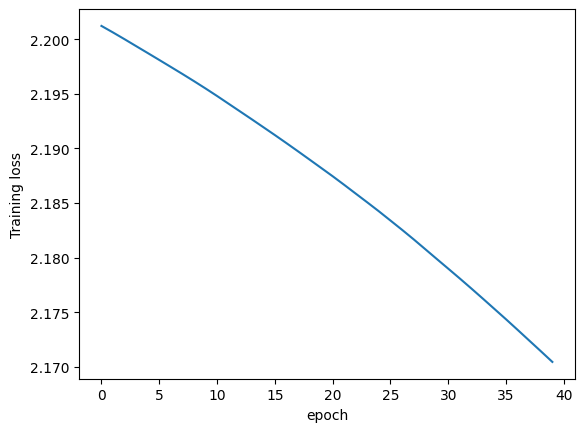

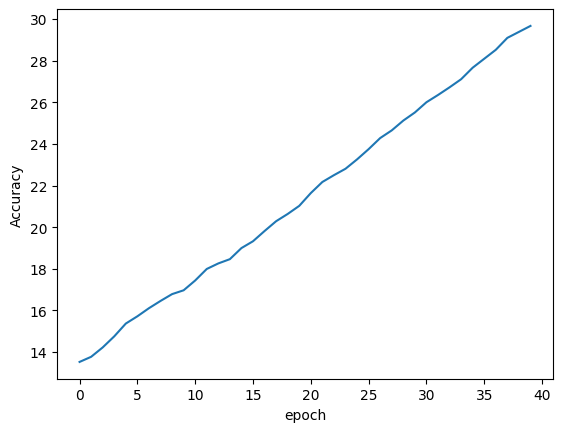

done
[]
4
20
4881


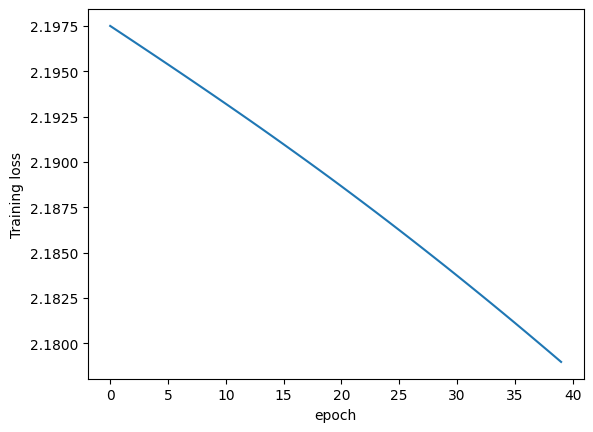

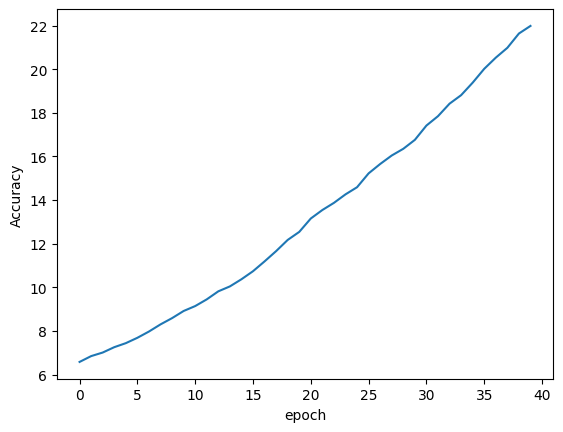

done
[]
4
tensor(7.7213, dtype=torch.float64)
tensor([ 7.0492,  6.2295,  3.0328,  3.6885, 18.6066], dtype=torch.float64)


In [40]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(40):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


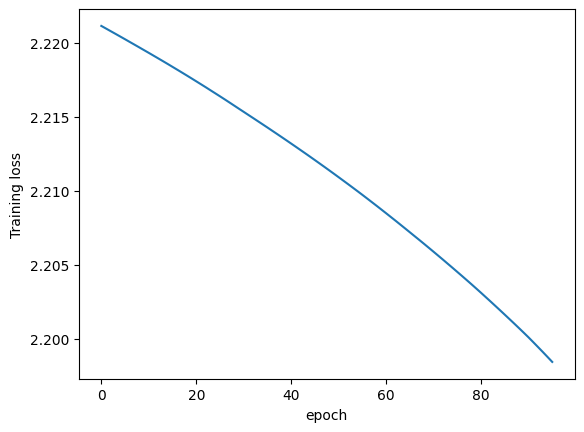

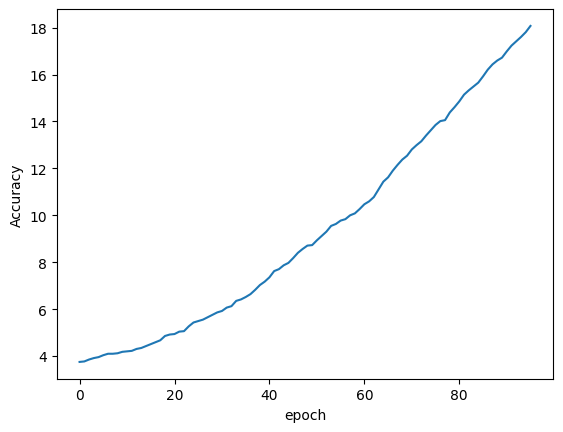

done
[]
4
20
4881


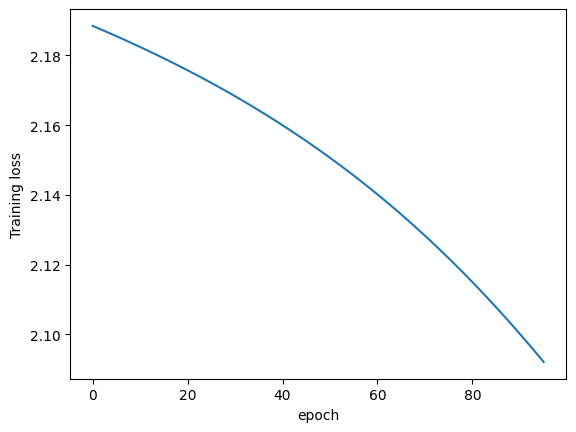

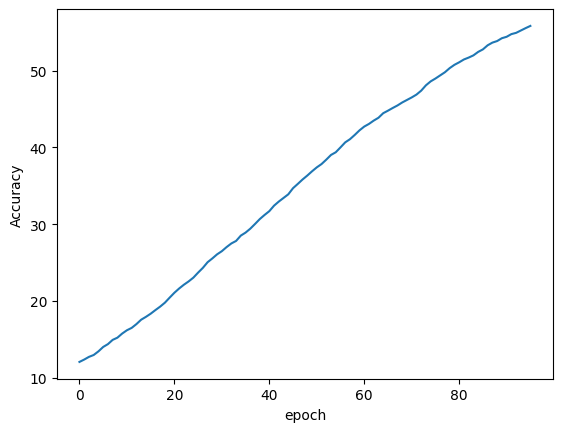

done
[]
4
20
4881


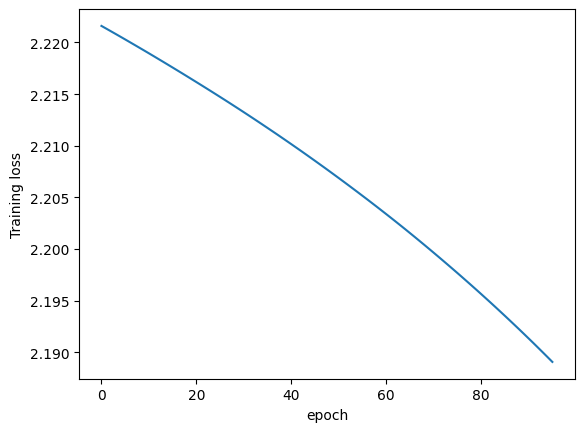

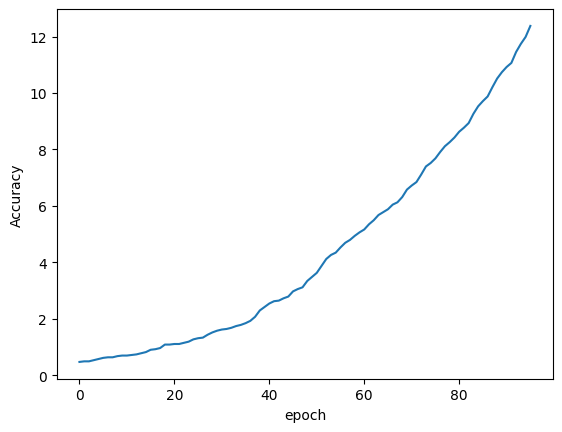

done
[]
4
20
4881


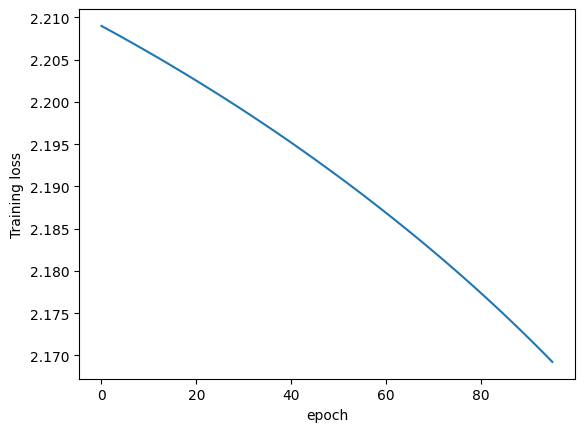

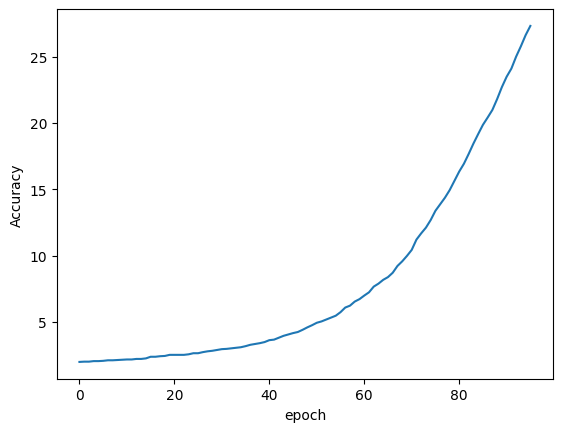

done
[]
4
20
4881


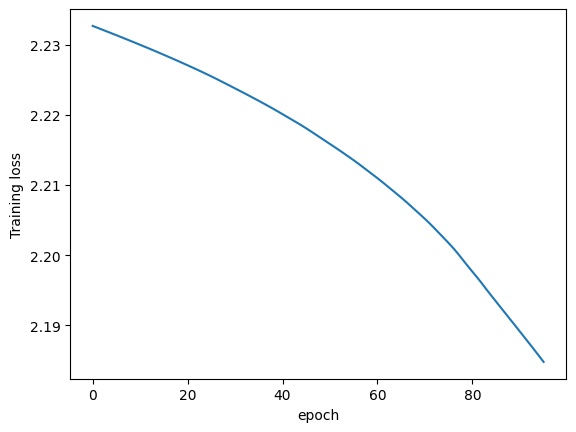

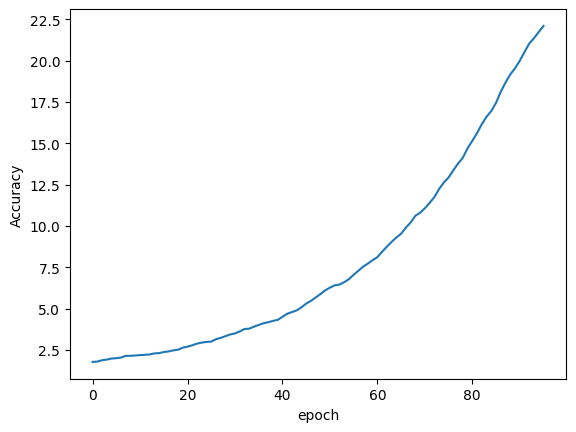

done
[]
4
tensor(8.1803, dtype=torch.float64)
tensor([24.0164,  4.2623,  3.6066,  3.6885,  5.3279], dtype=torch.float64)


In [41]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(96):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

7626
Data loaded
20
4881


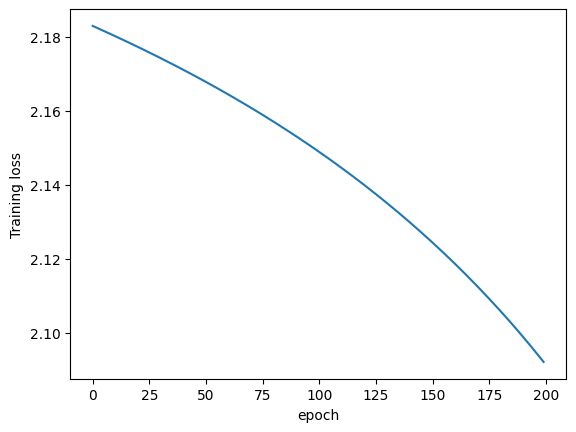

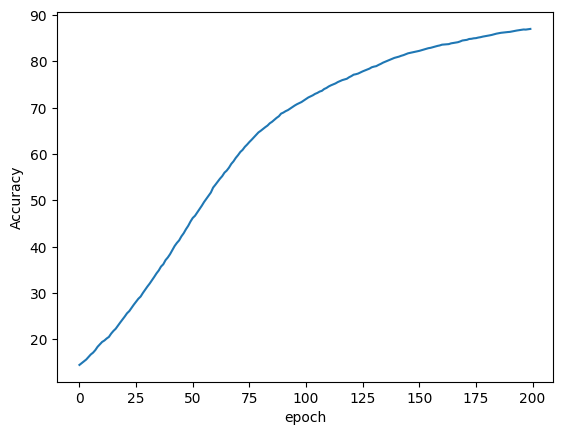

done
[]
4
20
4881


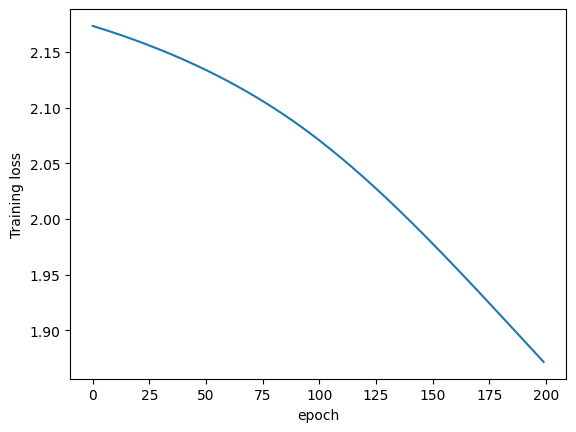

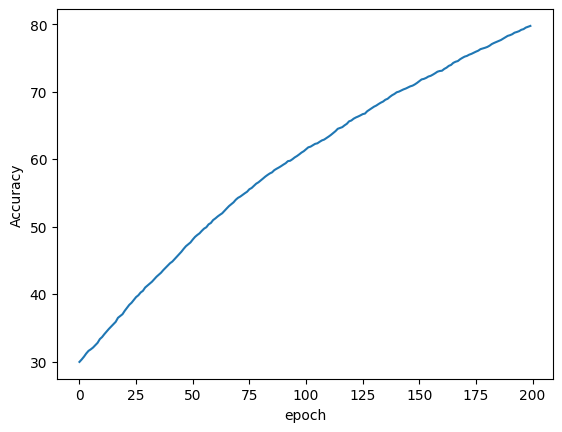

done
[]
4
20
4881


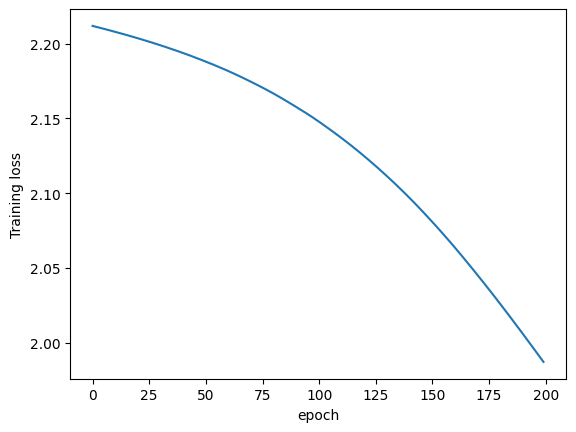

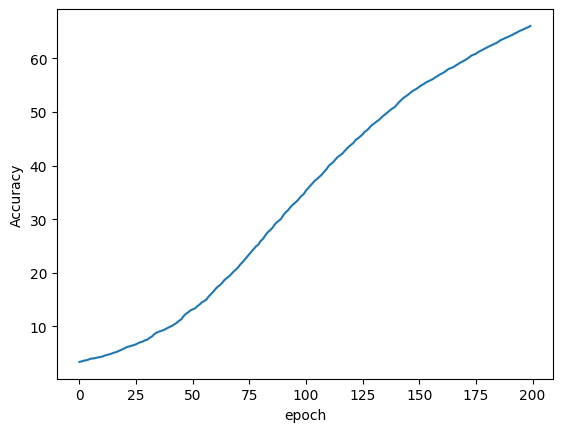

done
[]
4
20
4881


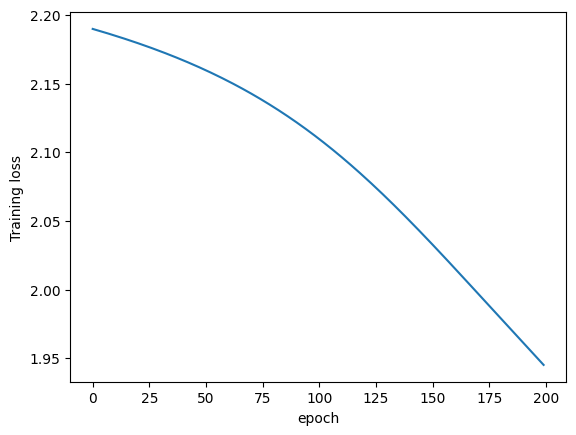

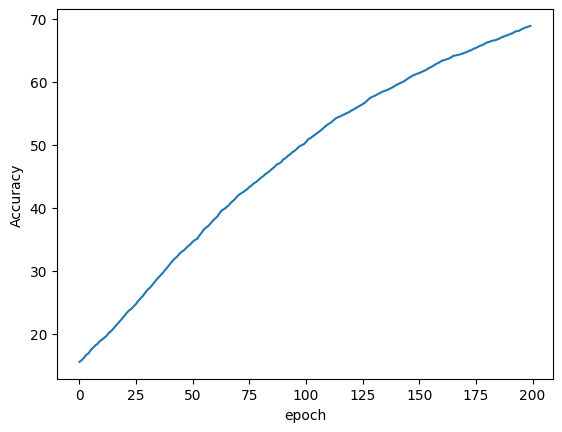

done
[]
4
20
4881


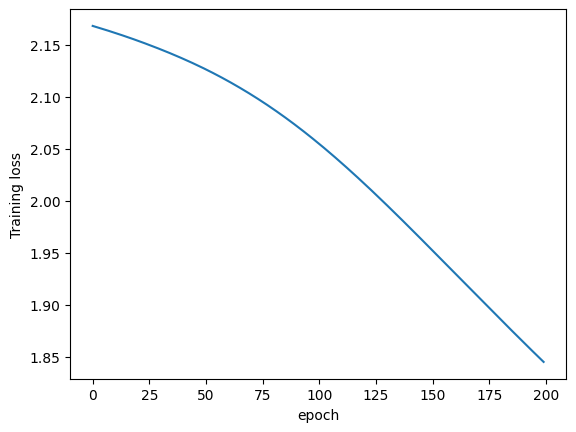

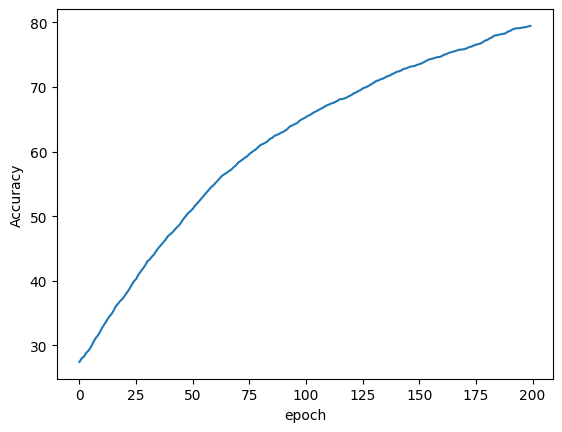

done
[]
4
tensor(2.8852, dtype=torch.float64)
tensor([0.1639, 0.7377, 3.8525, 5.2459, 4.4262], dtype=torch.float64)


In [42]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)






labels=torch.from_numpy(np.load("Data AI/label.npy")).type(torch.int)
groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=1220
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))-1]
labels_trainset=labels[:round(0.8*len(labels))]
while l<6100:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=244,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=20,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

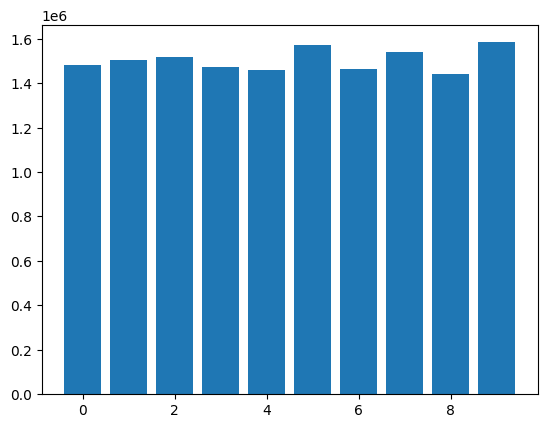

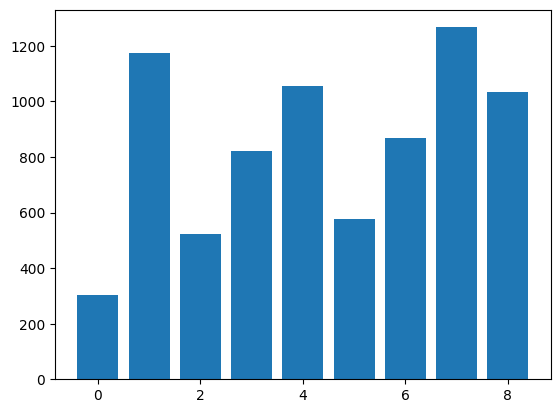

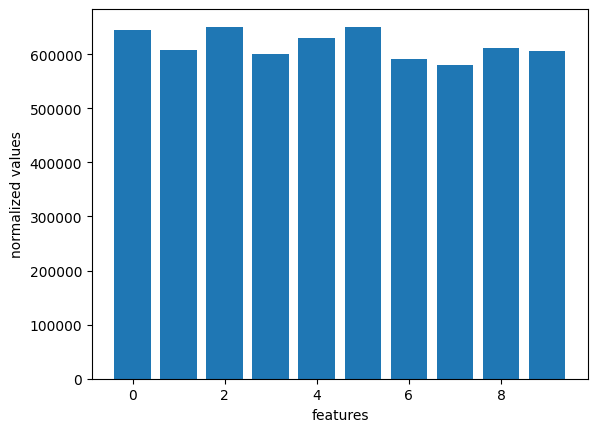

In [43]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=(np.load("Data AI/X_data.npy"))
labels=(np.load("Data AI/label.npy"))

X=X.reshape(len(X[0][0]),len(X)*len(X[0]))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()


norms=[]
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        norm+=abs((X[i][j]-mi)/(ma-mi))
    norms.append(norm)


    
plt.bar(x=features,height=norms)
plt.xlabel("features")
plt.ylabel("normalized values")
plt.show()

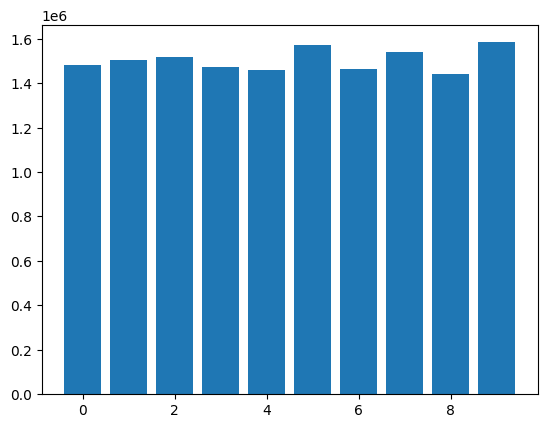

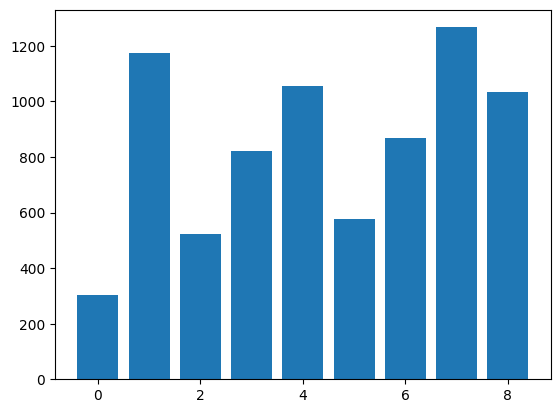

Label 0:  303


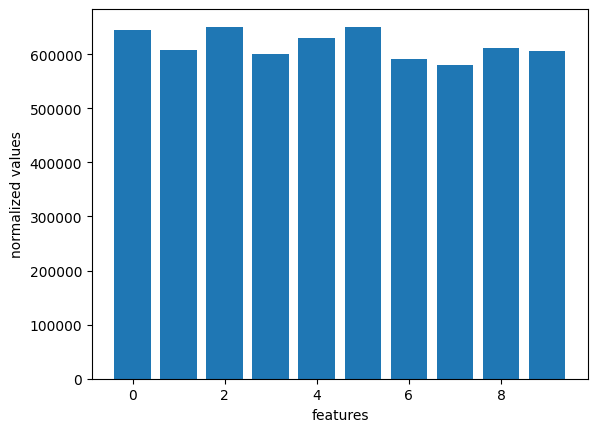

In [44]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=(np.load("Data AI/X_data.npy"))
labels=(np.load("Data AI/label.npy"))

X=X.reshape(len(X[0][0]),len(X)*len(X[0]))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

norms=[]
for i in range(0,len(X)):
    sum=0
    mi= np.min(X[i])
    ma=np.max(X[i])
    norm=0
    for j in range(0,len(X[0])):
        norm+=abs((X[i][j]-mi)/(ma-mi))
    norms.append(norm)


    
plt.bar(x=features,height=norms)
plt.xlabel("features")
plt.ylabel("normalized values")
plt.show()

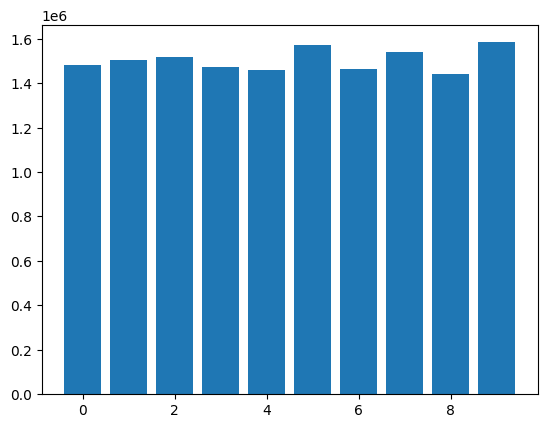

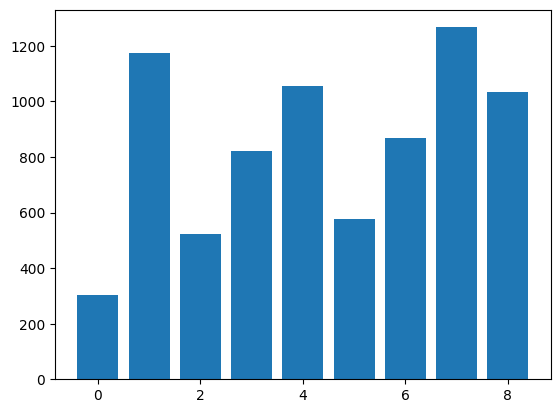

Label 0:  303


IndexError: index 303 is out of bounds for axis 0 with size 10

In [45]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=(np.load("Data AI/X_data.npy"))
labels=(np.load("Data AI/label.npy"))


X=X.reshape(len(X[0][0]),len(X)*len(X[0]))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

for i in range (0,len(labels)):
    if labels[i]>0.0 and count(label)>303:
                np.delete(labels,i)
                np.delete(X[i])

label_hash={}          
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

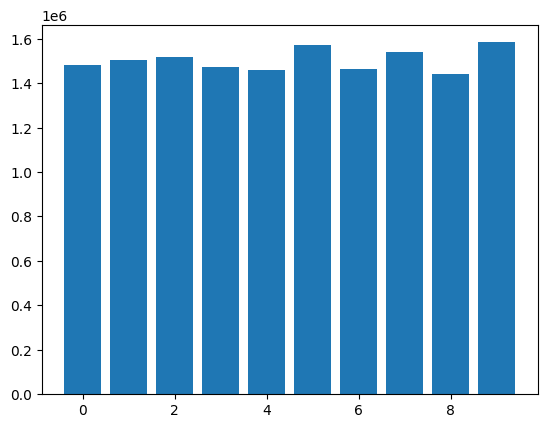

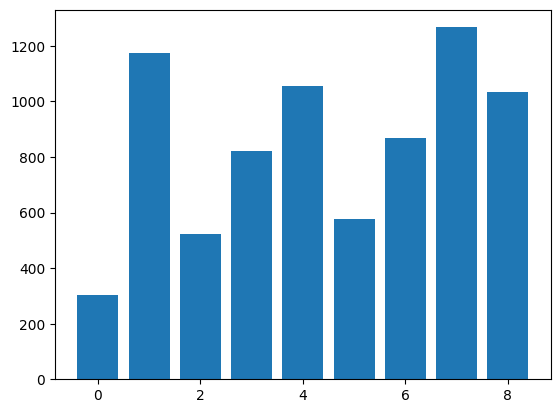

Label 0:  303


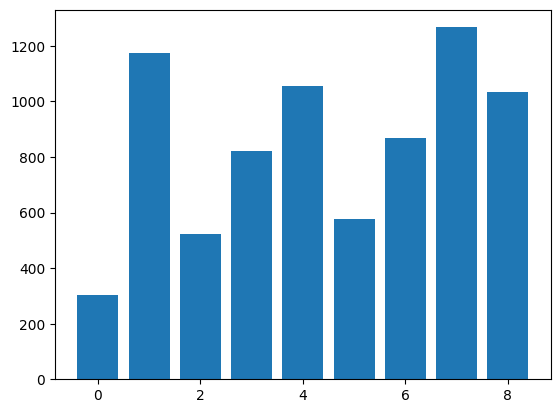

In [46]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=(np.load("Data AI/X_data.npy"))
labels=(np.load("Data AI/label.npy"))


X=X.reshape(len(X[0][0]),len(X)*len(X[0]))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

for i in range (0,len(labels)):
    if labels[i]>0.0 and count(label)>303:
                np.delete(labels,i)
                np.delete(X,i)

label_hash={}          
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

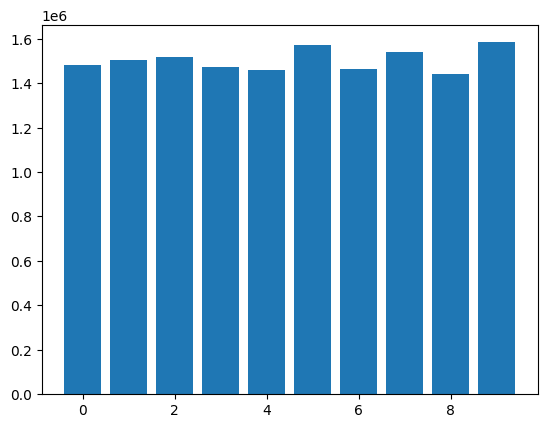

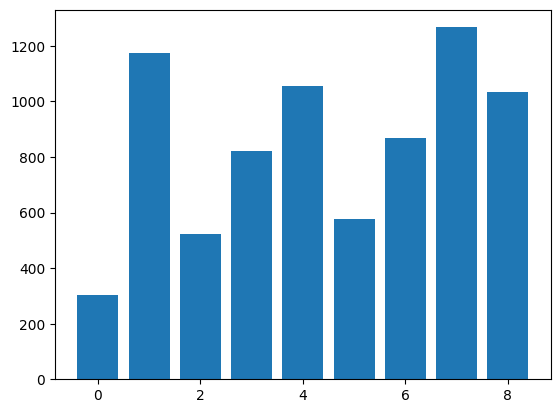

Label 0:  303


IndexError: list index out of range

In [48]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=np.load("Data AI/X_data.npy")
X_org=X.reshape(7626,1280)
labels=list(np.load("Data AI/label.npy"))


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])


for i in range (303,len(labels)):
    if labels[i]>0.0 and count(labels[i])>303:
                del labels[i]
                X_org=np.delete(X_org,i,0)

label_hash={}          
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

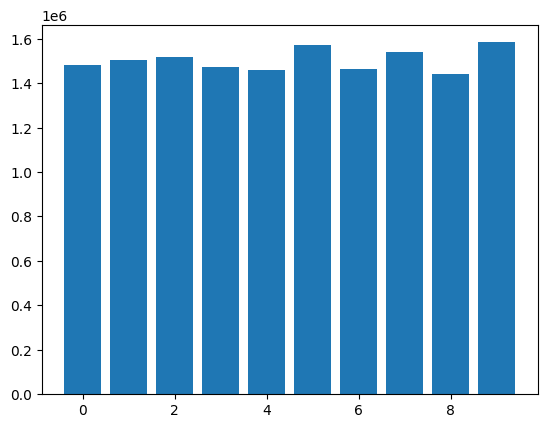

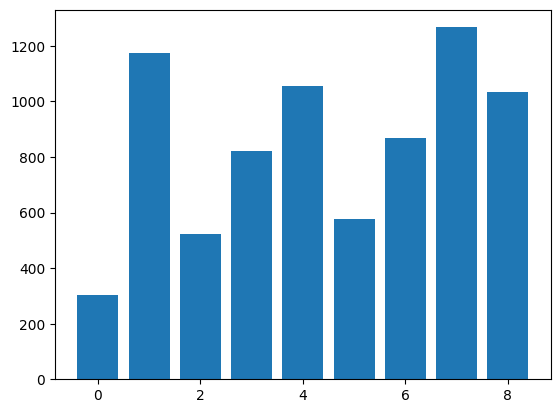

Label 0:  303


IndexError: list index out of range

In [49]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=np.load("Data AI/X_data.npy")
X_org=X.reshape(7626,1280)
labels=list(np.load("Data AI/label.npy"))


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])


for i in range (303,len(labels)):
    if labels[i]>0.0 and count(labels[i])>303:
                del labels[i]
                i=i-1
                X_org=np.delete(X_org,i,0)

label_hash={}          
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

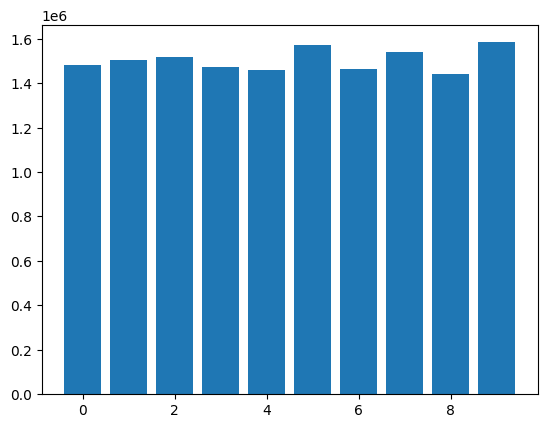

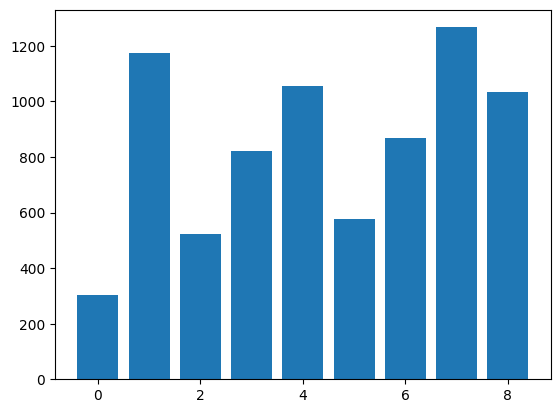

Label 0:  303


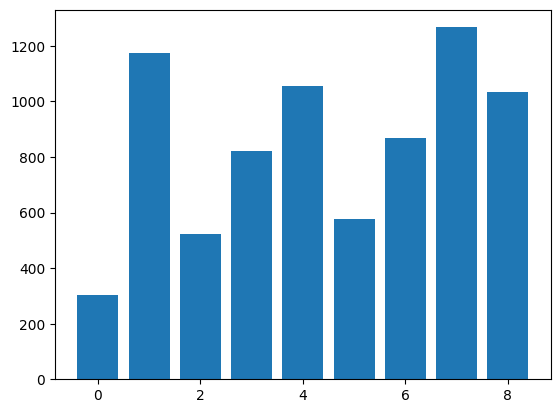

In [50]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=np.load("Data AI/X_data.npy")
X_org=X.reshape(7626,1280)
labels=list(np.load("Data AI/label.npy"))


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

i=303
while i!=len(labels):
    if labels[i]>0.0 and count(labels[i])>303:
                del labels[i]
                X_org=np.delete(X_org,i,0)
                i=i
    else:
         i=i+1

label_hash={}          
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

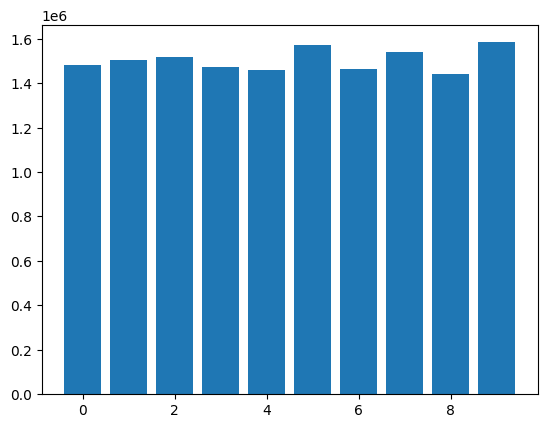

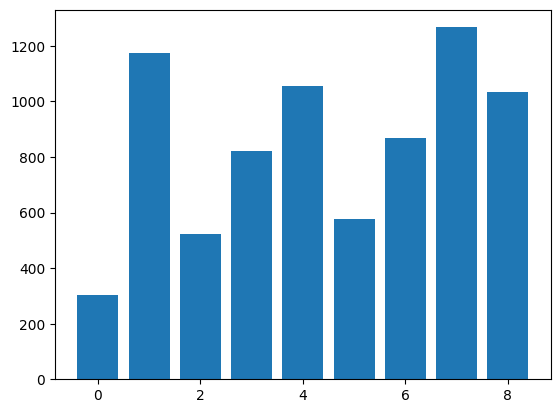

Label 0:  303


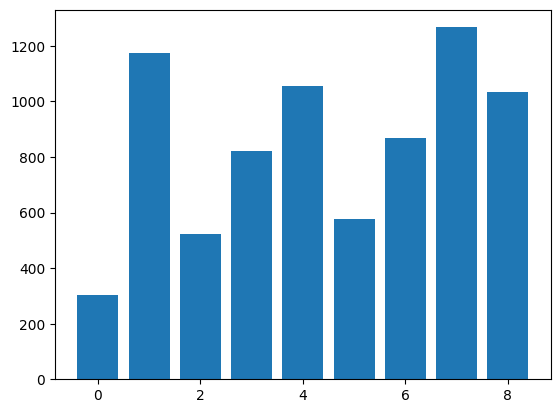

In [51]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=np.load("Data AI/X_data.npy")
X_org=X.reshape(7626,1280)
labels=list(np.load("Data AI/label.npy"))


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

i=303
while i!=len(labels):
    if labels[i]>0.0 and count(labels[i])>303:
                del labels[i]
                X_org=np.delete(X_org,i,0)
                i=i
    else:
         i=i+1

label_hash={}    
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)      
    
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

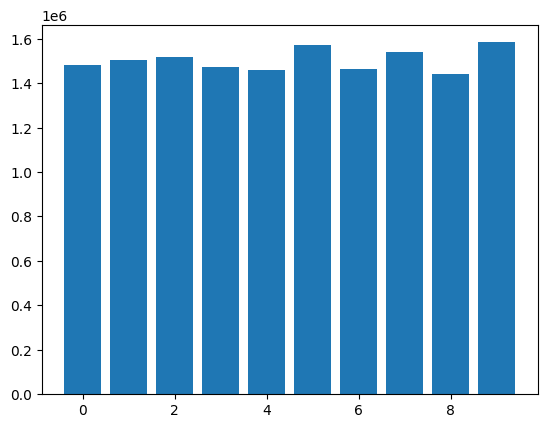

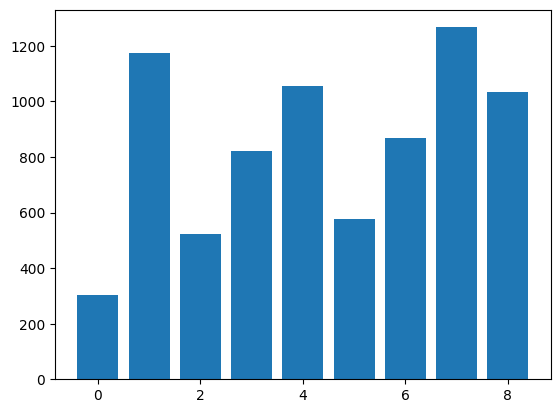

Label 0:  303


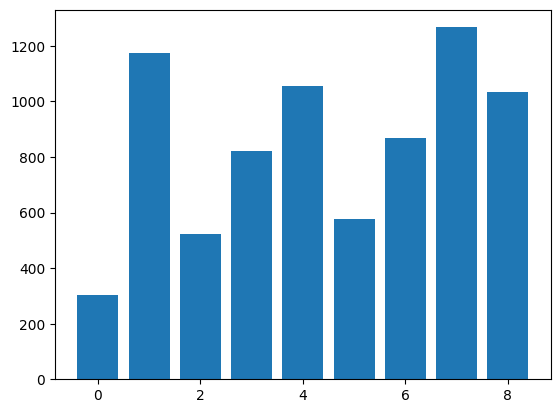

303
303
303
303
303
303
303
303
303


In [52]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
X=np.load("Data AI/X_data.npy")
X_org=X.reshape(7626,1280)
labels=list(np.load("Data AI/label.npy"))


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

i=303
while i!=len(labels):
    if labels[i]>0.0 and count(labels[i])>303:
                del labels[i]
                X_org=np.delete(X_org,i,0)
                i=i
    else:
         i=i+1

label_hash={}    
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)      

for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()

i=0.0
while i<9.0:
 print(count(i))
 i+=1.0
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

torch.Size([2727, 128, 10])
torch.Size([2727])
Data loaded
101
1212


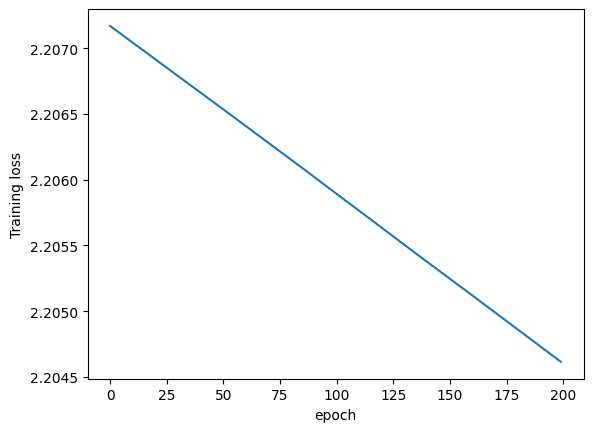

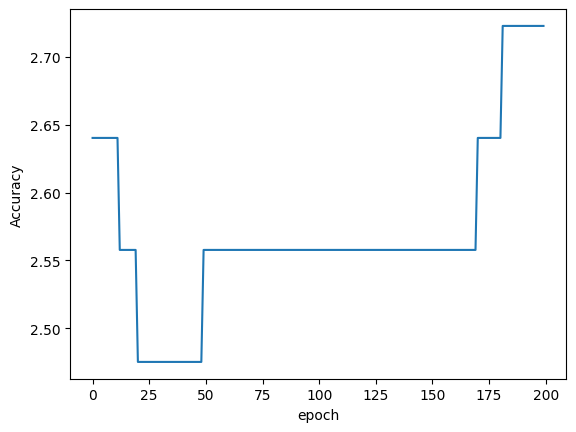

done
[]
5
101
606


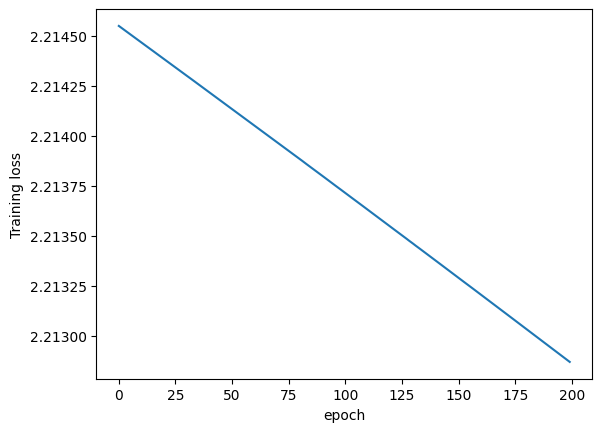

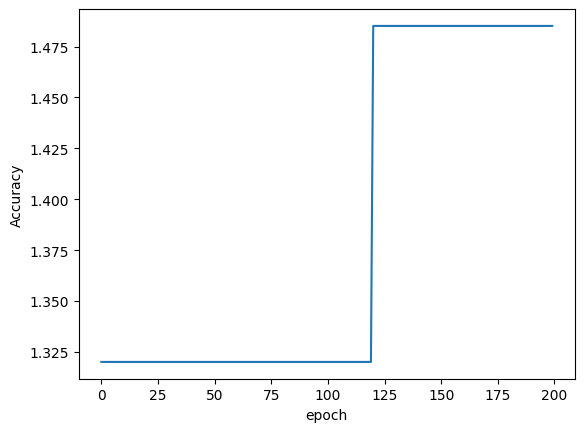

done
[]
11
tensor(9.9422, dtype=torch.float64)
tensor([ 2.1452, 17.7393], dtype=torch.float64)


In [53]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("undersampled_data.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("undersampled_labels.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=606
acc=[]
losses=[]
X_trainset=X[:1818]

labels_trainset=labels[:1818]
while l<1818:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=101,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=101,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([2727, 128, 10])
torch.Size([2727])
Data loaded
101
1212


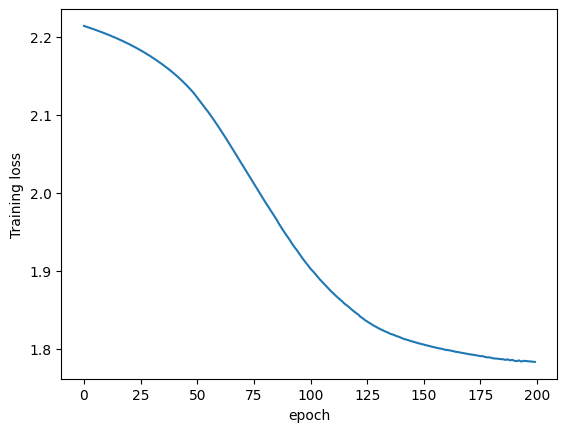

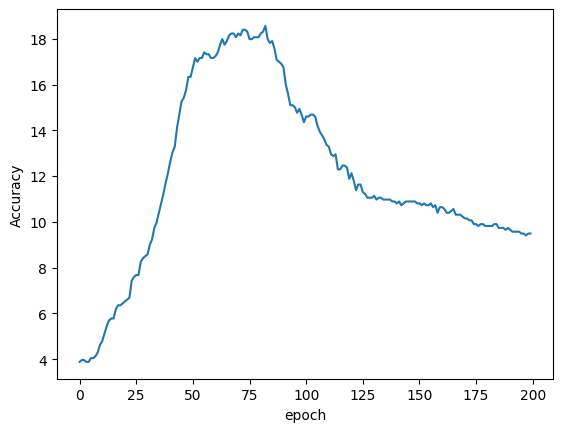

done
[]
5
101
606


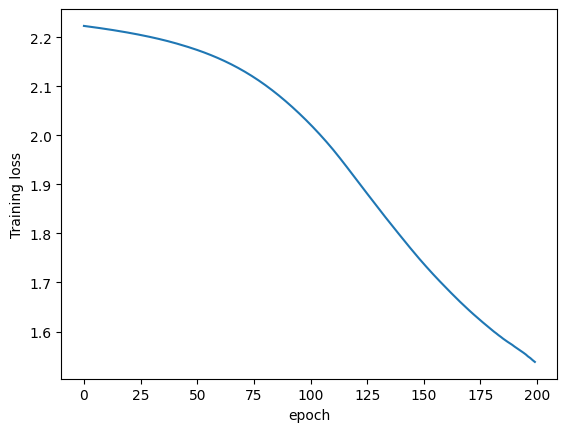

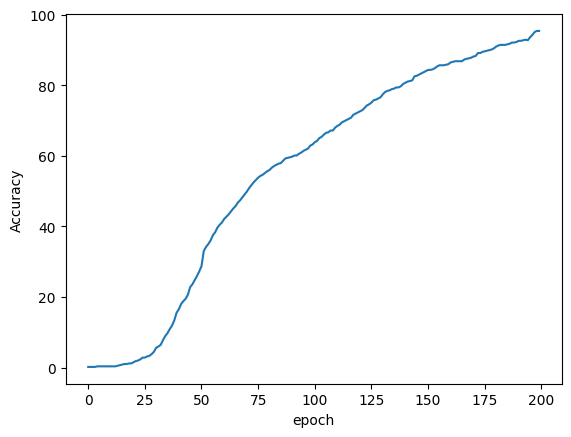

done
[]
11
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [54]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("undersampled_data.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("undersampled_labels.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=606
acc=[]
losses=[]
X_trainset=X[:1818]

labels_trainset=labels[:1818]
while l<1818:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=101,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=101,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([2727, 128, 10])
torch.Size([2727])
Data loaded
101
1212


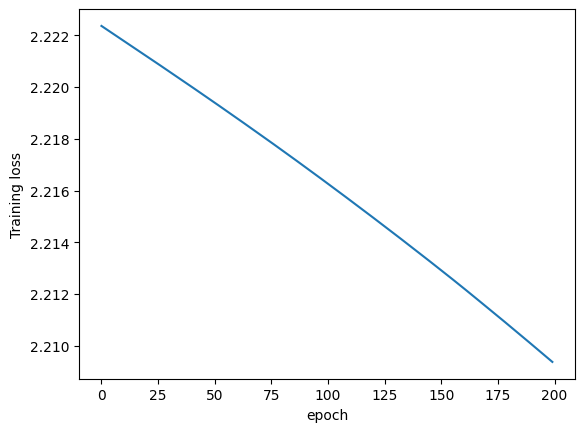

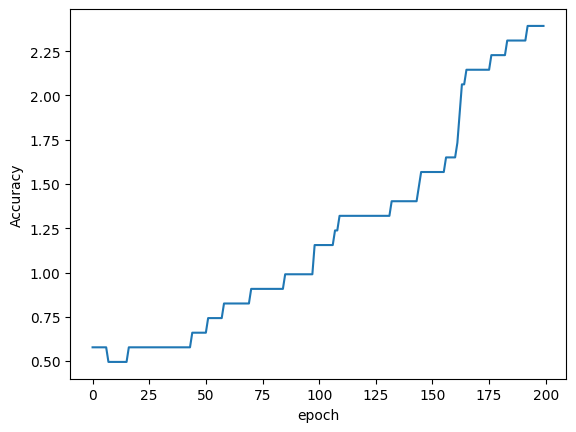

done
[]
5
101
606


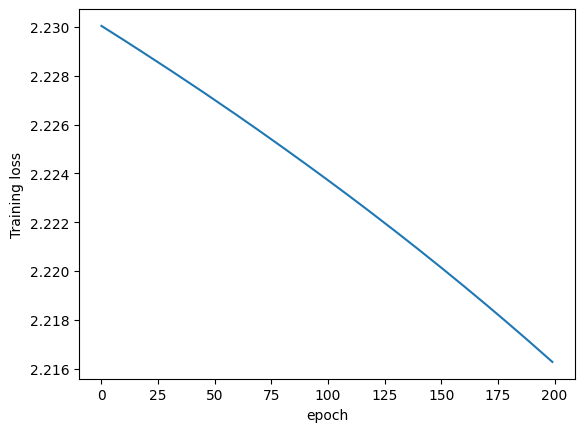

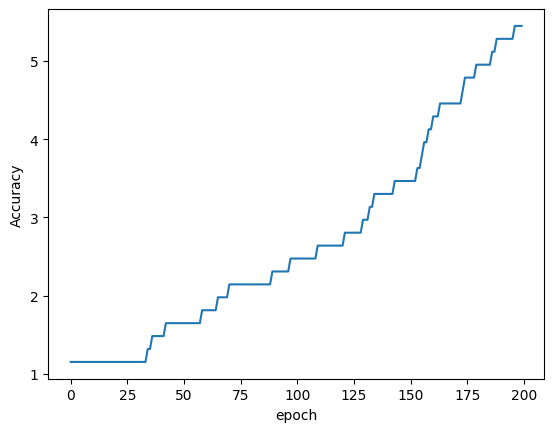

done
[]
11
tensor(3.1766, dtype=torch.float64)
tensor([0.6601, 5.6931], dtype=torch.float64)


In [55]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("undersampled_data.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("undersampled_labels.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=606
acc=[]
losses=[]
X_trainset=X[:1818]

labels_trainset=labels[:1818]
while l<1818:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=101,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=101,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([2727, 128, 10])
torch.Size([2727])
Data loaded
101
1212


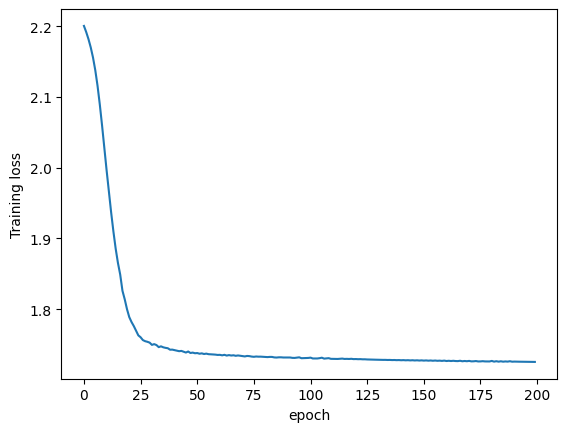

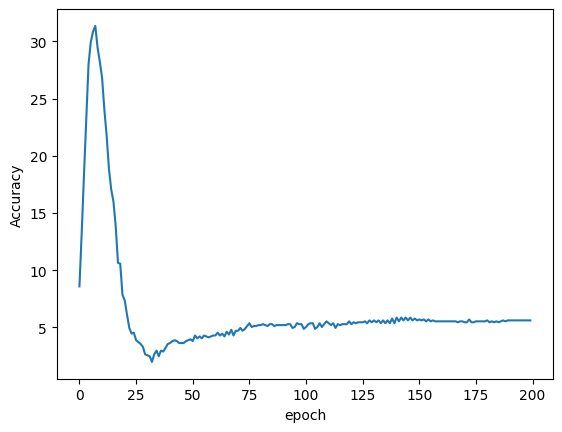

done
[]
5
101
606


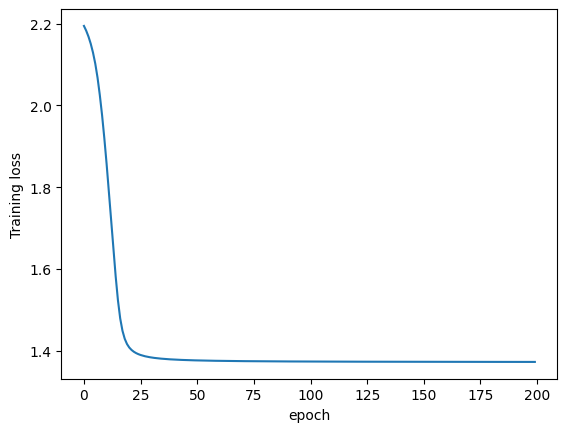

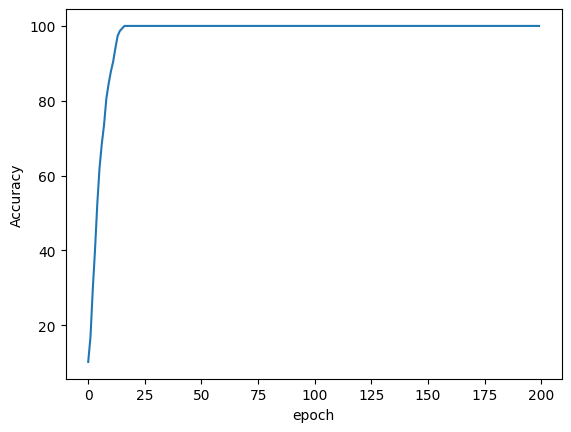

done
[]
11
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [56]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("undersampled_data.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("undersampled_labels.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=606
acc=[]
losses=[]
X_trainset=X[:1818]

labels_trainset=labels[:1818]
while l<1818:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=101,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=101,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


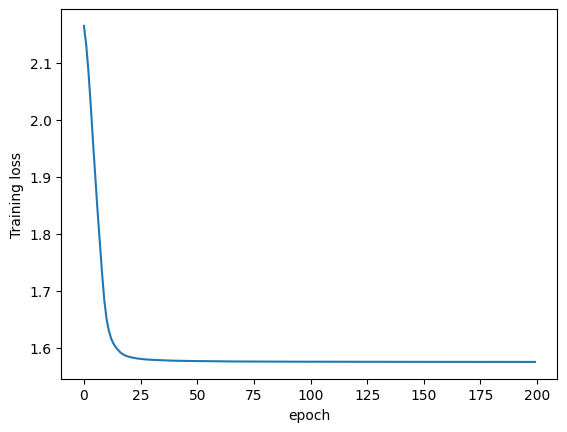

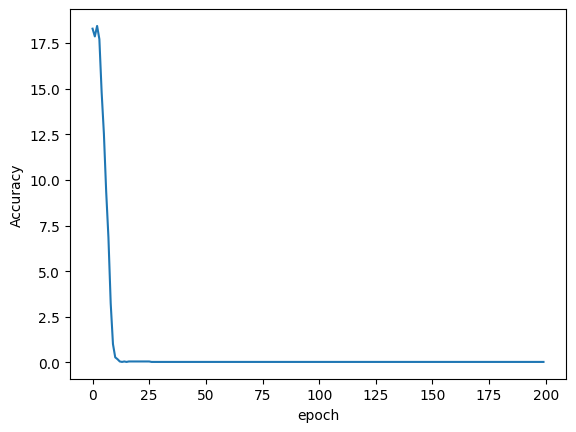

done
[]
12
307
6762


RuntimeError: shape '[307, 1280]' is invalid for input of size 10240

In [60]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+1220
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


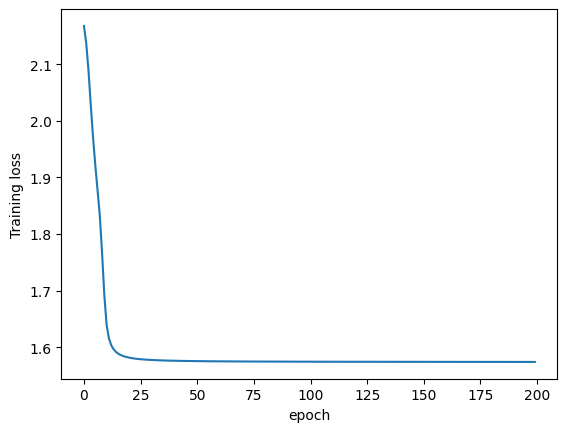

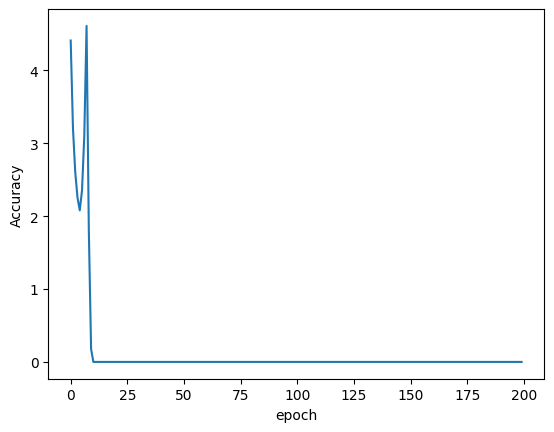

done
[]
12
307
3991


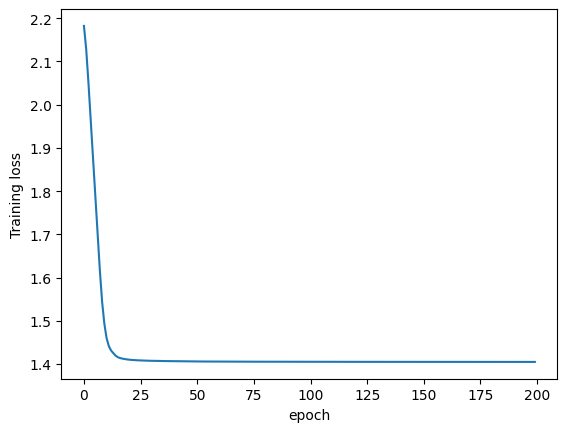

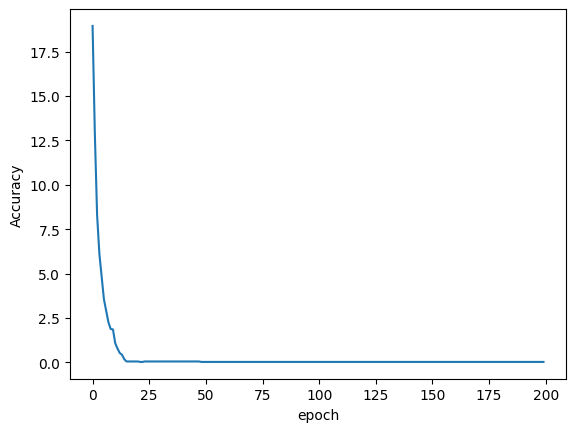

done
[]
12
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [61]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


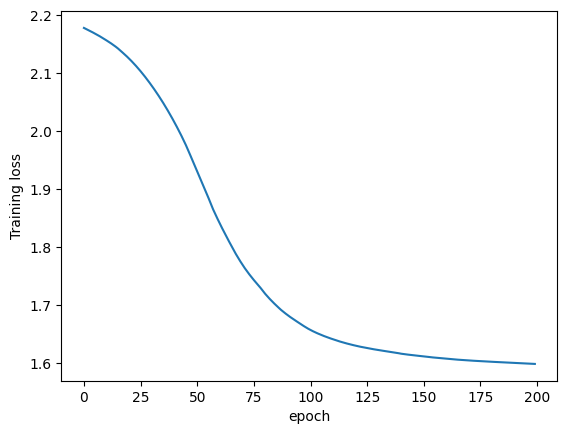

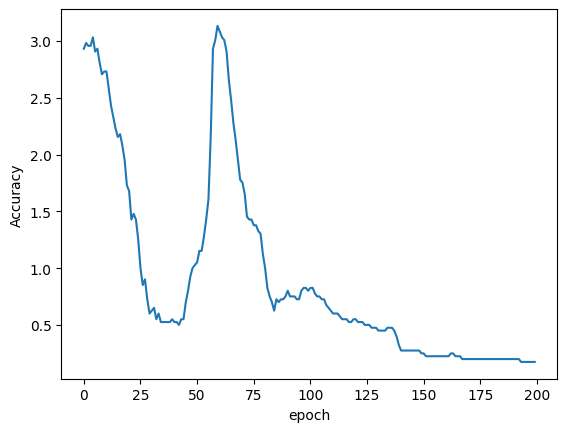

done
[]
12
307
3991


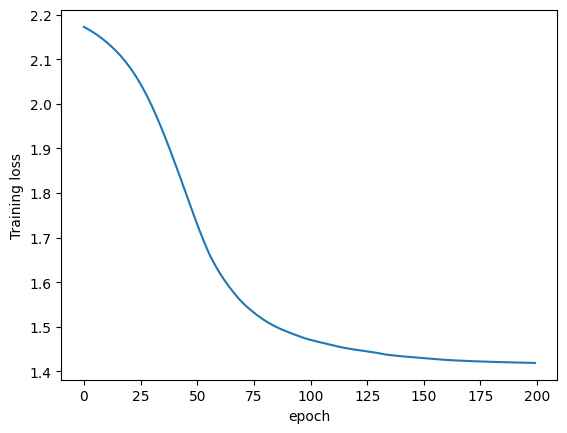

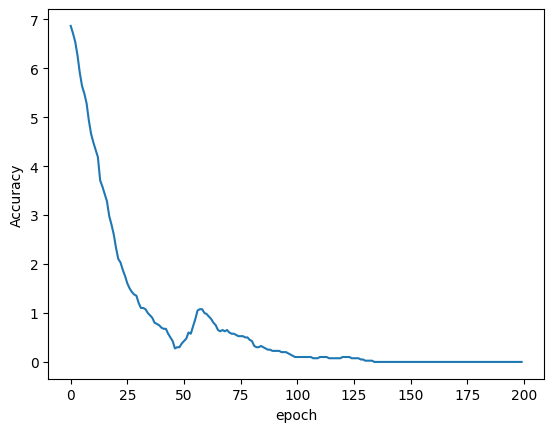

done
[]
12
tensor(0.1754, dtype=torch.float64)
tensor([0.0000, 0.3508], dtype=torch.float64)


In [62]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


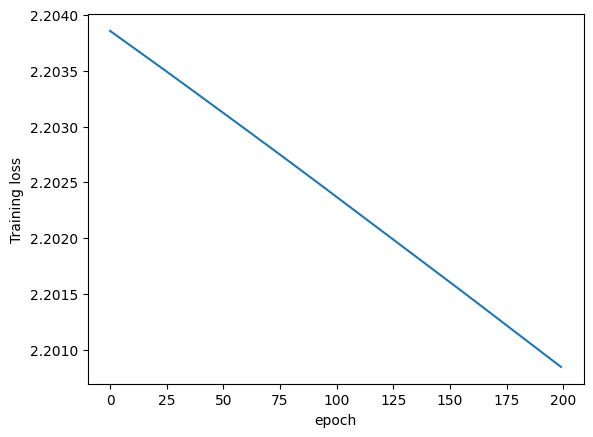

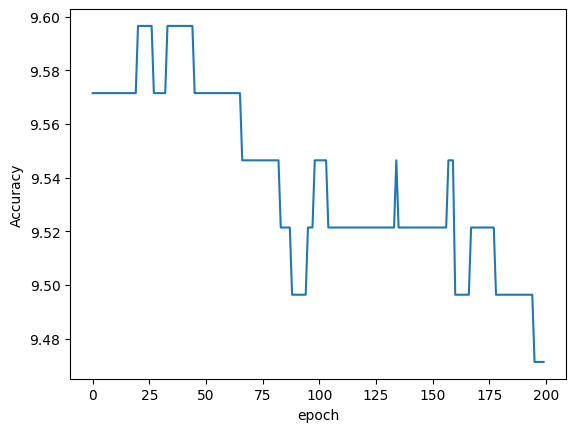

done
[]
12
307
3991


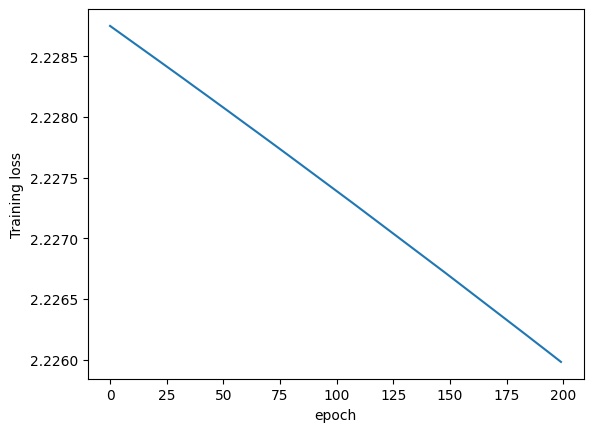

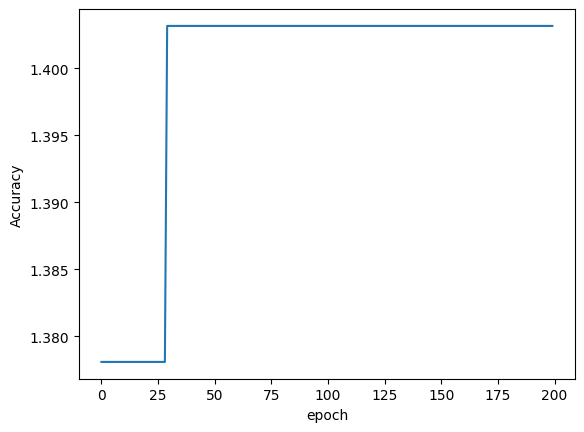

done
[]
12
tensor(16.4996, dtype=torch.float64)
tensor([ 5.6878, 27.3115], dtype=torch.float64)


In [63]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


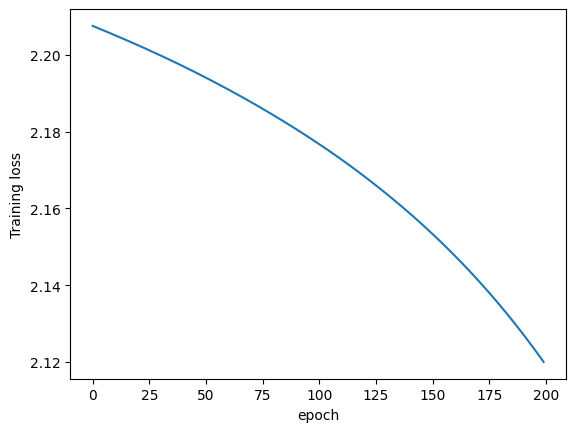

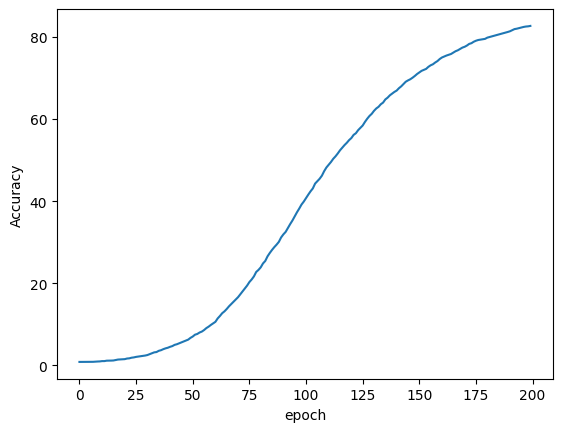

done
[]
306
13
3991


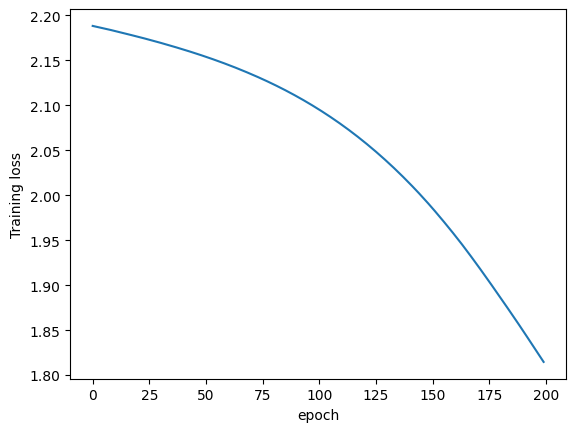

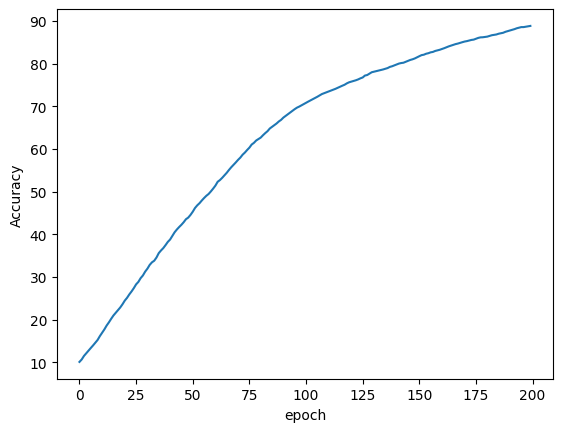

done
[]
306
tensor(0.5763, dtype=torch.float64)
tensor([0.9271, 0.2255], dtype=torch.float64)


In [64]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=13,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

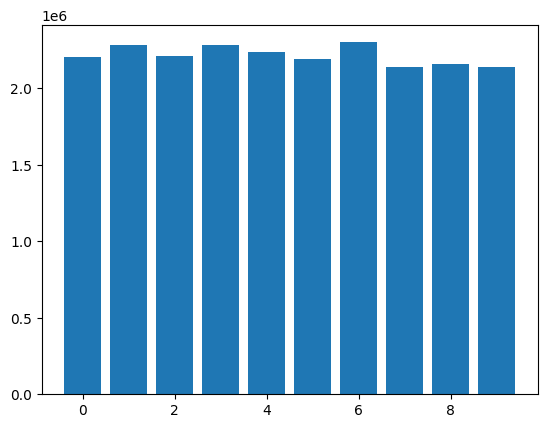

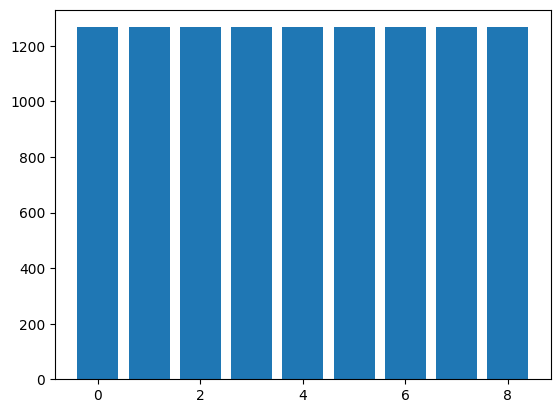

Label 0:  1267


In [65]:
import sklearn
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch import nn
import math
#Loading data 
from imblearn.over_sampling import SMOTE
X=np.load("X_oversample.npy")
X_org=X.reshape(11403,1280)
labels=list(np.load("labels_oversample.npy"))
#labels_org=np.load("Data AI/label.npy")


X=list(X.reshape(len(X[0][0]),len(X)*len(X[0])))


total=[]
label_hash={}
norm_total=[]
features=[]

#Oversampling
#sm= SMOTE(sampling_strategy='auto',random_state=0,k_neighbors=5)
#X_res,Y_res= sm.fit_resample(X_org,labels_org)
#print(len(X_res))
#print(len(Y_res))

#X_res=X_res.reshape(11403,128,10)
#np.save("X_oversample.npy",X_res)
#np.save("labels_oversample.npy",Y_res)

#Displaying the total value of each feature on  a graph
for i in range(0,len(X)):
    sum=0
    for j in range(0,len(X[0])):
        sum+=abs(X[i][j])
    total.append(sum)
    features.append(i)





plt.bar(x=features, height=total)
plt.show()

#Displaing the number of samples in each class as a graph
for label in labels:
    label_hash[label]=1+label_hash.get(label,0)

def count(l):
    count=0
    for label in labels:
        if(label==l):
            count+=1
    return(count)

label_names=[]
label_values=[]
for label in label_hash:
    label_names.append(label)
    label_values.append(label_hash[label])

plt.bar(x=label_names,height=label_values)
plt.show()
print("Label 0: ", label_hash[0])

#i=303
#while i!=len(labels):
 #   if labels[i]>0.0 and count(labels[i])>303:
  #              del labels[i]
   #             X_org=np.delete(X_org,i,0)
    #            i=i
    #else:
     #    i=i+1

#label_hash={}    
#for label in labels:
 #   label_hash[label]=1+label_hash.get(label,0)      

#for label in label_hash:
 #   label_names.append(label)
  #  label_values.append(label_hash[label])

#plt.bar(x=label_names,height=label_values)
#plt.show()

#i=0.0
#while i<9.0:
 # print(count(i))
  #i+=1.0
#X_org=X_org.reshape(2727,128,10)

np.save("undersampled_data.npy",X_org)
np.save("undersampled_labels.npy",labels)
#norms=[]
#for i in range(0,len(X)):
 #   sum=0
  #  mi= np.min(X[i])
  #  ma=np.max(X[i])
   # norm=0
   # for j in range(0,len(X[0])):
   #     norm+=abs((X[i][j]-mi)/(ma-mi))
    #norms.append(norm)


    
#plt.bar(x=features,height=norms)
#plt.xlabel("features")
#plt.ylabel("normalized values")
#plt.show()

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


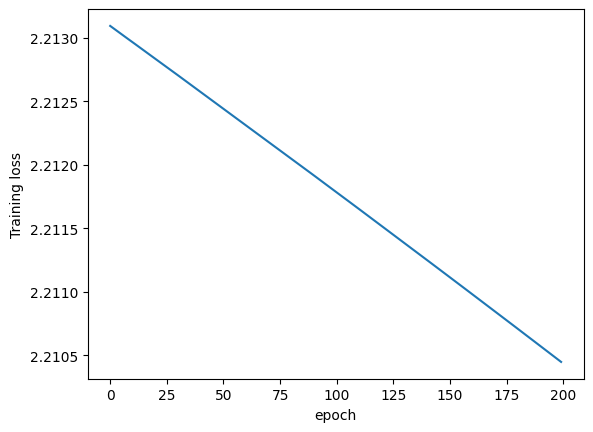

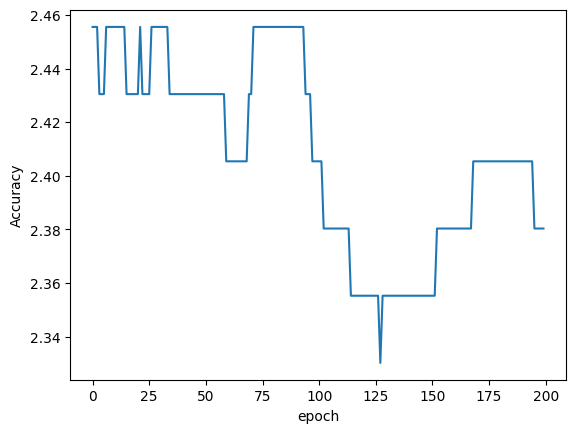

done
[]
12
307
3991


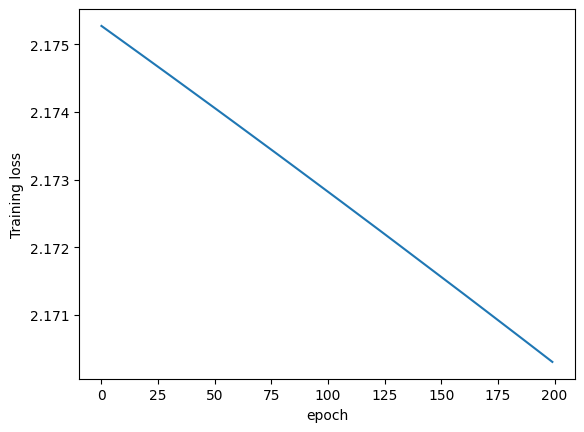

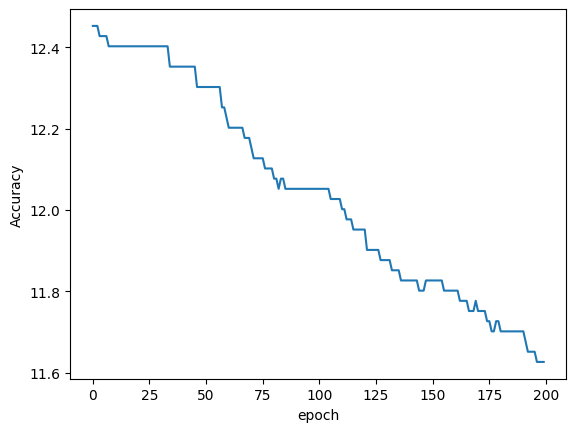

done
[]
12
tensor(15.6101, dtype=torch.float64)
tensor([28.2636,  2.9567], dtype=torch.float64)


In [66]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),

        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
3991


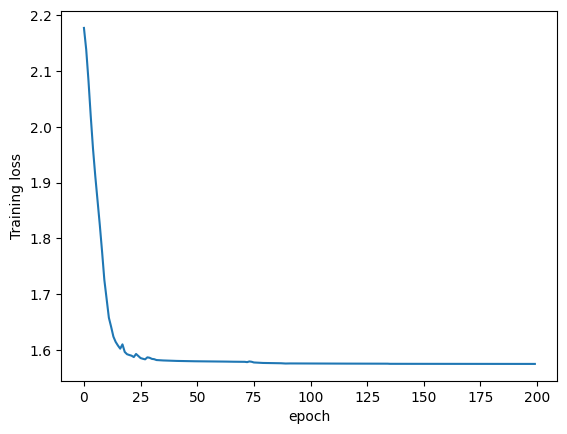

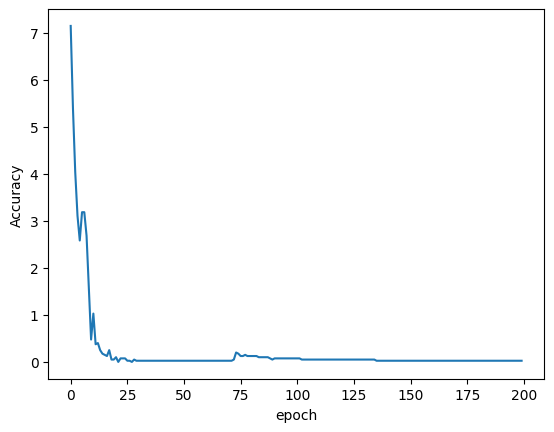

done
[]
12
307
3991


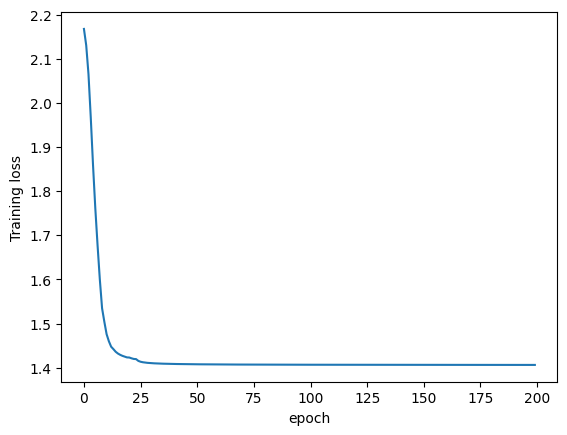

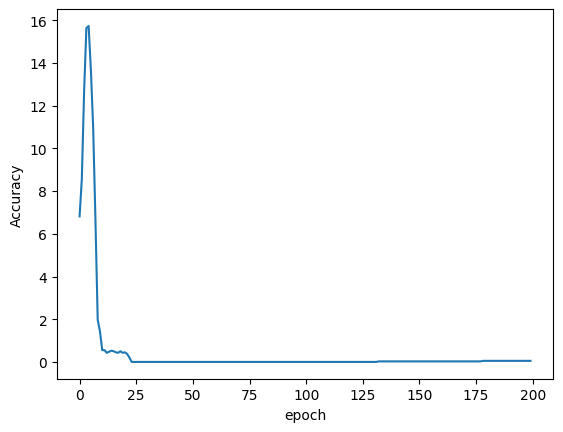

done
[]
12
tensor(0.1002, dtype=torch.float64)
tensor([0.0251, 0.1754], dtype=torch.float64)


In [67]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),

        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=307,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


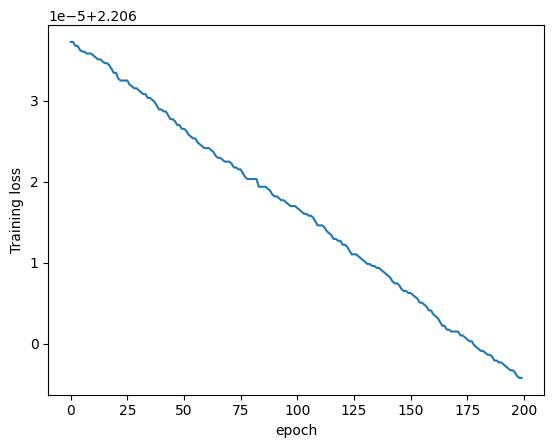

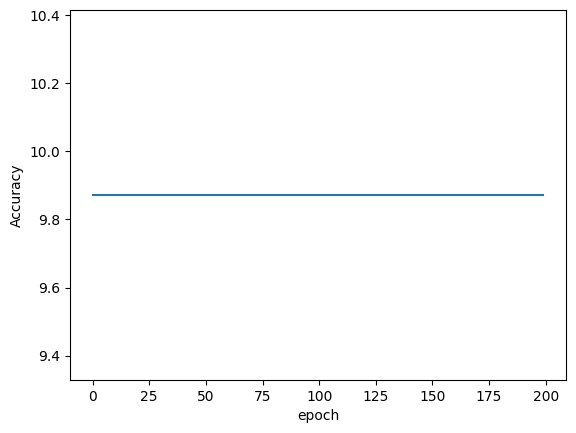

done
[]
12
13
3991


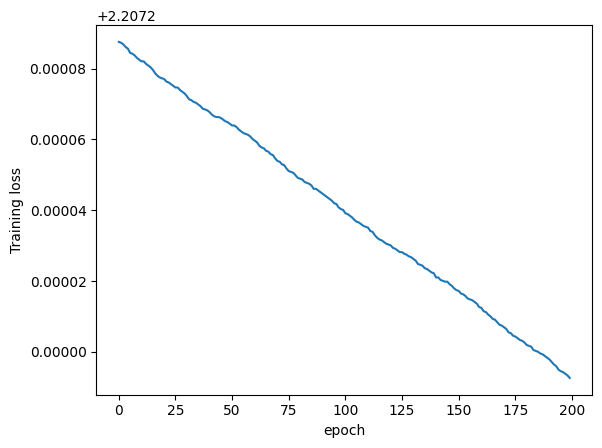

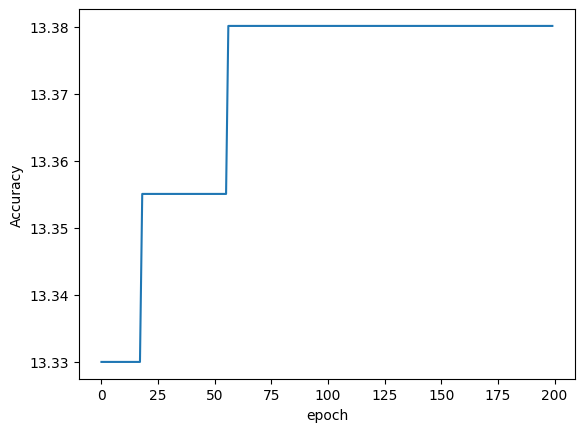

done
[]
12
tensor(3.8837, dtype=torch.float64)
tensor([1.4032, 6.3643], dtype=torch.float64)


In [68]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),

        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0000001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


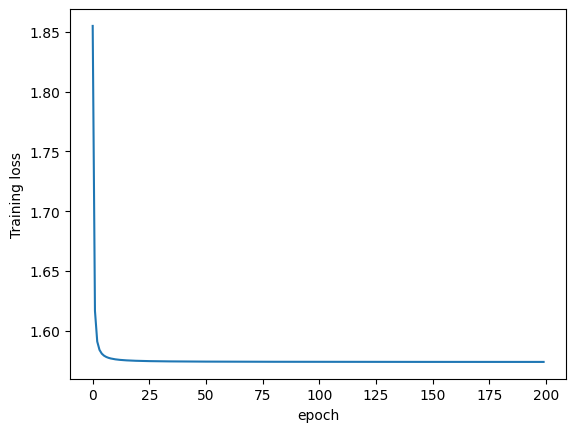

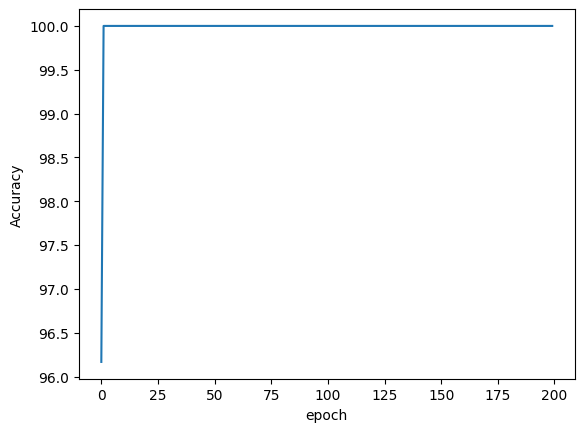

done
[]
12
13
3991


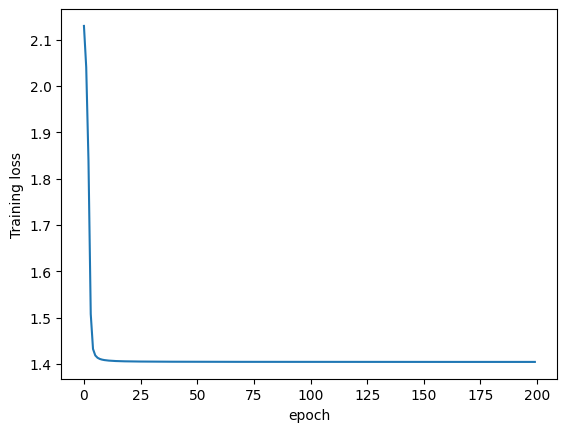

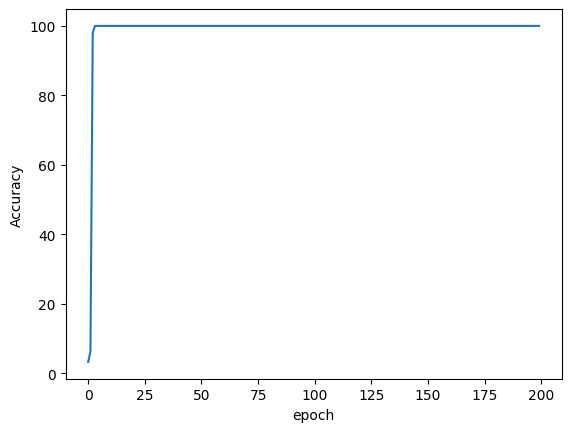

done
[]
12
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [69]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


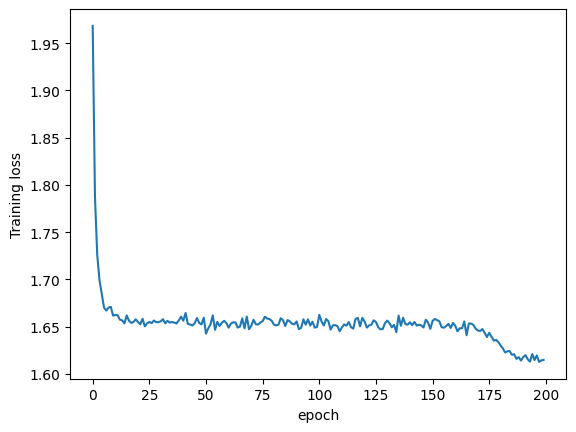

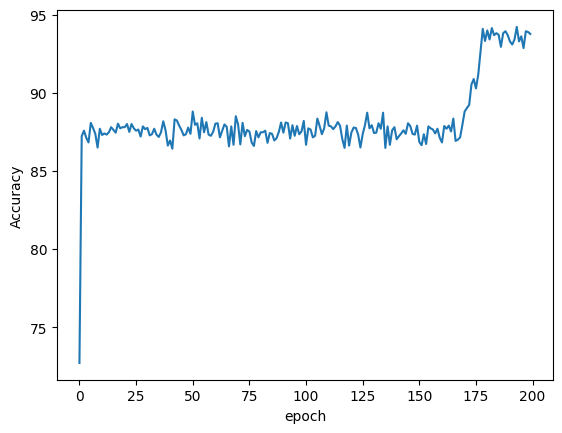

done
[]
12
13
3991


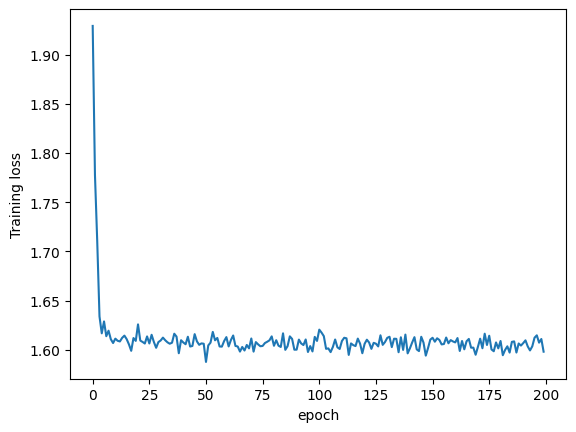

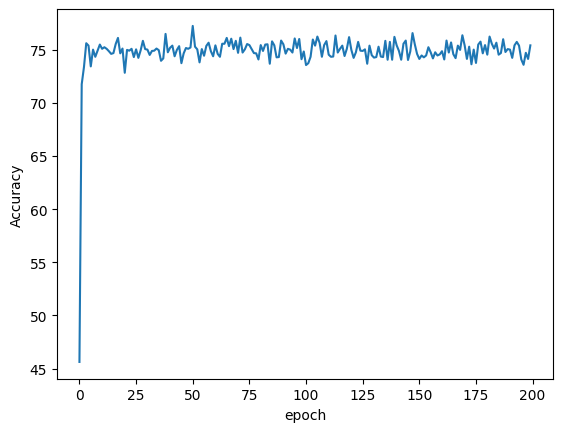

done
[]
12
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [70]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.LeakyReLU(),
        nn.Dropout(p=0.5),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


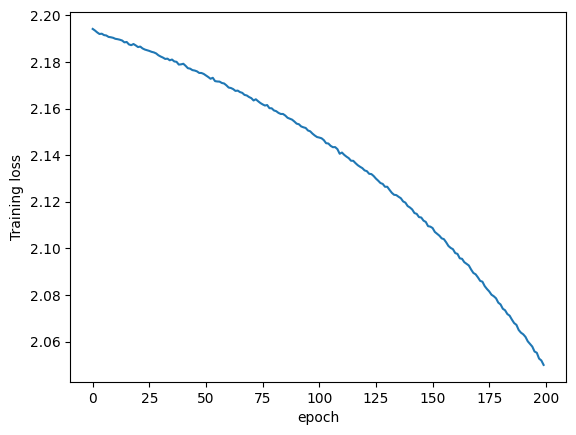

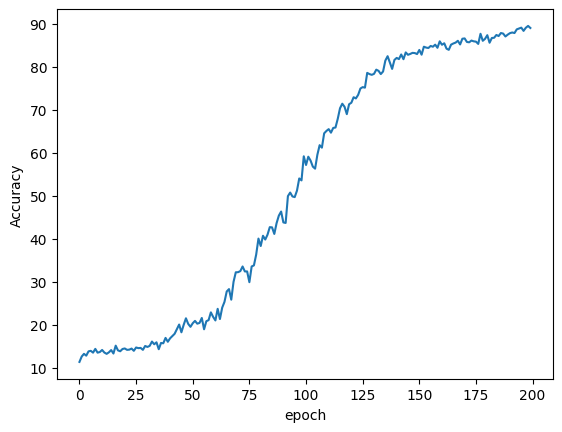

done
[]
12
13
3991


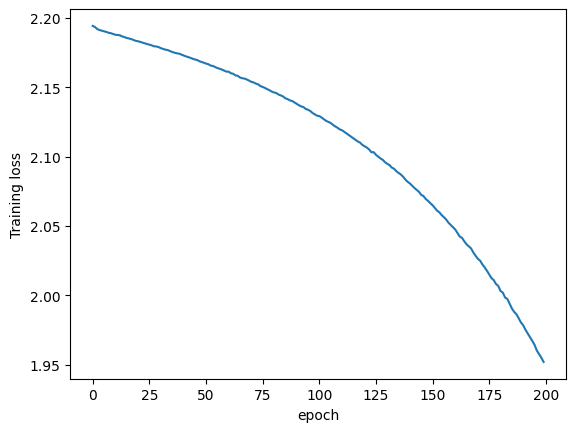

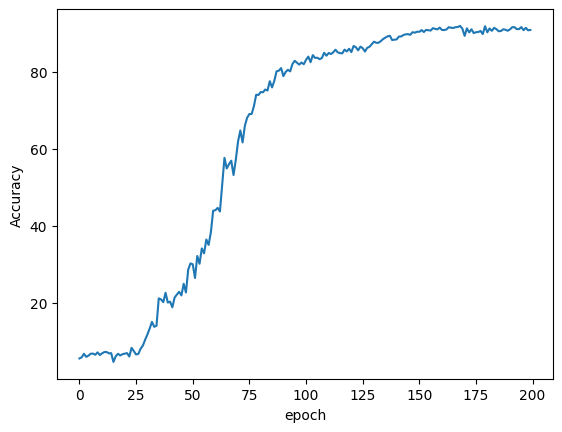

done
[]
12
tensor(0., dtype=torch.float64)
tensor([0., 0.], dtype=torch.float64)


In [71]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.Dropout(p=0.9),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.CrossEntropyLoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


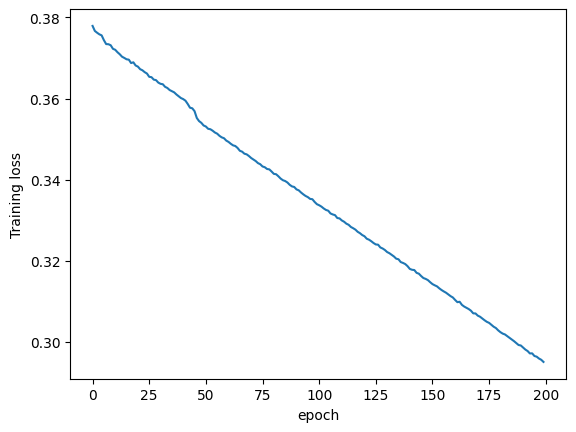

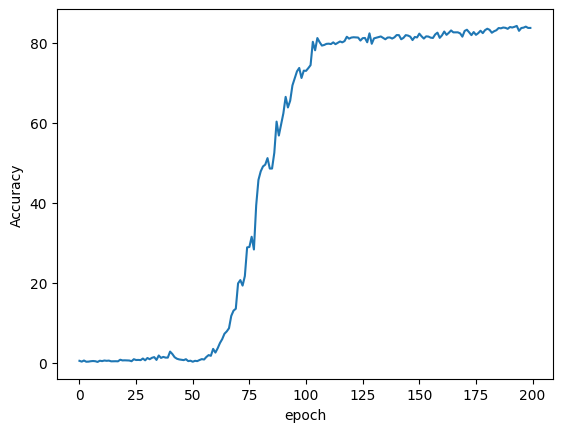

done
[]
12
13
3991


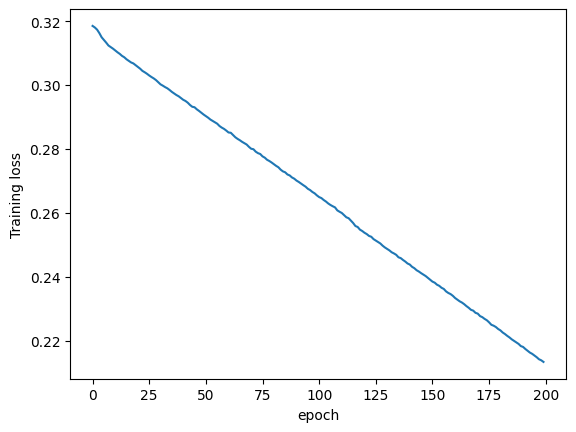

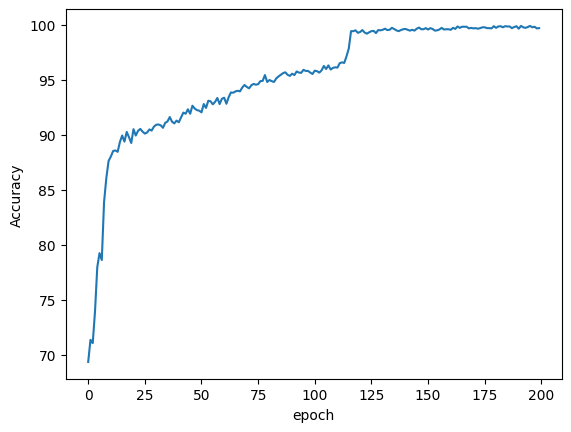

done
[]
12
tensor(0.2255, dtype=torch.float64)
tensor([0.0752, 0.3758], dtype=torch.float64)


In [72]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.Dropout(p=0.9),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
13
3991


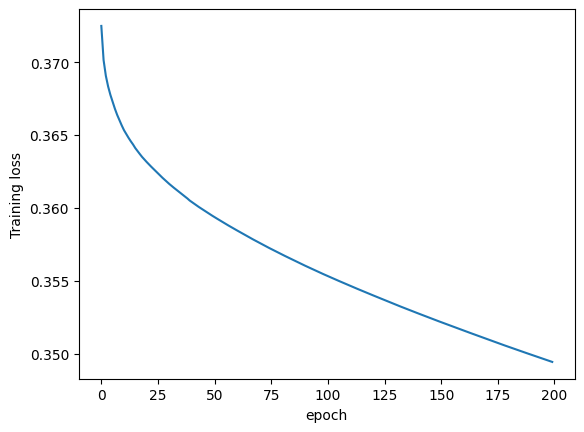

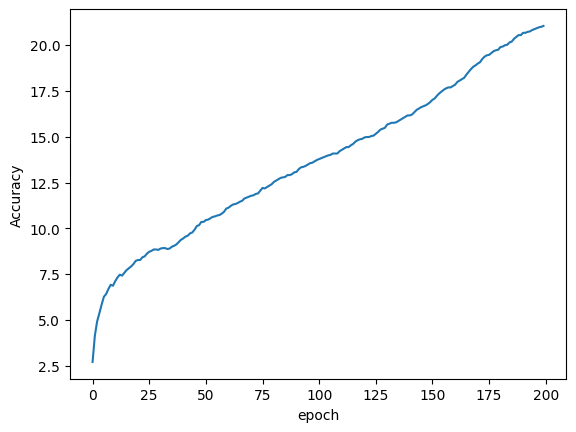

done
[]
12
13
3991


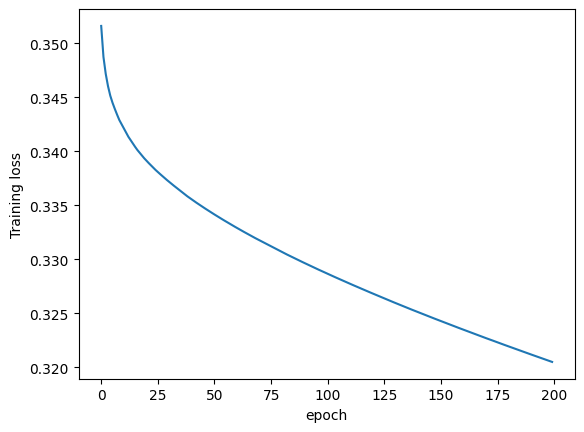

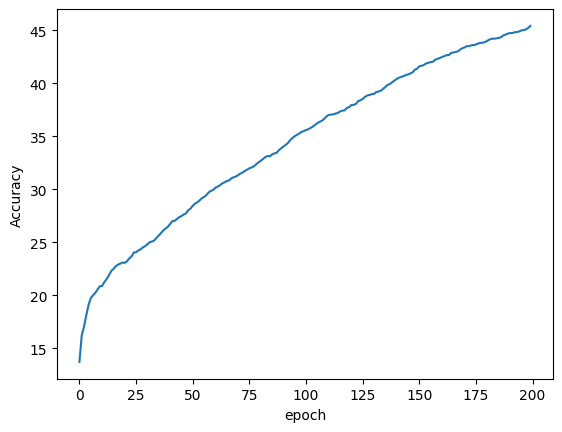

done
[]
12
tensor(3.2824, dtype=torch.float64)
tensor([0.4260, 6.1388], dtype=torch.float64)


In [73]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)


#Validation Sequence
def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_val[i:i+X_val.batch_size]
      labels_to_compare=[]
      for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
      labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
      test_loss+=loss_func(test_prediction,labels_to_compare)
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))
while l<7982:
    X_val=DataLoader(dataset=X_trainset[l:r],batch_size=307,shuffle=False)
    y_val=labels[l:r] 
    set=len(torch.cat((X_trainset[:l],X_trainset[r:]), dim=0))
    X_train=DataLoader(dataset=torch.cat((X_trainset[:l],X_trainset[r:]), dim=0),batch_size=13,shuffle=False)
    y_train=torch.cat((labels_trainset[:l],labels_trainset[r:]),dim=0)

    #Sanity checking
    print(X_train.batch_size)
    print(len(y_train))
    
    #Creating one hot encoding tags
    for num in range(0,9):
        distribution=[0]*9
        distribution[num]=1
        tags[num]=distribution



    #Declaring a Nueral network model
    model=NueralNet()
 


    #Defining loss function and learning rate
    optimizer=torch.optim.Adagrad(params=model.parameters(),lr=0.0001)
    loss_func=torch.nn.BCELoss()

    #Training
    train_acc=0
    losses=[]
    accuracy=[]
    epochs=[]
    distributions=[]
    for epoch in range(200):
        model.train()
        train_loss=0
        train_acc=0
        for i,sample_i in enumerate(X_train):
            optimizer.zero_grad()
            train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

        #print(i)
        average_loss=(train_loss/(i+1))
        average_accuracy=(train_acc/(i+1))
        losses.append(average_loss.detach().numpy())
        accuracy.append(average_accuracy)
        epochs.append(epoch)
        torch.save(model.state_dict(),f="NN1.pth") 

    plt.plot(np.array(epochs),np.array(losses))
    plt.xlabel("epoch")
    plt.ylabel("Training loss")
    plt.show()      

    plt.plot(np.array(epochs),np.array(accuracy))
    plt.xlabel("epoch")
    plt.ylabel("Accuracy")
    plt.show()       
    print("done")
    print(distributions)

    #Validation
    model.eval()
    test_loss=0
    acc_score=0
    
    with torch.inference_mode():
        for i,sample_i in enumerate(X_val):
            test_loss,acc_score=Test(sample_i.reshape(X_val.batch_size,128*10),test_loss,acc_score,i)
        
        

        print(i)
        average_accuracy=acc_score/(i+1)
        average_loss=test_loss/(i+1)
        losses.append(average_loss)
        acc.append(average_accuracy)
    l=r
    r=r+3991
acc=torch.tensor(acc)
print(torch.sum(acc)/len(acc))
print(acc)






               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
4561
9122


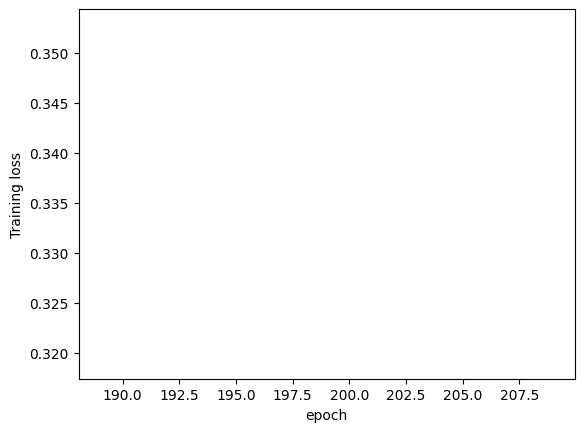

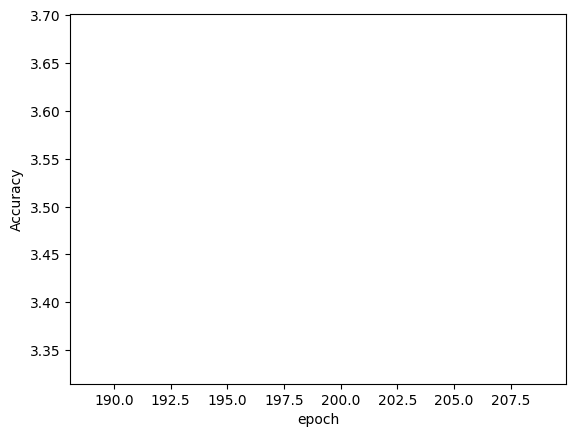

done
[]


In [75]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=4561,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adagrad(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(200):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

#print(i)
average_loss=(train_loss/(i+1))
average_accuracy=(train_acc/(i+1))
losses.append(average_loss.detach().numpy())
accuracy.append(average_accuracy)
epochs.append(epoch)
torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
4561
9122


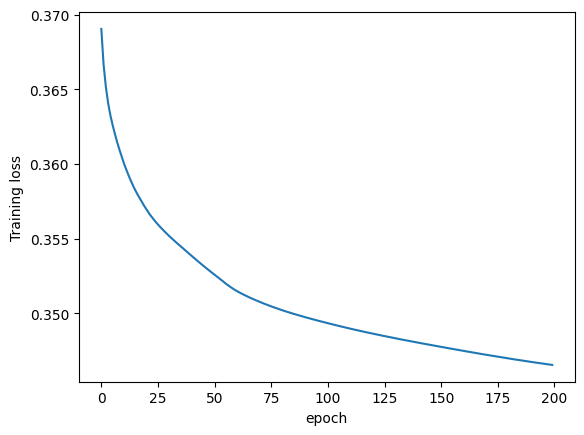

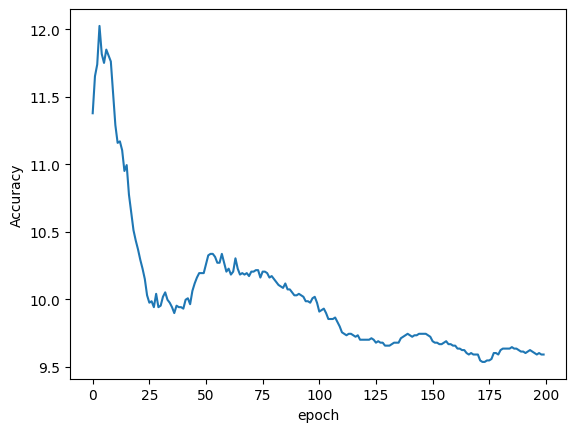

done
[]


In [76]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=4561,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adagrad(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(200):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


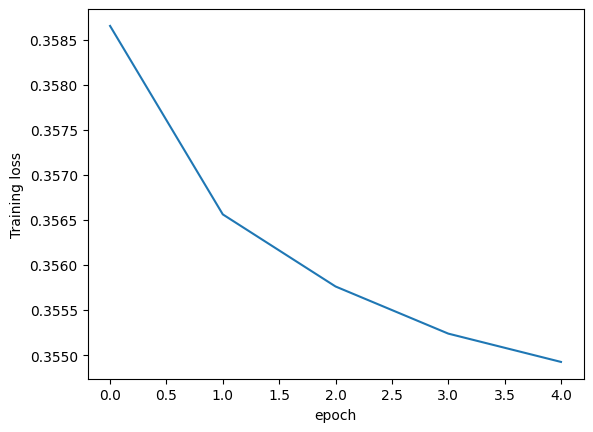

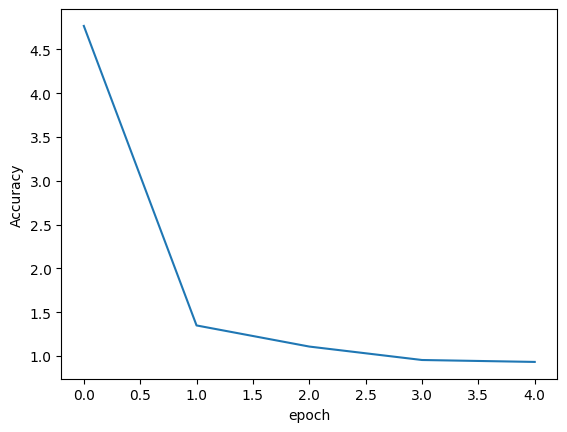

done
[]


In [77]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adagrad(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


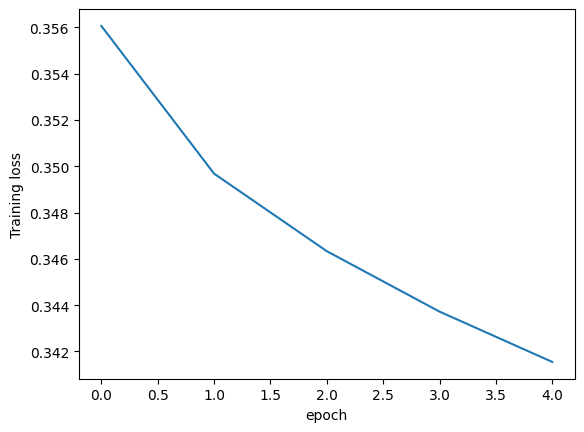

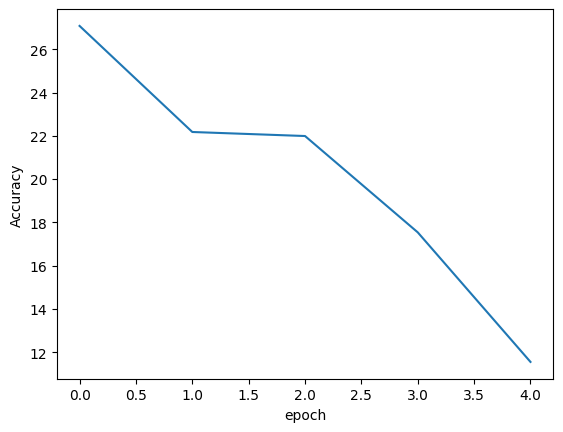

done
[]


In [78]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adagrad(params=model.parameters(),lr=0.001)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


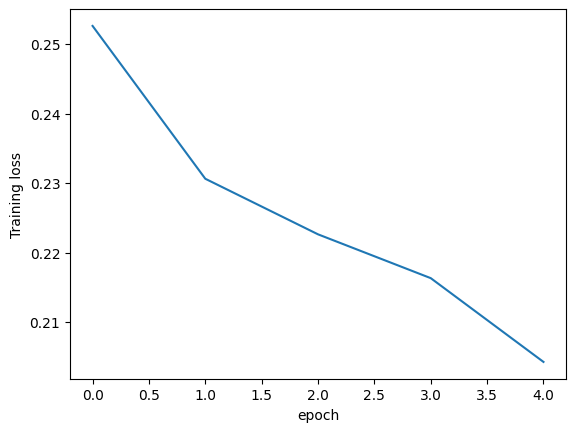

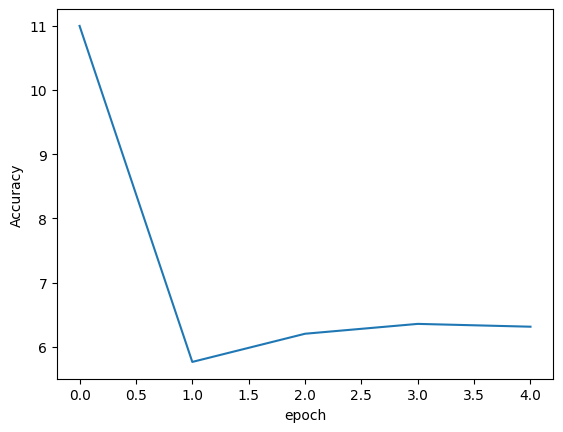

done
[]


In [79]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adam(params=model.parameters(),lr=0.001)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


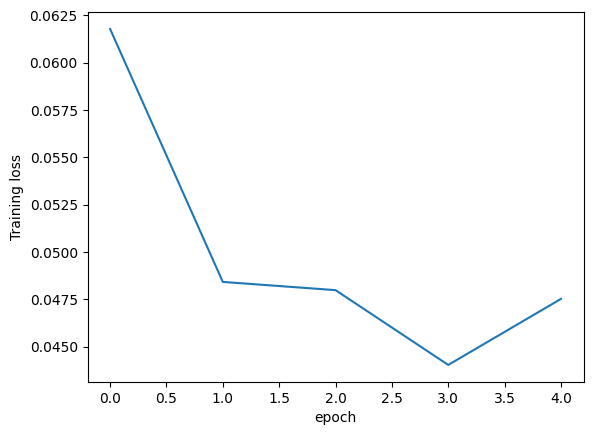

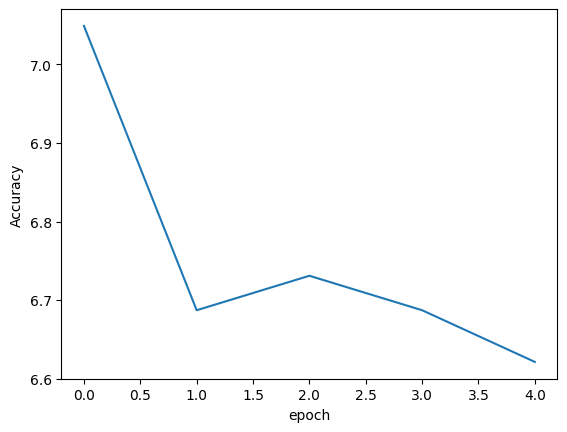

done
[]


In [80]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adam(params=model.parameters(),lr=0.01)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


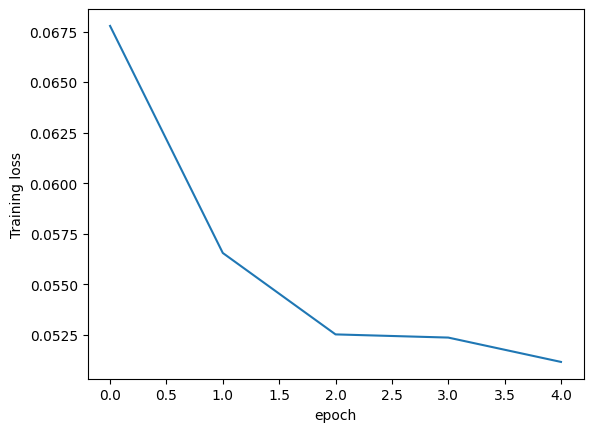

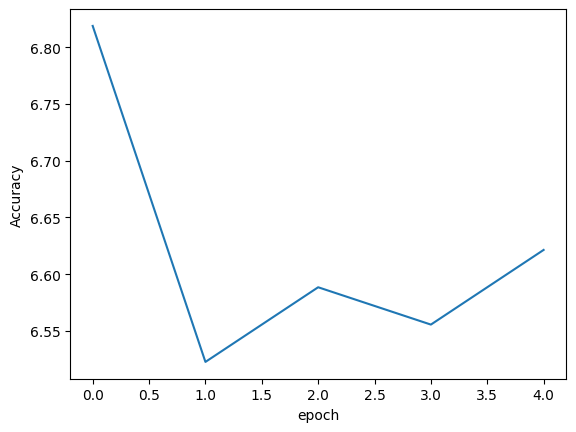

done
[]


In [81]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc





# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Sigmoid()
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)
        

            #computing loss
            loss=loss_func(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.Adam(params=model.parameters(),lr=0.01)
loss_func=torch.nn.BCELoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


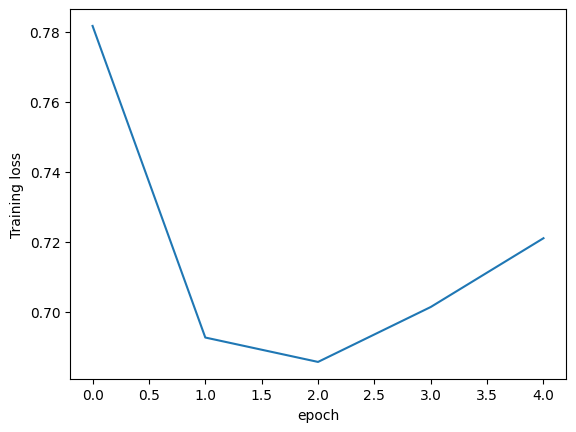

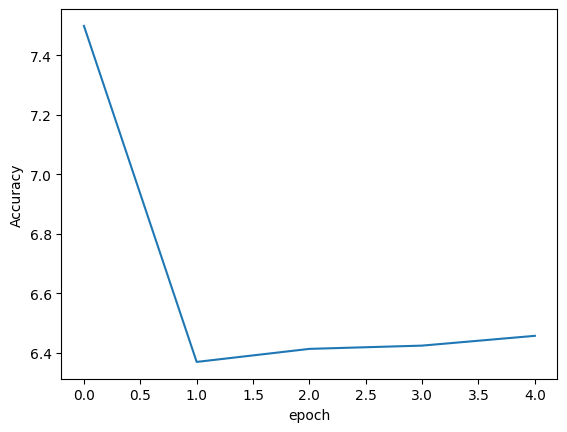

done
[]


In [82]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
       # nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
9122
9122
2
9122


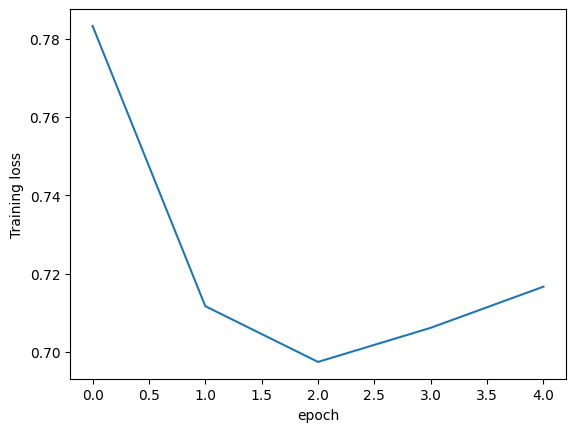

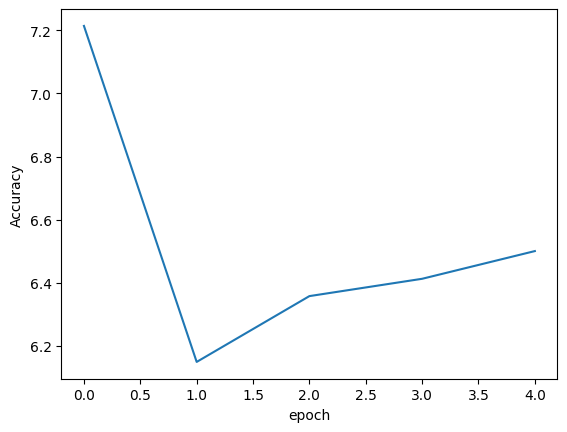

done
[]


In [83]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.8*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.8*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=2,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


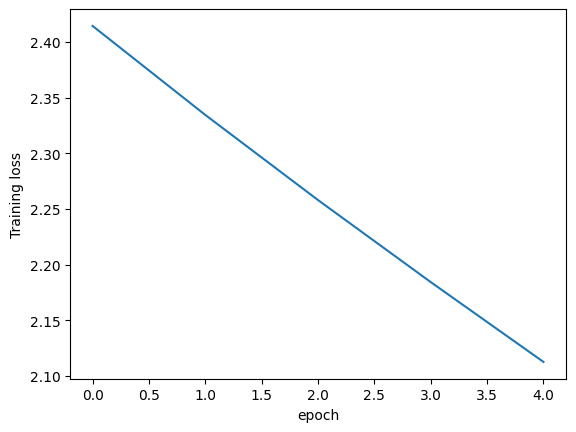

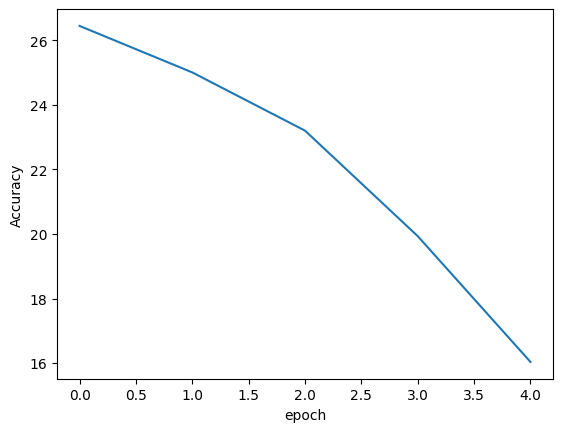

done
[]


In [84]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


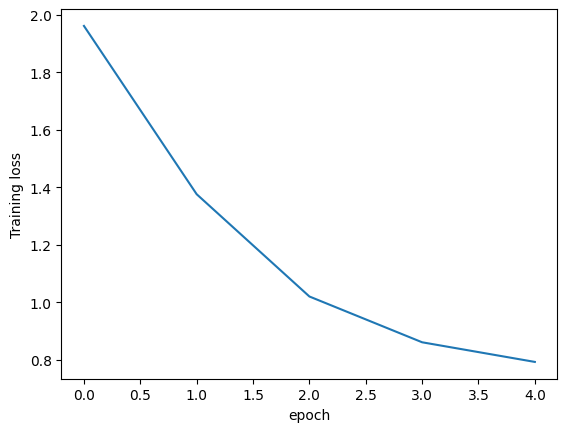

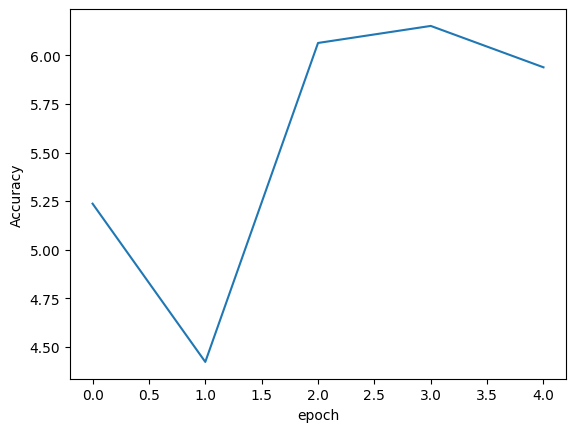

done
[]


In [85]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


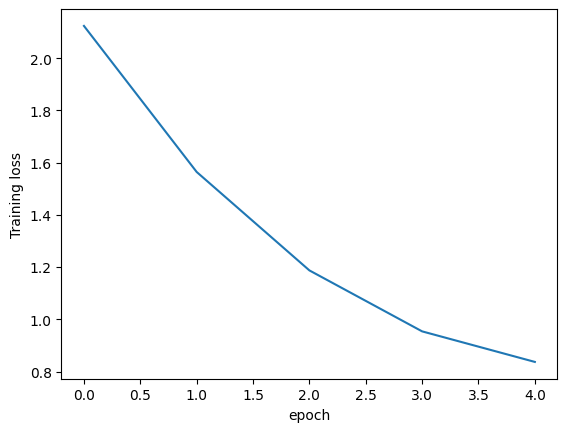

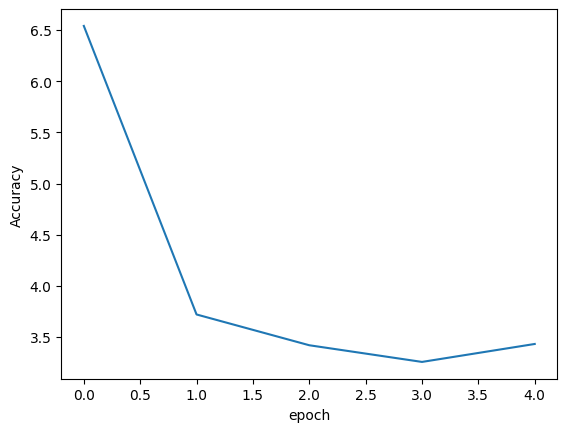

done
[]


In [86]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        #nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=1280,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


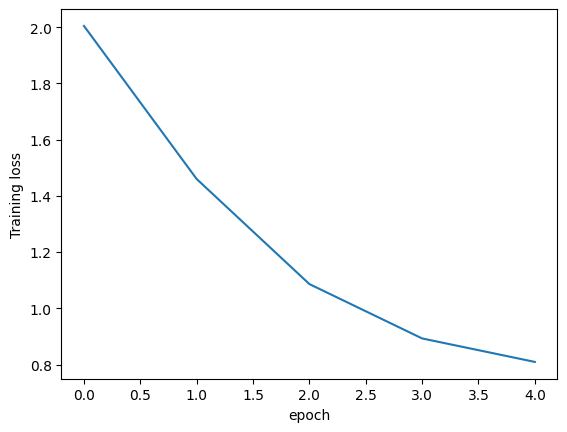

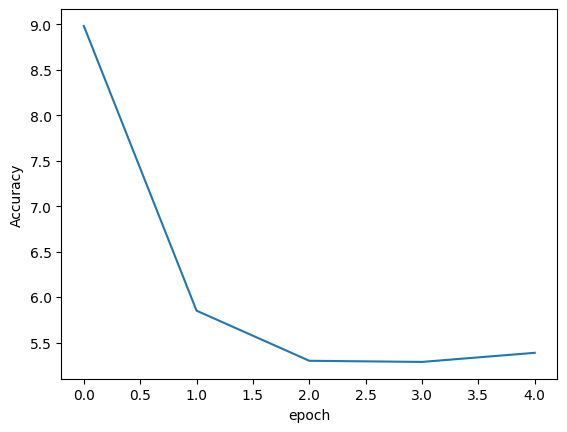

done
[]


In [87]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.LeakyReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


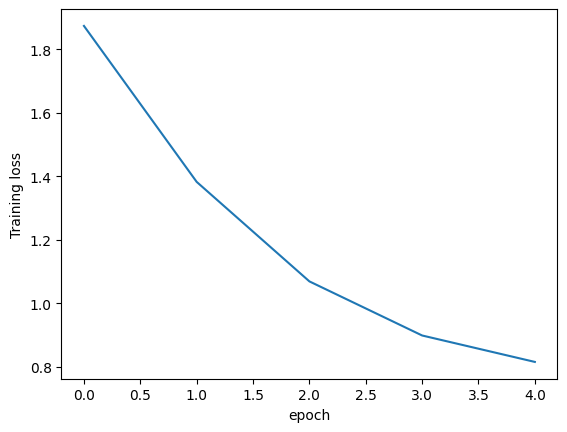

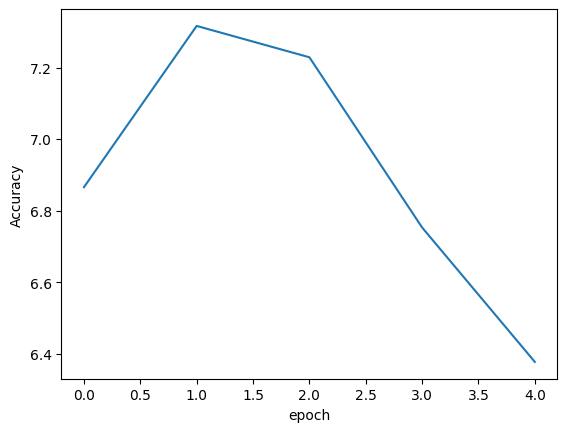

done
[]


In [88]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion = nn.CrossEntropyLoss()
    _, labels = torch.max(targets, dim=1)
    return criterion(outputs, labels)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


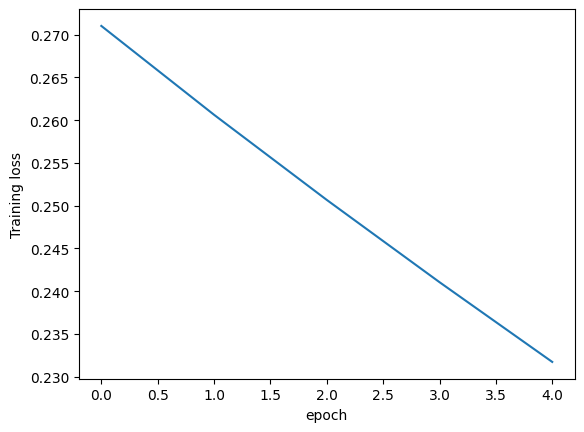

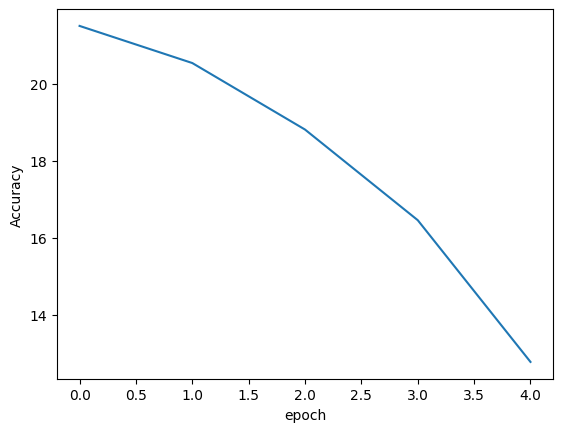

done
[]


In [95]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion=0
    for i in range(0,len(outputs)):
        for j in range(0,len(outputs[0])):
            criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    criterion=criterion/(len(outputs)*len(outputs[0]))
    return (criterion)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


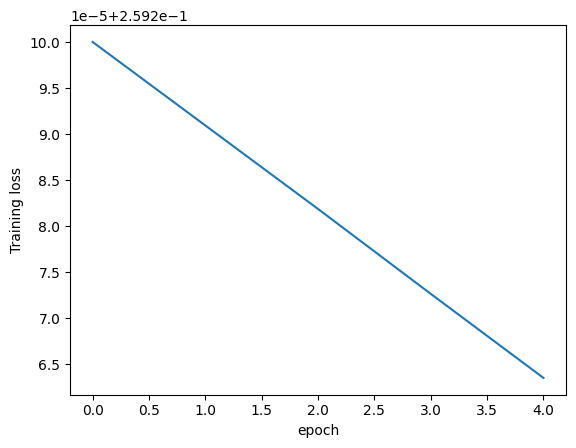

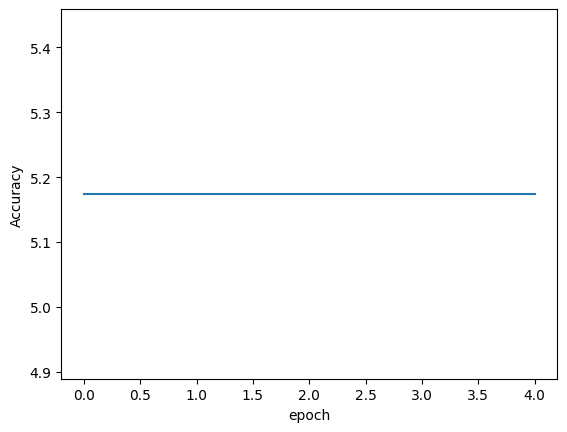

done
[]


In [96]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion=0
    for i in range(0,len(outputs)):
        for j in range(0,len(outputs[0])):
            criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    criterion=criterion/(len(outputs)*len(outputs[0]))
    return (criterion)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


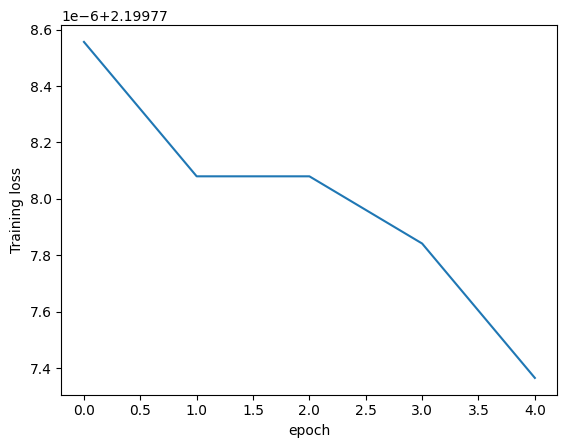

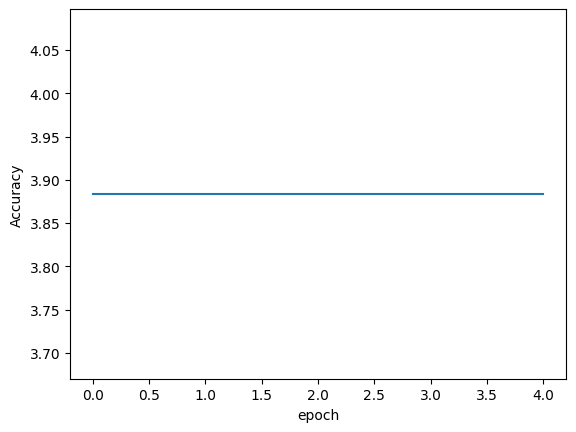

done
[]


In [97]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(5):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


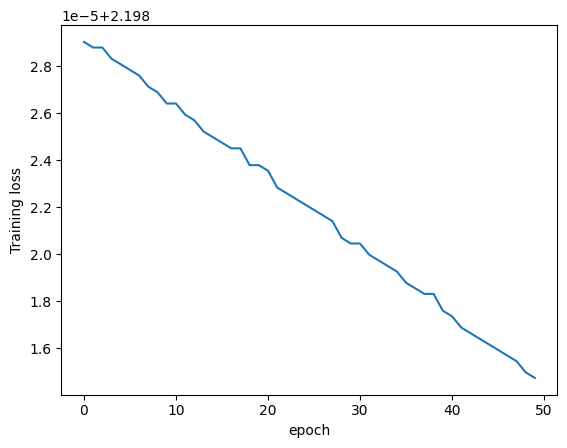

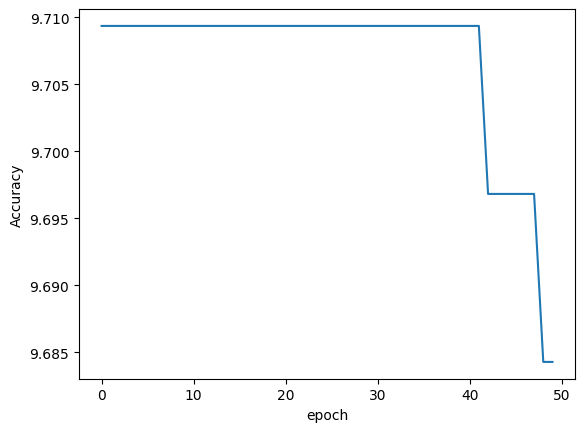

done
[]


In [98]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
614
7982


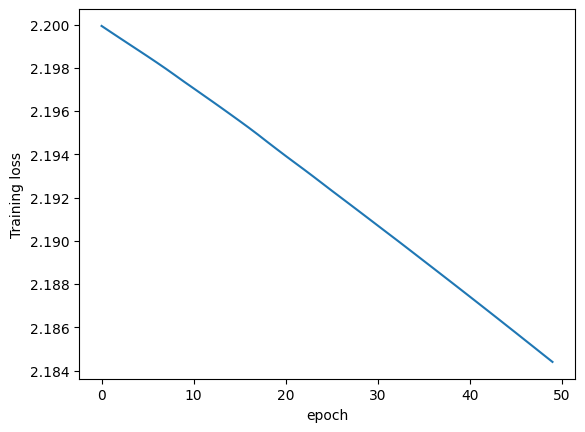

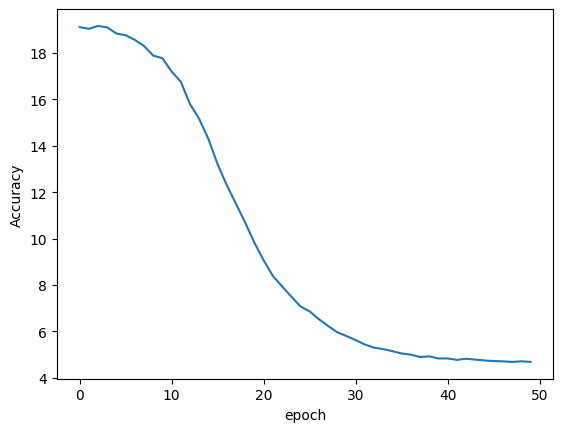

done
[]


In [99]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=614,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


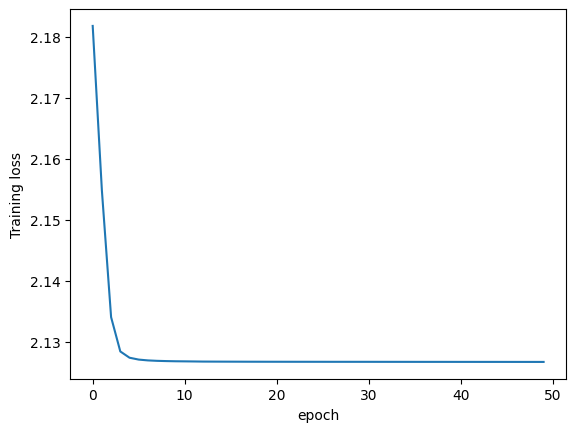

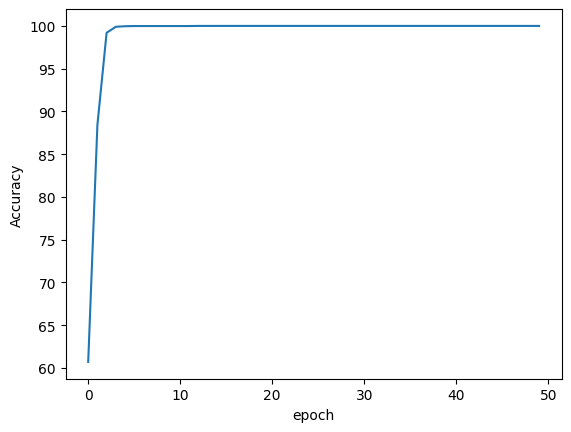

done
[]


In [100]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.1)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


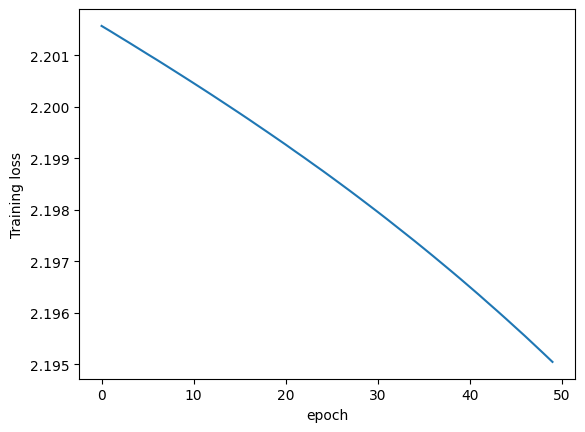

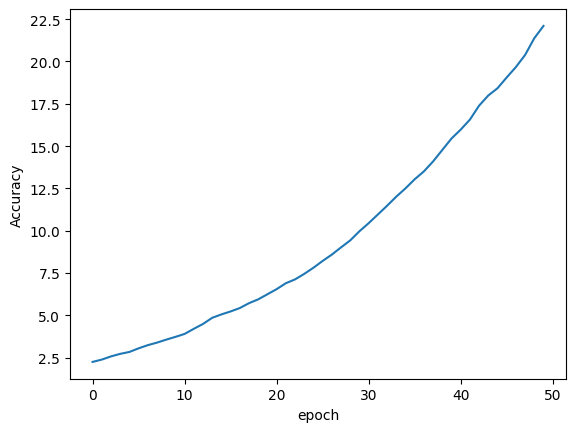

done
[]


In [101]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


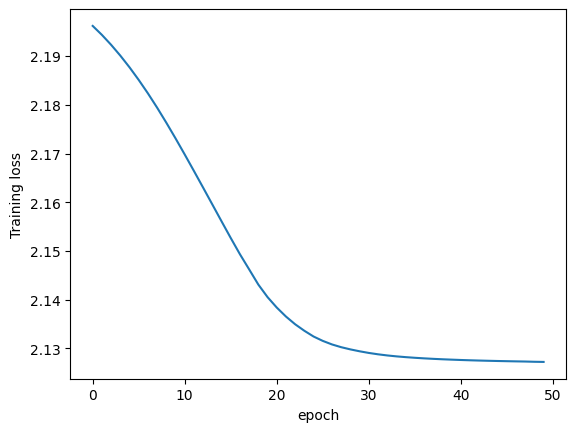

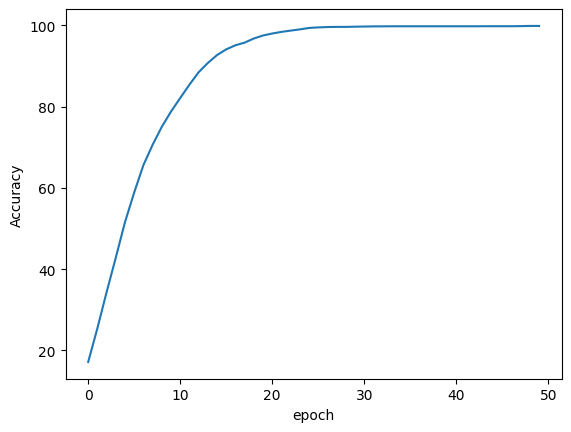

done
[]


In [102]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


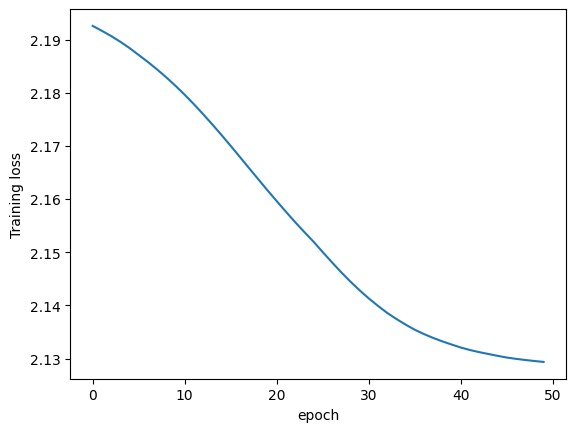

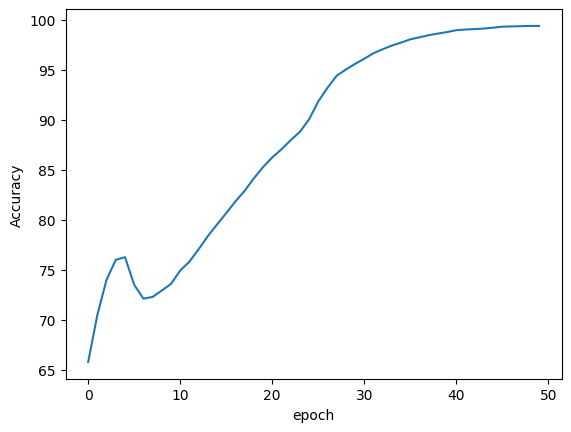

done
[]


In [103]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.005)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


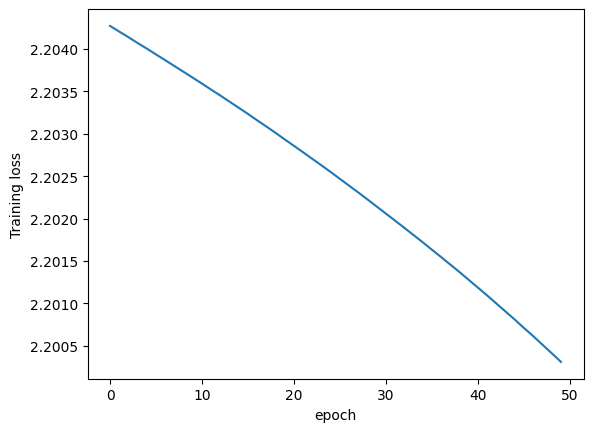

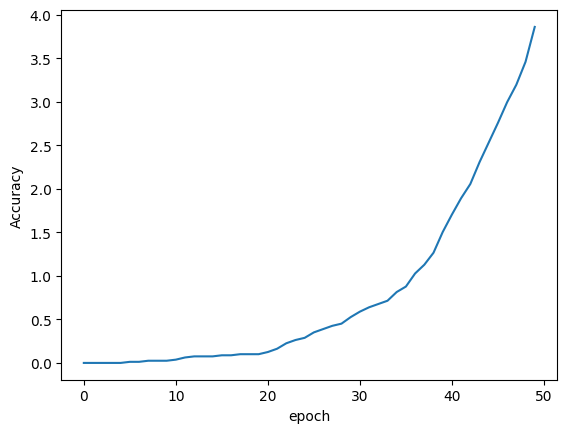

done
[]


In [104]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


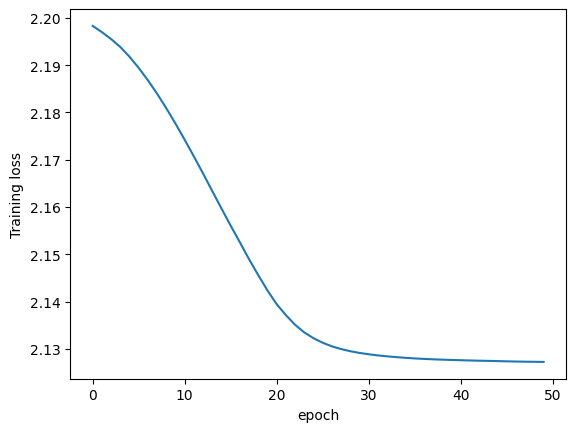

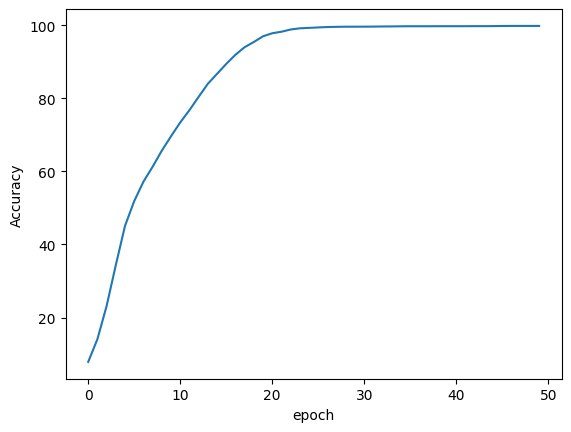

done
[]


In [105]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.01)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


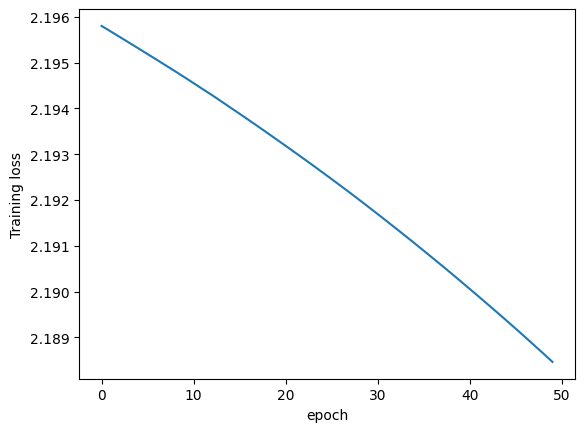

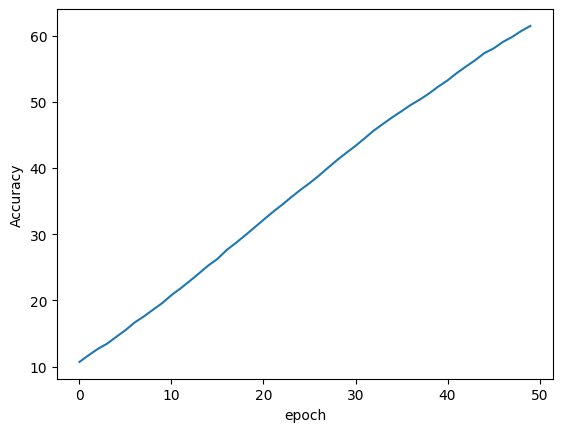

done
[]


In [106]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=1)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


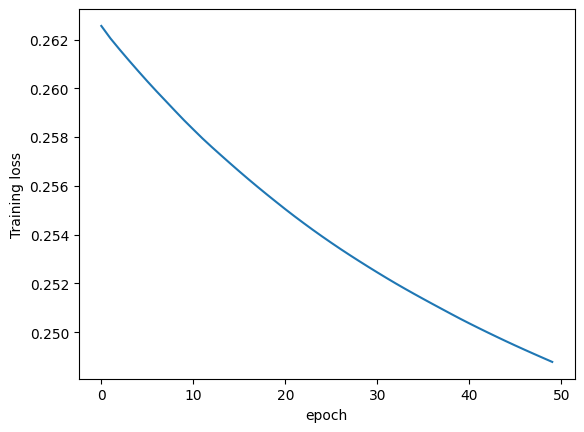

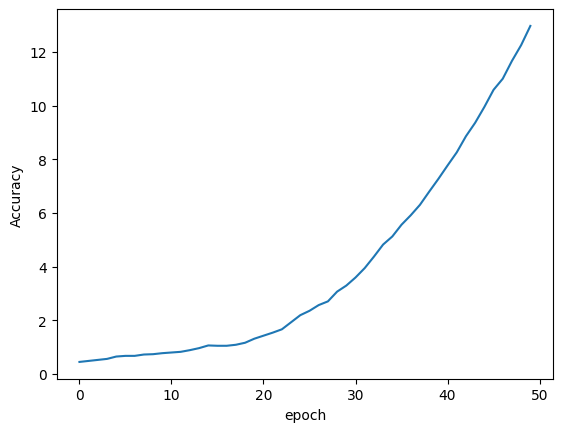

done
[]


In [109]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion=0
    softmax=nn.Softmax(dim=1)
    targets=softmax(targets)
   # criterion=nn.CrossEntropyLoss()
    #l=criterion(outputs,softmax(targets))
    for i in range(0,len(outputs)):
        for j in range(0,len(outputs[0])):
            criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    criterion=criterion/(len(outputs)*len(outputs[0]))
    return (criterion)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(50):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


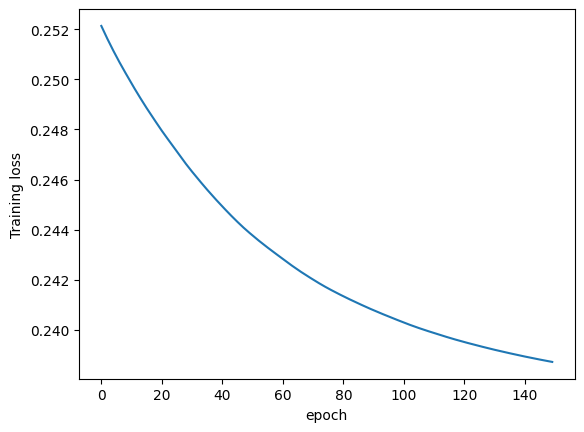

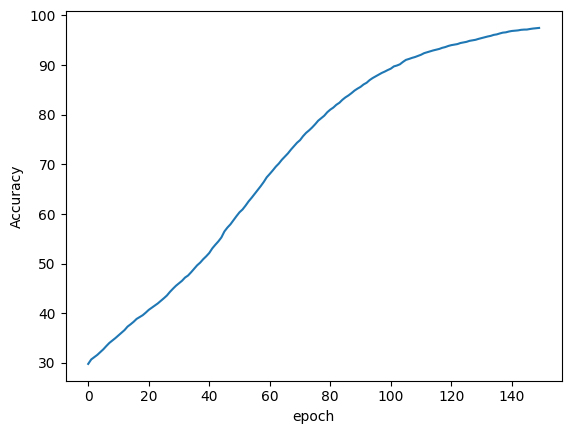

done
[]


In [110]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    criterion=0
    softmax=nn.Softmax(dim=1)
    targets=softmax(targets)
   # criterion=nn.CrossEntropyLoss()
    #l=criterion(outputs,softmax(targets))
    for i in range(0,len(outputs)):
        for j in range(0,len(outputs[0])):
            criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    criterion=criterion/(len(outputs)*len(outputs[0]))
    return (criterion)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=one_hot_ce_loss(y_pred,labels_to_compare)
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(150):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


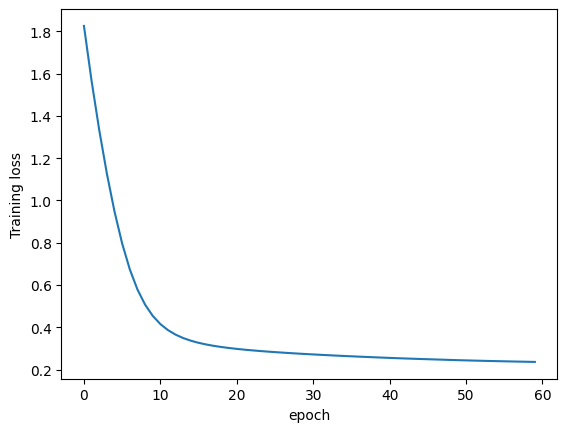

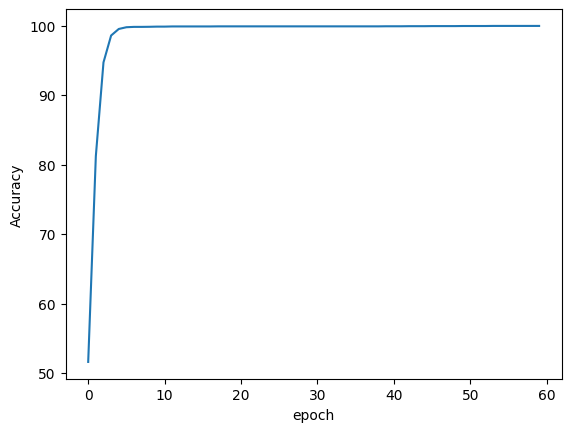

done
[]


In [112]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=torch.mean(cross_entropy(y_pred,labels_to_compare))
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(60):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
7982


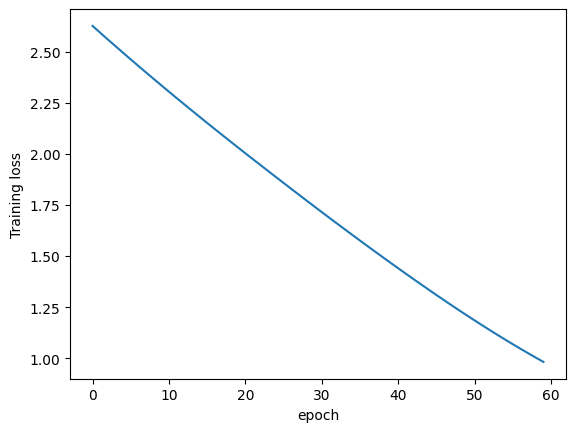

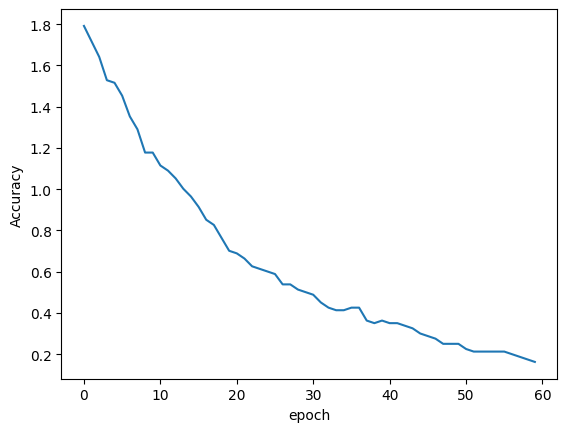

done
[]


In [113]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=torch.mean(cross_entropy(y_pred,labels_to_compare))
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=307,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(60):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
307
7982


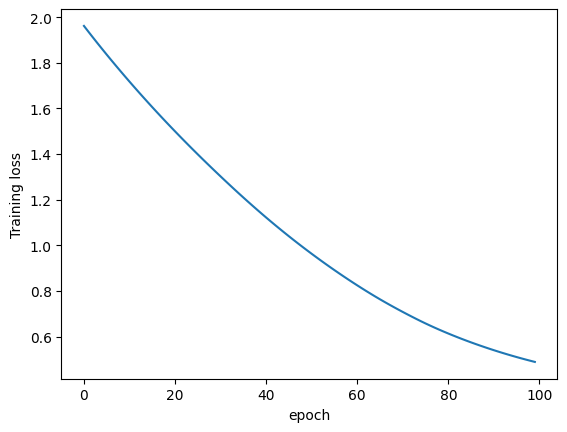

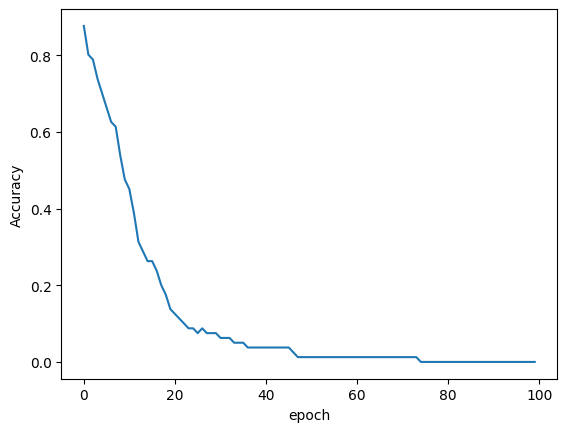

done
[]


In [114]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=torch.mean(cross_entropy(y_pred,labels_to_compare))
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=307,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(100):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


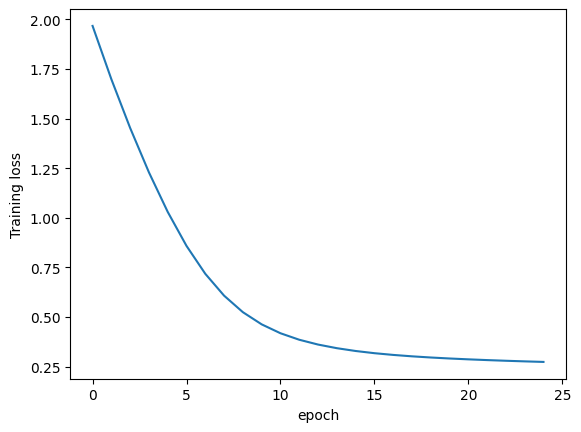

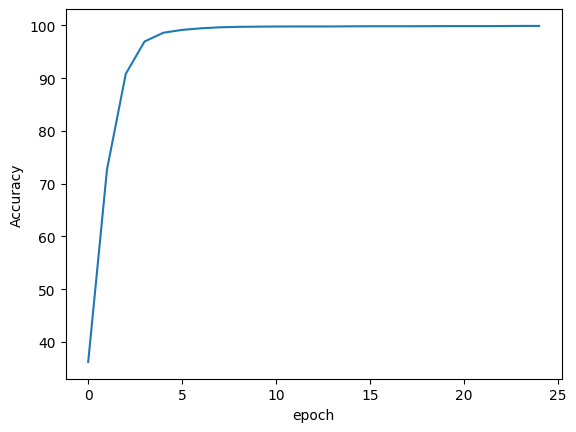

done
[]


In [115]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=torch.mean(cross_entropy(y_pred,labels_to_compare))
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(25):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


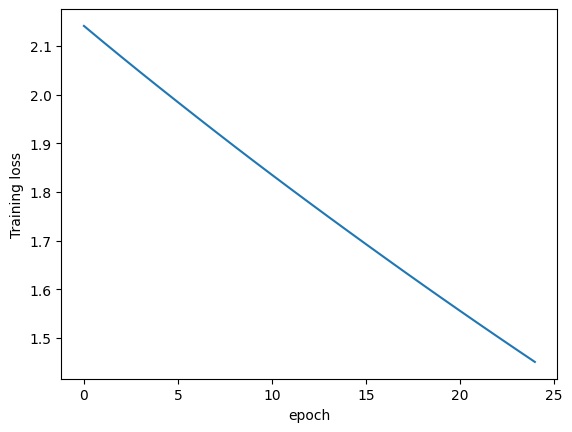

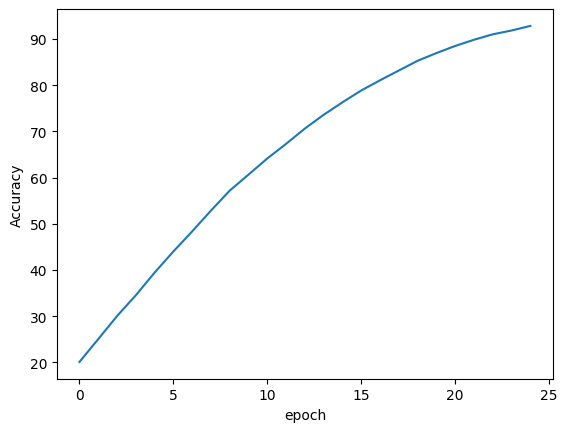

done
[]


In [116]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={}
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.AvgPool1d(kernel_size=128),
        nn.Linear(in_features=10,out_features=10),
        nn.ReLU(),
        nn.BatchNorm1d(num_features=10),
        nn.Linear(in_features=10, out_features=9),
        nn.Softmax( dim=1)
    
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)



            #computing loss
            loss=torch.mean(cross_entropy(y_pred,labels_to_compare))
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.CrossEntropyLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(25):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


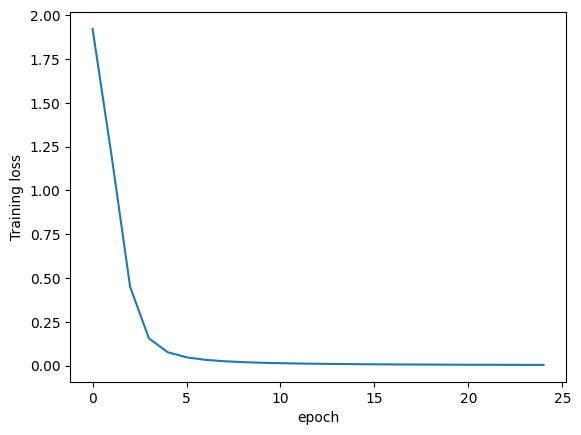

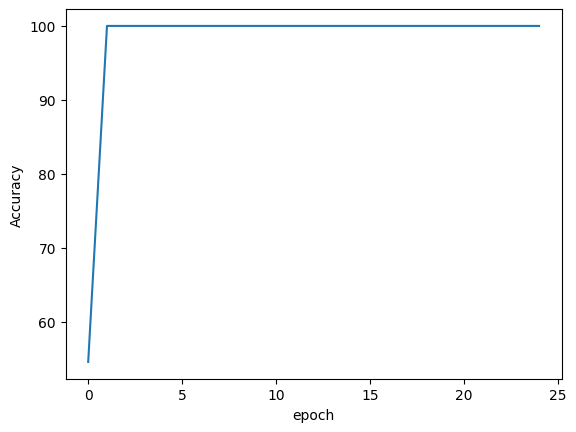

done
[]


In [118]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={} 
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)


            y_to_compare=((y_train[i:i+X_train.batch_size]).reshape(len(y_train[i:i+X_train.batch_size]),1)).type(torch.LongTensor)
            #computing loss
            loss=loss_func(y_pred,y_to_compare.flatten())
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.NLLLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(25):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


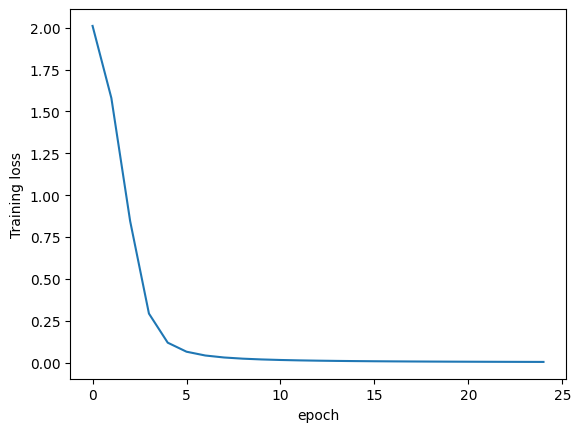

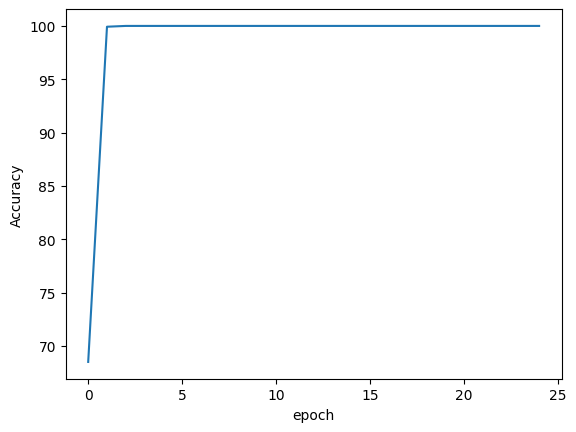

done
[]


In [119]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={} 
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)


            y_to_compare=((y_train[i:i+X_train.batch_size]).reshape(len(y_train[i:i+X_train.batch_size]),1)).type(torch.LongTensor)
            #computing loss
            loss=loss_func(y_pred,y_to_compare.flatten())
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.NLLLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(25):
    model.train()
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

Connected to Python 3.10.12

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982


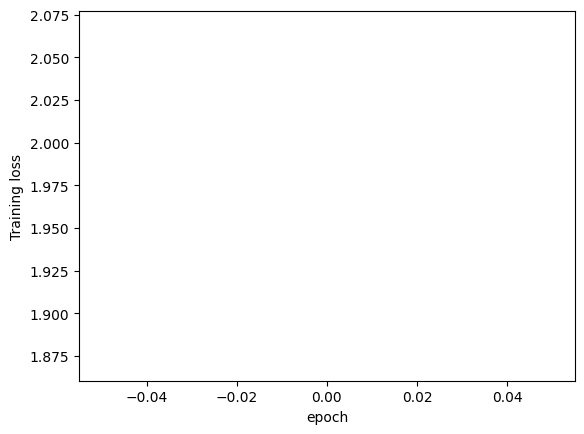

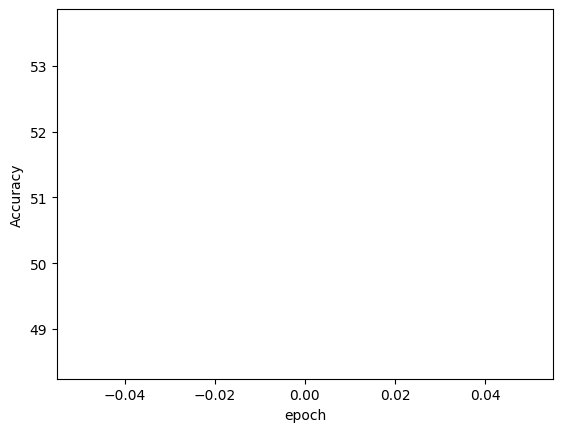

done
[]


In [1]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={} 
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)


            y_to_compare=((y_train[i:i+X_train.batch_size]).reshape(len(y_train[i:i+X_train.batch_size]),1)).type(torch.LongTensor)
            #computing loss
            loss=loss_func(y_pred,y_to_compare.flatten())
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.NLLLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(1):
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
7982
7982
26
7982
95.33951390628914


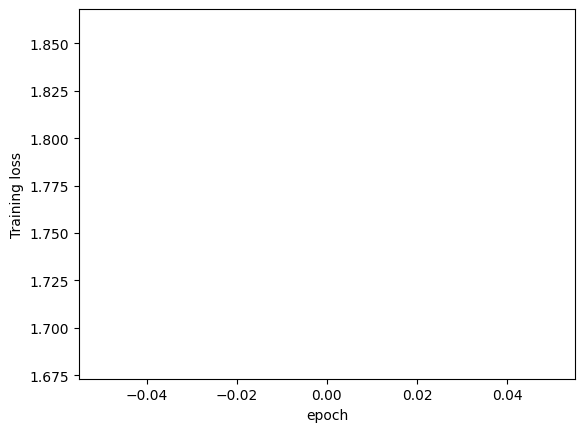

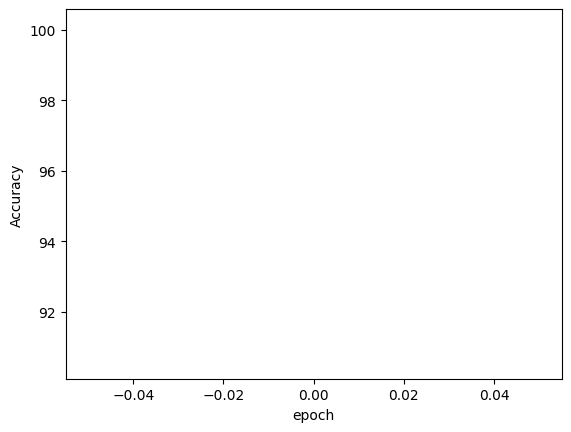

done
[]


In [2]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={} 
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)


            y_to_compare=((y_train[i:i+X_train.batch_size]).reshape(len(y_train[i:i+X_train.batch_size]),1)).type(torch.LongTensor)
            #computing loss
            loss=loss_func(y_pred,y_to_compare.flatten())
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[:round(0.7*len(X))]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=26,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.NLLLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(1):
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    print(average_accuracy)
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)








               


#Need a testing and validation group

In [3]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
#loading data
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

label=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)

tags={}
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
  #  sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
     #   X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)

print("Data loaded")
print(len(label),len(X))

for num in range(0,9):
     distribution=[0]*9
     distribution[num]=1
     tags[num]=distribution

print(tags)


# For the training data I split data into 3050 batches each containig  2 samples
X_train=DataLoader(dataset=X[:round(0.7*len(X))],batch_size=1,shuffle=False)

y_train=label[:round(0.7*len(label))]

X_test=DataLoader(dataset=X[:round(0.7*len(X))],batch_size=26,shuffle=False)
y_test=label[:round(0.7*len(X))]

print(X_test.batch_size)
distribution=torch.tensor([0]*9)
# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    classes.append(torch.argmax(y_to_compare))
    classes=torch.from_numpy(np.array(classes))
    correct = torch.eq(classes,y_t).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct/X_test.batch_size) * 100 
    return acc

def one_hot_ce_loss(outputs, targets):
    softmax=nn.Softmax(dim=0)
    criterion=nn.CrossEntropyLoss()
    l=criterion(outputs,softmax(targets.squeeze()))
    #for i in range(0,len(outputs)):
        ##for j in range(0,len(outputs[0])):
           ## criterion+=(-targets[i][j])*torch.log(outputs[i][j])
    #criterion=criterion/(len(outputs)*len(outputs[0]))
    return (l)


#Defining Neural network class
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)

   
        
        )
    def forward(self,x):
        return(self.stack(x))
    



         
#Declaring a Nueral network model
model=NueralNet()
print(model.parameters())
model.load_state_dict(torch.load("NN1.pth"))
loss_func=torch.nn.CrossEntropyLoss()
#testing
#model.train()

def Test(sample,test_loss,acc_score,i):
      test_prediction=model(sample).squeeze()
      y_to_compare=y_test[i:i+X_test.batch_size]
      acc_score+=accuracy_fn(test_prediction,y_to_compare)
      return(test_loss,acc_score)


test_loss=0
acc_score=0
acc=[]
losses=[]
with torch.no_grad():
    for i,sample_i in enumerate(X_test):
        test_loss,acc_score=Test(sample_i.reshape(X_test.batch_size,128*10),test_loss,acc_score,i)
       # test_loss,acc_score=Test(sample_i.reshape(X_test.batch_size,128*10)+torch.randn(X_test.batch_size,128*10),test_loss,acc_score,i)
       # test_loss,acc_score=Test(sample_i.reshape(X_test.batch_size,128*10)*torch.randn(X_test.batch_size,128*10),test_loss,acc_score,i)
        

    print(i)
    average_accuracy=acc_score/(i+1)
    print(average_accuracy)
    average_loss=test_loss/(i+1)
    print("done")

Data loaded
11403 11403
{0: [1, 0, 0, 0, 0, 0, 0, 0, 0], 1: [0, 1, 0, 0, 0, 0, 0, 0, 0], 2: [0, 0, 1, 0, 0, 0, 0, 0, 0], 3: [0, 0, 0, 1, 0, 0, 0, 0, 0], 4: [0, 0, 0, 0, 1, 0, 0, 0, 0], 5: [0, 0, 0, 0, 0, 1, 0, 0, 0], 6: [0, 0, 0, 0, 0, 0, 1, 0, 0], 7: [0, 0, 0, 0, 0, 0, 0, 1, 0], 8: [0, 0, 0, 0, 0, 0, 0, 0, 1]}
26
<generator object Module.parameters at 0x7f84004d7ed0>
306
4.5602605863192185
done


In [5]:
import torch
from torch import nn 
import numpy as np
from torch.utils.data import DataLoader
import torchmetrics
import matplotlib.pyplot as plt
import random as rand
import imblearn
from sklearn import metrics

#loading data
#X=torch.from_numpy(np.load("Data AI/X_data.npy")).type(torch.float)
X=torch.from_numpy(np.load("X_oversample.npy")).type(torch.float)

print(X.shape)






labels=torch.from_numpy(np.load("labels_oversample.npy")).type(torch.int)
print(labels.shape)
#groups=torch.from_numpy(np.load("Data AI/groups.npy")).type(torch.int)
tags={} 
#print(len(groups))
print("Data loaded")
#print(len(labels),len(X[0][0]))

#normaizing
#X=X.reshape(len(X[0][0]),len(X)*len(X[0]))
#for i in range(0,len(X)):
   # sum=0
   # mi= np.min(X[i])
    #ma=np.max(X[i])
    #norm=0
    #for j in range(0,len(X[0])):
       # X[i][j]=(X[i][j]-mi)/(ma-mi)
#X=torch.from_numpy(X.reshape(7626,128,10)).type(torch.float)


# Calculate accuracy (a classification metric)
def accuracy_fn(y_to_compare,y_t):
    classes=[]
    for item in y_to_compare:
        classes.append(torch.argmax(item))
    classes=torch.from_numpy(np.array(classes))
    correct = metrics.accuracy_score(torch.detach(classes).numpy(),torch.detach(y_t).numpy()) # torch.eq() calculates where two tensors are equal
    acc = (correct) * 100 
    return acc

def cross_entropy(softmax, y_target):
    return - torch.sum(torch.log(softmax) * (y_target), dim=1)



# Neural network Archituectuer Input year 1280 neurons, output layer 1 neuron, ->1280->1280->1280->10->1
class NueralNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.stack=nn.Sequential(
        nn.ReLU(),
        nn.Linear(in_features=1280, out_features=128),
        nn.ReLU(),
        nn.Linear(in_features=128,out_features=64),
        nn.ReLU(),
        nn.Linear(in_features=64, out_features=9),
        nn.LogSoftmax(dim=1)
        
    


        )
    def forward(self,x):
        return(self.stack(x))


#Training Sequence
def Train(sample,train_loss,train_acc,i):
          
            y_pred=model(sample).squeeze()
            
            classes=[]
            for item in y_pred:
                classes.append(torch.argmax(item))
            
            #getting tags
            y_to_compare=y_train[i:i+X_train.batch_size]
            labels_to_compare=[]
            for i in range(0,len(y_to_compare)):
                labels_to_compare.append(tags[y_to_compare[i].item()])
            labels_to_compare=torch.from_numpy(np.array(labels_to_compare)).type(torch.float)


            y_to_compare=((y_train[i:i+X_train.batch_size]).reshape(len(y_train[i:i+X_train.batch_size]),1)).type(torch.LongTensor)
            #computing loss
            loss=loss_func(y_pred,y_to_compare.flatten())
            train_loss+=loss
        
            train_acc+=accuracy_fn(y_pred,y_train[i:i+X_train.batch_size])
            
            #ALWAYS HAVE THIS AFTER CALULATING LOSS
            loss.backward()
            optimizer.step()
            return(train_loss,train_acc)






#
l=0
r=3991
acc=[]
losses=[]
X_trainset=X[0]
print(len(X_trainset))

labels_trainset=labels[:round(0.7*len(X))]
print(len(labels_trainset))

X_train=DataLoader(dataset=X_trainset,batch_size=1,shuffle=False)
y_train=labels_trainset

#Sanity checking
print(X_train.batch_size)
print(len(y_train))
    
#Creating one hot encoding tags
for num in range(0,9):
    distribution=[0]*9
    distribution[num]=1
    tags[num]=distribution



    #Declaring a Nueral network model
model=NueralNet()
 


#Defining loss function and learning rate
optimizer=torch.optim.SGD(params=model.parameters(),lr=0.0001)
loss_func=torch.nn.NLLLoss()

#Training
train_acc=0#
losses=[]
accuracy=[]
epochs=[]
distributions=[]
for epoch in range(1):
    train_loss=0
    train_acc=0
    for i,sample_i in enumerate(X_train):
        optimizer.zero_grad()
        train_loss,train_acc=Train(sample_i.reshape(X_train.batch_size,128*10),train_loss,train_acc,i)

    #print(i)
    average_loss=(train_loss/(i+1))
    average_accuracy=(train_acc/(i+1))
    print(average_accuracy)
    losses.append(average_loss.detach().numpy())
    accuracy.append(average_accuracy)
    epochs.append(epoch)
    torch.save(model.state_dict(),f="NN1.pth") 

plt.plot(np.array(epochs),np.array(losses))
plt.xlabel("epoch")
plt.ylabel("Training loss")
plt.show()      

plt.plot(np.array(epochs),np.array(accuracy))
plt.xlabel("epoch")
plt.ylabel("Accuracy")
plt.show()       
print("done")
print(distributions)
print(model(X_trainset).reshape(1,1280))








               


#Need a testing and validation group

torch.Size([11403, 128, 10])
torch.Size([11403])
Data loaded
128
7982
1
7982


RuntimeError: shape '[1, 1280]' is invalid for input of size 10